# **Importing Data**

In [1]:
!pip install arch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.7/981.7 kB 5.5 MB/s eta 0:00:00


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
import random
from scipy.optimize import minimize
import arch

from sklearn.metrics import mean_squared_error,mean_absolute_error
import math
import warnings
warnings.filterwarnings("ignore")

In [3]:
def load_data(collection='boredapeyachtclub',test_days=31,path ='/content/drive/MyDrive/NFT_Simulation/Data/'):
  full_path = path + collection + '.csv'
  df = pd.read_csv(full_path)
  df['DateTime'] = pd.to_datetime(df['DateTime'].values).strftime('%Y-%m-%d')
  df.set_index(df.DateTime,inplace=True)
  df = df[['Floor Price','Average Price']]
  df.dropna(inplace=True)
  # Convert prices to log returns
  #df["Floor_daily_returns"] = np.pad(np.diff(np.log(df['Floor Price'])) * 100, (1, 0), 'constant', constant_values=np.nan)
  #df["Average_daily_returns"] = np.pad(np.diff(np.log(df['Average Price'])) * 100, (1, 0), 'constant', constant_values=np.nan)
  #convert prices to returns
  #df["Floor_daily_returns"] = df["Floor Price"].pct_change()
  #df["Average_daily_returns"] = df["Average Price"].pct_change()
  #calculate the returns manually
  df["Floor_daily_returns"] = (df["Floor Price"]-df["Floor Price"].shift(1))/df["Floor Price"]
  df["Average_daily_returns"] = (df["Average Price"]-df["Average Price"].shift(1))/df["Average Price"]
  #calculate absolute returns
  df['abs_Floor_returns'] = df["Floor_daily_returns"].abs() *100
  df['abs_Average_returns'] = df["Average_daily_returns"].abs() *100
  # Calculate logarithm of returns
  df['log_Floor_returns'] = np.log(df["Floor Price"] / df["Floor Price"].shift(1))
  df['log_Average_returns'] = np.log(df["Average Price"] / df["Average Price"].shift(1))

  df.dropna(inplace=True)

  train_df = df.iloc[-test_days-29*4:-test_days,:]
  train_df = train_df.iloc[2:,:]
  test_df = df.iloc[-test_days:,:]
  df.plot()
  return df,train_df,test_df

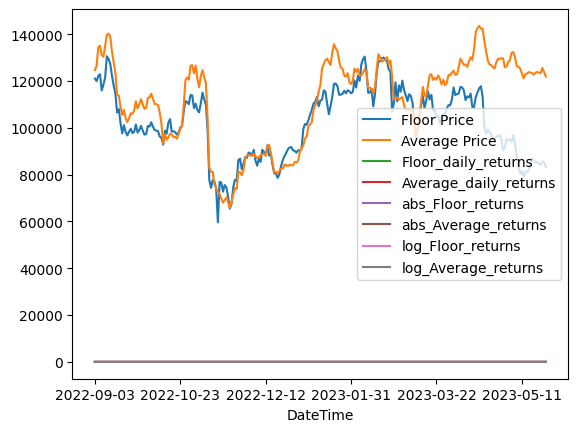

In [4]:
test_days = 31
collection = 'boredapeyachtclub'
df,train_df,test_df = load_data(collection,test_days)
#test_df = test_df[:11]

# **Stock prices with jump process**

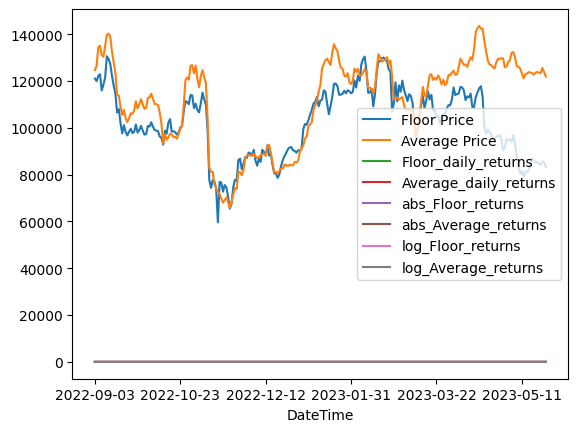

In [5]:
test_days = 31
collection = 'boredapeyachtclub'
df,train_df,test_df = load_data(collection,test_days)
test_df = test_df[:11]

In [ ]:
random.seed(42)  # You can use any desired integer value as the seed

def estimate_stock_prices(train_df, test_df, T, no_simulations, with_jump=True, jump_intensity=0.1, jump_mean=-0.05, jump_sigma=0.2, plot=True, statistics=True,collection = 'boredapeyachtclub'):
    # Set the random seed for reproducibility
    np.random.seed(42)

    # So    :   initial stock price
    So = test_df["Floor Price"][0]
    # dt    :   time increment -> a day in our case
    dt = 1 # day
    # T     :   length of the prediction time horizon(how many time points to predict, same unit with dt(days))
    # N     :   number of time points in prediction the time horizon -> T/dt
    N = T / dt
    # t     :   array for time points in the prediction time horizon [1, 2, 3, .. , N]
    t = np.arange(1, int(N) + 1)

    # Calculate the drift and diffusion components for the geometric Brownian motion (GBM)
    # mu    :   mean of historical daily returns
    mu = np.mean(train_df.Floor_daily_returns)
    # sigma :   standard deviation of historical daily returns
    sigma = np.std(train_df.Floor_daily_returns)
    # b     :   array for brownian increments
    b = {str(scen): np.random.normal(0, 1, int(N)) for scen in range(1, no_simulations + 1)}
    # W     :   array for brownian path
    W = {str(scen): b[str(scen)].cumsum() for scen in range(1, no_simulations + 1)}
    # Calculate the drift component of the geometric Brownian motion
    # Drift represents the expected growth rate of the stock price
    drift = (mu - 0.5 * sigma**2) * t
    # Calculate the diffusion component of the geometric Brownian motion
    # Diffusion represents the random component of the stock price movement
    diffusion = {str(scen): sigma * W[str(scen)] for scen in range(1, no_simulations + 1)}

    if with_jump == False:
      # Calculate the stock prices using the geometric Brownian motion (GBM) without jump process
      # For each simulation scenario, the stock prices are calculated using the formula:
      # S = So * exp(drift + diffusion[str(scen)])
      # where So is the initial stock price, drift is the drift component, and diffusion is the diffusion component
      S = np.array([So * np.exp(drift + diffusion[str(scen)]) for scen in range(1, no_simulations + 1)])
      # Combine the initial stock price with the calculated stock prices for each simulation scenario
      # This is done to ensure that the stock prices start from the same initial value
      S = np.hstack((np.array([[So] for scen in range(no_simulations)]), S))

      Preds_df = pd.DataFrame(S.swapaxes(0, 1)).set_index(
           pd.date_range(start = test_df.index[0],
           end = test_df.index.max(), freq = 'D'))
      new_df = pd.DataFrame(columns=['Actual Prices', 'predicted Prices'],index=Preds_df.index)
      new_df['predicted Prices'] = Preds_df.mean(axis=1, skipna=True)
      new_df['Actual Prices'] = test_df['Floor Price'].values

      # Plot the simulated stock prices
      if plot:
          plt.figure(figsize=(20, 10))
          for i in range(no_simulations):
              plt.title(f"Geometric Brownian Motion (GBM) without Jump Process for {collection}\nDaily Volatility: " + str(sigma))
              plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), S[i, :])
              plt.ylabel('Stock Prices, $')
              plt.xlabel('Prediction Days')
          plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), test_df['Floor Price'],linewidth=5)
          ax = plt.gca()
          ax.spines['top'].set_visible(False)
          ax.spines['right'].set_visible(False)
          plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/Figures/{collection}_simulations.png")  # Save the first figure
          plt.show()
          plt.figure(figsize=(20, 10))
          plt.title(f"Geometric Brownian Motion (GBM) without Jump Process for {collection}")
          new_df.plot()
          plt.ylabel('Stock Prices, $')
          plt.xlabel('Prediction Days')
          ax = plt.gca()
          ax.spines['top'].set_visible(False)
          ax.spines['right'].set_visible(False)
          #plt.ylim(ymin=0)  # Set the y-axis lower limit to zero
          plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/Figures/{collection}_actual_predicted.png")
          plt.show()

      if statistics:
        # Adjust the length of the index to match the length of the simulated paths
        index = pd.date_range(start=test_df.index[0], periods=int(N)+1, freq='D')

        # Calculate the statistics of the simulated paths
        statistics_df = pd.DataFrame(index=t)
        statistics_df['Minimum'] = np.min(S_jump, axis=0)
        statistics_df['Maximum'] = np.max(S_jump, axis=0)
        statistics_df['Median'] = np.median(S_jump, axis=0)
        statistics_df['Average'] = np.mean(S_jump, axis=0)
        #statistics_df['Standard Deviation'] = np.std(S_jump, axis=0)

        # Plot the statistics of the simulated paths
        plt.figure(figsize=(20, 10))
        for col in statistics_df.columns:
            plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), statistics_df[col], label=col)
        plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), test_df['Floor Price'],linewidth=5,label='Actual Price')
        plt.title(f"Statistics of Simulated Paths without Jump process for {collection}")
        plt.ylabel('Stock Prices, $')
        plt.xlabel('Prediction Days')
        plt.legend()
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/Figures/{collection}_statistics.png")
        plt.show()


      return Preds_df,new_df


    else:
      # Generate the jump times based on a Poisson distribution
      # The Poisson distribution is used to model the occurrence of rare events, such as price jumps
      # The intensity of the jumps is given by jump_intensity multiplied by the prediction time horizon (T)
      jump_times = np.random.poisson(int(jump_intensity * T), int(N))
      # Generate the jump sizes based on a normal distribution
      # The jump sizes represent the magnitude of the price jumps
      # jump_mean represents the mean of the jump sizes, and jump_sigma represents the standard deviation
      jump_sizes = np.random.normal(jump_mean, jump_sigma, len(jump_times))

      # Add the jumps to the Brownian motion

      # Create a copy of the Brownian path (W) for each simulation scenario
      # This copy will be used to incorporate the jump process
      W_jump = {str(scen): W[str(scen)].copy() for scen in range(1, no_simulations + 1)}
      # Iterate over the jump times and jump sizes
      # The loop adds the jump sizes to the Brownian path at the corresponding jump times
      for i in range(len(jump_times)):
          for scen in range(1, no_simulations + 1):
              W_jump[str(scen)][jump_times[i]] += jump_sizes[i]

      # Calculate the diffusion component with jumps by multiplying the adjusted Brownian path (W_jump) by sigma
      diffusion_jump = {str(scen): sigma * W_jump[str(scen)] for scen in range(1, no_simulations + 1)}



      # Calculate the stock prices including the jump process
      # For each simulation scenario, the stock prices are calculated using the formula:
      # S_jump = So * exp(drift + diffusion_jump[str(scen)] + W_jump[str(scen)])
      # where So is the initial stock price, drift is the drift component, diffusion_jump is the jump-adjusted diffusion component,
      # and W_jump is the adjusted Brownian path
      S_jump = np.array([So * np.exp(drift + diffusion_jump[str(scen)]) + W_jump[str(scen)] for scen in range(1, no_simulations + 1)])
      # Combine the initial stock price with the calculated stock prices for each simulation scenario
      # This is done to ensure that the stock prices start from the same initial value
      S_jump = np.hstack((np.array([[So] for scen in range(no_simulations)]), S_jump))

      preds_df_with_jumps = pd.DataFrame(S_jump.swapaxes(0, 1)).set_index(pd.date_range(start = test_df.index[0],
           end = test_df.index.max(), freq = 'D'))
      new_df_jumps = pd.DataFrame(columns=['Actual Prices', 'predicted Prices'],index=preds_df_with_jumps.index)
      new_df_jumps['predicted Prices'] = preds_df_with_jumps.mean(axis=1, skipna=True)
      new_df_jumps['Actual Prices'] = test_df['Floor Price'].values

      if plot:
        plt.figure(figsize=(20, 10))
        selected_simulations = random.sample(range(no_simulations), 25)  # Choose 25 random simulations
        for i in selected_simulations:
            #plt.title(f"Geometric Brownian Motion (GBM) with Jump Process for {collection}\nDaily Volatility: " + str(sigma))
            plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), S_jump[i, :])
            plt.ylabel('Floor Price ($)', fontsize=20)
            plt.xlabel('Date', fontsize=20)

        plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), test_df['Floor Price'],linewidth=5, label='Actual Price')
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/paper/{collection}/{collection}_simulations.png")
        plt.show()

        plt.figure(figsize=(20, 10))
        #plt.title(f"Geometric Brownian Motion (GBM) with Jump Process for {collection}")

        # Plot the predicted prices with a color of your choice
        plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), new_df_jumps['predicted Prices'], color='blue', label='Predicted Prices')

        # Plot the actual prices with a different color and a thicker line
        plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), new_df_jumps['Actual Prices'], color='red', linewidth=2, label='Actual Prices')
        plt.ylabel('Floor Price ($)')
        plt.xlabel('Date')
        #plt.ylim(ymin=0)  # Set the y-axis lower limit to zero
        plt.legend()
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/paper/{collection}/{collection}_actual_predicted.png")
        plt.show()

      if statistics:
        # Adjust the length of the index to match the length of the simulated paths
        index = pd.date_range(start=test_df.index[0], periods=int(N)+1, freq='D')

        # Calculate the statistics of the simulated paths
        # Calculate the statistics of the simulated paths
        statistics_df = pd.DataFrame(index=index)
        statistics_df['Minimum'] = np.min(S_jump, axis=0)
        statistics_df['Maximum'] = np.max(S_jump, axis=0)
        statistics_df['Average'] = np.mean(S_jump, axis=0)
        statistics_df['Median'] = np.median(S_jump, axis=0)
        statistics_df['Standard Deviation'] = np.std(S_jump, axis=0)

        #Confidence Interval with mean estimate
        #plt.figure(figsize=(20, 10))
        #plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), new_df_jumps['predicted Prices'], label='Predicted Price')
        confidence_interval_percentage = 66
        #z_score = np.abs(np.percentile(new_df_jumps['predicted Prices'], (100 - confidence_interval_percentage) / 2))

        lower_bound = new_df_jumps['predicted Prices'] - statistics_df['Standard Deviation']
        upper_bound = new_df_jumps['predicted Prices'] + statistics_df['Standard Deviation']
        #plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), new_df_jumps['predicted Prices'], color='blue', label='Mean Predicted Prices')
        #plt.fill_between(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), lower_bound, upper_bound, color='grey', alpha=0.3, label='Confidence Interval')
        #plt.xlabel('Date')
        #plt.ylabel('Floor Price ($)')
        #plt.title(f"Mean of Predicted Prices of {collection} with {confidence_interval_percentage}% Confidence Interval")
        # Remove the undesired legend
        #handles, labels = plt.gca().get_legend_handles_labels()
        #desired_labels = ['Mean Predicted Prices', 'Confidence Interval']
        #plt.legend(handles=handles[-2:], labels=desired_labels)
        #plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/Figures_1Month/{collection}_confidence.png")
        #plt.show()

        # Calculate the mean estimation error
        mean_error = new_df_jumps['predicted Prices'].mean() - new_df_jumps['Actual Prices'].mean()
        # Calculate the variance in error
        error = new_df_jumps['predicted Prices'] - new_df_jumps['Actual Prices']
        variance_error = error.var()
        variance_error_percentage = (variance_error / new_df_jumps['Actual Prices'].var()) * 100

        # Calculate additional statistics
        actual_prices = new_df_jumps['Actual Prices']
        predicted_prices = new_df_jumps['predicted Prices']

        mae = mean_absolute_error(actual_prices, predicted_prices)
        mae_percentage = (mae / new_df_jumps['Actual Prices'].mean()) * 100

        # Calculate minimum and maximum error
        min_error = error.min()
        max_error = error.max()

        # Calculate 25th, 50th, and 75th percentile error %
        percentiles = np.percentile(error, [25, 50, 75])
        percentile_25 = percentiles[0]
        percentile_50 = percentiles[1]
        percentile_75 = percentiles[2]

        quarter_Percentile_Error = (percentile_25 / new_df_jumps['Actual Prices'].mean()) * 100
        half_Percentile_Error = (percentile_50 / new_df_jumps['Actual Prices'].mean()) * 100
        threequarters_Percentile_Error = (percentile_75 / new_df_jumps['Actual Prices'].mean()) * 100

        #mse = mean_squared_error(actual_prices, predicted_prices)
        #rmse = np.sqrt(mse)

        # Convert statistics to percentages
        ''' mean_error_percentage = (mean_error / new_df_jumps['Actual Prices'].mean()) * 100
        variance_error_percentage = (variance_error / new_df_jumps['Actual Prices'].var()) * 100
        mae_percentage = (mae / new_df_jumps['Actual Prices'].mean()) * 100
        mse_percentage = (mse / new_df_jumps['Actual Prices'].mean()) * 100
        rmse_percentage = (rmse / new_df_jumps['Actual Prices'].mean()) * 100 '''

        stat = [mae_percentage,variance_error_percentage,min_error,max_error,quarter_Percentile_Error,half_Percentile_Error,threequarters_Percentile_Error]

        # Plot the statistics of the simulated paths
        plt.figure(figsize=(20, 10))
        for col in statistics_df.columns[:-2]:
            plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), statistics_df[col], label=col)
        plt.plot(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), test_df['Floor Price'],linewidth=5, label='Actual Price')
        plt.fill_between(pd.date_range(start=test_df.index[0], end=test_df.index.max(), freq='D'), lower_bound, upper_bound, color='grey', alpha=0.3, label='Confidence Interval')
        #plt.title(f"Statistics of Simulated Paths with jump processs for {collection}")
        plt.ylabel('Floor Price ($)')
        plt.xlabel('Date')
        plt.legend()
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        plt.savefig(f"/content/drive/MyDrive/NFT_Simulation/paper/{collection}/{collection}_statistics.png")
        plt.show()

      return preds_df_with_jumps,new_df_jumps,stat

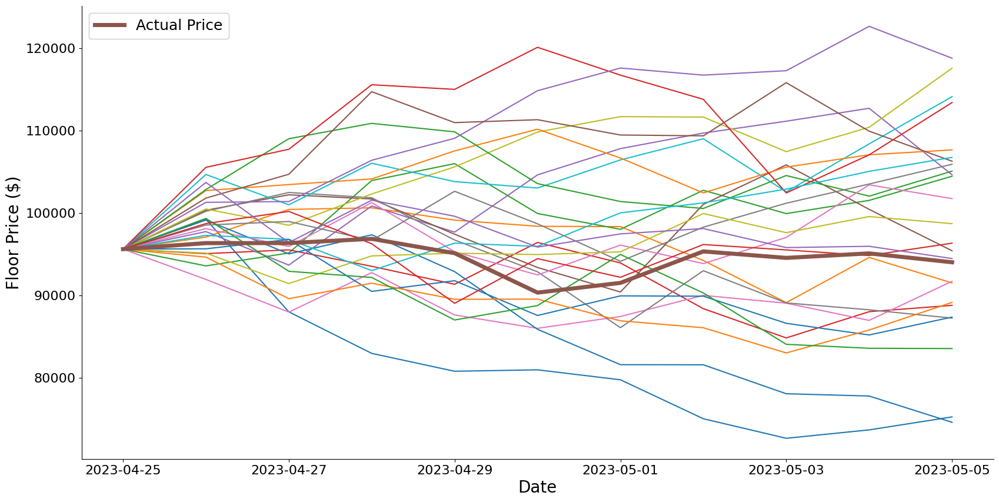

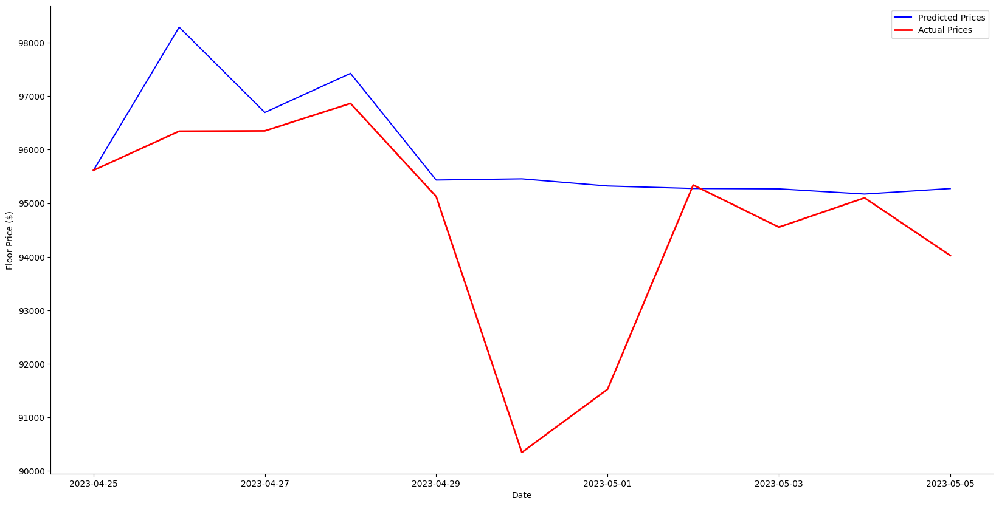

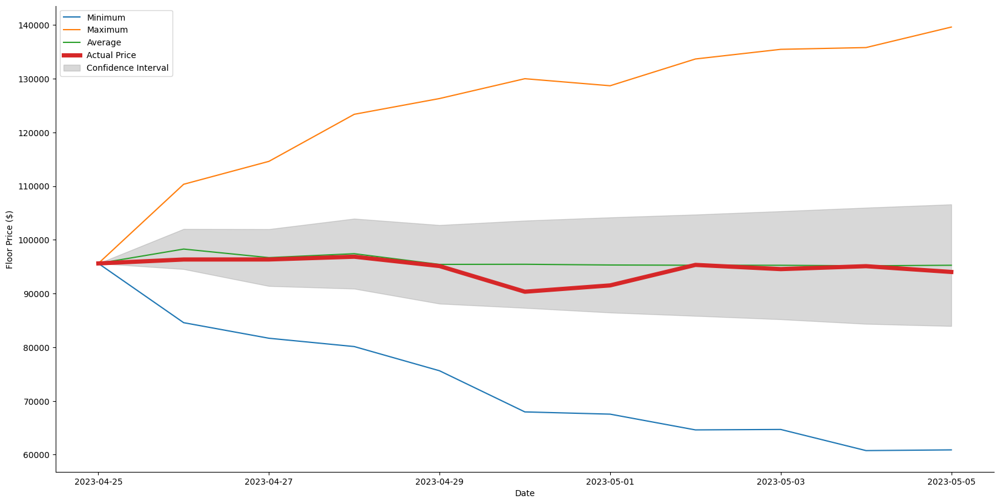

In [ ]:
T = 10
no_simulations = 1000
jump_intensity = 0.1
jump_mean = 0.05
jump_sigma = 0.2
jump_df_all_predictions, jump_actual_vs_prediction,stat1 = estimate_stock_prices(train_df,test_df,T,no_simulations,True,jump_intensity,jump_mean,jump_sigma,True,True,collection)

In [ ]:
statistics = [stat1,stat2,stat3]
statistics

[[1.3604680608809139,
  70.39986286321536,
  -64.16470548482903,
  5109.725322556318,
  0.20067179628204976,
  0.593190296153173,
  1.686853615137225],
 [6.474913108694662,
  111.54859911632191,
  -650.4798521165176,
  101.49615472668484,
  -9.866030144106738,
  -5.550042341868048,
  -4.028902417181834],
 [3.878105472772084,
  85.23380827538507,
  -3001.6489354680925,
  417.17362066557325,
  -4.694712945440578,
  -3.798183776446598,
  -1.7783668212734225]]

In [ ]:
def create_statistics_table(statistics, collection_names):
    headers = ["Statistics"] + collection_names
    table_data = [
        ["Mean Error"] + [stats[0] for stats in statistics],
        ["Variance Error"] + [stats[1] for stats in statistics],
        ["Mean Absolute Error"] + [stats[2] for stats in statistics],
        ["Mean Squared Error"] + [stats[3] for stats in statistics],
        ["Root Mean Squared Error"] + [stats[4] for stats in statistics]
    ]

    table = tabulate(table_data, headers=headers, tablefmt="grid")
    print(table)

In [ ]:
from prettytable import PrettyTable

def create_statistics_table(statistics, collection_names):
    table = PrettyTable()
    table.field_names = ["Statistics"] + collection_names
    table.align = "l"
    table.float_format = ".2f"
    table.header_style = "upper"
    table.padding_width = 1

    statistic_names = [
        "Mean Error Percentage",
        "Variance Error Percentage",
        "Mean Absolute Error Percentage",
        "Mean Squared Error Percentage",
        "Root Mean Squared Error Percentage"
    ]

    for i, statistic_name in enumerate(statistic_names):
        row = [statistic_name] + [f"{value * 100:.2f}%" for value in statistics[j][i] for j,_ in enumerate(collection_names)]
        table.add_row(row)

    # Customize the number format for scientific notation
    table.float_format = ".2e"
    table.float_precision = 2
    table.float_formatting["e"] = lambda x: f"10\u207B\u207F{x}"

    # Set the background color to white
    table.set_style({"background": "white"})

    print(table)


In [ ]:
collection_names = ["Bored Ape Yacht Club", "MoonBirds", "Azuki"]
statistics = [stat1,stat2,stat3]
create_statistics_table(statistics, collection_names)

Exception: ignored

In [ ]:
import numpy as np
from sklearn.metrics import mean_squared_error

def grid_search(train_df, test_df, T, no_simulations, jump_intensity_range, jump_mean_range, jump_sigma_range, metric='rmse'):
    best_params = {}
    best_score = np.inf

    for jump_intensity in jump_intensity_range:
        for jump_mean in jump_mean_range:
            for jump_sigma in jump_sigma_range:
                #print(no_simulations,jump_intensity,jump_mean,jump_sigma)
                jump_df_all_predictions,jump_actual_vs_prediction = estimate_stock_prices(train_df,test_df,T,no_simulations,True,jump_intensity,jump_mean,jump_sigma,False,False,collection)
                actual_prices = jump_actual_vs_prediction['Actual Prices']
                predictions = jump_actual_vs_prediction['predicted Prices']
                if metric == 'rmse':
                    score = np.sqrt(mean_squared_error(actual_prices, predictions))
                else:
                    score = np.sum(np.square(actual_prices - predictions))

                if metric == 'rmse' and score < best_score:
                    best_score = score
                    best_params = {'no_simulations': no_simulations, 'jump_intensity': jump_intensity, 'jump_mean': jump_mean, 'jump_sigma': jump_sigma}
                elif metric == 'sse' and score < best_score:
                    best_score = score
                    best_params = {'no_simulations': no_simulations, 'jump_intensity': jump_intensity, 'jump_mean': jump_mean, 'jump_sigma': jump_sigma}

    return best_params, best_score

In [ ]:
no_simulations = 1000
jump_intensity_range = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45]
jump_mean_range = [-0.2 ,-0.15 ,-0.1, -0.05, 0.0, 0.05, 0.1, 0.15, 0.2]
jump_sigma_range = [0.1, 0.2, 0.3, 0.4, 0.5]
T = 10

In [ ]:
best_params_rmse, best_score_rmse = grid_search(train_df, test_df, T, no_simulations, jump_intensity_range, jump_mean_range, jump_sigma_range, metric='rmse')

In [ ]:
#best_params_sse, best_score_sse = grid_search(train_df, test_df, T, no_simulations_range, jump_intensity_range, jump_mean_range, jump_sigma_range, metric='sse')

In [ ]:
best_params_rmse

{'no_simulations': 1000,
 'jump_intensity': 0.4,
 'jump_mean': 0.2,
 'jump_sigma': 0.3}

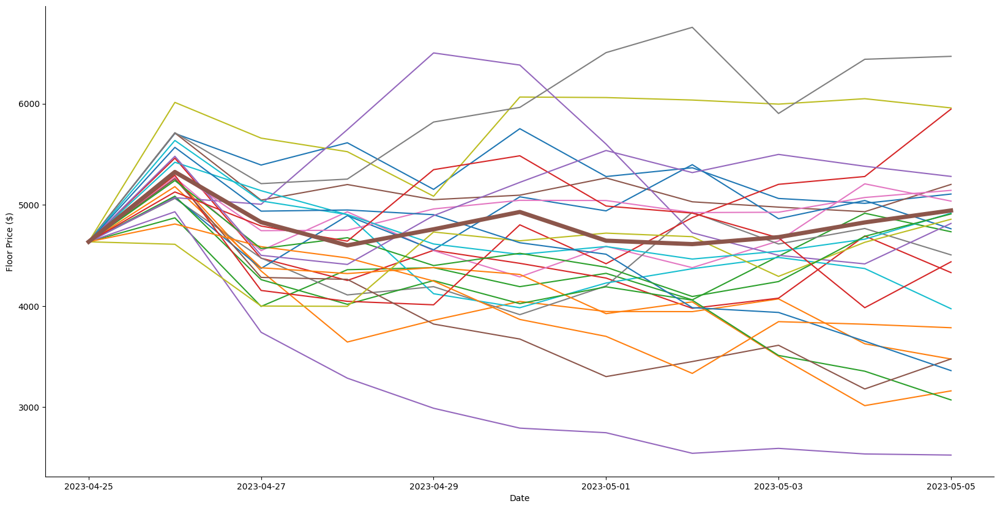

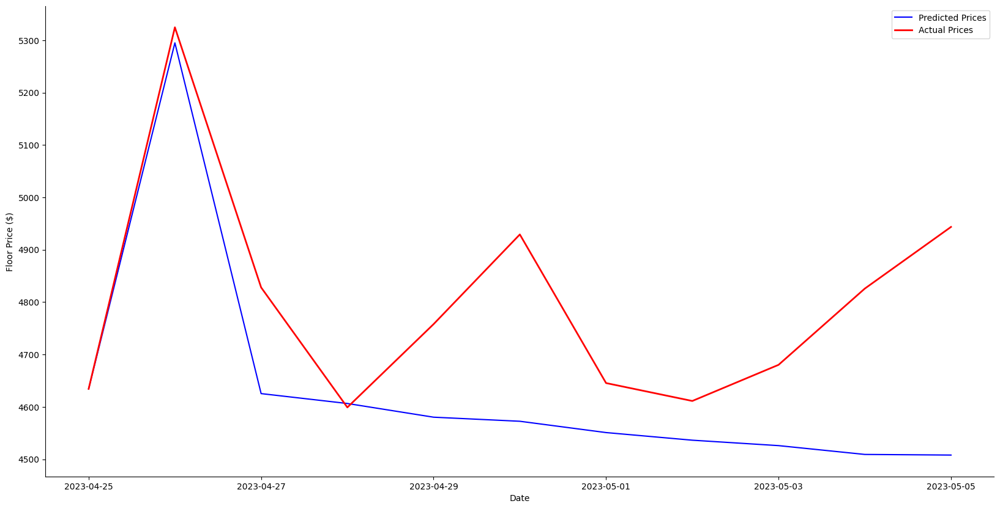

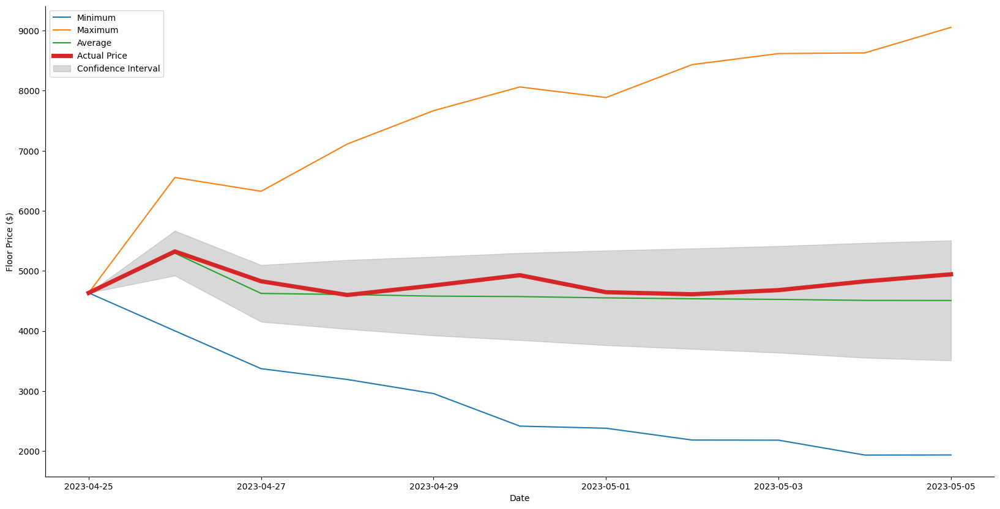

In [ ]:
T = 10
no_simulations = 1000
jump_intensity = 0.05
jump_mean = 0.2
jump_sigma = 0.1
jump_df_all_predictions, jump_actual_vs_prediction = estimate_stock_prices(train_df,test_df,T,no_simulations,True,jump_intensity,jump_mean,jump_sigma,True,True,collection)

In [ ]:
best_params_sse

{'no_simulations': 10,
 'jump_intensity': 0.45,
 'jump_mean': -0.2,
 'jump_sigma': 0.5}

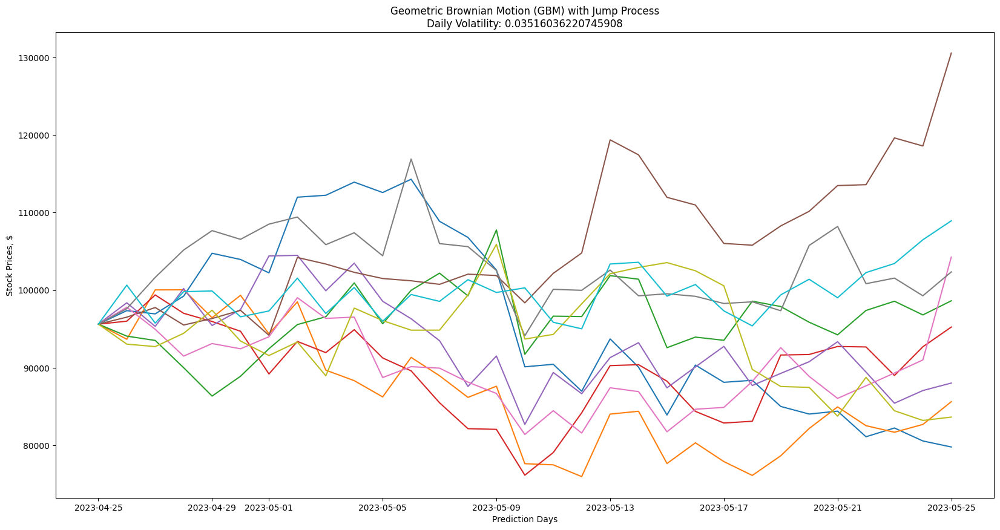

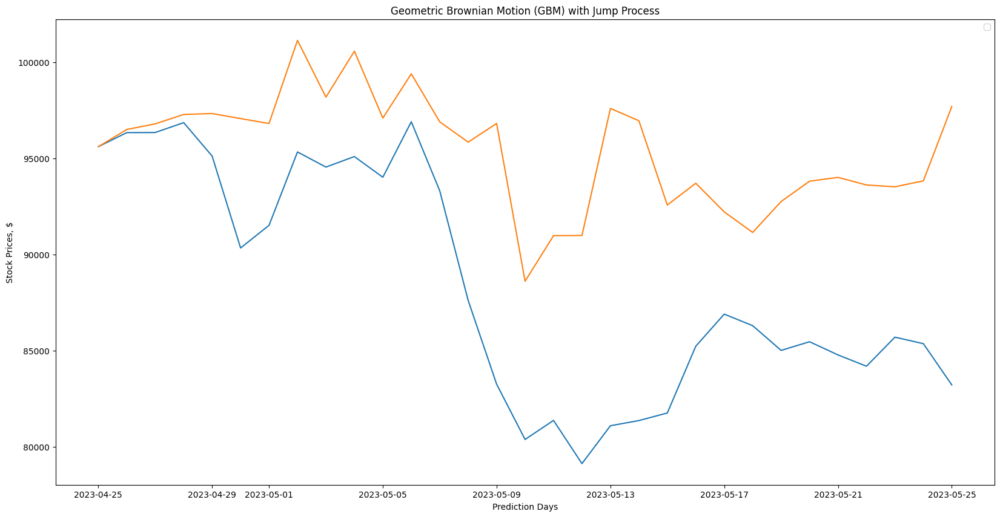

In [ ]:
T = 30
no_simulations = 10
jump_intensity = 0.3
jump_mean = -0.2
jump_sigma = 1
jump_df_all_predictions, jump_actual_vs_prediction = estimate_stock_prices(train_df,test_df,T,no_simulations,True,jump_intensity,jump_mean,jump_sigma,True)

# **Bipower Variation**

In [6]:
def calculate_bipower_variation(data,window=30):
  df['abs_Floor_return'] = df["Floor_daily_returns"].abs()
  df['BV'] = df['abs_Floor_return'] * df['abs_Floor_return'].shift(1)
  df['Rolling_BV'] = df['BV'].rolling(window).sum()
  BV = df['BV'].sum() * np.pi / 2
  df.dropna(inplace=True)
  #df['Standard Deviation'] = np.std(df['abs_Floor_return'])
  df['Standard Deviation'] = np.std(df['Floor_daily_returns'])
  # Calculate rolling volatility
  df['Volatility'] = df['Floor_daily_returns'].rolling(window).std()
  print('Bipower Variation: ', BV)
  return df, BV

In [7]:
new_df, BV = calculate_bipower_variation(train_df)

Bipower Variation:  0.4736476586193098


In [8]:
new_df.head()

,Floor Price,Average Price,Floor_daily_returns,Average_daily_returns,abs_Floor_returns,abs_Average_returns,log_Floor_returns,log_Average_returns,abs_Floor_return,BV,Rolling_BV,Standard Deviation,Volatility
DateTime,,,,,,,,,,,,,
2022-10-03,97320.750,108545.0765,0.002127,0.003916,0.212699,0.391636,0.002129,0.003924,0.002127,0.000039,0.021974,0.045128,NaN
2022-10-04,100841.625,112808.1645,0.034915,0.037791,3.491490,3.779060,0.035539,0.038523,0.034915,0.000074,0.021275,0.045128,NaN
2022-10-05,100554.000,112955.6600,-0.002860,0.001306,0.286040,0.130578,-0.002856,0.001307,0.002860,0.000100,0.021203,0.045128,NaN
2022-10-06,102405.750,114557.8990,0.018082,0.013986,1.808248,1.398628,0.018248,0.014085,0.018082,0.000052,0.021150,0.045128,NaN
2022-10-07,100480.125,112403.7665,-0.019164,-0.019164,1.916424,1.916424,-0.018983,-0.018983,0.019164,0.000347,0.021156,0.045128,NaN


# **GARCH Models**

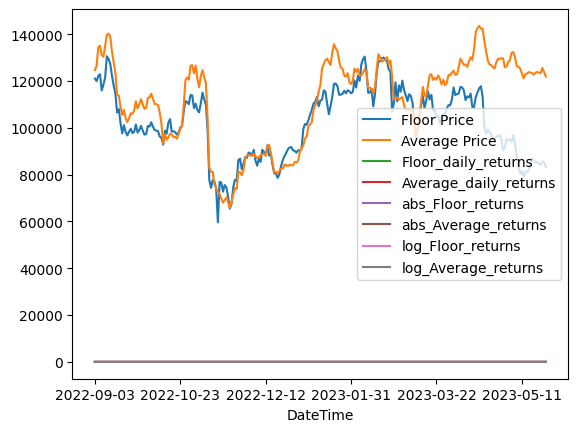

In [10]:
test_days = 100
collection = 'boredapeyachtclub'
df,train_df,test_df = load_data(collection,test_days)

In [11]:
def compute_model(df,model_type,p,q,field):
    # Compute squared returns
    #df['SquaredFloorReturns'] = df['Floor_daily_returns'] ** 2

    #make the returns stationary
    #df['Stationary_returns'] = df['Floor_daily_returns'].diff(1)
    #df = df.dropna()

    # Specify the GARCH(2, 2) model
    if model_type == 'GJR-GARCH':
      model_type = 'Garch'
      model = arch.arch_model(df[field].values, vol= model_type,mean = "Constant",o=1, p=p, q=q)
      #model = arch.arch_model(df['Floor_daily_returns'].values, vol= model_type,mean = "Constant",o=1, p=p, q=q)
    elif model_type == 'EGarch':
      model = arch.arch_model(df[field].values, vol= model_type,mean = "Constant",o=1, p=p, q=q)
    else:
      model = arch.arch_model(df[field].values, vol= model_type,mean = "Constant",p=p, q=q)
      #model = arch.arch_model(df['Floor_daily_returns'].values, vol= model_type,mean = "Constant",p=p, q=q)

    # Fit the model
    result = model.fit()

    return model,result


In [12]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'Garch'
p = 2
q = 2
field = 'abs_Floor_returns'
garch_model,result = compute_model(train_df,model_type,p,q,field)

Iteration:      1,   Func. Count:      8,   Neg. LLF: 419.2993176212756
Iteration:      2,   Func. Count:     17,   Neg. LLF: 609.2178021513887
Iteration:      3,   Func. Count:     25,   Neg. LLF: 292.32139842869947
Iteration:      4,   Func. Count:     34,   Neg. LLF: 316.3175705973027
Iteration:      5,   Func. Count:     42,   Neg. LLF: 305.6635126921775
Iteration:      6,   Func. Count:     50,   Neg. LLF: 284.3440981307956
Iteration:      7,   Func. Count:     57,   Neg. LLF: 283.8816088295145
Iteration:      8,   Func. Count:     64,   Neg. LLF: 283.59320748783045
Iteration:      9,   Func. Count:     71,   Neg. LLF: 283.5047751787066
Iteration:     10,   Func. Count:     78,   Neg. LLF: 283.48586163367634
Iteration:     11,   Func. Count:     85,   Neg. LLF: 283.4817753357448
Iteration:     12,   Func. Count:     92,   Neg. LLF: 283.4805353777042
Iteration:     13,   Func. Count:     99,   Neg. LLF: 283.4804160770277
Iteration:     14,   Func. Count:    106,   Neg. LLF: 283.480

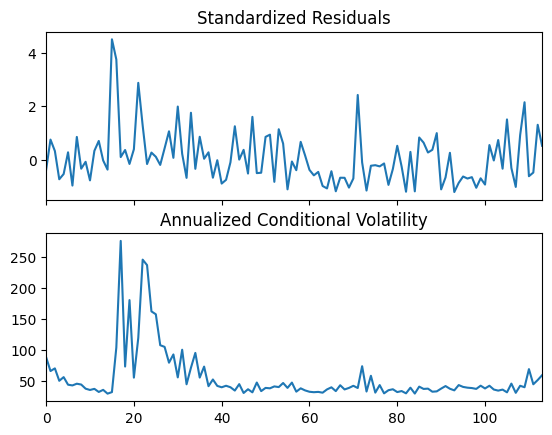

In [13]:
fig = result.plot(annualize="D")

In [14]:
result

                     Constant Mean - GARCH Model Results                      
Dep. Variable:                      y   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -283.480
Distribution:                  Normal   AIC:                           578.961
Method:            Maximum Likelihood   BIC:                           595.378
                                        No. Observations:                  114
Date:                Mon, Nov 27 2023   Df Residuals:                      113
Time:                        19:55:46   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             2.6476      0.264     10.021  1.236e-23 [  2.130,  3.16

In [ ]:
    #train_df['RealizedVolatility'] = train_df['abs_Floor_return'].rolling(window=len(test_df), min_periods=1).std() * (365 ** 0.5)
    #train_df['RealizedVolatility'].plot()

    ''' start_forecasting_date = test_df.index[0]
    # Compute the conditional volatility forecasts
    forecast = result.forecast(start = 0,horizon=len(test_df))#(start=len(train_df))
    # Extract the forecasted conditional volatilities
    #forecast_volatility = forecast.conditional_volatility[-1].values
    #forecast_variance = forecast.variance.values[-1,:]#.reshape(1,-1)[0][:len(test_df)]
    forecast_variance = np.mean(forecast.variance.values,axis=1)
    forecast_variance = forecast_variance[-100:]
    #print(forecast.variance.values[-1,:])
    #print(result.conditional_volatility)
    #print(len(forecast_variance[0]))
    forecast_volatility = np.sqrt(forecast_variance)
    test_df['Forecasted_volatility'] = forecast_volatility #result.conditional_volatility[:100] '''

    #test_df['RealizedVolatility'] = test_df['Floor_daily_returns'].rolling(window=len(test_df), min_periods=1).std() #* (365 ** 0.5)


In [15]:
def compute_volatility_predictions(df, train_df, test_df, model_type, window_length, p, q, field, real_volatility_type, lambda_param, plot=False, AIC=False):

    rolling_preds = []
    aic_scores = []

    for i in range(len(test_df)):
        train = df[:-len(test_df)+i][-window_length:]
        garch_model, result = compute_model(train, model_type, p, q, field)
        pred = result.forecast(horizon=1)
        rolling_preds.append(np.sqrt(pred.variance.values[-1, :][0]))

        if AIC:
            aic_score = result.aic
            aic_scores.append(aic_score)

    rolling_preds = pd.Series(rolling_preds, index=test_df.index)
    test_df['Forecasted_volatility'] = rolling_preds
    forecast_volatility = test_df['Forecasted_volatility'].values

    if real_volatility_type == 'normal':
        test_df['Realized_Volatility'] = df[field].rolling(window=window_length).std()[-len(test_df):]

    elif real_volatility_type == 'EWMA':
        weight0 = 1 - lambda_param
        weights = []
        weights.append(weight0)
        for i in range(window_length-1):
            weights.append(weights[i] * lambda_param)
        weights = weights[::-1]
        squares = df[field].values ** 2
        squares = squares[-len(test_df)-window_length:]

        EWMA = []
        for i in range(len(test_df)):
            values = squares[i:window_length+i]
            ewma_volatility = np.sqrt(np.sum(values * weights))
            EWMA.append(ewma_volatility)

        test_df['Realized_Volatility'] = EWMA

    realized_volatility = test_df['Realized_Volatility'].values

    mse = mean_squared_error(test_df['Realized_Volatility'], test_df['Forecasted_volatility'])

    if AIC:
        aic_curve = pd.Series(aic_scores, index=test_df.index)
        ax = aic_curve.plot(linewidth=5)
        ax.set_xlabel("Date")
        ax.set_ylabel("AIC Score")
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.legend(fontsize='large')

        aic = np.mean(aic_scores)

    if plot:
        ax = test_df[['Forecasted_volatility', 'Realized_Volatility']].plot(linewidth=5)
        ax.set_xlabel("Date")
        ax.set_ylabel("Volatility")
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.legend(fontsize='large')

    if AIC:
        return forecast_volatility, realized_volatility, mse, aic_curve, aic

    return forecast_volatility, realized_volatility, mse


Iteration:      1,   Func. Count:      9,   Neg. LLF: 2227190.429662246
Iteration:      2,   Func. Count:     22,   Neg. LLF: 12133.524491321714
Iteration:      3,   Func. Count:     31,   Neg. LLF: 17176.005587308122
Iteration:      4,   Func. Count:     40,   Neg. LLF: -63.35894563145883
Iteration:      5,   Func. Count:     48,   Neg. LLF: -63.380320307266906
Iteration:      6,   Func. Count:     56,   Neg. LLF: -63.382616439803066
Iteration:      7,   Func. Count:     64,   Neg. LLF: -63.38341960543019
Iteration:      8,   Func. Count:     72,   Neg. LLF: -63.38378458092541
Iteration:      9,   Func. Count:     80,   Neg. LLF: -63.383865548507224
Iteration:     10,   Func. Count:     88,   Neg. LLF: 29750548.20194037
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.38386560079491
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      9,   Neg. LLF: 12694

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


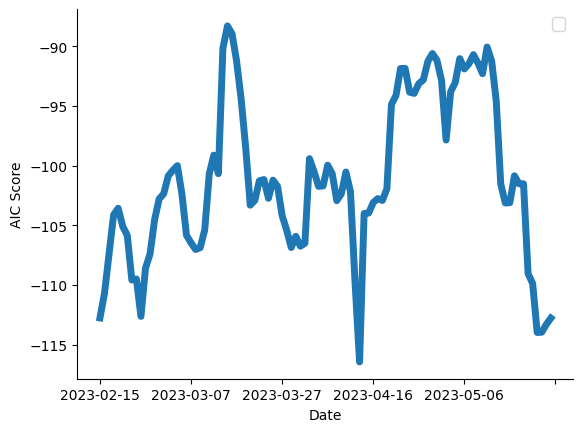

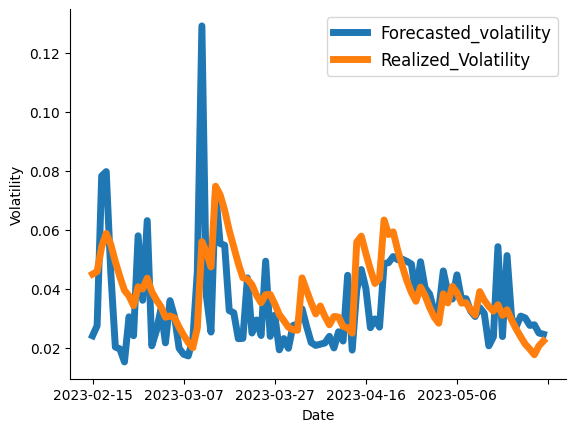

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'GJR-GARCH'
window_length = 30
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
lambda_param = 0.8
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
p = 2
q = 2
plot = True
AIC = True
forecast_volatility, realized_volatility, mse, aic_curve, aic = compute_volatility_predictions(df,train_df,test_df,model_type,window_length,p,q,field,real_volatility_type,lambda_param,plot,AIC)

In [ ]:
aic

-101.07007438611616

In [ ]:
# Existing code for compute_volatility_predictions function
def grid_search(df, train_df, test_df, model_type, p_values, q_values, lambda_values, window_length, field, real_volatility_type, plot):
    best_mse = float('inf')
    best_params = None

    for q in q_values:
        for lambda_param in lambda_values:
            #for window_length in window_lengths:
            p = q
            forecast_volatility, realized_volatility, mse = compute_volatility_predictions(df, train_df, test_df, model_type, window_length, p, q, field, real_volatility_type, lambda_param, plot)

            if mse < best_mse:
                best_mse = mse
                best_params = (p, q, lambda_param)

    return best_params, best_mse

##**optimized GARCH**

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'Garch'
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = False
AIC = False
# Example parameter values to search over
p_values = np.arange(1, 5, 1).tolist()  # Example range for p values
q_values = np.arange(1, 5, 1).tolist() # Example range for q values
lambda_values = np.round(np.arange(0.80, 0.95, 0.01),2).tolist()  # Example range for lambda_param values
#window_lengths = np.arange(15, 31, 1).tolist()  # Example range for window_length values
window_length = 30

# Example usage
best_params, best_mse = grid_search(df, train_df, test_df, model_type, p_values, q_values, lambda_values, window_length, field, real_volatility_type,plot)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
print("Best Parameters:", best_params)
print("Best MSE:", best_mse)

Best Parameters: (1, 1, 0.87)
Best MSE: 0.00020937926510098805


Iteration:      1,   Func. Count:      6,   Neg. LLF: 2153.3172931089152
Iteration:      2,   Func. Count:     15,   Neg. LLF: 153.5241610674202
Iteration:      3,   Func. Count:     24,   Neg. LLF: -49.18077908105873
Iteration:      4,   Func. Count:     29,   Neg. LLF: -49.165247297939885
Iteration:      5,   Func. Count:     35,   Neg. LLF: -36.96413545077972
Iteration:      6,   Func. Count:     41,   Neg. LLF: -49.28936750576518
Iteration:      7,   Func. Count:     46,   Neg. LLF: -49.28940493942198
Iteration:      8,   Func. Count:     51,   Neg. LLF: -49.28940531133411
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.28940531133411
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Iteration:      1,   Func. Count:      6,   Neg. LLF: 528.2489694781493
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1113.4840115799404
Iteration:      3,   Func. Count:     23,   Neg. LLF: -38.61173

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     40,   Neg. LLF: 2.4546837989120296
Iteration:      7,   Func. Count:     47,   Neg. LLF: -33.76635731856513
Iteration:      8,   Func. Count:     53,   Neg. LLF: -12.78024932346548
Iteration:      9,   Func. Count:     59,   Neg. LLF: 70.0226144789969
Iteration:     10,   Func. Count:     65,   Neg. LLF: -2.3854926478258243
Iteration:     11,   Func. Count:     71,   Neg. LLF: -10.786528912675788
Iteration:     12,   Func. Count:     77,   Neg. LLF: -19.00008208906945
Iteration:     13,   Func. Count:     83,   Neg. LLF: -19.445849217042912
Iteration:     14,   Func. Count:     89,   Neg. LLF: -18.659965365181208
Iteration:     15,   Func. Count:     95,   Neg. LLF: -47.34565205149099
Iteration:     16,   Func. Count:    101,   Neg. LLF: -48.471860218360646
Iteration:     17,   Func. Count:    106,   Neg. LLF: -48.541125981046555
Iteration:     18,   Func. Count:    111,   Neg. LLF: -48.54705530987372
Iteration:     19,   Func. Count:    116,   Ne

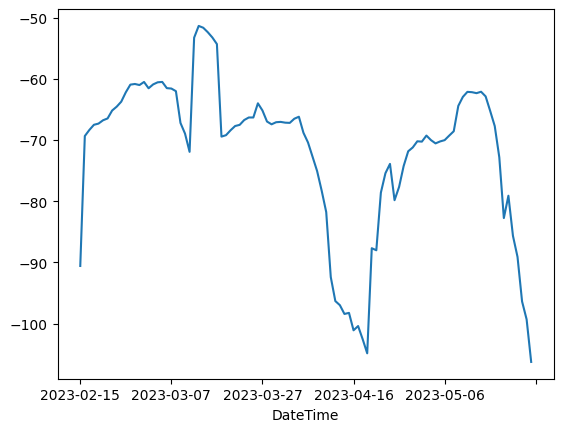

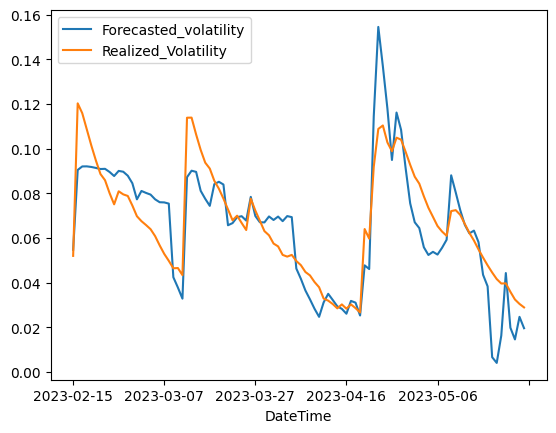

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'Garch'
window_length = 30
p, q, lambda_param= best_params
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = True
AIC = True
#p = 1
#q = 1
#lambda_param = 0.9
forecast_volatility, realized_volatility, mse, aic_curve, aic = compute_volatility_predictions(df,train_df,test_df,model_type,window_length,p,q,field,real_volatility_type,lambda_param,plot,AIC)

In [ ]:
aic

-71.82830513818917

##**optimized EGARCH**

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'EGarch'
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = False

# Example parameter values to search over
p_values = np.arange(1, 5, 1).tolist()  # Example range for p values
q_values = np.arange(1, 5, 1).tolist() # Example range for q values
lambda_values = np.round(np.arange(0.80, 0.95, 0.01),2).tolist()  # Example range for lambda_param values
#window_lengths = np.arange(15, 31, 1).tolist()  # Example range for window_length values
window_length = 30

# Example usage
best_params, best_mse = grid_search(df, train_df, test_df, model_type, p_values, q_values, lambda_values, window_length, field, real_volatility_type,plot)

Iteration:      1,   Func. Count:      7,   Neg. LLF: 6200177619368.173
Iteration:      2,   Func. Count:     18,   Neg. LLF: 39355021141.43921
Iteration:      3,   Func. Count:     27,   Neg. LLF: 726040471.6986146
Iteration:      4,   Func. Count:     35,   Neg. LLF: 103.69973133869019
Iteration:      5,   Func. Count:     43,   Neg. LLF: 460021044.163284
Iteration:      6,   Func. Count:     52,   Neg. LLF: 12358472670.68033
Iteration:      7,   Func. Count:     62,   Neg. LLF: 32.20031531602795
Iteration:      8,   Func. Count:     69,   Neg. LLF: -51.43339704595486
Iteration:      9,   Func. Count:     75,   Neg. LLF: -51.2143004066945
Iteration:     10,   Func. Count:     82,   Neg. LLF: -51.64747826710165
Iteration:     11,   Func. Count:     88,   Neg. LLF: -51.71910040437234
Iteration:     12,   Func. Count:     94,   Neg. LLF: -51.753609885861515
Iteration:     13,   Func. Count:    100,   Neg. LLF: -51.8995768416968
Iteration:     14,   Func. Count:    106,   Neg. LLF: -47.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     92,   Func. Count:    937,   Neg. LLF: 17285542.714291926
Iteration:     93,   Func. Count:    953,   Neg. LLF: 16774337.168551814
Iteration:     94,   Func. Count:    969,   Neg. LLF: -45.64924407421907
Iteration:     95,   Func. Count:    985,   Neg. LLF: -43.43381826347122
Iteration:     96,   Func. Count:  1e+03,   Neg. LLF: 859647.3104498972
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -45.138346729805
Iteration:     98,   Func. Count: 1.03e+03,   Neg. LLF: 17375593.2116822
Iteration:     99,   Func. Count: 1.05e+03,   Neg. LLF: -48.56312587563096
Iteration limit reached    (Exit mode 9)
            Current function value: -48.563065120699896
            Iterations: 100
            Function evaluations: 1048
            Gradient evaluations: 99
Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.5278586734

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     86,   Func. Count:    888,   Neg. LLF: 64178423.47450325
Iteration:     87,   Func. Count:    898,   Neg. LLF: 2336483141.570069
Iteration:     88,   Func. Count:    909,   Neg. LLF: 2389607495.4855933
Iteration:     89,   Func. Count:    920,   Neg. LLF: 2393872236.806208
Iteration:     90,   Func. Count:    931,   Neg. LLF: 2393890145.9031563
Iteration:     91,   Func. Count:    942,   Neg. LLF: 2433464469.548292
Iteration:     92,   Func. Count:    954,   Neg. LLF: 2951139544.6487126
Iteration:     93,   Func. Count:    963,   Neg. LLF: -43.218773858360365
Iteration:     94,   Func. Count:    969,   Neg. LLF: 34516733.064391814
Iteration:     95,   Func. Count:    977,   Neg. LLF: 248239261.0792254
Iteration:     96,   Func. Count:    986,   Neg. LLF: 70857260.62095203
Iteration:     97,   Func. Count:    994,   Neg. LLF: -43.3890674760828
Iteration limit reached    (Exit mode 9)
            Current function value: -43.3890263003974
            Iterations: 100
       

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     58,   Neg. LLF: 8197794.334460205
Iteration:      8,   Func. Count:     65,   Neg. LLF: 17119858.74038423
Iteration:      9,   Func. Count:     72,   Neg. LLF: 28767585.304449186
Iteration:     10,   Func. Count:     79,   Neg. LLF: 29070408.765213184
Iteration:     11,   Func. Count:     86,   Neg. LLF: 68470848.7155343
Iteration:     12,   Func. Count:     95,   Neg. LLF: 334689386.3364234
Iteration:     13,   Func. Count:    105,   Neg. LLF: 204839064.1957391
Iteration:     14,   Func. Count:    115,   Neg. LLF: 468377806.53624743
Iteration:     15,   Func. Count:    125,   Neg. LLF: 29065447.063777395
Iteration:     16,   Func. Count:    132,   Neg. LLF: 26345458.401391543
Iteration:     17,   Func. Count:    140,   Neg. LLF: 28634152.13871636
Iteration:     18,   Func. Count:    148,   Neg. LLF: 21261886.571277667
Iteration:     19,   Func. Count:    155,   Neg. LLF: -28.51910632643202
Iteration:     20,   Func. Count:    162,   Neg. LLF: 6042

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    391,   Neg. LLF: 8684.376344062726
Iteration:     46,   Func. Count:    407,   Neg. LLF: 9187.291016812278
Iteration:     47,   Func. Count:    423,   Neg. LLF: 9246.355528783222
Iteration:     48,   Func. Count:    439,   Neg. LLF: 9257.770393543235
Iteration:     49,   Func. Count:    455,   Neg. LLF: 9359.086596694113
Iteration:     50,   Func. Count:    471,   Neg. LLF: 9427.479172280118
Iteration:     51,   Func. Count:    487,   Neg. LLF: 9443.523218283182
Iteration:     52,   Func. Count:    503,   Neg. LLF: 9430.189105245947
Iteration:     53,   Func. Count:    519,   Neg. LLF: 10867.516337639927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.60632430256853
            Iterations: 53
            Function evaluations: 529
            Gradient evaluations: 53
Iteration:      1,   Func. Count:      7,   Neg. LLF: 153.59535354416795
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1306051488550

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     27,   Neg. LLF: 1092985258.5517278
Iteration:      4,   Func. Count:     36,   Neg. LLF: 757941886.2979506
Iteration:      5,   Func. Count:     44,   Neg. LLF: 25235172.887259074
Iteration:      6,   Func. Count:     52,   Neg. LLF: 1164268419.238995
Iteration:      7,   Func. Count:     61,   Neg. LLF: 417394129.04609525
Iteration:      8,   Func. Count:     70,   Neg. LLF: 22657846.75446753
Iteration:      9,   Func. Count:     78,   Neg. LLF: -40.44009335208127
Iteration:     10,   Func. Count:     85,   Neg. LLF: -29.752747405406765
Iteration:     11,   Func. Count:     92,   Neg. LLF: 23.16842362302063
Iteration:     12,   Func. Count:    100,   Neg. LLF: 22943172.381361745
Iteration:     13,   Func. Count:    108,   Neg. LLF: 1425784.076218201
Iteration:     14,   Func. Count:    115,   Neg. LLF: -40.7792316314071
Iteration:     15,   Func. Count:    122,   Neg. LLF: -39.345041389917945
Iteration:     16,   Func. Count:    129,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 48637532.25763458
Iteration:      3,   Func. Count:     26,   Neg. LLF: 186453939674.63257
Iteration:      4,   Func. Count:     35,   Neg. LLF: 803478771.6157094
Iteration:      5,   Func. Count:     44,   Neg. LLF: 13059111.96222721
Iteration:      6,   Func. Count:     51,   Neg. LLF: 2926460.31677942
Iteration:      7,   Func. Count:     58,   Neg. LLF: 42962748.01939661
Iteration:      8,   Func. Count:     66,   Neg. LLF: 13098576.849534148
Iteration:      9,   Func. Count:     73,   Neg. LLF: -42.5057234400449
Iteration:     10,   Func. Count:     79,   Neg. LLF: -42.837829993890516
Iteration:     11,   Func. Count:     85,   Neg. LLF: 715172.9992503846
Iteration:     12,   Func. Count:     92,   Neg. LLF: 13668863.81168286
Iteration:     13,   Func. Count:    100,   Neg. LLF: 17634602.362648927
Iteration:     14,   Func. Count:    108,   Neg. LLF: 13946253.658165047
Iteration:     15,   Func. Count:    116,   Neg. LLF: 13011

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    344,   Neg. LLF: 12284943.788364626
Iteration:     42,   Func. Count:    360,   Neg. LLF: 12284893.688110763
Iteration:     43,   Func. Count:    376,   Neg. LLF: 12285090.90262603
Iteration:     44,   Func. Count:    385,   Neg. LLF: 12223031.417870322
Iteration:     45,   Func. Count:    401,   Neg. LLF: 5517491806.304425
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.95147881406538
            Iterations: 45
            Function evaluations: 410
            Gradient evaluations: 45
Iteration:      1,   Func. Count:      7,   Neg. LLF: 22472296059357.117
Iteration:      2,   Func. Count:     17,   Neg. LLF: 5945871151.294583
Iteration:      3,   Func. Count:     26,   Neg. LLF: 196170621669.8118
Iteration:      4,   Func. Count:     35,   Neg. LLF: 1002851390.6719496
Iteration:      5,   Func. Count:     43,   Neg. LLF: 3421409.960518642
Iteration:      6,   Func. Count:     50,   Neg. LLF: 20483751.4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    432,   Neg. LLF: 33.44150969951981
Iteration:     52,   Func. Count:    442,   Neg. LLF: 10580228.908768442
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65184366265718
            Iterations: 54
            Function evaluations: 452
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      7,   Neg. LLF: 2365917314456.8965
Iteration:      2,   Func. Count:     17,   Neg. LLF: 83609729798.521
Iteration:      3,   Func. Count:     26,   Neg. LLF: 25716396466.501457
Iteration:      4,   Func. Count:     35,   Neg. LLF: 2385785248.8024344
Iteration:      5,   Func. Count:     44,   Neg. LLF: 27319292.285982106
Iteration:      6,   Func. Count:     51,   Neg. LLF: 60277615.91361683
Iteration:      7,   Func. Count:     59,   Neg. LLF: 10378556112.974909
Iteration:      8,   Func. Count:     68,   Neg. LLF: 27936998.51035998
Iteration:      9,   Func. Count:     75,   Neg. LLF: 14780389.76

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    256,   Neg. LLF: 23633040.016675234
Iteration:     36,   Func. Count:    264,   Neg. LLF: 2355274.9815029623
Iteration:     37,   Func. Count:    274,   Neg. LLF: 22432572.278575532
Iteration:     38,   Func. Count:    284,   Neg. LLF: 22546729.939467758
Iteration:     39,   Func. Count:    296,   Neg. LLF: 22910364.065078415
Iteration:     40,   Func. Count:    308,   Neg. LLF: 23536625.615519144
Iteration:     41,   Func. Count:    320,   Neg. LLF: 23552827.437969185
Iteration:     42,   Func. Count:    334,   Neg. LLF: 23977019.033909544
Iteration:     43,   Func. Count:    347,   Neg. LLF: 24363279.773853693
Iteration:     44,   Func. Count:    361,   Neg. LLF: 27271711.12001022
Iteration:     45,   Func. Count:    376,   Neg. LLF: 27630367.25671559
Iteration:     46,   Func. Count:    392,   Neg. LLF: 28006165.527620472
Iteration:     47,   Func. Count:    408,   Neg. LLF: 28416341.428963423
Iteration:     48,   Func. Count:    424,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    118,   Neg. LLF: -37.17302363256602
Iteration:     17,   Func. Count:    125,   Neg. LLF: 6.925896739291764
Iteration:     18,   Func. Count:    132,   Neg. LLF: -41.11139215398676
Iteration:     19,   Func. Count:    139,   Neg. LLF: -47.143682764641795
Iteration:     20,   Func. Count:    145,   Neg. LLF: 3392647.5972460173
Iteration:     21,   Func. Count:    152,   Neg. LLF: 20213753.380420867
Iteration:     22,   Func. Count:    161,   Neg. LLF: 75235477.51325814
Iteration:     23,   Func. Count:    170,   Neg. LLF: -47.997294539728664
Iteration:     24,   Func. Count:    176,   Neg. LLF: 103.8662485730113
Iteration:     25,   Func. Count:    184,   Neg. LLF: 167464262.00372484
Iteration:     26,   Func. Count:    193,   Neg. LLF: -44.62389841021552
Iteration:     27,   Func. Count:    200,   Neg. LLF: 4032354.2296949625
Iteration:     28,   Func. Count:    207,   Neg. LLF: 22062524.177229732
Iteration:     29,   Func. Count:    216,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    160,   Neg. LLF: 19768180.712620944
Iteration:     23,   Func. Count:    168,   Neg. LLF: 2946892.047446195
Iteration:     24,   Func. Count:    175,   Neg. LLF: 26268352.8441332
Iteration:     25,   Func. Count:    183,   Neg. LLF: 26487986.339091644
Iteration:     26,   Func. Count:    191,   Neg. LLF: 26556058.134398423
Iteration:     27,   Func. Count:    200,   Neg. LLF: 18315479.46543611
Iteration:     28,   Func. Count:    208,   Neg. LLF: 18075867.237469535
Iteration:     29,   Func. Count:    216,   Neg. LLF: 687260.6381939901
Iteration:     30,   Func. Count:    223,   Neg. LLF: -47.47253872705283
Iteration:     31,   Func. Count:    230,   Neg. LLF: -47.84693468019
Iteration:     32,   Func. Count:    236,   Neg. LLF: -46.92291119417426
Iteration:     33,   Func. Count:    243,   Neg. LLF: 16306314.268750299
Iteration:     34,   Func. Count:    252,   Neg. LLF: -48.36892333329798
Iteration:     35,   Func. Count:    258,   Neg. LLF: 2532

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     58,   Func. Count:    418,   Neg. LLF: -46.88272457298521
Iteration:     59,   Func. Count:    424,   Neg. LLF: -46.972584261040296
Iteration:     60,   Func. Count:    430,   Neg. LLF: -44.464465707470126
Iteration:     61,   Func. Count:    438,   Neg. LLF: -46.91918126666622
Iteration:     62,   Func. Count:    445,   Neg. LLF: 3581682.12920529
Iteration:     63,   Func. Count:    454,   Neg. LLF: 2812418.9394600624
Iteration:     64,   Func. Count:    470,   Neg. LLF: 545460.2811260184
Iteration:     65,   Func. Count:    486,   Neg. LLF: 3583580.194455134
Iteration:     66,   Func. Count:    502,   Neg. LLF: 3768807.4482711274
Iteration:     67,   Func. Count:    518,   Neg. LLF: 4680330.031512075
Iteration:     68,   Func. Count:    534,   Neg. LLF: 4681799.729195377
Iteration:     69,   Func. Count:    550,   Neg. LLF: 4682249.828796974
Iteration:     70,   Func. Count:    566,   Neg. LLF: 4682639.567762557
Iteration:     71,   Func. Count:    582,   Neg. LLF: 46

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     48,   Neg. LLF: 4923950.03844824
Iteration:      7,   Func. Count:     55,   Neg. LLF: 3847060.2860718253
Iteration:      8,   Func. Count:     62,   Neg. LLF: -34.01245495381929
Iteration:      9,   Func. Count:     69,   Neg. LLF: -41.69995094433487
Iteration:     10,   Func. Count:     76,   Neg. LLF: -42.77705820008953
Iteration:     11,   Func. Count:     82,   Neg. LLF: -30.085051612735597
Iteration:     12,   Func. Count:     89,   Neg. LLF: 131.56702133598674
Iteration:     13,   Func. Count:     97,   Neg. LLF: 113.17272667848556
Iteration:     14,   Func. Count:    105,   Neg. LLF: -43.8188774421907
Iteration:     15,   Func. Count:    111,   Neg. LLF: -44.1917392012565
Iteration:     16,   Func. Count:    117,   Neg. LLF: -44.41500998838864
Iteration:     17,   Func. Count:    123,   Neg. LLF: -44.33163437242345
Iteration:     18,   Func. Count:    130,   Neg. LLF: -44.63396428578585
Iteration:     19,   Func. Count:    136,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     87,   Func. Count:    916,   Neg. LLF: -8.523376252263924
Iteration:     88,   Func. Count:    932,   Neg. LLF: -8.488777719845457
Iteration:     89,   Func. Count:    948,   Neg. LLF: -8.478707892125534
Iteration:     90,   Func. Count:    964,   Neg. LLF: -8.491146890791786
Iteration:     91,   Func. Count:    980,   Neg. LLF: -22.093333056403697
Iteration:     92,   Func. Count:    996,   Neg. LLF: 63677433.917117395
Iteration:     93,   Func. Count: 1.01e+03,   Neg. LLF: -57.78607474079939
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.78606939319209
            Iterations: 97
            Function evaluations: 1008
            Gradient evaluations: 93
Iteration:      1,   Func. Count:      7,   Neg. LLF: 3296720723401.5767
Iteration:      2,   Func. Count:     17,   Neg. LLF: 27499438.368909243
Iteration:      3,   Func. Count:     25,   Neg. LLF: 88327459.32826588
Iteration:      4,   Func. Count:     34,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.38329317140245
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.38329317128033
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1036202636420.9412
Iteration:      2,   Func. Count:     17,   Neg. LLF: 53246422.63922013
Iteration:      3,   Func. Count:     25,   Neg. LLF: 67409712.86259145
Iteration:      4,   Func. Count:     34,   Neg. LLF: -39.08505710207077
Iteration:      5,   Func. Count:     41,   Neg. LLF: -38.12603887692482
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.176460100601226
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.332

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:     93,   Neg. LLF: 2222004.668992732
Iteration:     13,   Func. Count:    100,   Neg. LLF: -31.5916450275272
Iteration:     14,   Func. Count:    107,   Neg. LLF: -39.469061192870946
Iteration:     15,   Func. Count:    113,   Neg. LLF: -26.693059461281585
Iteration:     16,   Func. Count:    120,   Neg. LLF: 144.54928806187482
Iteration:     17,   Func. Count:    129,   Neg. LLF: 2549774.2758865063
Iteration:     18,   Func. Count:    137,   Neg. LLF: -40.10772194104607
Iteration:     19,   Func. Count:    144,   Neg. LLF: -40.40357533269699
Iteration:     20,   Func. Count:    150,   Neg. LLF: -40.90706029167848
Iteration:     21,   Func. Count:    156,   Neg. LLF: 10921638.333733859
Iteration:     22,   Func. Count:    164,   Neg. LLF: 253644685.03224906
Iteration:     23,   Func. Count:    173,   Neg. LLF: 330551926.0015724
Iteration:     24,   Func. Count:    182,   Neg. LLF: 43090529.052985236
Iteration:     25,   Func. Count:    190,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 47238768424.273094
Iteration:      2,   Func. Count:     17,   Neg. LLF: 8388783.027425615
Iteration:      3,   Func. Count:     26,   Neg. LLF: 31620.23000706304
Iteration:      4,   Func. Count:     34,   Neg. LLF: 73984726.88123864
Iteration:      5,   Func. Count:     42,   Neg. LLF: -41.08348842060685
Iteration:      6,   Func. Count:     50,   Neg. LLF: -43.24504066873458
Iteration:      7,   Func. Count:     57,   Neg. LLF: -45.31937489308353
Iteration:      8,   Func. Count:     64,   Neg. LLF: -45.18116368358948
Iteration:      9,   Func. Count:     71,   Neg. LLF: -46.04087349363188
Iteration:     10,   Func. Count:     77,   Neg. LLF: -46.65445181115569
Iteration:     11,   Func. Count:     83,   Neg. LLF: -46.81074290028078
Iteration:     12,   Func. Count:     89,   Neg. LLF: -46.82985956147179
Iteration:     13,   Func. Count:     95,   Neg. LLF: -46.83752341223774
Iteration:     14,   Func. Count:    101,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    146,   Neg. LLF: -52.12786594345097
Iteration:     21,   Func. Count:    152,   Neg. LLF: -52.128473343839865
Iteration:     22,   Func. Count:    158,   Neg. LLF: -52.128862557424085
Iteration:     23,   Func. Count:    164,   Neg. LLF: -52.12976682179659
Iteration:     24,   Func. Count:    170,   Neg. LLF: -52.132441106143254
Iteration:     25,   Func. Count:    176,   Neg. LLF: -52.13312501065661
Iteration:     26,   Func. Count:    183,   Neg. LLF: -52.08901950710019
Iteration:     27,   Func. Count:    190,   Neg. LLF: -51.8907431468935
Iteration:     28,   Func. Count:    197,   Neg. LLF: -50.53193544726986
Iteration:     29,   Func. Count:    204,   Neg. LLF: -51.297248678995594
Iteration:     30,   Func. Count:    211,   Neg. LLF: -51.9666975069208
Iteration:     31,   Func. Count:    218,   Neg. LLF: -52.50492899936151
Iteration:     32,   Func. Count:    224,   Neg. LLF: 17141821.462057874
Iteration:     33,   Func. Count:    233,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    134,   Neg. LLF: -43.80929818023326
Iteration:     18,   Func. Count:    140,   Neg. LLF: 30883116.776076384
Iteration:     19,   Func. Count:    148,   Neg. LLF: 30871583.51747592
Iteration:     20,   Func. Count:    156,   Neg. LLF: 30853623.991427332
Iteration:     21,   Func. Count:    164,   Neg. LLF: 30842143.89113445
Iteration:     22,   Func. Count:    172,   Neg. LLF: 30880145.317428827
Iteration:     23,   Func. Count:    181,   Neg. LLF: 30874639.63894298
Iteration:     24,   Func. Count:    189,   Neg. LLF: 41.46013342647929
Iteration:     25,   Func. Count:    196,   Neg. LLF: 51.82703098137548
Iteration:     26,   Func. Count:    205,   Neg. LLF: -45.82607766313769
Iteration:     27,   Func. Count:    211,   Neg. LLF: 30074429.370819904
Iteration:     28,   Func. Count:    219,   Neg. LLF: 15947891.885616228
Iteration:     29,   Func. Count:    226,   Neg. LLF: -25.02816380100885
Iteration:     30,   Func. Count:    233,   Neg. LLF: 39

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    140,   Neg. LLF: 36668963.21814257
Iteration:     19,   Func. Count:    148,   Neg. LLF: 41508971.724679284
Iteration:     20,   Func. Count:    157,   Neg. LLF: 42400390.59381454
Iteration:     21,   Func. Count:    166,   Neg. LLF: 29982043.59203447
Iteration:     22,   Func. Count:    174,   Neg. LLF: 26430111.52008657
Iteration:     23,   Func. Count:    181,   Neg. LLF: -42.48160183586688
Iteration:     24,   Func. Count:    187,   Neg. LLF: -42.551374580676466
Iteration:     25,   Func. Count:    193,   Neg. LLF: -19.899397315651306
Iteration:     26,   Func. Count:    200,   Neg. LLF: 23372591.42577029
Iteration:     27,   Func. Count:    207,   Neg. LLF: 31157959.340550307
Iteration:     28,   Func. Count:    215,   Neg. LLF: 32163665.603368416
Iteration:     29,   Func. Count:    224,   Neg. LLF: -42.78443905105631
Iteration:     30,   Func. Count:    231,   Neg. LLF: 2087.681979105799
Iteration:     31,   Func. Count:    238,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    204,   Neg. LLF: -35.47506015241859
Iteration:     27,   Func. Count:    211,   Neg. LLF: -44.95488557193654
Iteration:     28,   Func. Count:    218,   Neg. LLF: 1402250.2838337242
Iteration:     29,   Func. Count:    225,   Neg. LLF: 415280.8540969495
Iteration:     30,   Func. Count:    232,   Neg. LLF: 413459.96151993127
Iteration:     31,   Func. Count:    239,   Neg. LLF: 9867.367338513242
Iteration:     32,   Func. Count:    246,   Neg. LLF: 397.89603831101647
Iteration:     33,   Func. Count:    253,   Neg. LLF: 416158.53998319025
Iteration:     34,   Func. Count:    260,   Neg. LLF: 565366.5905683754
Iteration:     35,   Func. Count:    267,   Neg. LLF: 1707093.8156602038
Iteration:     36,   Func. Count:    274,   Neg. LLF: -13.566184857311182
Iteration:     37,   Func. Count:    281,   Neg. LLF: -5.1243848910417995
Iteration:     38,   Func. Count:    289,   Neg. LLF: 4971.6805585644115
Iteration:     39,   Func. Count:    298,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     27,   Neg. LLF: 507790047.31771934
Iteration:      4,   Func. Count:     36,   Neg. LLF: 1054673925.2125666
Iteration:      5,   Func. Count:     45,   Neg. LLF: 3232642296.562076
Iteration:      6,   Func. Count:     54,   Neg. LLF: 3346889892.6640906
Iteration:      7,   Func. Count:     62,   Neg. LLF: 23491485.93659936
Iteration:      8,   Func. Count:     71,   Neg. LLF: 20315675.36790721
Iteration:      9,   Func. Count:     79,   Neg. LLF: 12794754.03610008
Iteration:     10,   Func. Count:     87,   Neg. LLF: 12795161.708818328
Iteration:     11,   Func. Count:     96,   Neg. LLF: -42.157220114437045
Iteration:     12,   Func. Count:    102,   Neg. LLF: 360049610.73581445
Iteration:     13,   Func. Count:    112,   Neg. LLF: -42.26863754371931
Iteration:     14,   Func. Count:    118,   Neg. LLF: -39.01522454081838
Iteration:     15,   Func. Count:    125,   Neg. LLF: 20182984.985430975
Iteration:     16,   Func. Count:    133,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    146,   Neg. LLF: -44.319581689809034
Iteration:     20,   Func. Count:    152,   Neg. LLF: -44.5921309195106
Iteration:     21,   Func. Count:    158,   Neg. LLF: 2431017.7122074785
Iteration:     22,   Func. Count:    165,   Neg. LLF: 14795233.294218758
Iteration:     23,   Func. Count:    173,   Neg. LLF: -42.77866318847287
Iteration:     24,   Func. Count:    180,   Neg. LLF: -36.57344298205045
Iteration:     25,   Func. Count:    187,   Neg. LLF: 12753544.912201844
Iteration:     26,   Func. Count:    195,   Neg. LLF: 204375.41690399882
Iteration:     27,   Func. Count:    202,   Neg. LLF: 12931959.657914063
Iteration:     28,   Func. Count:    210,   Neg. LLF: 15397011.629439633
Iteration:     29,   Func. Count:    218,   Neg. LLF: -46.95687923365374
Iteration:     30,   Func. Count:    224,   Neg. LLF: 10003.853545211941
Iteration:     31,   Func. Count:    231,   Neg. LLF: 2634747.0802723374
Iteration:     32,   Func. Count:    239,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 22472296059357.117
Iteration:      2,   Func. Count:     17,   Neg. LLF: 5945871151.294583
Iteration:      3,   Func. Count:     26,   Neg. LLF: 196170621669.8118
Iteration:      4,   Func. Count:     35,   Neg. LLF: 1002851390.6719496
Iteration:      5,   Func. Count:     43,   Neg. LLF: 3421409.960518642
Iteration:      6,   Func. Count:     50,   Neg. LLF: 20483751.419723902
Iteration:      7,   Func. Count:     57,   Neg. LLF: -35.18643870434724
Iteration:      8,   Func. Count:     64,   Neg. LLF: 1443997.4927240058
Iteration:      9,   Func. Count:     71,   Neg. LLF: 15792823.892274665
Iteration:     10,   Func. Count:     79,   Neg. LLF: 2851144.4559338493
Iteration:     11,   Func. Count:     86,   Neg. LLF: -44.19280945039458
Iteration:     12,   Func. Count:     92,   Neg. LLF: -45.156874706684256
Iteration:     13,   Func. Count:     98,   Neg. LLF: -45.66325800584186
Iteration:     14,   Func. Count:    104,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    137,   Neg. LLF: -44.62087987640993
Iteration:     18,   Func. Count:    144,   Neg. LLF: -44.93949391087216
Iteration:     19,   Func. Count:    150,   Neg. LLF: -44.25203703843567
Iteration:     20,   Func. Count:    157,   Neg. LLF: 86.20887173290001
Iteration:     21,   Func. Count:    165,   Neg. LLF: -45.35303608421393
Iteration:     22,   Func. Count:    171,   Neg. LLF: -45.562171667721415
Iteration:     23,   Func. Count:    177,   Neg. LLF: 10988966.022540048
Iteration:     24,   Func. Count:    184,   Neg. LLF: 12604777.99617672
Iteration:     25,   Func. Count:    193,   Neg. LLF: -45.40538364791485
Iteration:     26,   Func. Count:    200,   Neg. LLF: -35.359668992079975
Iteration:     27,   Func. Count:    207,   Neg. LLF: 12255035.387061471
Iteration:     28,   Func. Count:    223,   Neg. LLF: 12249226.739693956
Iteration:     29,   Func. Count:    239,   Neg. LLF: 12248274.750140158
Iteration:     30,   Func. Count:    255,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     26,   Neg. LLF: 839231011.086473
Iteration:      4,   Func. Count:     34,   Neg. LLF: 2379607067.829059
Iteration:      5,   Func. Count:     42,   Neg. LLF: 259418.90191140876
Iteration:      6,   Func. Count:     49,   Neg. LLF: 73.66573546334655
Iteration:      7,   Func. Count:     56,   Neg. LLF: 90.01596022580642
Iteration:      8,   Func. Count:     64,   Neg. LLF: 20.87157915213436
Iteration:      9,   Func. Count:     71,   Neg. LLF: -43.804559435408756
Iteration:     10,   Func. Count:     78,   Neg. LLF: -28.899701537425408
Iteration:     11,   Func. Count:     86,   Neg. LLF: 23493582.633157186
Iteration:     12,   Func. Count:     93,   Neg. LLF: 24872290.72259663
Iteration:     13,   Func. Count:    101,   Neg. LLF: 20909872.15447752
Iteration:     14,   Func. Count:    108,   Neg. LLF: -44.729341911628666
Iteration:     15,   Func. Count:    115,   Neg. LLF: 21119535.257134255
Iteration:     16,   Func. Count:    122,   Neg. LLF: 21

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     24,   Neg. LLF: 281511052.15060586
Iteration:      4,   Func. Count:     32,   Neg. LLF: 15884918.998746509
Iteration:      5,   Func. Count:     40,   Neg. LLF: 3915169.416344137
Iteration:      6,   Func. Count:     47,   Neg. LLF: 89.89555739215248
Iteration:      7,   Func. Count:     54,   Neg. LLF: 98.84019142415056
Iteration:      8,   Func. Count:     61,   Neg. LLF: 80.78658029889681
Iteration:      9,   Func. Count:     68,   Neg. LLF: -40.8389207216094
Iteration:     10,   Func. Count:     75,   Neg. LLF: -44.27293876083415
Iteration:     11,   Func. Count:     81,   Neg. LLF: 20595128.345648378
Iteration:     12,   Func. Count:     88,   Neg. LLF: 1259900279.1827555
Iteration:     13,   Func. Count:     97,   Neg. LLF: -44.95769543569513
Iteration:     14,   Func. Count:    104,   Neg. LLF: -46.01036636325649
Iteration:     15,   Func. Count:    110,   Neg. LLF: 20359810.74197172
Iteration:     16,   Func. Count:    118,   Neg. LLF: -37

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 638170461962.4868
Iteration:      2,   Func. Count:     17,   Neg. LLF: 26311481.18246877
Iteration:      3,   Func. Count:     25,   Neg. LLF: 268108635.30500314
Iteration:      4,   Func. Count:     33,   Neg. LLF: 378072161.30862796
Iteration:      5,   Func. Count:     41,   Neg. LLF: -13.272715421741928
Iteration:      6,   Func. Count:     49,   Neg. LLF: 29931374.891106926
Iteration:      7,   Func. Count:     57,   Neg. LLF: 10.510560949030268
Iteration:      8,   Func. Count:     64,   Neg. LLF: -42.71717410744318
Iteration:      9,   Func. Count:     70,   Neg. LLF: 11175272.34301059
Iteration:     10,   Func. Count:     77,   Neg. LLF: 1028042.8651575029
Iteration:     11,   Func. Count:     84,   Neg. LLF: 7.328338710625388
Iteration:     12,   Func. Count:     91,   Neg. LLF: -12.307135592845436
Iteration:     13,   Func. Count:     98,   Neg. LLF: -44.868143454348655
Iteration:     14,   Func. Count:    104,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     66,   Func. Count:    638,   Neg. LLF: 4519541.722468556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.432555147016735
            Iterations: 66
            Function evaluations: 648
            Gradient evaluations: 66
Iteration:      1,   Func. Count:      7,   Neg. LLF: 194649855337.3569
Iteration:      2,   Func. Count:     17,   Neg. LLF: 41.2849905198062
Iteration:      3,   Func. Count:     25,   Neg. LLF: 1121856677.191368
Iteration:      4,   Func. Count:     33,   Neg. LLF: 219317108.81792513
Iteration:      5,   Func. Count:     41,   Neg. LLF: 33899562.02692318
Iteration:      6,   Func. Count:     49,   Neg. LLF: 93970776.51623814
Iteration:      7,   Func. Count:     57,   Neg. LLF: 24167012.769789316
Iteration:      8,   Func. Count:     65,   Neg. LLF: 1772437.7374025828
Iteration:      9,   Func. Count:     72,   Neg. LLF: 534217495.41707015
Iteration:     10,   Func. Count:     80,   Neg. LLF: -36.2727914

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 255643077479.7028
Iteration:      2,   Func. Count:     17,   Neg. LLF: 45.57417558197719
Iteration:      3,   Func. Count:     25,   Neg. LLF: 387261404.61014825
Iteration:      4,   Func. Count:     33,   Neg. LLF: 244459150.50821006
Iteration:      5,   Func. Count:     41,   Neg. LLF: 5259068.628475128
Iteration:      6,   Func. Count:     49,   Neg. LLF: 92.9882494619513
Iteration:      7,   Func. Count:     56,   Neg. LLF: -11.72509575572602
Iteration:      8,   Func. Count:     63,   Neg. LLF: 79.89360788959829
Iteration:      9,   Func. Count:     70,   Neg. LLF: -10.660620975815245
Iteration:     10,   Func. Count:     78,   Neg. LLF: -35.01261353377765
Iteration:     11,   Func. Count:     86,   Neg. LLF: -44.16990127480506
Iteration:     12,   Func. Count:     92,   Neg. LLF: -44.32744917813611
Iteration:     13,   Func. Count:     98,   Neg. LLF: 6109840.156538886
Iteration:     14,   Func. Count:    105,   Neg. LLF: 257

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    169,   Neg. LLF: -52.01798914226177
Iteration:     21,   Func. Count:    175,   Neg. LLF: -52.74941587182253
Iteration:     22,   Func. Count:    181,   Neg. LLF: -53.41798497901417
Iteration:     23,   Func. Count:    187,   Neg. LLF: -54.3286369256602
Iteration:     24,   Func. Count:    193,   Neg. LLF: -7.391055693322589
Iteration:     25,   Func. Count:    201,   Neg. LLF: -50.43975237290776
Iteration:     26,   Func. Count:    208,   Neg. LLF: -54.927947239296984
Iteration:     27,   Func. Count:    214,   Neg. LLF: -54.42074905409073
Iteration:     28,   Func. Count:    221,   Neg. LLF: -55.467920993902865
Iteration:     29,   Func. Count:    228,   Neg. LLF: -55.939314780192646
Iteration:     30,   Func. Count:    234,   Neg. LLF: -56.305873905427426
Iteration:     31,   Func. Count:    240,   Neg. LLF: -55.48813921020886
Iteration:     32,   Func. Count:    247,   Neg. LLF: -56.19577034846263
Iteration:     33,   Func. Count:    254,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 2228974279.2466946
Iteration:      2,   Func. Count:     15,   Neg. LLF: 236284656386.00378
Iteration:      3,   Func. Count:     24,   Neg. LLF: 1377706851.4123561
Iteration:      4,   Func. Count:     33,   Neg. LLF: -38.378988437661924
Iteration:      5,   Func. Count:     40,   Neg. LLF: 1882226581.71956
Iteration:      6,   Func. Count:     49,   Neg. LLF: -39.64083671690905
Iteration:      7,   Func. Count:     56,   Neg. LLF: -39.64953294162451
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.75565920948598
Iteration:      9,   Func. Count:     69,   Neg. LLF: -39.76720871774403
Iteration:     10,   Func. Count:     75,   Neg. LLF: -39.79483377375885
Iteration:     11,   Func. Count:     81,   Neg. LLF: -39.82555080993066
Iteration:     12,   Func. Count:     87,   Neg. LLF: -39.84625528356046
Iteration:     13,   Func. Count:     93,   Neg. LLF: -39.84891335457144
Iteration:     14,   Func. Count:     99,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:     78,   Neg. LLF: 4940255.251998312
Iteration:     11,   Func. Count:     86,   Neg. LLF: -38.692262462096835
Iteration:     12,   Func. Count:     93,   Neg. LLF: 2222004.668992732
Iteration:     13,   Func. Count:    100,   Neg. LLF: -31.5916450275272
Iteration:     14,   Func. Count:    107,   Neg. LLF: -39.469061192870946
Iteration:     15,   Func. Count:    113,   Neg. LLF: -26.693059461281585
Iteration:     16,   Func. Count:    120,   Neg. LLF: 144.54928806187482
Iteration:     17,   Func. Count:    129,   Neg. LLF: 2549774.2758865063
Iteration:     18,   Func. Count:    137,   Neg. LLF: -40.10772194104607
Iteration:     19,   Func. Count:    144,   Neg. LLF: -40.40357533269699
Iteration:     20,   Func. Count:    150,   Neg. LLF: -40.90706029167848
Iteration:     21,   Func. Count:    156,   Neg. LLF: 10921638.333733859
Iteration:     22,   Func. Count:    164,   Neg. LLF: 253644685.03224906
Iteration:     23,   Func. Count:    173,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 341651203973.2685
Iteration:      2,   Func. Count:     17,   Neg. LLF: 29474509.29289147
Iteration:      3,   Func. Count:     25,   Neg. LLF: 12389.78144657555
Iteration:      4,   Func. Count:     33,   Neg. LLF: 257388707.83954662
Iteration:      5,   Func. Count:     41,   Neg. LLF: -17.722208633580188
Iteration:      6,   Func. Count:     48,   Neg. LLF: -49.76963758945025
Iteration:      7,   Func. Count:     55,   Neg. LLF: -50.613887422417754
Iteration:      8,   Func. Count:     61,   Neg. LLF: -51.2911383920994
Iteration:      9,   Func. Count:     67,   Neg. LLF: -52.00418963478379
Iteration:     10,   Func. Count:     73,   Neg. LLF: 38.41242781580197
Iteration:     11,   Func. Count:     80,   Neg. LLF: -51.247936801537385
Iteration:     12,   Func. Count:     87,   Neg. LLF: -52.4890014867923
Iteration:     13,   Func. Count:     93,   Neg. LLF: -52.58485498752984
Iteration:     14,   Func. Count:     99,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    354,   Neg. LLF: 16684781.232066752
Iteration:     38,   Func. Count:    366,   Neg. LLF: 18904417.853053436
Iteration:     39,   Func. Count:    379,   Neg. LLF: 129.9492917125175
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.26654422271265
            Iterations: 39
            Function evaluations: 388
            Gradient evaluations: 39
Iteration:      1,   Func. Count:      7,   Neg. LLF: 3176312657511.493
Iteration:      2,   Func. Count:     18,   Neg. LLF: 118989671.01720688
Iteration:      3,   Func. Count:     26,   Neg. LLF: 2213.426536434825
Iteration:      4,   Func. Count:     33,   Neg. LLF: 48732.39057814269
Iteration:      5,   Func. Count:     41,   Neg. LLF: -47.449180510082805
Iteration:      6,   Func. Count:     48,   Neg. LLF: -30.221022255294642
Iteration:      7,   Func. Count:     55,   Neg. LLF: -56.10617943546407
Iteration:      8,   Func. Count:     61,   Neg. LLF: -56.20

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


99
Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.52785867340364
Iteration:      4,   Func. Count:     35,   Neg. LLF: 4915216593.438754
Iteration:      5,   Func. Count:     44,   Neg. LLF: -11.868342801293316
Iteration:      6,   Func. Count:     51,   Neg. LLF: -40.204541475025366
Iteration:      7,   Func. Count:     57,   Neg. LLF: -40.53872383253369
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.12865022092198
Iteration:      9,   Func. Count:     70,   Neg. LLF: -40.560336153455076
Iteration:     10,   Func. Count:     77,   Neg. LLF: -41.02522692232842
Iteration:     11,   Func. Count:     83,   Neg. LLF: 36987333.87320999
Iteration:     12,   Func. Count:     91,   Neg. LLF: 282997377.1343948
Iteration:     13,   Func. Count:    100,   Neg. LLF: 564049419.738875
Iteration:     14,   Func. Count:    110,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     36,   Neg. LLF: 133625747.90489763
Iteration:      5,   Func. Count:     44,   Neg. LLF: 18329191.33707044
Iteration:      6,   Func. Count:     51,   Neg. LLF: -33.62853843051777
Iteration:      7,   Func. Count:     58,   Neg. LLF: 8197794.334460205
Iteration:      8,   Func. Count:     65,   Neg. LLF: 17119858.74038423
Iteration:      9,   Func. Count:     72,   Neg. LLF: 28767585.304449186
Iteration:     10,   Func. Count:     79,   Neg. LLF: 29070408.765213184
Iteration:     11,   Func. Count:     86,   Neg. LLF: 68470848.7155343
Iteration:     12,   Func. Count:     95,   Neg. LLF: 334689386.3364234
Iteration:     13,   Func. Count:    105,   Neg. LLF: 204839064.1957391
Iteration:     14,   Func. Count:    115,   Neg. LLF: 468377806.53624743
Iteration:     15,   Func. Count:    125,   Neg. LLF: 29065447.063777395
Iteration:     16,   Func. Count:    132,   Neg. LLF: 26345458.401391543
Iteration:     17,   Func. Count:    140,   Neg. LLF: 2863

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    424,   Neg. LLF: -41.2774030887465
Iteration:     62,   Func. Count:    431,   Neg. LLF: -46.07206664487097
Iteration:     63,   Func. Count:    437,   Neg. LLF: -36.07429131059347
Iteration:     64,   Func. Count:    445,   Neg. LLF: -45.78574455606708
Iteration:     65,   Func. Count:    456,   Neg. LLF: -45.100003656860224
Iteration:     66,   Func. Count:    463,   Neg. LLF: -18.66464083003904
Iteration:     67,   Func. Count:    471,   Neg. LLF: -47.13833540731011
Iteration:     68,   Func. Count:    477,   Neg. LLF: -25.697595010385463
Iteration:     69,   Func. Count:    484,   Neg. LLF: 21186608.815010972
Iteration:     70,   Func. Count:    492,   Neg. LLF: 2161328.8223069366
Iteration:     71,   Func. Count:    500,   Neg. LLF: 2814.6418463601603
Iteration:     72,   Func. Count:    508,   Neg. LLF: -20.12618570332318
Iteration:     73,   Func. Count:    517,   Neg. LLF: -8.501658258487744
Iteration:     74,   Func. Count:    527,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:     82,   Neg. LLF: -40.852855600250216
Iteration:     11,   Func. Count:     89,   Neg. LLF: -42.32950611256747
Iteration:     12,   Func. Count:     95,   Neg. LLF: -42.59993043874669
Iteration:     13,   Func. Count:    101,   Neg. LLF: 15420653.295698116
Iteration:     14,   Func. Count:    108,   Neg. LLF: 15526401.575340271
Iteration:     15,   Func. Count:    115,   Neg. LLF: 494655.61446288426
Iteration:     16,   Func. Count:    122,   Neg. LLF: -43.35929876236376
Iteration:     17,   Func. Count:    129,   Neg. LLF: -43.5251658506298
Iteration:     18,   Func. Count:    136,   Neg. LLF: -43.83431364710809
Iteration:     19,   Func. Count:    142,   Neg. LLF: -43.954998831669
Iteration:     20,   Func. Count:    148,   Neg. LLF: -44.02470023260028
Iteration:     21,   Func. Count:    154,   Neg. LLF: -44.02481943928411
Iteration:     22,   Func. Count:    161,   Neg. LLF: -22.553541671298486
Iteration:     23,   Func. Count:    168,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    194,   Neg. LLF: 13655594.795648778
Iteration:     26,   Func. Count:    202,   Neg. LLF: 13655571.540801078
Iteration:     27,   Func. Count:    210,   Neg. LLF: 13655524.88705632
Iteration:     28,   Func. Count:    218,   Neg. LLF: 13656016.587518439
Iteration:     29,   Func. Count:    234,   Neg. LLF: 13654551.00835091
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.220679232577474
            Iterations: 29
            Function evaluations: 244
            Gradient evaluations: 29
Iteration:      1,   Func. Count:      7,   Neg. LLF: 18835902257563.367
Iteration:      2,   Func. Count:     17,   Neg. LLF: 48637532.25763458
Iteration:      3,   Func. Count:     26,   Neg. LLF: 186453939674.63257
Iteration:      4,   Func. Count:     35,   Neg. LLF: 803478771.6157094
Iteration:      5,   Func. Count:     44,   Neg. LLF: 13059111.96222721
Iteration:      6,   Func. Count:     51,   Neg. LLF: 2926460.3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     26,   Neg. LLF: 196170621669.8118
Iteration:      4,   Func. Count:     35,   Neg. LLF: 1002851390.6719496
Iteration:      5,   Func. Count:     43,   Neg. LLF: 3421409.960518642
Iteration:      6,   Func. Count:     50,   Neg. LLF: 20483751.419723902
Iteration:      7,   Func. Count:     57,   Neg. LLF: -35.18643870434724
Iteration:      8,   Func. Count:     64,   Neg. LLF: 1443997.4927240058
Iteration:      9,   Func. Count:     71,   Neg. LLF: 15792823.892274665
Iteration:     10,   Func. Count:     79,   Neg. LLF: 2851144.4559338493
Iteration:     11,   Func. Count:     86,   Neg. LLF: -44.19280945039458
Iteration:     12,   Func. Count:     92,   Neg. LLF: -45.156874706684256
Iteration:     13,   Func. Count:     98,   Neg. LLF: -45.66325800584186
Iteration:     14,   Func. Count:    104,   Neg. LLF: 423044.70744840417
Iteration:     15,   Func. Count:    111,   Neg. LLF: 4841693.504423195
Iteration:     16,   Func. Count:    119,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    223,   Neg. LLF: 12249226.739693956
Iteration:     29,   Func. Count:    239,   Neg. LLF: 12248274.750140158
Iteration:     30,   Func. Count:    255,   Neg. LLF: 12248082.105920311
Iteration:     31,   Func. Count:    271,   Neg. LLF: 12248042.739649894
Iteration:     32,   Func. Count:    287,   Neg. LLF: 12248109.479016457
Iteration:     33,   Func. Count:    303,   Neg. LLF: 12253968.21819227
Iteration:     34,   Func. Count:    319,   Neg. LLF: 275166740.7104693
Iteration:     35,   Func. Count:    335,   Neg. LLF: 8049882958971659.0
Iteration:     36,   Func. Count:    351,   Neg. LLF: 160.22073167747146
Iteration:     37,   Func. Count:    362,   Neg. LLF: 1169645662.0601833
Iteration:     38,   Func. Count:    371,   Neg. LLF: 160.58475609293393
Iteration:     39,   Func. Count:    382,   Neg. LLF: 160.58497619506346
Iteration:     40,   Func. Count:    393,   Neg. LLF: 160.5857176510648
Iteration:     41,   Func. Count:    404,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    600,   Neg. LLF: 237127905.59151313
Iteration:     60,   Func. Count:    616,   Neg. LLF: 242362011.1710016
Iteration:     61,   Func. Count:    627,   Neg. LLF: 246719525.8386236
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.95584931108942
            Iterations: 61
            Function evaluations: 637
            Gradient evaluations: 61
Iteration:      1,   Func. Count:      7,   Neg. LLF: 731285652300.4775
Iteration:      2,   Func. Count:     17,   Neg. LLF: 146.0091618324988
Iteration:      3,   Func. Count:     26,   Neg. LLF: 839231011.086473
Iteration:      4,   Func. Count:     34,   Neg. LLF: 2379607067.829059
Iteration:      5,   Func. Count:     42,   Neg. LLF: 259418.90191140876
Iteration:      6,   Func. Count:     49,   Neg. LLF: 73.66573546334655
Iteration:      7,   Func. Count:     56,   Neg. LLF: 90.01596022580642
Iteration:      8,   Func. Count:     64,   Neg. LLF: 20.87157915213

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    238,   Neg. LLF: 2850339.4794637654
Iteration:     33,   Func. Count:    247,   Neg. LLF: 19428083.47223275
Iteration:     34,   Func. Count:    263,   Neg. LLF: 28397366.61307396
Iteration:     35,   Func. Count:    276,   Neg. LLF: 28430113.579818733
Iteration:     36,   Func. Count:    292,   Neg. LLF: 28444397.848518044
Iteration:     37,   Func. Count:    308,   Neg. LLF: 28446701.885676187
Iteration:     38,   Func. Count:    324,   Neg. LLF: 28383302.815110873
Iteration:     39,   Func. Count:    340,   Neg. LLF: 33435516.862838425
Iteration:     40,   Func. Count:    349,   Neg. LLF: 33467601.03794561
Iteration:     41,   Func. Count:    365,   Neg. LLF: 33470640.893484302
Iteration:     42,   Func. Count:    381,   Neg. LLF: 33466565.707644437
Iteration:     43,   Func. Count:    397,   Neg. LLF: 32960185.84011686
Iteration:     44,   Func. Count:    413,   Neg. LLF: 11788601118.241842
Iteration:     45,   Func. Count:    429,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    265,   Neg. LLF: 654654.3153257539
Iteration:     37,   Func. Count:    272,   Neg. LLF: -48.661076178837625
Iteration:     38,   Func. Count:    278,   Neg. LLF: -49.245170433250486
Iteration:     39,   Func. Count:    284,   Neg. LLF: -4.43803289179165
Iteration:     40,   Func. Count:    294,   Neg. LLF: -42.02577627123728
Iteration:     41,   Func. Count:    302,   Neg. LLF: 4218431.791195672
Iteration:     42,   Func. Count:    318,   Neg. LLF: 4222198.683048094
Iteration:     43,   Func. Count:    334,   Neg. LLF: 4222913.42243785
Iteration:     44,   Func. Count:    350,   Neg. LLF: 4223033.874989397
Iteration:     45,   Func. Count:    366,   Neg. LLF: 4223061.28588867
Iteration:     46,   Func. Count:    382,   Neg. LLF: 4222796.529440581
Iteration:     47,   Func. Count:    398,   Neg. LLF: 4189511.0764476797
Iteration:     48,   Func. Count:    414,   Neg. LLF: 912498408564788.8
Optimization terminated successfully    (Exit mode 0)
      

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    363,   Neg. LLF: -46.42694171981649
Iteration:     51,   Func. Count:    369,   Neg. LLF: 140699.95344699276
Iteration:     52,   Func. Count:    376,   Neg. LLF: 313316.68842954596
Iteration:     53,   Func. Count:    383,   Neg. LLF: 90520.15794673508
Iteration:     54,   Func. Count:    390,   Neg. LLF: 247397.84564851457
Iteration:     55,   Func. Count:    397,   Neg. LLF: 242432.67609378608
Iteration:     56,   Func. Count:    404,   Neg. LLF: 629744.2569342768
Iteration:     57,   Func. Count:    411,   Neg. LLF: -46.29145034775747
Iteration:     58,   Func. Count:    418,   Neg. LLF: -46.88272457298521
Iteration:     59,   Func. Count:    424,   Neg. LLF: -46.972584261040296
Iteration:     60,   Func. Count:    430,   Neg. LLF: -44.464465707470126
Iteration:     61,   Func. Count:    438,   Neg. LLF: -46.91918126666622
Iteration:     62,   Func. Count:    445,   Neg. LLF: 3581682.12920529
Iteration:     63,   Func. Count:    454,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    169,   Neg. LLF: 29601477.061183978
Iteration:     25,   Func. Count:    177,   Neg. LLF: -46.05949285880337
Iteration:     26,   Func. Count:    183,   Neg. LLF: 1043144.9485381582
Iteration:     27,   Func. Count:    190,   Neg. LLF: 609478174.7424886
Iteration:     28,   Func. Count:    199,   Neg. LLF: -46.76496117899387
Iteration:     29,   Func. Count:    205,   Neg. LLF: 3930236.213225814
Iteration:     30,   Func. Count:    213,   Neg. LLF: 3874513.321349963
Iteration:     31,   Func. Count:    220,   Neg. LLF: 2980770.08833716
Iteration:     32,   Func. Count:    227,   Neg. LLF: 34780803.360541716
Iteration:     33,   Func. Count:    235,   Neg. LLF: 1088441.8307359347
Iteration:     34,   Func. Count:    242,   Neg. LLF: 46989.9524537727
Iteration:     35,   Func. Count:    249,   Neg. LLF: 1094536.7058023072
Iteration:     36,   Func. Count:    256,   Neg. LLF: 6005568.475886042
Iteration:     37,   Func. Count:    265,   Neg. LLF: 14608

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     93,   Func. Count: 1.01e+03,   Neg. LLF: -57.78607474079939
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.78606939319209
            Iterations: 97
            Function evaluations: 1008
            Gradient evaluations: 93
Iteration:      1,   Func. Count:      7,   Neg. LLF: 3296720723401.5767
Iteration:      2,   Func. Count:     17,   Neg. LLF: 27499438.368909243
Iteration:      3,   Func. Count:     25,   Neg. LLF: 88327459.32826588
Iteration:      4,   Func. Count:     34,   Neg. LLF: -41.35420126930098
Iteration:      5,   Func. Count:     41,   Neg. LLF: -41.432132751540514
Iteration:      6,   Func. Count:     48,   Neg. LLF: -42.583617266751254
Iteration:      7,   Func. Count:     54,   Neg. LLF: -42.58558868572676
Iteration:      8,   Func. Count:     61,   Neg. LLF: -42.6070706319863
Iteration:      9,   Func. Count:     67,   Neg. LLF: -42.602590174528665
Iteration:     10,   Func. Count:     74,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     34,   Neg. LLF: -35.20272470959834
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.128231482771575
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.219738952768715
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.28793116397213
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.2879984060272
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.28800739205858
Iteration:     10,   Func. Count:     73,   Neg. LLF: -39.288008114929255
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.288008114929255
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 878722595648.8923
Iteration:      2,   Func. Count:     17,   Neg. LLF: 20307892.75954106
Iteration:      3,   Func. Count:     25,   Neg. LLF: 25710575.950615197
Iteration:      4,   Func. Count:     34,   Neg. LLF: -37.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     53,   Func. Count:    414,   Neg. LLF: 8940560.701294128
Iteration:     54,   Func. Count:    430,   Neg. LLF: 8941742.072242385
Iteration:     55,   Func. Count:    446,   Neg. LLF: 8941971.861485125
Iteration:     56,   Func. Count:    462,   Neg. LLF: 8942001.624194875
Iteration:     57,   Func. Count:    478,   Neg. LLF: 8941999.135734532
Iteration:     58,   Func. Count:    494,   Neg. LLF: 8941953.300905347
Iteration:     59,   Func. Count:    510,   Neg. LLF: 8935138.240400208
Iteration:     60,   Func. Count:    526,   Neg. LLF: 3.1083066615662796e+16
Iteration:     61,   Func. Count:    542,   Neg. LLF: 158.76684479525335
Iteration:     62,   Func. Count:    553,   Neg. LLF: 187243082.18409047
Iteration:     63,   Func. Count:    563,   Neg. LLF: 40020380270.87904
Iteration:     64,   Func. Count:    573,   Neg. LLF: 55580762087.06668
Iteration:     65,   Func. Count:    583,   Neg. LLF: 7637513.048176278
Iteration:     66,   Func. Count:    599,   Neg. LLF: 262

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    162,   Neg. LLF: -53.30466428805315
Iteration:     25,   Func. Count:    168,   Neg. LLF: -19.364038708442806
Iteration:     26,   Func. Count:    175,   Neg. LLF: -53.00633726179203
Iteration:     27,   Func. Count:    182,   Neg. LLF: -10.020579921111736
Iteration:     28,   Func. Count:    189,   Neg. LLF: -6.924187463912705
Iteration:     29,   Func. Count:    196,   Neg. LLF: -42.197233671228204
Iteration:     30,   Func. Count:    203,   Neg. LLF: -53.83634230397138
Iteration:     31,   Func. Count:    210,   Neg. LLF: -48.50126655099758
Iteration:     32,   Func. Count:    217,   Neg. LLF: -56.22277246606779
Iteration:     33,   Func. Count:    223,   Neg. LLF: -53.13845519461506
Iteration:     34,   Func. Count:    230,   Neg. LLF: -36.6245723002974
Iteration:     35,   Func. Count:    237,   Neg. LLF: -54.88275983921912
Iteration:     36,   Func. Count:    244,   Neg. LLF: -55.089078905581886
Iteration:     37,   Func. Count:    251,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     55,   Neg. LLF: -56.10617943546407
Iteration:      8,   Func. Count:     61,   Neg. LLF: -56.2074873807745
Iteration:      9,   Func. Count:     67,   Neg. LLF: -56.224831449908606
Iteration:     10,   Func. Count:     73,   Neg. LLF: -56.25478659336724
Iteration:     11,   Func. Count:     79,   Neg. LLF: -56.26808206450663
Iteration:     12,   Func. Count:     85,   Neg. LLF: -56.27661473189281
Iteration:     13,   Func. Count:     91,   Neg. LLF: -56.2772263411941
Iteration:     14,   Func. Count:     97,   Neg. LLF: -56.27738763163107
Iteration:     15,   Func. Count:    103,   Neg. LLF: -56.27757496886904
Iteration:     16,   Func. Count:    109,   Neg. LLF: -56.27813070363878
Iteration:     17,   Func. Count:    115,   Neg. LLF: -56.27897897073947
Iteration:     18,   Func. Count:    121,   Neg. LLF: -56.27992266972716
Iteration:     19,   Func. Count:    127,   Neg. LLF: -56.28038044073943
Iteration:     20,   Func. Count:    133,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


-48.563065120699896
            Iterations: 100
            Function evaluations: 1048
            Gradient evaluations: 99
Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.52785867340364
Iteration:      4,   Func. Count:     35,   Neg. LLF: 4915216593.438754
Iteration:      5,   Func. Count:     44,   Neg. LLF: -11.868342801293316
Iteration:      6,   Func. Count:     51,   Neg. LLF: -40.204541475025366
Iteration:      7,   Func. Count:     57,   Neg. LLF: -40.53872383253369
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.12865022092198
Iteration:      9,   Func. Count:     70,   Neg. LLF: -40.560336153455076
Iteration:     10,   Func. Count:     77,   Neg. LLF: -41.02522692232842
Iteration:     11,   Func. Count:     83,   Neg. LLF: 36987333.87320999
Iteration:     12,   Func. Count:     91,   Neg. LLF: 282997377.1343948


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     74,   Neg. LLF: -39.7363447960115
Iteration:     10,   Func. Count:     80,   Neg. LLF: -39.78485618321916
Iteration:     11,   Func. Count:     86,   Neg. LLF: -39.82221669537958
Iteration:     12,   Func. Count:     92,   Neg. LLF: -39.979640608145125
Iteration:     13,   Func. Count:     98,   Neg. LLF: -40.268626050716975
Iteration:     14,   Func. Count:    104,   Neg. LLF: 19311303.60650341
Iteration:     15,   Func. Count:    111,   Neg. LLF: 48487193.86884011
Iteration:     16,   Func. Count:    119,   Neg. LLF: 568860861.59578
Iteration:     17,   Func. Count:    128,   Neg. LLF: 12929931707.258642
Iteration:     18,   Func. Count:    138,   Neg. LLF: 61880271.90670393
Iteration:     19,   Func. Count:    147,   Neg. LLF: -40.82724171745146
Iteration:     20,   Func. Count:    153,   Neg. LLF: -34.750400698394614
Iteration:     21,   Func. Count:    160,   Neg. LLF: 64493603.12705106
Iteration:     22,   Func. Count:    169,   Neg. LLF: -9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    114,   Neg. LLF: 22346371.481511783
Iteration:     15,   Func. Count:    122,   Neg. LLF: 22304662.187927596
Iteration:     16,   Func. Count:    130,   Neg. LLF: 1707924.7982845202
Iteration:     17,   Func. Count:    137,   Neg. LLF: 1680884.7169893682
Iteration:     18,   Func. Count:    144,   Neg. LLF: 1813589.2798429425
Iteration:     19,   Func. Count:    153,   Neg. LLF: 20794722.929498743
Iteration:     20,   Func. Count:    162,   Neg. LLF: 15479530.700182624
Iteration:     21,   Func. Count:    169,   Neg. LLF: 15469071.967395661
Iteration:     22,   Func. Count:    176,   Neg. LLF: 1744959.1854583216
Iteration:     23,   Func. Count:    183,   Neg. LLF: 1447104.3244598154
Iteration:     24,   Func. Count:    190,   Neg. LLF: -47.44008708781775
Iteration:     25,   Func. Count:    196,   Neg. LLF: 7893003.168592501
Iteration:     26,   Func. Count:    204,   Neg. LLF: -35.47506015241859
Iteration:     27,   Func. Count:    211,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     52,   Neg. LLF: 1164268419.238995
Iteration:      7,   Func. Count:     61,   Neg. LLF: 417394129.04609525
Iteration:      8,   Func. Count:     70,   Neg. LLF: 22657846.75446753
Iteration:      9,   Func. Count:     78,   Neg. LLF: -40.44009335208127
Iteration:     10,   Func. Count:     85,   Neg. LLF: -29.752747405406765
Iteration:     11,   Func. Count:     92,   Neg. LLF: 23.16842362302063
Iteration:     12,   Func. Count:    100,   Neg. LLF: 22943172.381361745
Iteration:     13,   Func. Count:    108,   Neg. LLF: 1425784.076218201
Iteration:     14,   Func. Count:    115,   Neg. LLF: -40.7792316314071
Iteration:     15,   Func. Count:    122,   Neg. LLF: -39.345041389917945
Iteration:     16,   Func. Count:    129,   Neg. LLF: 248.94485233072504
Iteration:     17,   Func. Count:    136,   Neg. LLF: 21187374.610853776
Iteration:     18,   Func. Count:    144,   Neg. LLF: 21195054.011599306
Iteration:     19,   Func. Count:    152,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    278,   Neg. LLF: 42167947469.29176
Iteration:     28,   Func. Count:    289,   Neg. LLF: 13559698.231257852
Iteration:     29,   Func. Count:    298,   Neg. LLF: 39950120.09682157
Iteration:     30,   Func. Count:    307,   Neg. LLF: 966621682.9932766
Iteration:     31,   Func. Count:    316,   Neg. LLF: 13717624.90009007
Iteration:     32,   Func. Count:    332,   Neg. LLF: 13750355.51947235
Iteration:     33,   Func. Count:    348,   Neg. LLF: 21877.30739101606
Iteration:     34,   Func. Count:    364,   Neg. LLF: 13392243.786889924
Iteration:     35,   Func. Count:    372,   Neg. LLF: 13436749.52598344
Iteration:     36,   Func. Count:    381,   Neg. LLF: 13529638.113211837
Iteration:     37,   Func. Count:    391,   Neg. LLF: 3260264.536365079
Iteration:     38,   Func. Count:    407,   Neg. LLF: 3257742.831083396
Iteration:     39,   Func. Count:    423,   Neg. LLF: 3257023.206721738
Iteration:     40,   Func. Count:    439,   Neg. LLF: 325677

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     17,   Func. Count:    129,   Neg. LLF: 39.82915094361996
Iteration:     18,   Func. Count:    137,   Neg. LLF: -32.70289114329341
Iteration:     19,   Func. Count:    144,   Neg. LLF: 2831447.165172332
Iteration:     20,   Func. Count:    152,   Neg. LLF: 82.90757240862055
Iteration:     21,   Func. Count:    161,   Neg. LLF: 11303896.93009951
Iteration:     22,   Func. Count:    170,   Neg. LLF: -48.63175827734693
Iteration:     23,   Func. Count:    176,   Neg. LLF: -48.73853714937712
Iteration:     24,   Func. Count:    183,   Neg. LLF: -49.40101715830807
Iteration:     25,   Func. Count:    189,   Neg. LLF: 2579762.285498238
Iteration:     26,   Func. Count:    197,   Neg. LLF: 12386482.549681308
Iteration:     27,   Func. Count:    206,   Neg. LLF: 14613363.67034076
Iteration:     28,   Func. Count:    215,   Neg. LLF: 14399373.173246838
Iteration:     29,   Func. Count:    224,   Neg. LLF: -49.74949122547309
Iteration:     30,   Func. Count:    230,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 2365917314456.8965
Iteration:      2,   Func. Count:     17,   Neg. LLF: 83609729798.521
Iteration:      3,   Func. Count:     26,   Neg. LLF: 25716396466.501457
Iteration:      4,   Func. Count:     35,   Neg. LLF: 2385785248.8024344
Iteration:      5,   Func. Count:     44,   Neg. LLF: 27319292.285982106
Iteration:      6,   Func. Count:     51,   Neg. LLF: 60277615.91361683
Iteration:      7,   Func. Count:     59,   Neg. LLF: 10378556112.974909
Iteration:      8,   Func. Count:     68,   Neg. LLF: 27936998.51035998
Iteration:      9,   Func. Count:     75,   Neg. LLF: 14780389.762281338
Iteration:     10,   Func. Count:     82,   Neg. LLF: 13059405.907590523
Iteration:     11,   Func. Count:     89,   Neg. LLF: 11381820.63357066
Iteration:     12,   Func. Count:     96,   Neg. LLF: 756245.3296129054
Iteration:     13,   Func. Count:    103,   Neg. LLF: -43.76367026632695
Iteration:     14,   Func. Count:    109,   Neg. LLF: 131.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    144,   Neg. LLF: -45.728970565422856
Iteration:     20,   Func. Count:    150,   Neg. LLF: 23088331.82352609
Iteration:     21,   Func. Count:    157,   Neg. LLF: 26117394.88260269
Iteration:     22,   Func. Count:    165,   Neg. LLF: 26340304.938926663
Iteration:     23,   Func. Count:    174,   Neg. LLF: 48.606088684036635
Iteration:     24,   Func. Count:    181,   Neg. LLF: -45.90044186654108
Iteration:     25,   Func. Count:    188,   Neg. LLF: 19766.770529289497
Iteration:     26,   Func. Count:    195,   Neg. LLF: 24363322.16846041
Iteration:     27,   Func. Count:    203,   Neg. LLF: 21151118.245822843
Iteration:     28,   Func. Count:    210,   Neg. LLF: -46.57091369296046
Iteration:     29,   Func. Count:    216,   Neg. LLF: 1313002.5049986008
Iteration:     30,   Func. Count:    223,   Neg. LLF: 26235405.419323668
Iteration:     31,   Func. Count:    231,   Neg. LLF: 2563090.4700730713
Optimization terminated successfully    (Exit mode 0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    145,   Neg. LLF: 3392647.5972460173
Iteration:     21,   Func. Count:    152,   Neg. LLF: 20213753.380420867
Iteration:     22,   Func. Count:    161,   Neg. LLF: 75235477.51325814
Iteration:     23,   Func. Count:    170,   Neg. LLF: -47.997294539728664
Iteration:     24,   Func. Count:    176,   Neg. LLF: 103.8662485730113
Iteration:     25,   Func. Count:    184,   Neg. LLF: 167464262.00372484
Iteration:     26,   Func. Count:    193,   Neg. LLF: -44.62389841021552
Iteration:     27,   Func. Count:    200,   Neg. LLF: 4032354.2296949625
Iteration:     28,   Func. Count:    207,   Neg. LLF: 22062524.177229732
Iteration:     29,   Func. Count:    216,   Neg. LLF: 690029.2840611517
Iteration:     30,   Func. Count:    223,   Neg. LLF: 627642.2069175569
Iteration:     31,   Func. Count:    230,   Neg. LLF: 39173.243339108434
Iteration:     32,   Func. Count:    238,   Neg. LLF: 2850339.4794637654
Iteration:     33,   Func. Count:    247,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:     98,   Neg. LLF: -44.868143454348655
Iteration:     14,   Func. Count:    104,   Neg. LLF: -45.18567096915967
Iteration:     15,   Func. Count:    110,   Neg. LLF: -45.41671894643965
Iteration:     16,   Func. Count:    116,   Neg. LLF: -43.45281020576393
Iteration:     17,   Func. Count:    123,   Neg. LLF: 667643.9886072153
Iteration:     18,   Func. Count:    130,   Neg. LLF: 2946682.521441235
Iteration:     19,   Func. Count:    137,   Neg. LLF: 18754079.84077122
Iteration:     20,   Func. Count:    145,   Neg. LLF: 24444621.172567736
Iteration:     21,   Func. Count:    153,   Neg. LLF: -45.88479102227926
Iteration:     22,   Func. Count:    160,   Neg. LLF: 19768180.712620944
Iteration:     23,   Func. Count:    168,   Neg. LLF: 2946892.047446195
Iteration:     24,   Func. Count:    175,   Neg. LLF: 26268352.8441332
Iteration:     25,   Func. Count:    183,   Neg. LLF: 26487986.339091644
Iteration:     26,   Func. Count:    191,   Neg. LLF: 26

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    142,   Neg. LLF: -27.67139382090378
Iteration:     20,   Func. Count:    149,   Neg. LLF: 1462.6925493891592
Iteration:     21,   Func. Count:    156,   Neg. LLF: 2911804.6580090676
Iteration:     22,   Func. Count:    163,   Neg. LLF: 13296238.94358818
Iteration:     23,   Func. Count:    171,   Neg. LLF: 13569046.792447694
Iteration:     24,   Func. Count:    179,   Neg. LLF: 414723.33467594266
Iteration:     25,   Func. Count:    186,   Neg. LLF: 258728.3592641181
Iteration:     26,   Func. Count:    193,   Neg. LLF: -45.38283766937739
Iteration:     27,   Func. Count:    200,   Neg. LLF: -44.21805106298676
Iteration:     28,   Func. Count:    207,   Neg. LLF: -45.58239034507697
Iteration:     29,   Func. Count:    213,   Neg. LLF: -45.59843568229539
Iteration:     30,   Func. Count:    219,   Neg. LLF: -45.65393851076783
Iteration:     31,   Func. Count:    225,   Neg. LLF: -45.68442104807045
Iteration:     32,   Func. Count:    231,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    243,   Neg. LLF: -46.107149444684865
Iteration:     35,   Func. Count:    249,   Neg. LLF: -42.962892450787564
Iteration:     36,   Func. Count:    256,   Neg. LLF: -37.09949402755252
Iteration:     37,   Func. Count:    264,   Neg. LLF: -46.19921771379588
Iteration:     38,   Func. Count:    270,   Neg. LLF: -46.203306047163856
Iteration:     39,   Func. Count:    277,   Neg. LLF: -46.21537177496783
Iteration:     40,   Func. Count:    283,   Neg. LLF: -37.92148065940305
Iteration:     41,   Func. Count:    290,   Neg. LLF: 4757162.719123671
Iteration:     42,   Func. Count:    306,   Neg. LLF: 6650757.810707072
Iteration:     43,   Func. Count:    322,   Neg. LLF: 6646909.765998045
Iteration:     44,   Func. Count:    338,   Neg. LLF: 6646318.7100108545
Iteration:     45,   Func. Count:    354,   Neg. LLF: 6646236.205229914
Iteration:     46,   Func. Count:    370,   Neg. LLF: 6646211.39708578
Iteration:     47,   Func. Count:    386,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     80,   Func. Count:    831,   Neg. LLF: 1738043465123.7783
Iteration:     81,   Func. Count:    843,   Neg. LLF: 142.27587039197556
Iteration:     82,   Func. Count:    853,   Neg. LLF: 1254123735.7600274
Iteration:     83,   Func. Count:    863,   Neg. LLF: -17.009012120941392
Iteration:     84,   Func. Count:    873,   Neg. LLF: -17.36705495602059
Iteration:     85,   Func. Count:    884,   Neg. LLF: -25.778851865396952
Iteration:     86,   Func. Count:    900,   Neg. LLF: -8.734167126246888
Iteration:     87,   Func. Count:    916,   Neg. LLF: -8.523376252263924
Iteration:     88,   Func. Count:    932,   Neg. LLF: -8.488777719845457
Iteration:     89,   Func. Count:    948,   Neg. LLF: -8.478707892125534
Iteration:     90,   Func. Count:    964,   Neg. LLF: -8.491146890791786
Iteration:     91,   Func. Count:    980,   Neg. LLF: -22.093333056403697
Iteration:     92,   Func. Count:    996,   Neg. LLF: 63677433.917117395
Iteration:     93,   Func. Count: 1.01e+03,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1036202636420.9412
Iteration:      2,   Func. Count:     17,   Neg. LLF: 53246422.63922013
Iteration:      3,   Func. Count:     25,   Neg. LLF: 67409712.86259145
Iteration:      4,   Func. Count:     34,   Neg. LLF: -39.08505710207077
Iteration:      5,   Func. Count:     41,   Neg. LLF: -38.12603887692482
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.176460100601226
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.33228363715158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.33228363746835
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 2878818

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:     86,   Neg. LLF: -38.692262462096835
Iteration:     12,   Func. Count:     93,   Neg. LLF: 2222004.668992732
Iteration:     13,   Func. Count:    100,   Neg. LLF: -31.5916450275272
Iteration:     14,   Func. Count:    107,   Neg. LLF: -39.469061192870946
Iteration:     15,   Func. Count:    113,   Neg. LLF: -26.693059461281585
Iteration:     16,   Func. Count:    120,   Neg. LLF: 144.54928806187482
Iteration:     17,   Func. Count:    129,   Neg. LLF: 2549774.2758865063
Iteration:     18,   Func. Count:    137,   Neg. LLF: -40.10772194104607
Iteration:     19,   Func. Count:    144,   Neg. LLF: -40.40357533269699
Iteration:     20,   Func. Count:    150,   Neg. LLF: -40.90706029167848
Iteration:     21,   Func. Count:    156,   Neg. LLF: 10921638.333733859
Iteration:     22,   Func. Count:    164,   Neg. LLF: 253644685.03224906
Iteration:     23,   Func. Count:    173,   Neg. LLF: 330551926.0015724
Iteration:     24,   Func. Count:    182,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     55,   Neg. LLF: -46.421764193024046
Iteration:      8,   Func. Count:     62,   Neg. LLF: -46.475461152294805
Iteration:      9,   Func. Count:     68,   Neg. LLF: -46.54799803820249
Iteration:     10,   Func. Count:     74,   Neg. LLF: -46.55368669566844
Iteration:     11,   Func. Count:     81,   Neg. LLF: 5678.483625843912
Iteration:     12,   Func. Count:     89,   Neg. LLF: -46.887947595319645
Iteration:     13,   Func. Count:     96,   Neg. LLF: -46.9865390650086
Iteration:     14,   Func. Count:    102,   Neg. LLF: -47.08268853826845
Iteration:     15,   Func. Count:    108,   Neg. LLF: -47.09770718635316
Iteration:     16,   Func. Count:    114,   Neg. LLF: -47.108100897428784
Iteration:     17,   Func. Count:    120,   Neg. LLF: -47.1168720761181
Iteration:     18,   Func. Count:    126,   Neg. LLF: -47.117488790389686
Iteration:     19,   Func. Count:    132,   Neg. LLF: -47.12081212007473
Iteration:     20,   Func. Count:    138,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     70,   Neg. LLF: -53.58280838705058
Iteration:     10,   Func. Count:     76,   Neg. LLF: 8.003894358332913
Iteration:     11,   Func. Count:     83,   Neg. LLF: 81.87339340027313
Iteration:     12,   Func. Count:     90,   Neg. LLF: 21700943.800168645
Iteration:     13,   Func. Count:     98,   Neg. LLF: 109.04283608577593
Iteration:     14,   Func. Count:    106,   Neg. LLF: 35.53080779276305
Iteration:     15,   Func. Count:    113,   Neg. LLF: -28.837119937916952
Iteration:     16,   Func. Count:    120,   Neg. LLF: -30.60062873018935
Iteration:     17,   Func. Count:    127,   Neg. LLF: -19.97878549182012
Iteration:     18,   Func. Count:    134,   Neg. LLF: 44.338252731416254
Iteration:     19,   Func. Count:    141,   Neg. LLF: -13.593830735254912
Iteration:     20,   Func. Count:    148,   Neg. LLF: 851327.5463045867
Iteration:     21,   Func. Count:    155,   Neg. LLF: 910958.390499617
Iteration:     22,   Func. Count:    162,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    580,   Neg. LLF: -43.494296587030895
Iteration:     62,   Func. Count:    587,   Neg. LLF: 25090993.5625319
Iteration:     63,   Func. Count:    594,   Neg. LLF: -40.01217368066912
Iteration:     64,   Func. Count:    601,   Neg. LLF: -41.42340582972756
Iteration:     65,   Func. Count:    608,   Neg. LLF: -47.16577980224522
Iteration:     66,   Func. Count:    614,   Neg. LLF: 24967772.60206238
Iteration:     67,   Func. Count:    621,   Neg. LLF: -47.56202620781524
Iteration:     68,   Func. Count:    627,   Neg. LLF: -47.206806066908904
Iteration:     69,   Func. Count:    634,   Neg. LLF: -47.98940319940509
Iteration:     70,   Func. Count:    640,   Neg. LLF: -43.70318258451685
Iteration:     71,   Func. Count:    647,   Neg. LLF: -48.355633843420414
Iteration:     72,   Func. Count:    653,   Neg. LLF: -48.40505461809983
Iteration:     73,   Func. Count:    659,   Neg. LLF: -48.526179066223555
Iteration:     74,   Func. Count:    665,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     66,   Func. Count:    651,   Neg. LLF: 3243585607.310446
Iteration:     67,   Func. Count:    662,   Neg. LLF: 11158981098.885702
Iteration:     68,   Func. Count:    675,   Neg. LLF: 11322783129.950775
Iteration:     69,   Func. Count:    688,   Neg. LLF: 10474500.20064015
Iteration:     70,   Func. Count:    701,   Neg. LLF: 3.540720561523624e+20
Iteration:     71,   Func. Count:    717,   Neg. LLF: 35393778402.96753
Iteration:     72,   Func. Count:    727,   Neg. LLF: 994102485450.497
Iteration:     73,   Func. Count:    739,   Neg. LLF: 4925704496914.635
Iteration:     74,   Func. Count:    752,   Neg. LLF: 2.6879647254901576e+16
Iteration:     75,   Func. Count:    766,   Neg. LLF: 2.973854029333694e+19
Iteration:     76,   Func. Count:    781,   Neg. LLF: 144.55683359863215
Iteration:     77,   Func. Count:    792,   Neg. LLF: 5490419471911.11
Iteration:     78,   Func. Count:    803,   Neg. LLF: 49815543268443.57
Iteration:     79,   Func. Count:    815,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    216,   Neg. LLF: -42.66403388079979
Iteration:     31,   Func. Count:    222,   Neg. LLF: -42.682350285412156
Iteration:     32,   Func. Count:    228,   Neg. LLF: -42.704662134849336
Iteration:     33,   Func. Count:    234,   Neg. LLF: -42.64723232353368
Iteration:     34,   Func. Count:    241,   Neg. LLF: -42.75192073013114
Iteration:     35,   Func. Count:    247,   Neg. LLF: -42.81085646059177
Iteration:     36,   Func. Count:    253,   Neg. LLF: -42.928192980640134
Iteration:     37,   Func. Count:    259,   Neg. LLF: 3759860.064518424
Iteration:     38,   Func. Count:    266,   Neg. LLF: -43.21135056370095
Iteration:     39,   Func. Count:    272,   Neg. LLF: -43.13222723042906
Iteration:     40,   Func. Count:    279,   Neg. LLF: 1997390.921349178
Iteration:     41,   Func. Count:    286,   Neg. LLF: 21447788.243223507
Iteration:     42,   Func. Count:    294,   Neg. LLF: 22861724.62161818
Iteration:     43,   Func. Count:    303,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    558,   Neg. LLF: 74202268747169.05
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.19811591235351
            Iterations: 66
            Function evaluations: 568
            Gradient evaluations: 65
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1550973848845.4612
Iteration:      2,   Func. Count:     17,   Neg. LLF: 55826484413.13245
Iteration:      3,   Func. Count:     26,   Neg. LLF: 9899717131.882511
Iteration:      4,   Func. Count:     35,   Neg. LLF: 272439303.98349744
Iteration:      5,   Func. Count:     43,   Neg. LLF: 63849340.7694872
Iteration:      6,   Func. Count:     51,   Neg. LLF: 87214228.14823197
Iteration:      7,   Func. Count:     58,   Neg. LLF: 57939853.43753761
Iteration:      8,   Func. Count:     66,   Neg. LLF: 73060397.97983868
Iteration:      9,   Func. Count:     75,   Neg. LLF: 3016503.6777018965
Iteration:     10,   Func. Count:     82,   Neg. LLF: -40.852855600

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     35,   Neg. LLF: 803478771.6157094
Iteration:      5,   Func. Count:     44,   Neg. LLF: 13059111.96222721
Iteration:      6,   Func. Count:     51,   Neg. LLF: 2926460.31677942
Iteration:      7,   Func. Count:     58,   Neg. LLF: 42962748.01939661
Iteration:      8,   Func. Count:     66,   Neg. LLF: 13098576.849534148
Iteration:      9,   Func. Count:     73,   Neg. LLF: -42.5057234400449
Iteration:     10,   Func. Count:     79,   Neg. LLF: -42.837829993890516
Iteration:     11,   Func. Count:     85,   Neg. LLF: 715172.9992503846
Iteration:     12,   Func. Count:     92,   Neg. LLF: 13668863.81168286
Iteration:     13,   Func. Count:    100,   Neg. LLF: 17634602.362648927
Iteration:     14,   Func. Count:    108,   Neg. LLF: 13946253.658165047
Iteration:     15,   Func. Count:    116,   Neg. LLF: 13011.559575892454
Iteration:     16,   Func. Count:    123,   Neg. LLF: 3804656.6751900753
Iteration:     17,   Func. Count:    131,   Neg. LLF: -39.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     43,   Neg. LLF: 3421409.960518642
Iteration:      6,   Func. Count:     50,   Neg. LLF: 20483751.419723902
Iteration:      7,   Func. Count:     57,   Neg. LLF: -35.18643870434724
Iteration:      8,   Func. Count:     64,   Neg. LLF: 1443997.4927240058
Iteration:      9,   Func. Count:     71,   Neg. LLF: 15792823.892274665
Iteration:     10,   Func. Count:     79,   Neg. LLF: 2851144.4559338493
Iteration:     11,   Func. Count:     86,   Neg. LLF: -44.19280945039458
Iteration:     12,   Func. Count:     92,   Neg. LLF: -45.156874706684256
Iteration:     13,   Func. Count:     98,   Neg. LLF: -45.66325800584186
Iteration:     14,   Func. Count:    104,   Neg. LLF: 423044.70744840417
Iteration:     15,   Func. Count:    111,   Neg. LLF: 4841693.504423195
Iteration:     16,   Func. Count:    119,   Neg. LLF: 4675779.545481788
Iteration:     17,   Func. Count:    127,   Neg. LLF: 4568588.290976433
Iteration:     18,   Func. Count:    135,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    303,   Neg. LLF: 12253968.21819227
Iteration:     34,   Func. Count:    319,   Neg. LLF: 275166740.7104693
Iteration:     35,   Func. Count:    335,   Neg. LLF: 8049882958971659.0
Iteration:     36,   Func. Count:    351,   Neg. LLF: 160.22073167747146
Iteration:     37,   Func. Count:    362,   Neg. LLF: 1169645662.0601833
Iteration:     38,   Func. Count:    371,   Neg. LLF: 160.58475609293393
Iteration:     39,   Func. Count:    382,   Neg. LLF: 160.58497619506346
Iteration:     40,   Func. Count:    393,   Neg. LLF: 160.5857176510648
Iteration:     41,   Func. Count:    404,   Neg. LLF: 4.7837824321944504e+16
Iteration:     42,   Func. Count:    420,   Neg. LLF: 160.2186045136391
Iteration:     43,   Func. Count:    431,   Neg. LLF: 160.37344827265323
Iteration:     44,   Func. Count:    443,   Neg. LLF: 951863159.7968929
Iteration:     45,   Func. Count:    453,   Neg. LLF: 678714683.1458199
Iteration:     46,   Func. Count:    463,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    188,   Neg. LLF: 19766.770529289497
Iteration:     26,   Func. Count:    195,   Neg. LLF: 24363322.16846041
Iteration:     27,   Func. Count:    203,   Neg. LLF: 21151118.245822843
Iteration:     28,   Func. Count:    210,   Neg. LLF: -46.57091369296046
Iteration:     29,   Func. Count:    216,   Neg. LLF: 1313002.5049986008
Iteration:     30,   Func. Count:    223,   Neg. LLF: 26235405.419323668
Iteration:     31,   Func. Count:    231,   Neg. LLF: 2563090.4700730713
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.81092307483652
            Iterations: 31
            Function evaluations: 241
            Gradient evaluations: 31
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1077168125943.7234
Iteration:      2,   Func. Count:     17,   Neg. LLF: -0.1306674962539367
Iteration:      3,   Func. Count:     25,   Neg. LLF: 413817.2654400471
Iteration:      4,   Func. Count:     33,   Neg. LLF: 231872

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:     97,   Neg. LLF: -44.95769543569513
Iteration:     14,   Func. Count:    104,   Neg. LLF: -46.01036636325649
Iteration:     15,   Func. Count:    110,   Neg. LLF: 20359810.74197172
Iteration:     16,   Func. Count:    118,   Neg. LLF: -37.17302363256602
Iteration:     17,   Func. Count:    125,   Neg. LLF: 6.925896739291764
Iteration:     18,   Func. Count:    132,   Neg. LLF: -41.11139215398676
Iteration:     19,   Func. Count:    139,   Neg. LLF: -47.143682764641795
Iteration:     20,   Func. Count:    145,   Neg. LLF: 3392647.5972460173
Iteration:     21,   Func. Count:    152,   Neg. LLF: 20213753.380420867
Iteration:     22,   Func. Count:    161,   Neg. LLF: 75235477.51325814
Iteration:     23,   Func. Count:    170,   Neg. LLF: -47.997294539728664
Iteration:     24,   Func. Count:    176,   Neg. LLF: 103.8662485730113
Iteration:     25,   Func. Count:    184,   Neg. LLF: 167464262.00372484
Iteration:     26,   Func. Count:    193,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    284,   Neg. LLF: -4.43803289179165
Iteration:     40,   Func. Count:    294,   Neg. LLF: -42.02577627123728
Iteration:     41,   Func. Count:    302,   Neg. LLF: 4218431.791195672
Iteration:     42,   Func. Count:    318,   Neg. LLF: 4222198.683048094
Iteration:     43,   Func. Count:    334,   Neg. LLF: 4222913.42243785
Iteration:     44,   Func. Count:    350,   Neg. LLF: 4223033.874989397
Iteration:     45,   Func. Count:    366,   Neg. LLF: 4223061.28588867
Iteration:     46,   Func. Count:    382,   Neg. LLF: 4222796.529440581
Iteration:     47,   Func. Count:    398,   Neg. LLF: 4189511.0764476797
Iteration:     48,   Func. Count:    414,   Neg. LLF: 912498408564788.8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.3602283772394
            Iterations: 49
            Function evaluations: 424
            Gradient evaluations: 48
Iteration:      1,   Func. Count:      7,   Neg. LLF: 344990898677.28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    138,   Neg. LLF: 4307174.387132736
Iteration:     20,   Func. Count:    146,   Neg. LLF: 4313910.536898173
Iteration:     21,   Func. Count:    154,   Neg. LLF: 4244720.689992752
Iteration:     22,   Func. Count:    162,   Neg. LLF: -45.36225970111567
Iteration:     23,   Func. Count:    169,   Neg. LLF: 609988.0502450643
Iteration:     24,   Func. Count:    176,   Neg. LLF: 711552.6680100232
Iteration:     25,   Func. Count:    183,   Neg. LLF: 279817993.9289927
Iteration:     26,   Func. Count:    192,   Neg. LLF: 7555570782.429225
Iteration:     27,   Func. Count:    202,   Neg. LLF: 10990016932.994183
Iteration:     28,   Func. Count:    212,   Neg. LLF: 11744029155.317652
Iteration:     29,   Func. Count:    222,   Neg. LLF: 1525765987.7047596
Iteration:     30,   Func. Count:    232,   Neg. LLF: 21504479.974642474
Iteration:     31,   Func. Count:    240,   Neg. LLF: 3592049.8777279058
Iteration:     32,   Func. Count:    249,   Neg. LLF: 358

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    199,   Neg. LLF: -46.76496117899387
Iteration:     29,   Func. Count:    205,   Neg. LLF: 3930236.213225814
Iteration:     30,   Func. Count:    213,   Neg. LLF: 3874513.321349963
Iteration:     31,   Func. Count:    220,   Neg. LLF: 2980770.08833716
Iteration:     32,   Func. Count:    227,   Neg. LLF: 34780803.360541716
Iteration:     33,   Func. Count:    235,   Neg. LLF: 1088441.8307359347
Iteration:     34,   Func. Count:    242,   Neg. LLF: 46989.9524537727
Iteration:     35,   Func. Count:    249,   Neg. LLF: 1094536.7058023072
Iteration:     36,   Func. Count:    256,   Neg. LLF: 6005568.475886042
Iteration:     37,   Func. Count:    265,   Neg. LLF: 146081456.02536464
Iteration:     38,   Func. Count:    275,   Neg. LLF: 3124178093.5532403
Iteration:     39,   Func. Count:    286,   Neg. LLF: -47.543929276421636
Iteration:     40,   Func. Count:    293,   Neg. LLF: -45.597410753766944
Iteration:     41,   Func. Count:    300,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    769,   Neg. LLF: 13611935670.039537
Iteration:     76,   Func. Count:    780,   Neg. LLF: 62122672912.862175
Iteration:     77,   Func. Count:    791,   Neg. LLF: 2292025625.8560023
Iteration:     78,   Func. Count:    801,   Neg. LLF: 7.070785606713617e+17
Iteration:     79,   Func. Count:    816,   Neg. LLF: 1.900797696595247e+19
Iteration:     80,   Func. Count:    831,   Neg. LLF: 1738043465123.7783
Iteration:     81,   Func. Count:    843,   Neg. LLF: 142.27587039197556
Iteration:     82,   Func. Count:    853,   Neg. LLF: 1254123735.7600274
Iteration:     83,   Func. Count:    863,   Neg. LLF: -17.009012120941392
Iteration:     84,   Func. Count:    873,   Neg. LLF: -17.36705495602059
Iteration:     85,   Func. Count:    884,   Neg. LLF: -25.778851865396952
Iteration:     86,   Func. Count:    900,   Neg. LLF: -8.734167126246888
Iteration:     87,   Func. Count:    916,   Neg. LLF: -8.523376252263924
Iteration:     88,   Func. Count:    932,  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.33228363715158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.33228363746835
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 287881897458.24036
Iteration:      2,   Func. Count:     17,   Neg. LLF: 98675961.89077662
Iteration:      3,   Func. Count:     25,   Neg. LLF: 122006680.70514834
Iteration:      4,   Func. Count:     34,   Neg. LLF: -23.116845805864383
Iteration:      5,   Func. Count:     41,   Neg. LLF: -37.11039622221117
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.042697138279266
Iteration:      7,   Func. Count:     54,   Neg. LLF: -39.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     34,   Neg. LLF: 704634.6222245896
Iteration:      5,   Func. Count:     41,   Neg. LLF: -25.11140909222636
Iteration:      6,   Func. Count:     48,   Neg. LLF: 368864.7031371706
Iteration:      7,   Func. Count:     55,   Neg. LLF: -37.318307532032904
Iteration:      8,   Func. Count:     61,   Neg. LLF: 51.185654743128175
Iteration:      9,   Func. Count:     68,   Neg. LLF: 39790913830.394745
Iteration:     10,   Func. Count:     78,   Neg. LLF: 4940255.251998312
Iteration:     11,   Func. Count:     86,   Neg. LLF: -38.692262462096835
Iteration:     12,   Func. Count:     93,   Neg. LLF: 2222004.668992732
Iteration:     13,   Func. Count:    100,   Neg. LLF: -31.5916450275272
Iteration:     14,   Func. Count:    107,   Neg. LLF: -39.469061192870946
Iteration:     15,   Func. Count:    113,   Neg. LLF: -26.693059461281585
Iteration:     16,   Func. Count:    120,   Neg. LLF: 144.54928806187482
Iteration:     17,   Func. Count:    129,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    143,   Neg. LLF: -46.89208376133588
Iteration:     22,   Func. Count:    149,   Neg. LLF: -46.8943597294808
Iteration:     23,   Func. Count:    155,   Neg. LLF: -46.89444750804331
Iteration:     24,   Func. Count:    161,   Neg. LLF: -46.89445503020063
Iteration:     25,   Func. Count:    166,   Neg. LLF: -46.89445503016766
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.89445503020063
            Iterations: 25
            Function evaluations: 166
            Gradient evaluations: 25
Iteration:      1,   Func. Count:      7,   Neg. LLF: 569555243928.6255
Iteration:      2,   Func. Count:     17,   Neg. LLF: 5494294.559871176
Iteration:      3,   Func. Count:     25,   Neg. LLF: 23762.533886111756
Iteration:      4,   Func. Count:     33,   Neg. LLF: 602.2148213311439
Iteration:      5,   Func. Count:     41,   Neg. LLF: -45.11730024584365
Iteration:      6,   Func. Count:     49,   Neg. LLF: -46.41979

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 2303982080892.204
Iteration:      2,   Func. Count:     18,   Neg. LLF: 1645336.7664800393
Iteration:      3,   Func. Count:     27,   Neg. LLF: 428638.4877803199
Iteration:      4,   Func. Count:     35,   Neg. LLF: 5657244.787304025
Iteration:      5,   Func. Count:     42,   Neg. LLF: 272809.850112629
Iteration:      6,   Func. Count:     49,   Neg. LLF: -49.579466695570645
Iteration:      7,   Func. Count:     56,   Neg. LLF: -12.676911346052357
Iteration:      8,   Func. Count:     64,   Neg. LLF: -51.934866140652794
Iteration:      9,   Func. Count:     70,   Neg. LLF: -53.58280838705058
Iteration:     10,   Func. Count:     76,   Neg. LLF: 8.003894358332913
Iteration:     11,   Func. Count:     83,   Neg. LLF: 81.87339340027313
Iteration:     12,   Func. Count:     90,   Neg. LLF: 21700943.800168645
Iteration:     13,   Func. Count:     98,   Neg. LLF: 109.04283608577593
Iteration:     14,   Func. Count:    106,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     73,   Func. Count:    659,   Neg. LLF: -48.526179066223555
Iteration:     74,   Func. Count:    665,   Neg. LLF: 17188984.464965403
Iteration:     75,   Func. Count:    672,   Neg. LLF: -21.323950289418423
Iteration:     76,   Func. Count:    681,   Neg. LLF: -34.65545183641056
Iteration:     77,   Func. Count:    697,   Neg. LLF: -40.217682903428575
Iteration:     78,   Func. Count:    713,   Neg. LLF: -46.09489538670354
Iteration:     79,   Func. Count:    729,   Neg. LLF: -38.4257814311453
Iteration:     80,   Func. Count:    745,   Neg. LLF: 1421135.8499010478
Iteration:     81,   Func. Count:    761,   Neg. LLF: 16647693.15487128
Iteration:     82,   Func. Count:    777,   Neg. LLF: 16597550.660853604
Iteration:     83,   Func. Count:    793,   Neg. LLF: 16615029.79554348
Iteration:     84,   Func. Count:    809,   Neg. LLF: 16639138.57758552
Iteration:     85,   Func. Count:    825,   Neg. LLF: 1758944.86655043
Iteration:     86,   Func. Count:    841,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     65,   Neg. LLF: 17119858.74038423
Iteration:      9,   Func. Count:     72,   Neg. LLF: 28767585.304449186
Iteration:     10,   Func. Count:     79,   Neg. LLF: 29070408.765213184
Iteration:     11,   Func. Count:     86,   Neg. LLF: 68470848.7155343
Iteration:     12,   Func. Count:     95,   Neg. LLF: 334689386.3364234
Iteration:     13,   Func. Count:    105,   Neg. LLF: 204839064.1957391
Iteration:     14,   Func. Count:    115,   Neg. LLF: 468377806.53624743
Iteration:     15,   Func. Count:    125,   Neg. LLF: 29065447.063777395
Iteration:     16,   Func. Count:    132,   Neg. LLF: 26345458.401391543
Iteration:     17,   Func. Count:    140,   Neg. LLF: 28634152.13871636
Iteration:     18,   Func. Count:    148,   Neg. LLF: 21261886.571277667
Iteration:     19,   Func. Count:    155,   Neg. LLF: -28.51910632643202
Iteration:     20,   Func. Count:    162,   Neg. LLF: 60425.77798906482
Iteration:     21,   Func. Count:    169,   Neg. LLF: 1672

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     61,   Neg. LLF: 21222616.71748434
Iteration:      8,   Func. Count:     68,   Neg. LLF: 69366111.77169389
Iteration:      9,   Func. Count:     76,   Neg. LLF: 20778052.544008482
Iteration:     10,   Func. Count:     83,   Neg. LLF: 22383378.538110793
Iteration:     11,   Func. Count:     90,   Neg. LLF: 21697905.404810753
Iteration:     12,   Func. Count:     98,   Neg. LLF: 21898336.934386525
Iteration:     13,   Func. Count:    106,   Neg. LLF: 21945946.580179118
Iteration:     14,   Func. Count:    114,   Neg. LLF: 22346371.481511783
Iteration:     15,   Func. Count:    122,   Neg. LLF: 22304662.187927596
Iteration:     16,   Func. Count:    130,   Neg. LLF: 1707924.7982845202
Iteration:     17,   Func. Count:    137,   Neg. LLF: 1680884.7169893682
Iteration:     18,   Func. Count:    144,   Neg. LLF: 1813589.2798429425
Iteration:     19,   Func. Count:    153,   Neg. LLF: 20794722.929498743
Iteration:     20,   Func. Count:    162,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    122,   Neg. LLF: -43.35929876236376
Iteration:     17,   Func. Count:    129,   Neg. LLF: -43.5251658506298
Iteration:     18,   Func. Count:    136,   Neg. LLF: -43.83431364710809
Iteration:     19,   Func. Count:    142,   Neg. LLF: -43.954998831669
Iteration:     20,   Func. Count:    148,   Neg. LLF: -44.02470023260028
Iteration:     21,   Func. Count:    154,   Neg. LLF: -44.02481943928411
Iteration:     22,   Func. Count:    161,   Neg. LLF: -22.553541671298486
Iteration:     23,   Func. Count:    168,   Neg. LLF: 1382368.8046497277
Iteration:     24,   Func. Count:    175,   Neg. LLF: 475574.2863792485
Iteration:     25,   Func. Count:    183,   Neg. LLF: -44.26911079136517
Iteration:     26,   Func. Count:    189,   Neg. LLF: -44.33636058303094
Iteration:     27,   Func. Count:    195,   Neg. LLF: -44.408141841841875
Iteration:     28,   Func. Count:    201,   Neg. LLF: -44.269381077247225
Iteration:     29,   Func. Count:    208,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    158,   Neg. LLF: 2431017.7122074785
Iteration:     22,   Func. Count:    165,   Neg. LLF: 14795233.294218758
Iteration:     23,   Func. Count:    173,   Neg. LLF: -42.77866318847287
Iteration:     24,   Func. Count:    180,   Neg. LLF: -36.57344298205045
Iteration:     25,   Func. Count:    187,   Neg. LLF: 12753544.912201844
Iteration:     26,   Func. Count:    195,   Neg. LLF: 204375.41690399882
Iteration:     27,   Func. Count:    202,   Neg. LLF: 12931959.657914063
Iteration:     28,   Func. Count:    210,   Neg. LLF: 15397011.629439633
Iteration:     29,   Func. Count:    218,   Neg. LLF: -46.95687923365374
Iteration:     30,   Func. Count:    224,   Neg. LLF: 10003.853545211941
Iteration:     31,   Func. Count:    231,   Neg. LLF: 2634747.0802723374
Iteration:     32,   Func. Count:    239,   Neg. LLF: 13486118.693329195
Iteration:     33,   Func. Count:    247,   Neg. LLF: 10714893.564246701
Iteration:     34,   Func. Count:    263,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    135,   Neg. LLF: 16.05283401538084
Iteration:     19,   Func. Count:    142,   Neg. LLF: 11480852.784756491
Iteration:     20,   Func. Count:    150,   Neg. LLF: 14187822.263498597
Iteration:     21,   Func. Count:    159,   Neg. LLF: 807974.9258373876
Iteration:     22,   Func. Count:    166,   Neg. LLF: -14.0534459242111
Iteration:     23,   Func. Count:    174,   Neg. LLF: 3.3904470530462847
Iteration:     24,   Func. Count:    183,   Neg. LLF: 254360.148074335
Iteration:     25,   Func. Count:    190,   Neg. LLF: 11928132.833248356
Iteration:     26,   Func. Count:    198,   Neg. LLF: 12487647.041597376
Iteration:     27,   Func. Count:    207,   Neg. LLF: 12517712.097359953
Iteration:     28,   Func. Count:    216,   Neg. LLF: 12510505.33744552
Iteration:     29,   Func. Count:    225,   Neg. LLF: 2528389.2498209067
Iteration:     30,   Func. Count:    233,   Neg. LLF: 257967.59184728417
Iteration:     31,   Func. Count:    249,   Neg. LLF: 415

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    516,   Neg. LLF: 17435628.49263939
Iteration:     51,   Func. Count:    532,   Neg. LLF: 11524463.336837327
Iteration:     52,   Func. Count:    548,   Neg. LLF: 14769092.356343156
Iteration:     53,   Func. Count:    564,   Neg. LLF: 18312000.617130127
Iteration:     54,   Func. Count:    580,   Neg. LLF: 15671680.694344431
Iteration:     55,   Func. Count:    596,   Neg. LLF: 10995055.621300906
Iteration:     56,   Func. Count:    612,   Neg. LLF: 16748277.652474288
Iteration:     57,   Func. Count:    628,   Neg. LLF: 16016282.941532116
Iteration:     58,   Func. Count:    644,   Neg. LLF: 18190101.81334343
Iteration:     59,   Func. Count:    660,   Neg. LLF: 13538563.541723743
Iteration:     60,   Func. Count:    676,   Neg. LLF: 18017007.16025415
Iteration:     61,   Func. Count:    692,   Neg. LLF: 18028814.06697257
Iteration:     62,   Func. Count:    708,   Neg. LLF: 18022502.41369459
Iteration:     63,   Func. Count:    724,   Neg. LLF: 16

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1257628417747.256
Iteration:      2,   Func. Count:     17,   Neg. LLF: 147.50699148557155
Iteration:      3,   Func. Count:     27,   Neg. LLF: 15596629458.672253
Iteration:      4,   Func. Count:     36,   Neg. LLF: 15378627474.421679
Iteration:      5,   Func. Count:     45,   Neg. LLF: 52328636.15786421
Iteration:      6,   Func. Count:     52,   Neg. LLF: 1551682.6389888814
Iteration:      7,   Func. Count:     59,   Neg. LLF: -40.666299225265846
Iteration:      8,   Func. Count:     66,   Neg. LLF: 23791912.38802349
Iteration:      9,   Func. Count:     74,   Neg. LLF: -37.17307521089933
Iteration:     10,   Func. Count:     81,   Neg. LLF: -25.814400555972174
Iteration:     11,   Func. Count:     88,   Neg. LLF: -34.35394726302478
Iteration:     12,   Func. Count:     95,   Neg. LLF: 671605.198961348
Iteration:     13,   Func. Count:    102,   Neg. LLF: 248.45877104427512
Iteration:     14,   Func. Count:    109,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    300,   Neg. LLF: 4014245.1228626342
Iteration:     38,   Func. Count:    316,   Neg. LLF: 4014275.502304414
Iteration:     39,   Func. Count:    332,   Neg. LLF: 4014542.6275340007
Iteration:     40,   Func. Count:    348,   Neg. LLF: 3999803.542732794
Iteration:     41,   Func. Count:    355,   Neg. LLF: 9.68293863674149e+18
Iteration:     42,   Func. Count:    371,   Neg. LLF: 147.55156505063187
Iteration:     43,   Func. Count:    377,   Neg. LLF: 431.21717907663094
Iteration:     44,   Func. Count:    384,   Neg. LLF: 175661453.49476787
Iteration:     45,   Func. Count:    391,   Neg. LLF: 228696687.60509467
Iteration:     46,   Func. Count:    398,   Neg. LLF: 199055173.61124533
Iteration:     47,   Func. Count:    406,   Neg. LLF: 87.88220865941217
Iteration:     48,   Func. Count:    412,   Neg. LLF: 84.2750377543119
Iteration:     49,   Func. Count:    418,   Neg. LLF: 43.970397862297084
Iteration:     50,   Func. Count:    424,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    254,   Neg. LLF: 1465229522.292053
Iteration:     34,   Func. Count:    264,   Neg. LLF: 21764238.840492986
Iteration:     35,   Func. Count:    273,   Neg. LLF: -45.73362086548869
Iteration:     36,   Func. Count:    279,   Neg. LLF: -46.13524673205104
Iteration:     37,   Func. Count:    285,   Neg. LLF: 2556649.0877311155
Iteration:     38,   Func. Count:    292,   Neg. LLF: 21877289.534393534
Iteration:     39,   Func. Count:    300,   Neg. LLF: 32751240.25242719
Iteration:     40,   Func. Count:    309,   Neg. LLF: 32619737.047837947
Iteration:     41,   Func. Count:    318,   Neg. LLF: -46.17962876729511
Iteration:     42,   Func. Count:    325,   Neg. LLF: -46.90217471012939
Iteration:     43,   Func. Count:    331,   Neg. LLF: -47.161647243433535
Iteration:     44,   Func. Count:    337,   Neg. LLF: 4299762.708562487
Iteration:     45,   Func. Count:    344,   Neg. LLF: 591871.4810371974
Iteration:     46,   Func. Count:    351,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     66,   Func. Count:    638,   Neg. LLF: 4519541.722468556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.432555147016735
            Iterations: 66
            Function evaluations: 648
            Gradient evaluations: 66
Iteration:      1,   Func. Count:      7,   Neg. LLF: 194649855337.3569
Iteration:      2,   Func. Count:     17,   Neg. LLF: 41.2849905198062
Iteration:      3,   Func. Count:     25,   Neg. LLF: 1121856677.191368
Iteration:      4,   Func. Count:     33,   Neg. LLF: 219317108.81792513
Iteration:      5,   Func. Count:     41,   Neg. LLF: 33899562.02692318
Iteration:      6,   Func. Count:     49,   Neg. LLF: 93970776.51623814
Iteration:      7,   Func. Count:     57,   Neg. LLF: 24167012.769789316
Iteration:      8,   Func. Count:     65,   Neg. LLF: 1772437.7374025828
Iteration:      9,   Func. Count:     72,   Neg. LLF: 534217495.41707015
Iteration:     10,   Func. Count:     80,   Neg. LLF: -36.2727914

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:     78,   Neg. LLF: -35.01261353377765
Iteration:     11,   Func. Count:     86,   Neg. LLF: -44.16990127480506
Iteration:     12,   Func. Count:     92,   Neg. LLF: -44.32744917813611
Iteration:     13,   Func. Count:     98,   Neg. LLF: 6109840.156538886
Iteration:     14,   Func. Count:    105,   Neg. LLF: 257339.6741762885
Iteration:     15,   Func. Count:    112,   Neg. LLF: 4609326.210876284
Iteration:     16,   Func. Count:    120,   Neg. LLF: 3737503.3754586796
Iteration:     17,   Func. Count:    127,   Neg. LLF: -44.873502345169456
Iteration:     18,   Func. Count:    133,   Neg. LLF: -45.228212157167455
Iteration:     19,   Func. Count:    139,   Neg. LLF: 4367982.341135126
Iteration:     20,   Func. Count:    146,   Neg. LLF: 918.3817349118269
Iteration:     21,   Func. Count:    153,   Neg. LLF: 1119749.2650179712
Iteration:     22,   Func. Count:    160,   Neg. LLF: 529762.2126659887
Iteration:     23,   Func. Count:    168,   Neg. LLF: 5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    602,   Neg. LLF: 22432295.6441252
Iteration:     63,   Func. Count:    618,   Neg. LLF: 22432385.408959873
Iteration:     64,   Func. Count:    634,   Neg. LLF: 22429688.880962584
Iteration:     65,   Func. Count:    650,   Neg. LLF: -24.760238795599786
Iteration:     66,   Func. Count:    666,   Neg. LLF: 277295.4297312058
Iteration:     67,   Func. Count:    682,   Neg. LLF: 463326099237.4899
Iteration:     68,   Func. Count:    693,   Neg. LLF: 950717223.513876
Iteration:     69,   Func. Count:    702,   Neg. LLF: 847493614.451351
Iteration:     70,   Func. Count:    712,   Neg. LLF: 856264583.1948826
Iteration:     71,   Func. Count:    721,   Neg. LLF: 4390819.895262797
Iteration:     72,   Func. Count:    737,   Neg. LLF: 348960021.74243456
Iteration:     73,   Func. Count:    750,   Neg. LLF: 12592597776.249165
Iteration:     74,   Func. Count:    759,   Neg. LLF: 13823262880.624876
Iteration:     75,   Func. Count:    769,   Neg. LLF: 136119

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.176460100601226
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.33228363715158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.33228363746835
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 287881897458.24036
Iteration:      2,   Func. Count:     17,   Neg. LLF: 98675961.89077662
Iteration:      3,   Func. Count:     25,   Neg. LLF: 122006680.70514834
Iteration:      4,   Func. Count:     34,   Neg. LLF: -23.116845805864383
Iteration:      5,   Func. Count:     41,   Neg. LLF: -37.11039622221117
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    326,   Neg. LLF: 5017735.565577625
Iteration:     45,   Func. Count:    334,   Neg. LLF: -44.03102064139446
Iteration:     46,   Func. Count:    340,   Neg. LLF: -35.28428510255617
Iteration:     47,   Func. Count:    347,   Neg. LLF: -44.14395839495756
Iteration:     48,   Func. Count:    353,   Neg. LLF: -44.27955652303873
Iteration:     49,   Func. Count:    359,   Neg. LLF: 2159426.097499047
Iteration:     50,   Func. Count:    366,   Neg. LLF: 338876.8408120064
Iteration:     51,   Func. Count:    382,   Neg. LLF: 156757.65651347357
Iteration:     52,   Func. Count:    398,   Neg. LLF: 2239499.5490919794
Iteration:     53,   Func. Count:    414,   Neg. LLF: 8940560.701294128
Iteration:     54,   Func. Count:    430,   Neg. LLF: 8941742.072242385
Iteration:     55,   Func. Count:    446,   Neg. LLF: 8941971.861485125
Iteration:     56,   Func. Count:    462,   Neg. LLF: 8942001.624194875
Iteration:     57,   Func. Count:    478,   Neg. LLF: 8941

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     33,   Neg. LLF: 257388707.83954662
Iteration:      5,   Func. Count:     41,   Neg. LLF: -17.722208633580188
Iteration:      6,   Func. Count:     48,   Neg. LLF: -49.76963758945025
Iteration:      7,   Func. Count:     55,   Neg. LLF: -50.613887422417754
Iteration:      8,   Func. Count:     61,   Neg. LLF: -51.2911383920994
Iteration:      9,   Func. Count:     67,   Neg. LLF: -52.00418963478379
Iteration:     10,   Func. Count:     73,   Neg. LLF: 38.41242781580197
Iteration:     11,   Func. Count:     80,   Neg. LLF: -51.247936801537385
Iteration:     12,   Func. Count:     87,   Neg. LLF: -52.4890014867923
Iteration:     13,   Func. Count:     93,   Neg. LLF: -52.58485498752984
Iteration:     14,   Func. Count:     99,   Neg. LLF: -52.63862299139464
Iteration:     15,   Func. Count:    105,   Neg. LLF: -52.71792086997137
Iteration:     16,   Func. Count:    111,   Neg. LLF: -52.79637737132967
Iteration:     17,   Func. Count:    117,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     18,   Neg. LLF: 118989671.01720688
Iteration:      3,   Func. Count:     26,   Neg. LLF: 2213.426536434825
Iteration:      4,   Func. Count:     33,   Neg. LLF: 48732.39057814269
Iteration:      5,   Func. Count:     41,   Neg. LLF: -47.449180510082805
Iteration:      6,   Func. Count:     48,   Neg. LLF: -30.221022255294642
Iteration:      7,   Func. Count:     55,   Neg. LLF: -56.10617943546407
Iteration:      8,   Func. Count:     61,   Neg. LLF: -56.2074873807745
Iteration:      9,   Func. Count:     67,   Neg. LLF: -56.224831449908606
Iteration:     10,   Func. Count:     73,   Neg. LLF: -56.25478659336724
Iteration:     11,   Func. Count:     79,   Neg. LLF: -56.26808206450663
Iteration:     12,   Func. Count:     85,   Neg. LLF: -56.27661473189281
Iteration:     13,   Func. Count:     91,   Neg. LLF: -56.2772263411941
Iteration:     14,   Func. Count:     97,   Neg. LLF: -56.27738763163107
Iteration:     15,   Func. Count:    103,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.52785867340364
Iteration:      4,   Func. Count:     35,   Neg. LLF: 4915216593.438754
Iteration:      5,   Func. Count:     44,   Neg. LLF: -11.868342801293316
Iteration:      6,   Func. Count:     51,   Neg. LLF: -40.204541475025366
Iteration:      7,   Func. Count:     57,   Neg. LLF: -40.53872383253369
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.12865022092198
Iteration:      9,   Func. Count:     70,   Neg. LLF: -40.560336153455076
Iteration:     10,   Func. Count:     77,   Neg. LLF: -41.02522692232842
Iteration:     11,   Func. Count:     83,   Neg. LLF: 36987333.87320999
Iteration:     12,   Func. Count:     91,   Neg. LLF: 282997377.1343948
Iteration:     13,   Func. Count:    100,   Neg. LLF: 564049419.738875
Iteration:     14,   Func. Count:    110,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     17,   Func. Count:    128,   Neg. LLF: 12929931707.258642
Iteration:     18,   Func. Count:    138,   Neg. LLF: 61880271.90670393
Iteration:     19,   Func. Count:    147,   Neg. LLF: -40.82724171745146
Iteration:     20,   Func. Count:    153,   Neg. LLF: -34.750400698394614
Iteration:     21,   Func. Count:    160,   Neg. LLF: 64493603.12705106
Iteration:     22,   Func. Count:    169,   Neg. LLF: -9.881999236660834
Iteration:     23,   Func. Count:    177,   Neg. LLF: -41.40202826475223
Iteration:     24,   Func. Count:    183,   Neg. LLF: 27776096.37022117
Iteration:     25,   Func. Count:    191,   Neg. LLF: 28779825.798214085
Iteration:     26,   Func. Count:    199,   Neg. LLF: 24494663.163185053
Iteration:     27,   Func. Count:    206,   Neg. LLF: -41.66138629233901
Iteration:     28,   Func. Count:    212,   Neg. LLF: -41.01783020373761
Iteration:     29,   Func. Count:    219,   Neg. LLF: -41.90391798970223
Iteration:     30,   Func. Count:    225,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     27,   Neg. LLF: 7364870884.982649
Iteration:      4,   Func. Count:     36,   Neg. LLF: 38813353.62467775
Iteration:      5,   Func. Count:     44,   Neg. LLF: 165825848.9983512
Iteration:      6,   Func. Count:     52,   Neg. LLF: 21499682.389896452
Iteration:      7,   Func. Count:     59,   Neg. LLF: 15553838.687092863
Iteration:      8,   Func. Count:     66,   Neg. LLF: 15670018.99914529
Iteration:      9,   Func. Count:     73,   Neg. LLF: 24675097.03851053
Iteration:     10,   Func. Count:     81,   Neg. LLF: 26252204.985114094
Iteration:     11,   Func. Count:     89,   Neg. LLF: 25114239.933732897
Iteration:     12,   Func. Count:     97,   Neg. LLF: -41.66699338704924
Iteration:     13,   Func. Count:    103,   Neg. LLF: -37.68013139111834
Iteration:     14,   Func. Count:    110,   Neg. LLF: 15943083.956530958
Iteration:     15,   Func. Count:    117,   Neg. LLF: -42.033108953137884
Iteration:     16,   Func. Count:    124,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1550973848845.4612
Iteration:      2,   Func. Count:     17,   Neg. LLF: 55826484413.13245
Iteration:      3,   Func. Count:     26,   Neg. LLF: 9899717131.882511
Iteration:      4,   Func. Count:     35,   Neg. LLF: 272439303.98349744
Iteration:      5,   Func. Count:     43,   Neg. LLF: 63849340.7694872
Iteration:      6,   Func. Count:     51,   Neg. LLF: 87214228.14823197
Iteration:      7,   Func. Count:     58,   Neg. LLF: 57939853.43753761
Iteration:      8,   Func. Count:     66,   Neg. LLF: 73060397.97983868
Iteration:      9,   Func. Count:     75,   Neg. LLF: 3016503.6777018965
Iteration:     10,   Func. Count:     82,   Neg. LLF: -40.852855600250216
Iteration:     11,   Func. Count:     89,   Neg. LLF: -42.32950611256747
Iteration:     12,   Func. Count:     95,   Neg. LLF: -42.59993043874669
Iteration:     13,   Func. Count:    101,   Neg. LLF: 15420653.295698116
Iteration:     14,   Func. Count:    108,   Neg. LLF: 155

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    210,   Neg. LLF: 15397011.629439633
Iteration:     29,   Func. Count:    218,   Neg. LLF: -46.95687923365374
Iteration:     30,   Func. Count:    224,   Neg. LLF: 10003.853545211941
Iteration:     31,   Func. Count:    231,   Neg. LLF: 2634747.0802723374
Iteration:     32,   Func. Count:    239,   Neg. LLF: 13486118.693329195
Iteration:     33,   Func. Count:    247,   Neg. LLF: 10714893.564246701
Iteration:     34,   Func. Count:    263,   Neg. LLF: 197550.57631498357
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.483149934293664
            Iterations: 34
            Function evaluations: 273
            Gradient evaluations: 34
Iteration:      1,   Func. Count:      7,   Neg. LLF: 22842470578371.67
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1308121304.148315
Iteration:      3,   Func. Count:     26,   Neg. LLF: 244121240083.1478
Iteration:      4,   Func. Count:     36,   Neg. LLF: 110826

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    395,   Neg. LLF: 146.01548963360497
Iteration:     42,   Func. Count:    408,   Neg. LLF: 1504814696.8431156
Iteration:     43,   Func. Count:    417,   Neg. LLF: 37714584954.7522
Iteration:     44,   Func. Count:    427,   Neg. LLF: 38825296599.07345
Iteration:     45,   Func. Count:    438,   Neg. LLF: 5193199.562024426
Iteration:     46,   Func. Count:    447,   Neg. LLF: 26206613.173972394
Iteration:     47,   Func. Count:    456,   Neg. LLF: 5049253.886117333
Iteration:     48,   Func. Count:    472,   Neg. LLF: 5052759.336085131
Iteration:     49,   Func. Count:    488,   Neg. LLF: 3040404.5693915845
Iteration:     50,   Func. Count:    504,   Neg. LLF: 1109774841768.913
Iteration:     51,   Func. Count:    519,   Neg. LLF: 108722288883.27754
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.41302816274403
            Iterations: 52
            Function evaluations: 529
            Gradient evaluatio

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     54,   Neg. LLF: 40621738.60366714
Iteration:      7,   Func. Count:     62,   Neg. LLF: 31546657865.095707
Iteration:      8,   Func. Count:     72,   Neg. LLF: 43384340576.575195
Iteration:      9,   Func. Count:     82,   Neg. LLF: 46320291622.23258
Iteration:     10,   Func. Count:     92,   Neg. LLF: 46551990808.589836
Iteration:     11,   Func. Count:    102,   Neg. LLF: 40070272.55095796
Iteration:     12,   Func. Count:    110,   Neg. LLF: 61.3646240795475
Iteration:     13,   Func. Count:    118,   Neg. LLF: 27540351.123123873
Iteration:     14,   Func. Count:    126,   Neg. LLF: 42552098.400776386
Iteration:     15,   Func. Count:    135,   Neg. LLF: 12517271.72995841
Iteration:     16,   Func. Count:    142,   Neg. LLF: 12652680.399107087
Iteration:     17,   Func. Count:    150,   Neg. LLF: 10618489.093485355
Iteration:     18,   Func. Count:    157,   Neg. LLF: -42.32488579788068
Iteration:     19,   Func. Count:    164,   Neg. LLF: -42

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     45,   Neg. LLF: 52328636.15786421
Iteration:      6,   Func. Count:     52,   Neg. LLF: 1551682.6389888814
Iteration:      7,   Func. Count:     59,   Neg. LLF: -40.666299225265846
Iteration:      8,   Func. Count:     66,   Neg. LLF: 23791912.38802349
Iteration:      9,   Func. Count:     74,   Neg. LLF: -37.17307521089933
Iteration:     10,   Func. Count:     81,   Neg. LLF: -25.814400555972174
Iteration:     11,   Func. Count:     88,   Neg. LLF: -34.35394726302478
Iteration:     12,   Func. Count:     95,   Neg. LLF: 671605.198961348
Iteration:     13,   Func. Count:    102,   Neg. LLF: 248.45877104427512
Iteration:     14,   Func. Count:    109,   Neg. LLF: 1008811.4892316794
Iteration:     15,   Func. Count:    116,   Neg. LLF: -27.50251429627355
Iteration:     16,   Func. Count:    123,   Neg. LLF: 369003.9993893448
Iteration:     17,   Func. Count:    130,   Neg. LLF: 1006277.5143357101
Iteration:     18,   Func. Count:    137,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    268,   Neg. LLF: 4013532.17500369
Iteration:     36,   Func. Count:    284,   Neg. LLF: 4014129.993560378
Iteration:     37,   Func. Count:    300,   Neg. LLF: 4014245.1228626342
Iteration:     38,   Func. Count:    316,   Neg. LLF: 4014275.502304414
Iteration:     39,   Func. Count:    332,   Neg. LLF: 4014542.6275340007
Iteration:     40,   Func. Count:    348,   Neg. LLF: 3999803.542732794
Iteration:     41,   Func. Count:    355,   Neg. LLF: 9.68293863674149e+18
Iteration:     42,   Func. Count:    371,   Neg. LLF: 147.55156505063187
Iteration:     43,   Func. Count:    377,   Neg. LLF: 431.21717907663094
Iteration:     44,   Func. Count:    384,   Neg. LLF: 175661453.49476787
Iteration:     45,   Func. Count:    391,   Neg. LLF: 228696687.60509467
Iteration:     46,   Func. Count:    398,   Neg. LLF: 199055173.61124533
Iteration:     47,   Func. Count:    406,   Neg. LLF: 87.88220865941217
Iteration:     48,   Func. Count:    412,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    318,   Neg. LLF: -46.17962876729511
Iteration:     42,   Func. Count:    325,   Neg. LLF: -46.90217471012939
Iteration:     43,   Func. Count:    331,   Neg. LLF: -47.161647243433535
Iteration:     44,   Func. Count:    337,   Neg. LLF: 4299762.708562487
Iteration:     45,   Func. Count:    344,   Neg. LLF: 591871.4810371974
Iteration:     46,   Func. Count:    351,   Neg. LLF: 19353903.123160098
Iteration:     47,   Func. Count:    359,   Neg. LLF: 48487.109426104915
Iteration:     48,   Func. Count:    368,   Neg. LLF: 148.97994017614295
Iteration:     49,   Func. Count:    378,   Neg. LLF: 149.5661642035712
Iteration:     50,   Func. Count:    389,   Neg. LLF: 149.58707489167864
Iteration:     51,   Func. Count:    400,   Neg. LLF: 149.59149458941326
Iteration:     52,   Func. Count:    411,   Neg. LLF: -47.862474852251225
Iteration:     53,   Func. Count:    417,   Neg. LLF: -48.0439649562906
Iteration:     54,   Func. Count:    423,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 41.2849905198062
Iteration:      3,   Func. Count:     25,   Neg. LLF: 1121856677.191368
Iteration:      4,   Func. Count:     33,   Neg. LLF: 219317108.81792513
Iteration:      5,   Func. Count:     41,   Neg. LLF: 33899562.02692318
Iteration:      6,   Func. Count:     49,   Neg. LLF: 93970776.51623814
Iteration:      7,   Func. Count:     57,   Neg. LLF: 24167012.769789316
Iteration:      8,   Func. Count:     65,   Neg. LLF: 1772437.7374025828
Iteration:      9,   Func. Count:     72,   Neg. LLF: 534217495.41707015
Iteration:     10,   Func. Count:     80,   Neg. LLF: -36.27279147103613
Iteration:     11,   Func. Count:     87,   Neg. LLF: -34.94809563035711
Iteration:     12,   Func. Count:     94,   Neg. LLF: -8.232835305264873
Iteration:     13,   Func. Count:    101,   Neg. LLF: -21.81163308123839
Iteration:     14,   Func. Count:    108,   Neg. LLF: -14.715728117876187
Iteration:     15,   Func. Count:    115,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    112,   Neg. LLF: 4609326.210876284
Iteration:     16,   Func. Count:    120,   Neg. LLF: 3737503.3754586796
Iteration:     17,   Func. Count:    127,   Neg. LLF: -44.873502345169456
Iteration:     18,   Func. Count:    133,   Neg. LLF: -45.228212157167455
Iteration:     19,   Func. Count:    139,   Neg. LLF: 4367982.341135126
Iteration:     20,   Func. Count:    146,   Neg. LLF: 918.3817349118269
Iteration:     21,   Func. Count:    153,   Neg. LLF: 1119749.2650179712
Iteration:     22,   Func. Count:    160,   Neg. LLF: 529762.2126659887
Iteration:     23,   Func. Count:    168,   Neg. LLF: 520612.41679461265
Iteration:     24,   Func. Count:    177,   Neg. LLF: -45.87078911010914
Iteration:     25,   Func. Count:    183,   Neg. LLF: -45.892294461114375
Iteration:     26,   Func. Count:    189,   Neg. LLF: -45.904542520661956
Iteration:     27,   Func. Count:    195,   Neg. LLF: -45.922303687482774
Iteration:     28,   Func. Count:    201,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    337,   Neg. LLF: 11523941.39981064
Iteration:     42,   Func. Count:    353,   Neg. LLF: 11534503.155035151
Iteration:     43,   Func. Count:    369,   Neg. LLF: 11539091.131667538
Iteration:     44,   Func. Count:    385,   Neg. LLF: 11548051.142443042
Iteration:     45,   Func. Count:    401,   Neg. LLF: 11548501.061815167
Iteration:     46,   Func. Count:    417,   Neg. LLF: 11364864.480730508
Iteration:     47,   Func. Count:    433,   Neg. LLF: 22998669.77462803
Iteration:     48,   Func. Count:    445,   Neg. LLF: 30592738638020.12
Iteration:     49,   Func. Count:    459,   Neg. LLF: 2610874602115.7153
Iteration:     50,   Func. Count:    470,   Neg. LLF: 142.2779021379776
Iteration:     51,   Func. Count:    480,   Neg. LLF: 781761587.9219112
Iteration:     52,   Func. Count:    490,   Neg. LLF: 45.052831364036486
Iteration:     53,   Func. Count:    499,   Neg. LLF: -47.478453879777994
Iteration:     54,   Func. Count:    506,   Neg. LLF: 9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 2228974279.2466946
Iteration:      2,   Func. Count:     15,   Neg. LLF: 236284656386.00378
Iteration:      3,   Func. Count:     24,   Neg. LLF: 1377706851.4123561
Iteration:      4,   Func. Count:     33,   Neg. LLF: -38.378988437661924
Iteration:      5,   Func. Count:     40,   Neg. LLF: 1882226581.71956
Iteration:      6,   Func. Count:     49,   Neg. LLF: -39.64083671690905
Iteration:      7,   Func. Count:     56,   Neg. LLF: -39.64953294162451
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.75565920948598
Iteration:      9,   Func. Count:     69,   Neg. LLF: -39.76720871774403
Iteration:     10,   Func. Count:     75,   Neg. LLF: -39.79483377375885
Iteration:     11,   Func. Count:     81,   Neg. LLF: -39.82555080993066
Iteration:     12,   Func. Count:     87,   Neg. LLF: -39.84625528356046
Iteration:     13,   Func. Count:     93,   Neg. LLF: -39.84891335457144
Iteration:     14,   Func. Count:     99,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 4479982156414.44
Iteration:      2,   Func. Count:     17,   Neg. LLF: 8758287.918547122
Iteration:      3,   Func. Count:     26,   Neg. LLF: 42225263.40347555
Iteration:      4,   Func. Count:     34,   Neg. LLF: 704634.6222245896
Iteration:      5,   Func. Count:     41,   Neg. LLF: -25.11140909222636
Iteration:      6,   Func. Count:     48,   Neg. LLF: 368864.7031371706
Iteration:      7,   Func. Count:     55,   Neg. LLF: -37.318307532032904
Iteration:      8,   Func. Count:     61,   Neg. LLF: 51.185654743128175
Iteration:      9,   Func. Count:     68,   Neg. LLF: 39790913830.394745
Iteration:     10,   Func. Count:     78,   Neg. LLF: 4940255.251998312
Iteration:     11,   Func. Count:     86,   Neg. LLF: -38.692262462096835
Iteration:     12,   Func. Count:     93,   Neg. LLF: 2222004.668992732
Iteration:     13,   Func. Count:    100,   Neg. LLF: -31.5916450275272
Iteration:     14,   Func. Count:    107,   Neg. LLF: -39.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    101,   Neg. LLF: -46.84332395952669
Iteration:     15,   Func. Count:    107,   Neg. LLF: -46.85415910424938
Iteration:     16,   Func. Count:    113,   Neg. LLF: -46.86219689305952
Iteration:     17,   Func. Count:    119,   Neg. LLF: -46.86674819164728
Iteration:     18,   Func. Count:    125,   Neg. LLF: -46.87096096465866
Iteration:     19,   Func. Count:    131,   Neg. LLF: -46.87725610704257
Iteration:     20,   Func. Count:    137,   Neg. LLF: -46.88489755124937
Iteration:     21,   Func. Count:    143,   Neg. LLF: -46.89208376133588
Iteration:     22,   Func. Count:    149,   Neg. LLF: -46.8943597294808
Iteration:     23,   Func. Count:    155,   Neg. LLF: -46.89444750804331
Iteration:     24,   Func. Count:    161,   Neg. LLF: -46.89445503020063
Iteration:     25,   Func. Count:    166,   Neg. LLF: -46.89445503016766
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.89445503020063
            Iter

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    277,   Neg. LLF: -52.6069519310188
Iteration:     40,   Func. Count:    284,   Neg. LLF: -53.916715838656096
Iteration:     41,   Func. Count:    290,   Neg. LLF: 47.55918894566857
Iteration:     42,   Func. Count:    301,   Neg. LLF: 17509166.308787085
Iteration:     43,   Func. Count:    317,   Neg. LLF: 17669517.250652004
Iteration:     44,   Func. Count:    333,   Neg. LLF: 17692376.226077076
Iteration:     45,   Func. Count:    349,   Neg. LLF: 18839210.392418686
Iteration:     46,   Func. Count:    360,   Neg. LLF: 6235566721461684.0
Iteration:     47,   Func. Count:    376,   Neg. LLF: 1141797063091.9304
Iteration:     48,   Func. Count:    385,   Neg. LLF: 6590565528.4002285
Iteration:     49,   Func. Count:    401,   Neg. LLF: 33612793.17804037
Iteration:     50,   Func. Count:    409,   Neg. LLF: 47.89619296509281
Iteration:     51,   Func. Count:    422,   Neg. LLF: 58.913380218097004
Iteration:     52,   Func. Count:    432,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    426,   Neg. LLF: 15369181.291789755
Iteration:     47,   Func. Count:    442,   Neg. LLF: 15369180.01641651
Iteration:     48,   Func. Count:    458,   Neg. LLF: 15369195.658676334
Iteration:     49,   Func. Count:    474,   Neg. LLF: 3.072141924755423e+18
Iteration:     50,   Func. Count:    490,   Neg. LLF: 11733937.79565807
Iteration:     51,   Func. Count:    498,   Neg. LLF: 32758.153505990314
Iteration:     52,   Func. Count:    508,   Neg. LLF: 24.27605288845896
Iteration:     53,   Func. Count:    516,   Neg. LLF: 30332616.39633083
Iteration:     54,   Func. Count:    523,   Neg. LLF: -41.04693292480371
Iteration:     55,   Func. Count:    529,   Neg. LLF: 30756154.772941902
Iteration:     56,   Func. Count:    536,   Neg. LLF: 30956280.98225941
Iteration:     57,   Func. Count:    544,   Neg. LLF: 31289937.252066236
Iteration:     58,   Func. Count:    553,   Neg. LLF: 31342569.301384058
Iteration:     59,   Func. Count:    562,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     79,   Func. Count:    687,   Neg. LLF: 145.65818972530377
Iteration:     80,   Func. Count:    693,   Neg. LLF: 145.65736870159836
Iteration:     81,   Func. Count:    699,   Neg. LLF: 145.65719791731345
Iteration:     82,   Func. Count:    705,   Neg. LLF: 145.65653013319906
Iteration:     83,   Func. Count:    711,   Neg. LLF: 145.65592720056284
Iteration:     84,   Func. Count:    717,   Neg. LLF: 145.6554849612402
Iteration:     85,   Func. Count:    723,   Neg. LLF: 145.6554115307542
Iteration:     86,   Func. Count:    728,   Neg. LLF: 145.65541153113188
Optimization terminated successfully    (Exit mode 0)
            Current function value: 145.6554115307542
            Iterations: 89
            Function evaluations: 728
            Gradient evaluations: 86
Iteration:      1,   Func. Count:      7,   Neg. LLF: 62873033623050.734
Iteration:      2,   Func. Count:     18,   Neg. LLF: 115413706320.44456
Iteration:      3,   Func. Count:     27,   Neg. LLF: 25282252

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count:    484,   Neg. LLF: 21186608.815010972
Iteration:     70,   Func. Count:    492,   Neg. LLF: 2161328.8223069366
Iteration:     71,   Func. Count:    500,   Neg. LLF: 2814.6418463601603
Iteration:     72,   Func. Count:    508,   Neg. LLF: -20.12618570332318
Iteration:     73,   Func. Count:    517,   Neg. LLF: -8.501658258487744
Iteration:     74,   Func. Count:    527,   Neg. LLF: -47.493515736606525
Iteration:     75,   Func. Count:    543,   Neg. LLF: 2141828.798158769
Iteration:     76,   Func. Count:    559,   Neg. LLF: 21349857.049710605
Iteration:     77,   Func. Count:    575,   Neg. LLF: 21350378.38490226
Iteration:     78,   Func. Count:    591,   Neg. LLF: 21350479.5414415
Iteration:     79,   Func. Count:    607,   Neg. LLF: 21350499.75968332
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.61103873165075
            Iterations: 79
            Function evaluations: 617
            Gradient evalua

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    125,   Neg. LLF: 20182984.985430975
Iteration:     16,   Func. Count:    133,   Neg. LLF: 2689181.237830578
Iteration:     17,   Func. Count:    141,   Neg. LLF: -42.67235856981114
Iteration:     18,   Func. Count:    147,   Neg. LLF: -41.88466852380984
Iteration:     19,   Func. Count:    154,   Neg. LLF: 18174344.05411492
Iteration:     20,   Func. Count:    162,   Neg. LLF: 24416613.483276404
Iteration:     21,   Func. Count:    170,   Neg. LLF: 20312960.60162489
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.40779663273437
            Iterations: 21
            Function evaluations: 180
            Gradient evaluations: 21
Iteration:      1,   Func. Count:      7,   Neg. LLF: 253010386605.04993
Iteration:      2,   Func. Count:     16,   Neg. LLF: 154.4509644142957
Iteration:      3,   Func. Count:     27,   Neg. LLF: 1092985258.5517278
Iteration:      4,   Func. Count:     36,   Neg. LLF: 757941886

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     43,   Neg. LLF: 13438256.169150138
Iteration:      6,   Func. Count:     50,   Neg. LLF: -39.58905163395261
Iteration:      7,   Func. Count:     57,   Neg. LLF: 23114212.295089178
Iteration:      8,   Func. Count:     65,   Neg. LLF: 13630679.320704227
Iteration:      9,   Func. Count:     72,   Neg. LLF: 12156903.467036769
Iteration:     10,   Func. Count:     80,   Neg. LLF: 13525540.947268993
Iteration:     11,   Func. Count:     87,   Neg. LLF: 13692224.845214764
Iteration:     12,   Func. Count:     95,   Neg. LLF: 13659487.397208182
Iteration:     13,   Func. Count:    103,   Neg. LLF: 13623373.735062312
Iteration:     14,   Func. Count:    110,   Neg. LLF: 13692845.651168326
Iteration:     15,   Func. Count:    117,   Neg. LLF: 2633129.389507839
Iteration:     16,   Func. Count:    126,   Neg. LLF: 13616163.444491224
Iteration:     17,   Func. Count:    134,   Neg. LLF: 13619664.000645202
Iteration:     18,   Func. Count:    142,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    438,   Neg. LLF: 5193199.562024426
Iteration:     46,   Func. Count:    447,   Neg. LLF: 26206613.173972394
Iteration:     47,   Func. Count:    456,   Neg. LLF: 5049253.886117333
Iteration:     48,   Func. Count:    472,   Neg. LLF: 5052759.336085131
Iteration:     49,   Func. Count:    488,   Neg. LLF: 3040404.5693915845
Iteration:     50,   Func. Count:    504,   Neg. LLF: 1109774841768.913
Iteration:     51,   Func. Count:    519,   Neg. LLF: 108722288883.27754
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.41302816274403
            Iterations: 52
            Function evaluations: 529
            Gradient evaluations: 51
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1813046317542.7852
Iteration:      2,   Func. Count:     17,   Neg. LLF: 248492153487.75168
Iteration:      3,   Func. Count:     26,   Neg. LLF: 102952656.72077692
Iteration:      4,   Func. Count:     35,   Neg. LLF: 221156687

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 557307287711.5446
Iteration:      2,   Func. Count:     17,   Neg. LLF: 159.50763145555337
Iteration:      3,   Func. Count:     27,   Neg. LLF: 905844138.0684897
Iteration:      4,   Func. Count:     36,   Neg. LLF: 58021930400.596855
Iteration:      5,   Func. Count:     46,   Neg. LLF: 5729540437.387385
Iteration:      6,   Func. Count:     54,   Neg. LLF: 40621738.60366714
Iteration:      7,   Func. Count:     62,   Neg. LLF: 31546657865.095707
Iteration:      8,   Func. Count:     72,   Neg. LLF: 43384340576.575195
Iteration:      9,   Func. Count:     82,   Neg. LLF: 46320291622.23258
Iteration:     10,   Func. Count:     92,   Neg. LLF: 46551990808.589836
Iteration:     11,   Func. Count:    102,   Neg. LLF: 40070272.55095796
Iteration:     12,   Func. Count:    110,   Neg. LLF: 61.3646240795475
Iteration:     13,   Func. Count:    118,   Neg. LLF: 27540351.123123873
Iteration:     14,   Func. Count:    126,   Neg. LLF: 42552

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    165,   Neg. LLF: -43.17307011101521
Iteration:     23,   Func. Count:    172,   Neg. LLF: -13.354084218964786
Iteration:     24,   Func. Count:    180,   Neg. LLF: -43.62565640490261
Iteration:     25,   Func. Count:    186,   Neg. LLF: -42.640706386038275
Iteration:     26,   Func. Count:    193,   Neg. LLF: -43.840887125013595
Iteration:     27,   Func. Count:    199,   Neg. LLF: -43.84627645122084
Iteration:     28,   Func. Count:    205,   Neg. LLF: -43.85277376004325
Iteration:     29,   Func. Count:    211,   Neg. LLF: -43.82279223868325
Iteration:     30,   Func. Count:    218,   Neg. LLF: -40.13769351567655
Iteration:     31,   Func. Count:    225,   Neg. LLF: -43.86894554941298
Iteration:     32,   Func. Count:    232,   Neg. LLF: -36.04621770109999
Iteration:     33,   Func. Count:    239,   Neg. LLF: 27921522.9734386
Iteration:     34,   Func. Count:    246,   Neg. LLF: 220533695.20627913
Iteration:     35,   Func. Count:    256,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    332,   Neg. LLF: 4014542.6275340007
Iteration:     40,   Func. Count:    348,   Neg. LLF: 3999803.542732794
Iteration:     41,   Func. Count:    355,   Neg. LLF: 9.68293863674149e+18
Iteration:     42,   Func. Count:    371,   Neg. LLF: 147.55156505063187
Iteration:     43,   Func. Count:    377,   Neg. LLF: 431.21717907663094
Iteration:     44,   Func. Count:    384,   Neg. LLF: 175661453.49476787
Iteration:     45,   Func. Count:    391,   Neg. LLF: 228696687.60509467
Iteration:     46,   Func. Count:    398,   Neg. LLF: 199055173.61124533
Iteration:     47,   Func. Count:    406,   Neg. LLF: 87.88220865941217
Iteration:     48,   Func. Count:    412,   Neg. LLF: 84.2750377543119
Iteration:     49,   Func. Count:    418,   Neg. LLF: 43.970397862297084
Iteration:     50,   Func. Count:    424,   Neg. LLF: 433503.5371301069
Iteration:     51,   Func. Count:    431,   Neg. LLF: 12256608605.723446
Iteration:     52,   Func. Count:    440,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     71,   Func. Count:    571,   Neg. LLF: 348631.1400473677
Iteration:     72,   Func. Count:    582,   Neg. LLF: 619335.930833813
Iteration:     73,   Func. Count:    594,   Neg. LLF: 622747.5529667994
Iteration:     74,   Func. Count:    606,   Neg. LLF: 624269.3989378584
Iteration:     75,   Func. Count:    618,   Neg. LLF: 626102.6402541846
Iteration:     76,   Func. Count:    630,   Neg. LLF: 635479.0960791111
Iteration:     77,   Func. Count:    642,   Neg. LLF: 652476.9627461167
Iteration:     78,   Func. Count:    655,   Neg. LLF: 653828.9560561536
Iteration:     79,   Func. Count:    667,   Neg. LLF: 656294.6606821463
Iteration:     80,   Func. Count:    681,   Neg. LLF: 669998.6712740996
Iteration:     81,   Func. Count:    694,   Neg. LLF: 671787.407556188
Iteration:     82,   Func. Count:    707,   Neg. LLF: 673154.4847979916
Iteration:     83,   Func. Count:    720,   Neg. LLF: 674966.4685002121
Iteration:     84,   Func. Count:    734,   Neg. LLF: 712220.60971

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     57,   Neg. LLF: 24167012.769789316
Iteration:      8,   Func. Count:     65,   Neg. LLF: 1772437.7374025828
Iteration:      9,   Func. Count:     72,   Neg. LLF: 534217495.41707015
Iteration:     10,   Func. Count:     80,   Neg. LLF: -36.27279147103613
Iteration:     11,   Func. Count:     87,   Neg. LLF: -34.94809563035711
Iteration:     12,   Func. Count:     94,   Neg. LLF: -8.232835305264873
Iteration:     13,   Func. Count:    101,   Neg. LLF: -21.81163308123839
Iteration:     14,   Func. Count:    108,   Neg. LLF: -14.715728117876187
Iteration:     15,   Func. Count:    115,   Neg. LLF: -37.95685009410698
Iteration:     16,   Func. Count:    122,   Neg. LLF: -43.59194993658727
Iteration:     17,   Func. Count:    129,   Neg. LLF: -18.362067880389507
Iteration:     18,   Func. Count:    136,   Neg. LLF: -44.37750613933257
Iteration:     19,   Func. Count:    142,   Neg. LLF: -27.67139382090378
Iteration:     20,   Func. Count:    149,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     30,   Func. Count:    214,   Neg. LLF: -44.805788470465565
Iteration:     31,   Func. Count:    221,   Neg. LLF: -46.04549147043271
Iteration:     32,   Func. Count:    227,   Neg. LLF: 388554.998085264
Iteration:     33,   Func. Count:    234,   Neg. LLF: 6271527.099590847
Iteration:     34,   Func. Count:    243,   Neg. LLF: -46.107149444684865
Iteration:     35,   Func. Count:    249,   Neg. LLF: -42.962892450787564
Iteration:     36,   Func. Count:    256,   Neg. LLF: -37.09949402755252
Iteration:     37,   Func. Count:    264,   Neg. LLF: -46.19921771379588
Iteration:     38,   Func. Count:    270,   Neg. LLF: -46.203306047163856
Iteration:     39,   Func. Count:    277,   Neg. LLF: -46.21537177496783
Iteration:     40,   Func. Count:    283,   Neg. LLF: -37.92148065940305
Iteration:     41,   Func. Count:    290,   Neg. LLF: 4757162.719123671
Iteration:     42,   Func. Count:    306,   Neg. LLF: 6650757.810707072
Iteration:     43,   Func. Count:    322,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     30,   Func. Count:    234,   Neg. LLF: -56.305873905427426
Iteration:     31,   Func. Count:    240,   Neg. LLF: -55.48813921020886
Iteration:     32,   Func. Count:    247,   Neg. LLF: -56.19577034846263
Iteration:     33,   Func. Count:    254,   Neg. LLF: -56.748029326668956
Iteration:     34,   Func. Count:    260,   Neg. LLF: -56.92923509349368
Iteration:     35,   Func. Count:    266,   Neg. LLF: -14.345122746908599
Iteration:     36,   Func. Count:    274,   Neg. LLF: -54.512569173055226
Iteration:     37,   Func. Count:    282,   Neg. LLF: -57.050786913155704
Iteration:     38,   Func. Count:    289,   Neg. LLF: 771.1103195520263
Iteration:     39,   Func. Count:    305,   Neg. LLF: 19607268.108088017
Iteration:     40,   Func. Count:    321,   Neg. LLF: 11547842.200803924
Iteration:     41,   Func. Count:    337,   Neg. LLF: 11523941.39981064
Iteration:     42,   Func. Count:    353,   Neg. LLF: 11534503.155035151
Iteration:     43,   Func. Count:    369,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      2,   Func. Count:     17,   Neg. LLF: 93108723.89250778
Iteration:      3,   Func. Count:     25,   Neg. LLF: 217030764.54399857
Iteration:      4,   Func. Count:     34,   Neg. LLF: -35.20272470959834
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.128231482771575
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.219738952768715
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.28793116397213
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.2879984060272
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.28800739205858
Iteration:     10,   Func. Count:     73,   Neg. LLF: -39.288008114929255
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.288008114929255
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 878722595648.8923
Iteration:      2,   Func. Count:     17,   Neg. LLF: 2030

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    284,   Neg. LLF: -43.345738550280444
Iteration:     39,   Func. Count:    290,   Neg. LLF: -43.51834645173521
Iteration:     40,   Func. Count:    296,   Neg. LLF: -43.54003384802162
Iteration:     41,   Func. Count:    303,   Neg. LLF: 50260.94599876166
Iteration:     42,   Func. Count:    310,   Neg. LLF: 4997136.764356174
Iteration:     43,   Func. Count:    318,   Neg. LLF: 4992700.904440518
Iteration:     44,   Func. Count:    326,   Neg. LLF: 5017735.565577625
Iteration:     45,   Func. Count:    334,   Neg. LLF: -44.03102064139446
Iteration:     46,   Func. Count:    340,   Neg. LLF: -35.28428510255617
Iteration:     47,   Func. Count:    347,   Neg. LLF: -44.14395839495756
Iteration:     48,   Func. Count:    353,   Neg. LLF: -44.27955652303873
Iteration:     49,   Func. Count:    359,   Neg. LLF: 2159426.097499047
Iteration:     50,   Func. Count:    366,   Neg. LLF: 338876.8408120064
Iteration:     51,   Func. Count:    382,   Neg. LLF: 15

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 341651203973.2685
Iteration:      2,   Func. Count:     17,   Neg. LLF: 29474509.29289147
Iteration:      3,   Func. Count:     25,   Neg. LLF: 12389.78144657555
Iteration:      4,   Func. Count:     33,   Neg. LLF: 257388707.83954662
Iteration:      5,   Func. Count:     41,   Neg. LLF: -17.722208633580188
Iteration:      6,   Func. Count:     48,   Neg. LLF: -49.76963758945025
Iteration:      7,   Func. Count:     55,   Neg. LLF: -50.613887422417754
Iteration:      8,   Func. Count:     61,   Neg. LLF: -51.2911383920994
Iteration:      9,   Func. Count:     67,   Neg. LLF: -52.00418963478379
Iteration:     10,   Func. Count:     73,   Neg. LLF: 38.41242781580197
Iteration:     11,   Func. Count:     80,   Neg. LLF: -51.247936801537385
Iteration:     12,   Func. Count:     87,   Neg. LLF: -52.4890014867923
Iteration:     13,   Func. Count:     93,   Neg. LLF: -52.58485498752984
Iteration:     14,   Func. Count:     99,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 3176312657511.493
Iteration:      2,   Func. Count:     18,   Neg. LLF: 118989671.01720688
Iteration:      3,   Func. Count:     26,   Neg. LLF: 2213.426536434825
Iteration:      4,   Func. Count:     33,   Neg. LLF: 48732.39057814269
Iteration:      5,   Func. Count:     41,   Neg. LLF: -47.449180510082805
Iteration:      6,   Func. Count:     48,   Neg. LLF: -30.221022255294642
Iteration:      7,   Func. Count:     55,   Neg. LLF: -56.10617943546407
Iteration:      8,   Func. Count:     61,   Neg. LLF: -56.2074873807745
Iteration:      9,   Func. Count:     67,   Neg. LLF: -56.224831449908606
Iteration:     10,   Func. Count:     73,   Neg. LLF: -56.25478659336724
Iteration:     11,   Func. Count:     79,   Neg. LLF: -56.26808206450663
Iteration:     12,   Func. Count:     85,   Neg. LLF: -56.27661473189281
Iteration:     13,   Func. Count:     91,   Neg. LLF: -56.2772263411941
Iteration:     14,   Func. Count:     97,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


            Iterations: 100
            Function evaluations: 1048
            Gradient evaluations: 99
Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.52785867340364
Iteration:      4,   Func. Count:     35,   Neg. LLF: 4915216593.438754
Iteration:      5,   Func. Count:     44,   Neg. LLF: -11.868342801293316
Iteration:      6,   Func. Count:     51,   Neg. LLF: -40.204541475025366
Iteration:      7,   Func. Count:     57,   Neg. LLF: -40.53872383253369
Iteration:      8,   Func. Count:     63,   Neg. LLF: -39.12865022092198
Iteration:      9,   Func. Count:     70,   Neg. LLF: -40.560336153455076
Iteration:     10,   Func. Count:     77,   Neg. LLF: -41.02522692232842
Iteration:     11,   Func. Count:     83,   Neg. LLF: 36987333.87320999
Iteration:     12,   Func. Count:     91,   Neg. LLF: 282997377.1343948
Iteration:     13,  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    128,   Neg. LLF: 12929931707.258642
Iteration:     18,   Func. Count:    138,   Neg. LLF: 61880271.90670393
Iteration:     19,   Func. Count:    147,   Neg. LLF: -40.82724171745146
Iteration:     20,   Func. Count:    153,   Neg. LLF: -34.750400698394614
Iteration:     21,   Func. Count:    160,   Neg. LLF: 64493603.12705106
Iteration:     22,   Func. Count:    169,   Neg. LLF: -9.881999236660834
Iteration:     23,   Func. Count:    177,   Neg. LLF: -41.40202826475223
Iteration:     24,   Func. Count:    183,   Neg. LLF: 27776096.37022117
Iteration:     25,   Func. Count:    191,   Neg. LLF: 28779825.798214085
Iteration:     26,   Func. Count:    199,   Neg. LLF: 24494663.163185053
Iteration:     27,   Func. Count:    206,   Neg. LLF: -41.66138629233901
Iteration:     28,   Func. Count:    212,   Neg. LLF: -41.01783020373761
Iteration:     29,   Func. Count:    219,   Neg. LLF: -41.90391798970223
Iteration:     30,   Func. Count:    225,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 1306051488550.9722
Iteration:      3,   Func. Count:     27,   Neg. LLF: 7364870884.982649
Iteration:      4,   Func. Count:     36,   Neg. LLF: 38813353.62467775
Iteration:      5,   Func. Count:     44,   Neg. LLF: 165825848.9983512
Iteration:      6,   Func. Count:     52,   Neg. LLF: 21499682.389896452
Iteration:      7,   Func. Count:     59,   Neg. LLF: 15553838.687092863
Iteration:      8,   Func. Count:     66,   Neg. LLF: 15670018.99914529
Iteration:      9,   Func. Count:     73,   Neg. LLF: 24675097.03851053
Iteration:     10,   Func. Count:     81,   Neg. LLF: 26252204.985114094
Iteration:     11,   Func. Count:     89,   Neg. LLF: 25114239.933732897
Iteration:     12,   Func. Count:     97,   Neg. LLF: -41.66699338704924
Iteration:     13,   Func. Count:    103,   Neg. LLF: -37.68013139111834
Iteration:     14,   Func. Count:    110,   Neg. LLF: 15943083.956530958
Iteration:     15,   Func. Count:    117,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     58,   Func. Count:    450,   Neg. LLF: 19292334.2214867
Iteration:     59,   Func. Count:    466,   Neg. LLF: 19292350.907347083
Iteration:     60,   Func. Count:    482,   Neg. LLF: 19292350.163865242
Iteration:     61,   Func. Count:    498,   Neg. LLF: 19292346.314687446
Iteration:     62,   Func. Count:    514,   Neg. LLF: 2509491.886525135
Iteration:     63,   Func. Count:    530,   Neg. LLF: 63036630.67789049
Iteration:     64,   Func. Count:    544,   Neg. LLF: 73360443.85700987
Iteration:     65,   Func. Count:    558,   Neg. LLF: 74202268747169.05
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.19811591235351
            Iterations: 66
            Function evaluations: 568
            Gradient evaluations: 65
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1550973848845.4612
Iteration:      2,   Func. Count:     17,   Neg. LLF: 55826484413.13245
Iteration:      3,   Func. Count:     26,   Neg. LLF: 9899717131.8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    165,   Neg. LLF: -47.93390467497787
Iteration:     22,   Func. Count:    171,   Neg. LLF: 2546932.1276547434
Iteration:     23,   Func. Count:    178,   Neg. LLF: 13655594.334987536
Iteration:     24,   Func. Count:    186,   Neg. LLF: 13655596.923400119
Iteration:     25,   Func. Count:    194,   Neg. LLF: 13655594.795648778
Iteration:     26,   Func. Count:    202,   Neg. LLF: 13655571.540801078
Iteration:     27,   Func. Count:    210,   Neg. LLF: 13655524.88705632
Iteration:     28,   Func. Count:    218,   Neg. LLF: 13656016.587518439
Iteration:     29,   Func. Count:    234,   Neg. LLF: 13654551.00835091
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.220679232577474
            Iterations: 29
            Function evaluations: 244
            Gradient evaluations: 29
Iteration:      1,   Func. Count:      7,   Neg. LLF: 18835902257563.367
Iteration:      2,   Func. Count:     17,   Neg. LLF: 486375

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    127,   Neg. LLF: 4568588.290976433
Iteration:     18,   Func. Count:    135,   Neg. LLF: 16.05283401538084
Iteration:     19,   Func. Count:    142,   Neg. LLF: 11480852.784756491
Iteration:     20,   Func. Count:    150,   Neg. LLF: 14187822.263498597
Iteration:     21,   Func. Count:    159,   Neg. LLF: 807974.9258373876
Iteration:     22,   Func. Count:    166,   Neg. LLF: -14.0534459242111
Iteration:     23,   Func. Count:    174,   Neg. LLF: 3.3904470530462847
Iteration:     24,   Func. Count:    183,   Neg. LLF: 254360.148074335
Iteration:     25,   Func. Count:    190,   Neg. LLF: 11928132.833248356
Iteration:     26,   Func. Count:    198,   Neg. LLF: 12487647.041597376
Iteration:     27,   Func. Count:    207,   Neg. LLF: 12517712.097359953
Iteration:     28,   Func. Count:    216,   Neg. LLF: 12510505.33744552
Iteration:     29,   Func. Count:    225,   Neg. LLF: 2528389.2498209067
Iteration:     30,   Func. Count:    233,   Neg. LLF: 2579

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    193,   Neg. LLF: -45.40538364791485
Iteration:     26,   Func. Count:    200,   Neg. LLF: -35.359668992079975
Iteration:     27,   Func. Count:    207,   Neg. LLF: 12255035.387061471
Iteration:     28,   Func. Count:    223,   Neg. LLF: 12249226.739693956
Iteration:     29,   Func. Count:    239,   Neg. LLF: 12248274.750140158
Iteration:     30,   Func. Count:    255,   Neg. LLF: 12248082.105920311
Iteration:     31,   Func. Count:    271,   Neg. LLF: 12248042.739649894
Iteration:     32,   Func. Count:    287,   Neg. LLF: 12248109.479016457
Iteration:     33,   Func. Count:    303,   Neg. LLF: 12253968.21819227
Iteration:     34,   Func. Count:    319,   Neg. LLF: 275166740.7104693
Iteration:     35,   Func. Count:    335,   Neg. LLF: 8049882958971659.0
Iteration:     36,   Func. Count:    351,   Neg. LLF: 160.22073167747146
Iteration:     37,   Func. Count:    362,   Neg. LLF: 1169645662.0601833
Iteration:     38,   Func. Count:    371,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1077168125943.7234
Iteration:      2,   Func. Count:     17,   Neg. LLF: -0.1306674962539367
Iteration:      3,   Func. Count:     25,   Neg. LLF: 413817.2654400471
Iteration:      4,   Func. Count:     33,   Neg. LLF: 231872463.1616214
Iteration:      5,   Func. Count:     41,   Neg. LLF: -42.88946001263127
Iteration:      6,   Func. Count:     47,   Neg. LLF: 27901625.335018054
Iteration:      7,   Func. Count:     55,   Neg. LLF: 31.72721297488132
Iteration:      8,   Func. Count:     62,   Neg. LLF: 75.2123137181523
Iteration:      9,   Func. Count:     69,   Neg. LLF: 20126308.50903575
Iteration:     10,   Func. Count:     76,   Neg. LLF: 2820372.916383938
Iteration:     11,   Func. Count:     83,   Neg. LLF: 2214201.450756763
Iteration:     12,   Func. Count:     90,   Neg. LLF: 19632146.01403223
Iteration:     13,   Func. Count:     97,   Neg. LLF: -43.599790724652344
Iteration:     14,   Func. Count:    104,   Neg. LLF: -45.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    244,   Neg. LLF: -41.635371038334085
Iteration:     34,   Func. Count:    252,   Neg. LLF: 4010628.0397289437
Iteration:     35,   Func. Count:    268,   Neg. LLF: 4013532.17500369
Iteration:     36,   Func. Count:    284,   Neg. LLF: 4014129.993560378
Iteration:     37,   Func. Count:    300,   Neg. LLF: 4014245.1228626342
Iteration:     38,   Func. Count:    316,   Neg. LLF: 4014275.502304414
Iteration:     39,   Func. Count:    332,   Neg. LLF: 4014542.6275340007
Iteration:     40,   Func. Count:    348,   Neg. LLF: 3999803.542732794
Iteration:     41,   Func. Count:    355,   Neg. LLF: 9.68293863674149e+18
Iteration:     42,   Func. Count:    371,   Neg. LLF: 147.55156505063187
Iteration:     43,   Func. Count:    377,   Neg. LLF: 431.21717907663094
Iteration:     44,   Func. Count:    384,   Neg. LLF: 175661453.49476787
Iteration:     45,   Func. Count:    391,   Neg. LLF: 228696687.60509467
Iteration:     46,   Func. Count:    398,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    300,   Neg. LLF: 32751240.25242719
Iteration:     40,   Func. Count:    309,   Neg. LLF: 32619737.047837947
Iteration:     41,   Func. Count:    318,   Neg. LLF: -46.17962876729511
Iteration:     42,   Func. Count:    325,   Neg. LLF: -46.90217471012939
Iteration:     43,   Func. Count:    331,   Neg. LLF: -47.161647243433535
Iteration:     44,   Func. Count:    337,   Neg. LLF: 4299762.708562487
Iteration:     45,   Func. Count:    344,   Neg. LLF: 591871.4810371974
Iteration:     46,   Func. Count:    351,   Neg. LLF: 19353903.123160098
Iteration:     47,   Func. Count:    359,   Neg. LLF: 48487.109426104915
Iteration:     48,   Func. Count:    368,   Neg. LLF: 148.97994017614295
Iteration:     49,   Func. Count:    378,   Neg. LLF: 149.5661642035712
Iteration:     50,   Func. Count:    389,   Neg. LLF: 149.58707489167864
Iteration:     51,   Func. Count:    400,   Neg. LLF: 149.59149458941326
Iteration:     52,   Func. Count:    411,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    606,   Neg. LLF: 4513887.061728879
Iteration:     65,   Func. Count:    622,   Neg. LLF: 4513925.863814381
Iteration:     66,   Func. Count:    638,   Neg. LLF: 4519541.722468556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.432555147016735
            Iterations: 66
            Function evaluations: 648
            Gradient evaluations: 66
Iteration:      1,   Func. Count:      7,   Neg. LLF: 194649855337.3569
Iteration:      2,   Func. Count:     17,   Neg. LLF: 41.2849905198062
Iteration:      3,   Func. Count:     25,   Neg. LLF: 1121856677.191368
Iteration:      4,   Func. Count:     33,   Neg. LLF: 219317108.81792513
Iteration:      5,   Func. Count:     41,   Neg. LLF: 33899562.02692318
Iteration:      6,   Func. Count:     49,   Neg. LLF: 93970776.51623814
Iteration:      7,   Func. Count:     57,   Neg. LLF: 24167012.769789316
Iteration:      8,   Func. Count:     65,   Neg. LLF: 1772437.73740

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    127,   Neg. LLF: -44.873502345169456
Iteration:     18,   Func. Count:    133,   Neg. LLF: -45.228212157167455
Iteration:     19,   Func. Count:    139,   Neg. LLF: 4367982.341135126
Iteration:     20,   Func. Count:    146,   Neg. LLF: 918.3817349118269
Iteration:     21,   Func. Count:    153,   Neg. LLF: 1119749.2650179712
Iteration:     22,   Func. Count:    160,   Neg. LLF: 529762.2126659887
Iteration:     23,   Func. Count:    168,   Neg. LLF: 520612.41679461265
Iteration:     24,   Func. Count:    177,   Neg. LLF: -45.87078911010914
Iteration:     25,   Func. Count:    183,   Neg. LLF: -45.892294461114375
Iteration:     26,   Func. Count:    189,   Neg. LLF: -45.904542520661956
Iteration:     27,   Func. Count:    195,   Neg. LLF: -45.922303687482774
Iteration:     28,   Func. Count:    201,   Neg. LLF: -45.96431755461563
Iteration:     29,   Func. Count:    207,   Neg. LLF: -45.93471829626098
Iteration:     30,   Func. Count:    214,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     63,   Func. Count:    618,   Neg. LLF: 22432385.408959873
Iteration:     64,   Func. Count:    634,   Neg. LLF: 22429688.880962584
Iteration:     65,   Func. Count:    650,   Neg. LLF: -24.760238795599786
Iteration:     66,   Func. Count:    666,   Neg. LLF: 277295.4297312058
Iteration:     67,   Func. Count:    682,   Neg. LLF: 463326099237.4899
Iteration:     68,   Func. Count:    693,   Neg. LLF: 950717223.513876
Iteration:     69,   Func. Count:    702,   Neg. LLF: 847493614.451351
Iteration:     70,   Func. Count:    712,   Neg. LLF: 856264583.1948826
Iteration:     71,   Func. Count:    721,   Neg. LLF: 4390819.895262797
Iteration:     72,   Func. Count:    737,   Neg. LLF: 348960021.74243456
Iteration:     73,   Func. Count:    750,   Neg. LLF: 12592597776.249165
Iteration:     74,   Func. Count:    759,   Neg. LLF: 13823262880.624876
Iteration:     75,   Func. Count:    769,   Neg. LLF: 13611935670.039537
Iteration:     76,   Func. Count:    780,   Neg. LLF: 6212

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 53246422.63922013
Iteration:      3,   Func. Count:     25,   Neg. LLF: 67409712.86259145
Iteration:      4,   Func. Count:     34,   Neg. LLF: -39.08505710207077
Iteration:      5,   Func. Count:     41,   Neg. LLF: -38.12603887692482
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.176460100601226
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.33228363715158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.33228363746835
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 287881897458.24036
Iteration:      2,   Func. Count:     17,   Neg. LLF: 9867596

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    430,   Neg. LLF: 8941742.072242385
Iteration:     55,   Func. Count:    446,   Neg. LLF: 8941971.861485125
Iteration:     56,   Func. Count:    462,   Neg. LLF: 8942001.624194875
Iteration:     57,   Func. Count:    478,   Neg. LLF: 8941999.135734532
Iteration:     58,   Func. Count:    494,   Neg. LLF: 8941953.300905347
Iteration:     59,   Func. Count:    510,   Neg. LLF: 8935138.240400208
Iteration:     60,   Func. Count:    526,   Neg. LLF: 3.1083066615662796e+16
Iteration:     61,   Func. Count:    542,   Neg. LLF: 158.76684479525335
Iteration:     62,   Func. Count:    553,   Neg. LLF: 187243082.18409047
Iteration:     63,   Func. Count:    563,   Neg. LLF: 40020380270.87904
Iteration:     64,   Func. Count:    573,   Neg. LLF: 55580762087.06668
Iteration:     65,   Func. Count:    583,   Neg. LLF: 7637513.048176278
Iteration:     66,   Func. Count:    599,   Neg. LLF: 26268.480174925782
Iteration:     67,   Func. Count:    606,   Neg. LLF: 31

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    272,   Neg. LLF: -54.93904034608025
Iteration:     41,   Func. Count:    279,   Neg. LLF: -52.14425167781049
Iteration:     42,   Func. Count:    286,   Neg. LLF: -55.77846942496442
Iteration:     43,   Func. Count:    293,   Neg. LLF: -40.032381636817455
Iteration:     44,   Func. Count:    300,   Neg. LLF: -49.68937477707414
Iteration:     45,   Func. Count:    307,   Neg. LLF: -56.470060657030906
Iteration:     46,   Func. Count:    314,   Neg. LLF: -56.94321277633718
Iteration:     47,   Func. Count:    320,   Neg. LLF: -34.64663413875232
Iteration:     48,   Func. Count:    328,   Neg. LLF: -18.141955320141275
Iteration:     49,   Func. Count:    336,   Neg. LLF: -24.17375446776832
Iteration:     50,   Func. Count:    343,   Neg. LLF: -57.04822159139617
Iteration:     51,   Func. Count:    349,   Neg. LLF: -57.05425844924346
Iteration:     52,   Func. Count:    355,   Neg. LLF: -57.055797274485755
Iteration:     53,   Func. Count:    361,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     35,   Neg. LLF: 103.69973133869019
Iteration:      5,   Func. Count:     43,   Neg. LLF: 460021044.163284
Iteration:      6,   Func. Count:     52,   Neg. LLF: 12358472670.68033
Iteration:      7,   Func. Count:     62,   Neg. LLF: 32.20031531602795
Iteration:      8,   Func. Count:     69,   Neg. LLF: -51.43339704595486
Iteration:      9,   Func. Count:     75,   Neg. LLF: -51.2143004066945
Iteration:     10,   Func. Count:     82,   Neg. LLF: -51.64747826710165
Iteration:     11,   Func. Count:     88,   Neg. LLF: -51.71910040437234
Iteration:     12,   Func. Count:     94,   Neg. LLF: -51.753609885861515
Iteration:     13,   Func. Count:    100,   Neg. LLF: -51.8995768416968
Iteration:     14,   Func. Count:    106,   Neg. LLF: -47.05325632935006
Iteration:     15,   Func. Count:    113,   Neg. LLF: 3297327.438423235
Iteration:     16,   Func. Count:    120,   Neg. LLF: -51.79568257176737
Iteration:     17,   Func. Count:    127,   Neg. LLF: -51

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     59,   Neg. LLF: 644730018.9679253
Iteration:      8,   Func. Count:     67,   Neg. LLF: 30365443.420127504
Iteration:      9,   Func. Count:     74,   Neg. LLF: -41.71259970101863
Iteration:     10,   Func. Count:     80,   Neg. LLF: -42.03115820066641
Iteration:     11,   Func. Count:     86,   Neg. LLF: -41.27614293838349
Iteration:     12,   Func. Count:     93,   Neg. LLF: 30411409.70987297
Iteration:     13,   Func. Count:    101,   Neg. LLF: 51744449.046467155
Iteration:     14,   Func. Count:    110,   Neg. LLF: 760696795.2737867
Iteration:     15,   Func. Count:    119,   Neg. LLF: 32340112.282764133
Iteration:     16,   Func. Count:    127,   Neg. LLF: -42.58854969004934
Iteration:     17,   Func. Count:    134,   Neg. LLF: -43.80929818023326
Iteration:     18,   Func. Count:    140,   Neg. LLF: 30883116.776076384
Iteration:     19,   Func. Count:    148,   Neg. LLF: 30871583.51747592
Iteration:     20,   Func. Count:    156,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    260,   Neg. LLF: -42.73081487953205
Iteration:     36,   Func. Count:    266,   Neg. LLF: 24258413.824653048
Iteration:     37,   Func. Count:    273,   Neg. LLF: 53702558.2049297
Iteration:     38,   Func. Count:    282,   Neg. LLF: 53991143.29970482
Iteration:     39,   Func. Count:    291,   Neg. LLF: 54149100.22550024
Iteration:     40,   Func. Count:    300,   Neg. LLF: 50185534.2707833
Iteration:     41,   Func. Count:    309,   Neg. LLF: 29732657.724282015
Iteration:     42,   Func. Count:    317,   Neg. LLF: 25465876.292569384
Iteration:     43,   Func. Count:    325,   Neg. LLF: 25643140.284855675
Iteration:     44,   Func. Count:    333,   Neg. LLF: 91360243.16314785
Iteration:     45,   Func. Count:    343,   Neg. LLF: 96959689.04722175
Iteration:     46,   Func. Count:    353,   Neg. LLF: 97923581.37563674
Iteration:     47,   Func. Count:    363,   Neg. LLF: 98074995.28692456
Iteration:     48,   Func. Count:    373,   Neg. LLF: 980910

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    137,   Neg. LLF: 1680884.7169893682
Iteration:     18,   Func. Count:    144,   Neg. LLF: 1813589.2798429425
Iteration:     19,   Func. Count:    153,   Neg. LLF: 20794722.929498743
Iteration:     20,   Func. Count:    162,   Neg. LLF: 15479530.700182624
Iteration:     21,   Func. Count:    169,   Neg. LLF: 15469071.967395661
Iteration:     22,   Func. Count:    176,   Neg. LLF: 1744959.1854583216
Iteration:     23,   Func. Count:    183,   Neg. LLF: 1447104.3244598154
Iteration:     24,   Func. Count:    190,   Neg. LLF: -47.44008708781775
Iteration:     25,   Func. Count:    196,   Neg. LLF: 7893003.168592501
Iteration:     26,   Func. Count:    204,   Neg. LLF: -35.47506015241859
Iteration:     27,   Func. Count:    211,   Neg. LLF: -44.95488557193654
Iteration:     28,   Func. Count:    218,   Neg. LLF: 1402250.2838337242
Iteration:     29,   Func. Count:    225,   Neg. LLF: 415280.8540969495
Iteration:     30,   Func. Count:    232,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     25,   Func. Count:    183,   Neg. LLF: -44.26911079136517
Iteration:     26,   Func. Count:    189,   Neg. LLF: -44.33636058303094
Iteration:     27,   Func. Count:    195,   Neg. LLF: -44.408141841841875
Iteration:     28,   Func. Count:    201,   Neg. LLF: -44.269381077247225
Iteration:     29,   Func. Count:    208,   Neg. LLF: -44.57204121085515
Iteration:     30,   Func. Count:    214,   Neg. LLF: 2654463.8473603674
Iteration:     31,   Func. Count:    221,   Neg. LLF: 14862406.074578436
Iteration:     32,   Func. Count:    229,   Neg. LLF: 633386.9696358952
Iteration:     33,   Func. Count:    236,   Neg. LLF: 471220.28989886097
Iteration:     34,   Func. Count:    243,   Neg. LLF: -43.612844173808455
Iteration:     35,   Func. Count:    250,   Neg. LLF: 14900151.189326318
Iteration:     36,   Func. Count:    257,   Neg. LLF: 14901282.85958016
Iteration:     37,   Func. Count:    265,   Neg. LLF: -43.23651010567265
Iteration:     38,   Func. Count:    272,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     73,   Neg. LLF: -42.5057234400449
Iteration:     10,   Func. Count:     79,   Neg. LLF: -42.837829993890516
Iteration:     11,   Func. Count:     85,   Neg. LLF: 715172.9992503846
Iteration:     12,   Func. Count:     92,   Neg. LLF: 13668863.81168286
Iteration:     13,   Func. Count:    100,   Neg. LLF: 17634602.362648927
Iteration:     14,   Func. Count:    108,   Neg. LLF: 13946253.658165047
Iteration:     15,   Func. Count:    116,   Neg. LLF: 13011.559575892454
Iteration:     16,   Func. Count:    123,   Neg. LLF: 3804656.6751900753
Iteration:     17,   Func. Count:    131,   Neg. LLF: -39.59277932820237
Iteration:     18,   Func. Count:    138,   Neg. LLF: 59.58103753677383
Iteration:     19,   Func. Count:    146,   Neg. LLF: -44.319581689809034
Iteration:     20,   Func. Count:    152,   Neg. LLF: -44.5921309195106
Iteration:     21,   Func. Count:    158,   Neg. LLF: 2431017.7122074785
Iteration:     22,   Func. Count:    165,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    110,   Neg. LLF: 10292774.599825317
Iteration:     15,   Func. Count:    117,   Neg. LLF: 10556141.228116263
Iteration:     16,   Func. Count:    124,   Neg. LLF: -24.650882834560598
Iteration:     17,   Func. Count:    132,   Neg. LLF: 12190892.94551802
Iteration:     18,   Func. Count:    139,   Neg. LLF: 12106010.452636432
Iteration:     19,   Func. Count:    147,   Neg. LLF: 11982047.951907333
Iteration:     20,   Func. Count:    155,   Neg. LLF: 11995232.504066646
Iteration:     21,   Func. Count:    163,   Neg. LLF: 12005875.989950374
Iteration:     22,   Func. Count:    171,   Neg. LLF: 12642027.635355553
Iteration:     23,   Func. Count:    179,   Neg. LLF: -46.517438667360125
Iteration:     24,   Func. Count:    185,   Neg. LLF: 14146554.174556285
Iteration:     25,   Func. Count:    192,   Neg. LLF: 10984124.801717738
Iteration:     26,   Func. Count:    200,   Neg. LLF: 27707964.84421224
Iteration:     27,   Func. Count:    209,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    126,   Neg. LLF: 42552098.400776386
Iteration:     15,   Func. Count:    135,   Neg. LLF: 12517271.72995841
Iteration:     16,   Func. Count:    142,   Neg. LLF: 12652680.399107087
Iteration:     17,   Func. Count:    150,   Neg. LLF: 10618489.093485355
Iteration:     18,   Func. Count:    157,   Neg. LLF: -42.32488579788068
Iteration:     19,   Func. Count:    164,   Neg. LLF: -42.75170337064858
Iteration:     20,   Func. Count:    170,   Neg. LLF: -41.23996287348857
Iteration:     21,   Func. Count:    177,   Neg. LLF: 10509164.38148047
Iteration:     22,   Func. Count:    184,   Neg. LLF: 10509346.981692836
Iteration:     23,   Func. Count:    191,   Neg. LLF: -42.913432198039416
Iteration:     24,   Func. Count:    197,   Neg. LLF: -43.061770919397674
Iteration:     25,   Func. Count:    203,   Neg. LLF: -43.07633846999539
Iteration:     26,   Func. Count:    210,   Neg. LLF: -43.23486548233404
Iteration:     27,   Func. Count:    216,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     71,   Neg. LLF: -43.804559435408756
Iteration:     10,   Func. Count:     78,   Neg. LLF: -28.899701537425408
Iteration:     11,   Func. Count:     86,   Neg. LLF: 23493582.633157186
Iteration:     12,   Func. Count:     93,   Neg. LLF: 24872290.72259663
Iteration:     13,   Func. Count:    101,   Neg. LLF: 20909872.15447752
Iteration:     14,   Func. Count:    108,   Neg. LLF: -44.729341911628666
Iteration:     15,   Func. Count:    115,   Neg. LLF: 21119535.257134255
Iteration:     16,   Func. Count:    122,   Neg. LLF: 21093835.97436215
Iteration:     17,   Func. Count:    129,   Neg. LLF: 21077968.495143734
Iteration:     18,   Func. Count:    136,   Neg. LLF: 20769745.264369998
Iteration:     19,   Func. Count:    144,   Neg. LLF: -45.728970565422856
Iteration:     20,   Func. Count:    150,   Neg. LLF: 23088331.82352609
Iteration:     21,   Func. Count:    157,   Neg. LLF: 26117394.88260269
Iteration:     22,   Func. Count:    165,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 635909989794.794
Iteration:      2,   Func. Count:     17,   Neg. LLF: 26765576.802813355
Iteration:      3,   Func. Count:     24,   Neg. LLF: 264871344.91811356
Iteration:      4,   Func. Count:     33,   Neg. LLF: 107654973.54170415
Iteration:      5,   Func. Count:     41,   Neg. LLF: 6519903.902310034
Iteration:      6,   Func. Count:     48,   Neg. LLF: 2110377.240466061
Iteration:      7,   Func. Count:     55,   Neg. LLF: 98.74280661328147
Iteration:      8,   Func. Count:     62,   Neg. LLF: 101.50549454545266
Iteration:      9,   Func. Count:     69,   Neg. LLF: -33.852577123015244
Iteration:     10,   Func. Count:     76,   Neg. LLF: -44.55337427373155
Iteration:     11,   Func. Count:     82,   Neg. LLF: -45.21416003495493
Iteration:     12,   Func. Count:     88,   Neg. LLF: -45.6640026297247
Iteration:     13,   Func. Count:     94,   Neg. LLF: 17.72135111255902
Iteration:     14,   Func. Count:    101,   Neg. LLF: 61.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    254,   Neg. LLF: 1465229522.292053
Iteration:     34,   Func. Count:    264,   Neg. LLF: 21764238.840492986
Iteration:     35,   Func. Count:    273,   Neg. LLF: -45.73362086548869
Iteration:     36,   Func. Count:    279,   Neg. LLF: -46.13524673205104
Iteration:     37,   Func. Count:    285,   Neg. LLF: 2556649.0877311155
Iteration:     38,   Func. Count:    292,   Neg. LLF: 21877289.534393534
Iteration:     39,   Func. Count:    300,   Neg. LLF: 32751240.25242719
Iteration:     40,   Func. Count:    309,   Neg. LLF: 32619737.047837947
Iteration:     41,   Func. Count:    318,   Neg. LLF: -46.17962876729511
Iteration:     42,   Func. Count:    325,   Neg. LLF: -46.90217471012939
Iteration:     43,   Func. Count:    331,   Neg. LLF: -47.161647243433535
Iteration:     44,   Func. Count:    337,   Neg. LLF: 4299762.708562487
Iteration:     45,   Func. Count:    344,   Neg. LLF: 591871.4810371974
Iteration:     46,   Func. Count:    351,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    474,   Neg. LLF: 3327680.3022776605
Iteration:     55,   Func. Count:    486,   Neg. LLF: 3434201.7381011774
Iteration:     56,   Func. Count:    497,   Neg. LLF: 3691126.7790065915
Iteration:     57,   Func. Count:    509,   Neg. LLF: 4235645.141078266
Iteration:     58,   Func. Count:    520,   Neg. LLF: 4426945.122636743
Iteration:     59,   Func. Count:    533,   Neg. LLF: 4509055.713196985
Iteration:     60,   Func. Count:    545,   Neg. LLF: 4512062.488211663
Iteration:     61,   Func. Count:    560,   Neg. LLF: 4513527.698100277
Iteration:     62,   Func. Count:    574,   Neg. LLF: 4513841.962439901
Iteration:     63,   Func. Count:    590,   Neg. LLF: 4513883.323412509
Iteration:     64,   Func. Count:    606,   Neg. LLF: 4513887.061728879
Iteration:     65,   Func. Count:    622,   Neg. LLF: 4513925.863814381
Iteration:     66,   Func. Count:    638,   Neg. LLF: 4519541.722468556
Optimization terminated successfully    (Exit mode 0)
       

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    489,   Neg. LLF: 4557234.781078885
Iteration:     57,   Func. Count:    505,   Neg. LLF: 4557162.955660535
Iteration:     58,   Func. Count:    521,   Neg. LLF: 4557085.866039957
Iteration:     59,   Func. Count:    537,   Neg. LLF: 4556994.8417249415
Iteration:     60,   Func. Count:    553,   Neg. LLF: 4556882.149111554
Iteration:     61,   Func. Count:    569,   Neg. LLF: 4556786.060576602
Iteration:     62,   Func. Count:    585,   Neg. LLF: 4556655.776067217
Iteration:     63,   Func. Count:    601,   Neg. LLF: 4556543.368823231
Iteration:     64,   Func. Count:    617,   Neg. LLF: 4556399.308786365
Iteration:     65,   Func. Count:    633,   Neg. LLF: 4556246.679646286
Iteration:     66,   Func. Count:    649,   Neg. LLF: 4556083.765415913
Iteration:     67,   Func. Count:    665,   Neg. LLF: 4555912.682165705
Iteration:     68,   Func. Count:    681,   Neg. LLF: 4555720.412780517
Iteration:     69,   Func. Count:    697,   Neg. LLF: 4555571.5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     55,   Func. Count:    515,   Neg. LLF: -27.463772489737625
Iteration:     56,   Func. Count:    522,   Neg. LLF: -57.501596206003875
Iteration:     57,   Func. Count:    529,   Neg. LLF: -41.2415662713458
Iteration:     58,   Func. Count:    538,   Neg. LLF: 22416950.237697117
Iteration:     59,   Func. Count:    554,   Neg. LLF: 22429221.327523194
Iteration:     60,   Func. Count:    570,   Neg. LLF: 22431614.111586895
Iteration:     61,   Func. Count:    586,   Neg. LLF: 22432136.737207882
Iteration:     62,   Func. Count:    602,   Neg. LLF: 22432295.6441252
Iteration:     63,   Func. Count:    618,   Neg. LLF: 22432385.408959873
Iteration:     64,   Func. Count:    634,   Neg. LLF: 22429688.880962584
Iteration:     65,   Func. Count:    650,   Neg. LLF: -24.760238795599786
Iteration:     66,   Func. Count:    666,   Neg. LLF: 277295.4297312058
Iteration:     67,   Func. Count:    682,   Neg. LLF: 463326099237.4899
Iteration:     68,   Func. Count:    693,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 389981532160.7533
Iteration:      2,   Func. Count:     17,   Neg. LLF: 125406629.74013402
Iteration:      3,   Func. Count:     25,   Neg. LLF: 43492826.32954046
Iteration:      4,   Func. Count:     34,   Neg. LLF: -37.47516995260622
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.13759704555579
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.03603671658218
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.3821433667173
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.38327245623812
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.38329317128033
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.38329317140245
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.38329317128033
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 103620263

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    252,   Neg. LLF: -39.06698354397174
Iteration:     35,   Func. Count:    259,   Neg. LLF: 348149.5997760642
Iteration:     36,   Func. Count:    267,   Neg. LLF: 681614.5197733792
Iteration:     37,   Func. Count:    275,   Neg. LLF: 8289281.777932322
Iteration:     38,   Func. Count:    284,   Neg. LLF: -43.345738550280444
Iteration:     39,   Func. Count:    290,   Neg. LLF: -43.51834645173521
Iteration:     40,   Func. Count:    296,   Neg. LLF: -43.54003384802162
Iteration:     41,   Func. Count:    303,   Neg. LLF: 50260.94599876166
Iteration:     42,   Func. Count:    310,   Neg. LLF: 4997136.764356174
Iteration:     43,   Func. Count:    318,   Neg. LLF: 4992700.904440518
Iteration:     44,   Func. Count:    326,   Neg. LLF: 5017735.565577625
Iteration:     45,   Func. Count:    334,   Neg. LLF: -44.03102064139446
Iteration:     46,   Func. Count:    340,   Neg. LLF: -35.28428510255617
Iteration:     47,   Func. Count:    347,   Neg. LLF: -44

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    114,   Neg. LLF: -47.108100897428784
Iteration:     17,   Func. Count:    120,   Neg. LLF: -47.1168720761181
Iteration:     18,   Func. Count:    126,   Neg. LLF: -47.117488790389686
Iteration:     19,   Func. Count:    132,   Neg. LLF: -47.12081212007473
Iteration:     20,   Func. Count:    138,   Neg. LLF: -47.12613970084726
Iteration:     21,   Func. Count:    144,   Neg. LLF: -47.126495362965265
Iteration:     22,   Func. Count:    150,   Neg. LLF: -47.12666389536272
Iteration:     23,   Func. Count:    156,   Neg. LLF: -47.12685961418651
Iteration:     24,   Func. Count:    162,   Neg. LLF: -47.12726424126989
Iteration:     25,   Func. Count:    168,   Neg. LLF: -47.12785323370709
Iteration:     26,   Func. Count:    174,   Neg. LLF: -47.12837236495765
Iteration:     27,   Func. Count:    180,   Neg. LLF: -47.12854784347
Iteration:     28,   Func. Count:    186,   Neg. LLF: -47.12856838153239
Iteration:     29,   Func. Count:    192,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    354,   Neg. LLF: 16684781.232066752
Iteration:     38,   Func. Count:    366,   Neg. LLF: 18904417.853053436
Iteration:     39,   Func. Count:    379,   Neg. LLF: 129.9492917125175
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.26654422271265
            Iterations: 39
            Function evaluations: 388
            Gradient evaluations: 39
Iteration:      1,   Func. Count:      7,   Neg. LLF: 3176312657511.493
Iteration:      2,   Func. Count:     18,   Neg. LLF: 118989671.01720688
Iteration:      3,   Func. Count:     26,   Neg. LLF: 2213.426536434825
Iteration:      4,   Func. Count:     33,   Neg. LLF: 48732.39057814269
Iteration:      5,   Func. Count:     41,   Neg. LLF: -47.449180510082805
Iteration:      6,   Func. Count:     48,   Neg. LLF: -30.221022255294642
Iteration:      7,   Func. Count:     55,   Neg. LLF: -56.10617943546407
Iteration:      8,   Func. Count:     61,   Neg. LLF: -56.207

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     94,   Func. Count:    969,   Neg. LLF: -45.64924407421907
Iteration:     95,   Func. Count:    985,   Neg. LLF: -43.43381826347122
Iteration:     96,   Func. Count:  1e+03,   Neg. LLF: 859647.3104498972
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -45.138346729805
Iteration:     98,   Func. Count: 1.03e+03,   Neg. LLF: 17375593.2116822
Iteration:     99,   Func. Count: 1.05e+03,   Neg. LLF: -48.56312587563096
Iteration limit reached    (Exit mode 9)
            Current function value: -48.563065120699896
            Iterations: 100
            Function evaluations: 1048
            Gradient evaluations: 99
Iteration:      1,   Func. Count:      7,   Neg. LLF: 111980041270040.78
Iteration:      2,   Func. Count:     18,   Neg. LLF: 128724239217.03249
Iteration:      3,   Func. Count:     27,   Neg. LLF: 176.52785867340364
Iteration:      4,   Func. Count:     35,   Neg. LLF: 4915216593.438754
Iteration:      5,   Func. Count:     44,   Neg. LLF: -11.86834280129

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     66,   Neg. LLF: 25142572.564639796
Iteration:      9,   Func. Count:     74,   Neg. LLF: -39.7363447960115
Iteration:     10,   Func. Count:     80,   Neg. LLF: -39.78485618321916
Iteration:     11,   Func. Count:     86,   Neg. LLF: -39.82221669537958
Iteration:     12,   Func. Count:     92,   Neg. LLF: -39.979640608145125
Iteration:     13,   Func. Count:     98,   Neg. LLF: -40.268626050716975
Iteration:     14,   Func. Count:    104,   Neg. LLF: 19311303.60650341
Iteration:     15,   Func. Count:    111,   Neg. LLF: 48487193.86884011
Iteration:     16,   Func. Count:    119,   Neg. LLF: 568860861.59578
Iteration:     17,   Func. Count:    128,   Neg. LLF: 12929931707.258642
Iteration:     18,   Func. Count:    138,   Neg. LLF: 61880271.90670393
Iteration:     19,   Func. Count:    147,   Neg. LLF: -40.82724171745146
Iteration:     20,   Func. Count:    153,   Neg. LLF: -34.750400698394614
Iteration:     21,   Func. Count:    160,   Neg. LLF: 6

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    407,   Neg. LLF: 9187.291016812278
Iteration:     47,   Func. Count:    423,   Neg. LLF: 9246.355528783222
Iteration:     48,   Func. Count:    439,   Neg. LLF: 9257.770393543235
Iteration:     49,   Func. Count:    455,   Neg. LLF: 9359.086596694113
Iteration:     50,   Func. Count:    471,   Neg. LLF: 9427.479172280118
Iteration:     51,   Func. Count:    487,   Neg. LLF: 9443.523218283182
Iteration:     52,   Func. Count:    503,   Neg. LLF: 9430.189105245947
Iteration:     53,   Func. Count:    519,   Neg. LLF: 10867.516337639927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.60632430256853
            Iterations: 53
            Function evaluations: 529
            Gradient evaluations: 53
Iteration:      1,   Func. Count:      7,   Neg. LLF: 153.59535354416795
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1306051488550.9722
Iteration:      3,   Func. Count:     27,   Neg. LLF: 7364870884.9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    320,   Neg. LLF: -38.13334009921282
Iteration:     45,   Func. Count:    327,   Neg. LLF: -13.214980839541454
Iteration:     46,   Func. Count:    334,   Neg. LLF: 344742.4538627943
Iteration:     47,   Func. Count:    341,   Neg. LLF: 406093.5273272122
Iteration:     48,   Func. Count:    348,   Neg. LLF: 2543158.1526891477
Iteration:     49,   Func. Count:    356,   Neg. LLF: 2297473.681223161
Iteration:     50,   Func. Count:    363,   Neg. LLF: 2813148.520360974
Iteration:     51,   Func. Count:    371,   Neg. LLF: 2308318.8353422824
Iteration:     52,   Func. Count:    378,   Neg. LLF: 2508999.548142479
Iteration:     53,   Func. Count:    387,   Neg. LLF: 2297824.6764975186
Iteration:     54,   Func. Count:    395,   Neg. LLF: 408432.86049701524
Iteration:     55,   Func. Count:    411,   Neg. LLF: 2373035.6731896247
Iteration:     56,   Func. Count:    418,   Neg. LLF: 2509303.1337197833
Iteration:     57,   Func. Count:    434,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:     95,   Neg. LLF: 354.01198728854865
Iteration:     13,   Func. Count:    102,   Neg. LLF: 14055606.20065563
Iteration:     14,   Func. Count:    110,   Neg. LLF: 14073024.479192672
Iteration:     15,   Func. Count:    118,   Neg. LLF: 14079159.215996858
Iteration:     16,   Func. Count:    126,   Neg. LLF: 14082366.319980586
Iteration:     17,   Func. Count:    134,   Neg. LLF: 2766540.2005407424
Iteration:     18,   Func. Count:    141,   Neg. LLF: -46.5832764082389
Iteration:     19,   Func. Count:    148,   Neg. LLF: 13601963.718331698
Iteration:     20,   Func. Count:    155,   Neg. LLF: -47.47226377634706
Iteration:     21,   Func. Count:    165,   Neg. LLF: -47.93390467497787
Iteration:     22,   Func. Count:    171,   Neg. LLF: 2546932.1276547434
Iteration:     23,   Func. Count:    178,   Neg. LLF: 13655594.334987536
Iteration:     24,   Func. Count:    186,   Neg. LLF: 13655596.923400119
Iteration:     25,   Func. Count:    194,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    376,   Neg. LLF: 12285090.90262603
Iteration:     44,   Func. Count:    385,   Neg. LLF: 12223031.417870322
Iteration:     45,   Func. Count:    401,   Neg. LLF: 5517491806.304425
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.95147881406538
            Iterations: 45
            Function evaluations: 410
            Gradient evaluations: 45
Iteration:      1,   Func. Count:      7,   Neg. LLF: 22472296059357.117
Iteration:      2,   Func. Count:     17,   Neg. LLF: 5945871151.294583
Iteration:      3,   Func. Count:     26,   Neg. LLF: 196170621669.8118
Iteration:      4,   Func. Count:     35,   Neg. LLF: 1002851390.6719496
Iteration:      5,   Func. Count:     43,   Neg. LLF: 3421409.960518642
Iteration:      6,   Func. Count:     50,   Neg. LLF: 20483751.419723902
Iteration:      7,   Func. Count:     57,   Neg. LLF: -35.18643870434724
Iteration:      8,   Func. Count:     64,   Neg. LLF: 1443997.49

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    287,   Neg. LLF: 12248109.479016457
Iteration:     33,   Func. Count:    303,   Neg. LLF: 12253968.21819227
Iteration:     34,   Func. Count:    319,   Neg. LLF: 275166740.7104693
Iteration:     35,   Func. Count:    335,   Neg. LLF: 8049882958971659.0
Iteration:     36,   Func. Count:    351,   Neg. LLF: 160.22073167747146
Iteration:     37,   Func. Count:    362,   Neg. LLF: 1169645662.0601833
Iteration:     38,   Func. Count:    371,   Neg. LLF: 160.58475609293393
Iteration:     39,   Func. Count:    382,   Neg. LLF: 160.58497619506346
Iteration:     40,   Func. Count:    393,   Neg. LLF: 160.5857176510648
Iteration:     41,   Func. Count:    404,   Neg. LLF: 4.7837824321944504e+16
Iteration:     42,   Func. Count:    420,   Neg. LLF: 160.2186045136391
Iteration:     43,   Func. Count:    431,   Neg. LLF: 160.37344827265323
Iteration:     44,   Func. Count:    443,   Neg. LLF: 951863159.7968929
Iteration:     45,   Func. Count:    453,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1257628417747.256
Iteration:      2,   Func. Count:     17,   Neg. LLF: 147.50699148557155
Iteration:      3,   Func. Count:     27,   Neg. LLF: 15596629458.672253
Iteration:      4,   Func. Count:     36,   Neg. LLF: 15378627474.421679
Iteration:      5,   Func. Count:     45,   Neg. LLF: 52328636.15786421
Iteration:      6,   Func. Count:     52,   Neg. LLF: 1551682.6389888814
Iteration:      7,   Func. Count:     59,   Neg. LLF: -40.666299225265846
Iteration:      8,   Func. Count:     66,   Neg. LLF: 23791912.38802349
Iteration:      9,   Func. Count:     74,   Neg. LLF: -37.17307521089933
Iteration:     10,   Func. Count:     81,   Neg. LLF: -25.814400555972174
Iteration:     11,   Func. Count:     88,   Neg. LLF: -34.35394726302478
Iteration:     12,   Func. Count:     95,   Neg. LLF: 671605.198961348
Iteration:     13,   Func. Count:    102,   Neg. LLF: 248.45877104427512
Iteration:     14,   Func. Count:    109,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count:    549,   Neg. LLF: -39.18085907853682
Iteration:     70,   Func. Count:    555,   Neg. LLF: -39.19327316335051
Iteration:     71,   Func. Count:    561,   Neg. LLF: -39.19432453901309
Iteration:     72,   Func. Count:    567,   Neg. LLF: -39.19433273440594
Iteration:     73,   Func. Count:    572,   Neg. LLF: -39.19433263510823
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.19433273440594
            Iterations: 74
            Function evaluations: 572
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      7,   Neg. LLF: 650162054928.4447
Iteration:      2,   Func. Count:     17,   Neg. LLF: 28395552.767419133
Iteration:      3,   Func. Count:     24,   Neg. LLF: 281511052.15060586
Iteration:      4,   Func. Count:     32,   Neg. LLF: 15884918.998746509
Iteration:      5,   Func. Count:     40,   Neg. LLF: 3915169.416344137
Iteration:      6,   Func. Count:     47,   Neg. LLF: 89.8955

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 638170461962.4868
Iteration:      2,   Func. Count:     17,   Neg. LLF: 26311481.18246877
Iteration:      3,   Func. Count:     25,   Neg. LLF: 268108635.30500314
Iteration:      4,   Func. Count:     33,   Neg. LLF: 378072161.30862796
Iteration:      5,   Func. Count:     41,   Neg. LLF: -13.272715421741928
Iteration:      6,   Func. Count:     49,   Neg. LLF: 29931374.891106926
Iteration:      7,   Func. Count:     57,   Neg. LLF: 10.510560949030268
Iteration:      8,   Func. Count:     64,   Neg. LLF: -42.71717410744318
Iteration:      9,   Func. Count:     70,   Neg. LLF: 11175272.34301059
Iteration:     10,   Func. Count:     77,   Neg. LLF: 1028042.8651575029
Iteration:     11,   Func. Count:     84,   Neg. LLF: 7.328338710625388
Iteration:     12,   Func. Count:     91,   Neg. LLF: -12.307135592845436
Iteration:     13,   Func. Count:     98,   Neg. LLF: -44.868143454348655
Iteration:     14,   Func. Count:    104,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     23,   Func. Count:    171,   Neg. LLF: 13569046.792447694
Iteration:     24,   Func. Count:    179,   Neg. LLF: 414723.33467594266
Iteration:     25,   Func. Count:    186,   Neg. LLF: 258728.3592641181
Iteration:     26,   Func. Count:    193,   Neg. LLF: -45.38283766937739
Iteration:     27,   Func. Count:    200,   Neg. LLF: -44.21805106298676
Iteration:     28,   Func. Count:    207,   Neg. LLF: -45.58239034507697
Iteration:     29,   Func. Count:    213,   Neg. LLF: -45.59843568229539
Iteration:     30,   Func. Count:    219,   Neg. LLF: -45.65393851076783
Iteration:     31,   Func. Count:    225,   Neg. LLF: -45.68442104807045
Iteration:     32,   Func. Count:    231,   Neg. LLF: -45.800084130508566
Iteration:     33,   Func. Count:    237,   Neg. LLF: -45.89497371835725
Iteration:     34,   Func. Count:    243,   Neg. LLF: -44.032162401116715
Iteration:     35,   Func. Count:    250,   Neg. LLF: 25651569.6174993
Iteration:     36,   Func. Count:    258,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     33,   Func. Count:    234,   Neg. LLF: 6271527.099590847
Iteration:     34,   Func. Count:    243,   Neg. LLF: -46.107149444684865
Iteration:     35,   Func. Count:    249,   Neg. LLF: -42.962892450787564
Iteration:     36,   Func. Count:    256,   Neg. LLF: -37.09949402755252
Iteration:     37,   Func. Count:    264,   Neg. LLF: -46.19921771379588
Iteration:     38,   Func. Count:    270,   Neg. LLF: -46.203306047163856
Iteration:     39,   Func. Count:    277,   Neg. LLF: -46.21537177496783
Iteration:     40,   Func. Count:    283,   Neg. LLF: -37.92148065940305
Iteration:     41,   Func. Count:    290,   Neg. LLF: 4757162.719123671
Iteration:     42,   Func. Count:    306,   Neg. LLF: 6650757.810707072
Iteration:     43,   Func. Count:    322,   Neg. LLF: 6646909.765998045
Iteration:     44,   Func. Count:    338,   Neg. LLF: 6646318.7100108545
Iteration:     45,   Func. Count:    354,   Neg. LLF: 6646236.205229914
Iteration:     46,   Func. Count:    370,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    554,   Neg. LLF: 22429221.327523194
Iteration:     60,   Func. Count:    570,   Neg. LLF: 22431614.111586895
Iteration:     61,   Func. Count:    586,   Neg. LLF: 22432136.737207882
Iteration:     62,   Func. Count:    602,   Neg. LLF: 22432295.6441252
Iteration:     63,   Func. Count:    618,   Neg. LLF: 22432385.408959873
Iteration:     64,   Func. Count:    634,   Neg. LLF: 22429688.880962584
Iteration:     65,   Func. Count:    650,   Neg. LLF: -24.760238795599786
Iteration:     66,   Func. Count:    666,   Neg. LLF: 277295.4297312058
Iteration:     67,   Func. Count:    682,   Neg. LLF: 463326099237.4899
Iteration:     68,   Func. Count:    693,   Neg. LLF: 950717223.513876
Iteration:     69,   Func. Count:    702,   Neg. LLF: 847493614.451351
Iteration:     70,   Func. Count:    712,   Neg. LLF: 856264583.1948826
Iteration:     71,   Func. Count:    721,   Neg. LLF: 4390819.895262797
Iteration:     72,   Func. Count:    737,   Neg. LLF: 348960

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     25,   Neg. LLF: 67409712.86259145
Iteration:      4,   Func. Count:     34,   Neg. LLF: -39.08505710207077
Iteration:      5,   Func. Count:     41,   Neg. LLF: -38.12603887692482
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.176460100601226
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.33222297750093
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.33227909620901
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.33228363746835
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.33228363715158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.33228363746835
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 287881897458.24036
Iteration:      2,   Func. Count:     17,   Neg. LLF: 98675961.89077662
Iteration:      3,   Func. Count:     25,   Neg. LLF: 1220066

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     40,   Func. Count:    296,   Neg. LLF: -43.54003384802162
Iteration:     41,   Func. Count:    303,   Neg. LLF: 50260.94599876166
Iteration:     42,   Func. Count:    310,   Neg. LLF: 4997136.764356174
Iteration:     43,   Func. Count:    318,   Neg. LLF: 4992700.904440518
Iteration:     44,   Func. Count:    326,   Neg. LLF: 5017735.565577625
Iteration:     45,   Func. Count:    334,   Neg. LLF: -44.03102064139446
Iteration:     46,   Func. Count:    340,   Neg. LLF: -35.28428510255617
Iteration:     47,   Func. Count:    347,   Neg. LLF: -44.14395839495756
Iteration:     48,   Func. Count:    353,   Neg. LLF: -44.27955652303873
Iteration:     49,   Func. Count:    359,   Neg. LLF: 2159426.097499047
Iteration:     50,   Func. Count:    366,   Neg. LLF: 338876.8408120064
Iteration:     51,   Func. Count:    382,   Neg. LLF: 156757.65651347357
Iteration:     52,   Func. Count:    398,   Neg. LLF: 2239499.5490919794
Iteration:     53,   Func. Count:    414,   Neg. LLF: 89

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     34,   Func. Count:    230,   Neg. LLF: -36.6245723002974
Iteration:     35,   Func. Count:    237,   Neg. LLF: -54.88275983921912
Iteration:     36,   Func. Count:    244,   Neg. LLF: -55.089078905581886
Iteration:     37,   Func. Count:    251,   Neg. LLF: -54.1977415051854
Iteration:     38,   Func. Count:    258,   Neg. LLF: -53.69326450729882
Iteration:     39,   Func. Count:    265,   Neg. LLF: -53.291064300930785
Iteration:     40,   Func. Count:    272,   Neg. LLF: -54.93904034608025
Iteration:     41,   Func. Count:    279,   Neg. LLF: -52.14425167781049
Iteration:     42,   Func. Count:    286,   Neg. LLF: -55.77846942496442
Iteration:     43,   Func. Count:    293,   Neg. LLF: -40.032381636817455
Iteration:     44,   Func. Count:    300,   Neg. LLF: -49.68937477707414
Iteration:     45,   Func. Count:    307,   Neg. LLF: -56.470060657030906
Iteration:     46,   Func. Count:    314,   Neg. LLF: -56.94321277633718
Iteration:     47,   Func. Count:    320,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     62,   Neg. LLF: 32.20031531602795
Iteration:      8,   Func. Count:     69,   Neg. LLF: -51.43339704595486
Iteration:      9,   Func. Count:     75,   Neg. LLF: -51.2143004066945
Iteration:     10,   Func. Count:     82,   Neg. LLF: -51.64747826710165
Iteration:     11,   Func. Count:     88,   Neg. LLF: -51.71910040437234
Iteration:     12,   Func. Count:     94,   Neg. LLF: -51.753609885861515
Iteration:     13,   Func. Count:    100,   Neg. LLF: -51.8995768416968
Iteration:     14,   Func. Count:    106,   Neg. LLF: -47.05325632935006
Iteration:     15,   Func. Count:    113,   Neg. LLF: 3297327.438423235
Iteration:     16,   Func. Count:    120,   Neg. LLF: -51.79568257176737
Iteration:     17,   Func. Count:    127,   Neg. LLF: -51.74711603536968
Iteration:     18,   Func. Count:    134,   Neg. LLF: -52.12245505518582
Iteration:     19,   Func. Count:    140,   Neg. LLF: -52.12549280651657
Iteration:     20,   Func. Count:    146,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    110,   Neg. LLF: 760696795.2737867
Iteration:     15,   Func. Count:    119,   Neg. LLF: 32340112.282764133
Iteration:     16,   Func. Count:    127,   Neg. LLF: -42.58854969004934
Iteration:     17,   Func. Count:    134,   Neg. LLF: -43.80929818023326
Iteration:     18,   Func. Count:    140,   Neg. LLF: 30883116.776076384
Iteration:     19,   Func. Count:    148,   Neg. LLF: 30871583.51747592
Iteration:     20,   Func. Count:    156,   Neg. LLF: 30853623.991427332
Iteration:     21,   Func. Count:    164,   Neg. LLF: 30842143.89113445
Iteration:     22,   Func. Count:    172,   Neg. LLF: 30880145.317428827
Iteration:     23,   Func. Count:    181,   Neg. LLF: 30874639.63894298
Iteration:     24,   Func. Count:    189,   Neg. LLF: 41.46013342647929
Iteration:     25,   Func. Count:    196,   Neg. LLF: 51.82703098137548
Iteration:     26,   Func. Count:    205,   Neg. LLF: -45.82607766313769
Iteration:     27,   Func. Count:    211,   Neg. LLF: 30

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     29,   Func. Count:    219,   Neg. LLF: -41.90391798970223
Iteration:     30,   Func. Count:    225,   Neg. LLF: 18690852.584340744
Iteration:     31,   Func. Count:    232,   Neg. LLF: 30093524.199410144
Iteration:     32,   Func. Count:    240,   Neg. LLF: -42.29816924965491
Iteration:     33,   Func. Count:    246,   Neg. LLF: -40.556363730712924
Iteration:     34,   Func. Count:    253,   Neg. LLF: 25583636.741519623
Iteration:     35,   Func. Count:    260,   Neg. LLF: -42.73081487953205
Iteration:     36,   Func. Count:    266,   Neg. LLF: 24258413.824653048
Iteration:     37,   Func. Count:    273,   Neg. LLF: 53702558.2049297
Iteration:     38,   Func. Count:    282,   Neg. LLF: 53991143.29970482
Iteration:     39,   Func. Count:    291,   Neg. LLF: 54149100.22550024
Iteration:     40,   Func. Count:    300,   Neg. LLF: 50185534.2707833
Iteration:     41,   Func. Count:    309,   Neg. LLF: 29732657.724282015
Iteration:     42,   Func. Count:    317,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    375,   Neg. LLF: 8682.367154017971
Iteration:     45,   Func. Count:    391,   Neg. LLF: 8684.376344062726
Iteration:     46,   Func. Count:    407,   Neg. LLF: 9187.291016812278
Iteration:     47,   Func. Count:    423,   Neg. LLF: 9246.355528783222
Iteration:     48,   Func. Count:    439,   Neg. LLF: 9257.770393543235
Iteration:     49,   Func. Count:    455,   Neg. LLF: 9359.086596694113
Iteration:     50,   Func. Count:    471,   Neg. LLF: 9427.479172280118
Iteration:     51,   Func. Count:    487,   Neg. LLF: 9443.523218283182
Iteration:     52,   Func. Count:    503,   Neg. LLF: 9430.189105245947
Iteration:     53,   Func. Count:    519,   Neg. LLF: 10867.516337639927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.60632430256853
            Iterations: 53
            Function evaluations: 529
            Gradient evaluations: 53
Iteration:      1,   Func. Count:      7,   Neg. LLF: 153.5953535441

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    219,   Neg. LLF: -39.830111994089094
Iteration:     30,   Func. Count:    226,   Neg. LLF: 2504924.0008037146
Iteration:     31,   Func. Count:    233,   Neg. LLF: -41.72395708782228
Iteration:     32,   Func. Count:    240,   Neg. LLF: -41.84957280825542
Iteration:     33,   Func. Count:    246,   Neg. LLF: -41.900774634243184
Iteration:     34,   Func. Count:    252,   Neg. LLF: -41.94085986839617
Iteration:     35,   Func. Count:    258,   Neg. LLF: 2217384.2655773456
Iteration:     36,   Func. Count:    265,   Neg. LLF: -41.9729200940123
Iteration:     37,   Func. Count:    271,   Neg. LLF: -41.983679114997265
Iteration:     38,   Func. Count:    278,   Neg. LLF: -41.889284354249455
Iteration:     39,   Func. Count:    285,   Neg. LLF: 406867.53549907455
Iteration:     40,   Func. Count:    292,   Neg. LLF: -36.88746968265725
Iteration:     41,   Func. Count:    299,   Neg. LLF: -40.741346775684015
Iteration:     42,   Func. Count:    306,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 13018032373854.38
Iteration:      2,   Func. Count:     17,   Neg. LLF: 283253731.47938925
Iteration:      3,   Func. Count:     26,   Neg. LLF: 97856118515.66757
Iteration:      4,   Func. Count:     35,   Neg. LLF: 24167058.42203023
Iteration:      5,   Func. Count:     43,   Neg. LLF: 13558259.188292164
Iteration:      6,   Func. Count:     50,   Neg. LLF: 2835309.8799403314
Iteration:      7,   Func. Count:     57,   Neg. LLF: 3440780.7521596
Iteration:      8,   Func. Count:     64,   Neg. LLF: 19848534.03548032
Iteration:      9,   Func. Count:     71,   Neg. LLF: 507455025.02927315
Iteration:     10,   Func. Count:     80,   Neg. LLF: 13541296.8014718
Iteration:     11,   Func. Count:     88,   Neg. LLF: -43.506763426617894
Iteration:     12,   Func. Count:     95,   Neg. LLF: 354.01198728854865
Iteration:     13,   Func. Count:    102,   Neg. LLF: 14055606.20065563
Iteration:     14,   Func. Count:    110,   Neg. LLF: 140730

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    183,   Neg. LLF: -49.40101715830807
Iteration:     25,   Func. Count:    189,   Neg. LLF: 2579762.285498238
Iteration:     26,   Func. Count:    197,   Neg. LLF: 12386482.549681308
Iteration:     27,   Func. Count:    206,   Neg. LLF: 14613363.67034076
Iteration:     28,   Func. Count:    215,   Neg. LLF: 14399373.173246838
Iteration:     29,   Func. Count:    224,   Neg. LLF: -49.74949122547309
Iteration:     30,   Func. Count:    230,   Neg. LLF: -47.35087856820627
Iteration:     31,   Func. Count:    237,   Neg. LLF: -49.711312124437256
Iteration:     32,   Func. Count:    248,   Neg. LLF: -49.749156120700576
Iteration:     33,   Func. Count:    256,   Neg. LLF: -49.47910258001439
Iteration:     34,   Func. Count:    264,   Neg. LLF: -49.56099950999422
Iteration:     35,   Func. Count:    272,   Neg. LLF: -49.540033491329204
Iteration:     36,   Func. Count:    280,   Neg. LLF: -49.527099347939185
Iteration:     37,   Func. Count:    288,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     35,   Neg. LLF: 2385785248.8024344
Iteration:      5,   Func. Count:     44,   Neg. LLF: 27319292.285982106
Iteration:      6,   Func. Count:     51,   Neg. LLF: 60277615.91361683
Iteration:      7,   Func. Count:     59,   Neg. LLF: 10378556112.974909
Iteration:      8,   Func. Count:     68,   Neg. LLF: 27936998.51035998
Iteration:      9,   Func. Count:     75,   Neg. LLF: 14780389.762281338
Iteration:     10,   Func. Count:     82,   Neg. LLF: 13059405.907590523
Iteration:     11,   Func. Count:     89,   Neg. LLF: 11381820.63357066
Iteration:     12,   Func. Count:     96,   Neg. LLF: 756245.3296129054
Iteration:     13,   Func. Count:    103,   Neg. LLF: -43.76367026632695
Iteration:     14,   Func. Count:    109,   Neg. LLF: 131.4171606640189
Iteration:     15,   Func. Count:    121,   Neg. LLF: 13156078.87404023
Iteration:     16,   Func. Count:    129,   Neg. LLF: 13160644.831614263
Iteration:     17,   Func. Count:    137,   Neg. LLF: -44

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     34,   Neg. LLF: 2379607067.829059
Iteration:      5,   Func. Count:     42,   Neg. LLF: 259418.90191140876
Iteration:      6,   Func. Count:     49,   Neg. LLF: 73.66573546334655
Iteration:      7,   Func. Count:     56,   Neg. LLF: 90.01596022580642
Iteration:      8,   Func. Count:     64,   Neg. LLF: 20.87157915213436
Iteration:      9,   Func. Count:     71,   Neg. LLF: -43.804559435408756
Iteration:     10,   Func. Count:     78,   Neg. LLF: -28.899701537425408
Iteration:     11,   Func. Count:     86,   Neg. LLF: 23493582.633157186
Iteration:     12,   Func. Count:     93,   Neg. LLF: 24872290.72259663
Iteration:     13,   Func. Count:    101,   Neg. LLF: 20909872.15447752
Iteration:     14,   Func. Count:    108,   Neg. LLF: -44.729341911628666
Iteration:     15,   Func. Count:    115,   Neg. LLF: 21119535.257134255
Iteration:     16,   Func. Count:    122,   Neg. LLF: 21093835.97436215
Iteration:     17,   Func. Count:    129,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    324,   Neg. LLF: 28383302.815110873
Iteration:     39,   Func. Count:    340,   Neg. LLF: 33435516.862838425
Iteration:     40,   Func. Count:    349,   Neg. LLF: 33467601.03794561
Iteration:     41,   Func. Count:    365,   Neg. LLF: 33470640.893484302
Iteration:     42,   Func. Count:    381,   Neg. LLF: 33466565.707644437
Iteration:     43,   Func. Count:    397,   Neg. LLF: 32960185.84011686
Iteration:     44,   Func. Count:    413,   Neg. LLF: 11788601118.241842
Iteration:     45,   Func. Count:    429,   Neg. LLF: 1.1484117115929924e+19
Iteration:     46,   Func. Count:    445,   Neg. LLF: 153.58458759516617
Iteration:     47,   Func. Count:    457,   Neg. LLF: 155810883.12913552
Iteration:     48,   Func. Count:    467,   Neg. LLF: 62932625.52094984
Iteration:     49,   Func. Count:    476,   Neg. LLF: 149472615.76501986
Iteration:     50,   Func. Count:    485,   Neg. LLF: 273835590.33220077
Iteration:     51,   Func. Count:    494,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     33,   Neg. LLF: 1970126068.5953984
Iteration:      5,   Func. Count:     41,   Neg. LLF: 2271456721.5740037
Iteration:      6,   Func. Count:     49,   Neg. LLF: 131.22151059099005
Iteration:      7,   Func. Count:     58,   Neg. LLF: 32415981.626297876
Iteration:      8,   Func. Count:     65,   Neg. LLF: -41.845292685951556
Iteration:      9,   Func. Count:     71,   Neg. LLF: -41.5125710172791
Iteration:     10,   Func. Count:     78,   Neg. LLF: -42.392842698427394
Iteration:     11,   Func. Count:     84,   Neg. LLF: -42.07667602444817
Iteration:     12,   Func. Count:     91,   Neg. LLF: -42.933417252391784
Iteration:     13,   Func. Count:     97,   Neg. LLF: -43.2789451856187
Iteration:     14,   Func. Count:    103,   Neg. LLF: 4.487020406839939
Iteration:     15,   Func. Count:    110,   Neg. LLF: -43.58352602390707
Iteration:     16,   Func. Count:    116,   Neg. LLF: 49245.62036284874
Iteration:     17,   Func. Count:    123,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    383,   Neg. LLF: 347041.0890997359
Iteration:     48,   Func. Count:    392,   Neg. LLF: 347174.2885961019
Iteration:     49,   Func. Count:    408,   Neg. LLF: 755798.9622256281
Iteration:     50,   Func. Count:    417,   Neg. LLF: 733015.0609476224
Iteration:     51,   Func. Count:    433,   Neg. LLF: 4215971.367300396
Iteration:     52,   Func. Count:    449,   Neg. LLF: 775285.1586089525
Iteration:     53,   Func. Count:    463,   Neg. LLF: 3308876.222340908
Iteration:     54,   Func. Count:    474,   Neg. LLF: 3327680.3022776605
Iteration:     55,   Func. Count:    486,   Neg. LLF: 3434201.7381011774
Iteration:     56,   Func. Count:    497,   Neg. LLF: 3691126.7790065915
Iteration:     57,   Func. Count:    509,   Neg. LLF: 4235645.141078266
Iteration:     58,   Func. Count:    520,   Neg. LLF: 4426945.122636743
Iteration:     59,   Func. Count:    533,   Neg. LLF: 4509055.713196985
Iteration:     60,   Func. Count:    545,   Neg. LLF: 4512062

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     53,   Func. Count:    441,   Neg. LLF: 4557371.384482602
Iteration:     54,   Func. Count:    457,   Neg. LLF: 4557327.764714731
Iteration:     55,   Func. Count:    473,   Neg. LLF: 4557264.202319106
Iteration:     56,   Func. Count:    489,   Neg. LLF: 4557234.781078885
Iteration:     57,   Func. Count:    505,   Neg. LLF: 4557162.955660535
Iteration:     58,   Func. Count:    521,   Neg. LLF: 4557085.866039957
Iteration:     59,   Func. Count:    537,   Neg. LLF: 4556994.8417249415
Iteration:     60,   Func. Count:    553,   Neg. LLF: 4556882.149111554
Iteration:     61,   Func. Count:    569,   Neg. LLF: 4556786.060576602
Iteration:     62,   Func. Count:    585,   Neg. LLF: 4556655.776067217
Iteration:     63,   Func. Count:    601,   Neg. LLF: 4556543.368823231
Iteration:     64,   Func. Count:    617,   Neg. LLF: 4556399.308786365
Iteration:     65,   Func. Count:    633,   Neg. LLF: 4556246.679646286
Iteration:     66,   Func. Count:    649,   Neg. LLF: 4556083.7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     88,   Func. Count:    932,   Neg. LLF: -8.488777719845457
Iteration:     89,   Func. Count:    948,   Neg. LLF: -8.478707892125534
Iteration:     90,   Func. Count:    964,   Neg. LLF: -8.491146890791786
Iteration:     91,   Func. Count:    980,   Neg. LLF: -22.093333056403697
Iteration:     92,   Func. Count:    996,   Neg. LLF: 63677433.917117395
Iteration:     93,   Func. Count: 1.01e+03,   Neg. LLF: -57.78607474079939
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.78606939319209
            Iterations: 97
            Function evaluations: 1008
            Gradient evaluations: 93
Iteration:      1,   Func. Count:      7,   Neg. LLF: 3296720723401.5767
Iteration:      2,   Func. Count:     17,   Neg. LLF: 27499438.368909243
Iteration:      3,   Func. Count:     25,   Neg. LLF: 88327459.32826588
Iteration:      4,   Func. Count:     34,   Neg. LLF: -41.35420126930098
Iteration:      5,   Func. Count:     41,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 98675961.89077662
Iteration:      3,   Func. Count:     25,   Neg. LLF: 122006680.70514834
Iteration:      4,   Func. Count:     34,   Neg. LLF: -23.116845805864383
Iteration:      5,   Func. Count:     41,   Neg. LLF: -37.11039622221117
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.042697138279266
Iteration:      7,   Func. Count:     54,   Neg. LLF: -39.04769424100948
Iteration:      8,   Func. Count:     60,   Neg. LLF: -39.047801168963474
Iteration:      9,   Func. Count:     66,   Neg. LLF: -39.04781930174405
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.04782055069049
Iteration:     11,   Func. Count:     77,   Neg. LLF: -39.047820550714746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.04782055069049
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Iteration:      1,   Func. Count:      7,   Neg. LLF: 701

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    583,   Neg. LLF: 7637513.048176278
Iteration:     66,   Func. Count:    599,   Neg. LLF: 26268.480174925782
Iteration:     67,   Func. Count:    606,   Neg. LLF: 31023766.64204035
Iteration:     68,   Func. Count:    614,   Neg. LLF: 33137979.0313464
Iteration:     69,   Func. Count:    623,   Neg. LLF: 2592433.802791616
Iteration:     70,   Func. Count:    639,   Neg. LLF: 7574331.838920732
Iteration:     71,   Func. Count:    655,   Neg. LLF: 7576602.403510576
Iteration:     72,   Func. Count:    671,   Neg. LLF: 7573327.880271451
Iteration:     73,   Func. Count:    687,   Neg. LLF: 7570759.849879941
Iteration:     74,   Func. Count:    703,   Neg. LLF: 7569562.564236519
Iteration:     75,   Func. Count:    719,   Neg. LLF: 7569119.499113905
Iteration:     76,   Func. Count:    735,   Neg. LLF: 7644683.095978173
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.70376471191826
            Iterations: 77


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    336,   Neg. LLF: -24.17375446776832
Iteration:     50,   Func. Count:    343,   Neg. LLF: -57.04822159139617
Iteration:     51,   Func. Count:    349,   Neg. LLF: -57.05425844924346
Iteration:     52,   Func. Count:    355,   Neg. LLF: -57.055797274485755
Iteration:     53,   Func. Count:    361,   Neg. LLF: -57.06116541285677
Iteration:     54,   Func. Count:    367,   Neg. LLF: -57.06532366187538
Iteration:     55,   Func. Count:    373,   Neg. LLF: -57.07158586468046
Iteration:     56,   Func. Count:    379,   Neg. LLF: -57.09296084645676
Iteration:     57,   Func. Count:    385,   Neg. LLF: -56.72066233637234
Iteration:     58,   Func. Count:    392,   Neg. LLF: -57.10513079475865
Iteration:     59,   Func. Count:    398,   Neg. LLF: -57.101259682549
Iteration:     60,   Func. Count:    405,   Neg. LLF: -57.10639977733605
Iteration:     61,   Func. Count:    411,   Neg. LLF: -57.10643268487245
Iteration:     62,   Func. Count:    417,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    164,   Neg. LLF: -52.12976682179659
Iteration:     24,   Func. Count:    170,   Neg. LLF: -52.132441106143254
Iteration:     25,   Func. Count:    176,   Neg. LLF: -52.13312501065661
Iteration:     26,   Func. Count:    183,   Neg. LLF: -52.08901950710019
Iteration:     27,   Func. Count:    190,   Neg. LLF: -51.8907431468935
Iteration:     28,   Func. Count:    197,   Neg. LLF: -50.53193544726986
Iteration:     29,   Func. Count:    204,   Neg. LLF: -51.297248678995594
Iteration:     30,   Func. Count:    211,   Neg. LLF: -51.9666975069208
Iteration:     31,   Func. Count:    218,   Neg. LLF: -52.50492899936151
Iteration:     32,   Func. Count:    224,   Neg. LLF: 17141821.462057874
Iteration:     33,   Func. Count:    233,   Neg. LLF: 10166619.70372946
Iteration:     34,   Func. Count:    240,   Neg. LLF: -52.616048501919984
Iteration:     35,   Func. Count:    246,   Neg. LLF: -52.69060550650169
Iteration:     36,   Func. Count:    252,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    410,   Neg. LLF: 15369203.860638283
Iteration:     46,   Func. Count:    426,   Neg. LLF: 15369181.291789755
Iteration:     47,   Func. Count:    442,   Neg. LLF: 15369180.01641651
Iteration:     48,   Func. Count:    458,   Neg. LLF: 15369195.658676334
Iteration:     49,   Func. Count:    474,   Neg. LLF: 3.072141924755423e+18
Iteration:     50,   Func. Count:    490,   Neg. LLF: 11733937.79565807
Iteration:     51,   Func. Count:    498,   Neg. LLF: 32758.153505990314
Iteration:     52,   Func. Count:    508,   Neg. LLF: 24.27605288845896
Iteration:     53,   Func. Count:    516,   Neg. LLF: 30332616.39633083
Iteration:     54,   Func. Count:    523,   Neg. LLF: -41.04693292480371
Iteration:     55,   Func. Count:    529,   Neg. LLF: 30756154.772941902
Iteration:     56,   Func. Count:    536,   Neg. LLF: 30956280.98225941
Iteration:     57,   Func. Count:    544,   Neg. LLF: 31289937.252066236
Iteration:     58,   Func. Count:    553,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     51,   Neg. LLF: -33.62853843051777
Iteration:      7,   Func. Count:     58,   Neg. LLF: 8197794.334460205
Iteration:      8,   Func. Count:     65,   Neg. LLF: 17119858.74038423
Iteration:      9,   Func. Count:     72,   Neg. LLF: 28767585.304449186
Iteration:     10,   Func. Count:     79,   Neg. LLF: 29070408.765213184
Iteration:     11,   Func. Count:     86,   Neg. LLF: 68470848.7155343
Iteration:     12,   Func. Count:     95,   Neg. LLF: 334689386.3364234
Iteration:     13,   Func. Count:    105,   Neg. LLF: 204839064.1957391
Iteration:     14,   Func. Count:    115,   Neg. LLF: 468377806.53624743
Iteration:     15,   Func. Count:    125,   Neg. LLF: 29065447.063777395
Iteration:     16,   Func. Count:    132,   Neg. LLF: 26345458.401391543
Iteration:     17,   Func. Count:    140,   Neg. LLF: 28634152.13871636
Iteration:     18,   Func. Count:    148,   Neg. LLF: 21261886.571277667
Iteration:     19,   Func. Count:    155,   Neg. LLF: -28.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    218,   Neg. LLF: 1402250.2838337242
Iteration:     29,   Func. Count:    225,   Neg. LLF: 415280.8540969495
Iteration:     30,   Func. Count:    232,   Neg. LLF: 413459.96151993127
Iteration:     31,   Func. Count:    239,   Neg. LLF: 9867.367338513242
Iteration:     32,   Func. Count:    246,   Neg. LLF: 397.89603831101647
Iteration:     33,   Func. Count:    253,   Neg. LLF: 416158.53998319025
Iteration:     34,   Func. Count:    260,   Neg. LLF: 565366.5905683754
Iteration:     35,   Func. Count:    267,   Neg. LLF: 1707093.8156602038
Iteration:     36,   Func. Count:    274,   Neg. LLF: -13.566184857311182
Iteration:     37,   Func. Count:    281,   Neg. LLF: -5.1243848910417995
Iteration:     38,   Func. Count:    289,   Neg. LLF: 4971.6805585644115
Iteration:     39,   Func. Count:    298,   Neg. LLF: 362.87289969313804
Iteration:     40,   Func. Count:    314,   Neg. LLF: 15.16216522839113
Iteration:     41,   Func. Count:    327,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    122,   Neg. LLF: -39.345041389917945
Iteration:     16,   Func. Count:    129,   Neg. LLF: 248.94485233072504
Iteration:     17,   Func. Count:    136,   Neg. LLF: 21187374.610853776
Iteration:     18,   Func. Count:    144,   Neg. LLF: 21195054.011599306
Iteration:     19,   Func. Count:    152,   Neg. LLF: 1401651.390545479
Iteration:     20,   Func. Count:    159,   Neg. LLF: -41.63364387812666
Iteration:     21,   Func. Count:    165,   Neg. LLF: -40.362043620876214
Iteration:     22,   Func. Count:    172,   Neg. LLF: 2602420.7390935975
Iteration:     23,   Func. Count:    180,   Neg. LLF: -41.73301426267098
Iteration:     24,   Func. Count:    186,   Neg. LLF: -41.41987765702005
Iteration:     25,   Func. Count:    193,   Neg. LLF: -41.685306043186216
Iteration:     26,   Func. Count:    200,   Neg. LLF: -41.74625497896662
Iteration:     27,   Func. Count:    207,   Neg. LLF: -41.75975796417868
Iteration:     28,   Func. Count:    213,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    332,   Neg. LLF: 13750355.51947235
Iteration:     33,   Func. Count:    348,   Neg. LLF: 21877.30739101606
Iteration:     34,   Func. Count:    364,   Neg. LLF: 13392243.786889924
Iteration:     35,   Func. Count:    372,   Neg. LLF: 13436749.52598344
Iteration:     36,   Func. Count:    381,   Neg. LLF: 13529638.113211837
Iteration:     37,   Func. Count:    391,   Neg. LLF: 3260264.536365079
Iteration:     38,   Func. Count:    407,   Neg. LLF: 3257742.831083396
Iteration:     39,   Func. Count:    423,   Neg. LLF: 3257023.206721738
Iteration:     40,   Func. Count:    439,   Neg. LLF: 3256773.7852138313
Iteration:     41,   Func. Count:    455,   Neg. LLF: 3254251.0014320207
Iteration:     42,   Func. Count:    471,   Neg. LLF: 3267196.1431465014
Iteration:     43,   Func. Count:    487,   Neg. LLF: 412092.7791052173
Iteration:     44,   Func. Count:    499,   Neg. LLF: 13.596019017007361
Iteration:     45,   Func. Count:    514,   Neg. LLF: 5451

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    209,   Neg. LLF: 22291871.825337328
Iteration:     28,   Func. Count:    217,   Neg. LLF: 22368696.5037516
Iteration:     29,   Func. Count:    233,   Neg. LLF: 22370816.16945967
Iteration:     30,   Func. Count:    249,   Neg. LLF: 22370985.037028313
Iteration:     31,   Func. Count:    265,   Neg. LLF: 22369516.863560468
Iteration:     32,   Func. Count:    281,   Neg. LLF: 1.4305972263136765e+18
Iteration:     33,   Func. Count:    297,   Neg. LLF: 158.1680458185932
Iteration:     34,   Func. Count:    309,   Neg. LLF: 53.502208107860966
Iteration:     35,   Func. Count:    319,   Neg. LLF: 63300.87948549414
Iteration:     36,   Func. Count:    327,   Neg. LLF: 4269077.483548348
Iteration:     37,   Func. Count:    337,   Neg. LLF: 10005354.402178172
Iteration:     38,   Func. Count:    347,   Neg. LLF: 11892237.680182466
Iteration:     39,   Func. Count:    356,   Neg. LLF: 21563635.193889134
Iteration:     40,   Func. Count:    364,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    342,   Neg. LLF: 2.9454123156016717e+18
Iteration:     44,   Func. Count:    358,   Neg. LLF: 198502715.85192412
Iteration:     45,   Func. Count:    367,   Neg. LLF: 6465526361.355453
Iteration:     46,   Func. Count:    376,   Neg. LLF: 10144242491.569523
Iteration:     47,   Func. Count:    386,   Neg. LLF: 1209536111403.5579
Iteration:     48,   Func. Count:    396,   Neg. LLF: 12316378160309.82
Iteration:     49,   Func. Count:    407,   Neg. LLF: 2.43615736163127e+16
Iteration:     50,   Func. Count:    422,   Neg. LLF: 159.3217617823079
Iteration:     51,   Func. Count:    432,   Neg. LLF: 33.44150969951981
Iteration:     52,   Func. Count:    442,   Neg. LLF: 10580228.908768442
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65184366265718
            Iterations: 54
            Function evaluations: 452
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      7,   Neg. LLF: 236

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    296,   Neg. LLF: 22910364.065078415
Iteration:     40,   Func. Count:    308,   Neg. LLF: 23536625.615519144
Iteration:     41,   Func. Count:    320,   Neg. LLF: 23552827.437969185
Iteration:     42,   Func. Count:    334,   Neg. LLF: 23977019.033909544
Iteration:     43,   Func. Count:    347,   Neg. LLF: 24363279.773853693
Iteration:     44,   Func. Count:    361,   Neg. LLF: 27271711.12001022
Iteration:     45,   Func. Count:    376,   Neg. LLF: 27630367.25671559
Iteration:     46,   Func. Count:    392,   Neg. LLF: 28006165.527620472
Iteration:     47,   Func. Count:    408,   Neg. LLF: 28416341.428963423
Iteration:     48,   Func. Count:    424,   Neg. LLF: 28453337.47483162
Iteration:     49,   Func. Count:    440,   Neg. LLF: 29314579.616951592
Iteration:     50,   Func. Count:    456,   Neg. LLF: 30593006.938343726
Iteration:     51,   Func. Count:    472,   Neg. LLF: 36513106.374707386
Iteration:     52,   Func. Count:    488,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     68,   Func. Count:    543,   Neg. LLF: -39.155336680136045
Iteration:     69,   Func. Count:    549,   Neg. LLF: -39.18085907853682
Iteration:     70,   Func. Count:    555,   Neg. LLF: -39.19327316335051
Iteration:     71,   Func. Count:    561,   Neg. LLF: -39.19432453901309
Iteration:     72,   Func. Count:    567,   Neg. LLF: -39.19433273440594
Iteration:     73,   Func. Count:    572,   Neg. LLF: -39.19433263510823
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.19433273440594
            Iterations: 74
            Function evaluations: 572
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      7,   Neg. LLF: 650162054928.4447
Iteration:      2,   Func. Count:     17,   Neg. LLF: 28395552.767419133
Iteration:      3,   Func. Count:     24,   Neg. LLF: 281511052.15060586
Iteration:      4,   Func. Count:     32,   Neg. LLF: 15884918.998746509
Iteration:      5,   Func. Count:     40,   Neg. LLF: 3915

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:     70,   Neg. LLF: 11175272.34301059
Iteration:     10,   Func. Count:     77,   Neg. LLF: 1028042.8651575029
Iteration:     11,   Func. Count:     84,   Neg. LLF: 7.328338710625388
Iteration:     12,   Func. Count:     91,   Neg. LLF: -12.307135592845436
Iteration:     13,   Func. Count:     98,   Neg. LLF: -44.868143454348655
Iteration:     14,   Func. Count:    104,   Neg. LLF: -45.18567096915967
Iteration:     15,   Func. Count:    110,   Neg. LLF: -45.41671894643965
Iteration:     16,   Func. Count:    116,   Neg. LLF: -43.45281020576393
Iteration:     17,   Func. Count:    123,   Neg. LLF: 667643.9886072153
Iteration:     18,   Func. Count:    130,   Neg. LLF: 2946682.521441235
Iteration:     19,   Func. Count:    137,   Neg. LLF: 18754079.84077122
Iteration:     20,   Func. Count:    145,   Neg. LLF: 24444621.172567736
Iteration:     21,   Func. Count:    153,   Neg. LLF: -45.88479102227926
Iteration:     22,   Func. Count:    160,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    340,   Neg. LLF: -46.108229506420386
Iteration:     44,   Func. Count:    349,   Neg. LLF: -45.66125498144948
Iteration:     45,   Func. Count:    359,   Neg. LLF: -38.34800860264952
Iteration:     46,   Func. Count:    367,   Neg. LLF: 124.41960665859044
Iteration:     47,   Func. Count:    383,   Neg. LLF: 347041.0890997359
Iteration:     48,   Func. Count:    392,   Neg. LLF: 347174.2885961019
Iteration:     49,   Func. Count:    408,   Neg. LLF: 755798.9622256281
Iteration:     50,   Func. Count:    417,   Neg. LLF: 733015.0609476224
Iteration:     51,   Func. Count:    433,   Neg. LLF: 4215971.367300396
Iteration:     52,   Func. Count:    449,   Neg. LLF: 775285.1586089525
Iteration:     53,   Func. Count:    463,   Neg. LLF: 3308876.222340908
Iteration:     54,   Func. Count:    474,   Neg. LLF: 3327680.3022776605
Iteration:     55,   Func. Count:    486,   Neg. LLF: 3434201.7381011774
Iteration:     56,   Func. Count:    497,   Neg. LLF: 369

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    183,   Neg. LLF: -45.892294461114375
Iteration:     26,   Func. Count:    189,   Neg. LLF: -45.904542520661956
Iteration:     27,   Func. Count:    195,   Neg. LLF: -45.922303687482774
Iteration:     28,   Func. Count:    201,   Neg. LLF: -45.96431755461563
Iteration:     29,   Func. Count:    207,   Neg. LLF: -45.93471829626098
Iteration:     30,   Func. Count:    214,   Neg. LLF: -44.805788470465565
Iteration:     31,   Func. Count:    221,   Neg. LLF: -46.04549147043271
Iteration:     32,   Func. Count:    227,   Neg. LLF: 388554.998085264
Iteration:     33,   Func. Count:    234,   Neg. LLF: 6271527.099590847
Iteration:     34,   Func. Count:    243,   Neg. LLF: -46.107149444684865
Iteration:     35,   Func. Count:    249,   Neg. LLF: -42.962892450787564
Iteration:     36,   Func. Count:    256,   Neg. LLF: -37.09949402755252
Iteration:     37,   Func. Count:    264,   Neg. LLF: -46.19921771379588
Iteration:     38,   Func. Count:    270,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     54,   Neg. LLF: -42.58558868572676
Iteration:      8,   Func. Count:     61,   Neg. LLF: -42.6070706319863
Iteration:      9,   Func. Count:     67,   Neg. LLF: -42.602590174528665
Iteration:     10,   Func. Count:     74,   Neg. LLF: -42.60218499293143
Iteration:     11,   Func. Count:     81,   Neg. LLF: -42.59884490439197
Iteration:     12,   Func. Count:     88,   Neg. LLF: -42.59652974225583
Iteration:     13,   Func. Count:     96,   Neg. LLF: -42.59497602813397
Iteration:     14,   Func. Count:    105,   Neg. LLF: -42.594664828350936
Iteration:     15,   Func. Count:    114,   Neg. LLF: -42.59482170103549
Iteration:     16,   Func. Count:    123,   Neg. LLF: -42.592690020546904
Iteration:     17,   Func. Count:    132,   Neg. LLF: -42.61561829265841
Iteration:     18,   Func. Count:    138,   Neg. LLF: -42.61585390927654
Iteration:     19,   Func. Count:    144,   Neg. LLF: -42.615856771177576
Iteration:     20,   Func. Count:    149,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


 84
            Gradient evaluations: 12
Iteration:      1,   Func. Count:      7,   Neg. LLF: 944064429142.1781
Iteration:      2,   Func. Count:     17,   Neg. LLF: 9067862.964571176
Iteration:      3,   Func. Count:     25,   Neg. LLF: 22785662.426447906
Iteration:      4,   Func. Count:     34,   Neg. LLF: -34.52510029830178
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.3507742706607
Iteration:      6,   Func. Count:     47,   Neg. LLF: -38.78412177713135
Iteration:      7,   Func. Count:     54,   Neg. LLF: -39.39122175319826
Iteration:      8,   Func. Count:     60,   Neg. LLF: -39.391991961173844
Iteration:      9,   Func. Count:     66,   Neg. LLF: -39.39199773248852
Iteration:     10,   Func. Count:     71,   Neg. LLF: -39.39199773260074
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.39199773248852
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Iteration:      1,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    130,   Neg. LLF: -39.42509158005715
Iteration:     20,   Func. Count:    136,   Neg. LLF: -39.45245974617019
Iteration:     21,   Func. Count:    142,   Neg. LLF: -39.486460432728684
Iteration:     22,   Func. Count:    148,   Neg. LLF: -39.49089721634664
Iteration:     23,   Func. Count:    154,   Neg. LLF: -39.491120641061784
Iteration:     24,   Func. Count:    160,   Neg. LLF: -39.49125992820209
Iteration:     25,   Func. Count:    166,   Neg. LLF: -39.49149197886421
Iteration:     26,   Func. Count:    172,   Neg. LLF: -39.491565257419744
Iteration:     27,   Func. Count:    178,   Neg. LLF: -39.4915777842546
Iteration:     28,   Func. Count:    183,   Neg. LLF: -39.491577665499484
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.4915777842546
            Iterations: 28
            Function evaluations: 183
            Gradient evaluations: 28
Iteration:      1,   Func. Count:      7,   Neg. LLF: 614

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    107,   Neg. LLF: -46.85415910424938
Iteration:     16,   Func. Count:    113,   Neg. LLF: -46.86219689305952
Iteration:     17,   Func. Count:    119,   Neg. LLF: -46.86674819164728
Iteration:     18,   Func. Count:    125,   Neg. LLF: -46.87096096465866
Iteration:     19,   Func. Count:    131,   Neg. LLF: -46.87725610704257
Iteration:     20,   Func. Count:    137,   Neg. LLF: -46.88489755124937
Iteration:     21,   Func. Count:    143,   Neg. LLF: -46.89208376133588
Iteration:     22,   Func. Count:    149,   Neg. LLF: -46.8943597294808
Iteration:     23,   Func. Count:    155,   Neg. LLF: -46.89444750804331
Iteration:     24,   Func. Count:    161,   Neg. LLF: -46.89445503020063
Iteration:     25,   Func. Count:    166,   Neg. LLF: -46.89445503016766
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.89445503020063
            Iterations: 25
            Function evaluations: 166
            Gradient eva

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     18,   Neg. LLF: 1645336.7664800393
Iteration:      3,   Func. Count:     27,   Neg. LLF: 428638.4877803199
Iteration:      4,   Func. Count:     35,   Neg. LLF: 5657244.787304025
Iteration:      5,   Func. Count:     42,   Neg. LLF: 272809.850112629
Iteration:      6,   Func. Count:     49,   Neg. LLF: -49.579466695570645
Iteration:      7,   Func. Count:     56,   Neg. LLF: -12.676911346052357
Iteration:      8,   Func. Count:     64,   Neg. LLF: -51.934866140652794
Iteration:      9,   Func. Count:     70,   Neg. LLF: -53.58280838705058
Iteration:     10,   Func. Count:     76,   Neg. LLF: 8.003894358332913
Iteration:     11,   Func. Count:     83,   Neg. LLF: 81.87339340027313
Iteration:     12,   Func. Count:     90,   Neg. LLF: 21700943.800168645
Iteration:     13,   Func. Count:     98,   Neg. LLF: 109.04283608577593
Iteration:     14,   Func. Count:    106,   Neg. LLF: 35.53080779276305
Iteration:     15,   Func. Count:    113,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     87,   Func. Count:    857,   Neg. LLF: 16587244.61623575
Iteration:     88,   Func. Count:    873,   Neg. LLF: 17274171.28630907
Iteration:     89,   Func. Count:    889,   Neg. LLF: -42.558603378609156
Iteration:     90,   Func. Count:    905,   Neg. LLF: 17284516.46247271
Iteration:     91,   Func. Count:    921,   Neg. LLF: 4495146.681230947
Iteration:     92,   Func. Count:    937,   Neg. LLF: 17285542.714291926
Iteration:     93,   Func. Count:    953,   Neg. LLF: 16774337.168551814
Iteration:     94,   Func. Count:    969,   Neg. LLF: -45.64924407421907
Iteration:     95,   Func. Count:    985,   Neg. LLF: -43.43381826347122
Iteration:     96,   Func. Count:  1e+03,   Neg. LLF: 859647.3104498972
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -45.138346729805
Iteration:     98,   Func. Count: 1.03e+03,   Neg. LLF: 17375593.2116822
Iteration:     99,   Func. Count: 1.05e+03,   Neg. LLF: -48.56312587563096
Iteration limit reached    (Exit mode 9)
            

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:     92,   Neg. LLF: -39.979640608145125
Iteration:     13,   Func. Count:     98,   Neg. LLF: -40.268626050716975
Iteration:     14,   Func. Count:    104,   Neg. LLF: 19311303.60650341
Iteration:     15,   Func. Count:    111,   Neg. LLF: 48487193.86884011
Iteration:     16,   Func. Count:    119,   Neg. LLF: 568860861.59578
Iteration:     17,   Func. Count:    128,   Neg. LLF: 12929931707.258642
Iteration:     18,   Func. Count:    138,   Neg. LLF: 61880271.90670393
Iteration:     19,   Func. Count:    147,   Neg. LLF: -40.82724171745146
Iteration:     20,   Func. Count:    153,   Neg. LLF: -34.750400698394614
Iteration:     21,   Func. Count:    160,   Neg. LLF: 64493603.12705106
Iteration:     22,   Func. Count:    169,   Neg. LLF: -9.881999236660834
Iteration:     23,   Func. Count:    177,   Neg. LLF: -41.40202826475223
Iteration:     24,   Func. Count:    183,   Neg. LLF: 27776096.37022117
Iteration:     25,   Func. Count:    191,   Neg. LLF: 28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    158,   Neg. LLF: -42.547129428365885
Iteration:     22,   Func. Count:    164,   Neg. LLF: -42.5397654295595
Iteration:     23,   Func. Count:    171,   Neg. LLF: -42.55566910224657
Iteration:     24,   Func. Count:    177,   Neg. LLF: -42.55941617356079
Iteration:     25,   Func. Count:    183,   Neg. LLF: -42.56279855279917
Iteration:     26,   Func. Count:    189,   Neg. LLF: -42.58747326629593
Iteration:     27,   Func. Count:    195,   Neg. LLF: 764.6721742502386
Iteration:     28,   Func. Count:    202,   Neg. LLF: 34547139.11534087
Iteration:     29,   Func. Count:    210,   Neg. LLF: -42.622042083471015
Iteration:     30,   Func. Count:    216,   Neg. LLF: -42.66403388079979
Iteration:     31,   Func. Count:    222,   Neg. LLF: -42.682350285412156
Iteration:     32,   Func. Count:    228,   Neg. LLF: -42.704662134849336
Iteration:     33,   Func. Count:    234,   Neg. LLF: -42.64723232353368
Iteration:     34,   Func. Count:    241,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     17,   Neg. LLF: 55826484413.13245
Iteration:      3,   Func. Count:     26,   Neg. LLF: 9899717131.882511
Iteration:      4,   Func. Count:     35,   Neg. LLF: 272439303.98349744
Iteration:      5,   Func. Count:     43,   Neg. LLF: 63849340.7694872
Iteration:      6,   Func. Count:     51,   Neg. LLF: 87214228.14823197
Iteration:      7,   Func. Count:     58,   Neg. LLF: 57939853.43753761
Iteration:      8,   Func. Count:     66,   Neg. LLF: 73060397.97983868
Iteration:      9,   Func. Count:     75,   Neg. LLF: 3016503.6777018965
Iteration:     10,   Func. Count:     82,   Neg. LLF: -40.852855600250216
Iteration:     11,   Func. Count:     89,   Neg. LLF: -42.32950611256747
Iteration:     12,   Func. Count:     95,   Neg. LLF: -42.59993043874669
Iteration:     13,   Func. Count:    101,   Neg. LLF: 15420653.295698116
Iteration:     14,   Func. Count:    108,   Neg. LLF: 15526401.575340271
Iteration:     15,   Func. Count:    115,   Neg. LLF: 494

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 18835902257563.367
Iteration:      2,   Func. Count:     17,   Neg. LLF: 48637532.25763458
Iteration:      3,   Func. Count:     26,   Neg. LLF: 186453939674.63257
Iteration:      4,   Func. Count:     35,   Neg. LLF: 803478771.6157094
Iteration:      5,   Func. Count:     44,   Neg. LLF: 13059111.96222721
Iteration:      6,   Func. Count:     51,   Neg. LLF: 2926460.31677942
Iteration:      7,   Func. Count:     58,   Neg. LLF: 42962748.01939661
Iteration:      8,   Func. Count:     66,   Neg. LLF: 13098576.849534148
Iteration:      9,   Func. Count:     73,   Neg. LLF: -42.5057234400449
Iteration:     10,   Func. Count:     79,   Neg. LLF: -42.837829993890516
Iteration:     11,   Func. Count:     85,   Neg. LLF: 715172.9992503846
Iteration:     12,   Func. Count:     92,   Neg. LLF: 13668863.81168286
Iteration:     13,   Func. Count:    100,   Neg. LLF: 17634602.362648927
Iteration:     14,   Func. Count:    108,   Neg. LLF: 13946

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    331,   Neg. LLF: 11244070.55694164
Iteration:     38,   Func. Count:    347,   Neg. LLF: 11243769.100866945
Iteration:     39,   Func. Count:    363,   Neg. LLF: 11243680.626349341
Iteration:     40,   Func. Count:    379,   Neg. LLF: 1.8851551890874896e+17
Iteration:     41,   Func. Count:    395,   Neg. LLF: 146.01548963360497
Iteration:     42,   Func. Count:    408,   Neg. LLF: 1504814696.8431156
Iteration:     43,   Func. Count:    417,   Neg. LLF: 37714584954.7522
Iteration:     44,   Func. Count:    427,   Neg. LLF: 38825296599.07345
Iteration:     45,   Func. Count:    438,   Neg. LLF: 5193199.562024426
Iteration:     46,   Func. Count:    447,   Neg. LLF: 26206613.173972394
Iteration:     47,   Func. Count:    456,   Neg. LLF: 5049253.886117333
Iteration:     48,   Func. Count:    472,   Neg. LLF: 5052759.336085131
Iteration:     49,   Func. Count:    488,   Neg. LLF: 3040404.5693915845
Iteration:     50,   Func. Count:    504,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 557307287711.5446
Iteration:      2,   Func. Count:     17,   Neg. LLF: 159.50763145555337
Iteration:      3,   Func. Count:     27,   Neg. LLF: 905844138.0684897
Iteration:      4,   Func. Count:     36,   Neg. LLF: 58021930400.596855
Iteration:      5,   Func. Count:     46,   Neg. LLF: 5729540437.387385
Iteration:      6,   Func. Count:     54,   Neg. LLF: 40621738.60366714
Iteration:      7,   Func. Count:     62,   Neg. LLF: 31546657865.095707
Iteration:      8,   Func. Count:     72,   Neg. LLF: 43384340576.575195
Iteration:      9,   Func. Count:     82,   Neg. LLF: 46320291622.23258
Iteration:     10,   Func. Count:     92,   Neg. LLF: 46551990808.589836
Iteration:     11,   Func. Count:    102,   Neg. LLF: 40070272.55095796
Iteration:     12,   Func. Count:    110,   Neg. LLF: 61.3646240795475
Iteration:     13,   Func. Count:    118,   Neg. LLF: 27540351.123123873
Iteration:     14,   Func. Count:    126,   Neg. LLF: 42552

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    347,   Neg. LLF: 24363279.773853693
Iteration:     44,   Func. Count:    361,   Neg. LLF: 27271711.12001022
Iteration:     45,   Func. Count:    376,   Neg. LLF: 27630367.25671559
Iteration:     46,   Func. Count:    392,   Neg. LLF: 28006165.527620472
Iteration:     47,   Func. Count:    408,   Neg. LLF: 28416341.428963423
Iteration:     48,   Func. Count:    424,   Neg. LLF: 28453337.47483162
Iteration:     49,   Func. Count:    440,   Neg. LLF: 29314579.616951592
Iteration:     50,   Func. Count:    456,   Neg. LLF: 30593006.938343726
Iteration:     51,   Func. Count:    472,   Neg. LLF: 36513106.374707386
Iteration:     52,   Func. Count:    488,   Neg. LLF: 28463459.594333638
Iteration:     53,   Func. Count:    504,   Neg. LLF: 30306304.064072073
Iteration:     54,   Func. Count:    520,   Neg. LLF: 28275639.41150955
Iteration:     55,   Func. Count:    536,   Neg. LLF: 36533998.53162951
Iteration:     56,   Func. Count:    552,   Neg. LLF: 23

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    247,   Neg. LLF: 19428083.47223275
Iteration:     34,   Func. Count:    263,   Neg. LLF: 28397366.61307396
Iteration:     35,   Func. Count:    276,   Neg. LLF: 28430113.579818733
Iteration:     36,   Func. Count:    292,   Neg. LLF: 28444397.848518044
Iteration:     37,   Func. Count:    308,   Neg. LLF: 28446701.885676187
Iteration:     38,   Func. Count:    324,   Neg. LLF: 28383302.815110873
Iteration:     39,   Func. Count:    340,   Neg. LLF: 33435516.862838425
Iteration:     40,   Func. Count:    349,   Neg. LLF: 33467601.03794561
Iteration:     41,   Func. Count:    365,   Neg. LLF: 33470640.893484302
Iteration:     42,   Func. Count:    381,   Neg. LLF: 33466565.707644437
Iteration:     43,   Func. Count:    397,   Neg. LLF: 32960185.84011686
Iteration:     44,   Func. Count:    413,   Neg. LLF: 11788601118.241842
Iteration:     45,   Func. Count:    429,   Neg. LLF: 1.1484117115929924e+19
Iteration:     46,   Func. Count:    445,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    350,   Neg. LLF: 4223033.874989397
Iteration:     45,   Func. Count:    366,   Neg. LLF: 4223061.28588867
Iteration:     46,   Func. Count:    382,   Neg. LLF: 4222796.529440581
Iteration:     47,   Func. Count:    398,   Neg. LLF: 4189511.0764476797
Iteration:     48,   Func. Count:    414,   Neg. LLF: 912498408564788.8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.3602283772394
            Iterations: 49
            Function evaluations: 424
            Gradient evaluations: 48
Iteration:      1,   Func. Count:      7,   Neg. LLF: 344990898677.28723
Iteration:      2,   Func. Count:     17,   Neg. LLF: 18.562827552613278
Iteration:      3,   Func. Count:     25,   Neg. LLF: 603234104.9562949
Iteration:      4,   Func. Count:     33,   Neg. LLF: 1970126068.5953984
Iteration:      5,   Func. Count:     41,   Neg. LLF: 2271456721.5740037
Iteration:      6,   Func. Count:     49,   Neg. LLF: 131.22151059

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    162,   Neg. LLF: -45.36225970111567
Iteration:     23,   Func. Count:    169,   Neg. LLF: 609988.0502450643
Iteration:     24,   Func. Count:    176,   Neg. LLF: 711552.6680100232
Iteration:     25,   Func. Count:    183,   Neg. LLF: 279817993.9289927
Iteration:     26,   Func. Count:    192,   Neg. LLF: 7555570782.429225
Iteration:     27,   Func. Count:    202,   Neg. LLF: 10990016932.994183
Iteration:     28,   Func. Count:    212,   Neg. LLF: 11744029155.317652
Iteration:     29,   Func. Count:    222,   Neg. LLF: 1525765987.7047596
Iteration:     30,   Func. Count:    232,   Neg. LLF: 21504479.974642474
Iteration:     31,   Func. Count:    240,   Neg. LLF: 3592049.8777279058
Iteration:     32,   Func. Count:    249,   Neg. LLF: 3581819.4216025225
Iteration:     33,   Func. Count:    258,   Neg. LLF: 83274138.84544528
Iteration:     34,   Func. Count:    268,   Neg. LLF: -46.31966572529789
Iteration:     35,   Func. Count:    274,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    293,   Neg. LLF: -45.597410753766944
Iteration:     41,   Func. Count:    300,   Neg. LLF: -47.86509951260723
Iteration:     42,   Func. Count:    306,   Neg. LLF: 4300122.853875533
Iteration:     43,   Func. Count:    314,   Neg. LLF: 4574179.78991964
Iteration:     44,   Func. Count:    322,   Neg. LLF: 4572893.243011611
Iteration:     45,   Func. Count:    331,   Neg. LLF: 49994.97243552683
Iteration:     46,   Func. Count:    340,   Neg. LLF: 893553.0070832666
Iteration:     47,   Func. Count:    351,   Neg. LLF: 2954352.2157136207
Iteration:     48,   Func. Count:    362,   Neg. LLF: 4175590.5633833357
Iteration:     49,   Func. Count:    378,   Neg. LLF: 4557761.602038027
Iteration:     50,   Func. Count:    393,   Neg. LLF: 4557526.481873948
Iteration:     51,   Func. Count:    409,   Neg. LLF: 4557460.955053229
Iteration:     52,   Func. Count:    425,   Neg. LLF: 4557402.161360447
Iteration:     53,   Func. Count:    441,   Neg. LLF: 455737

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:     88,   Neg. LLF: -42.59652974225583
Iteration:     13,   Func. Count:     96,   Neg. LLF: -42.59497602813397
Iteration:     14,   Func. Count:    105,   Neg. LLF: -42.594664828350936
Iteration:     15,   Func. Count:    114,   Neg. LLF: -42.59482170103549
Iteration:     16,   Func. Count:    123,   Neg. LLF: -42.592690020546904
Iteration:     17,   Func. Count:    132,   Neg. LLF: -42.61561829265841
Iteration:     18,   Func. Count:    138,   Neg. LLF: -42.61585390927654
Iteration:     19,   Func. Count:    144,   Neg. LLF: -42.615856771177576
Iteration:     20,   Func. Count:    149,   Neg. LLF: -42.61585677111704
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.615856771177576
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 20
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1054304658699.3035
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     41,   Neg. LLF: -37.11039622221117
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.042697138279266
Iteration:      7,   Func. Count:     54,   Neg. LLF: -39.04769424100948
Iteration:      8,   Func. Count:     60,   Neg. LLF: -39.047801168963474
Iteration:      9,   Func. Count:     66,   Neg. LLF: -39.04781930174405
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.04782055069049
Iteration:     11,   Func. Count:     77,   Neg. LLF: -39.047820550714746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.04782055069049
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Iteration:      1,   Func. Count:      7,   Neg. LLF: 701406853511.6305
Iteration:      2,   Func. Count:     17,   Neg. LLF: 93108723.89250778
Iteration:      3,   Func. Count:     25,   Neg. LLF: 217030764.54399857
Iteration:      4,   Func. Count:     34,   Neg. LLF: -35.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    233,   Neg. LLF: -43.128440966283314
Iteration:     32,   Func. Count:    239,   Neg. LLF: -43.13574468937557
Iteration:     33,   Func. Count:    246,   Neg. LLF: -43.23513001674576
Iteration:     34,   Func. Count:    252,   Neg. LLF: -39.06698354397174
Iteration:     35,   Func. Count:    259,   Neg. LLF: 348149.5997760642
Iteration:     36,   Func. Count:    267,   Neg. LLF: 681614.5197733792
Iteration:     37,   Func. Count:    275,   Neg. LLF: 8289281.777932322
Iteration:     38,   Func. Count:    284,   Neg. LLF: -43.345738550280444
Iteration:     39,   Func. Count:    290,   Neg. LLF: -43.51834645173521
Iteration:     40,   Func. Count:    296,   Neg. LLF: -43.54003384802162
Iteration:     41,   Func. Count:    303,   Neg. LLF: 50260.94599876166
Iteration:     42,   Func. Count:    310,   Neg. LLF: 4997136.764356174
Iteration:     43,   Func. Count:    318,   Neg. LLF: 4992700.904440518
Iteration:     44,   Func. Count:    326,   Neg. LLF: 5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    180,   Neg. LLF: -47.12854784347
Iteration:     28,   Func. Count:    186,   Neg. LLF: -47.12856838153239
Iteration:     29,   Func. Count:    192,   Neg. LLF: -47.1285693967213
Iteration:     30,   Func. Count:    197,   Neg. LLF: -47.1285693967383
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.1285693967213
            Iterations: 30
            Function evaluations: 197
            Gradient evaluations: 30
Iteration:      1,   Func. Count:      7,   Neg. LLF: 341651203973.2685
Iteration:      2,   Func. Count:     17,   Neg. LLF: 29474509.29289147
Iteration:      3,   Func. Count:     25,   Neg. LLF: 12389.78144657555
Iteration:      4,   Func. Count:     33,   Neg. LLF: 257388707.83954662
Iteration:      5,   Func. Count:     41,   Neg. LLF: -17.722208633580188
Iteration:      6,   Func. Count:     48,   Neg. LLF: -49.76963758945025
Iteration:      7,   Func. Count:     55,   Neg. LLF: -50.61388742

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    226,   Neg. LLF: -21.13299960451742
Iteration:     30,   Func. Count:    242,   Neg. LLF: -22.432824625740505
Iteration:     31,   Func. Count:    258,   Neg. LLF: -22.623025923288495
Iteration:     32,   Func. Count:    274,   Neg. LLF: -22.659242772992656
Iteration:     33,   Func. Count:    290,   Neg. LLF: -22.666151964625328
Iteration:     34,   Func. Count:    306,   Neg. LLF: -22.66751706114087
Iteration:     35,   Func. Count:    322,   Neg. LLF: -22.705332433124187
Iteration:     36,   Func. Count:    338,   Neg. LLF: -22.66629468906363
Iteration:     37,   Func. Count:    354,   Neg. LLF: 16684781.232066752
Iteration:     38,   Func. Count:    366,   Neg. LLF: 18904417.853053436
Iteration:     39,   Func. Count:    379,   Neg. LLF: 129.9492917125175
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.26654422271265
            Iterations: 39
            Function evaluations: 388
            Gradien

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     85,   Func. Count:    825,   Neg. LLF: 1758944.86655043
Iteration:     86,   Func. Count:    841,   Neg. LLF: 16598027.59840131
Iteration:     87,   Func. Count:    857,   Neg. LLF: 16587244.61623575
Iteration:     88,   Func. Count:    873,   Neg. LLF: 17274171.28630907
Iteration:     89,   Func. Count:    889,   Neg. LLF: -42.558603378609156
Iteration:     90,   Func. Count:    905,   Neg. LLF: 17284516.46247271
Iteration:     91,   Func. Count:    921,   Neg. LLF: 4495146.681230947
Iteration:     92,   Func. Count:    937,   Neg. LLF: 17285542.714291926
Iteration:     93,   Func. Count:    953,   Neg. LLF: 16774337.168551814
Iteration:     94,   Func. Count:    969,   Neg. LLF: -45.64924407421907
Iteration:     95,   Func. Count:    985,   Neg. LLF: -43.43381826347122
Iteration:     96,   Func. Count:  1e+03,   Neg. LLF: 859647.3104498972
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -45.138346729805
Iteration:     98,   Func. Count: 1.03e+03,   Neg. LLF: 17

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    592,   Neg. LLF: 131.1022049444411
Iteration:     63,   Func. Count:    608,   Neg. LLF: 5.613115217403466e+17
Iteration:     64,   Func. Count:    624,   Neg. LLF: 3.80504616544369e+19
Iteration:     65,   Func. Count:    640,   Neg. LLF: 2028095607.5293107
Iteration:     66,   Func. Count:    651,   Neg. LLF: 3243585607.310446
Iteration:     67,   Func. Count:    662,   Neg. LLF: 11158981098.885702
Iteration:     68,   Func. Count:    675,   Neg. LLF: 11322783129.950775
Iteration:     69,   Func. Count:    688,   Neg. LLF: 10474500.20064015
Iteration:     70,   Func. Count:    701,   Neg. LLF: 3.540720561523624e+20
Iteration:     71,   Func. Count:    717,   Neg. LLF: 35393778402.96753
Iteration:     72,   Func. Count:    727,   Neg. LLF: 994102485450.497
Iteration:     73,   Func. Count:    739,   Neg. LLF: 4925704496914.635
Iteration:     74,   Func. Count:    752,   Neg. LLF: 2.6879647254901576e+16
Iteration:     75,   Func. Count:    766,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    343,   Neg. LLF: 96959689.04722175
Iteration:     46,   Func. Count:    353,   Neg. LLF: 97923581.37563674
Iteration:     47,   Func. Count:    363,   Neg. LLF: 98074995.28692456
Iteration:     48,   Func. Count:    373,   Neg. LLF: 98091095.01469955
Iteration:     49,   Func. Count:    383,   Neg. LLF: 98154230.97426912
Iteration:     50,   Func. Count:    396,   Neg. LLF: 98120535.25949602
Iteration:     51,   Func. Count:    407,   Neg. LLF: 6.43361930886972e+18
Iteration:     52,   Func. Count:    423,   Neg. LLF: 293322133595.6214
Iteration:     53,   Func. Count:    435,   Neg. LLF: 1847467453018.4058
Iteration:     54,   Func. Count:    446,   Neg. LLF: 6.53485235034831e+16
Iteration:     55,   Func. Count:    461,   Neg. LLF: 9171094576319986.0
Iteration:     56,   Func. Count:    477,   Neg. LLF: 6814779190.702632
Iteration:     57,   Func. Count:    493,   Neg. LLF: 783478796893.3679
Iteration:     58,   Func. Count:    501,   Neg. LLF: 23

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 153.59535354416795
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1306051488550.9722
Iteration:      3,   Func. Count:     27,   Neg. LLF: 7364870884.982649
Iteration:      4,   Func. Count:     36,   Neg. LLF: 38813353.62467775
Iteration:      5,   Func. Count:     44,   Neg. LLF: 165825848.9983512
Iteration:      6,   Func. Count:     52,   Neg. LLF: 21499682.389896452
Iteration:      7,   Func. Count:     59,   Neg. LLF: 15553838.687092863
Iteration:      8,   Func. Count:     66,   Neg. LLF: 15670018.99914529
Iteration:      9,   Func. Count:     73,   Neg. LLF: 24675097.03851053
Iteration:     10,   Func. Count:     81,   Neg. LLF: 26252204.985114094
Iteration:     11,   Func. Count:     89,   Neg. LLF: 25114239.933732897
Iteration:     12,   Func. Count:     97,   Neg. LLF: -41.66699338704924
Iteration:     13,   Func. Count:    103,   Neg. LLF: -37.68013139111834
Iteration:     14,   Func. Count:    110,   Neg. LLF: 15

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    306,   Neg. LLF: -41.55049849972134
Iteration:     43,   Func. Count:    313,   Neg. LLF: -40.79549032337553
Iteration:     44,   Func. Count:    320,   Neg. LLF: -38.13334009921282
Iteration:     45,   Func. Count:    327,   Neg. LLF: -13.214980839541454
Iteration:     46,   Func. Count:    334,   Neg. LLF: 344742.4538627943
Iteration:     47,   Func. Count:    341,   Neg. LLF: 406093.5273272122
Iteration:     48,   Func. Count:    348,   Neg. LLF: 2543158.1526891477
Iteration:     49,   Func. Count:    356,   Neg. LLF: 2297473.681223161
Iteration:     50,   Func. Count:    363,   Neg. LLF: 2813148.520360974
Iteration:     51,   Func. Count:    371,   Neg. LLF: 2308318.8353422824
Iteration:     52,   Func. Count:    378,   Neg. LLF: 2508999.548142479
Iteration:     53,   Func. Count:    387,   Neg. LLF: 2297824.6764975186
Iteration:     54,   Func. Count:    395,   Neg. LLF: 408432.86049701524
Iteration:     55,   Func. Count:    411,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:     80,   Neg. LLF: 13541296.8014718
Iteration:     11,   Func. Count:     88,   Neg. LLF: -43.506763426617894
Iteration:     12,   Func. Count:     95,   Neg. LLF: 354.01198728854865
Iteration:     13,   Func. Count:    102,   Neg. LLF: 14055606.20065563
Iteration:     14,   Func. Count:    110,   Neg. LLF: 14073024.479192672
Iteration:     15,   Func. Count:    118,   Neg. LLF: 14079159.215996858
Iteration:     16,   Func. Count:    126,   Neg. LLF: 14082366.319980586
Iteration:     17,   Func. Count:    134,   Neg. LLF: 2766540.2005407424
Iteration:     18,   Func. Count:    141,   Neg. LLF: -46.5832764082389
Iteration:     19,   Func. Count:    148,   Neg. LLF: 13601963.718331698
Iteration:     20,   Func. Count:    155,   Neg. LLF: -47.47226377634706
Iteration:     21,   Func. Count:    165,   Neg. LLF: -47.93390467497787
Iteration:     22,   Func. Count:    171,   Neg. LLF: 2546932.1276547434
Iteration:     23,   Func. Count:    178,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    155,   Neg. LLF: 11995232.504066646
Iteration:     21,   Func. Count:    163,   Neg. LLF: 12005875.989950374
Iteration:     22,   Func. Count:    171,   Neg. LLF: 12642027.635355553
Iteration:     23,   Func. Count:    179,   Neg. LLF: -46.517438667360125
Iteration:     24,   Func. Count:    185,   Neg. LLF: 14146554.174556285
Iteration:     25,   Func. Count:    192,   Neg. LLF: 10984124.801717738
Iteration:     26,   Func. Count:    200,   Neg. LLF: 27707964.84421224
Iteration:     27,   Func. Count:    209,   Neg. LLF: 22291871.825337328
Iteration:     28,   Func. Count:    217,   Neg. LLF: 22368696.5037516
Iteration:     29,   Func. Count:    233,   Neg. LLF: 22370816.16945967
Iteration:     30,   Func. Count:    249,   Neg. LLF: 22370985.037028313
Iteration:     31,   Func. Count:    265,   Neg. LLF: 22369516.863560468
Iteration:     32,   Func. Count:    281,   Neg. LLF: 1.4305972263136765e+18
Iteration:     33,   Func. Count:    297,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     47,   Func. Count:    386,   Neg. LLF: 1209536111403.5579
Iteration:     48,   Func. Count:    396,   Neg. LLF: 12316378160309.82
Iteration:     49,   Func. Count:    407,   Neg. LLF: 2.43615736163127e+16
Iteration:     50,   Func. Count:    422,   Neg. LLF: 159.3217617823079
Iteration:     51,   Func. Count:    432,   Neg. LLF: 33.44150969951981
Iteration:     52,   Func. Count:    442,   Neg. LLF: 10580228.908768442
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65184366265718
            Iterations: 54
            Function evaluations: 452
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      7,   Neg. LLF: 2365917314456.8965
Iteration:      2,   Func. Count:     17,   Neg. LLF: 83609729798.521
Iteration:      3,   Func. Count:     26,   Neg. LLF: 25716396466.501457
Iteration:      4,   Func. Count:     35,   Neg. LLF: 2385785248.8024344
Iteration:      5,   Func. Count:     44,   Neg. LLF: 27319292

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.81092307483652
            Iterations: 31
            Function evaluations: 241
            Gradient evaluations: 31
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1077168125943.7234
Iteration:      2,   Func. Count:     17,   Neg. LLF: -0.1306674962539367
Iteration:      3,   Func. Count:     25,   Neg. LLF: 413817.2654400471
Iteration:      4,   Func. Count:     33,   Neg. LLF: 231872463.1616214
Iteration:      5,   Func. Count:     41,   Neg. LLF: -42.88946001263127
Iteration:      6,   Func. Count:     47,   Neg. LLF: 27901625.335018054
Iteration:      7,   Func. Count:     55,   Neg. LLF: 31.72721297488132
Iteration:      8,   Func. Count:     62,   Neg. LLF: 75.2123137181523
Iteration:      9,   Func. Count:     69,   Neg. LLF: 20126308.50903575
Iteration:     10,   Func. Count:     76,   Neg. LLF: 2820372.916383938
Iteration:     11,   Func. Count:     83,   Neg. LLF: 2214201.45

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


-39.19433273440594
            Iterations: 74
            Function evaluations: 572
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      7,   Neg. LLF: 650162054928.4447
Iteration:      2,   Func. Count:     17,   Neg. LLF: 28395552.767419133
Iteration:      3,   Func. Count:     24,   Neg. LLF: 281511052.15060586
Iteration:      4,   Func. Count:     32,   Neg. LLF: 15884918.998746509
Iteration:      5,   Func. Count:     40,   Neg. LLF: 3915169.416344137
Iteration:      6,   Func. Count:     47,   Neg. LLF: 89.89555739215248
Iteration:      7,   Func. Count:     54,   Neg. LLF: 98.84019142415056
Iteration:      8,   Func. Count:     61,   Neg. LLF: 80.78658029889681
Iteration:      9,   Func. Count:     68,   Neg. LLF: -40.8389207216094
Iteration:     10,   Func. Count:     75,   Neg. LLF: -44.27293876083415
Iteration:     11,   Func. Count:     81,   Neg. LLF: 20595128.345648378
Iteration:     12,   Func. Count:     88,   Neg. LLF: 1259900279.1827555
Iteration

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     49,   Neg. LLF: 29931374.891106926
Iteration:      7,   Func. Count:     57,   Neg. LLF: 10.510560949030268
Iteration:      8,   Func. Count:     64,   Neg. LLF: -42.71717410744318
Iteration:      9,   Func. Count:     70,   Neg. LLF: 11175272.34301059
Iteration:     10,   Func. Count:     77,   Neg. LLF: 1028042.8651575029
Iteration:     11,   Func. Count:     84,   Neg. LLF: 7.328338710625388
Iteration:     12,   Func. Count:     91,   Neg. LLF: -12.307135592845436
Iteration:     13,   Func. Count:     98,   Neg. LLF: -44.868143454348655
Iteration:     14,   Func. Count:    104,   Neg. LLF: -45.18567096915967
Iteration:     15,   Func. Count:    110,   Neg. LLF: -45.41671894643965
Iteration:     16,   Func. Count:    116,   Neg. LLF: -43.45281020576393
Iteration:     17,   Func. Count:    123,   Neg. LLF: 667643.9886072153
Iteration:     18,   Func. Count:    130,   Neg. LLF: 2946682.521441235
Iteration:     19,   Func. Count:    137,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    336,   Neg. LLF: 27230246.146225255
Iteration:     48,   Func. Count:    345,   Neg. LLF: 27098446.813467383
Iteration:     49,   Func. Count:    354,   Neg. LLF: 26818059.40517076
Iteration:     50,   Func. Count:    363,   Neg. LLF: -46.42694171981649
Iteration:     51,   Func. Count:    369,   Neg. LLF: 140699.95344699276
Iteration:     52,   Func. Count:    376,   Neg. LLF: 313316.68842954596
Iteration:     53,   Func. Count:    383,   Neg. LLF: 90520.15794673508
Iteration:     54,   Func. Count:    390,   Neg. LLF: 247397.84564851457
Iteration:     55,   Func. Count:    397,   Neg. LLF: 242432.67609378608
Iteration:     56,   Func. Count:    404,   Neg. LLF: 629744.2569342768
Iteration:     57,   Func. Count:    411,   Neg. LLF: -46.29145034775747
Iteration:     58,   Func. Count:    418,   Neg. LLF: -46.88272457298521
Iteration:     59,   Func. Count:    424,   Neg. LLF: -46.972584261040296
Iteration:     60,   Func. Count:    430,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:     89,   Neg. LLF: 131.56702133598674
Iteration:     13,   Func. Count:     97,   Neg. LLF: 113.17272667848556
Iteration:     14,   Func. Count:    105,   Neg. LLF: -43.8188774421907
Iteration:     15,   Func. Count:    111,   Neg. LLF: -44.1917392012565
Iteration:     16,   Func. Count:    117,   Neg. LLF: -44.41500998838864
Iteration:     17,   Func. Count:    123,   Neg. LLF: -44.33163437242345
Iteration:     18,   Func. Count:    130,   Neg. LLF: -44.63396428578585
Iteration:     19,   Func. Count:    136,   Neg. LLF: -44.723673108384965
Iteration:     20,   Func. Count:    142,   Neg. LLF: 708621.8687664508
Iteration:     21,   Func. Count:    149,   Neg. LLF: 687475.3877960207
Iteration:     22,   Func. Count:    156,   Neg. LLF: -45.25778457463772
Iteration:     23,   Func. Count:    162,   Neg. LLF: 984054.3117756177
Iteration:     24,   Func. Count:    169,   Neg. LLF: 29601477.061183978
Iteration:     25,   Func. Count:    177,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count:    702,   Neg. LLF: 847493614.451351
Iteration:     70,   Func. Count:    712,   Neg. LLF: 856264583.1948826
Iteration:     71,   Func. Count:    721,   Neg. LLF: 4390819.895262797
Iteration:     72,   Func. Count:    737,   Neg. LLF: 348960021.74243456
Iteration:     73,   Func. Count:    750,   Neg. LLF: 12592597776.249165
Iteration:     74,   Func. Count:    759,   Neg. LLF: 13823262880.624876
Iteration:     75,   Func. Count:    769,   Neg. LLF: 13611935670.039537
Iteration:     76,   Func. Count:    780,   Neg. LLF: 62122672912.862175
Iteration:     77,   Func. Count:    791,   Neg. LLF: 2292025625.8560023
Iteration:     78,   Func. Count:    801,   Neg. LLF: 7.070785606713617e+17
Iteration:     79,   Func. Count:    816,   Neg. LLF: 1.900797696595247e+19
Iteration:     80,   Func. Count:    831,   Neg. LLF: 1738043465123.7783
Iteration:     81,   Func. Count:    843,   Neg. LLF: 142.27587039197556
Iteration:     82,   Func. Count:    853,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     66,   Neg. LLF: -39.04781930174405
Iteration:     10,   Func. Count:     72,   Neg. LLF: -39.04782055069049
Iteration:     11,   Func. Count:     77,   Neg. LLF: -39.047820550714746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.04782055069049
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Iteration:      1,   Func. Count:      7,   Neg. LLF: 701406853511.6305
Iteration:      2,   Func. Count:     17,   Neg. LLF: 93108723.89250778
Iteration:      3,   Func. Count:     25,   Neg. LLF: 217030764.54399857
Iteration:      4,   Func. Count:     34,   Neg. LLF: -35.20272470959834
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.128231482771575
Iteration:      6,   Func. Count:     48,   Neg. LLF: -39.219738952768715
Iteration:      7,   Func. Count:     55,   Neg. LLF: -39.28793116397213
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    542,   Neg. LLF: 158.76684479525335
Iteration:     62,   Func. Count:    553,   Neg. LLF: 187243082.18409047
Iteration:     63,   Func. Count:    563,   Neg. LLF: 40020380270.87904
Iteration:     64,   Func. Count:    573,   Neg. LLF: 55580762087.06668
Iteration:     65,   Func. Count:    583,   Neg. LLF: 7637513.048176278
Iteration:     66,   Func. Count:    599,   Neg. LLF: 26268.480174925782
Iteration:     67,   Func. Count:    606,   Neg. LLF: 31023766.64204035
Iteration:     68,   Func. Count:    614,   Neg. LLF: 33137979.0313464
Iteration:     69,   Func. Count:    623,   Neg. LLF: 2592433.802791616
Iteration:     70,   Func. Count:    639,   Neg. LLF: 7574331.838920732
Iteration:     71,   Func. Count:    655,   Neg. LLF: 7576602.403510576
Iteration:     72,   Func. Count:    671,   Neg. LLF: 7573327.880271451
Iteration:     73,   Func. Count:    687,   Neg. LLF: 7570759.849879941
Iteration:     74,   Func. Count:    703,   Neg. LLF: 7569562.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    300,   Neg. LLF: -49.68937477707414
Iteration:     45,   Func. Count:    307,   Neg. LLF: -56.470060657030906
Iteration:     46,   Func. Count:    314,   Neg. LLF: -56.94321277633718
Iteration:     47,   Func. Count:    320,   Neg. LLF: -34.64663413875232
Iteration:     48,   Func. Count:    328,   Neg. LLF: -18.141955320141275
Iteration:     49,   Func. Count:    336,   Neg. LLF: -24.17375446776832
Iteration:     50,   Func. Count:    343,   Neg. LLF: -57.04822159139617
Iteration:     51,   Func. Count:    349,   Neg. LLF: -57.05425844924346
Iteration:     52,   Func. Count:    355,   Neg. LLF: -57.055797274485755
Iteration:     53,   Func. Count:    361,   Neg. LLF: -57.06116541285677
Iteration:     54,   Func. Count:    367,   Neg. LLF: -57.06532366187538
Iteration:     55,   Func. Count:    373,   Neg. LLF: -57.07158586468046
Iteration:     56,   Func. Count:    379,   Neg. LLF: -57.09296084645676
Iteration:     57,   Func. Count:    385,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    169,   Neg. LLF: -52.54577893069112
Iteration:     19,   Func. Count:    178,   Neg. LLF: -52.57766866006513
Iteration:     20,   Func. Count:    186,   Neg. LLF: -52.57920273895384
Iteration:     21,   Func. Count:    194,   Neg. LLF: -52.5807022279975
Iteration:     22,   Func. Count:    202,   Neg. LLF: -52.58460219950257
Iteration:     23,   Func. Count:    210,   Neg. LLF: -52.590535816518226
Iteration:     24,   Func. Count:    218,   Neg. LLF: -52.37266716463533
Iteration:     25,   Func. Count:    227,   Neg. LLF: -52.44740504129982
Iteration:     26,   Func. Count:    236,   Neg. LLF: -52.639603865920066
Iteration:     27,   Func. Count:    244,   Neg. LLF: 15801371.586781126
Iteration:     28,   Func. Count:    255,   Neg. LLF: 5817792.357672933
Iteration:     29,   Func. Count:    265,   Neg. LLF: -50.19603337737192
Iteration:     30,   Func. Count:    274,   Neg. LLF: 1292.0897925631289
Iteration:     31,   Func. Count:    283,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     72,   Neg. LLF: 28456842.498074327
Iteration:      8,   Func. Count:     81,   Neg. LLF: 30562024.494624022
Iteration:      9,   Func. Count:     91,   Neg. LLF: 29213884.48831276
Iteration:     10,   Func. Count:    101,   Neg. LLF: 28785067.29976443
Iteration:     11,   Func. Count:    111,   Neg. LLF: 34051810.07334573
Iteration:     12,   Func. Count:    121,   Neg. LLF: 25960369.994576707
Iteration:     13,   Func. Count:    131,   Neg. LLF: 38367849.89733723
Iteration:     14,   Func. Count:    142,   Neg. LLF: 57229026.030404985
Iteration:     15,   Func. Count:    153,   Neg. LLF: 79196669.24445118
Iteration:     16,   Func. Count:    164,   Neg. LLF: 91785094.33450125
Iteration:     17,   Func. Count:    176,   Neg. LLF: 93487109.44011638
Iteration:     18,   Func. Count:    188,   Neg. LLF: 6.672577369515245e+16
Iteration:     19,   Func. Count:    206,   Neg. LLF: 4050991355.4613733
Iteration:     20,   Func. Count:    217,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    272,   Neg. LLF: 19922279.855425596
Iteration:     28,   Func. Count:    283,   Neg. LLF: 19969421.952364694
Iteration:     29,   Func. Count:    293,   Neg. LLF: 19975326.06432989
Iteration:     30,   Func. Count:    303,   Neg. LLF: -47.14859059497121
Iteration:     31,   Func. Count:    311,   Neg. LLF: 2441745.8834922714
Iteration:     32,   Func. Count:    320,   Neg. LLF: 19998855.290417798
Iteration:     33,   Func. Count:    330,   Neg. LLF: 410998.8952077073
Iteration:     34,   Func. Count:    341,   Neg. LLF: 20018162.477853317
Iteration:     35,   Func. Count:    352,   Neg. LLF: 19965793.433665566
Iteration:     36,   Func. Count:    362,   Neg. LLF: 19015850.379788768
Iteration:     37,   Func. Count:    372,   Neg. LLF: 2390105.178010266
Iteration:     38,   Func. Count:    381,   Neg. LLF: 14439.156116106324
Iteration:     39,   Func. Count:    390,   Neg. LLF: -48.81251562778079
Iteration:     40,   Func. Count:    399,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    185,   Neg. LLF: 16284520.816481588
Iteration:     20,   Func. Count:    196,   Neg. LLF: -44.93568277343574
Iteration:     21,   Func. Count:    204,   Neg. LLF: -45.00794516217318
Iteration:     22,   Func. Count:    212,   Neg. LLF: -45.08223506944351
Iteration:     23,   Func. Count:    220,   Neg. LLF: 7.534194593554773
Iteration:     24,   Func. Count:    229,   Neg. LLF: -42.96164875503997
Iteration:     25,   Func. Count:    238,   Neg. LLF: 2687290.9612456956
Iteration:     26,   Func. Count:    249,   Neg. LLF: -46.13972311449189
Iteration:     27,   Func. Count:    257,   Neg. LLF: 2400897.8643893655
Iteration:     28,   Func. Count:    266,   Neg. LLF: 2777568.231118636
Iteration:     29,   Func. Count:    276,   Neg. LLF: -46.32287076277485
Iteration:     30,   Func. Count:    284,   Neg. LLF: -46.389178326253834
Iteration:     31,   Func. Count:    292,   Neg. LLF: -46.39361431393249
Iteration:     32,   Func. Count:    301,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    241,   Neg. LLF: -46.95436315426527
Iteration:     26,   Func. Count:    249,   Neg. LLF: -41.819400361172214
Iteration:     27,   Func. Count:    258,   Neg. LLF: 14537738.43955271
Iteration:     28,   Func. Count:    267,   Neg. LLF: -46.921449020533785
Iteration:     29,   Func. Count:    276,   Neg. LLF: -47.12385607158677
Iteration:     30,   Func. Count:    285,   Neg. LLF: -33.724045396623595
Iteration:     31,   Func. Count:    295,   Neg. LLF: -33.01576742868532
Iteration:     32,   Func. Count:    305,   Neg. LLF: 2545571.0096399854
Iteration:     33,   Func. Count:    314,   Neg. LLF: 14328900.709059397
Iteration:     34,   Func. Count:    324,   Neg. LLF: 14324668.899273854
Iteration:     35,   Func. Count:    334,   Neg. LLF: -47.70164360557452
Iteration:     36,   Func. Count:    342,   Neg. LLF: 2922679.604718467
Iteration:     37,   Func. Count:    352,   Neg. LLF: 2780645.0260176286
Iteration:     38,   Func. Count:    361,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    336,   Neg. LLF: 2562623.8453061553
Iteration:     35,   Func. Count:    346,   Neg. LLF: 2709130.325510421
Iteration:     36,   Func. Count:    356,   Neg. LLF: 2668263.646020763
Iteration:     37,   Func. Count:    366,   Neg. LLF: 2350270.516621846
Iteration:     38,   Func. Count:    376,   Neg. LLF: 2726294.3830777686
Iteration:     39,   Func. Count:    386,   Neg. LLF: 10904146.86961324
Iteration:     40,   Func. Count:    404,   Neg. LLF: 10906627.690683352
Iteration:     41,   Func. Count:    422,   Neg. LLF: 3094761.2961470657
Iteration:     42,   Func. Count:    433,   Neg. LLF: 10909564.71509823
Iteration:     43,   Func. Count:    451,   Neg. LLF: 1007523.5828172895
Iteration:     44,   Func. Count:    469,   Neg. LLF: 10903321.254028201
Iteration:     45,   Func. Count:    487,   Neg. LLF: 10899550.140247054
Iteration:     46,   Func. Count:    505,   Neg. LLF: 10902038.664013108
Iteration:     47,   Func. Count:    523,   Neg. LLF: 26

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    189,   Neg. LLF: -49.19902363473728
Iteration:     21,   Func. Count:    197,   Neg. LLF: 18643768.688844983
Iteration:     22,   Func. Count:    206,   Neg. LLF: 19181574.664258838
Iteration:     23,   Func. Count:    216,   Neg. LLF: 1182055.9303996612
Iteration:     24,   Func. Count:    225,   Neg. LLF: -49.70313058468513
Iteration:     25,   Func. Count:    233,   Neg. LLF: -49.731356334972865
Iteration:     26,   Func. Count:    241,   Neg. LLF: -49.80254073909834
Iteration:     27,   Func. Count:    249,   Neg. LLF: -49.45759847954252
Iteration:     28,   Func. Count:    258,   Neg. LLF: -49.89765551976096
Iteration:     29,   Func. Count:    266,   Neg. LLF: -49.983131070042596
Iteration:     30,   Func. Count:    274,   Neg. LLF: -50.15380928759556
Iteration:     31,   Func. Count:    282,   Neg. LLF: -30.477645495429694
Iteration:     32,   Func. Count:    292,   Neg. LLF: -36.924324579218066
Iteration:     33,   Func. Count:    302,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     77,   Func. Count:    815,   Neg. LLF: 1.2006839206206059e+17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.31412580742911
            Iterations: 80
            Function evaluations: 825
            Gradient evaluations: 77
Iteration:      1,   Func. Count:      9,   Neg. LLF: 440665781557.1996
Iteration:      2,   Func. Count:     21,   Neg. LLF: 145.1327934275518
Iteration:      3,   Func. Count:     31,   Neg. LLF: 21925739.974676795
Iteration:      4,   Func. Count:     41,   Neg. LLF: 50864705.74689528
Iteration:      5,   Func. Count:     51,   Neg. LLF: 66256852.19378957
Iteration:      6,   Func. Count:     62,   Neg. LLF: 63036683.87886854
Iteration:      7,   Func. Count:     73,   Neg. LLF: 134229458.8992665
Iteration:      8,   Func. Count:     84,   Neg. LLF: 5239682778.432122
Iteration:      9,   Func. Count:     95,   Neg. LLF: 19898748.069947038
Iteration:     10,   Func. Count:    104,   Neg. LLF: 3446505.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    137,   Neg. LLF: 2864508.706047398
Iteration:     14,   Func. Count:    146,   Neg. LLF: -9.900745308774974
Iteration:     15,   Func. Count:    155,   Neg. LLF: -47.70203392002411
Iteration:     16,   Func. Count:    163,   Neg. LLF: -47.13908188709873
Iteration:     17,   Func. Count:    172,   Neg. LLF: 3236935.6976699247
Iteration:     18,   Func. Count:    181,   Neg. LLF: 3577688.0303243436
Iteration:     19,   Func. Count:    190,   Neg. LLF: 17338598.75711432
Iteration:     20,   Func. Count:    199,   Neg. LLF: 3525527.5147784674
Iteration:     21,   Func. Count:    208,   Neg. LLF: 19247862.964408252
Iteration:     22,   Func. Count:    218,   Neg. LLF: 128.45177031093726
Iteration:     23,   Func. Count:    228,   Neg. LLF: -48.13215648283606
Iteration:     24,   Func. Count:    237,   Neg. LLF: 2989569.7946282495
Iteration:     25,   Func. Count:    246,   Neg. LLF: 2015225.3705601136
Iteration:     26,   Func. Count:    255,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    355,   Neg. LLF: 957633906.6063684
Iteration:     36,   Func. Count:    368,   Neg. LLF: 141.62658140707975
Iteration:     37,   Func. Count:    380,   Neg. LLF: 141.59089272263142
Iteration:     38,   Func. Count:    392,   Neg. LLF: 141.5920773384053
Iteration:     39,   Func. Count:    405,   Neg. LLF: 19.349198158103963
Iteration:     40,   Func. Count:    416,   Neg. LLF: 20.25163171728491
Iteration:     41,   Func. Count:    427,   Neg. LLF: 16.979909545135882
Iteration:     42,   Func. Count:    445,   Neg. LLF: 16.34754664489358
Iteration:     43,   Func. Count:    463,   Neg. LLF: 17.524118588254908
Iteration:     44,   Func. Count:    481,   Neg. LLF: 71301.51082485779
Iteration:     45,   Func. Count:    499,   Neg. LLF: 85581609.76402794
Iteration:     46,   Func. Count:    512,   Neg. LLF: 141.61827084719178
Iteration:     47,   Func. Count:    524,   Neg. LLF: 141.47336540396535
Iteration:     48,   Func. Count:    536,   Neg. LLF: 141

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 2261980.3953047898
Iteration:      2,   Func. Count:     21,   Neg. LLF: 16075.803703662203
Iteration:      3,   Func. Count:     31,   Neg. LLF: -36.4021013128359
Iteration:      4,   Func. Count:     40,   Neg. LLF: -47.77101224025026
Iteration:      5,   Func. Count:     49,   Neg. LLF: -34.08990788473622
Iteration:      6,   Func. Count:     58,   Neg. LLF: 864011.7382427176
Iteration:      7,   Func. Count:     67,   Neg. LLF: -46.44748482041357
Iteration:      8,   Func. Count:     76,   Neg. LLF: 1711327.6687758914
Iteration:      9,   Func. Count:     85,   Neg. LLF: 4588247.4754608795
Iteration:     10,   Func. Count:     94,   Neg. LLF: 11447079.43253296
Iteration:     11,   Func. Count:    104,   Neg. LLF: 93.40476799554746
Iteration:     12,   Func. Count:    114,   Neg. LLF: 9613614443238.738
Iteration:     13,   Func. Count:    127,   Neg. LLF: 85.52007829986474
Iteration:     14,   Func. Count:    138,   Neg. LLF: 279

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     77,   Func. Count: 1.02e+03,   Neg. LLF: 13669205.699668005
Iteration:     78,   Func. Count: 1.04e+03,   Neg. LLF: 13619414.641970953
Iteration:     79,   Func. Count: 1.06e+03,   Neg. LLF: 13719869.870876145
Iteration:     80,   Func. Count: 1.07e+03,   Neg. LLF: 13891487.984485943
Iteration:     81,   Func. Count: 1.08e+03,   Neg. LLF: 13984037.704381099
Iteration:     82,   Func. Count: 1.1e+03,   Neg. LLF: 14030600.529521354
Iteration:     83,   Func. Count: 1.12e+03,   Neg. LLF: 14108920.09625296
Iteration:     84,   Func. Count: 1.13e+03,   Neg. LLF: 2.6750917626252858e+17
Iteration:     85,   Func. Count: 1.15e+03,   Neg. LLF: 90218740837.48557
Iteration:     86,   Func. Count: 1.16e+03,   Neg. LLF: 49456800.3828018
Iteration:     87,   Func. Count: 1.17e+03,   Neg. LLF: -37.78955063920599
Iteration:     88,   Func. Count: 1.19e+03,   Neg. LLF: 4764299.473752021
Iteration:     89,   Func. Count: 1.2e+03,   Neg. LLF: 11088233.688559275
Iteration:     90,   Func. C

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    394,   Neg. LLF: -53.764999164277256
Iteration:     46,   Func. Count:    402,   Neg. LLF: -53.76688557191949
Iteration:     47,   Func. Count:    410,   Neg. LLF: -53.76804630878822
Iteration:     48,   Func. Count:    418,   Neg. LLF: -53.76834498069112
Iteration:     49,   Func. Count:    426,   Neg. LLF: -53.76839627228219
Iteration:     50,   Func. Count:    434,   Neg. LLF: -53.76840977217157
Iteration:     51,   Func. Count:    442,   Neg. LLF: -53.76841437014895
Iteration:     52,   Func. Count:    449,   Neg. LLF: -53.76841436998976
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.76841437014895
            Iterations: 52
            Function evaluations: 449
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      9,   Neg. LLF: 316096961897.7517
Iteration:      2,   Func. Count:     21,   Neg. LLF: 723346.5801055167
Iteration:      3,   Func. Count:     31,   Neg. LLF: -17.59

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     63,   Func. Count:    546,   Neg. LLF: -54.301777792268076
Iteration:     64,   Func. Count:    554,   Neg. LLF: -54.303438345465516
Iteration:     65,   Func. Count:    562,   Neg. LLF: -54.30474147361589
Iteration:     66,   Func. Count:    570,   Neg. LLF: -54.30524036147687
Iteration:     67,   Func. Count:    578,   Neg. LLF: -54.30534485565589
Iteration:     68,   Func. Count:    586,   Neg. LLF: -54.3053657443897
Iteration:     69,   Func. Count:    594,   Neg. LLF: -54.3053786392638
Iteration:     70,   Func. Count:    602,   Neg. LLF: -54.30537992540381
Iteration:     71,   Func. Count:    609,   Neg. LLF: -54.30537988535807
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.30537992540381
            Iterations: 71
            Function evaluations: 609
            Gradient evaluations: 71
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2659.615122367644
Iteration:      2,   Func. Count:     19,   Neg. LLF: 24414

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     60,   Func. Count:    532,   Neg. LLF: 5719488.081950312
Iteration:     61,   Func. Count:    542,   Neg. LLF: -49.347582747203695
Iteration:     62,   Func. Count:    550,   Neg. LLF: 264548.6820656229
Iteration:     63,   Func. Count:    559,   Neg. LLF: 5575332.496571999
Iteration:     64,   Func. Count:    570,   Neg. LLF: -45.704612942390135
Iteration:     65,   Func. Count:    579,   Neg. LLF: 430403.81835980364
Iteration:     66,   Func. Count:    588,   Neg. LLF: -48.90472782375317
Iteration:     67,   Func. Count:    597,   Neg. LLF: 1925.9146427939734
Iteration:     68,   Func. Count:    606,   Neg. LLF: 2400266.821790015
Iteration:     69,   Func. Count:    615,   Neg. LLF: 17920.19264416531
Iteration:     70,   Func. Count:    624,   Neg. LLF: 1204476.2457712917
Iteration:     71,   Func. Count:    634,   Neg. LLF: 2399118.820209213
Iteration:     72,   Func. Count:    643,   Neg. LLF: -51.292283834479164
Iteration:     73,   Func. Count:    651,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     88,   Func. Count:    780,   Neg. LLF: 464628.2168502286
Iteration:     89,   Func. Count:    792,   Neg. LLF: 428126.96238298056
Iteration:     90,   Func. Count:    810,   Neg. LLF: 261333.5049989224
Iteration:     91,   Func. Count:    828,   Neg. LLF: 300926.16594810295
Iteration:     92,   Func. Count:    846,   Neg. LLF: 10416264.827179024
Iteration:     93,   Func. Count:    864,   Neg. LLF: 10415333.27942413
Iteration:     94,   Func. Count:    882,   Neg. LLF: 8031762.285844538
Iteration:     95,   Func. Count:    900,   Neg. LLF: 8028699.689435213
Iteration:     96,   Func. Count:    918,   Neg. LLF: 8027530.398865767
Iteration:     97,   Func. Count:    936,   Neg. LLF: 8027480.438349803
Iteration:     98,   Func. Count:    954,   Neg. LLF: 8027530.787227976
Iteration:     99,   Func. Count:    972,   Neg. LLF: 8027461.039067141
Iteration:    100,   Func. Count:    989,   Neg. LLF: -50.54440066908713
Iteration limit reached    (Exit mode 9)
            Curren

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     19,   Neg. LLF: 18645289367.46963
Iteration:      3,   Func. Count:     30,   Neg. LLF: -6.636338036443583
Iteration:      4,   Func. Count:     41,   Neg. LLF: -8.455460754361543
Iteration:      5,   Func. Count:     50,   Neg. LLF: -36.899345760558035
Iteration:      6,   Func. Count:     58,   Neg. LLF: 9742066.224908179
Iteration:      7,   Func. Count:     67,   Neg. LLF: -36.96319361890994
Iteration:      8,   Func. Count:     76,   Neg. LLF: -36.98246364568636
Iteration:      9,   Func. Count:     85,   Neg. LLF: -37.007664908699034
Iteration:     10,   Func. Count:     94,   Neg. LLF: -37.00870366135046
Iteration:     11,   Func. Count:    102,   Neg. LLF: -37.008719523536776
Iteration:     12,   Func. Count:    110,   Neg. LLF: -37.00872724512604
Iteration:     13,   Func. Count:    118,   Neg. LLF: -37.008736853070474
Iteration:     14,   Func. Count:    126,   Neg. LLF: -37.00874122581333
Iteration:     15,   Func. Count:    134,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     13,   Func. Count:    120,   Neg. LLF: 151.24829688190607
Iteration:     14,   Func. Count:    131,   Neg. LLF: -34.85241169948229
Iteration:     15,   Func. Count:    140,   Neg. LLF: -32.398122541760735
Iteration:     16,   Func. Count:    149,   Neg. LLF: 36499668.55773485
Iteration:     17,   Func. Count:    159,   Neg. LLF: 61296134.43924237
Iteration:     18,   Func. Count:    169,   Neg. LLF: 8895905.832840633
Iteration:     19,   Func. Count:    179,   Neg. LLF: -15.189317088862555
Iteration:     20,   Func. Count:    188,   Neg. LLF: 2070473.9736159372
Iteration:     21,   Func. Count:    197,   Neg. LLF: 3220566.297537034
Iteration:     22,   Func. Count:    207,   Neg. LLF: 6394698.665405601
Iteration:     23,   Func. Count:    217,   Neg. LLF: 585438.9989062932
Iteration:     24,   Func. Count:    226,   Neg. LLF: 1232945.3711872275
Iteration:     25,   Func. Count:    236,   Neg. LLF: -39.53573515719309
Iteration:     26,   Func. Count:    244,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


            Current function value: -46.629967253017945
            Iterations: 36
            Function evaluations: 364
            Gradient evaluations: 36
Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683.96232164
Iteration:      4,   Func. Count:     41,   Neg. LLF: 417.15171172587304
Iteration:      5,   Func. Count:     51,   Neg. LLF: 14538464.645462835
Iteration:      6,   Func. Count:     61,   Neg. LLF: -25.556602476395547
Iteration:      7,   Func. Count:     70,   Neg. LLF: -42.91444411726345
Iteration:      8,   Func. Count:     78,   Neg. LLF: -43.433432337937234
Iteration:      9,   Func. Count:     88,   Neg. LLF: -37.1540182663504
Iteration:     10,   Func. Count:     98,   Neg. LLF: -45.04883088699067
Iteration:     11,   Func. Count:    106,   Neg. LLF: -45.13401830465404
Iteration:     12,   Func. Count:    114,

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    394,   Neg. LLF: 1753901164.2177284
Iteration:     38,   Func. Count:    412,   Neg. LLF: 1890601571.2204978
Iteration:     39,   Func. Count:    430,   Neg. LLF: 1904320241.3694901
Iteration:     40,   Func. Count:    448,   Neg. LLF: 1999434091.7271276
Iteration:     41,   Func. Count:    466,   Neg. LLF: 1961279323.5320306
Iteration:     42,   Func. Count:    484,   Neg. LLF: 1915658427.7136579
Iteration:     43,   Func. Count:    502,   Neg. LLF: 410541418325.95215
Iteration:     44,   Func. Count:    518,   Neg. LLF: 588762181778857.5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.49941579607654
            Iterations: 46
            Function evaluations: 528
            Gradient evaluations: 44
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2190984076634.821
Iteration:      2,   Func. Count:     21,   Neg. LLF: 145.96636147541219
Iteration:      3,   Func. Count:     32,   Neg. LLF: 238204

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     73,   Func. Count:    666,   Neg. LLF: -46.81090113179074
Iteration:     74,   Func. Count:    674,   Neg. LLF: -46.79443247010934
Iteration:     75,   Func. Count:    683,   Neg. LLF: -46.81100823128244
Iteration:     76,   Func. Count:    692,   Neg. LLF: 120675.04350185262
Iteration:     77,   Func. Count:    702,   Neg. LLF: -46.81132931519182
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.85223500513003
            Iterations: 77
            Function evaluations: 712
            Gradient evaluations: 77
Iteration:      1,   Func. Count:      9,   Neg. LLF: 154.71307157770073
Iteration:      2,   Func. Count:     21,   Neg. LLF: 2792006164433.3555
Iteration:      3,   Func. Count:     33,   Neg. LLF: 2234078130.989375
Iteration:      4,   Func. Count:     44,   Neg. LLF: 1196038825.4183748
Iteration:      5,   Func. Count:     55,   Neg. LLF: 34417176.63271614
Iteration:      6,   Func. Count:     64,   Neg. LLF: 4004544

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     31,   Func. Count:    302,   Neg. LLF: -44.982545310009726
Iteration:     32,   Func. Count:    310,   Neg. LLF: -44.7019343448498
Iteration:     33,   Func. Count:    319,   Neg. LLF: 343691.44631652103
Iteration:     34,   Func. Count:    328,   Neg. LLF: -44.97548480573093
Iteration:     35,   Func. Count:    337,   Neg. LLF: -45.0749405565201
Iteration:     36,   Func. Count:    345,   Neg. LLF: -45.15525602630069
Iteration:     37,   Func. Count:    353,   Neg. LLF: -44.59216502080646
Iteration:     38,   Func. Count:    362,   Neg. LLF: -45.230646131647944
Iteration:     39,   Func. Count:    370,   Neg. LLF: -44.83723341521445
Iteration:     40,   Func. Count:    379,   Neg. LLF: 2539588.276745264
Iteration:     41,   Func. Count:    388,   Neg. LLF: -45.298802928975235
Iteration:     42,   Func. Count:    397,   Neg. LLF: -45.34063318078944
Iteration:     43,   Func. Count:    405,   Neg. LLF: -45.377013885192724
Iteration:     44,   Func. Count:    413,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    139,   Neg. LLF: -34.34594330065835
Iteration:     15,   Func. Count:    149,   Neg. LLF: 817553.5576273776
Iteration:     16,   Func. Count:    159,   Neg. LLF: 2630881.6839428465
Iteration:     17,   Func. Count:    169,   Neg. LLF: 2651565.851665392
Iteration:     18,   Func. Count:    179,   Neg. LLF: 13173788.592499832
Iteration:     19,   Func. Count:    189,   Neg. LLF: 2647255.668022149
Iteration:     20,   Func. Count:    207,   Neg. LLF: -37.18688023603341
Iteration:     21,   Func. Count:    216,   Neg. LLF: 278818.3568469824
Iteration:     22,   Func. Count:    225,   Neg. LLF: 2683553.1902729804
Iteration:     23,   Func. Count:    235,   Neg. LLF: 2671950.3278611023
Iteration:     24,   Func. Count:    245,   Neg. LLF: 2632394.4016283336
Iteration:     25,   Func. Count:    255,   Neg. LLF: 13183843.747106345
Iteration:     26,   Func. Count:    266,   Neg. LLF: 1700444.5769961313
Iteration:     27,   Func. Count:    276,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     32,   Neg. LLF: 8872517421.699303
Iteration:      4,   Func. Count:     43,   Neg. LLF: 407503883.50478405
Iteration:      5,   Func. Count:     53,   Neg. LLF: 2608563.8351402734
Iteration:      6,   Func. Count:     62,   Neg. LLF: 2920219.785982871
Iteration:      7,   Func. Count:     71,   Neg. LLF: 11859304.433540054
Iteration:      8,   Func. Count:     80,   Neg. LLF: 2852606.2929229527
Iteration:      9,   Func. Count:     89,   Neg. LLF: 14287498.366933333
Iteration:     10,   Func. Count:     99,   Neg. LLF: 0.15508439546723674
Iteration:     11,   Func. Count:    108,   Neg. LLF: 56.152789873008494
Iteration:     12,   Func. Count:    117,   Neg. LLF: 2599858.034868658
Iteration:     13,   Func. Count:    126,   Neg. LLF: -0.446054842778723
Iteration:     14,   Func. Count:    135,   Neg. LLF: 11089815.322300542
Iteration:     15,   Func. Count:    145,   Neg. LLF: 11095504.799394503
Iteration:     16,   Func. Count:    155,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 899138943287.5502
Iteration:      2,   Func. Count:     21,   Neg. LLF: 140.45363248581668
Iteration:      3,   Func. Count:     31,   Neg. LLF: 49633330.941119894
Iteration:      4,   Func. Count:     41,   Neg. LLF: 142894251.43893775
Iteration:      5,   Func. Count:     51,   Neg. LLF: 24596906.808278996
Iteration:      6,   Func. Count:     62,   Neg. LLF: 21163041.00472699
Iteration:      7,   Func. Count:     71,   Neg. LLF: 99548513.31048378
Iteration:      8,   Func. Count:     81,   Neg. LLF: 24717327.135193784
Iteration:      9,   Func. Count:     91,   Neg. LLF: -43.23407112209216
Iteration:     10,   Func. Count:    100,   Neg. LLF: -46.331239857390855
Iteration:     11,   Func. Count:    108,   Neg. LLF: -45.44798394995982
Iteration:     12,   Func. Count:    117,   Neg. LLF: -45.066410053901365
Iteration:     13,   Func. Count:    126,   Neg. LLF: -44.255364760369
Iteration:     14,   Func. Count:    135,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     84,   Neg. LLF: 5239682778.432122
Iteration:      9,   Func. Count:     95,   Neg. LLF: 19898748.069947038
Iteration:     10,   Func. Count:    104,   Neg. LLF: 3446505.296400085
Iteration:     11,   Func. Count:    114,   Neg. LLF: 176510286.9078185
Iteration:     12,   Func. Count:    126,   Neg. LLF: -47.13501657435365
Iteration:     13,   Func. Count:    134,   Neg. LLF: -47.16677428818963
Iteration:     14,   Func. Count:    143,   Neg. LLF: -35.89634534575934
Iteration:     15,   Func. Count:    152,   Neg. LLF: -47.53171560814724
Iteration:     16,   Func. Count:    161,   Neg. LLF: -47.693253652346705
Iteration:     17,   Func. Count:    170,   Neg. LLF: -48.907299788989995
Iteration:     18,   Func. Count:    178,   Neg. LLF: 3275910.8232680047
Iteration:     19,   Func. Count:    187,   Neg. LLF: 19996806.522076253
Iteration:     20,   Func. Count:    198,   Neg. LLF: 15955730.176657747
Iteration:     21,   Func. Count:    208,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    474,   Neg. LLF: -53.35991008232123
Iteration:     48,   Func. Count:    484,   Neg. LLF: 3934638.118472382
Iteration:     49,   Func. Count:    493,   Neg. LLF: 3934650.962796839
Iteration:     50,   Func. Count:    504,   Neg. LLF: -54.10852800483279
Iteration:     51,   Func. Count:    516,   Neg. LLF: 4868148.206704337
Iteration:     52,   Func. Count:    534,   Neg. LLF: 4498901.7858553445
Iteration:     53,   Func. Count:    552,   Neg. LLF: 4518949.484366862
Iteration:     54,   Func. Count:    567,   Neg. LLF: 4518905.591716712
Iteration:     55,   Func. Count:    585,   Neg. LLF: 4518902.446026867
Iteration:     56,   Func. Count:    603,   Neg. LLF: 3.878217943996044e+18
Iteration:     57,   Func. Count:    621,   Neg. LLF: 18767721.119143438
Iteration:     58,   Func. Count:    632,   Neg. LLF: 840599578.8559098
Iteration:     59,   Func. Count:    645,   Neg. LLF: 153.6649761198796
Iteration:     60,   Func. Count:    660,   Neg. LLF: 15

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    113,   Neg. LLF: -49.07738744043842
Iteration:     13,   Func. Count:    123,   Neg. LLF: -29.84077764345277
Iteration:     14,   Func. Count:    132,   Neg. LLF: -50.877311067658354
Iteration:     15,   Func. Count:    141,   Neg. LLF: 130.8914493915581
Iteration:     16,   Func. Count:    151,   Neg. LLF: 133.61905838143383
Iteration:     17,   Func. Count:    161,   Neg. LLF: 134.21407103385357
Iteration:     18,   Func. Count:    171,   Neg. LLF: 134.44649632895948
Iteration:     19,   Func. Count:    181,   Neg. LLF: 140.14692969873767
Iteration:     20,   Func. Count:    192,   Neg. LLF: -34.30840201625051
Iteration:     21,   Func. Count:    201,   Neg. LLF: -5.84572152890318
Iteration:     22,   Func. Count:    210,   Neg. LLF: -51.70204013947486
Iteration:     23,   Func. Count:    219,   Neg. LLF: 2219527.291793296
Iteration:     24,   Func. Count:    228,   Neg. LLF: 4701950.624995285
Iteration:     25,   Func. Count:    237,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    197,   Neg. LLF: 91.40075257613155
Iteration:     21,   Func. Count:    207,   Neg. LLF: 798664.897599709
Iteration:     22,   Func. Count:    216,   Neg. LLF: 3688975.802122365
Iteration:     23,   Func. Count:    226,   Neg. LLF: 2721489.024458774
Iteration:     24,   Func. Count:    236,   Neg. LLF: 4341470.968680459
Iteration:     25,   Func. Count:    246,   Neg. LLF: -42.427203331345616
Iteration:     26,   Func. Count:    255,   Neg. LLF: 4345508.625814396
Iteration:     27,   Func. Count:    265,   Neg. LLF: 4341249.882491335
Iteration:     28,   Func. Count:    274,   Neg. LLF: 20423680.218391743
Iteration:     29,   Func. Count:    284,   Neg. LLF: 3942426.008390505
Iteration:     30,   Func. Count:    298,   Neg. LLF: -60.76212109186879
Iteration:     31,   Func. Count:    307,   Neg. LLF: -18.375738188516078
Iteration:     32,   Func. Count:    319,   Neg. LLF: 2026979.0038998418
Iteration:     33,   Func. Count:    330,   Neg. LLF: 394

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    689,   Neg. LLF: 13642793.311541935
Iteration:     57,   Func. Count:    707,   Neg. LLF: 5.6962553803552896e+17
Iteration:     58,   Func. Count:    725,   Neg. LLF: 117629675085.98535
Iteration:     59,   Func. Count:    738,   Neg. LLF: 57228375.224089555
Iteration:     60,   Func. Count:    749,   Neg. LLF: 13535319.705149014
Iteration:     61,   Func. Count:    761,   Neg. LLF: 18950832.874185126
Iteration:     62,   Func. Count:    772,   Neg. LLF: 147332582.85342544
Iteration:     63,   Func. Count:    784,   Neg. LLF: 442705789.6444089
Iteration:     64,   Func. Count:    796,   Neg. LLF: 13731129.481417056
Iteration:     65,   Func. Count:    808,   Neg. LLF: 13861806.585143855
Iteration:     66,   Func. Count:    826,   Neg. LLF: 13879093.453582253
Iteration:     67,   Func. Count:    844,   Neg. LLF: 14028156.069621671
Iteration:     68,   Func. Count:    862,   Neg. LLF: 13827853.499065524
Iteration:     69,   Func. Count:    880,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    250,   Neg. LLF: -52.80756900791492
Iteration:     29,   Func. Count:    258,   Neg. LLF: 11235461.830628185
Iteration:     30,   Func. Count:    268,   Neg. LLF: 164192.9035092793
Iteration:     31,   Func. Count:    277,   Neg. LLF: -52.60636703468406
Iteration:     32,   Func. Count:    286,   Neg. LLF: -53.149914000636805
Iteration:     33,   Func. Count:    295,   Neg. LLF: -53.644382492919235
Iteration:     34,   Func. Count:    303,   Neg. LLF: -4.553049533686753
Iteration:     35,   Func. Count:    312,   Neg. LLF: -52.38070030081333
Iteration:     36,   Func. Count:    321,   Neg. LLF: -53.59946029119791
Iteration:     37,   Func. Count:    330,   Neg. LLF: -53.7253079872232
Iteration:     38,   Func. Count:    338,   Neg. LLF: -53.73883492850589
Iteration:     39,   Func. Count:    346,   Neg. LLF: -53.743533638053215
Iteration:     40,   Func. Count:    354,   Neg. LLF: -53.747735081956776
Iteration:     41,   Func. Count:    362,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    430,   Neg. LLF: -54.10717233925284
Iteration:     50,   Func. Count:    438,   Neg. LLF: -54.14808616955711
Iteration:     51,   Func. Count:    446,   Neg. LLF: -54.159372045215854
Iteration:     52,   Func. Count:    454,   Neg. LLF: -54.11186142811138
Iteration:     53,   Func. Count:    463,   Neg. LLF: -54.22564998907789
Iteration:     54,   Func. Count:    471,   Neg. LLF: -54.20414833126591
Iteration:     55,   Func. Count:    480,   Neg. LLF: -54.28721569220432
Iteration:     56,   Func. Count:    488,   Neg. LLF: -53.946136276998615
Iteration:     57,   Func. Count:    497,   Neg. LLF: -54.29029120334433
Iteration:     58,   Func. Count:    506,   Neg. LLF: -54.2994481860911
Iteration:     59,   Func. Count:    514,   Neg. LLF: -54.29995217478276
Iteration:     60,   Func. Count:    522,   Neg. LLF: -54.30004215500002
Iteration:     61,   Func. Count:    530,   Neg. LLF: -54.300190909569075
Iteration:     62,   Func. Count:    538,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    341,   Neg. LLF: -47.689444029409856
Iteration:     39,   Func. Count:    349,   Neg. LLF: -47.70518662365139
Iteration:     40,   Func. Count:    358,   Neg. LLF: -47.81343626919593
Iteration:     41,   Func. Count:    366,   Neg. LLF: -47.870834413894784
Iteration:     42,   Func. Count:    374,   Neg. LLF: -47.951386448933235
Iteration:     43,   Func. Count:    382,   Neg. LLF: -47.994372071786955
Iteration:     44,   Func. Count:    390,   Neg. LLF: -48.06503120096006
Iteration:     45,   Func. Count:    398,   Neg. LLF: -48.01441373898158
Iteration:     46,   Func. Count:    407,   Neg. LLF: -48.11248939833272
Iteration:     47,   Func. Count:    415,   Neg. LLF: -48.13519626046788
Iteration:     48,   Func. Count:    423,   Neg. LLF: -48.17793681833037
Iteration:     49,   Func. Count:    431,   Neg. LLF: -45.51383481757821
Iteration:     50,   Func. Count:    440,   Neg. LLF: -46.998767619100605
Iteration:     51,   Func. Count:    449,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    322,   Neg. LLF: -46.73018999224952
Iteration:     37,   Func. Count:    331,   Neg. LLF: -46.75383950854051
Iteration:     38,   Func. Count:    339,   Neg. LLF: -46.757374346688124
Iteration:     39,   Func. Count:    347,   Neg. LLF: -46.76110069169305
Iteration:     40,   Func. Count:    355,   Neg. LLF: -46.775643158086
Iteration:     41,   Func. Count:    363,   Neg. LLF: -46.78874905833943
Iteration:     42,   Func. Count:    371,   Neg. LLF: -46.79706635590554
Iteration:     43,   Func. Count:    379,   Neg. LLF: -46.70037866743171
Iteration:     44,   Func. Count:    388,   Neg. LLF: -46.75117878675954
Iteration:     45,   Func. Count:    397,   Neg. LLF: -46.78423976698052
Iteration:     46,   Func. Count:    406,   Neg. LLF: -46.82387419697616
Iteration:     47,   Func. Count:    415,   Neg. LLF: -46.917212682897656
Iteration:     48,   Func. Count:    423,   Neg. LLF: -46.9899367764249
Iteration:     49,   Func. Count:    431,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     25,   Func. Count:    228,   Neg. LLF: -43.01398790477192
Iteration:     26,   Func. Count:    236,   Neg. LLF: -42.99832125928736
Iteration:     27,   Func. Count:    245,   Neg. LLF: -43.03132030124526
Iteration:     28,   Func. Count:    253,   Neg. LLF: -43.03737342651182
Iteration:     29,   Func. Count:    261,   Neg. LLF: -43.039923036478925
Iteration:     30,   Func. Count:    269,   Neg. LLF: -43.04590402737785
Iteration:     31,   Func. Count:    277,   Neg. LLF: -43.0537195520358
Iteration:     32,   Func. Count:    285,   Neg. LLF: -43.062123788473805
Iteration:     33,   Func. Count:    293,   Neg. LLF: -20.3801596267993
Iteration:     34,   Func. Count:    303,   Neg. LLF: -43.05582500631223
Iteration:     35,   Func. Count:    312,   Neg. LLF: -43.05156675123268
Iteration:     36,   Func. Count:    321,   Neg. LLF: -43.08482696543571
Iteration:     37,   Func. Count:    329,   Neg. LLF: -43.04455166231208
Iteration:     38,   Func. Count:    338,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     43,   Func. Count:    392,   Neg. LLF: -41.63679638411668
Iteration:     44,   Func. Count:    400,   Neg. LLF: -41.6406592792943
Iteration:     45,   Func. Count:    408,   Neg. LLF: -41.65493095593694
Iteration:     46,   Func. Count:    416,   Neg. LLF: -41.677218096792004
Iteration:     47,   Func. Count:    424,   Neg. LLF: -37.04483233593961
Iteration:     48,   Func. Count:    433,   Neg. LLF: -41.677740326853176
Iteration:     49,   Func. Count:    442,   Neg. LLF: -41.71451287334344
Iteration:     50,   Func. Count:    451,   Neg. LLF: -41.73554892946141
Iteration:     51,   Func. Count:    459,   Neg. LLF: -41.73481248992811
Iteration:     52,   Func. Count:    468,   Neg. LLF: -41.76158510300641
Iteration:     53,   Func. Count:    476,   Neg. LLF: -40.112570739401555
Iteration:     54,   Func. Count:    485,   Neg. LLF: -41.786760253127824
Iteration:     55,   Func. Count:    493,   Neg. LLF: -41.81054214185683
Iteration:     56,   Func. Count:    501,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     67,   Func. Count:    595,   Neg. LLF: -51.489405021233324
Iteration:     68,   Func. Count:    604,   Neg. LLF: -51.53750407938825
Iteration:     69,   Func. Count:    612,   Neg. LLF: -51.55807145800815
Iteration:     70,   Func. Count:    620,   Neg. LLF: -51.476344241456914
Iteration:     71,   Func. Count:    629,   Neg. LLF: 2263.134380002627
Iteration:     72,   Func. Count:    647,   Neg. LLF: -49.38241451186829
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.58078620127036
            Iterations: 72
            Function evaluations: 657
            Gradient evaluations: 72
Iteration:      1,   Func. Count:      9,   Neg. LLF: 16171796389.053368
Iteration:      2,   Func. Count:     21,   Neg. LLF: 30658561.636641026
Iteration:      3,   Func. Count:     31,   Neg. LLF: 183025.78263285037
Iteration:      4,   Func. Count:     41,   Neg. LLF: 7219633.091652104
Iteration:      5,   Func. Count:     50,   Neg. LLF: 16527

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     31,   Func. Count:    335,   Neg. LLF: 28988248.54223561
Iteration:     32,   Func. Count:    346,   Neg. LLF: 28999427.811319232
Iteration:     33,   Func. Count:    357,   Neg. LLF: 28732612.329695243
Iteration:     34,   Func. Count:    367,   Neg. LLF: 24759121.617438883
Iteration:     35,   Func. Count:    376,   Neg. LLF: 22981960.003582988
Iteration:     36,   Func. Count:    385,   Neg. LLF: 28101421.005434267
Iteration:     37,   Func. Count:    395,   Neg. LLF: 28600471.452546906
Iteration:     38,   Func. Count:    405,   Neg. LLF: 26300275.56873162
Iteration:     39,   Func. Count:    415,   Neg. LLF: -34.00583096513178
Iteration:     40,   Func. Count:    424,   Neg. LLF: -26.995606798961838
Iteration:     41,   Func. Count:    433,   Neg. LLF: -26.056163051084024
Iteration:     42,   Func. Count:    442,   Neg. LLF: -28.177208196569076
Iteration:     43,   Func. Count:    451,   Neg. LLF: 591.4309860671698
Iteration:     44,   Func. Count:    460,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    258,   Neg. LLF: 8608284839.40996
Iteration:     27,   Func. Count:    272,   Neg. LLF: 19922279.855425596
Iteration:     28,   Func. Count:    283,   Neg. LLF: 19969421.952364694
Iteration:     29,   Func. Count:    293,   Neg. LLF: 19975326.06432989
Iteration:     30,   Func. Count:    303,   Neg. LLF: -47.14859059497121
Iteration:     31,   Func. Count:    311,   Neg. LLF: 2441745.8834922714
Iteration:     32,   Func. Count:    320,   Neg. LLF: 19998855.290417798
Iteration:     33,   Func. Count:    330,   Neg. LLF: 410998.8952077073
Iteration:     34,   Func. Count:    341,   Neg. LLF: 20018162.477853317
Iteration:     35,   Func. Count:    352,   Neg. LLF: 19965793.433665566
Iteration:     36,   Func. Count:    362,   Neg. LLF: 19015850.379788768
Iteration:     37,   Func. Count:    372,   Neg. LLF: 2390105.178010266
Iteration:     38,   Func. Count:    381,   Neg. LLF: 14439.156116106324
Iteration:     39,   Func. Count:    390,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     44,   Neg. LLF: 54920525.33370628
Iteration:      5,   Func. Count:     55,   Neg. LLF: 56134660.69212578
Iteration:      6,   Func. Count:     66,   Neg. LLF: 126678435.19742869
Iteration:      7,   Func. Count:     76,   Neg. LLF: 23915744.38535683
Iteration:      8,   Func. Count:     85,   Neg. LLF: 19197665.661576904
Iteration:      9,   Func. Count:     95,   Neg. LLF: -36.731017503391065
Iteration:     10,   Func. Count:    104,   Neg. LLF: 3666314.830527403
Iteration:     11,   Func. Count:    113,   Neg. LLF: 68167315.46330816
Iteration:     12,   Func. Count:    123,   Neg. LLF: 14356816.224233788
Iteration:     13,   Func. Count:    133,   Neg. LLF: -42.468299918787196
Iteration:     14,   Func. Count:    141,   Neg. LLF: -44.16526273523416
Iteration:     15,   Func. Count:    149,   Neg. LLF: 14783336.006435942
Iteration:     16,   Func. Count:    158,   Neg. LLF: 14640023.42098373
Iteration:     17,   Func. Count:    168,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    202,   Neg. LLF: 11218938.3103279
Iteration:     22,   Func. Count:    212,   Neg. LLF: 3402217.336370416
Iteration:     23,   Func. Count:    222,   Neg. LLF: -46.77383936075217
Iteration:     24,   Func. Count:    230,   Neg. LLF: 7.91433032198843
Iteration:     25,   Func. Count:    241,   Neg. LLF: -46.95436315426527
Iteration:     26,   Func. Count:    249,   Neg. LLF: -41.819400361172214
Iteration:     27,   Func. Count:    258,   Neg. LLF: 14537738.43955271
Iteration:     28,   Func. Count:    267,   Neg. LLF: -46.921449020533785
Iteration:     29,   Func. Count:    276,   Neg. LLF: -47.12385607158677
Iteration:     30,   Func. Count:    285,   Neg. LLF: -33.724045396623595
Iteration:     31,   Func. Count:    295,   Neg. LLF: -33.01576742868532
Iteration:     32,   Func. Count:    305,   Neg. LLF: 2545571.0096399854
Iteration:     33,   Func. Count:    314,   Neg. LLF: 14328900.709059397
Iteration:     34,   Func. Count:    324,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     62,   Neg. LLF: 2920219.785982871
Iteration:      7,   Func. Count:     71,   Neg. LLF: 11859304.433540054
Iteration:      8,   Func. Count:     80,   Neg. LLF: 2852606.2929229527
Iteration:      9,   Func. Count:     89,   Neg. LLF: 14287498.366933333
Iteration:     10,   Func. Count:     99,   Neg. LLF: 0.15508439546723674
Iteration:     11,   Func. Count:    108,   Neg. LLF: 56.152789873008494
Iteration:     12,   Func. Count:    117,   Neg. LLF: 2599858.034868658
Iteration:     13,   Func. Count:    126,   Neg. LLF: -0.446054842778723
Iteration:     14,   Func. Count:    135,   Neg. LLF: 11089815.322300542
Iteration:     15,   Func. Count:    145,   Neg. LLF: 11095504.799394503
Iteration:     16,   Func. Count:    155,   Neg. LLF: 11096172.59035803
Iteration:     17,   Func. Count:    165,   Neg. LLF: 11097599.759965656
Iteration:     18,   Func. Count:    175,   Neg. LLF: 11097383.08773716
Iteration:     19,   Func. Count:    185,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     63,   Neg. LLF: 30052403868.079315
Iteration:      7,   Func. Count:     74,   Neg. LLF: 6565271751.19028
Iteration:      8,   Func. Count:     85,   Neg. LLF: 25922020289.671288
Iteration:      9,   Func. Count:     97,   Neg. LLF: 14205459.656313129
Iteration:     10,   Func. Count:    106,   Neg. LLF: 37316501.07938222
Iteration:     11,   Func. Count:    116,   Neg. LLF: -33.75051015121415
Iteration:     12,   Func. Count:    125,   Neg. LLF: 1804954.6636156896
Iteration:     13,   Func. Count:    134,   Neg. LLF: 14701434.488253351
Iteration:     14,   Func. Count:    144,   Neg. LLF: -28.172511210223163
Iteration:     15,   Func. Count:    153,   Neg. LLF: 91184.6629548351
Iteration:     16,   Func. Count:    162,   Neg. LLF: -39.10687219333351
Iteration:     17,   Func. Count:    171,   Neg. LLF: -31.10767837107239
Iteration:     18,   Func. Count:    180,   Neg. LLF: -46.70470491058024
Iteration:     19,   Func. Count:    188,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     13,   Func. Count:    134,   Neg. LLF: -47.16677428818963
Iteration:     14,   Func. Count:    143,   Neg. LLF: -35.89634534575934
Iteration:     15,   Func. Count:    152,   Neg. LLF: -47.53171560814724
Iteration:     16,   Func. Count:    161,   Neg. LLF: -47.693253652346705
Iteration:     17,   Func. Count:    170,   Neg. LLF: -48.907299788989995
Iteration:     18,   Func. Count:    178,   Neg. LLF: 3275910.8232680047
Iteration:     19,   Func. Count:    187,   Neg. LLF: 19996806.522076253
Iteration:     20,   Func. Count:    198,   Neg. LLF: 15955730.176657747
Iteration:     21,   Func. Count:    208,   Neg. LLF: 15996431.994290667
Iteration:     22,   Func. Count:    218,   Neg. LLF: 2000506.159413164
Iteration:     23,   Func. Count:    227,   Neg. LLF: -50.3048849973744
Iteration:     24,   Func. Count:    236,   Neg. LLF: -51.2905452842096
Iteration:     25,   Func. Count:    244,   Neg. LLF: -51.7040637023169
Iteration:     26,   Func. Count:    252,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     51,   Func. Count:    516,   Neg. LLF: 4868148.206704337
Iteration:     52,   Func. Count:    534,   Neg. LLF: 4498901.7858553445
Iteration:     53,   Func. Count:    552,   Neg. LLF: 4518949.484366862
Iteration:     54,   Func. Count:    567,   Neg. LLF: 4518905.591716712
Iteration:     55,   Func. Count:    585,   Neg. LLF: 4518902.446026867
Iteration:     56,   Func. Count:    603,   Neg. LLF: 3.878217943996044e+18
Iteration:     57,   Func. Count:    621,   Neg. LLF: 18767721.119143438
Iteration:     58,   Func. Count:    632,   Neg. LLF: 840599578.8559098
Iteration:     59,   Func. Count:    645,   Neg. LLF: 153.6649761198796
Iteration:     60,   Func. Count:    660,   Neg. LLF: 154.5112782794746
Iteration:     61,   Func. Count:    675,   Neg. LLF: 230106472184.0586
Iteration:     62,   Func. Count:    691,   Neg. LLF: 1.0032557484362834e+24
Iteration:     63,   Func. Count:    709,   Neg. LLF: 3371372013964056.0
Iteration:     64,   Func. Count:    724,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 1655845511013.8806
Iteration:      2,   Func. Count:     21,   Neg. LLF: 93975017.07202971
Iteration:      3,   Func. Count:     32,   Neg. LLF: 1327309.6404814124
Iteration:      4,   Func. Count:     42,   Neg. LLF: 13935.747531769266
Iteration:      5,   Func. Count:     51,   Neg. LLF: 2631897.999787602
Iteration:      6,   Func. Count:     60,   Neg. LLF: -51.553515925982424
Iteration:      7,   Func. Count:     69,   Neg. LLF: -44.66936171694904
Iteration:      8,   Func. Count:     78,   Neg. LLF: -51.833168210371966
Iteration:      9,   Func. Count:     87,   Neg. LLF: -53.47330630533271
Iteration:     10,   Func. Count:     95,   Neg. LLF: -53.71853632593453
Iteration:     11,   Func. Count:    103,   Neg. LLF: 1464758.898769752
Iteration:     12,   Func. Count:    112,   Neg. LLF: 2792474.8167582173
Iteration:     13,   Func. Count:    121,   Neg. LLF: 2784976.88087363
Iteration:     14,   Func. Count:    131,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    557,   Neg. LLF: 38665243831507.63
Iteration:     57,   Func. Count:    573,   Neg. LLF: 1931364794.9620254
Iteration:     58,   Func. Count:    585,   Neg. LLF: 2668017558.03114
Iteration:     59,   Func. Count:    597,   Neg. LLF: 4307265476.982558
Iteration:     60,   Func. Count:    609,   Neg. LLF: 81.27397688879384
Iteration:     61,   Func. Count:    627,   Neg. LLF: 87.98808637735993
Iteration:     62,   Func. Count:    645,   Neg. LLF: 105.87417030754257
Iteration:     63,   Func. Count:    659,   Neg. LLF: 61025580.62805752
Iteration:     64,   Func. Count:    676,   Neg. LLF: 53141521102372.8
Iteration:     65,   Func. Count:    691,   Neg. LLF: 626854889831.0208
Iteration:     66,   Func. Count:    707,   Neg. LLF: 87336543780.03555
Iteration:     67,   Func. Count:    720,   Neg. LLF: 12798361.99891827
Iteration:     68,   Func. Count:    732,   Neg. LLF: 5.428651351261598
Iteration:     69,   Func. Count:    750,   Neg. LLF: 26.1050369

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     73,   Neg. LLF: 363032.186618041
Iteration:      8,   Func. Count:     82,   Neg. LLF: -24.230971809802263
Iteration:      9,   Func. Count:     92,   Neg. LLF: 130.13053656061064
Iteration:     10,   Func. Count:    102,   Neg. LLF: 168690.41171587943
Iteration:     11,   Func. Count:    111,   Neg. LLF: 127951255.72878247
Iteration:     12,   Func. Count:    121,   Neg. LLF: 226755.02419089025
Iteration:     13,   Func. Count:    130,   Neg. LLF: 6697687.461141128
Iteration:     14,   Func. Count:    140,   Neg. LLF: 1206599.2092848215
Iteration:     15,   Func. Count:    149,   Neg. LLF: 237643.55633162576
Iteration:     16,   Func. Count:    158,   Neg. LLF: 2857200.0416818406
Iteration:     17,   Func. Count:    168,   Neg. LLF: 9515081.290278796
Iteration:     18,   Func. Count:    179,   Neg. LLF: 84841855.65705496
Iteration:     19,   Func. Count:    190,   Neg. LLF: 218529429.94176066
Iteration:     20,   Func. Count:    202,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    464,   Neg. LLF: -65.1396006993814
Iteration:     50,   Func. Count:    473,   Neg. LLF: -65.21794650430265
Iteration:     51,   Func. Count:    481,   Neg. LLF: -65.33318208534986
Iteration:     52,   Func. Count:    489,   Neg. LLF: -65.43898148434612
Iteration:     53,   Func. Count:    497,   Neg. LLF: 487398.59821917006
Iteration:     54,   Func. Count:    506,   Neg. LLF: -58.43799871425113
Iteration:     55,   Func. Count:    515,   Neg. LLF: -17.58510687017372
Iteration:     56,   Func. Count:    525,   Neg. LLF: -65.56902083207737
Iteration:     57,   Func. Count:    534,   Neg. LLF: -65.64395752223854
Iteration:     58,   Func. Count:    543,   Neg. LLF: -65.61619113898222
Iteration:     59,   Func. Count:    552,   Neg. LLF: -65.71211278780079
Iteration:     60,   Func. Count:    560,   Neg. LLF: -65.73638664882841
Iteration:     61,   Func. Count:    568,   Neg. LLF: -65.78674285583456
Iteration:     62,   Func. Count:    576,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     59,   Func. Count:    507,   Neg. LLF: -56.02563177062478
Iteration:     60,   Func. Count:    515,   Neg. LLF: -56.02610611551535
Iteration:     61,   Func. Count:    523,   Neg. LLF: -56.02640910751476
Iteration:     62,   Func. Count:    531,   Neg. LLF: -56.02649360505998
Iteration:     63,   Func. Count:    539,   Neg. LLF: -56.026499899185964
Iteration:     64,   Func. Count:    546,   Neg. LLF: -56.02649989944301
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.026499899185964
            Iterations: 64
            Function evaluations: 546
            Gradient evaluations: 64
Iteration:      1,   Func. Count:      9,   Neg. LLF: 415514.22656974423
Iteration:      2,   Func. Count:     21,   Neg. LLF: 9999740.18880347
Iteration:      3,   Func. Count:     31,   Neg. LLF: -2.7720544863013994
Iteration:      4,   Func. Count:     42,   Neg. LLF: 28668521.583257597
Iteration:      5,   Func. Count:     51,   Neg. LLF: 398

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    425,   Neg. LLF: -44.65020001143579
Iteration:     50,   Func. Count:    433,   Neg. LLF: -44.65020067269891
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65020067269891
            Iterations: 50
            Function evaluations: 433
            Gradient evaluations: 50
Iteration:      1,   Func. Count:      9,   Neg. LLF: 332531073292.66235
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12605041.932063285
Iteration:      3,   Func. Count:     31,   Neg. LLF: -8.123065293411713
Iteration:      4,   Func. Count:     42,   Neg. LLF: 29872.59051325531
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.90993925728013
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.94892134224596
Iteration:      7,   Func. Count:     69,   Neg. LLF: -36.64223529235639
Iteration:      8,   Func. Count:     78,   Neg. LLF: -40.2108850175981
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.54

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    247,   Neg. LLF: -46.20472960185908
Iteration:     28,   Func. Count:    255,   Neg. LLF: -46.25301350167021
Iteration:     29,   Func. Count:    263,   Neg. LLF: -46.38200687952608
Iteration:     30,   Func. Count:    271,   Neg. LLF: -46.53360781033587
Iteration:     31,   Func. Count:    279,   Neg. LLF: -46.471345204436886
Iteration:     32,   Func. Count:    288,   Neg. LLF: -45.75392873947014
Iteration:     33,   Func. Count:    297,   Neg. LLF: -46.638576555851316
Iteration:     34,   Func. Count:    306,   Neg. LLF: -46.71316740459306
Iteration:     35,   Func. Count:    314,   Neg. LLF: -46.72083207803515
Iteration:     36,   Func. Count:    322,   Neg. LLF: -46.73018999224952
Iteration:     37,   Func. Count:    331,   Neg. LLF: -46.75383950854051
Iteration:     38,   Func. Count:    339,   Neg. LLF: -46.757374346688124
Iteration:     39,   Func. Count:    347,   Neg. LLF: -46.76110069169305
Iteration:     40,   Func. Count:    355,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    370,   Neg. LLF: -43.176724479897935
Iteration:     43,   Func. Count:    378,   Neg. LLF: -43.18658383756081
Iteration:     44,   Func. Count:    386,   Neg. LLF: -43.20007127414038
Iteration:     45,   Func. Count:    394,   Neg. LLF: -43.2174976734179
Iteration:     46,   Func. Count:    402,   Neg. LLF: -43.221305451981635
Iteration:     47,   Func. Count:    410,   Neg. LLF: -43.2214820304279
Iteration:     48,   Func. Count:    418,   Neg. LLF: -43.221489760940244
Iteration:     49,   Func. Count:    427,   Neg. LLF: -43.22171167867552
Iteration:     50,   Func. Count:    435,   Neg. LLF: -43.22177339426367
Iteration:     51,   Func. Count:    443,   Neg. LLF: -43.22178393877451
Iteration:     52,   Func. Count:    450,   Neg. LLF: -43.22178393839532
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.22178393877451
            Iterations: 52
            Function evaluations: 450
            Gradient 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      4,   Func. Count:     41,   Neg. LLF: -33.65788775052649
Iteration:      5,   Func. Count:     50,   Neg. LLF: -24.10564171979301
Iteration:      6,   Func. Count:     59,   Neg. LLF: 1908020.295586909
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.04023165437695
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.65286939777112
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.46516480460366
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.82797243232258
Iteration:     11,   Func. Count:    102,   Neg. LLF: 42.73272412977921
Iteration:     12,   Func. Count:    111,   Neg. LLF: 84.26619712356185
Iteration:     13,   Func. Count:    120,   Neg. LLF: 151.24829688190607
Iteration:     14,   Func. Count:    131,   Neg. LLF: -34.85241169948229
Iteration:     15,   Func. Count:    140,   Neg. LLF: -32.398122541760735
Iteration:     16,   Func. Count:    149,   Neg. LLF: 36499668.55773485
Iteration:     17,   Func. Count:    159,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683.96232164
Iteration:      4,   Func. Count:     41,   Neg. LLF: 417.15171172587304
Iteration:      5,   Func. Count:     51,   Neg. LLF: 14538464.645462835
Iteration:      6,   Func. Count:     61,   Neg. LLF: -25.556602476395547
Iteration:      7,   Func. Count:     70,   Neg. LLF: -42.91444411726345
Iteration:      8,   Func. Count:     78,   Neg. LLF: -43.433432337937234
Iteration:      9,   Func. Count:     88,   Neg. LLF: -37.1540182663504
Iteration:     10,   Func. Count:     98,   Neg. LLF: -45.04883088699067
Iteration:     11,   Func. Count:    106,   Neg. LLF: -45.13401830465404
Iteration:     12,   Func. Count:    114,   Neg. LLF: -45.15627606686016
Iteration:     13,   Func. Count:    122,   Neg. LLF: -45.168985520508485
Iteration:     14,   Func. Count:    130,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    350,   Neg. LLF: 146.5786447457324
Iteration:     35,   Func. Count:    364,   Neg. LLF: 5089389143.211515
Iteration:     36,   Func. Count:    376,   Neg. LLF: 1244185659.8488083
Iteration:     37,   Func. Count:    394,   Neg. LLF: 1753901164.2177284
Iteration:     38,   Func. Count:    412,   Neg. LLF: 1890601571.2204978
Iteration:     39,   Func. Count:    430,   Neg. LLF: 1904320241.3694901
Iteration:     40,   Func. Count:    448,   Neg. LLF: 1999434091.7271276
Iteration:     41,   Func. Count:    466,   Neg. LLF: 1961279323.5320306
Iteration:     42,   Func. Count:    484,   Neg. LLF: 1915658427.7136579
Iteration:     43,   Func. Count:    502,   Neg. LLF: 410541418325.95215
Iteration:     44,   Func. Count:    518,   Neg. LLF: 588762181778857.5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.49941579607654
            Iterations: 46
            Function evaluations: 528
            Gradient evalu

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     64,   Neg. LLF: 40045443.09865612
Iteration:      7,   Func. Count:     73,   Neg. LLF: 380853426.5269592
Iteration:      8,   Func. Count:     83,   Neg. LLF: 17624532.669398915
Iteration:      9,   Func. Count:     92,   Neg. LLF: 17593287.86957511
Iteration:     10,   Func. Count:    101,   Neg. LLF: 16068736.915051932
Iteration:     11,   Func. Count:    110,   Neg. LLF: -43.27078644428646
Iteration:     12,   Func. Count:    119,   Neg. LLF: 104507.97343699755
Iteration:     13,   Func. Count:    128,   Neg. LLF: 2092543.6055842184
Iteration:     14,   Func. Count:    137,   Neg. LLF: 2080788.9857578897
Iteration:     15,   Func. Count:    146,   Neg. LLF: -25.36609496191745
Iteration:     16,   Func. Count:    155,   Neg. LLF: 15627137.381616741
Iteration:     17,   Func. Count:    164,   Neg. LLF: 17585012.127561945
Iteration:     18,   Func. Count:    173,   Neg. LLF: 17584086.210712463
Iteration:     19,   Func. Count:    182,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    449,   Neg. LLF: -23.79951482028733
Iteration:     49,   Func. Count:    459,   Neg. LLF: -23.705196928471697
Iteration:     50,   Func. Count:    469,   Neg. LLF: -45.37703294543927
Iteration:     51,   Func. Count:    478,   Neg. LLF: -45.42395621776722
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.43062731544528
            Iterations: 52
            Function evaluations: 488
            Gradient evaluations: 51
Iteration:      1,   Func. Count:      9,   Neg. LLF: 508800840730.6265
Iteration:      2,   Func. Count:     21,   Neg. LLF: 155.38557459363525
Iteration:      3,   Func. Count:     33,   Neg. LLF: 33343872.84280556
Iteration:      4,   Func. Count:     44,   Neg. LLF: 54920525.33370628
Iteration:      5,   Func. Count:     55,   Neg. LLF: 56134660.69212578
Iteration:      6,   Func. Count:     66,   Neg. LLF: 126678435.19742869
Iteration:      7,   Func. Count:     76,   Neg. LLF: 23915744

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     64,   Neg. LLF: 15071360.661252437
Iteration:      7,   Func. Count:     73,   Neg. LLF: 3257390.421596799
Iteration:      8,   Func. Count:     82,   Neg. LLF: 22294443.025740534
Iteration:      9,   Func. Count:     91,   Neg. LLF: 22800860.75160575
Iteration:     10,   Func. Count:    101,   Neg. LLF: -26.844780178626387
Iteration:     11,   Func. Count:    110,   Neg. LLF: 793308.6287816064
Iteration:     12,   Func. Count:    119,   Neg. LLF: 14373358.27819204
Iteration:     13,   Func. Count:    128,   Neg. LLF: 14330437.174423173
Iteration:     14,   Func. Count:    137,   Neg. LLF: 14096164.53962823
Iteration:     15,   Func. Count:    146,   Neg. LLF: -43.417952192357454
Iteration:     16,   Func. Count:    155,   Neg. LLF: 14393163.592099424
Iteration:     17,   Func. Count:    165,   Neg. LLF: 2810033.520518603
Iteration:     18,   Func. Count:    174,   Neg. LLF: 2826709.6615689206
Iteration:     19,   Func. Count:    183,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    541,   Neg. LLF: 248533.57171124383
Iteration:     49,   Func. Count:    559,   Neg. LLF: 2679771.014389571
Iteration:     50,   Func. Count:    577,   Neg. LLF: 10909552.546200706
Iteration:     51,   Func. Count:    595,   Neg. LLF: 10910424.924182264
Iteration:     52,   Func. Count:    613,   Neg. LLF: 10910492.658262603
Iteration:     53,   Func. Count:    631,   Neg. LLF: 10910487.246149993
Iteration:     54,   Func. Count:    649,   Neg. LLF: 10903659.180565594
Iteration:     55,   Func. Count:    667,   Neg. LLF: 10903642.928771958
Iteration:     56,   Func. Count:    685,   Neg. LLF: 10903640.178139487
Iteration:     57,   Func. Count:    703,   Neg. LLF: 10902806.977955034
Iteration:     58,   Func. Count:    721,   Neg. LLF: 10902845.185651302
Iteration:     59,   Func. Count:    739,   Neg. LLF: 10902842.361394037
Iteration:     60,   Func. Count:    757,   Neg. LLF: 10902842.634071132
Iteration:     61,   Func. Count:    775,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    292,   Neg. LLF: -36.924324579218066
Iteration:     33,   Func. Count:    302,   Neg. LLF: -50.504630527179806
Iteration:     34,   Func. Count:    310,   Neg. LLF: 18878455.813448746
Iteration:     35,   Func. Count:    319,   Neg. LLF: 19063501.16109541
Iteration:     36,   Func. Count:    329,   Neg. LLF: -49.28162056050856
Iteration:     37,   Func. Count:    338,   Neg. LLF: 270657.6918907577
Iteration:     38,   Func. Count:    347,   Neg. LLF: 2451971.9281882504
Iteration:     39,   Func. Count:    356,   Neg. LLF: 19393101.249869566
Iteration:     40,   Func. Count:    366,   Neg. LLF: 19400722.060510293
Iteration:     41,   Func. Count:    376,   Neg. LLF: 19401504.122170046
Iteration:     42,   Func. Count:    386,   Neg. LLF: 4.056357446977672e+16
Iteration:     43,   Func. Count:    404,   Neg. LLF: 1297631143393.8816
Iteration:     44,   Func. Count:    419,   Neg. LLF: 25891093.72594267
Iteration:     45,   Func. Count:    430,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    152,   Neg. LLF: -47.53171560814724
Iteration:     16,   Func. Count:    161,   Neg. LLF: -47.693253652346705
Iteration:     17,   Func. Count:    170,   Neg. LLF: -48.907299788989995
Iteration:     18,   Func. Count:    178,   Neg. LLF: 3275910.8232680047
Iteration:     19,   Func. Count:    187,   Neg. LLF: 19996806.522076253
Iteration:     20,   Func. Count:    198,   Neg. LLF: 15955730.176657747
Iteration:     21,   Func. Count:    208,   Neg. LLF: 15996431.994290667
Iteration:     22,   Func. Count:    218,   Neg. LLF: 2000506.159413164
Iteration:     23,   Func. Count:    227,   Neg. LLF: -50.3048849973744
Iteration:     24,   Func. Count:    236,   Neg. LLF: -51.2905452842096
Iteration:     25,   Func. Count:    244,   Neg. LLF: -51.7040637023169
Iteration:     26,   Func. Count:    252,   Neg. LLF: 82.06884831031736
Iteration:     27,   Func. Count:    262,   Neg. LLF: -51.89606030911243
Iteration:     28,   Func. Count:    270,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    391,   Neg. LLF: 3938232.7684492785
Iteration:     41,   Func. Count:    401,   Neg. LLF: 18792553.94627246
Iteration:     42,   Func. Count:    412,   Neg. LLF: 18798931.436296053
Iteration:     43,   Func. Count:    423,   Neg. LLF: 18799644.362450294
Iteration:     44,   Func. Count:    434,   Neg. LLF: 18799563.805485863
Iteration:     45,   Func. Count:    445,   Neg. LLF: 18799582.236228306
Iteration:     46,   Func. Count:    456,   Neg. LLF: 506937.54397616145
Iteration:     47,   Func. Count:    474,   Neg. LLF: -53.35991008232123
Iteration:     48,   Func. Count:    484,   Neg. LLF: 3934638.118472382
Iteration:     49,   Func. Count:    493,   Neg. LLF: 3934650.962796839
Iteration:     50,   Func. Count:    504,   Neg. LLF: -54.10852800483279
Iteration:     51,   Func. Count:    516,   Neg. LLF: 4868148.206704337
Iteration:     52,   Func. Count:    534,   Neg. LLF: 4498901.7858553445
Iteration:     53,   Func. Count:    552,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     60,   Neg. LLF: -51.553515925982424
Iteration:      7,   Func. Count:     69,   Neg. LLF: -44.66936171694904
Iteration:      8,   Func. Count:     78,   Neg. LLF: -51.833168210371966
Iteration:      9,   Func. Count:     87,   Neg. LLF: -53.47330630533271
Iteration:     10,   Func. Count:     95,   Neg. LLF: -53.71853632593453
Iteration:     11,   Func. Count:    103,   Neg. LLF: 1464758.898769752
Iteration:     12,   Func. Count:    112,   Neg. LLF: 2792474.8167582173
Iteration:     13,   Func. Count:    121,   Neg. LLF: 2784976.88087363
Iteration:     14,   Func. Count:    131,   Neg. LLF: 3838311.9046191256
Iteration:     15,   Func. Count:    141,   Neg. LLF: 15189412.466801431
Iteration:     16,   Func. Count:    151,   Neg. LLF: -44.481101707371394
Iteration:     17,   Func. Count:    160,   Neg. LLF: 3263567.1484548543
Iteration:     18,   Func. Count:    169,   Neg. LLF: 717391.4405128337
Iteration:     19,   Func. Count:    178,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     72,   Func. Count:    804,   Neg. LLF: 74557663873292.94
Iteration:     73,   Func. Count:    820,   Neg. LLF: 22759272487467.066
Iteration:     74,   Func. Count:    835,   Neg. LLF: 75955863769.14273
Iteration:     75,   Func. Count:    848,   Neg. LLF: 8947043751.140158
Iteration:     76,   Func. Count:    860,   Neg. LLF: 82316939.60121633
Iteration:     77,   Func. Count:    874,   Neg. LLF: 93317404.9211616
Iteration:     78,   Func. Count:    885,   Neg. LLF: 98283059.98497835
Iteration:     79,   Func. Count:    896,   Neg. LLF: 86834736.01262516
Iteration:     80,   Func. Count:    907,   Neg. LLF: 2201551.9009444537
Iteration:     81,   Func. Count:    917,   Neg. LLF: 6578468.05551102
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.14898988647953
            Iterations: 85
            Function evaluations: 927
            Gradient evaluations: 81
Iteration:      1,   Func. Count:      9,   Neg. LLF: 9566680820.0388

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     31,   Func. Count:    308,   Neg. LLF: 11609047.924883017
Iteration:     32,   Func. Count:    318,   Neg. LLF: -37.5519904822203
Iteration:     33,   Func. Count:    329,   Neg. LLF: -57.75764408883225
Iteration:     34,   Func. Count:    347,   Neg. LLF: -43.98866247018938
Iteration:     35,   Func. Count:    365,   Neg. LLF: -39.29276503965996
Iteration:     36,   Func. Count:    383,   Neg. LLF: -39.468953623339424
Iteration:     37,   Func. Count:    401,   Neg. LLF: -39.53574208764335
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.543013478514254
Iteration:     39,   Func. Count:    437,   Neg. LLF: -39.54185574914346
Iteration:     40,   Func. Count:    455,   Neg. LLF: -47.72052186745051
Iteration:     41,   Func. Count:    473,   Neg. LLF: 4.4333938750178016e+17
Iteration:     42,   Func. Count:    490,   Neg. LLF: 130341035659.47083
Iteration:     43,   Func. Count:    503,   Neg. LLF: 111407922.40420291
Iteration:     44,   Func. Count:    514,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Current function value: -66.14488517338545
            Iterations: 73
            Function evaluations: 702
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      9,   Neg. LLF: 929938636179.0159
Iteration:      2,   Func. Count:     21,   Neg. LLF: 11210191.829168124
Iteration:      3,   Func. Count:     31,   Neg. LLF: -14.977785596274398
Iteration:      4,   Func. Count:     43,   Neg. LLF: 313162311.02739197
Iteration:      5,   Func. Count:     52,   Neg. LLF: -37.621555480922694
Iteration:      6,   Func. Count:     61,   Neg. LLF: -23.5253250362159
Iteration:      7,   Func. Count:     71,   Neg. LLF: -45.64950192466804
Iteration:      8,   Func. Count:     79,   Neg. LLF: -46.00459319526853
Iteration:      9,   Func. Count:     87,   Neg. LLF: -24.881102844237418
Iteration:     10,   Func. Count:     96,   Neg. LLF: -48.734267529993616
Iteration:     11,   Func. Count:    104,   Neg. LLF: -44.41609866003321
Iteration:     12,   Func. Count:    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     69,   Neg. LLF: -38.21049556331508
Iteration:      8,   Func. Count:     78,   Neg. LLF: -41.573474674600234
Iteration:      9,   Func. Count:     87,   Neg. LLF: -43.858009304528835
Iteration:     10,   Func. Count:     95,   Neg. LLF: -43.82052932431852
Iteration:     11,   Func. Count:    104,   Neg. LLF: -43.97879394162307
Iteration:     12,   Func. Count:    112,   Neg. LLF: -43.903949814270185
Iteration:     13,   Func. Count:    121,   Neg. LLF: -44.17412967412788
Iteration:     14,   Func. Count:    129,   Neg. LLF: -44.313922546465385
Iteration:     15,   Func. Count:    137,   Neg. LLF: -44.39525480377093
Iteration:     16,   Func. Count:    145,   Neg. LLF: 4447143.262478567
Iteration:     17,   Func. Count:    154,   Neg. LLF: -44.68155845902873
Iteration:     18,   Func. Count:    162,   Neg. LLF: -45.31109058478436
Iteration:     19,   Func. Count:    170,   Neg. LLF: -42.80162059409008
Iteration:     20,   Func. Count:    179,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    141,   Neg. LLF: 10356176.01833438
Iteration:     16,   Func. Count:    150,   Neg. LLF: -29.909639442750436
Iteration:     17,   Func. Count:    159,   Neg. LLF: 23953.059099029535
Iteration:     18,   Func. Count:    168,   Neg. LLF: -36.2938501161359
Iteration:     19,   Func. Count:    177,   Neg. LLF: 148.13745273673493
Iteration:     20,   Func. Count:    186,   Neg. LLF: -25.604306992332056
Iteration:     21,   Func. Count:    195,   Neg. LLF: -45.19115109314221
Iteration:     22,   Func. Count:    204,   Neg. LLF: -45.83109507485366
Iteration:     23,   Func. Count:    213,   Neg. LLF: -46.610894025115265
Iteration:     24,   Func. Count:    221,   Neg. LLF: -46.63018563610778
Iteration:     25,   Func. Count:    229,   Neg. LLF: -46.7122807726654
Iteration:     26,   Func. Count:    237,   Neg. LLF: 38.53042871684432
Iteration:     27,   Func. Count:    246,   Neg. LLF: -46.648832327441696
Iteration:     28,   Func. Count:    255,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    406,   Neg. LLF: -46.82387419697616
Iteration:     47,   Func. Count:    415,   Neg. LLF: -46.917212682897656
Iteration:     48,   Func. Count:    423,   Neg. LLF: -46.9899367764249
Iteration:     49,   Func. Count:    431,   Neg. LLF: -30.92455367946248
Iteration:     50,   Func. Count:    440,   Neg. LLF: 10416147.480991293
Iteration:     51,   Func. Count:    450,   Neg. LLF: -47.145633176836334
Iteration:     52,   Func. Count:    458,   Neg. LLF: -47.23224368073021
Iteration:     53,   Func. Count:    466,   Neg. LLF: -47.27624897836961
Iteration:     54,   Func. Count:    474,   Neg. LLF: -47.40231455036197
Iteration:     55,   Func. Count:    482,   Neg. LLF: -47.606415021484864
Iteration:     56,   Func. Count:    490,   Neg. LLF: 10609704.405143661
Iteration:     57,   Func. Count:    500,   Neg. LLF: 5783197.158838582
Iteration:     58,   Func. Count:    510,   Neg. LLF: 6466.733983085781
Iteration:     59,   Func. Count:    519,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     50,   Func. Count:    435,   Neg. LLF: -43.22177339426367
Iteration:     51,   Func. Count:    443,   Neg. LLF: -43.22178393877451
Iteration:     52,   Func. Count:    450,   Neg. LLF: -43.22178393839532
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.22178393877451
            Iterations: 52
            Function evaluations: 450
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      9,   Neg. LLF: 525879913.45387685
Iteration:      2,   Func. Count:     19,   Neg. LLF: 18645289367.46963
Iteration:      3,   Func. Count:     30,   Neg. LLF: -6.636338036443583
Iteration:      4,   Func. Count:     41,   Neg. LLF: -8.455460754361543
Iteration:      5,   Func. Count:     50,   Neg. LLF: -36.899345760558035
Iteration:      6,   Func. Count:     58,   Neg. LLF: 9742066.224908179
Iteration:      7,   Func. Count:     67,   Neg. LLF: -36.96319361890994
Iteration:      8,   Func. Count:     76,   Neg. LLF: -36.9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     50,   Neg. LLF: -24.10564171979301
Iteration:      6,   Func. Count:     59,   Neg. LLF: 1908020.295586909
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.04023165437695
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.65286939777112
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.46516480460366
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.82797243232258
Iteration:     11,   Func. Count:    102,   Neg. LLF: 42.73272412977921
Iteration:     12,   Func. Count:    111,   Neg. LLF: 84.26619712356185
Iteration:     13,   Func. Count:    120,   Neg. LLF: 151.24829688190607
Iteration:     14,   Func. Count:    131,   Neg. LLF: -34.85241169948229
Iteration:     15,   Func. Count:    140,   Neg. LLF: -32.398122541760735
Iteration:     16,   Func. Count:    149,   Neg. LLF: 36499668.55773485
Iteration:     17,   Func. Count:    159,   Neg. LLF: 61296134.43924237
Iteration:     18,   Func. Count:    169,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    289,   Neg. LLF: 36.21209924259684
Iteration:     30,   Func. Count:    298,   Neg. LLF: 112993.1731893975
Iteration:     31,   Func. Count:    307,   Neg. LLF: 2135584.1151885944
Iteration:     32,   Func. Count:    317,   Neg. LLF: 138196.97162218505
Iteration:     33,   Func. Count:    326,   Neg. LLF: -42.18740395378762
Iteration:     34,   Func. Count:    335,   Neg. LLF: -43.89839234678298
Iteration:     35,   Func. Count:    345,   Neg. LLF: 109148.56169614803
Iteration:     36,   Func. Count:    354,   Neg. LLF: 333847.47760304547
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.629967253017945
            Iterations: 36
            Function evaluations: 364
            Gradient evaluations: 36
Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    313,   Neg. LLF: 145.5812990204311
Iteration:     32,   Func. Count:    326,   Neg. LLF: 3459996104.8749237
Iteration:     33,   Func. Count:    337,   Neg. LLF: 146.2612898257346
Iteration:     34,   Func. Count:    350,   Neg. LLF: 146.5786447457324
Iteration:     35,   Func. Count:    364,   Neg. LLF: 5089389143.211515
Iteration:     36,   Func. Count:    376,   Neg. LLF: 1244185659.8488083
Iteration:     37,   Func. Count:    394,   Neg. LLF: 1753901164.2177284
Iteration:     38,   Func. Count:    412,   Neg. LLF: 1890601571.2204978
Iteration:     39,   Func. Count:    430,   Neg. LLF: 1904320241.3694901
Iteration:     40,   Func. Count:    448,   Neg. LLF: 1999434091.7271276
Iteration:     41,   Func. Count:    466,   Neg. LLF: 1961279323.5320306
Iteration:     42,   Func. Count:    484,   Neg. LLF: 1915658427.7136579
Iteration:     43,   Func. Count:    502,   Neg. LLF: 410541418325.95215
Iteration:     44,   Func. Count:    518,   Neg. LLF: 5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    146,   Neg. LLF: -25.36609496191745
Iteration:     16,   Func. Count:    155,   Neg. LLF: 15627137.381616741
Iteration:     17,   Func. Count:    164,   Neg. LLF: 17585012.127561945
Iteration:     18,   Func. Count:    173,   Neg. LLF: 17584086.210712463
Iteration:     19,   Func. Count:    182,   Neg. LLF: 17589147.231103934
Iteration:     20,   Func. Count:    191,   Neg. LLF: 17611762.47871473
Iteration:     21,   Func. Count:    201,   Neg. LLF: 17611085.804062467
Iteration:     22,   Func. Count:    211,   Neg. LLF: 17610974.004898738
Iteration:     23,   Func. Count:    221,   Neg. LLF: 17610942.55576865
Iteration:     24,   Func. Count:    231,   Neg. LLF: 17610943.944745682
Iteration:     25,   Func. Count:    241,   Neg. LLF: 4.290506468463493e+17
Iteration:     26,   Func. Count:    258,   Neg. LLF: 8608284839.40996
Iteration:     27,   Func. Count:    272,   Neg. LLF: 19922279.855425596
Iteration:     28,   Func. Count:    283,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 508800840730.6265
Iteration:      2,   Func. Count:     21,   Neg. LLF: 155.38557459363525
Iteration:      3,   Func. Count:     33,   Neg. LLF: 33343872.84280556
Iteration:      4,   Func. Count:     44,   Neg. LLF: 54920525.33370628
Iteration:      5,   Func. Count:     55,   Neg. LLF: 56134660.69212578
Iteration:      6,   Func. Count:     66,   Neg. LLF: 126678435.19742869
Iteration:      7,   Func. Count:     76,   Neg. LLF: 23915744.38535683
Iteration:      8,   Func. Count:     85,   Neg. LLF: 19197665.661576904
Iteration:      9,   Func. Count:     95,   Neg. LLF: -36.731017503391065
Iteration:     10,   Func. Count:    104,   Neg. LLF: 3666314.830527403
Iteration:     11,   Func. Count:    113,   Neg. LLF: 68167315.46330816
Iteration:     12,   Func. Count:    123,   Neg. LLF: 14356816.224233788
Iteration:     13,   Func. Count:    133,   Neg. LLF: -42.468299918787196
Iteration:     14,   Func. Count:    141,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    183,   Neg. LLF: 2903014.296823897
Iteration:     20,   Func. Count:    192,   Neg. LLF: 11262971.973479833
Iteration:     21,   Func. Count:    202,   Neg. LLF: 11218938.3103279
Iteration:     22,   Func. Count:    212,   Neg. LLF: 3402217.336370416
Iteration:     23,   Func. Count:    222,   Neg. LLF: -46.77383936075217
Iteration:     24,   Func. Count:    230,   Neg. LLF: 7.91433032198843
Iteration:     25,   Func. Count:    241,   Neg. LLF: -46.95436315426527
Iteration:     26,   Func. Count:    249,   Neg. LLF: -41.819400361172214
Iteration:     27,   Func. Count:    258,   Neg. LLF: 14537738.43955271
Iteration:     28,   Func. Count:    267,   Neg. LLF: -46.921449020533785
Iteration:     29,   Func. Count:    276,   Neg. LLF: -47.12385607158677
Iteration:     30,   Func. Count:    285,   Neg. LLF: -33.724045396623595
Iteration:     31,   Func. Count:    295,   Neg. LLF: -33.01576742868532
Iteration:     32,   Func. Count:    305,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    505,   Neg. LLF: 10902038.664013108
Iteration:     47,   Func. Count:    523,   Neg. LLF: 2624946.9513607705
Iteration:     48,   Func. Count:    541,   Neg. LLF: 248533.57171124383
Iteration:     49,   Func. Count:    559,   Neg. LLF: 2679771.014389571
Iteration:     50,   Func. Count:    577,   Neg. LLF: 10909552.546200706
Iteration:     51,   Func. Count:    595,   Neg. LLF: 10910424.924182264
Iteration:     52,   Func. Count:    613,   Neg. LLF: 10910492.658262603
Iteration:     53,   Func. Count:    631,   Neg. LLF: 10910487.246149993
Iteration:     54,   Func. Count:    649,   Neg. LLF: 10903659.180565594
Iteration:     55,   Func. Count:    667,   Neg. LLF: 10903642.928771958
Iteration:     56,   Func. Count:    685,   Neg. LLF: 10903640.178139487
Iteration:     57,   Func. Count:    703,   Neg. LLF: 10902806.977955034
Iteration:     58,   Func. Count:    721,   Neg. LLF: 10902845.185651302
Iteration:     59,   Func. Count:    739,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.39072343636566
            Iterations: 48
            Function evaluations: 460
            Gradient evaluations: 47
Iteration:      1,   Func. Count:      9,   Neg. LLF: 875276878139.8794
Iteration:      2,   Func. Count:     21,   Neg. LLF: 134.46501496107228
Iteration:      3,   Func. Count:     31,   Neg. LLF: 42050427.572655916
Iteration:      4,   Func. Count:     41,   Neg. LLF: 53687921.45804018
Iteration:      5,   Func. Count:     51,   Neg. LLF: 394602507.0186871
Iteration:      6,   Func. Count:     62,   Neg. LLF: 26016994.24157885
Iteration:      7,   Func. Count:     71,   Neg. LLF: 20215890.790009737
Iteration:      8,   Func. Count:     81,   Neg. LLF: -42.42187031497869
Iteration:      9,   Func. Count:     91,   Neg. LLF: 399631789.4499057
Iteration:     10,   Func. Count:    102,   Neg. LLF: -29.76311326380554
Iteration:     11,   Func. Count:    111,   Neg. LLF: 49440309.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    112,   Neg. LLF: 3228533390.8267455
Iteration:     11,   Func. Count:    123,   Neg. LLF: 132226020.12226596
Iteration:     12,   Func. Count:    134,   Neg. LLF: 200769522.37049216
Iteration:     13,   Func. Count:    144,   Neg. LLF: 26846460.270284582
Iteration:     14,   Func. Count:    154,   Neg. LLF: 49536979.73295384
Iteration:     15,   Func. Count:    164,   Neg. LLF: 85456293.40082967
Iteration:     16,   Func. Count:    174,   Neg. LLF: 106090452.43878366
Iteration:     17,   Func. Count:    185,   Neg. LLF: 1127434702.1180866
Iteration:     18,   Func. Count:    197,   Neg. LLF: 19417200.340444468
Iteration:     19,   Func. Count:    206,   Neg. LLF: 20.386105027051187
Iteration:     20,   Func. Count:    215,   Neg. LLF: -16.911087924016673
Iteration:     21,   Func. Count:    224,   Neg. LLF: 0.42965666576784134
Iteration:     22,   Func. Count:    233,   Neg. LLF: 19519594.5120997
Iteration:     23,   Func. Count:    243,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     86,   Neg. LLF: 2710869714.0263095
Iteration:      9,   Func. Count:     97,   Neg. LLF: 21296278.16673519
Iteration:     10,   Func. Count:    107,   Neg. LLF: 58162859.23736423
Iteration:     11,   Func. Count:    117,   Neg. LLF: 27187041.993105397
Iteration:     12,   Func. Count:    127,   Neg. LLF: 39902623.775704995
Iteration:     13,   Func. Count:    137,   Neg. LLF: 2825881.3059640834
Iteration:     14,   Func. Count:    146,   Neg. LLF: -32.90147302881221
Iteration:     15,   Func. Count:    156,   Neg. LLF: -45.809747771223286
Iteration:     16,   Func. Count:    165,   Neg. LLF: -48.24572817750195
Iteration:     17,   Func. Count:    173,   Neg. LLF: 3858038.5291944267
Iteration:     18,   Func. Count:    182,   Neg. LLF: 2608320.378677519
Iteration:     19,   Func. Count:    191,   Neg. LLF: 688.4554701311208
Iteration:     20,   Func. Count:    200,   Neg. LLF: 4454409.843411389
Iteration:     21,   Func. Count:    209,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    169,   Neg. LLF: 717391.4405128337
Iteration:     19,   Func. Count:    178,   Neg. LLF: 1771828.7871912585
Iteration:     20,   Func. Count:    187,   Neg. LLF: -56.94046232344803
Iteration:     21,   Func. Count:    196,   Neg. LLF: -4.671695645596527
Iteration:     22,   Func. Count:    205,   Neg. LLF: 73.28319304907312
Iteration:     23,   Func. Count:    215,   Neg. LLF: 1614874.3847751955
Iteration:     24,   Func. Count:    224,   Neg. LLF: 136.7357503621173
Iteration:     25,   Func. Count:    235,   Neg. LLF: 23.18277721489455
Iteration:     26,   Func. Count:    245,   Neg. LLF: 107.45630775482434
Iteration:     27,   Func. Count:    255,   Neg. LLF: 135.52241700098003
Iteration:     28,   Func. Count:    266,   Neg. LLF: 140.3834876359584
Iteration:     29,   Func. Count:    277,   Neg. LLF: 481455.06213355873
Iteration:     30,   Func. Count:    286,   Neg. LLF: 8124.9203929836
Iteration:     31,   Func. Count:    295,   Neg. LLF: 66206

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    354,   Neg. LLF: -61.22547358199126
Iteration:     38,   Func. Count:    363,   Neg. LLF: -61.97714655993983
Iteration:     39,   Func. Count:    371,   Neg. LLF: -61.80828974203362
Iteration:     40,   Func. Count:    380,   Neg. LLF: 550648.9072632147
Iteration:     41,   Func. Count:    389,   Neg. LLF: -55.71735927733691
Iteration:     42,   Func. Count:    398,   Neg. LLF: -63.776436305931554
Iteration:     43,   Func. Count:    406,   Neg. LLF: 16.999679250988706
Iteration:     44,   Func. Count:    416,   Neg. LLF: -64.02668220725798
Iteration:     45,   Func. Count:    424,   Neg. LLF: 2068120.8932088641
Iteration:     46,   Func. Count:    433,   Neg. LLF: 35.631507792530186
Iteration:     47,   Func. Count:    443,   Neg. LLF: -43.298117286775714
Iteration:     48,   Func. Count:    452,   Neg. LLF: 24.850080384695612
Iteration:     49,   Func. Count:    462,   Neg. LLF: -50.27285685541126
Iteration:     50,   Func. Count:    471,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 31895309721315.63
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14167776014.181654
Iteration:      3,   Func. Count:     32,   Neg. LLF: 10296211563.932257
Iteration:      4,   Func. Count:     43,   Neg. LLF: 67064353.58019306
Iteration:      5,   Func. Count:     53,   Neg. LLF: 4272428.544983044
Iteration:      6,   Func. Count:     62,   Neg. LLF: 5118398.245097837
Iteration:      7,   Func. Count:     72,   Neg. LLF: 5599113.579583437
Iteration:      8,   Func. Count:     81,   Neg. LLF: 72035.95134782029
Iteration:      9,   Func. Count:     90,   Neg. LLF: -51.634887106354995
Iteration:     10,   Func. Count:     99,   Neg. LLF: -53.51263991277407
Iteration:     11,   Func. Count:    107,   Neg. LLF: -53.681423659908866
Iteration:     12,   Func. Count:    115,   Neg. LLF: -52.933110062628465
Iteration:     13,   Func. Count:    124,   Neg. LLF: -54.15257025575969
Iteration:     14,   Func. Count:    132,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    105,   Neg. LLF: 36990831.34639439
Iteration:     11,   Func. Count:    116,   Neg. LLF: 817986.4547758776
Iteration:     12,   Func. Count:    125,   Neg. LLF: 5750715.781498409
Iteration:     13,   Func. Count:    135,   Neg. LLF: 19468220.829886615
Iteration:     14,   Func. Count:    144,   Neg. LLF: 866401.9464635892
Iteration:     15,   Func. Count:    154,   Neg. LLF: 1807875.9280848783
Iteration:     16,   Func. Count:    164,   Neg. LLF: 9329241.892104128
Iteration:     17,   Func. Count:    173,   Neg. LLF: 15904324.295764733
Iteration:     18,   Func. Count:    183,   Neg. LLF: 14078089.168439288
Iteration:     19,   Func. Count:    193,   Neg. LLF: -45.77743149241199
Iteration:     20,   Func. Count:    202,   Neg. LLF: -26.718380776888452
Iteration:     21,   Func. Count:    211,   Neg. LLF: 217771.1044911683
Iteration:     22,   Func. Count:    220,   Neg. LLF: 1100097.761172409
Iteration:     23,   Func. Count:    229,   Neg. LLF: 43

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     21,   Func. Count:    188,   Neg. LLF: -52.75161600231742
Iteration:     22,   Func. Count:    197,   Neg. LLF: -53.236511481606605
Iteration:     23,   Func. Count:    205,   Neg. LLF: -53.249858325424746
Iteration:     24,   Func. Count:    214,   Neg. LLF: 4282.42442918264
Iteration:     25,   Func. Count:    223,   Neg. LLF: 435935.3908248521
Iteration:     26,   Func. Count:    232,   Neg. LLF: -45.888877510823676
Iteration:     27,   Func. Count:    241,   Neg. LLF: -54.84286651032194
Iteration:     28,   Func. Count:    249,   Neg. LLF: -54.375337187346084
Iteration:     29,   Func. Count:    258,   Neg. LLF: -54.36673866958445
Iteration:     30,   Func. Count:    267,   Neg. LLF: -55.11264674996139
Iteration:     31,   Func. Count:    275,   Neg. LLF: -55.25326691347325
Iteration:     32,   Func. Count:    283,   Neg. LLF: -55.33628568696673
Iteration:     33,   Func. Count:    291,   Neg. LLF: -55.421120432605285
Iteration:     34,   Func. Count:    299,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    382,   Neg. LLF: -47.994372071786955
Iteration:     44,   Func. Count:    390,   Neg. LLF: -48.06503120096006
Iteration:     45,   Func. Count:    398,   Neg. LLF: -48.01441373898158
Iteration:     46,   Func. Count:    407,   Neg. LLF: -48.11248939833272
Iteration:     47,   Func. Count:    415,   Neg. LLF: -48.13519626046788
Iteration:     48,   Func. Count:    423,   Neg. LLF: -48.17793681833037
Iteration:     49,   Func. Count:    431,   Neg. LLF: -45.51383481757821
Iteration:     50,   Func. Count:    440,   Neg. LLF: -46.998767619100605
Iteration:     51,   Func. Count:    449,   Neg. LLF: -47.35275860913208
Iteration:     52,   Func. Count:    458,   Neg. LLF: -47.81501418819575
Iteration:     53,   Func. Count:    467,   Neg. LLF: -48.6208713809578
Iteration:     54,   Func. Count:    475,   Neg. LLF: 10555307.201129297
Iteration:     55,   Func. Count:    486,   Neg. LLF: -47.52728980295496
Iteration:     56,   Func. Count:    495,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     78,   Func. Count:    694,   Neg. LLF: 35809.061403596126
Iteration:     79,   Func. Count:    703,   Neg. LLF: -49.87017520287312
Iteration:     80,   Func. Count:    711,   Neg. LLF: -49.93933138942622
Iteration:     81,   Func. Count:    719,   Neg. LLF: -50.083162982139456
Iteration:     82,   Func. Count:    727,   Neg. LLF: -50.17943010394321
Iteration:     83,   Func. Count:    735,   Neg. LLF: 261985.3526725427
Iteration:     84,   Func. Count:    744,   Neg. LLF: -50.341845192604886
Iteration:     85,   Func. Count:    752,   Neg. LLF: -50.35723457964014
Iteration:     86,   Func. Count:    761,   Neg. LLF: -45.87519984719505
Iteration:     87,   Func. Count:    770,   Neg. LLF: 8066511.986753264
Iteration:     88,   Func. Count:    780,   Neg. LLF: 464628.2168502286
Iteration:     89,   Func. Count:    792,   Neg. LLF: 428126.96238298056
Iteration:     90,   Func. Count:    810,   Neg. LLF: 261333.5049989224
Iteration:     91,   Func. Count:    828,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     31,   Neg. LLF: 521.1913545767394
Iteration:      4,   Func. Count:     42,   Neg. LLF: 18945581.999084268
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.45191382526594
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.28973052494476
Iteration:      7,   Func. Count:     69,   Neg. LLF: 3937444.560072576
Iteration:      8,   Func. Count:     78,   Neg. LLF: -39.28916437318701
Iteration:      9,   Func. Count:     87,   Neg. LLF: -39.66108350319995
Iteration:     10,   Func. Count:     95,   Neg. LLF: -39.84267213008796
Iteration:     11,   Func. Count:    103,   Neg. LLF: -40.21402509336723
Iteration:     12,   Func. Count:    111,   Neg. LLF: -36.99612480397799
Iteration:     13,   Func. Count:    120,   Neg. LLF: 4701906.685332964
Iteration:     14,   Func. Count:    129,   Neg. LLF: -40.22878409509138
Iteration:     15,   Func. Count:    138,   Neg. LLF: 914604.0712096994
Iteration:     16,   Func. Count:    147,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     31,   Neg. LLF: 38382451.767567165
Iteration:      4,   Func. Count:     41,   Neg. LLF: -33.65788775052649
Iteration:      5,   Func. Count:     50,   Neg. LLF: -24.10564171979301
Iteration:      6,   Func. Count:     59,   Neg. LLF: 1908020.295586909
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.04023165437695
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.65286939777112
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.46516480460366
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.82797243232258
Iteration:     11,   Func. Count:    102,   Neg. LLF: 42.73272412977921
Iteration:     12,   Func. Count:    111,   Neg. LLF: 84.26619712356185
Iteration:     13,   Func. Count:    120,   Neg. LLF: 151.24829688190607
Iteration:     14,   Func. Count:    131,   Neg. LLF: -34.85241169948229
Iteration:     15,   Func. Count:    140,   Neg. LLF: -32.398122541760735
Iteration:     16,   Func. Count:    149,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    354,   Neg. LLF: 333847.47760304547
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.629967253017945
            Iterations: 36
            Function evaluations: 364
            Gradient evaluations: 36
Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683.96232164
Iteration:      4,   Func. Count:     41,   Neg. LLF: 417.15171172587304
Iteration:      5,   Func. Count:     51,   Neg. LLF: 14538464.645462835
Iteration:      6,   Func. Count:     61,   Neg. LLF: -25.556602476395547
Iteration:      7,   Func. Count:     70,   Neg. LLF: -42.91444411726345
Iteration:      8,   Func. Count:     78,   Neg. LLF: -43.433432337937234
Iteration:      9,   Func. Count:     88,   Neg. LLF: -37.1540182663504
Iteration:     10,   Func. Count:     98,   Neg. LLF: -45.04

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    326,   Neg. LLF: -39.316791674370315
Iteration:     36,   Func. Count:    335,   Neg. LLF: 30431535.936172307
Iteration:     37,   Func. Count:    345,   Neg. LLF: 18335578.205987256
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.572050950389965
            Iterations: 37
            Function evaluations: 355
            Gradient evaluations: 37
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2186392071084.3108
Iteration:      2,   Func. Count:     21,   Neg. LLF: 145.67914045263043
Iteration:      3,   Func. Count:     32,   Neg. LLF: 567801112.0668975
Iteration:      4,   Func. Count:     42,   Neg. LLF: -6.256819882231724
Iteration:      5,   Func. Count:     51,   Neg. LLF: 1178289.0197073794
Iteration:      6,   Func. Count:     60,   Neg. LLF: 1876298.4088598643
Iteration:      7,   Func. Count:     69,   Neg. LLF: 40447766.34568473
Iteration:      8,   Func. Count:     79,   Neg. LLF: 4115

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     40,   Func. Count:    371,   Neg. LLF: 2167770.317953841
Iteration:     41,   Func. Count:    380,   Neg. LLF: 496763.98745199316
Iteration:     42,   Func. Count:    390,   Neg. LLF: -45.361874046272504
Iteration:     43,   Func. Count:    398,   Neg. LLF: -45.388698532799175
Iteration:     44,   Func. Count:    406,   Neg. LLF: -45.450643139999016
Iteration:     45,   Func. Count:    414,   Neg. LLF: 1928705.761234305
Iteration:     46,   Func. Count:    423,   Neg. LLF: -44.41907960610862
Iteration:     47,   Func. Count:    432,   Neg. LLF: -41.619490390245524
Iteration:     48,   Func. Count:    441,   Neg. LLF: -41.0149549278337
Iteration:     49,   Func. Count:    450,   Neg. LLF: -41.67138056044136
Iteration:     50,   Func. Count:    459,   Neg. LLF: -42.67161978241719
Iteration:     51,   Func. Count:    468,   Neg. LLF: -43.81414842032557
Iteration:     52,   Func. Count:    477,   Neg. LLF: 20.228844156005486
Iteration:     53,   Func. Count:    486,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     74,   Func. Count:    847,   Neg. LLF: 2706049.3282698104
Iteration:     75,   Func. Count:    865,   Neg. LLF: 2673966.7664598227
Iteration:     76,   Func. Count:    879,   Neg. LLF: 2705791.2829326773
Iteration:     77,   Func. Count:    897,   Neg. LLF: 2674758.880675353
Iteration:     78,   Func. Count:    910,   Neg. LLF: 2715092.4641365325
Iteration:     79,   Func. Count:    928,   Neg. LLF: 2674474.7875472507
Iteration:     80,   Func. Count:    946,   Neg. LLF: 2703986.022717199
Iteration:     81,   Func. Count:    960,   Neg. LLF: 2704375.959968087
Iteration:     82,   Func. Count:    978,   Neg. LLF: 2704129.6702243676
Iteration:     83,   Func. Count:    992,   Neg. LLF: 2709667.3384665083
Iteration:     84,   Func. Count: 1.01e+03,   Neg. LLF: 2704757.5581519357
Iteration:     85,   Func. Count: 1.02e+03,   Neg. LLF: 2715276.870792806
Iteration:     86,   Func. Count: 1.04e+03,   Neg. LLF: 2715521.369578338
Iteration:     87,   Func. Count: 1.06e+03,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    191,   Neg. LLF: 2593390.043379983
Iteration:     20,   Func. Count:    200,   Neg. LLF: 2560251.5466436376
Iteration:     21,   Func. Count:    210,   Neg. LLF: 2733696.805443684
Iteration:     22,   Func. Count:    220,   Neg. LLF: 2733487.8589489697
Iteration:     23,   Func. Count:    230,   Neg. LLF: 2733297.4761319635
Iteration:     24,   Func. Count:    240,   Neg. LLF: 2740393.153068995
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.03770638773423
            Iterations: 24
            Function evaluations: 250
            Gradient evaluations: 24
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2605215104830.772
Iteration:      2,   Func. Count:     21,   Neg. LLF: 885998407.2469218
Iteration:      3,   Func. Count:     32,   Neg. LLF: 4480007630.581948
Iteration:      4,   Func. Count:     43,   Neg. LLF: 117535410.62296973
Iteration:      5,   Func. Count:     54,   Neg. LLF: 15917799.8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    235,   Neg. LLF: 2771190.3120455043
Iteration:     24,   Func. Count:    245,   Neg. LLF: 12343769.249145422
Iteration:     25,   Func. Count:    255,   Neg. LLF: 12945731.21082326
Iteration:     26,   Func. Count:    266,   Neg. LLF: 1249397.1857907176
Iteration:     27,   Func. Count:    275,   Neg. LLF: 2675490.2527023195
Iteration:     28,   Func. Count:    285,   Neg. LLF: 104.08033113129723
Iteration:     29,   Func. Count:    295,   Neg. LLF: -30.190497324584502
Iteration:     30,   Func. Count:    304,   Neg. LLF: -46.84237321784938
Iteration:     31,   Func. Count:    313,   Neg. LLF: 202217.06918346364
Iteration:     32,   Func. Count:    322,   Neg. LLF: 436155.0082111807
Iteration:     33,   Func. Count:    331,   Neg. LLF: -48.93919369193367
Iteration:     34,   Func. Count:    340,   Neg. LLF: 11460083.48523025
Iteration:     35,   Func. Count:    350,   Neg. LLF: 11588407.856720211
Iteration:     36,   Func. Count:    360,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    144,   Neg. LLF: 1444237.4055143301
Iteration:     16,   Func. Count:    153,   Neg. LLF: -48.80303153854552
Iteration:     17,   Func. Count:    161,   Neg. LLF: -48.20024338338542
Iteration:     18,   Func. Count:    170,   Neg. LLF: -48.90116010889225
Iteration:     19,   Func. Count:    178,   Neg. LLF: -48.95369260999296
Iteration:     20,   Func. Count:    186,   Neg. LLF: -48.99160914103768
Iteration:     21,   Func. Count:    194,   Neg. LLF: -49.06633852171616
Iteration:     22,   Func. Count:    202,   Neg. LLF: 2971499.3608821305
Iteration:     23,   Func. Count:    211,   Neg. LLF: 2654519.0541785997
Iteration:     24,   Func. Count:    221,   Neg. LLF: 1179554.312323117
Iteration:     25,   Func. Count:    230,   Neg. LLF: -48.61915881908644
Iteration:     26,   Func. Count:    239,   Neg. LLF: 11.638405910511803
Iteration:     27,   Func. Count:    249,   Neg. LLF: -34.197093830064574
Iteration:     28,   Func. Count:    258,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     62,   Func. Count:    600,   Neg. LLF: 17912217.047786683
Iteration:     63,   Func. Count:    618,   Neg. LLF: 17914719.647923104
Iteration:     64,   Func. Count:    636,   Neg. LLF: 17891716.006877527
Iteration:     65,   Func. Count:    654,   Neg. LLF: 235257.11100155913
Iteration:     66,   Func. Count:    672,   Neg. LLF: 40781020.05363238
Iteration:     67,   Func. Count:    683,   Neg. LLF: 8864288990.461142
Iteration:     68,   Func. Count:    695,   Neg. LLF: 153.8849679485009
Iteration:     69,   Func. Count:    708,   Neg. LLF: 5711130646746346.0
Iteration:     70,   Func. Count:    724,   Neg. LLF: 388928704.8357965
Iteration:     71,   Func. Count:    736,   Neg. LLF: 1736.6106685379532
Iteration:     72,   Func. Count:    754,   Neg. LLF: 10.898880032149075
Iteration:     73,   Func. Count:    766,   Neg. LLF: 12.610736457772946
Iteration:     74,   Func. Count:    776,   Neg. LLF: 1816195.3722298848
Iteration:     75,   Func. Count:    794,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     31,   Neg. LLF: 19752547.57595977
Iteration:      4,   Func. Count:     41,   Neg. LLF: 25352398.092149746
Iteration:      5,   Func. Count:     51,   Neg. LLF: 30675050.257364463
Iteration:      6,   Func. Count:     62,   Neg. LLF: 29538271.903942972
Iteration:      7,   Func. Count:     73,   Neg. LLF: 14743425864007.855
Iteration:      8,   Func. Count:     86,   Neg. LLF: 2685782763.305079
Iteration:      9,   Func. Count:     97,   Neg. LLF: 34229892.61568673
Iteration:     10,   Func. Count:    107,   Neg. LLF: 69882540.9984042
Iteration:     11,   Func. Count:    117,   Neg. LLF: 34632343.188373975
Iteration:     12,   Func. Count:    127,   Neg. LLF: 97581687.58985573
Iteration:     13,   Func. Count:    137,   Neg. LLF: 2864508.706047398
Iteration:     14,   Func. Count:    146,   Neg. LLF: -9.900745308774974
Iteration:     15,   Func. Count:    155,   Neg. LLF: -47.70203392002411
Iteration:     16,   Func. Count:    163,   Neg. LLF: -47

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     67,   Func. Count:    818,   Neg. LLF: 433873878.7622917
Iteration:     68,   Func. Count:    836,   Neg. LLF: 141.66736133534195
Iteration:     69,   Func. Count:    849,   Neg. LLF: 141.6182721987732
Iteration:     70,   Func. Count:    863,   Neg. LLF: 125126308.12410274
Iteration:     71,   Func. Count:    876,   Neg. LLF: 125094675.78282541
Iteration:     72,   Func. Count:    894,   Neg. LLF: 125092365.35599054
Iteration:     73,   Func. Count:    912,   Neg. LLF: 126315248.93099055
Iteration:     74,   Func. Count:    930,   Neg. LLF: 60264565.261115484
Iteration:     75,   Func. Count:    947,   Neg. LLF: -56.51858381543519
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.518587271701655
            Iterations: 79
            Function evaluations: 947
            Gradient evaluations: 75
Iteration:      1,   Func. Count:      9,   Neg. LLF: 203907657913.9334
Iteration:      2,   Func. Count:     21,   Neg. LLF: 6031586

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    462,   Neg. LLF: -50.27285685541126
Iteration:     50,   Func. Count:    471,   Neg. LLF: -65.3619052834466
Iteration:     51,   Func. Count:    479,   Neg. LLF: 1730543.2973566435
Iteration:     52,   Func. Count:    488,   Neg. LLF: 9103373.844331883
Iteration:     53,   Func. Count:    506,   Neg. LLF: 9098981.37283069
Iteration:     54,   Func. Count:    524,   Neg. LLF: 9104395.147139776
Iteration:     55,   Func. Count:    542,   Neg. LLF: 1.7017181436903074e+16
Iteration:     56,   Func. Count:    557,   Neg. LLF: 38665243831507.63
Iteration:     57,   Func. Count:    573,   Neg. LLF: 1931364794.9620254
Iteration:     58,   Func. Count:    585,   Neg. LLF: 2668017558.03114
Iteration:     59,   Func. Count:    597,   Neg. LLF: 4307265476.982558
Iteration:     60,   Func. Count:    609,   Neg. LLF: 81.27397688879384
Iteration:     61,   Func. Count:    627,   Neg. LLF: 87.98808637735993
Iteration:     62,   Func. Count:    645,   Neg. LLF: 105

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     81,   Neg. LLF: 72035.95134782029
Iteration:      9,   Func. Count:     90,   Neg. LLF: -51.634887106354995
Iteration:     10,   Func. Count:     99,   Neg. LLF: -53.51263991277407
Iteration:     11,   Func. Count:    107,   Neg. LLF: -53.681423659908866
Iteration:     12,   Func. Count:    115,   Neg. LLF: -52.933110062628465
Iteration:     13,   Func. Count:    124,   Neg. LLF: -54.15257025575969
Iteration:     14,   Func. Count:    132,   Neg. LLF: -54.83369783154601
Iteration:     15,   Func. Count:    140,   Neg. LLF: -52.733028789490426
Iteration:     16,   Func. Count:    149,   Neg. LLF: 362828.7772952103
Iteration:     17,   Func. Count:    158,   Neg. LLF: 10.814772282515664
Iteration:     18,   Func. Count:    167,   Neg. LLF: 98.7210456615945
Iteration:     19,   Func. Count:    177,   Neg. LLF: 119.6029573341589
Iteration:     20,   Func. Count:    187,   Neg. LLF: -56.83600747048317
Iteration:     21,   Func. Count:    195,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     32,   Func. Count:    313,   Neg. LLF: 20191209.50600648
Iteration:     33,   Func. Count:    323,   Neg. LLF: 20425752.08139345
Iteration:     34,   Func. Count:    333,   Neg. LLF: 225838.05343581192
Iteration:     35,   Func. Count:    342,   Neg. LLF: 237001.94319369004
Iteration:     36,   Func. Count:    351,   Neg. LLF: -58.79143049963658
Iteration:     37,   Func. Count:    360,   Neg. LLF: 563840.7716855376
Iteration:     38,   Func. Count:    369,   Neg. LLF: -62.22154270519671
Iteration:     39,   Func. Count:    377,   Neg. LLF: -62.252566290338855
Iteration:     40,   Func. Count:    386,   Neg. LLF: -62.68661883132148
Iteration:     41,   Func. Count:    394,   Neg. LLF: -62.78072284027017
Iteration:     42,   Func. Count:    403,   Neg. LLF: -63.275349478526614
Iteration:     43,   Func. Count:    411,   Neg. LLF: 63964.427196655415
Iteration:     44,   Func. Count:    420,   Neg. LLF: -64.06909586843288
Iteration:     45,   Func. Count:    428,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    427,   Neg. LLF: -56.013309742150525
Iteration:     50,   Func. Count:    435,   Neg. LLF: -56.020263457450774
Iteration:     51,   Func. Count:    443,   Neg. LLF: -56.022746831066705
Iteration:     52,   Func. Count:    451,   Neg. LLF: -56.02439040792662
Iteration:     53,   Func. Count:    459,   Neg. LLF: -56.0247400524208
Iteration:     54,   Func. Count:    467,   Neg. LLF: -56.02482678298969
Iteration:     55,   Func. Count:    475,   Neg. LLF: -56.024871660140946
Iteration:     56,   Func. Count:    483,   Neg. LLF: -56.02492000610352
Iteration:     57,   Func. Count:    491,   Neg. LLF: -56.02501493742917
Iteration:     58,   Func. Count:    499,   Neg. LLF: -56.02523409223201
Iteration:     59,   Func. Count:    507,   Neg. LLF: -56.02563177062478
Iteration:     60,   Func. Count:    515,   Neg. LLF: -56.02610611551535
Iteration:     61,   Func. Count:    523,   Neg. LLF: -56.02640910751476
Iteration:     62,   Func. Count:    531,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    368,   Neg. LLF: -44.61766900036684
Iteration:     43,   Func. Count:    376,   Neg. LLF: -44.62285831849192
Iteration:     44,   Func. Count:    384,   Neg. LLF: -44.638094804168524
Iteration:     45,   Func. Count:    392,   Neg. LLF: -44.44391690081814
Iteration:     46,   Func. Count:    401,   Neg. LLF: -44.6490903237664
Iteration:     47,   Func. Count:    409,   Neg. LLF: -44.649804488851785
Iteration:     48,   Func. Count:    417,   Neg. LLF: -44.65005873189393
Iteration:     49,   Func. Count:    425,   Neg. LLF: -44.65020001143579
Iteration:     50,   Func. Count:    433,   Neg. LLF: -44.65020067269891
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65020067269891
            Iterations: 50
            Function evaluations: 433
            Gradient evaluations: 50
Iteration:      1,   Func. Count:      9,   Neg. LLF: 332531073292.66235
Iteration:      2,   Func. Count:     21,   Neg. LLF: 126

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    190,   Neg. LLF: 6271920.680859103
Iteration:     22,   Func. Count:    200,   Neg. LLF: 4458551.875518651
Iteration:     23,   Func. Count:    209,   Neg. LLF: 595854.7712866
Iteration:     24,   Func. Count:    218,   Neg. LLF: -22.18950497129807
Iteration:     25,   Func. Count:    227,   Neg. LLF: 620428.2419867851
Iteration:     26,   Func. Count:    237,   Neg. LLF: 12008275.661644751
Iteration:     27,   Func. Count:    247,   Neg. LLF: -46.20472960185908
Iteration:     28,   Func. Count:    255,   Neg. LLF: -46.25301350167021
Iteration:     29,   Func. Count:    263,   Neg. LLF: -46.38200687952608
Iteration:     30,   Func. Count:    271,   Neg. LLF: -46.53360781033587
Iteration:     31,   Func. Count:    279,   Neg. LLF: -46.471345204436886
Iteration:     32,   Func. Count:    288,   Neg. LLF: -45.75392873947014
Iteration:     33,   Func. Count:    297,   Neg. LLF: -46.638576555851316
Iteration:     34,   Func. Count:    306,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    203,   Neg. LLF: -42.811955374869584
Iteration:     23,   Func. Count:    211,   Neg. LLF: -41.8374980211357
Iteration:     24,   Func. Count:    220,   Neg. LLF: -43.006451439771936
Iteration:     25,   Func. Count:    228,   Neg. LLF: -43.01398790477192
Iteration:     26,   Func. Count:    236,   Neg. LLF: -42.99832125928736
Iteration:     27,   Func. Count:    245,   Neg. LLF: -43.03132030124526
Iteration:     28,   Func. Count:    253,   Neg. LLF: -43.03737342651182
Iteration:     29,   Func. Count:    261,   Neg. LLF: -43.039923036478925
Iteration:     30,   Func. Count:    269,   Neg. LLF: -43.04590402737785
Iteration:     31,   Func. Count:    277,   Neg. LLF: -43.0537195520358
Iteration:     32,   Func. Count:    285,   Neg. LLF: -43.062123788473805
Iteration:     33,   Func. Count:    293,   Neg. LLF: -20.3801596267993
Iteration:     34,   Func. Count:    303,   Neg. LLF: -43.05582500631223
Iteration:     35,   Func. Count:    312,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    416,   Neg. LLF: -41.677218096792004
Iteration:     47,   Func. Count:    424,   Neg. LLF: -37.04483233593961
Iteration:     48,   Func. Count:    433,   Neg. LLF: -41.677740326853176
Iteration:     49,   Func. Count:    442,   Neg. LLF: -41.71451287334344
Iteration:     50,   Func. Count:    451,   Neg. LLF: -41.73554892946141
Iteration:     51,   Func. Count:    459,   Neg. LLF: -41.73481248992811
Iteration:     52,   Func. Count:    468,   Neg. LLF: -41.76158510300641
Iteration:     53,   Func. Count:    476,   Neg. LLF: -40.112570739401555
Iteration:     54,   Func. Count:    485,   Neg. LLF: -41.786760253127824
Iteration:     55,   Func. Count:    493,   Neg. LLF: -41.81054214185683
Iteration:     56,   Func. Count:    501,   Neg. LLF: -41.85013838277726
Iteration:     57,   Func. Count:    509,   Neg. LLF: -41.88621350707561
Iteration:     58,   Func. Count:    517,   Neg. LLF: 13110.160815603927
Iteration:     59,   Func. Count:    526,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     52,   Neg. LLF: 5486530.397319978
Iteration:      6,   Func. Count:     62,   Neg. LLF: -39.217120515481454
Iteration:      7,   Func. Count:     70,   Neg. LLF: 1647069.484362821
Iteration:      8,   Func. Count:     79,   Neg. LLF: -38.93838273012299
Iteration:      9,   Func. Count:     88,   Neg. LLF: -36.23999127896287
Iteration:     10,   Func. Count:     97,   Neg. LLF: 128862.3069996984
Iteration:     11,   Func. Count:    106,   Neg. LLF: 2671034.9803721956
Iteration:     12,   Func. Count:    115,   Neg. LLF: -40.22455371220465
Iteration:     13,   Func. Count:    123,   Neg. LLF: 137.00120926178872
Iteration:     14,   Func. Count:    132,   Neg. LLF: -34.03110893140839
Iteration:     15,   Func. Count:    141,   Neg. LLF: 135.69932766792178
Iteration:     16,   Func. Count:    151,   Neg. LLF: 115.14139219424538
Iteration:     17,   Func. Count:    161,   Neg. LLF: 153.6285428155218
Iteration:     18,   Func. Count:    172,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    345,   Neg. LLF: 18335578.205987256
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.572050950389965
            Iterations: 37
            Function evaluations: 355
            Gradient evaluations: 37
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2186392071084.3108
Iteration:      2,   Func. Count:     21,   Neg. LLF: 145.67914045263043
Iteration:      3,   Func. Count:     32,   Neg. LLF: 567801112.0668975
Iteration:      4,   Func. Count:     42,   Neg. LLF: -6.256819882231724
Iteration:      5,   Func. Count:     51,   Neg. LLF: 1178289.0197073794
Iteration:      6,   Func. Count:     60,   Neg. LLF: 1876298.4088598643
Iteration:      7,   Func. Count:     69,   Neg. LLF: 40447766.34568473
Iteration:      8,   Func. Count:     79,   Neg. LLF: 411500187.87304467
Iteration:      9,   Func. Count:     89,   Neg. LLF: 990657.050579707
Iteration:     10,   Func. Count:     98,   Neg. LLF: 5519131

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    477,   Neg. LLF: 20.228844156005486
Iteration:     53,   Func. Count:    486,   Neg. LLF: 500425.25686517206
Iteration:     54,   Func. Count:    495,   Neg. LLF: 501981.68552296486
Iteration:     55,   Func. Count:    504,   Neg. LLF: 1930811.8490284882
Iteration:     56,   Func. Count:    513,   Neg. LLF: 17.60476748738732
Iteration:     57,   Func. Count:    522,   Neg. LLF: 50.105118530779365
Iteration:     58,   Func. Count:    531,   Neg. LLF: -44.20676492016048
Iteration:     59,   Func. Count:    540,   Neg. LLF: -44.81702113325732
Iteration:     60,   Func. Count:    549,   Neg. LLF: -44.579170962059194
Iteration:     61,   Func. Count:    558,   Neg. LLF: -41.97320598885901
Iteration:     62,   Func. Count:    567,   Neg. LLF: 4570.42708013291
Iteration:     63,   Func. Count:    576,   Neg. LLF: 1888114.0787558784
Iteration:     64,   Func. Count:    585,   Neg. LLF: 504112.54344945855
Iteration:     65,   Func. Count:    594,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    660,   Neg. LLF: 2612733.1522426545
Iteration:     63,   Func. Count:    677,   Neg. LLF: 2404076.021338399
Iteration:     64,   Func. Count:    690,   Neg. LLF: 2673411.9769883053
Iteration:     65,   Func. Count:    708,   Neg. LLF: 2498936.8555757604
Iteration:     66,   Func. Count:    721,   Neg. LLF: 2674090.12810382
Iteration:     67,   Func. Count:    739,   Neg. LLF: 2402598.568986714
Iteration:     68,   Func. Count:    752,   Neg. LLF: 2702909.3903960753
Iteration:     69,   Func. Count:    770,   Neg. LLF: 2471633.3741651876
Iteration:     70,   Func. Count:    784,   Neg. LLF: 2703204.1067534015
Iteration:     71,   Func. Count:    802,   Neg. LLF: 2576325.9675331144
Iteration:     72,   Func. Count:    815,   Neg. LLF: 2715646.3363498957
Iteration:     73,   Func. Count:    833,   Neg. LLF: 2673685.3574144547
Iteration:     74,   Func. Count:    847,   Neg. LLF: 2706049.3282698104
Iteration:     75,   Func. Count:    865,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 6649122552274.74
Iteration:      2,   Func. Count:     21,   Neg. LLF: 1708160254.5872226
Iteration:      3,   Func. Count:     32,   Neg. LLF: 26692598896.96465
Iteration:      4,   Func. Count:     43,   Neg. LLF: 384929390.8598898
Iteration:      5,   Func. Count:     54,   Neg. LLF: 13835647.762912294
Iteration:      6,   Func. Count:     63,   Neg. LLF: 3307801.8649848835
Iteration:      7,   Func. Count:     72,   Neg. LLF: 43535767.35218813
Iteration:      8,   Func. Count:     82,   Neg. LLF: -41.46343088630067
Iteration:      9,   Func. Count:     91,   Neg. LLF: -44.03039294150737
Iteration:     10,   Func. Count:    100,   Neg. LLF: -32.45169641412059
Iteration:     11,   Func. Count:    110,   Neg. LLF: -30.520493657540893
Iteration:     12,   Func. Count:    120,   Neg. LLF: 2845401.9895468475
Iteration:     13,   Func. Count:    130,   Neg. LLF: 13133897.54501911
Iteration:     14,   Func. Count:    141,   Neg. LLF: 18

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    118,   Neg. LLF: 403096.2862616077
Iteration:     13,   Func. Count:    127,   Neg. LLF: -26.337414521849304
Iteration:     14,   Func. Count:    136,   Neg. LLF: 96.36652533417796
Iteration:     15,   Func. Count:    145,   Neg. LLF: 96.60569791240047
Iteration:     16,   Func. Count:    155,   Neg. LLF: 153.48210149307505
Iteration:     17,   Func. Count:    167,   Neg. LLF: 158.3038392693333
Iteration:     18,   Func. Count:    180,   Neg. LLF: 158.3038709232274
Iteration:     19,   Func. Count:    193,   Neg. LLF: 158.30376730945656
Iteration:     20,   Func. Count:    206,   Neg. LLF: -24.33024353089344
Iteration:     21,   Func. Count:    215,   Neg. LLF: 135.65712383572497
Iteration:     22,   Func. Count:    225,   Neg. LLF: 140.02488491124294
Iteration:     23,   Func. Count:    235,   Neg. LLF: 2771190.3120455043
Iteration:     24,   Func. Count:    245,   Neg. LLF: 12343769.249145422
Iteration:     25,   Func. Count:    255,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     21,   Neg. LLF: 130.81040941463866
Iteration:      3,   Func. Count:     31,   Neg. LLF: 117057996.24345516
Iteration:      4,   Func. Count:     41,   Neg. LLF: 212476151.9912785
Iteration:      5,   Func. Count:     51,   Neg. LLF: 373385457.2563273
Iteration:      6,   Func. Count:     61,   Neg. LLF: 103044636.25856033
Iteration:      7,   Func. Count:     71,   Neg. LLF: 3230442.5621264987
Iteration:      8,   Func. Count:     81,   Neg. LLF: -38.4370953696028
Iteration:      9,   Func. Count:     90,   Neg. LLF: 32.45231017329517
Iteration:     10,   Func. Count:     99,   Neg. LLF: -47.29592835539457
Iteration:     11,   Func. Count:    107,   Neg. LLF: -44.49327341156065
Iteration:     12,   Func. Count:    117,   Neg. LLF: -44.62361034516414
Iteration:     13,   Func. Count:    126,   Neg. LLF: -46.966778999979674
Iteration:     14,   Func. Count:    135,   Neg. LLF: -48.011133927611375
Iteration:     15,   Func. Count:    144,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    316,   Neg. LLF: -49.29464130983846
Iteration:     32,   Func. Count:    325,   Neg. LLF: -49.87590801667087
Iteration:     33,   Func. Count:    334,   Neg. LLF: -50.043601654130434
Iteration:     34,   Func. Count:    343,   Neg. LLF: -49.03176627087606
Iteration:     35,   Func. Count:    352,   Neg. LLF: -50.070644577254214
Iteration:     36,   Func. Count:    361,   Neg. LLF: -50.18957202032784
Iteration:     37,   Func. Count:    369,   Neg. LLF: 1938105.6192941717
Iteration:     38,   Func. Count:    378,   Neg. LLF: 4892033.6181580685
Iteration:     39,   Func. Count:    388,   Neg. LLF: 3417595.749148026
Iteration:     40,   Func. Count:    398,   Neg. LLF: 421.0737382942684
Iteration:     41,   Func. Count:    407,   Neg. LLF: -50.566347482546604
Iteration:     42,   Func. Count:    415,   Neg. LLF: -50.2407402927411
Iteration:     43,   Func. Count:    425,   Neg. LLF: -50.94439684838206
Iteration:     44,   Func. Count:    433,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     53,   Func. Count:    552,   Neg. LLF: 4518949.484366862
Iteration:     54,   Func. Count:    567,   Neg. LLF: 4518905.591716712
Iteration:     55,   Func. Count:    585,   Neg. LLF: 4518902.446026867
Iteration:     56,   Func. Count:    603,   Neg. LLF: 3.878217943996044e+18
Iteration:     57,   Func. Count:    621,   Neg. LLF: 18767721.119143438
Iteration:     58,   Func. Count:    632,   Neg. LLF: 840599578.8559098
Iteration:     59,   Func. Count:    645,   Neg. LLF: 153.6649761198796
Iteration:     60,   Func. Count:    660,   Neg. LLF: 154.5112782794746
Iteration:     61,   Func. Count:    675,   Neg. LLF: 230106472184.0586
Iteration:     62,   Func. Count:    691,   Neg. LLF: 1.0032557484362834e+24
Iteration:     63,   Func. Count:    709,   Neg. LLF: 3371372013964056.0
Iteration:     64,   Func. Count:    724,   Neg. LLF: 2.1359258457937902e+18
Iteration:     65,   Func. Count:    740,   Neg. LLF: 8.31076947259869e+19
Iteration:     66,   Func. Count:    757,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    463,   Neg. LLF: 17.524118588254908
Iteration:     44,   Func. Count:    481,   Neg. LLF: 71301.51082485779
Iteration:     45,   Func. Count:    499,   Neg. LLF: 85581609.76402794
Iteration:     46,   Func. Count:    512,   Neg. LLF: 141.61827084719178
Iteration:     47,   Func. Count:    524,   Neg. LLF: 141.47336540396535
Iteration:     48,   Func. Count:    536,   Neg. LLF: 141.5951697179156
Iteration:     49,   Func. Count:    549,   Neg. LLF: 26.34760534299534
Iteration:     50,   Func. Count:    561,   Neg. LLF: 25.563235750676643
Iteration:     51,   Func. Count:    579,   Neg. LLF: 25.50990934633451
Iteration:     52,   Func. Count:    597,   Neg. LLF: 25.17898915352935
Iteration:     53,   Func. Count:    615,   Neg. LLF: 224088.2630771456
Iteration:     54,   Func. Count:    633,   Neg. LLF: 1652073.4276564447
Iteration:     55,   Func. Count:    647,   Neg. LLF: 141.6139300649466
Iteration:     56,   Func. Count:    659,   Neg. LLF: 141.5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    127,   Neg. LLF: 85.52007829986474
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2798979.0739833405
Iteration:     15,   Func. Count:    147,   Neg. LLF: 4219927.166004161
Iteration:     16,   Func. Count:    157,   Neg. LLF: 8165142.516446635
Iteration:     17,   Func. Count:    167,   Neg. LLF: 163646491.11367843
Iteration:     18,   Func. Count:    178,   Neg. LLF: 1592702.2338898869
Iteration:     19,   Func. Count:    188,   Neg. LLF: 260534.58309848412
Iteration:     20,   Func. Count:    197,   Neg. LLF: 2260455.8699077102
Iteration:     21,   Func. Count:    206,   Neg. LLF: 2489888.4469987187
Iteration:     22,   Func. Count:    215,   Neg. LLF: 162855774.26410913
Iteration:     23,   Func. Count:    225,   Neg. LLF: 3462069047.4835086
Iteration:     24,   Func. Count:    236,   Neg. LLF: 237258359.0656035
Iteration:     25,   Func. Count:    246,   Neg. LLF: 18554331.634985898
Iteration:     26,   Func. Count:    256,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     89,   Func. Count: 1.2e+03,   Neg. LLF: 11088233.688559275
Iteration:     90,   Func. Count: 1.21e+03,   Neg. LLF: 9832981.28019218
Iteration:     91,   Func. Count: 1.22e+03,   Neg. LLF: 67968.3811632032
Iteration:     92,   Func. Count: 1.24e+03,   Neg. LLF: 63081.96083550901
Iteration:     93,   Func. Count: 1.26e+03,   Neg. LLF: 62341.08176864719
Iteration:     94,   Func. Count: 1.27e+03,   Neg. LLF: 62260.738178179774
Iteration:     95,   Func. Count: 1.29e+03,   Neg. LLF: 65210.145805988665
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.519459696069156
            Iterations: 98
            Function evaluations: 1302
            Gradient evaluations: 95
Iteration:      1,   Func. Count:      9,   Neg. LLF: 31895309721315.63
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14167776014.181654
Iteration:      3,   Func. Count:     32,   Neg. LLF: 10296211563.932257
Iteration:      4,   Func. Count:     43,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    116,   Neg. LLF: 817986.4547758776
Iteration:     12,   Func. Count:    125,   Neg. LLF: 5750715.781498409
Iteration:     13,   Func. Count:    135,   Neg. LLF: 19468220.829886615
Iteration:     14,   Func. Count:    144,   Neg. LLF: 866401.9464635892
Iteration:     15,   Func. Count:    154,   Neg. LLF: 1807875.9280848783
Iteration:     16,   Func. Count:    164,   Neg. LLF: 9329241.892104128
Iteration:     17,   Func. Count:    173,   Neg. LLF: 15904324.295764733
Iteration:     18,   Func. Count:    183,   Neg. LLF: 14078089.168439288
Iteration:     19,   Func. Count:    193,   Neg. LLF: -45.77743149241199
Iteration:     20,   Func. Count:    202,   Neg. LLF: -26.718380776888452
Iteration:     21,   Func. Count:    211,   Neg. LLF: 217771.1044911683
Iteration:     22,   Func. Count:    220,   Neg. LLF: 1100097.761172409
Iteration:     23,   Func. Count:    229,   Neg. LLF: 430687.8114734932
Iteration:     24,   Func. Count:    239,   Neg. LLF: 330

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    146,   Neg. LLF: 12512852.315251937
Iteration:     17,   Func. Count:    155,   Neg. LLF: -51.83832800216837
Iteration:     18,   Func. Count:    163,   Neg. LLF: -52.26010274596759
Iteration:     19,   Func. Count:    171,   Neg. LLF: -52.58448252576302
Iteration:     20,   Func. Count:    179,   Neg. LLF: -52.16998893251274
Iteration:     21,   Func. Count:    188,   Neg. LLF: -52.75161600231742
Iteration:     22,   Func. Count:    197,   Neg. LLF: -53.236511481606605
Iteration:     23,   Func. Count:    205,   Neg. LLF: -53.249858325424746
Iteration:     24,   Func. Count:    214,   Neg. LLF: 4282.42442918264
Iteration:     25,   Func. Count:    223,   Neg. LLF: 435935.3908248521
Iteration:     26,   Func. Count:    232,   Neg. LLF: -45.888877510823676
Iteration:     27,   Func. Count:    241,   Neg. LLF: -54.84286651032194
Iteration:     28,   Func. Count:    249,   Neg. LLF: -54.375337187346084
Iteration:     29,   Func. Count:    258,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     21,   Neg. LLF: 205391943.4879931
Iteration:      3,   Func. Count:     31,   Neg. LLF: 4.8612657966278965
Iteration:      4,   Func. Count:     42,   Neg. LLF: 1059.9874487619702
Iteration:      5,   Func. Count:     53,   Neg. LLF: -38.1721049710659
Iteration:      6,   Func. Count:     62,   Neg. LLF: -39.347020807619636
Iteration:      7,   Func. Count:     70,   Neg. LLF: -39.05489298548776
Iteration:      8,   Func. Count:     79,   Neg. LLF: -39.58575230342165
Iteration:      9,   Func. Count:     87,   Neg. LLF: -39.693905658606354
Iteration:     10,   Func. Count:     95,   Neg. LLF: -39.85588981686931
Iteration:     11,   Func. Count:    103,   Neg. LLF: -39.869218656570325
Iteration:     12,   Func. Count:    112,   Neg. LLF: -40.31320987864327
Iteration:     13,   Func. Count:    120,   Neg. LLF: -20.255580025474938
Iteration:     14,   Func. Count:    129,   Neg. LLF: 31412269.476773757
Iteration:     15,   Func. Count:    139,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    167,   Neg. LLF: -44.857895173675665
Iteration:     19,   Func. Count:    176,   Neg. LLF: -27.83741040773749
Iteration:     20,   Func. Count:    185,   Neg. LLF: -17.202243563690722
Iteration:     21,   Func. Count:    194,   Neg. LLF: -45.392584473905615
Iteration:     22,   Func. Count:    202,   Neg. LLF: -44.95852417439208
Iteration:     23,   Func. Count:    211,   Neg. LLF: -45.57629390613004
Iteration:     24,   Func. Count:    219,   Neg. LLF: -45.71157684070975
Iteration:     25,   Func. Count:    227,   Neg. LLF: -44.69821889558529
Iteration:     26,   Func. Count:    236,   Neg. LLF: -45.74730699821573
Iteration:     27,   Func. Count:    245,   Neg. LLF: -46.11912930670744
Iteration:     28,   Func. Count:    253,   Neg. LLF: 4010449.312889514
Iteration:     29,   Func. Count:    262,   Neg. LLF: 9528083.257669773
Iteration:     30,   Func. Count:    271,   Neg. LLF: 3215264.2305162824
Iteration:     31,   Func. Count:    282,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 3155504468.087684
Iteration:      2,   Func. Count:     20,   Neg. LLF: 686219603.6966704
Iteration:      3,   Func. Count:     31,   Neg. LLF: 18776567.281047955
Iteration:      4,   Func. Count:     41,   Neg. LLF: 1623.3859005613747
Iteration:      5,   Func. Count:     51,   Neg. LLF: -35.60019304215209
Iteration:      6,   Func. Count:     60,   Neg. LLF: -39.14584118179331
Iteration:      7,   Func. Count:     68,   Neg. LLF: -27.322490367039038
Iteration:      8,   Func. Count:     77,   Neg. LLF: -36.40861823137166
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.3895093480133
Iteration:     10,   Func. Count:     95,   Neg. LLF: -39.617812546568885
Iteration:     11,   Func. Count:    103,   Neg. LLF: -39.85526619374981
Iteration:     12,   Func. Count:    111,   Neg. LLF: 429444.55550058867
Iteration:     13,   Func. Count:    120,   Neg. LLF: 1176209.017536445
Iteration:     14,   Func. Count:    129,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    262,   Neg. LLF: -40.169816457265306
Iteration:     29,   Func. Count:    271,   Neg. LLF: -41.018183794333865
Iteration:     30,   Func. Count:    280,   Neg. LLF: -2.240049161481654
Iteration:     31,   Func. Count:    289,   Neg. LLF: -19.12001244152038
Iteration:     32,   Func. Count:    298,   Neg. LLF: -40.21859852551573
Iteration:     33,   Func. Count:    307,   Neg. LLF: -41.19995067873662
Iteration:     34,   Func. Count:    316,   Neg. LLF: -41.56597158183321
Iteration:     35,   Func. Count:    324,   Neg. LLF: -29.311204256687056
Iteration:     36,   Func. Count:    334,   Neg. LLF: -41.590947030222495
Iteration:     37,   Func. Count:    342,   Neg. LLF: -41.60791644939878
Iteration:     38,   Func. Count:    350,   Neg. LLF: -41.62676292790851
Iteration:     39,   Func. Count:    358,   Neg. LLF: -37.24543213866664
Iteration:     40,   Func. Count:    368,   Neg. LLF: -41.633654914466106
Iteration:     41,   Func. Count:    376,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     61,   Func. Count:    544,   Neg. LLF: -51.39115118722908
Iteration:     62,   Func. Count:    552,   Neg. LLF: -51.415326211269964
Iteration:     63,   Func. Count:    560,   Neg. LLF: -51.43661162315548
Iteration:     64,   Func. Count:    568,   Neg. LLF: -50.72354540538159
Iteration:     65,   Func. Count:    577,   Neg. LLF: -50.68567103051097
Iteration:     66,   Func. Count:    586,   Neg. LLF: -51.326148178250385
Iteration:     67,   Func. Count:    595,   Neg. LLF: -51.489405021233324
Iteration:     68,   Func. Count:    604,   Neg. LLF: -51.53750407938825
Iteration:     69,   Func. Count:    612,   Neg. LLF: -51.55807145800815
Iteration:     70,   Func. Count:    620,   Neg. LLF: -51.476344241456914
Iteration:     71,   Func. Count:    629,   Neg. LLF: 2263.134380002627
Iteration:     72,   Func. Count:    647,   Neg. LLF: -49.38241451186829
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.58078620127036
           

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     29,   Func. Count:    273,   Neg. LLF: 18773459.54273932
Iteration:     30,   Func. Count:    282,   Neg. LLF: -8.699673427905239
Iteration:     31,   Func. Count:    291,   Neg. LLF: 2.2139190051381163
Iteration:     32,   Func. Count:    300,   Neg. LLF: 26163902.758407436
Iteration:     33,   Func. Count:    309,   Neg. LLF: -36.870356401596744
Iteration:     34,   Func. Count:    318,   Neg. LLF: -43.47483255030724
Iteration:     35,   Func. Count:    326,   Neg. LLF: -39.316791674370315
Iteration:     36,   Func. Count:    335,   Neg. LLF: 30431535.936172307
Iteration:     37,   Func. Count:    345,   Neg. LLF: 18335578.205987256
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.572050950389965
            Iterations: 37
            Function evaluations: 355
            Gradient evaluations: 37
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2186392071084.3108
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    406,   Neg. LLF: -45.450643139999016
Iteration:     45,   Func. Count:    414,   Neg. LLF: 1928705.761234305
Iteration:     46,   Func. Count:    423,   Neg. LLF: -44.41907960610862
Iteration:     47,   Func. Count:    432,   Neg. LLF: -41.619490390245524
Iteration:     48,   Func. Count:    441,   Neg. LLF: -41.0149549278337
Iteration:     49,   Func. Count:    450,   Neg. LLF: -41.67138056044136
Iteration:     50,   Func. Count:    459,   Neg. LLF: -42.67161978241719
Iteration:     51,   Func. Count:    468,   Neg. LLF: -43.81414842032557
Iteration:     52,   Func. Count:    477,   Neg. LLF: 20.228844156005486
Iteration:     53,   Func. Count:    486,   Neg. LLF: 500425.25686517206
Iteration:     54,   Func. Count:    495,   Neg. LLF: 501981.68552296486
Iteration:     55,   Func. Count:    504,   Neg. LLF: 1930811.8490284882
Iteration:     56,   Func. Count:    513,   Neg. LLF: 17.60476748738732
Iteration:     57,   Func. Count:    522,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 152.78557647210917
Iteration:      2,   Func. Count:     20,   Neg. LLF: 127949112127.44734
Iteration:      3,   Func. Count:     31,   Neg. LLF: 790775104.1294793
Iteration:      4,   Func. Count:     42,   Neg. LLF: 988414715.4525739
Iteration:      5,   Func. Count:     53,   Neg. LLF: 1039219313.044552
Iteration:      6,   Func. Count:     64,   Neg. LLF: 770780468.8509303
Iteration:      7,   Func. Count:     75,   Neg. LLF: 11111339471749.006
Iteration:      8,   Func. Count:     87,   Neg. LLF: 30796234393.09696
Iteration:      9,   Func. Count:     98,   Neg. LLF: 521157610.8189805
Iteration:     10,   Func. Count:    108,   Neg. LLF: 581470308.9381404
Iteration:     11,   Func. Count:    118,   Neg. LLF: 44176279.06415197
Iteration:     12,   Func. Count:    128,   Neg. LLF: -41.27034671978807
Iteration:     13,   Func. Count:    136,   Neg. LLF: 14905286.250528574
Iteration:     14,   Func. Count:    146,   Neg. LLF: 11970

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Current function value: -47.03770638773423
            Iterations: 24
            Function evaluations: 250
            Gradient evaluations: 24
Iteration:      1,   Func. Count:      9,   Neg. LLF: 2605215104830.772
Iteration:      2,   Func. Count:     21,   Neg. LLF: 885998407.2469218
Iteration:      3,   Func. Count:     32,   Neg. LLF: 4480007630.581948
Iteration:      4,   Func. Count:     43,   Neg. LLF: 117535410.62296973
Iteration:      5,   Func. Count:     54,   Neg. LLF: 15917799.806801597
Iteration:      6,   Func. Count:     64,   Neg. LLF: 15702525.862363689
Iteration:      7,   Func. Count:     73,   Neg. LLF: 12666786.51838063
Iteration:      8,   Func. Count:     82,   Neg. LLF: 38278887.32759666
Iteration:      9,   Func. Count:     92,   Neg. LLF: 20065969.943935197
Iteration:     10,   Func. Count:    102,   Neg. LLF: -38.098261217159624
Iteration:     11,   Func. Count:    112,   Neg. LLF: 2654028.939944785
Iteration:     12,   Func. Count:    121,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Current function value: -49.67046032765593
            Iterations: 40
            Function evaluations: 433
            Gradient evaluations: 40
Iteration:      1,   Func. Count:      9,   Neg. LLF: 6261023046926.163
Iteration:      2,   Func. Count:     21,   Neg. LLF: 194195790.9219146
Iteration:      3,   Func. Count:     32,   Neg. LLF: 8872517421.699303
Iteration:      4,   Func. Count:     43,   Neg. LLF: 407503883.50478405
Iteration:      5,   Func. Count:     53,   Neg. LLF: 2608563.8351402734
Iteration:      6,   Func. Count:     62,   Neg. LLF: 2920219.785982871
Iteration:      7,   Func. Count:     71,   Neg. LLF: 11859304.433540054
Iteration:      8,   Func. Count:     80,   Neg. LLF: 2852606.2929229527
Iteration:      9,   Func. Count:     89,   Neg. LLF: 14287498.366933333
Iteration:     10,   Func. Count:     99,   Neg. LLF: 0.15508439546723674
Iteration:     11,   Func. Count:    108,   Neg. LLF: 56.152789873008494
Iteration:     12,   Func. Count:    117, 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    117,   Neg. LLF: -45.066410053901365
Iteration:     13,   Func. Count:    126,   Neg. LLF: -44.255364760369
Iteration:     14,   Func. Count:    135,   Neg. LLF: 16492227.904732391
Iteration:     15,   Func. Count:    144,   Neg. LLF: 992577.8734467357
Iteration:     16,   Func. Count:    153,   Neg. LLF: -48.31118177297239
Iteration:     17,   Func. Count:    161,   Neg. LLF: 41.38404296549819
Iteration:     18,   Func. Count:    170,   Neg. LLF: 19107223.744369514
Iteration:     19,   Func. Count:    179,   Neg. LLF: 18757731.54121377
Iteration:     20,   Func. Count:    189,   Neg. LLF: -49.19902363473728
Iteration:     21,   Func. Count:    197,   Neg. LLF: 18643768.688844983
Iteration:     22,   Func. Count:    206,   Neg. LLF: 19181574.664258838
Iteration:     23,   Func. Count:    216,   Neg. LLF: 1182055.9303996612
Iteration:     24,   Func. Count:    225,   Neg. LLF: -49.70313058468513
Iteration:     25,   Func. Count:    233,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    278,   Neg. LLF: -52.228171894439406
Iteration:     30,   Func. Count:    286,   Neg. LLF: -43.90996022115562
Iteration:     31,   Func. Count:    295,   Neg. LLF: -52.703800114664595
Iteration:     32,   Func. Count:    303,   Neg. LLF: 3592363.1164833456
Iteration:     33,   Func. Count:    313,   Neg. LLF: -32.12599629486881
Iteration:     34,   Func. Count:    323,   Neg. LLF: -36.17067441444449
Iteration:     35,   Func. Count:    332,   Neg. LLF: -23.372667815802778
Iteration:     36,   Func. Count:    341,   Neg. LLF: 1702000.2793675268
Iteration:     37,   Func. Count:    350,   Neg. LLF: 3455812.622900349
Iteration:     38,   Func. Count:    360,   Neg. LLF: 1670198.3657860723
Iteration:     39,   Func. Count:    369,   Neg. LLF: 1967991.7317889868
Iteration:     40,   Func. Count:    380,   Neg. LLF: 2509350.6056659897
Iteration:     41,   Func. Count:    390,   Neg. LLF: 2901907.771688985
Iteration:     42,   Func. Count:    408,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     55,   Func. Count:    585,   Neg. LLF: 4518902.446026867
Iteration:     56,   Func. Count:    603,   Neg. LLF: 3.878217943996044e+18
Iteration:     57,   Func. Count:    621,   Neg. LLF: 18767721.119143438
Iteration:     58,   Func. Count:    632,   Neg. LLF: 840599578.8559098
Iteration:     59,   Func. Count:    645,   Neg. LLF: 153.6649761198796
Iteration:     60,   Func. Count:    660,   Neg. LLF: 154.5112782794746
Iteration:     61,   Func. Count:    675,   Neg. LLF: 230106472184.0586
Iteration:     62,   Func. Count:    691,   Neg. LLF: 1.0032557484362834e+24
Iteration:     63,   Func. Count:    709,   Neg. LLF: 3371372013964056.0
Iteration:     64,   Func. Count:    724,   Neg. LLF: 2.1359258457937902e+18
Iteration:     65,   Func. Count:    740,   Neg. LLF: 8.31076947259869e+19
Iteration:     66,   Func. Count:    757,   Neg. LLF: 2.806250215205788e+21
Iteration:     67,   Func. Count:    775,   Neg. LLF: 8.40364018642201e+22
Iteration:     68,   Func. Count:    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    405,   Neg. LLF: 19.349198158103963
Iteration:     40,   Func. Count:    416,   Neg. LLF: 20.25163171728491
Iteration:     41,   Func. Count:    427,   Neg. LLF: 16.979909545135882
Iteration:     42,   Func. Count:    445,   Neg. LLF: 16.34754664489358
Iteration:     43,   Func. Count:    463,   Neg. LLF: 17.524118588254908
Iteration:     44,   Func. Count:    481,   Neg. LLF: 71301.51082485779
Iteration:     45,   Func. Count:    499,   Neg. LLF: 85581609.76402794
Iteration:     46,   Func. Count:    512,   Neg. LLF: 141.61827084719178
Iteration:     47,   Func. Count:    524,   Neg. LLF: 141.47336540396535
Iteration:     48,   Func. Count:    536,   Neg. LLF: 141.5951697179156
Iteration:     49,   Func. Count:    549,   Neg. LLF: 26.34760534299534
Iteration:     50,   Func. Count:    561,   Neg. LLF: 25.563235750676643
Iteration:     51,   Func. Count:    579,   Neg. LLF: 25.50990934633451
Iteration:     52,   Func. Count:    597,   Neg. LLF: 25.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     76,   Neg. LLF: 1711327.6687758914
Iteration:      9,   Func. Count:     85,   Neg. LLF: 4588247.4754608795
Iteration:     10,   Func. Count:     94,   Neg. LLF: 11447079.43253296
Iteration:     11,   Func. Count:    104,   Neg. LLF: 93.40476799554746
Iteration:     12,   Func. Count:    114,   Neg. LLF: 9613614443238.738
Iteration:     13,   Func. Count:    127,   Neg. LLF: 85.52007829986474
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2798979.0739833405
Iteration:     15,   Func. Count:    147,   Neg. LLF: 4219927.166004161
Iteration:     16,   Func. Count:    157,   Neg. LLF: 8165142.516446635
Iteration:     17,   Func. Count:    167,   Neg. LLF: 163646491.11367843
Iteration:     18,   Func. Count:    178,   Neg. LLF: 1592702.2338898869
Iteration:     19,   Func. Count:    188,   Neg. LLF: 260534.58309848412
Iteration:     20,   Func. Count:    197,   Neg. LLF: 2260455.8699077102
Iteration:     21,   Func. Count:    206,   Neg. LLF: 248

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 31895309721315.63
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14167776014.181654
Iteration:      3,   Func. Count:     32,   Neg. LLF: 10296211563.932257
Iteration:      4,   Func. Count:     43,   Neg. LLF: 67064353.58019306
Iteration:      5,   Func. Count:     53,   Neg. LLF: 4272428.544983044
Iteration:      6,   Func. Count:     62,   Neg. LLF: 5118398.245097837
Iteration:      7,   Func. Count:     72,   Neg. LLF: 5599113.579583437
Iteration:      8,   Func. Count:     81,   Neg. LLF: 72035.95134782029
Iteration:      9,   Func. Count:     90,   Neg. LLF: -51.634887106354995
Iteration:     10,   Func. Count:     99,   Neg. LLF: -53.51263991277407
Iteration:     11,   Func. Count:    107,   Neg. LLF: -53.681423659908866
Iteration:     12,   Func. Count:    115,   Neg. LLF: -52.933110062628465
Iteration:     13,   Func. Count:    124,   Neg. LLF: -54.15257025575969
Iteration:     14,   Func. Count:    132,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     65,   Neg. LLF: 26869063445.70838
Iteration:      7,   Func. Count:     76,   Neg. LLF: 1055558752.3317019
Iteration:      8,   Func. Count:     87,   Neg. LLF: 835996.8149144074
Iteration:      9,   Func. Count:     96,   Neg. LLF: 684152.5619091854
Iteration:     10,   Func. Count:    105,   Neg. LLF: 36990831.34639439
Iteration:     11,   Func. Count:    116,   Neg. LLF: 817986.4547758776
Iteration:     12,   Func. Count:    125,   Neg. LLF: 5750715.781498409
Iteration:     13,   Func. Count:    135,   Neg. LLF: 19468220.829886615
Iteration:     14,   Func. Count:    144,   Neg. LLF: 866401.9464635892
Iteration:     15,   Func. Count:    154,   Neg. LLF: 1807875.9280848783
Iteration:     16,   Func. Count:    164,   Neg. LLF: 9329241.892104128
Iteration:     17,   Func. Count:    173,   Neg. LLF: 15904324.295764733
Iteration:     18,   Func. Count:    183,   Neg. LLF: 14078089.168439288
Iteration:     19,   Func. Count:    193,   Neg. LLF: -45.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     17,   Func. Count:    154,   Neg. LLF: -44.68155845902873
Iteration:     18,   Func. Count:    162,   Neg. LLF: -45.31109058478436
Iteration:     19,   Func. Count:    170,   Neg. LLF: -42.80162059409008
Iteration:     20,   Func. Count:    179,   Neg. LLF: -34.47027642695379
Iteration:     21,   Func. Count:    188,   Neg. LLF: -43.22861037371474
Iteration:     22,   Func. Count:    197,   Neg. LLF: 2219265.4542247863
Iteration:     23,   Func. Count:    206,   Neg. LLF: 6329076.56452929
Iteration:     24,   Func. Count:    215,   Neg. LLF: 197.0690403939068
Iteration:     25,   Func. Count:    224,   Neg. LLF: 2224.8219319702744
Iteration:     26,   Func. Count:    233,   Neg. LLF: 12357400.028533094
Iteration:     27,   Func. Count:    242,   Neg. LLF: 12301199.81848611
Iteration:     28,   Func. Count:    251,   Neg. LLF: 14485887.986163652
Iteration:     29,   Func. Count:    261,   Neg. LLF: 13148729.243789027
Iteration:     30,   Func. Count:    271,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     42,   Neg. LLF: 29872.59051325531
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.90993925728013
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.94892134224596
Iteration:      7,   Func. Count:     69,   Neg. LLF: -36.64223529235639
Iteration:      8,   Func. Count:     78,   Neg. LLF: -40.2108850175981
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.544794384568895
Iteration:     10,   Func. Count:     95,   Neg. LLF: -40.781507774193614
Iteration:     11,   Func. Count:    103,   Neg. LLF: 10963486.357741268
Iteration:     12,   Func. Count:    112,   Neg. LLF: 751.8912458745596
Iteration:     13,   Func. Count:    121,   Neg. LLF: 1381587.4973795079
Iteration:     14,   Func. Count:    130,   Neg. LLF: -34.15139848595362
Iteration:     15,   Func. Count:    141,   Neg. LLF: 10356176.01833438
Iteration:     16,   Func. Count:    150,   Neg. LLF: -29.909639442750436
Iteration:     17,   Func. Count:    159,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     88,   Func. Count:    780,   Neg. LLF: 464628.2168502286
Iteration:     89,   Func. Count:    792,   Neg. LLF: 428126.96238298056
Iteration:     90,   Func. Count:    810,   Neg. LLF: 261333.5049989224
Iteration:     91,   Func. Count:    828,   Neg. LLF: 300926.16594810295
Iteration:     92,   Func. Count:    846,   Neg. LLF: 10416264.827179024
Iteration:     93,   Func. Count:    864,   Neg. LLF: 10415333.27942413
Iteration:     94,   Func. Count:    882,   Neg. LLF: 8031762.285844538
Iteration:     95,   Func. Count:    900,   Neg. LLF: 8028699.689435213
Iteration:     96,   Func. Count:    918,   Neg. LLF: 8027530.398865767
Iteration:     97,   Func. Count:    936,   Neg. LLF: 8027480.438349803
Iteration:     98,   Func. Count:    954,   Neg. LLF: 8027530.787227976
Iteration:     99,   Func. Count:    972,   Neg. LLF: 8027461.039067141
Iteration:    100,   Func. Count:    989,   Neg. LLF: -50.54440066908713
Iteration limit reached    (Exit mode 9)
            Current

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    566,   Neg. LLF: 414921.9548195162
Iteration:     66,   Func. Count:    575,   Neg. LLF: -47.947922740196766
Iteration:     67,   Func. Count:    584,   Neg. LLF: -47.586702297437995
Iteration:     68,   Func. Count:    593,   Neg. LLF: 2317308.385251753
Iteration:     69,   Func. Count:    602,   Neg. LLF: 1202204.8840050695
Iteration:     70,   Func. Count:    611,   Neg. LLF: 27328.3212025631
Iteration:     71,   Func. Count:    620,   Neg. LLF: 2316071.206347668
Iteration:     72,   Func. Count:    630,   Neg. LLF: 2318124.421280505
Iteration:     73,   Func. Count:    639,   Neg. LLF: 253347.6448834579
Iteration:     74,   Func. Count:    648,   Neg. LLF: -49.02417429480681
Iteration:     75,   Func. Count:    657,   Neg. LLF: 54396.719403946714
Iteration:     76,   Func. Count:    666,   Neg. LLF: -49.28335189820736
Iteration:     77,   Func. Count:    675,   Neg. LLF: -49.46138182846139
Iteration:     78,   Func. Count:    683,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     60,   Func. Count:    537,   Neg. LLF: -46.13118622769663
Iteration:     61,   Func. Count:    545,   Neg. LLF: -45.51947130204787
Iteration:     62,   Func. Count:    554,   Neg. LLF: -46.18611213698223
Iteration:     63,   Func. Count:    562,   Neg. LLF: -46.099465786384854
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.18611185601375
            Iterations: 63
            Function evaluations: 572
            Gradient evaluations: 63
Iteration:      1,   Func. Count:      9,   Neg. LLF: 3155504468.087684
Iteration:      2,   Func. Count:     20,   Neg. LLF: 686219603.6966704
Iteration:      3,   Func. Count:     31,   Neg. LLF: 18776567.281047955
Iteration:      4,   Func. Count:     41,   Neg. LLF: 1623.3859005613747
Iteration:      5,   Func. Count:     51,   Neg. LLF: -35.60019304215209
Iteration:      6,   Func. Count:     60,   Neg. LLF: -39.14584118179331
Iteration:      7,   Func. Count:     68,   Neg. LLF: -27.32

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    526,   Neg. LLF: 312106.6185152397
Iteration:     60,   Func. Count:    535,   Neg. LLF: 558515.7620331966
Iteration:     61,   Func. Count:    544,   Neg. LLF: 560868.595616335
Iteration:     62,   Func. Count:    553,   Neg. LLF: 557925.6779257264
Iteration:     63,   Func. Count:    563,   Neg. LLF: 561660.5260881201
Iteration:     64,   Func. Count:    573,   Neg. LLF: 887413.5571954843
Iteration:     65,   Func. Count:    584,   Neg. LLF: 696172.7818748659
Iteration:     66,   Func. Count:    595,   Neg. LLF: -36.904522575884336
Iteration:     67,   Func. Count:    604,   Neg. LLF: -41.91699601634692
Iteration:     68,   Func. Count:    613,   Neg. LLF: -41.926339147341416
Iteration:     69,   Func. Count:    622,   Neg. LLF: -41.91111475349226
Iteration:     70,   Func. Count:    631,   Neg. LLF: -41.997325949165635
Iteration:     71,   Func. Count:    639,   Neg. LLF: -41.901034007440245
Iteration:     72,   Func. Count:    648,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     79,   Neg. LLF: -38.93838273012299
Iteration:      9,   Func. Count:     88,   Neg. LLF: -36.23999127896287
Iteration:     10,   Func. Count:     97,   Neg. LLF: 128862.3069996984
Iteration:     11,   Func. Count:    106,   Neg. LLF: 2671034.9803721956
Iteration:     12,   Func. Count:    115,   Neg. LLF: -40.22455371220465
Iteration:     13,   Func. Count:    123,   Neg. LLF: 137.00120926178872
Iteration:     14,   Func. Count:    132,   Neg. LLF: -34.03110893140839
Iteration:     15,   Func. Count:    141,   Neg. LLF: 135.69932766792178
Iteration:     16,   Func. Count:    151,   Neg. LLF: 115.14139219424538
Iteration:     17,   Func. Count:    161,   Neg. LLF: 153.6285428155218
Iteration:     18,   Func. Count:    172,   Neg. LLF: 159.2955670887401
Iteration:     19,   Func. Count:    184,   Neg. LLF: 130.32307545483604
Iteration:     20,   Func. Count:    194,   Neg. LLF: -43.48390617870056
Iteration:     21,   Func. Count:    202,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     51,   Neg. LLF: 1178289.0197073794
Iteration:      6,   Func. Count:     60,   Neg. LLF: 1876298.4088598643
Iteration:      7,   Func. Count:     69,   Neg. LLF: 40447766.34568473
Iteration:      8,   Func. Count:     79,   Neg. LLF: 411500187.87304467
Iteration:      9,   Func. Count:     89,   Neg. LLF: 990657.050579707
Iteration:     10,   Func. Count:     98,   Neg. LLF: 55191316.663668156
Iteration:     11,   Func. Count:    108,   Neg. LLF: 29772967.77707006
Iteration:     12,   Func. Count:    118,   Neg. LLF: 3747046.252486106
Iteration:     13,   Func. Count:    128,   Neg. LLF: 30293975.454410154
Iteration:     14,   Func. Count:    137,   Neg. LLF: 26835532.071978427
Iteration:     15,   Func. Count:    146,   Neg. LLF: 29803532.74097937
Iteration:     16,   Func. Count:    156,   Neg. LLF: 27270052.453293737
Iteration:     17,   Func. Count:    166,   Neg. LLF: -26.679163057353673
Iteration:     18,   Func. Count:    175,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     83,   Neg. LLF: 17624532.669398915
Iteration:      9,   Func. Count:     92,   Neg. LLF: 17593287.86957511
Iteration:     10,   Func. Count:    101,   Neg. LLF: 16068736.915051932
Iteration:     11,   Func. Count:    110,   Neg. LLF: -43.27078644428646
Iteration:     12,   Func. Count:    119,   Neg. LLF: 104507.97343699755
Iteration:     13,   Func. Count:    128,   Neg. LLF: 2092543.6055842184
Iteration:     14,   Func. Count:    137,   Neg. LLF: 2080788.9857578897
Iteration:     15,   Func. Count:    146,   Neg. LLF: -25.36609496191745
Iteration:     16,   Func. Count:    155,   Neg. LLF: 15627137.381616741
Iteration:     17,   Func. Count:    164,   Neg. LLF: 17585012.127561945
Iteration:     18,   Func. Count:    173,   Neg. LLF: 17584086.210712463
Iteration:     19,   Func. Count:    182,   Neg. LLF: 17589147.231103934
Iteration:     20,   Func. Count:    191,   Neg. LLF: 17611762.47871473
Iteration:     21,   Func. Count:    201,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.43062731544528
            Iterations: 52
            Function evaluations: 488
            Gradient evaluations: 51
Iteration:      1,   Func. Count:      9,   Neg. LLF: 508800840730.6265
Iteration:      2,   Func. Count:     21,   Neg. LLF: 155.38557459363525
Iteration:      3,   Func. Count:     33,   Neg. LLF: 33343872.84280556
Iteration:      4,   Func. Count:     44,   Neg. LLF: 54920525.33370628
Iteration:      5,   Func. Count:     55,   Neg. LLF: 56134660.69212578
Iteration:      6,   Func. Count:     66,   Neg. LLF: 126678435.19742869
Iteration:      7,   Func. Count:     76,   Neg. LLF: 23915744.38535683
Iteration:      8,   Func. Count:     85,   Neg. LLF: 19197665.661576904
Iteration:      9,   Func. Count:     95,   Neg. LLF: -36.731017503391065
Iteration:     10,   Func. Count:    104,   Neg. LLF: 3666314.830527403
Iteration:     11,   Func. Count:    113,   Neg. LLF: 68167315.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    128,   Neg. LLF: 14330437.174423173
Iteration:     14,   Func. Count:    137,   Neg. LLF: 14096164.53962823
Iteration:     15,   Func. Count:    146,   Neg. LLF: -43.417952192357454
Iteration:     16,   Func. Count:    155,   Neg. LLF: 14393163.592099424
Iteration:     17,   Func. Count:    165,   Neg. LLF: 2810033.520518603
Iteration:     18,   Func. Count:    174,   Neg. LLF: 2826709.6615689206
Iteration:     19,   Func. Count:    183,   Neg. LLF: 2903014.296823897
Iteration:     20,   Func. Count:    192,   Neg. LLF: 11262971.973479833
Iteration:     21,   Func. Count:    202,   Neg. LLF: 11218938.3103279
Iteration:     22,   Func. Count:    212,   Neg. LLF: 3402217.336370416
Iteration:     23,   Func. Count:    222,   Neg. LLF: -46.77383936075217
Iteration:     24,   Func. Count:    230,   Neg. LLF: 7.91433032198843
Iteration:     25,   Func. Count:    241,   Neg. LLF: -46.95436315426527
Iteration:     26,   Func. Count:    249,   Neg. LLF: -41.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    386,   Neg. LLF: 10904146.86961324
Iteration:     40,   Func. Count:    404,   Neg. LLF: 10906627.690683352
Iteration:     41,   Func. Count:    422,   Neg. LLF: 3094761.2961470657
Iteration:     42,   Func. Count:    433,   Neg. LLF: 10909564.71509823
Iteration:     43,   Func. Count:    451,   Neg. LLF: 1007523.5828172895
Iteration:     44,   Func. Count:    469,   Neg. LLF: 10903321.254028201
Iteration:     45,   Func. Count:    487,   Neg. LLF: 10899550.140247054
Iteration:     46,   Func. Count:    505,   Neg. LLF: 10902038.664013108
Iteration:     47,   Func. Count:    523,   Neg. LLF: 2624946.9513607705
Iteration:     48,   Func. Count:    541,   Neg. LLF: 248533.57171124383
Iteration:     49,   Func. Count:    559,   Neg. LLF: 2679771.014389571
Iteration:     50,   Func. Count:    577,   Neg. LLF: 10909552.546200706
Iteration:     51,   Func. Count:    595,   Neg. LLF: 10910424.924182264
Iteration:     52,   Func. Count:    613,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     51,   Neg. LLF: 394602507.0186871
Iteration:      6,   Func. Count:     62,   Neg. LLF: 26016994.24157885
Iteration:      7,   Func. Count:     71,   Neg. LLF: 20215890.790009737
Iteration:      8,   Func. Count:     81,   Neg. LLF: -42.42187031497869
Iteration:      9,   Func. Count:     91,   Neg. LLF: 399631789.4499057
Iteration:     10,   Func. Count:    102,   Neg. LLF: -29.76311326380554
Iteration:     11,   Func. Count:    111,   Neg. LLF: 49440309.75846268
Iteration:     12,   Func. Count:    121,   Neg. LLF: -41.84322046395447
Iteration:     13,   Func. Count:    130,   Neg. LLF: -28.031279532524675
Iteration:     14,   Func. Count:    139,   Neg. LLF: 35.58246240547722
Iteration:     15,   Func. Count:    148,   Neg. LLF: -33.424615872549275
Iteration:     16,   Func. Count:    157,   Neg. LLF: -30.81586574127292
Iteration:     17,   Func. Count:    166,   Neg. LLF: -47.943958580626955
Iteration:     18,   Func. Count:    175,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     32,   Func. Count:    325,   Neg. LLF: -49.87590801667087
Iteration:     33,   Func. Count:    334,   Neg. LLF: -50.043601654130434
Iteration:     34,   Func. Count:    343,   Neg. LLF: -49.03176627087606
Iteration:     35,   Func. Count:    352,   Neg. LLF: -50.070644577254214
Iteration:     36,   Func. Count:    361,   Neg. LLF: -50.18957202032784
Iteration:     37,   Func. Count:    369,   Neg. LLF: 1938105.6192941717
Iteration:     38,   Func. Count:    378,   Neg. LLF: 4892033.6181580685
Iteration:     39,   Func. Count:    388,   Neg. LLF: 3417595.749148026
Iteration:     40,   Func. Count:    398,   Neg. LLF: 421.0737382942684
Iteration:     41,   Func. Count:    407,   Neg. LLF: -50.566347482546604
Iteration:     42,   Func. Count:    415,   Neg. LLF: -50.2407402927411
Iteration:     43,   Func. Count:    425,   Neg. LLF: -50.94439684838206
Iteration:     44,   Func. Count:    433,   Neg. LLF: 1087.366218161584
Iteration:     45,   Func. Count:    442,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     32,   Func. Count:    311,   Neg. LLF: -51.973472542360064
Iteration:     33,   Func. Count:    319,   Neg. LLF: -51.8336689442403
Iteration:     34,   Func. Count:    328,   Neg. LLF: -51.886578056558236
Iteration:     35,   Func. Count:    337,   Neg. LLF: -52.16199454963581
Iteration:     36,   Func. Count:    345,   Neg. LLF: -52.29260874524401
Iteration:     37,   Func. Count:    353,   Neg. LLF: -52.3994931276946
Iteration:     38,   Func. Count:    361,   Neg. LLF: 661961.2349833916
Iteration:     39,   Func. Count:    370,   Neg. LLF: -52.54255039419822
Iteration:     40,   Func. Count:    378,   Neg. LLF: -50.13454836699046
Iteration:     41,   Func. Count:    387,   Neg. LLF: -41.75389718348956
Iteration:     42,   Func. Count:    397,   Neg. LLF: -52.72916824931688
Iteration:     43,   Func. Count:    405,   Neg. LLF: 660329.5172748925
Iteration:     44,   Func. Count:    414,   Neg. LLF: 3461616.1633044095
Iteration:     45,   Func. Count:    424,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    512,   Neg. LLF: 141.61827084719178
Iteration:     47,   Func. Count:    524,   Neg. LLF: 141.47336540396535
Iteration:     48,   Func. Count:    536,   Neg. LLF: 141.5951697179156
Iteration:     49,   Func. Count:    549,   Neg. LLF: 26.34760534299534
Iteration:     50,   Func. Count:    561,   Neg. LLF: 25.563235750676643
Iteration:     51,   Func. Count:    579,   Neg. LLF: 25.50990934633451
Iteration:     52,   Func. Count:    597,   Neg. LLF: 25.17898915352935
Iteration:     53,   Func. Count:    615,   Neg. LLF: 224088.2630771456
Iteration:     54,   Func. Count:    633,   Neg. LLF: 1652073.4276564447
Iteration:     55,   Func. Count:    647,   Neg. LLF: 141.6139300649466
Iteration:     56,   Func. Count:    659,   Neg. LLF: 141.59657631264338
Iteration:     57,   Func. Count:    671,   Neg. LLF: 141.59965745825758
Iteration:     58,   Func. Count:    684,   Neg. LLF: 137.05903987398025
Iteration:     59,   Func. Count:    695,   Neg. LLF: 28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    197,   Neg. LLF: 2260455.8699077102
Iteration:     21,   Func. Count:    206,   Neg. LLF: 2489888.4469987187
Iteration:     22,   Func. Count:    215,   Neg. LLF: 162855774.26410913
Iteration:     23,   Func. Count:    225,   Neg. LLF: 3462069047.4835086
Iteration:     24,   Func. Count:    236,   Neg. LLF: 237258359.0656035
Iteration:     25,   Func. Count:    246,   Neg. LLF: 18554331.634985898
Iteration:     26,   Func. Count:    256,   Neg. LLF: 380284.9525132567
Iteration:     27,   Func. Count:    265,   Neg. LLF: 3472321.7542303773
Iteration:     28,   Func. Count:    275,   Neg. LLF: 206210.37348560436
Iteration:     29,   Func. Count:    284,   Neg. LLF: -59.855647184303415
Iteration:     30,   Func. Count:    292,   Neg. LLF: 172423.92398628188
Iteration:     31,   Func. Count:    301,   Neg. LLF: -59.8427238492208
Iteration:     32,   Func. Count:    310,   Neg. LLF: -53.31530593564406
Iteration:     33,   Func. Count:    320,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     94,   Func. Count: 1.27e+03,   Neg. LLF: 62260.738178179774
Iteration:     95,   Func. Count: 1.29e+03,   Neg. LLF: 65210.145805988665
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.519459696069156
            Iterations: 98
            Function evaluations: 1302
            Gradient evaluations: 95
Iteration:      1,   Func. Count:      9,   Neg. LLF: 31895309721315.63
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14167776014.181654
Iteration:      3,   Func. Count:     32,   Neg. LLF: 10296211563.932257
Iteration:      4,   Func. Count:     43,   Neg. LLF: 67064353.58019306
Iteration:      5,   Func. Count:     53,   Neg. LLF: 4272428.544983044
Iteration:      6,   Func. Count:     62,   Neg. LLF: 5118398.245097837
Iteration:      7,   Func. Count:     72,   Neg. LLF: 5599113.579583437
Iteration:      8,   Func. Count:     81,   Neg. LLF: 72035.95134782029
Iteration:      9,   Func. Count:     90,   Neg. LLF: -51.6

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    173,   Neg. LLF: 15904324.295764733
Iteration:     18,   Func. Count:    183,   Neg. LLF: 14078089.168439288
Iteration:     19,   Func. Count:    193,   Neg. LLF: -45.77743149241199
Iteration:     20,   Func. Count:    202,   Neg. LLF: -26.718380776888452
Iteration:     21,   Func. Count:    211,   Neg. LLF: 217771.1044911683
Iteration:     22,   Func. Count:    220,   Neg. LLF: 1100097.761172409
Iteration:     23,   Func. Count:    229,   Neg. LLF: 430687.8114734932
Iteration:     24,   Func. Count:    239,   Neg. LLF: 330095.8799277987
Iteration:     25,   Func. Count:    249,   Neg. LLF: 10031284.302998941
Iteration:     26,   Func. Count:    258,   Neg. LLF: -55.302510148984
Iteration:     27,   Func. Count:    267,   Neg. LLF: 215226.12791388514
Iteration:     28,   Func. Count:    276,   Neg. LLF: -50.247666081079224
Iteration:     29,   Func. Count:    285,   Neg. LLF: -14.461756867390259
Iteration:     30,   Func. Count:    294,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    163,   Neg. LLF: -52.26010274596759
Iteration:     19,   Func. Count:    171,   Neg. LLF: -52.58448252576302
Iteration:     20,   Func. Count:    179,   Neg. LLF: -52.16998893251274
Iteration:     21,   Func. Count:    188,   Neg. LLF: -52.75161600231742
Iteration:     22,   Func. Count:    197,   Neg. LLF: -53.236511481606605
Iteration:     23,   Func. Count:    205,   Neg. LLF: -53.249858325424746
Iteration:     24,   Func. Count:    214,   Neg. LLF: 4282.42442918264
Iteration:     25,   Func. Count:    223,   Neg. LLF: 435935.3908248521
Iteration:     26,   Func. Count:    232,   Neg. LLF: -45.888877510823676
Iteration:     27,   Func. Count:    241,   Neg. LLF: -54.84286651032194
Iteration:     28,   Func. Count:    249,   Neg. LLF: -54.375337187346084
Iteration:     29,   Func. Count:    258,   Neg. LLF: -54.36673866958445
Iteration:     30,   Func. Count:    267,   Neg. LLF: -55.11264674996139
Iteration:     31,   Func. Count:    275,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    129,   Neg. LLF: 31412269.476773757
Iteration:     15,   Func. Count:    139,   Neg. LLF: 62293534648.982544
Iteration:     16,   Func. Count:    150,   Neg. LLF: -35.50503028879479
Iteration:     17,   Func. Count:    159,   Neg. LLF: -42.378709686296375
Iteration:     18,   Func. Count:    167,   Neg. LLF: -43.05412928282755
Iteration:     19,   Func. Count:    175,   Neg. LLF: -18.240363560739247
Iteration:     20,   Func. Count:    184,   Neg. LLF: 978795.907117304
Iteration:     21,   Func. Count:    194,   Neg. LLF: -41.952413948199975
Iteration:     22,   Func. Count:    203,   Neg. LLF: 41563501.05080933
Iteration:     23,   Func. Count:    214,   Neg. LLF: 1067143.102419452
Iteration:     24,   Func. Count:    224,   Neg. LLF: -43.96871142019762
Iteration:     25,   Func. Count:    232,   Neg. LLF: -44.0323244979006
Iteration:     26,   Func. Count:    240,   Neg. LLF: -44.10371371412544
Iteration:     27,   Func. Count:    248,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     21,   Neg. LLF: 6975188.037584823
Iteration:      3,   Func. Count:     31,   Neg. LLF: 44846.63080878359
Iteration:      4,   Func. Count:     41,   Neg. LLF: 82.03854314903727
Iteration:      5,   Func. Count:     51,   Neg. LLF: -38.93051325610406
Iteration:      6,   Func. Count:     59,   Neg. LLF: -38.64906700719855
Iteration:      7,   Func. Count:     68,   Neg. LLF: -39.66391130060288
Iteration:      8,   Func. Count:     76,   Neg. LLF: -34.095276261062864
Iteration:      9,   Func. Count:     85,   Neg. LLF: -39.87570872150508
Iteration:     10,   Func. Count:     93,   Neg. LLF: -40.90242238043251
Iteration:     11,   Func. Count:    101,   Neg. LLF: 17510534.178089235
Iteration:     12,   Func. Count:    111,   Neg. LLF: 8965044.006807365
Iteration:     13,   Func. Count:    120,   Neg. LLF: 1162068.607360302
Iteration:     14,   Func. Count:    129,   Neg. LLF: -26.66148292305219
Iteration:     15,   Func. Count:    138,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 3155504468.087684
Iteration:      2,   Func. Count:     20,   Neg. LLF: 686219603.6966704
Iteration:      3,   Func. Count:     31,   Neg. LLF: 18776567.281047955
Iteration:      4,   Func. Count:     41,   Neg. LLF: 1623.3859005613747
Iteration:      5,   Func. Count:     51,   Neg. LLF: -35.60019304215209
Iteration:      6,   Func. Count:     60,   Neg. LLF: -39.14584118179331
Iteration:      7,   Func. Count:     68,   Neg. LLF: -27.322490367039038
Iteration:      8,   Func. Count:     77,   Neg. LLF: -36.40861823137166
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.3895093480133
Iteration:     10,   Func. Count:     95,   Neg. LLF: -39.617812546568885
Iteration:     11,   Func. Count:    103,   Neg. LLF: -39.85526619374981
Iteration:     12,   Func. Count:    111,   Neg. LLF: 429444.55550058867
Iteration:     13,   Func. Count:    120,   Neg. LLF: 1176209.017536445
Iteration:     14,   Func. Count:    129,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     50,   Neg. LLF: -34.16506306530706
Iteration:      6,   Func. Count:     59,   Neg. LLF: 2811578.3647716334
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.20901369582521
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.519827432213496
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.52188635717488
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.626128436484706
Iteration:     11,   Func. Count:    102,   Neg. LLF: -11.003657742733184
Iteration:     12,   Func. Count:    111,   Neg. LLF: 3003515.302040034
Iteration:     13,   Func. Count:    120,   Neg. LLF: 3539286.7943055136
Iteration:     14,   Func. Count:    129,   Neg. LLF: 113.17284909409877
Iteration:     15,   Func. Count:    139,   Neg. LLF: -35.45415240006984
Iteration:     16,   Func. Count:    148,   Neg. LLF: 141.13308491148126
Iteration:     17,   Func. Count:    158,   Neg. LLF: 739618814.1025448
Iteration:     18,   Func. Count:    169,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     43,   Func. Count:    393,   Neg. LLF: -50.39000864206857
Iteration:     44,   Func. Count:    401,   Neg. LLF: -50.44720952960205
Iteration:     45,   Func. Count:    409,   Neg. LLF: -50.52503089006297
Iteration:     46,   Func. Count:    417,   Neg. LLF: -50.59968893607423
Iteration:     47,   Func. Count:    425,   Neg. LLF: -50.35679470001295
Iteration:     48,   Func. Count:    434,   Neg. LLF: -50.5639423294882
Iteration:     49,   Func. Count:    443,   Neg. LLF: -50.73597990253824
Iteration:     50,   Func. Count:    451,   Neg. LLF: -50.819094457589486
Iteration:     51,   Func. Count:    459,   Neg. LLF: -50.81710917390923
Iteration:     52,   Func. Count:    468,   Neg. LLF: -50.86643192585165
Iteration:     53,   Func. Count:    477,   Neg. LLF: -50.8954962171233
Iteration:     54,   Func. Count:    486,   Neg. LLF: -48.13869372856644
Iteration:     55,   Func. Count:    495,   Neg. LLF: -51.082816085421214
Iteration:     56,   Func. Count:    503,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     21,   Neg. LLF: 143.8912277889158
Iteration:      3,   Func. Count:     32,   Neg. LLF: 109841984.0363541
Iteration:      4,   Func. Count:     42,   Neg. LLF: 5110465.4881424485
Iteration:      5,   Func. Count:     51,   Neg. LLF: 295153.0202501974
Iteration:      6,   Func. Count:     60,   Neg. LLF: 29771016.269824494
Iteration:      7,   Func. Count:     69,   Neg. LLF: 34088788.53706505
Iteration:      8,   Func. Count:     78,   Neg. LLF: 124.72704328375623
Iteration:      9,   Func. Count:     89,   Neg. LLF: 95.0862553613903
Iteration:     10,   Func. Count:     99,   Neg. LLF: 4.351009376518102
Iteration:     11,   Func. Count:    109,   Neg. LLF: 662029283.8719435
Iteration:     12,   Func. Count:    120,   Neg. LLF: -41.677147342155024
Iteration:     13,   Func. Count:    128,   Neg. LLF: 19013406.663576815
Iteration:     14,   Func. Count:    137,   Neg. LLF: 18286807.074427757
Iteration:     15,   Func. Count:    146,   Neg. LLF: -38.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     83,   Neg. LLF: 16956516.679645706
Iteration:      9,   Func. Count:     92,   Neg. LLF: 3431342.7525431053
Iteration:     10,   Func. Count:    102,   Neg. LLF: 3736068.6338004204
Iteration:     11,   Func. Count:    112,   Neg. LLF: 17074355.809457757
Iteration:     12,   Func. Count:    121,   Neg. LLF: 2115543.8664424396
Iteration:     13,   Func. Count:    130,   Neg. LLF: 2130621.6808080194
Iteration:     14,   Func. Count:    139,   Neg. LLF: 562729.1482796769
Iteration:     15,   Func. Count:    148,   Neg. LLF: 129696.69672762838
Iteration:     16,   Func. Count:    157,   Neg. LLF: -39.894712864299215
Iteration:     17,   Func. Count:    166,   Neg. LLF: -44.09293034183257
Iteration:     18,   Func. Count:    174,   Neg. LLF: 2214859.0941333813
Iteration:     19,   Func. Count:    183,   Neg. LLF: 16147036.566962125
Iteration:     20,   Func. Count:    193,   Neg. LLF: 16264031.733063268
Iteration:     21,   Func. Count:    203,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    448,   Neg. LLF: 471345.88788737764
Iteration:     47,   Func. Count:    460,   Neg. LLF: 493753.10061756027
Iteration:     48,   Func. Count:    472,   Neg. LLF: 590625.8970705109
Iteration:     49,   Func. Count:    485,   Neg. LLF: 591161.6079182535
Iteration:     50,   Func. Count:    497,   Neg. LLF: 1055840.53512841
Iteration:     51,   Func. Count:    510,   Neg. LLF: 1374964.3846810267
Iteration:     52,   Func. Count:    523,   Neg. LLF: 1375145.2667255853
Iteration:     53,   Func. Count:    536,   Neg. LLF: 2375481.219485057
Iteration:     54,   Func. Count:    549,   Neg. LLF: 2397411.562432229
Iteration:     55,   Func. Count:    563,   Neg. LLF: 2397453.558969049
Iteration:     56,   Func. Count:    576,   Neg. LLF: 2397521.7110270197
Iteration:     57,   Func. Count:    590,   Neg. LLF: 2397570.0714532183
Iteration:     58,   Func. Count:    603,   Neg. LLF: 2397685.4381482378
Iteration:     59,   Func. Count:    618,   Neg. LLF: 2397

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     71,   Neg. LLF: 27077449.49050899
Iteration:      8,   Func. Count:     80,   Neg. LLF: 21018176.232668526
Iteration:      9,   Func. Count:     89,   Neg. LLF: 83880105.89955178
Iteration:     10,   Func. Count:    100,   Neg. LLF: -36.723832058235956
Iteration:     11,   Func. Count:    110,   Neg. LLF: 2599971.595958163
Iteration:     12,   Func. Count:    119,   Neg. LLF: 13583936.101598531
Iteration:     13,   Func. Count:    129,   Neg. LLF: -40.799547120255234
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2815878.586702648
Iteration:     15,   Func. Count:    147,   Neg. LLF: 2740037.012062602
Iteration:     16,   Func. Count:    157,   Neg. LLF: 2716786.7532555833
Iteration:     17,   Func. Count:    166,   Neg. LLF: 849867.9835984379
Iteration:     18,   Func. Count:    175,   Neg. LLF: 1197760.3303659789
Iteration:     19,   Func. Count:    184,   Neg. LLF: 2763106.102441933
Iteration:     20,   Func. Count:    193,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    775,   Neg. LLF: 10902842.950121582
Iteration:     62,   Func. Count:    793,   Neg. LLF: 10902210.462305466
Iteration:     63,   Func. Count:    811,   Neg. LLF: 14537.964560124798
Iteration:     64,   Func. Count:    829,   Neg. LLF: 2335827539320.9824
Iteration:     65,   Func. Count:    842,   Neg. LLF: 143.51435177635057
Iteration:     66,   Func. Count:    853,   Neg. LLF: 158.2821422596558
Iteration:     67,   Func. Count:    865,   Neg. LLF: 2751618.691356519
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.021634338248546
            Iterations: 68
            Function evaluations: 875
            Gradient evaluations: 67
Iteration:      1,   Func. Count:      9,   Neg. LLF: 116852819096.2338
Iteration:      2,   Func. Count:     20,   Neg. LLF: 163350957702.11923
Iteration:      3,   Func. Count:     32,   Neg. LLF: 171672619.93217745
Iteration:      4,   Func. Count:     42,   Neg. LLF: 3498273

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     30,   Func. Count:    276,   Neg. LLF: -34.12386130262693
Iteration:     31,   Func. Count:    285,   Neg. LLF: -39.86575245588352
Iteration:     32,   Func. Count:    294,   Neg. LLF: -32.16940908410511
Iteration:     33,   Func. Count:    304,   Neg. LLF: -30.487766136334017
Iteration:     34,   Func. Count:    314,   Neg. LLF: -31.58322674289283
Iteration:     35,   Func. Count:    324,   Neg. LLF: 284656.9358047822
Iteration:     36,   Func. Count:    333,   Neg. LLF: 38386782.405973434
Iteration:     37,   Func. Count:    343,   Neg. LLF: 27566890.831671663
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.077222006874514
            Iterations: 37
            Function evaluations: 353
            Gradient evaluations: 37
Iteration:      1,   Func. Count:      9,   Neg. LLF: 968704649490.3988
Iteration:      2,   Func. Count:     21,   Neg. LLF: 29053554.979942407
Iteration:      3,   Func. Count:     31,   Neg. LLF: 3914

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     67,   Func. Count:    683,   Neg. LLF: 8864288990.461142
Iteration:     68,   Func. Count:    695,   Neg. LLF: 153.8849679485009
Iteration:     69,   Func. Count:    708,   Neg. LLF: 5711130646746346.0
Iteration:     70,   Func. Count:    724,   Neg. LLF: 388928704.8357965
Iteration:     71,   Func. Count:    736,   Neg. LLF: 1736.6106685379532
Iteration:     72,   Func. Count:    754,   Neg. LLF: 10.898880032149075
Iteration:     73,   Func. Count:    766,   Neg. LLF: 12.610736457772946
Iteration:     74,   Func. Count:    776,   Neg. LLF: 1816195.3722298848
Iteration:     75,   Func. Count:    794,   Neg. LLF: 1813447.165436032
Iteration:     76,   Func. Count:    804,   Neg. LLF: 1814084.634320919
Iteration:     77,   Func. Count:    815,   Neg. LLF: 1.2006839206206059e+17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.31412580742911
            Iterations: 80
            Function evaluations: 825
            Gradient ev

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     17,   Func. Count:    172,   Neg. LLF: 3236935.6976699247
Iteration:     18,   Func. Count:    181,   Neg. LLF: 3577688.0303243436
Iteration:     19,   Func. Count:    190,   Neg. LLF: 17338598.75711432
Iteration:     20,   Func. Count:    199,   Neg. LLF: 3525527.5147784674
Iteration:     21,   Func. Count:    208,   Neg. LLF: 19247862.964408252
Iteration:     22,   Func. Count:    218,   Neg. LLF: 128.45177031093726
Iteration:     23,   Func. Count:    228,   Neg. LLF: -48.13215648283606
Iteration:     24,   Func. Count:    237,   Neg. LLF: 2989569.7946282495
Iteration:     25,   Func. Count:    246,   Neg. LLF: 2015225.3705601136
Iteration:     26,   Func. Count:    255,   Neg. LLF: 26.194739939986604
Iteration:     27,   Func. Count:    264,   Neg. LLF: 2014449.384274659
Iteration:     28,   Func. Count:    273,   Neg. LLF: 4331383.279567409
Iteration:     29,   Func. Count:    283,   Neg. LLF: -52.32315408420509
Iteration:     30,   Func. Count:    291,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 1655845511013.8806
Iteration:      2,   Func. Count:     21,   Neg. LLF: 93975017.07202971
Iteration:      3,   Func. Count:     32,   Neg. LLF: 1327309.6404814124
Iteration:      4,   Func. Count:     42,   Neg. LLF: 13935.747531769266
Iteration:      5,   Func. Count:     51,   Neg. LLF: 2631897.999787602
Iteration:      6,   Func. Count:     60,   Neg. LLF: -51.553515925982424
Iteration:      7,   Func. Count:     69,   Neg. LLF: -44.66936171694904
Iteration:      8,   Func. Count:     78,   Neg. LLF: -51.833168210371966
Iteration:      9,   Func. Count:     87,   Neg. LLF: -53.47330630533271
Iteration:     10,   Func. Count:     95,   Neg. LLF: -53.71853632593453
Iteration:     11,   Func. Count:    103,   Neg. LLF: 1464758.898769752
Iteration:     12,   Func. Count:    112,   Neg. LLF: 2792474.8167582173
Iteration:     13,   Func. Count:    121,   Neg. LLF: 2784976.88087363
Iteration:     14,   Func. Count:    131,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     57,   Func. Count:    573,   Neg. LLF: 1931364794.9620254
Iteration:     58,   Func. Count:    585,   Neg. LLF: 2668017558.03114
Iteration:     59,   Func. Count:    597,   Neg. LLF: 4307265476.982558
Iteration:     60,   Func. Count:    609,   Neg. LLF: 81.27397688879384
Iteration:     61,   Func. Count:    627,   Neg. LLF: 87.98808637735993
Iteration:     62,   Func. Count:    645,   Neg. LLF: 105.87417030754257
Iteration:     63,   Func. Count:    659,   Neg. LLF: 61025580.62805752
Iteration:     64,   Func. Count:    676,   Neg. LLF: 53141521102372.8
Iteration:     65,   Func. Count:    691,   Neg. LLF: 626854889831.0208
Iteration:     66,   Func. Count:    707,   Neg. LLF: 87336543780.03555
Iteration:     67,   Func. Count:    720,   Neg. LLF: 12798361.99891827
Iteration:     68,   Func. Count:    732,   Neg. LLF: 5.428651351261598
Iteration:     69,   Func. Count:    750,   Neg. LLF: 26.105036907112495
Iteration:     70,   Func. Count:    768,   Neg. LLF: 29.26936

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:     92,   Neg. LLF: 130.13053656061064
Iteration:     10,   Func. Count:    102,   Neg. LLF: 168690.41171587943
Iteration:     11,   Func. Count:    111,   Neg. LLF: 127951255.72878247
Iteration:     12,   Func. Count:    121,   Neg. LLF: 226755.02419089025
Iteration:     13,   Func. Count:    130,   Neg. LLF: 6697687.461141128
Iteration:     14,   Func. Count:    140,   Neg. LLF: 1206599.2092848215
Iteration:     15,   Func. Count:    149,   Neg. LLF: 237643.55633162576
Iteration:     16,   Func. Count:    158,   Neg. LLF: 2857200.0416818406
Iteration:     17,   Func. Count:    168,   Neg. LLF: 9515081.290278796
Iteration:     18,   Func. Count:    179,   Neg. LLF: 84841855.65705496
Iteration:     19,   Func. Count:    190,   Neg. LLF: 218529429.94176066
Iteration:     20,   Func. Count:    202,   Neg. LLF: 102107706.95213346
Iteration:     21,   Func. Count:    214,   Neg. LLF: 6385803.147599462
Iteration:     22,   Func. Count:    226,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     58,   Func. Count:    543,   Neg. LLF: -65.61619113898222
Iteration:     59,   Func. Count:    552,   Neg. LLF: -65.71211278780079
Iteration:     60,   Func. Count:    560,   Neg. LLF: -65.73638664882841
Iteration:     61,   Func. Count:    568,   Neg. LLF: -65.78674285583456
Iteration:     62,   Func. Count:    576,   Neg. LLF: -65.86036311373687
Iteration:     63,   Func. Count:    584,   Neg. LLF: -63.542151537035416
Iteration:     64,   Func. Count:    593,   Neg. LLF: -65.51286755586663
Iteration:     65,   Func. Count:    602,   Neg. LLF: -65.97853136878504
Iteration:     66,   Func. Count:    610,   Neg. LLF: 3616.2159876009578
Iteration:     67,   Func. Count:    619,   Neg. LLF: -48.83306646702889
Iteration:     68,   Func. Count:    629,   Neg. LLF: 17122.00549955318
Iteration:     69,   Func. Count:    640,   Neg. LLF: -16.152316115415296
Iteration:     70,   Func. Count:    651,   Neg. LLF: -13.584107711333274
Iteration:     71,   Func. Count:    662,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 415514.22656974423
Iteration:      2,   Func. Count:     21,   Neg. LLF: 9999740.18880347
Iteration:      3,   Func. Count:     31,   Neg. LLF: -2.7720544863013994
Iteration:      4,   Func. Count:     42,   Neg. LLF: 28668521.583257597
Iteration:      5,   Func. Count:     51,   Neg. LLF: 398.43625228925026
Iteration:      6,   Func. Count:     60,   Neg. LLF: -40.001552032226925
Iteration:      7,   Func. Count:     69,   Neg. LLF: -38.21049556331508
Iteration:      8,   Func. Count:     78,   Neg. LLF: -41.573474674600234
Iteration:      9,   Func. Count:     87,   Neg. LLF: -43.858009304528835
Iteration:     10,   Func. Count:     95,   Neg. LLF: -43.82052932431852
Iteration:     11,   Func. Count:    104,   Neg. LLF: -43.97879394162307
Iteration:     12,   Func. Count:    112,   Neg. LLF: -43.903949814270185
Iteration:     13,   Func. Count:    121,   Neg. LLF: -44.17412967412788
Iteration:     14,   Func. Count:    129,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    177,   Neg. LLF: 148.13745273673493
Iteration:     20,   Func. Count:    186,   Neg. LLF: -25.604306992332056
Iteration:     21,   Func. Count:    195,   Neg. LLF: -45.19115109314221
Iteration:     22,   Func. Count:    204,   Neg. LLF: -45.83109507485366
Iteration:     23,   Func. Count:    213,   Neg. LLF: -46.610894025115265
Iteration:     24,   Func. Count:    221,   Neg. LLF: -46.63018563610778
Iteration:     25,   Func. Count:    229,   Neg. LLF: -46.7122807726654
Iteration:     26,   Func. Count:    237,   Neg. LLF: 38.53042871684432
Iteration:     27,   Func. Count:    246,   Neg. LLF: -46.648832327441696
Iteration:     28,   Func. Count:    255,   Neg. LLF: -47.033128081511265
Iteration:     29,   Func. Count:    263,   Neg. LLF: -46.0624365542925
Iteration:     30,   Func. Count:    272,   Neg. LLF: 1986700.9944774422
Iteration:     31,   Func. Count:    281,   Neg. LLF: -46.09498293907453
Iteration:     32,   Func. Count:    290,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    431,   Neg. LLF: -30.92455367946248
Iteration:     50,   Func. Count:    440,   Neg. LLF: 10416147.480991293
Iteration:     51,   Func. Count:    450,   Neg. LLF: -47.145633176836334
Iteration:     52,   Func. Count:    458,   Neg. LLF: -47.23224368073021
Iteration:     53,   Func. Count:    466,   Neg. LLF: -47.27624897836961
Iteration:     54,   Func. Count:    474,   Neg. LLF: -47.40231455036197
Iteration:     55,   Func. Count:    482,   Neg. LLF: -47.606415021484864
Iteration:     56,   Func. Count:    490,   Neg. LLF: 10609704.405143661
Iteration:     57,   Func. Count:    500,   Neg. LLF: 5783197.158838582
Iteration:     58,   Func. Count:    510,   Neg. LLF: 6466.733983085781
Iteration:     59,   Func. Count:    519,   Neg. LLF: -43.373253055898665
Iteration:     60,   Func. Count:    528,   Neg. LLF: 2369731.66682247
Iteration:     61,   Func. Count:    537,   Neg. LLF: 380456.37530482246
Iteration:     62,   Func. Count:    546,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     30,   Neg. LLF: -6.636338036443583
Iteration:      4,   Func. Count:     41,   Neg. LLF: -8.455460754361543
Iteration:      5,   Func. Count:     50,   Neg. LLF: -36.899345760558035
Iteration:      6,   Func. Count:     58,   Neg. LLF: 9742066.224908179
Iteration:      7,   Func. Count:     67,   Neg. LLF: -36.96319361890994
Iteration:      8,   Func. Count:     76,   Neg. LLF: -36.98246364568636
Iteration:      9,   Func. Count:     85,   Neg. LLF: -37.007664908699034
Iteration:     10,   Func. Count:     94,   Neg. LLF: -37.00870366135046
Iteration:     11,   Func. Count:    102,   Neg. LLF: -37.008719523536776
Iteration:     12,   Func. Count:    110,   Neg. LLF: -37.00872724512604
Iteration:     13,   Func. Count:    118,   Neg. LLF: -37.008736853070474
Iteration:     14,   Func. Count:    126,   Neg. LLF: -37.00874122581333
Iteration:     15,   Func. Count:    134,   Neg. LLF: -37.0087426861199
Iteration:     16,   Func. Count:    141,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    226,   Neg. LLF: 1232945.3711872275
Iteration:     25,   Func. Count:    236,   Neg. LLF: -39.53573515719309
Iteration:     26,   Func. Count:    244,   Neg. LLF: -39.396696990235654
Iteration:     27,   Func. Count:    253,   Neg. LLF: 2122145.580009047
Iteration:     28,   Func. Count:    263,   Neg. LLF: -36.566216629587935
Iteration:     29,   Func. Count:    272,   Neg. LLF: 774217.2759206411
Iteration:     30,   Func. Count:    281,   Neg. LLF: -34.51530377300512
Iteration:     31,   Func. Count:    290,   Neg. LLF: -40.35231502414239
Iteration:     32,   Func. Count:    298,   Neg. LLF: -34.47302611559516
Iteration:     33,   Func. Count:    308,   Neg. LLF: -40.37831342495601
Iteration:     34,   Func. Count:    317,   Neg. LLF: -40.72111087517095
Iteration:     35,   Func. Count:    325,   Neg. LLF: -8.054108033559613
Iteration:     36,   Func. Count:    335,   Neg. LLF: -36.71818140922014
Iteration:     37,   Func. Count:    344,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    154,   Neg. LLF: -45.185456984197664
Iteration:     18,   Func. Count:    162,   Neg. LLF: -45.185540780699654
Iteration:     19,   Func. Count:    170,   Neg. LLF: -45.18557082297523
Iteration:     20,   Func. Count:    178,   Neg. LLF: -45.185576551442004
Iteration:     21,   Func. Count:    186,   Neg. LLF: -45.18557755239662
Iteration:     22,   Func. Count:    193,   Neg. LLF: -45.18557765474055
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.18557755239662
            Iterations: 22
            Function evaluations: 193
            Gradient evaluations: 22
Iteration:      1,   Func. Count:      9,   Neg. LLF: 32661972212.8426
Iteration:      2,   Func. Count:     21,   Neg. LLF: 4056356.7199935284
Iteration:      3,   Func. Count:     31,   Neg. LLF: 3519145.14946516
Iteration:      4,   Func. Count:     41,   Neg. LLF: 55173507.35280872
Iteration:      5,   Func. Count:     51,   Neg. LLF: 1841692

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    176,   Neg. LLF: 93487109.44011638
Iteration:     18,   Func. Count:    188,   Neg. LLF: 6.672577369515245e+16
Iteration:     19,   Func. Count:    206,   Neg. LLF: 4050991355.4613733
Iteration:     20,   Func. Count:    217,   Neg. LLF: 106901322.3904192
Iteration:     21,   Func. Count:    227,   Neg. LLF: 6940881268.387911
Iteration:     22,   Func. Count:    238,   Neg. LLF: 373796525.91941583
Iteration:     23,   Func. Count:    249,   Neg. LLF: 28630409.484958064
Iteration:     24,   Func. Count:    259,   Neg. LLF: 33458265.703307815
Iteration:     25,   Func. Count:    269,   Neg. LLF: 58978839.06489175
Iteration:     26,   Func. Count:    280,   Neg. LLF: 533154883.7639451
Iteration:     27,   Func. Count:    291,   Neg. LLF: 614493457.3022742
Iteration:     28,   Func. Count:    303,   Neg. LLF: 627452265.8897758
Iteration:     29,   Func. Count:    316,   Neg. LLF: 22979869.08969454
Iteration:     30,   Func. Count:    325,   Neg. LLF: 28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    519,   Neg. LLF: 14847758.49815794
Iteration:     52,   Func. Count:    532,   Neg. LLF: 19089622.48308294
Iteration:     53,   Func. Count:    545,   Neg. LLF: 18420966.49720883
Iteration:     54,   Func. Count:    558,   Neg. LLF: -49.3433793358103
Iteration:     55,   Func. Count:    566,   Neg. LLF: -49.38247243648007
Iteration:     56,   Func. Count:    574,   Neg. LLF: -49.355238994266855
Iteration:     57,   Func. Count:    583,   Neg. LLF: -49.426136006000405
Iteration:     58,   Func. Count:    591,   Neg. LLF: -49.45375459495267
Iteration:     59,   Func. Count:    599,   Neg. LLF: -49.470578062290826
Iteration:     60,   Func. Count:    607,   Neg. LLF: -49.47865103600831
Iteration:     61,   Func. Count:    615,   Neg. LLF: -49.49217620724044
Iteration:     62,   Func. Count:    623,   Neg. LLF: -49.501868631857036
Iteration:     63,   Func. Count:    631,   Neg. LLF: -49.45202805838896
Iteration:     64,   Func. Count:    640,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    336,   Neg. LLF: -46.892452166530106
Iteration:     37,   Func. Count:    344,   Neg. LLF: -46.569857572522416
Iteration:     38,   Func. Count:    353,   Neg. LLF: -46.685129974237206
Iteration:     39,   Func. Count:    362,   Neg. LLF: -46.78646193235307
Iteration:     40,   Func. Count:    372,   Neg. LLF: -45.431875781933044
Iteration:     41,   Func. Count:    390,   Neg. LLF: -46.8390074653042
Iteration:     42,   Func. Count:    402,   Neg. LLF: -46.55024577687229
Iteration:     43,   Func. Count:    413,   Neg. LLF: -44.59507536935519
Iteration:     44,   Func. Count:    424,   Neg. LLF: 36.51423128454309
Iteration:     45,   Func. Count:    435,   Neg. LLF: 238863.56639248313
Iteration:     46,   Func. Count:    448,   Neg. LLF: 471345.88788737764
Iteration:     47,   Func. Count:    460,   Neg. LLF: 493753.10061756027
Iteration:     48,   Func. Count:    472,   Neg. LLF: 590625.8970705109
Iteration:     49,   Func. Count:    485,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     32,   Neg. LLF: 18614675354.884518
Iteration:      4,   Func. Count:     43,   Neg. LLF: 274416239.8017106
Iteration:      5,   Func. Count:     53,   Neg. LLF: 13919761.508009283
Iteration:      6,   Func. Count:     62,   Neg. LLF: 14146540.124775242
Iteration:      7,   Func. Count:     71,   Neg. LLF: 27077449.49050899
Iteration:      8,   Func. Count:     80,   Neg. LLF: 21018176.232668526
Iteration:      9,   Func. Count:     89,   Neg. LLF: 83880105.89955178
Iteration:     10,   Func. Count:    100,   Neg. LLF: -36.723832058235956
Iteration:     11,   Func. Count:    110,   Neg. LLF: 2599971.595958163
Iteration:     12,   Func. Count:    119,   Neg. LLF: 13583936.101598531
Iteration:     13,   Func. Count:    129,   Neg. LLF: -40.799547120255234
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2815878.586702648
Iteration:     15,   Func. Count:    147,   Neg. LLF: 2740037.012062602
Iteration:     16,   Func. Count:    157,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 116852819096.2338
Iteration:      2,   Func. Count:     20,   Neg. LLF: 163350957702.11923
Iteration:      3,   Func. Count:     32,   Neg. LLF: 171672619.93217745
Iteration:      4,   Func. Count:     42,   Neg. LLF: 34982734.47026623
Iteration:      5,   Func. Count:     51,   Neg. LLF: 30262098.344722178
Iteration:      6,   Func. Count:     62,   Neg. LLF: 15771174.965988507
Iteration:      7,   Func. Count:     71,   Neg. LLF: 10452499.333741423
Iteration:      8,   Func. Count:     80,   Neg. LLF: 10604383.016645653
Iteration:      9,   Func. Count:     89,   Neg. LLF: 26355276.016281918
Iteration:     10,   Func. Count:     98,   Neg. LLF: 23395746.759852648
Iteration:     11,   Func. Count:    107,   Neg. LLF: -41.28412728482778
Iteration:     12,   Func. Count:    116,   Neg. LLF: 12829637.060573436
Iteration:     13,   Func. Count:    125,   Neg. LLF: 12313055.332110237
Iteration:     14,   Func. Count:    135,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     31,   Neg. LLF: 49633330.941119894
Iteration:      4,   Func. Count:     41,   Neg. LLF: 142894251.43893775
Iteration:      5,   Func. Count:     51,   Neg. LLF: 24596906.808278996
Iteration:      6,   Func. Count:     62,   Neg. LLF: 21163041.00472699
Iteration:      7,   Func. Count:     71,   Neg. LLF: 99548513.31048378
Iteration:      8,   Func. Count:     81,   Neg. LLF: 24717327.135193784
Iteration:      9,   Func. Count:     91,   Neg. LLF: -43.23407112209216
Iteration:     10,   Func. Count:    100,   Neg. LLF: -46.331239857390855
Iteration:     11,   Func. Count:    108,   Neg. LLF: -45.44798394995982
Iteration:     12,   Func. Count:    117,   Neg. LLF: -45.066410053901365
Iteration:     13,   Func. Count:    126,   Neg. LLF: -44.255364760369
Iteration:     14,   Func. Count:    135,   Neg. LLF: 16492227.904732391
Iteration:     15,   Func. Count:    144,   Neg. LLF: 992577.8734467357
Iteration:     16,   Func. Count:    153,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    280,   Neg. LLF: -44.34466457502113
Iteration:     28,   Func. Count:    289,   Neg. LLF: 90.60078731680717
Iteration:     29,   Func. Count:    298,   Neg. LLF: 76.77391634232288
Iteration:     30,   Func. Count:    307,   Neg. LLF: -45.614044741148845
Iteration:     31,   Func. Count:    316,   Neg. LLF: -49.29464130983846
Iteration:     32,   Func. Count:    325,   Neg. LLF: -49.87590801667087
Iteration:     33,   Func. Count:    334,   Neg. LLF: -50.043601654130434
Iteration:     34,   Func. Count:    343,   Neg. LLF: -49.03176627087606
Iteration:     35,   Func. Count:    352,   Neg. LLF: -50.070644577254214
Iteration:     36,   Func. Count:    361,   Neg. LLF: -50.18957202032784
Iteration:     37,   Func. Count:    369,   Neg. LLF: 1938105.6192941717
Iteration:     38,   Func. Count:    378,   Neg. LLF: 4892033.6181580685
Iteration:     39,   Func. Count:    388,   Neg. LLF: 3417595.749148026
Iteration:     40,   Func. Count:    398,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    266,   Neg. LLF: 4221036.394161982
Iteration:     28,   Func. Count:    276,   Neg. LLF: 2236305.1147521343
Iteration:     29,   Func. Count:    285,   Neg. LLF: 2264610.712332208
Iteration:     30,   Func. Count:    295,   Neg. LLF: -51.9036859919866
Iteration:     31,   Func. Count:    303,   Neg. LLF: -51.94241746919208
Iteration:     32,   Func. Count:    311,   Neg. LLF: -51.973472542360064
Iteration:     33,   Func. Count:    319,   Neg. LLF: -51.8336689442403
Iteration:     34,   Func. Count:    328,   Neg. LLF: -51.886578056558236
Iteration:     35,   Func. Count:    337,   Neg. LLF: -52.16199454963581
Iteration:     36,   Func. Count:    345,   Neg. LLF: -52.29260874524401
Iteration:     37,   Func. Count:    353,   Neg. LLF: -52.3994931276946
Iteration:     38,   Func. Count:    361,   Neg. LLF: 661961.2349833916
Iteration:     39,   Func. Count:    370,   Neg. LLF: -52.54255039419822
Iteration:     40,   Func. Count:    378,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    393,   Neg. LLF: 140.13190835181433
Iteration:     42,   Func. Count:    404,   Neg. LLF: 140.03775294306095
Iteration:     43,   Func. Count:    415,   Neg. LLF: 139.94799231699614
Iteration:     44,   Func. Count:    433,   Neg. LLF: 136.7644707616259
Iteration:     45,   Func. Count:    451,   Neg. LLF: 137.66187124442328
Iteration:     46,   Func. Count:    469,   Neg. LLF: 139.76585575652936
Iteration:     47,   Func. Count:    487,   Neg. LLF: 139.76832813142275
Iteration:     48,   Func. Count:    505,   Neg. LLF: 2603610.614436987
Iteration:     49,   Func. Count:    515,   Neg. LLF: 99.2156804982316
Iteration:     50,   Func. Count:    533,   Neg. LLF: -28.81562781611767
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.88242938729303
            Iterations: 50
            Function evaluations: 543
            Gradient evaluations: 50
Iteration:      1,   Func. Count:      9,   Neg. LLF: 324539541

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


 927
            Gradient evaluations: 81
Iteration:      1,   Func. Count:      9,   Neg. LLF: 9566680820.038832
Iteration:      2,   Func. Count:     21,   Neg. LLF: 2287365.6335731912
Iteration:      3,   Func. Count:     32,   Neg. LLF: 33444140.251767177
Iteration:      4,   Func. Count:     42,   Neg. LLF: 115129992.65021501
Iteration:      5,   Func. Count:     52,   Neg. LLF: 187.34997687916737
Iteration:      6,   Func. Count:     61,   Neg. LLF: 8085970.960620974
Iteration:      7,   Func. Count:     71,   Neg. LLF: -1.714586570430182
Iteration:      8,   Func. Count:     80,   Neg. LLF: -25.4301321052754
Iteration:      9,   Func. Count:     89,   Neg. LLF: -18.6966195776568
Iteration:     10,   Func. Count:     98,   Neg. LLF: 73.49214683017405
Iteration:     11,   Func. Count:    107,   Neg. LLF: 119.72284489381802
Iteration:     12,   Func. Count:    117,   Neg. LLF: 126.42233056595357
Iteration:     13,   Func. Count:    127,   Neg. LLF: 681848.8949784986
Iteration:     

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    318,   Neg. LLF: -37.5519904822203
Iteration:     33,   Func. Count:    329,   Neg. LLF: -57.75764408883225
Iteration:     34,   Func. Count:    347,   Neg. LLF: -43.98866247018938
Iteration:     35,   Func. Count:    365,   Neg. LLF: -39.29276503965996
Iteration:     36,   Func. Count:    383,   Neg. LLF: -39.468953623339424
Iteration:     37,   Func. Count:    401,   Neg. LLF: -39.53574208764335
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.543013478514254
Iteration:     39,   Func. Count:    437,   Neg. LLF: -39.54185574914346
Iteration:     40,   Func. Count:    455,   Neg. LLF: -47.72052186745051
Iteration:     41,   Func. Count:    473,   Neg. LLF: 4.4333938750178016e+17
Iteration:     42,   Func. Count:    490,   Neg. LLF: 130341035659.47083
Iteration:     43,   Func. Count:    503,   Neg. LLF: 111407922.40420291
Iteration:     44,   Func. Count:    514,   Neg. LLF: 35831119.27554236
Iteration:     45,   Func. Count:    525,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     67,   Func. Count:    619,   Neg. LLF: -48.83306646702889
Iteration:     68,   Func. Count:    629,   Neg. LLF: 17122.00549955318
Iteration:     69,   Func. Count:    640,   Neg. LLF: -16.152316115415296
Iteration:     70,   Func. Count:    651,   Neg. LLF: -13.584107711333274
Iteration:     71,   Func. Count:    662,   Neg. LLF: -12.855545928371889
Iteration:     72,   Func. Count:    674,   Neg. LLF: -12.637056644299937
Iteration:     73,   Func. Count:    692,   Neg. LLF: -13.267266640677182
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.14488517338545
            Iterations: 73
            Function evaluations: 702
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      9,   Neg. LLF: 929938636179.0159
Iteration:      2,   Func. Count:     21,   Neg. LLF: 11210191.829168124
Iteration:      3,   Func. Count:     31,   Neg. LLF: -14.977785596274398
Iteration:      4,   Func. Count:     43,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 415514.22656974423
Iteration:      2,   Func. Count:     21,   Neg. LLF: 9999740.18880347
Iteration:      3,   Func. Count:     31,   Neg. LLF: -2.7720544863013994
Iteration:      4,   Func. Count:     42,   Neg. LLF: 28668521.583257597
Iteration:      5,   Func. Count:     51,   Neg. LLF: 398.43625228925026
Iteration:      6,   Func. Count:     60,   Neg. LLF: -40.001552032226925
Iteration:      7,   Func. Count:     69,   Neg. LLF: -38.21049556331508
Iteration:      8,   Func. Count:     78,   Neg. LLF: -41.573474674600234
Iteration:      9,   Func. Count:     87,   Neg. LLF: -43.858009304528835
Iteration:     10,   Func. Count:     95,   Neg. LLF: -43.82052932431852
Iteration:     11,   Func. Count:    104,   Neg. LLF: -43.97879394162307
Iteration:     12,   Func. Count:    112,   Neg. LLF: -43.903949814270185
Iteration:     13,   Func. Count:    121,   Neg. LLF: -44.17412967412788
Iteration:     14,   Func. Count:    129,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    184,   Neg. LLF: 978795.907117304
Iteration:     21,   Func. Count:    194,   Neg. LLF: -41.952413948199975
Iteration:     22,   Func. Count:    203,   Neg. LLF: 41563501.05080933
Iteration:     23,   Func. Count:    214,   Neg. LLF: 1067143.102419452
Iteration:     24,   Func. Count:    224,   Neg. LLF: -43.96871142019762
Iteration:     25,   Func. Count:    232,   Neg. LLF: -44.0323244979006
Iteration:     26,   Func. Count:    240,   Neg. LLF: -44.10371371412544
Iteration:     27,   Func. Count:    248,   Neg. LLF: -44.264987155600465
Iteration:     28,   Func. Count:    256,   Neg. LLF: -44.32036211681143
Iteration:     29,   Func. Count:    264,   Neg. LLF: -44.3523492520142
Iteration:     30,   Func. Count:    272,   Neg. LLF: -44.36598548463784
Iteration:     31,   Func. Count:    280,   Neg. LLF: -44.382723083892564
Iteration:     32,   Func. Count:    288,   Neg. LLF: -44.40730954074155
Iteration:     33,   Func. Count:    296,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 9273931547.509064
Iteration:      2,   Func. Count:     20,   Neg. LLF: 137929299.7073064
Iteration:      3,   Func. Count:     31,   Neg. LLF: -25.108064186010687
Iteration:      4,   Func. Count:     41,   Neg. LLF: 243959323.8339735
Iteration:      5,   Func. Count:     51,   Neg. LLF: -36.7590866625159
Iteration:      6,   Func. Count:     60,   Neg. LLF: -39.9206731435711
Iteration:      7,   Func. Count:     68,   Neg. LLF: -28.187360264039295
Iteration:      8,   Func. Count:     77,   Neg. LLF: -34.44468935838165
Iteration:      9,   Func. Count:     86,   Neg. LLF: 166484.942712551
Iteration:     10,   Func. Count:     95,   Neg. LLF: 527711.895137292
Iteration:     11,   Func. Count:    105,   Neg. LLF: 2427589.353518588
Iteration:     12,   Func. Count:    115,   Neg. LLF: -27.297070223932614
Iteration:     13,   Func. Count:    124,   Neg. LLF: -7.909686529345768
Iteration:     14,   Func. Count:    133,   Neg. LLF: -44.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    413,   Neg. LLF: 146150.86325376004
Iteration:     47,   Func. Count:    422,   Neg. LLF: 4102785.8479661425
Iteration:     48,   Func. Count:    431,   Neg. LLF: 4102492.1262375903
Iteration:     49,   Func. Count:    441,   Neg. LLF: -45.404054172897254
Iteration:     50,   Func. Count:    449,   Neg. LLF: -37.86605566214986
Iteration:     51,   Func. Count:    458,   Neg. LLF: -45.51008116731966
Iteration:     52,   Func. Count:    466,   Neg. LLF: -45.5747109886337
Iteration:     53,   Func. Count:    474,   Neg. LLF: -45.77118036217824
Iteration:     54,   Func. Count:    482,   Neg. LLF: -43.59452008906362
Iteration:     55,   Func. Count:    491,   Neg. LLF: 1083775.1513201646
Iteration:     56,   Func. Count:    501,   Neg. LLF: 662469.2415997486
Iteration:     57,   Func. Count:    511,   Neg. LLF: -45.15982661171306
Iteration:     58,   Func. Count:    520,   Neg. LLF: -45.71471756152278
Iteration:     59,   Func. Count:    529,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    129,   Neg. LLF: 113.17284909409877
Iteration:     15,   Func. Count:    139,   Neg. LLF: -35.45415240006984
Iteration:     16,   Func. Count:    148,   Neg. LLF: 141.13308491148126
Iteration:     17,   Func. Count:    158,   Neg. LLF: 739618814.1025448
Iteration:     18,   Func. Count:    169,   Neg. LLF: 6580165.289872262
Iteration:     19,   Func. Count:    179,   Neg. LLF: -15.592184769256768
Iteration:     20,   Func. Count:    188,   Neg. LLF: -37.85894211489452
Iteration:     21,   Func. Count:    198,   Neg. LLF: 1078099.8514093924
Iteration:     22,   Func. Count:    207,   Neg. LLF: 23049381.301515803
Iteration:     23,   Func. Count:    217,   Neg. LLF: 901615.5526766292
Iteration:     24,   Func. Count:    226,   Neg. LLF: -40.03067647066033
Iteration:     25,   Func. Count:    235,   Neg. LLF: 3056934.8186677485
Iteration:     26,   Func. Count:    245,   Neg. LLF: -40.78337603682133
Iteration:     27,   Func. Count:    253,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     63,   Func. Count:    560,   Neg. LLF: -51.43661162315548
Iteration:     64,   Func. Count:    568,   Neg. LLF: -50.72354540538159
Iteration:     65,   Func. Count:    577,   Neg. LLF: -50.68567103051097
Iteration:     66,   Func. Count:    586,   Neg. LLF: -51.326148178250385
Iteration:     67,   Func. Count:    595,   Neg. LLF: -51.489405021233324
Iteration:     68,   Func. Count:    604,   Neg. LLF: -51.53750407938825
Iteration:     69,   Func. Count:    612,   Neg. LLF: -51.55807145800815
Iteration:     70,   Func. Count:    620,   Neg. LLF: -51.476344241456914
Iteration:     71,   Func. Count:    629,   Neg. LLF: 2263.134380002627
Iteration:     72,   Func. Count:    647,   Neg. LLF: -49.38241451186829
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.58078620127036
            Iterations: 72
            Function evaluations: 657
            Gradient evaluations: 72
Iteration:      1,   Func. Count:      9,   Neg. LLF: 16

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 2186392071084.3108
Iteration:      2,   Func. Count:     21,   Neg. LLF: 145.67914045263043
Iteration:      3,   Func. Count:     32,   Neg. LLF: 567801112.0668975
Iteration:      4,   Func. Count:     42,   Neg. LLF: -6.256819882231724
Iteration:      5,   Func. Count:     51,   Neg. LLF: 1178289.0197073794
Iteration:      6,   Func. Count:     60,   Neg. LLF: 1876298.4088598643
Iteration:      7,   Func. Count:     69,   Neg. LLF: 40447766.34568473
Iteration:      8,   Func. Count:     79,   Neg. LLF: 411500187.87304467
Iteration:      9,   Func. Count:     89,   Neg. LLF: 990657.050579707
Iteration:     10,   Func. Count:     98,   Neg. LLF: 55191316.663668156
Iteration:     11,   Func. Count:    108,   Neg. LLF: 29772967.77707006
Iteration:     12,   Func. Count:    118,   Neg. LLF: 3747046.252486106
Iteration:     13,   Func. Count:    128,   Neg. LLF: 30293975.454410154
Iteration:     14,   Func. Count:    137,   Neg. LLF: 268

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     64,   Func. Count:    585,   Neg. LLF: 504112.54344945855
Iteration:     65,   Func. Count:    594,   Neg. LLF: 1891937.6503163527
Iteration:     66,   Func. Count:    603,   Neg. LLF: -29.571114076633336
Iteration:     67,   Func. Count:    612,   Neg. LLF: -41.68067573808828
Iteration:     68,   Func. Count:    621,   Neg. LLF: 121695.88423801803
Iteration:     69,   Func. Count:    630,   Neg. LLF: -5.812686269496368
Iteration:     70,   Func. Count:    639,   Neg. LLF: -42.446176597086165
Iteration:     71,   Func. Count:    648,   Neg. LLF: -46.63811046757844
Iteration:     72,   Func. Count:    656,   Neg. LLF: -30.547485487786222
Iteration:     73,   Func. Count:    666,   Neg. LLF: -46.81090113179074
Iteration:     74,   Func. Count:    674,   Neg. LLF: -46.79443247010934
Iteration:     75,   Func. Count:    683,   Neg. LLF: -46.81100823128244
Iteration:     76,   Func. Count:    692,   Neg. LLF: 120675.04350185262
Iteration:     77,   Func. Count:    702,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    146,   Neg. LLF: 11970106.062672446
Iteration:     15,   Func. Count:    156,   Neg. LLF: 11720591.573040001
Iteration:     16,   Func. Count:    166,   Neg. LLF: 11519317.698145159
Iteration:     17,   Func. Count:    176,   Neg. LLF: 13150506.447056971
Iteration:     18,   Func. Count:    185,   Neg. LLF: 2611293.663597472
Iteration:     19,   Func. Count:    195,   Neg. LLF: 2516994.9195520408
Iteration:     20,   Func. Count:    204,   Neg. LLF: 2548659.4957935475
Iteration:     21,   Func. Count:    213,   Neg. LLF: 1118261.3277092515
Iteration:     22,   Func. Count:    222,   Neg. LLF: 2546180.200355978
Iteration:     23,   Func. Count:    231,   Neg. LLF: -44.60692272189758
Iteration:     24,   Func. Count:    239,   Neg. LLF: -44.65856794982507
Iteration:     25,   Func. Count:    247,   Neg. LLF: -44.662793033974
Iteration:     26,   Func. Count:    256,   Neg. LLF: 2515439.872315158
Iteration:     27,   Func. Count:    265,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     43,   Neg. LLF: 117535410.62296973
Iteration:      5,   Func. Count:     54,   Neg. LLF: 15917799.806801597
Iteration:      6,   Func. Count:     64,   Neg. LLF: 15702525.862363689
Iteration:      7,   Func. Count:     73,   Neg. LLF: 12666786.51838063
Iteration:      8,   Func. Count:     82,   Neg. LLF: 38278887.32759666
Iteration:      9,   Func. Count:     92,   Neg. LLF: 20065969.943935197
Iteration:     10,   Func. Count:    102,   Neg. LLF: -38.098261217159624
Iteration:     11,   Func. Count:    112,   Neg. LLF: 2654028.939944785
Iteration:     12,   Func. Count:    121,   Neg. LLF: -43.180207449485195
Iteration:     13,   Func. Count:    129,   Neg. LLF: -34.676161821847664
Iteration:     14,   Func. Count:    139,   Neg. LLF: -34.34594330065835
Iteration:     15,   Func. Count:    149,   Neg. LLF: 817553.5576273776
Iteration:     16,   Func. Count:    159,   Neg. LLF: 2630881.6839428465
Iteration:     17,   Func. Count:    169,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    426,   Neg. LLF: 1035668.0360380581
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.67046032765593
            Iterations: 40
            Function evaluations: 433
            Gradient evaluations: 40
Iteration:      1,   Func. Count:      9,   Neg. LLF: 6261023046926.163
Iteration:      2,   Func. Count:     21,   Neg. LLF: 194195790.9219146
Iteration:      3,   Func. Count:     32,   Neg. LLF: 8872517421.699303
Iteration:      4,   Func. Count:     43,   Neg. LLF: 407503883.50478405
Iteration:      5,   Func. Count:     53,   Neg. LLF: 2608563.8351402734
Iteration:      6,   Func. Count:     62,   Neg. LLF: 2920219.785982871
Iteration:      7,   Func. Count:     71,   Neg. LLF: 11859304.433540054
Iteration:      8,   Func. Count:     80,   Neg. LLF: 2852606.2929229527
Iteration:      9,   Func. Count:     89,   Neg. LLF: 14287498.366933333
Iteration:     10,   Func. Count:     99,   Neg. LLF: 0.1550843

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    179,   Neg. LLF: 18757731.54121377
Iteration:     20,   Func. Count:    189,   Neg. LLF: -49.19902363473728
Iteration:     21,   Func. Count:    197,   Neg. LLF: 18643768.688844983
Iteration:     22,   Func. Count:    206,   Neg. LLF: 19181574.664258838
Iteration:     23,   Func. Count:    216,   Neg. LLF: 1182055.9303996612
Iteration:     24,   Func. Count:    225,   Neg. LLF: -49.70313058468513
Iteration:     25,   Func. Count:    233,   Neg. LLF: -49.731356334972865
Iteration:     26,   Func. Count:    241,   Neg. LLF: -49.80254073909834
Iteration:     27,   Func. Count:    249,   Neg. LLF: -49.45759847954252
Iteration:     28,   Func. Count:    258,   Neg. LLF: -49.89765551976096
Iteration:     29,   Func. Count:    266,   Neg. LLF: -49.983131070042596
Iteration:     30,   Func. Count:    274,   Neg. LLF: -50.15380928759556
Iteration:     31,   Func. Count:    282,   Neg. LLF: -30.477645495429694
Iteration:     32,   Func. Count:    292,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    244,   Neg. LLF: -51.7040637023169
Iteration:     26,   Func. Count:    252,   Neg. LLF: 82.06884831031736
Iteration:     27,   Func. Count:    262,   Neg. LLF: -51.89606030911243
Iteration:     28,   Func. Count:    270,   Neg. LLF: -52.052737872091825
Iteration:     29,   Func. Count:    278,   Neg. LLF: -52.228171894439406
Iteration:     30,   Func. Count:    286,   Neg. LLF: -43.90996022115562
Iteration:     31,   Func. Count:    295,   Neg. LLF: -52.703800114664595
Iteration:     32,   Func. Count:    303,   Neg. LLF: 3592363.1164833456
Iteration:     33,   Func. Count:    313,   Neg. LLF: -32.12599629486881
Iteration:     34,   Func. Count:    323,   Neg. LLF: -36.17067441444449
Iteration:     35,   Func. Count:    332,   Neg. LLF: -23.372667815802778
Iteration:     36,   Func. Count:    341,   Neg. LLF: 1702000.2793675268
Iteration:     37,   Func. Count:    350,   Neg. LLF: 3455812.622900349
Iteration:     38,   Func. Count:    360,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     57,   Func. Count:    621,   Neg. LLF: 18767721.119143438
Iteration:     58,   Func. Count:    632,   Neg. LLF: 840599578.8559098
Iteration:     59,   Func. Count:    645,   Neg. LLF: 153.6649761198796
Iteration:     60,   Func. Count:    660,   Neg. LLF: 154.5112782794746
Iteration:     61,   Func. Count:    675,   Neg. LLF: 230106472184.0586
Iteration:     62,   Func. Count:    691,   Neg. LLF: 1.0032557484362834e+24
Iteration:     63,   Func. Count:    709,   Neg. LLF: 3371372013964056.0
Iteration:     64,   Func. Count:    724,   Neg. LLF: 2.1359258457937902e+18
Iteration:     65,   Func. Count:    740,   Neg. LLF: 8.31076947259869e+19
Iteration:     66,   Func. Count:    757,   Neg. LLF: 2.806250215205788e+21
Iteration:     67,   Func. Count:    775,   Neg. LLF: 8.40364018642201e+22
Iteration:     68,   Func. Count:    793,   Neg. LLF: 2.102033394849867e+18
Iteration:     69,   Func. Count:    810,   Neg. LLF: 6.497565603706377e+19
Iteration:     70,   Func. Count:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    343,   Neg. LLF: 36.35793787327443
Iteration:     37,   Func. Count:    353,   Neg. LLF: 782864.8224146231
Iteration:     38,   Func. Count:    362,   Neg. LLF: 110.98161087099396
Iteration:     39,   Func. Count:    372,   Neg. LLF: 104.35056990056025
Iteration:     40,   Func. Count:    382,   Neg. LLF: 135.1458883522155
Iteration:     41,   Func. Count:    393,   Neg. LLF: 140.13190835181433
Iteration:     42,   Func. Count:    404,   Neg. LLF: 140.03775294306095
Iteration:     43,   Func. Count:    415,   Neg. LLF: 139.94799231699614
Iteration:     44,   Func. Count:    433,   Neg. LLF: 136.7644707616259
Iteration:     45,   Func. Count:    451,   Neg. LLF: 137.66187124442328
Iteration:     46,   Func. Count:    469,   Neg. LLF: 139.76585575652936
Iteration:     47,   Func. Count:    487,   Neg. LLF: 139.76832813142275
Iteration:     48,   Func. Count:    505,   Neg. LLF: 2603610.614436987
Iteration:     49,   Func. Count:    515,   Neg. LLF: 9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     79,   Func. Count:    896,   Neg. LLF: 86834736.01262516
Iteration:     80,   Func. Count:    907,   Neg. LLF: 2201551.9009444537
Iteration:     81,   Func. Count:    917,   Neg. LLF: 6578468.05551102
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.14898988647953
            Iterations: 85
            Function evaluations: 927
            Gradient evaluations: 81
Iteration:      1,   Func. Count:      9,   Neg. LLF: 9566680820.038832
Iteration:      2,   Func. Count:     21,   Neg. LLF: 2287365.6335731912
Iteration:      3,   Func. Count:     32,   Neg. LLF: 33444140.251767177
Iteration:      4,   Func. Count:     42,   Neg. LLF: 115129992.65021501
Iteration:      5,   Func. Count:     52,   Neg. LLF: 187.34997687916737
Iteration:      6,   Func. Count:     61,   Neg. LLF: 8085970.960620974
Iteration:      7,   Func. Count:     71,   Neg. LLF: -1.714586570430182
Iteration:      8,   Func. Count:     80,   Neg. LLF: -25.430132

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    365,   Neg. LLF: -39.29276503965996
Iteration:     36,   Func. Count:    383,   Neg. LLF: -39.468953623339424
Iteration:     37,   Func. Count:    401,   Neg. LLF: -39.53574208764335
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.543013478514254
Iteration:     39,   Func. Count:    437,   Neg. LLF: -39.54185574914346
Iteration:     40,   Func. Count:    455,   Neg. LLF: -47.72052186745051
Iteration:     41,   Func. Count:    473,   Neg. LLF: 4.4333938750178016e+17
Iteration:     42,   Func. Count:    490,   Neg. LLF: 130341035659.47083
Iteration:     43,   Func. Count:    503,   Neg. LLF: 111407922.40420291
Iteration:     44,   Func. Count:    514,   Neg. LLF: 35831119.27554236
Iteration:     45,   Func. Count:    525,   Neg. LLF: 55308332.9467641
Iteration:     46,   Func. Count:    536,   Neg. LLF: 74498445.71391034
Iteration:     47,   Func. Count:    547,   Neg. LLF: 13891690.08439089
Iteration:     48,   Func. Count:    557,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Current function value: -66.14488517338545
            Iterations: 73
            Function evaluations: 702
            Gradient evaluations: 73
Iteration:      1,   Func. Count:      9,   Neg. LLF: 929938636179.0159
Iteration:      2,   Func. Count:     21,   Neg. LLF: 11210191.829168124
Iteration:      3,   Func. Count:     31,   Neg. LLF: -14.977785596274398
Iteration:      4,   Func. Count:     43,   Neg. LLF: 313162311.02739197
Iteration:      5,   Func. Count:     52,   Neg. LLF: -37.621555480922694
Iteration:      6,   Func. Count:     61,   Neg. LLF: -23.5253250362159
Iteration:      7,   Func. Count:     71,   Neg. LLF: -45.64950192466804
Iteration:      8,   Func. Count:     79,   Neg. LLF: -46.00459319526853
Iteration:      9,   Func. Count:     87,   Neg. LLF: -24.881102844237418
Iteration:     10,   Func. Count:     96,   Neg. LLF: -48.734267529993616
Iteration:     11,   Func. Count:    104,   Neg. LLF: -44.41609866003321
Iteration:     12,   Func. Count:    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     78,   Neg. LLF: -41.573474674600234
Iteration:      9,   Func. Count:     87,   Neg. LLF: -43.858009304528835
Iteration:     10,   Func. Count:     95,   Neg. LLF: -43.82052932431852
Iteration:     11,   Func. Count:    104,   Neg. LLF: -43.97879394162307
Iteration:     12,   Func. Count:    112,   Neg. LLF: -43.903949814270185
Iteration:     13,   Func. Count:    121,   Neg. LLF: -44.17412967412788
Iteration:     14,   Func. Count:    129,   Neg. LLF: -44.313922546465385
Iteration:     15,   Func. Count:    137,   Neg. LLF: -44.39525480377093
Iteration:     16,   Func. Count:    145,   Neg. LLF: 4447143.262478567
Iteration:     17,   Func. Count:    154,   Neg. LLF: -44.68155845902873
Iteration:     18,   Func. Count:    162,   Neg. LLF: -45.31109058478436
Iteration:     19,   Func. Count:    170,   Neg. LLF: -42.80162059409008
Iteration:     20,   Func. Count:    179,   Neg. LLF: -34.47027642695379
Iteration:     21,   Func. Count:    188,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


 -44.65020067269891
            Iterations: 50
            Function evaluations: 433
            Gradient evaluations: 50
Iteration:      1,   Func. Count:      9,   Neg. LLF: 332531073292.66235
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12605041.932063285
Iteration:      3,   Func. Count:     31,   Neg. LLF: -8.123065293411713
Iteration:      4,   Func. Count:     42,   Neg. LLF: 29872.59051325531
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.90993925728013
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.94892134224596
Iteration:      7,   Func. Count:     69,   Neg. LLF: -36.64223529235639
Iteration:      8,   Func. Count:     78,   Neg. LLF: -40.2108850175981
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.544794384568895
Iteration:     10,   Func. Count:     95,   Neg. LLF: -40.781507774193614
Iteration:     11,   Func. Count:    103,   Neg. LLF: 10963486.357741268
Iteration:     12,   Func. Count:    112,   Neg. LLF: 751.8912458745596
Ite

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     21,   Func. Count:    190,   Neg. LLF: 6271920.680859103
Iteration:     22,   Func. Count:    200,   Neg. LLF: 4458551.875518651
Iteration:     23,   Func. Count:    209,   Neg. LLF: 595854.7712866
Iteration:     24,   Func. Count:    218,   Neg. LLF: -22.18950497129807
Iteration:     25,   Func. Count:    227,   Neg. LLF: 620428.2419867851
Iteration:     26,   Func. Count:    237,   Neg. LLF: 12008275.661644751
Iteration:     27,   Func. Count:    247,   Neg. LLF: -46.20472960185908
Iteration:     28,   Func. Count:    255,   Neg. LLF: -46.25301350167021
Iteration:     29,   Func. Count:    263,   Neg. LLF: -46.38200687952608
Iteration:     30,   Func. Count:    271,   Neg. LLF: -46.53360781033587
Iteration:     31,   Func. Count:    279,   Neg. LLF: -46.471345204436886
Iteration:     32,   Func. Count:    288,   Neg. LLF: -45.75392873947014
Iteration:     33,   Func. Count:    297,   Neg. LLF: -46.638576555851316
Iteration:     34,   Func. Count:    306,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     51,   Neg. LLF: -36.7590866625159
Iteration:      6,   Func. Count:     60,   Neg. LLF: -39.9206731435711
Iteration:      7,   Func. Count:     68,   Neg. LLF: -28.187360264039295
Iteration:      8,   Func. Count:     77,   Neg. LLF: -34.44468935838165
Iteration:      9,   Func. Count:     86,   Neg. LLF: 166484.942712551
Iteration:     10,   Func. Count:     95,   Neg. LLF: 527711.895137292
Iteration:     11,   Func. Count:    105,   Neg. LLF: 2427589.353518588
Iteration:     12,   Func. Count:    115,   Neg. LLF: -27.297070223932614
Iteration:     13,   Func. Count:    124,   Neg. LLF: -7.909686529345768
Iteration:     14,   Func. Count:    133,   Neg. LLF: -44.343063127428245
Iteration:     15,   Func. Count:    141,   Neg. LLF: -44.57564070618205
Iteration:     16,   Func. Count:    149,   Neg. LLF: -44.330042137473434
Iteration:     17,   Func. Count:    158,   Neg. LLF: -40.1647030035736
Iteration:     18,   Func. Count:    167,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 32410.31663342654
Iteration:      2,   Func. Count:     19,   Neg. LLF: 785388.8290718268
Iteration:      3,   Func. Count:     31,   Neg. LLF: 521.1913545767394
Iteration:      4,   Func. Count:     42,   Neg. LLF: 18945581.999084268
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.45191382526594
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.28973052494476
Iteration:      7,   Func. Count:     69,   Neg. LLF: 3937444.560072576
Iteration:      8,   Func. Count:     78,   Neg. LLF: -39.28916437318701
Iteration:      9,   Func. Count:     87,   Neg. LLF: -39.66108350319995
Iteration:     10,   Func. Count:     95,   Neg. LLF: -39.84267213008796
Iteration:     11,   Func. Count:    103,   Neg. LLF: -40.21402509336723
Iteration:     12,   Func. Count:    111,   Neg. LLF: -36.99612480397799
Iteration:     13,   Func. Count:    120,   Neg. LLF: 4701906.685332964
Iteration:     14,   Func. Count:    129,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     50,   Neg. LLF: -34.16506306530706
Iteration:      6,   Func. Count:     59,   Neg. LLF: 2811578.3647716334
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.20901369582521
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.519827432213496
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.52188635717488
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.626128436484706
Iteration:     11,   Func. Count:    102,   Neg. LLF: -11.003657742733184
Iteration:     12,   Func. Count:    111,   Neg. LLF: 3003515.302040034
Iteration:     13,   Func. Count:    120,   Neg. LLF: 3539286.7943055136
Iteration:     14,   Func. Count:    129,   Neg. LLF: 113.17284909409877
Iteration:     15,   Func. Count:    139,   Neg. LLF: -35.45415240006984
Iteration:     16,   Func. Count:    148,   Neg. LLF: 141.13308491148126
Iteration:     17,   Func. Count:    158,   Neg. LLF: 739618814.1025448
Iteration:     18,   Func. Count:    169,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Current function value: -46.629967253017945
            Iterations: 36
            Function evaluations: 364
            Gradient evaluations: 36
Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683.96232164
Iteration:      4,   Func. Count:     41,   Neg. LLF: 417.15171172587304
Iteration:      5,   Func. Count:     51,   Neg. LLF: 14538464.645462835
Iteration:      6,   Func. Count:     61,   Neg. LLF: -25.556602476395547
Iteration:      7,   Func. Count:     70,   Neg. LLF: -42.91444411726345
Iteration:      8,   Func. Count:     78,   Neg. LLF: -43.433432337937234
Iteration:      9,   Func. Count:     88,   Neg. LLF: -37.1540182663504
Iteration:     10,   Func. Count:     98,   Neg. LLF: -45.04883088699067
Iteration:     11,   Func. Count:    106,   Neg. LLF: -45.13401830465404
Iteration:     12,   Func. Count:    114

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    337,   Neg. LLF: 146.2612898257346
Iteration:     34,   Func. Count:    350,   Neg. LLF: 146.5786447457324
Iteration:     35,   Func. Count:    364,   Neg. LLF: 5089389143.211515
Iteration:     36,   Func. Count:    376,   Neg. LLF: 1244185659.8488083
Iteration:     37,   Func. Count:    394,   Neg. LLF: 1753901164.2177284
Iteration:     38,   Func. Count:    412,   Neg. LLF: 1890601571.2204978
Iteration:     39,   Func. Count:    430,   Neg. LLF: 1904320241.3694901
Iteration:     40,   Func. Count:    448,   Neg. LLF: 1999434091.7271276
Iteration:     41,   Func. Count:    466,   Neg. LLF: 1961279323.5320306
Iteration:     42,   Func. Count:    484,   Neg. LLF: 1915658427.7136579
Iteration:     43,   Func. Count:    502,   Neg. LLF: 410541418325.95215
Iteration:     44,   Func. Count:    518,   Neg. LLF: 588762181778857.5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.49941579607654
            Iterati

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     77,   Func. Count:    702,   Neg. LLF: -46.81132931519182
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.85223500513003
            Iterations: 77
            Function evaluations: 712
            Gradient evaluations: 77
Iteration:      1,   Func. Count:      9,   Neg. LLF: 154.71307157770073
Iteration:      2,   Func. Count:     21,   Neg. LLF: 2792006164433.3555
Iteration:      3,   Func. Count:     33,   Neg. LLF: 2234078130.989375
Iteration:      4,   Func. Count:     44,   Neg. LLF: 1196038825.4183748
Iteration:      5,   Func. Count:     55,   Neg. LLF: 34417176.63271614
Iteration:      6,   Func. Count:     64,   Neg. LLF: 40045443.09865612
Iteration:      7,   Func. Count:     73,   Neg. LLF: 380853426.5269592
Iteration:      8,   Func. Count:     83,   Neg. LLF: 17624532.669398915
Iteration:      9,   Func. Count:     92,   Neg. LLF: 17593287.86957511
Iteration:     10,   Func. Count:    101,   Neg. LLF: 16068736.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    238,   Neg. LLF: 2687290.9612456956
Iteration:     26,   Func. Count:    249,   Neg. LLF: -46.13972311449189
Iteration:     27,   Func. Count:    257,   Neg. LLF: 2400897.8643893655
Iteration:     28,   Func. Count:    266,   Neg. LLF: 2777568.231118636
Iteration:     29,   Func. Count:    276,   Neg. LLF: -46.32287076277485
Iteration:     30,   Func. Count:    284,   Neg. LLF: -46.389178326253834
Iteration:     31,   Func. Count:    292,   Neg. LLF: -46.39361431393249
Iteration:     32,   Func. Count:    301,   Neg. LLF: -46.488683977979306
Iteration:     33,   Func. Count:    309,   Neg. LLF: -46.673540353271456
Iteration:     34,   Func. Count:    317,   Neg. LLF: 1054115.536134851
Iteration:     35,   Func. Count:    327,   Neg. LLF: -41.94318045440619
Iteration:     36,   Func. Count:    336,   Neg. LLF: -46.892452166530106
Iteration:     37,   Func. Count:    344,   Neg. LLF: -46.569857572522416
Iteration:     38,   Func. Count:    353,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     21,   Neg. LLF: 3572135629.094722
Iteration:      3,   Func. Count:     32,   Neg. LLF: 18614675354.884518
Iteration:      4,   Func. Count:     43,   Neg. LLF: 274416239.8017106
Iteration:      5,   Func. Count:     53,   Neg. LLF: 13919761.508009283
Iteration:      6,   Func. Count:     62,   Neg. LLF: 14146540.124775242
Iteration:      7,   Func. Count:     71,   Neg. LLF: 27077449.49050899
Iteration:      8,   Func. Count:     80,   Neg. LLF: 21018176.232668526
Iteration:      9,   Func. Count:     89,   Neg. LLF: 83880105.89955178
Iteration:     10,   Func. Count:    100,   Neg. LLF: -36.723832058235956
Iteration:     11,   Func. Count:    110,   Neg. LLF: 2599971.595958163
Iteration:     12,   Func. Count:    119,   Neg. LLF: 13583936.101598531
Iteration:     13,   Func. Count:    129,   Neg. LLF: -40.799547120255234
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2815878.586702648
Iteration:     15,   Func. Count:    147,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     57,   Func. Count:    703,   Neg. LLF: 10902806.977955034
Iteration:     58,   Func. Count:    721,   Neg. LLF: 10902845.185651302
Iteration:     59,   Func. Count:    739,   Neg. LLF: 10902842.361394037
Iteration:     60,   Func. Count:    757,   Neg. LLF: 10902842.634071132
Iteration:     61,   Func. Count:    775,   Neg. LLF: 10902842.950121582
Iteration:     62,   Func. Count:    793,   Neg. LLF: 10902210.462305466
Iteration:     63,   Func. Count:    811,   Neg. LLF: 14537.964560124798
Iteration:     64,   Func. Count:    829,   Neg. LLF: 2335827539320.9824
Iteration:     65,   Func. Count:    842,   Neg. LLF: 143.51435177635057
Iteration:     66,   Func. Count:    853,   Neg. LLF: 158.2821422596558
Iteration:     67,   Func. Count:    865,   Neg. LLF: 2751618.691356519
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.021634338248546
            Iterations: 68
            Function evaluations: 875
            Gradient ev

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


            Function evaluations: 280
            Gradient evaluations: 29
Iteration:      1,   Func. Count:      9,   Neg. LLF: 855046936288.4976
Iteration:      2,   Func. Count:     21,   Neg. LLF: 130.81040941463866
Iteration:      3,   Func. Count:     31,   Neg. LLF: 117057996.24345516
Iteration:      4,   Func. Count:     41,   Neg. LLF: 212476151.9912785
Iteration:      5,   Func. Count:     51,   Neg. LLF: 373385457.2563273
Iteration:      6,   Func. Count:     61,   Neg. LLF: 103044636.25856033
Iteration:      7,   Func. Count:     71,   Neg. LLF: 3230442.5621264987
Iteration:      8,   Func. Count:     81,   Neg. LLF: -38.4370953696028
Iteration:      9,   Func. Count:     90,   Neg. LLF: 32.45231017329517
Iteration:     10,   Func. Count:     99,   Neg. LLF: -47.29592835539457
Iteration:     11,   Func. Count:    107,   Neg. LLF: -44.49327341156065
Iteration:     12,   Func. Count:    117,   Neg. LLF: -44.62361034516414
Iteration:     13,   Func. Count:    126,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    451,   Neg. LLF: -51.22202952659615
Iteration:     47,   Func. Count:    459,   Neg. LLF: -51.007326106707616
Iteration:     48,   Func. Count:    468,   Neg. LLF: -51.24960079165332
Iteration:     49,   Func. Count:    477,   Neg. LLF: 1380.5124896414327
Iteration:     50,   Func. Count:    486,   Neg. LLF: -51.26784028598013
Iteration:     51,   Func. Count:    495,   Neg. LLF: -51.31027223368205
Iteration:     52,   Func. Count:    503,   Neg. LLF: -51.4626696497679
Iteration:     53,   Func. Count:    511,   Neg. LLF: -47.28573238756149
Iteration:     54,   Func. Count:    520,   Neg. LLF: 16430091.960422615
Iteration:     55,   Func. Count:    530,   Neg. LLF: 2343908.0377039816
Iteration:     56,   Func. Count:    539,   Neg. LLF: -51.54394758974554
Iteration:     57,   Func. Count:    547,   Neg. LLF: -51.561876596081305
Iteration:     58,   Func. Count:    555,   Neg. LLF: -51.633046544825724
Iteration:     59,   Func. Count:    563,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     50,   Func. Count:    469,   Neg. LLF: 3996154.774047733
Iteration:     51,   Func. Count:    479,   Neg. LLF: 128514.3272587024
Iteration:     52,   Func. Count:    489,   Neg. LLF: -53.45902287617423
Iteration:     53,   Func. Count:    497,   Neg. LLF: -52.90792483069665
Iteration:     54,   Func. Count:    506,   Neg. LLF: -38.358099824834774
Iteration:     55,   Func. Count:    515,   Neg. LLF: -53.194948287877914
Iteration:     56,   Func. Count:    524,   Neg. LLF: -53.245626272785735
Iteration:     57,   Func. Count:    533,   Neg. LLF: -53.607950002298246
Iteration:     58,   Func. Count:    542,   Neg. LLF: -53.6019267920676
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.65623178076742
            Iterations: 59
            Function evaluations: 552
            Gradient evaluations: 58
Iteration:      1,   Func. Count:      9,   Neg. LLF: 241655531007.0119
Iteration:      2,   Func. Count:     21,   Neg. LLF: 146.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    579,   Neg. LLF: 25.50990934633451
Iteration:     52,   Func. Count:    597,   Neg. LLF: 25.17898915352935
Iteration:     53,   Func. Count:    615,   Neg. LLF: 224088.2630771456
Iteration:     54,   Func. Count:    633,   Neg. LLF: 1652073.4276564447
Iteration:     55,   Func. Count:    647,   Neg. LLF: 141.6139300649466
Iteration:     56,   Func. Count:    659,   Neg. LLF: 141.59657631264338
Iteration:     57,   Func. Count:    671,   Neg. LLF: 141.59965745825758
Iteration:     58,   Func. Count:    684,   Neg. LLF: 137.05903987398025
Iteration:     59,   Func. Count:    695,   Neg. LLF: 2846772.8443965698
Iteration:     60,   Func. Count:    705,   Neg. LLF: 26010562.6477193
Iteration:     61,   Func. Count:    716,   Neg. LLF: 23507860.02711988
Iteration:     62,   Func. Count:    734,   Neg. LLF: 23435078.174586162
Iteration:     63,   Func. Count:    752,   Neg. LLF: 23267929.48153753
Iteration:     64,   Func. Count:    770,   Neg. LLF: 36348

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    236,   Neg. LLF: 237258359.0656035
Iteration:     25,   Func. Count:    246,   Neg. LLF: 18554331.634985898
Iteration:     26,   Func. Count:    256,   Neg. LLF: 380284.9525132567
Iteration:     27,   Func. Count:    265,   Neg. LLF: 3472321.7542303773
Iteration:     28,   Func. Count:    275,   Neg. LLF: 206210.37348560436
Iteration:     29,   Func. Count:    284,   Neg. LLF: -59.855647184303415
Iteration:     30,   Func. Count:    292,   Neg. LLF: 172423.92398628188
Iteration:     31,   Func. Count:    301,   Neg. LLF: -59.8427238492208
Iteration:     32,   Func. Count:    310,   Neg. LLF: -53.31530593564406
Iteration:     33,   Func. Count:    320,   Neg. LLF: -60.4419929562181
Iteration:     34,   Func. Count:    329,   Neg. LLF: 235905.0474892781
Iteration:     35,   Func. Count:    338,   Neg. LLF: -61.35125197488202
Iteration:     36,   Func. Count:    346,   Neg. LLF: -61.46893871538898
Iteration:     37,   Func. Count:    354,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.519459696069156
            Iterations: 98
            Function evaluations: 1302
            Gradient evaluations: 95
Iteration:      1,   Func. Count:      9,   Neg. LLF: 31895309721315.63
Iteration:      2,   Func. Count:     21,   Neg. LLF: 14167776014.181654
Iteration:      3,   Func. Count:     32,   Neg. LLF: 10296211563.932257
Iteration:      4,   Func. Count:     43,   Neg. LLF: 67064353.58019306
Iteration:      5,   Func. Count:     53,   Neg. LLF: 4272428.544983044
Iteration:      6,   Func. Count:     62,   Neg. LLF: 5118398.245097837
Iteration:      7,   Func. Count:     72,   Neg. LLF: 5599113.579583437
Iteration:      8,   Func. Count:     81,   Neg. LLF: 72035.95134782029
Iteration:      9,   Func. Count:     90,   Neg. LLF: -51.634887106354995
Iteration:     10,   Func. Count:     99,   Neg. LLF: -53.51263991277407
Iteration:     11,   Func. Count:    107,   Neg. LLF: -53.681

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    183,   Neg. LLF: 14078089.168439288
Iteration:     19,   Func. Count:    193,   Neg. LLF: -45.77743149241199
Iteration:     20,   Func. Count:    202,   Neg. LLF: -26.718380776888452
Iteration:     21,   Func. Count:    211,   Neg. LLF: 217771.1044911683
Iteration:     22,   Func. Count:    220,   Neg. LLF: 1100097.761172409
Iteration:     23,   Func. Count:    229,   Neg. LLF: 430687.8114734932
Iteration:     24,   Func. Count:    239,   Neg. LLF: 330095.8799277987
Iteration:     25,   Func. Count:    249,   Neg. LLF: 10031284.302998941
Iteration:     26,   Func. Count:    258,   Neg. LLF: -55.302510148984
Iteration:     27,   Func. Count:    267,   Neg. LLF: 215226.12791388514
Iteration:     28,   Func. Count:    276,   Neg. LLF: -50.247666081079224
Iteration:     29,   Func. Count:    285,   Neg. LLF: -14.461756867390259
Iteration:     30,   Func. Count:    294,   Neg. LLF: 18246669.244803082
Iteration:     31,   Func. Count:    303,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    179,   Neg. LLF: -52.16998893251274
Iteration:     21,   Func. Count:    188,   Neg. LLF: -52.75161600231742
Iteration:     22,   Func. Count:    197,   Neg. LLF: -53.236511481606605
Iteration:     23,   Func. Count:    205,   Neg. LLF: -53.249858325424746
Iteration:     24,   Func. Count:    214,   Neg. LLF: 4282.42442918264
Iteration:     25,   Func. Count:    223,   Neg. LLF: 435935.3908248521
Iteration:     26,   Func. Count:    232,   Neg. LLF: -45.888877510823676
Iteration:     27,   Func. Count:    241,   Neg. LLF: -54.84286651032194
Iteration:     28,   Func. Count:    249,   Neg. LLF: -54.375337187346084
Iteration:     29,   Func. Count:    258,   Neg. LLF: -54.36673866958445
Iteration:     30,   Func. Count:    267,   Neg. LLF: -55.11264674996139
Iteration:     31,   Func. Count:    275,   Neg. LLF: -55.25326691347325
Iteration:     32,   Func. Count:    283,   Neg. LLF: -55.33628568696673
Iteration:     33,   Func. Count:    291,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     29,   Func. Count:    264,   Neg. LLF: -44.3523492520142
Iteration:     30,   Func. Count:    272,   Neg. LLF: -44.36598548463784
Iteration:     31,   Func. Count:    280,   Neg. LLF: -44.382723083892564
Iteration:     32,   Func. Count:    288,   Neg. LLF: -44.40730954074155
Iteration:     33,   Func. Count:    296,   Neg. LLF: -44.42662074623312
Iteration:     34,   Func. Count:    304,   Neg. LLF: -44.45177050817411
Iteration:     35,   Func. Count:    312,   Neg. LLF: -44.493395239251875
Iteration:     36,   Func. Count:    320,   Neg. LLF: -44.54278144093412
Iteration:     37,   Func. Count:    328,   Neg. LLF: -44.55666787551575
Iteration:     38,   Func. Count:    336,   Neg. LLF: -44.56305351328666
Iteration:     39,   Func. Count:    344,   Neg. LLF: -44.57035470028529
Iteration:     40,   Func. Count:    352,   Neg. LLF: -44.5736301830726
Iteration:     41,   Func. Count:    360,   Neg. LLF: -44.592571335554396
Iteration:     42,   Func. Count:    368,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     68,   Neg. LLF: -39.66391130060288
Iteration:      8,   Func. Count:     76,   Neg. LLF: -34.095276261062864
Iteration:      9,   Func. Count:     85,   Neg. LLF: -39.87570872150508
Iteration:     10,   Func. Count:     93,   Neg. LLF: -40.90242238043251
Iteration:     11,   Func. Count:    101,   Neg. LLF: 17510534.178089235
Iteration:     12,   Func. Count:    111,   Neg. LLF: 8965044.006807365
Iteration:     13,   Func. Count:    120,   Neg. LLF: 1162068.607360302
Iteration:     14,   Func. Count:    129,   Neg. LLF: -26.66148292305219
Iteration:     15,   Func. Count:    138,   Neg. LLF: 207734.2176804688
Iteration:     16,   Func. Count:    147,   Neg. LLF: -44.55406724658573
Iteration:     17,   Func. Count:    155,   Neg. LLF: -43.417213023345084
Iteration:     18,   Func. Count:    165,   Neg. LLF: -44.96293896049014
Iteration:     19,   Func. Count:    173,   Neg. LLF: -45.48637532764282
Iteration:     20,   Func. Count:    181,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     23,   Func. Count:    211,   Neg. LLF: -41.8374980211357
Iteration:     24,   Func. Count:    220,   Neg. LLF: -43.006451439771936
Iteration:     25,   Func. Count:    228,   Neg. LLF: -43.01398790477192
Iteration:     26,   Func. Count:    236,   Neg. LLF: -42.99832125928736
Iteration:     27,   Func. Count:    245,   Neg. LLF: -43.03132030124526
Iteration:     28,   Func. Count:    253,   Neg. LLF: -43.03737342651182
Iteration:     29,   Func. Count:    261,   Neg. LLF: -43.039923036478925
Iteration:     30,   Func. Count:    269,   Neg. LLF: -43.04590402737785
Iteration:     31,   Func. Count:    277,   Neg. LLF: -43.0537195520358
Iteration:     32,   Func. Count:    285,   Neg. LLF: -43.062123788473805
Iteration:     33,   Func. Count:    293,   Neg. LLF: -20.3801596267993
Iteration:     34,   Func. Count:    303,   Neg. LLF: -43.05582500631223
Iteration:     35,   Func. Count:    312,   Neg. LLF: -43.05156675123268
Iteration:     36,   Func. Count:    321,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    416,   Neg. LLF: -41.677218096792004
Iteration:     47,   Func. Count:    424,   Neg. LLF: -37.04483233593961
Iteration:     48,   Func. Count:    433,   Neg. LLF: -41.677740326853176
Iteration:     49,   Func. Count:    442,   Neg. LLF: -41.71451287334344
Iteration:     50,   Func. Count:    451,   Neg. LLF: -41.73554892946141
Iteration:     51,   Func. Count:    459,   Neg. LLF: -41.73481248992811
Iteration:     52,   Func. Count:    468,   Neg. LLF: -41.76158510300641
Iteration:     53,   Func. Count:    476,   Neg. LLF: -40.112570739401555
Iteration:     54,   Func. Count:    485,   Neg. LLF: -41.786760253127824
Iteration:     55,   Func. Count:    493,   Neg. LLF: -41.81054214185683
Iteration:     56,   Func. Count:    501,   Neg. LLF: -41.85013838277726
Iteration:     57,   Func. Count:    509,   Neg. LLF: -41.88621350707561
Iteration:     58,   Func. Count:    517,   Neg. LLF: 13110.160815603927
Iteration:     59,   Func. Count:    526,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    115,   Neg. LLF: -40.22455371220465
Iteration:     13,   Func. Count:    123,   Neg. LLF: 137.00120926178872
Iteration:     14,   Func. Count:    132,   Neg. LLF: -34.03110893140839
Iteration:     15,   Func. Count:    141,   Neg. LLF: 135.69932766792178
Iteration:     16,   Func. Count:    151,   Neg. LLF: 115.14139219424538
Iteration:     17,   Func. Count:    161,   Neg. LLF: 153.6285428155218
Iteration:     18,   Func. Count:    172,   Neg. LLF: 159.2955670887401
Iteration:     19,   Func. Count:    184,   Neg. LLF: 130.32307545483604
Iteration:     20,   Func. Count:    194,   Neg. LLF: -43.48390617870056
Iteration:     21,   Func. Count:    202,   Neg. LLF: 6012862.260476616
Iteration:     22,   Func. Count:    211,   Neg. LLF: 26950398.722865652
Iteration:     23,   Func. Count:    221,   Neg. LLF: 28667578.602718703
Iteration:     24,   Func. Count:    231,   Neg. LLF: 575441977.8297776
Iteration:     25,   Func. Count:    242,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    231,   Neg. LLF: 26011592.44489817
Iteration:     25,   Func. Count:    240,   Neg. LLF: 26033238.79617621
Iteration:     26,   Func. Count:    249,   Neg. LLF: 26060234.78662621
Iteration:     27,   Func. Count:    258,   Neg. LLF: 27243765.48700476
Iteration:     28,   Func. Count:    267,   Neg. LLF: 27368601.702666968
Iteration:     29,   Func. Count:    277,   Neg. LLF: 23705139.152504567
Iteration:     30,   Func. Count:    295,   Neg. LLF: 7.84797291427561e+17
Iteration:     31,   Func. Count:    313,   Neg. LLF: 145.5812990204311
Iteration:     32,   Func. Count:    326,   Neg. LLF: 3459996104.8749237
Iteration:     33,   Func. Count:    337,   Neg. LLF: 146.2612898257346
Iteration:     34,   Func. Count:    350,   Neg. LLF: 146.5786447457324
Iteration:     35,   Func. Count:    364,   Neg. LLF: 5089389143.211515
Iteration:     36,   Func. Count:    376,   Neg. LLF: 1244185659.8488083
Iteration:     37,   Func. Count:    394,   Neg. LLF: 17

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     83,   Neg. LLF: 17624532.669398915
Iteration:      9,   Func. Count:     92,   Neg. LLF: 17593287.86957511
Iteration:     10,   Func. Count:    101,   Neg. LLF: 16068736.915051932
Iteration:     11,   Func. Count:    110,   Neg. LLF: -43.27078644428646
Iteration:     12,   Func. Count:    119,   Neg. LLF: 104507.97343699755
Iteration:     13,   Func. Count:    128,   Neg. LLF: 2092543.6055842184
Iteration:     14,   Func. Count:    137,   Neg. LLF: 2080788.9857578897
Iteration:     15,   Func. Count:    146,   Neg. LLF: -25.36609496191745
Iteration:     16,   Func. Count:    155,   Neg. LLF: 15627137.381616741
Iteration:     17,   Func. Count:    164,   Neg. LLF: 17585012.127561945
Iteration:     18,   Func. Count:    173,   Neg. LLF: 17584086.210712463
Iteration:     19,   Func. Count:    182,   Neg. LLF: 17589147.231103934
Iteration:     20,   Func. Count:    191,   Neg. LLF: 17611762.47871473
Iteration:     21,   Func. Count:    201,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    397,   Neg. LLF: -45.34063318078944
Iteration:     43,   Func. Count:    405,   Neg. LLF: -45.377013885192724
Iteration:     44,   Func. Count:    413,   Neg. LLF: -43.37545175345153
Iteration:     45,   Func. Count:    422,   Neg. LLF: -45.39215327011856
Iteration:     46,   Func. Count:    430,   Neg. LLF: -44.44427193100947
Iteration:     47,   Func. Count:    439,   Neg. LLF: -23.862738357039067
Iteration:     48,   Func. Count:    449,   Neg. LLF: -23.79951482028733
Iteration:     49,   Func. Count:    459,   Neg. LLF: -23.705196928471697
Iteration:     50,   Func. Count:    469,   Neg. LLF: -45.37703294543927
Iteration:     51,   Func. Count:    478,   Neg. LLF: -45.42395621776722
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.43062731544528
            Iterations: 52
            Function evaluations: 488
            Gradient evaluations: 51
Iteration:      1,   Func. Count:      9,   Neg. LLF: 5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     54,   Neg. LLF: 15917799.806801597
Iteration:      6,   Func. Count:     64,   Neg. LLF: 15702525.862363689
Iteration:      7,   Func. Count:     73,   Neg. LLF: 12666786.51838063
Iteration:      8,   Func. Count:     82,   Neg. LLF: 38278887.32759666
Iteration:      9,   Func. Count:     92,   Neg. LLF: 20065969.943935197
Iteration:     10,   Func. Count:    102,   Neg. LLF: -38.098261217159624
Iteration:     11,   Func. Count:    112,   Neg. LLF: 2654028.939944785
Iteration:     12,   Func. Count:    121,   Neg. LLF: -43.180207449485195
Iteration:     13,   Func. Count:    129,   Neg. LLF: -34.676161821847664
Iteration:     14,   Func. Count:    139,   Neg. LLF: -34.34594330065835
Iteration:     15,   Func. Count:    149,   Neg. LLF: 817553.5576273776
Iteration:     16,   Func. Count:    159,   Neg. LLF: 2630881.6839428465
Iteration:     17,   Func. Count:    169,   Neg. LLF: 2651565.851665392
Iteration:     18,   Func. Count:    179,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 6261023046926.163
Iteration:      2,   Func. Count:     21,   Neg. LLF: 194195790.9219146
Iteration:      3,   Func. Count:     32,   Neg. LLF: 8872517421.699303
Iteration:      4,   Func. Count:     43,   Neg. LLF: 407503883.50478405
Iteration:      5,   Func. Count:     53,   Neg. LLF: 2608563.8351402734
Iteration:      6,   Func. Count:     62,   Neg. LLF: 2920219.785982871
Iteration:      7,   Func. Count:     71,   Neg. LLF: 11859304.433540054
Iteration:      8,   Func. Count:     80,   Neg. LLF: 2852606.2929229527
Iteration:      9,   Func. Count:     89,   Neg. LLF: 14287498.366933333
Iteration:     10,   Func. Count:     99,   Neg. LLF: 0.15508439546723674
Iteration:     11,   Func. Count:    108,   Neg. LLF: 56.152789873008494
Iteration:     12,   Func. Count:    117,   Neg. LLF: 2599858.034868658
Iteration:     13,   Func. Count:    126,   Neg. LLF: -0.446054842778723
Iteration:     14,   Func. Count:    135,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     26,   Func. Count:    239,   Neg. LLF: 11.638405910511803
Iteration:     27,   Func. Count:    249,   Neg. LLF: -34.197093830064574
Iteration:     28,   Func. Count:    258,   Neg. LLF: -49.8519966087959
Iteration:     29,   Func. Count:    266,   Neg. LLF: 18318099.946128994
Iteration:     30,   Func. Count:    276,   Neg. LLF: -34.12386130262693
Iteration:     31,   Func. Count:    285,   Neg. LLF: -39.86575245588352
Iteration:     32,   Func. Count:    294,   Neg. LLF: -32.16940908410511
Iteration:     33,   Func. Count:    304,   Neg. LLF: -30.487766136334017
Iteration:     34,   Func. Count:    314,   Neg. LLF: -31.58322674289283
Iteration:     35,   Func. Count:    324,   Neg. LLF: 284656.9358047822
Iteration:     36,   Func. Count:    333,   Neg. LLF: 38386782.405973434
Iteration:     37,   Func. Count:    343,   Neg. LLF: 27566890.831671663
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.077222006874514
            I

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     47,   Func. Count:    459,   Neg. LLF: -51.007326106707616
Iteration:     48,   Func. Count:    468,   Neg. LLF: -51.24960079165332
Iteration:     49,   Func. Count:    477,   Neg. LLF: 1380.5124896414327
Iteration:     50,   Func. Count:    486,   Neg. LLF: -51.26784028598013
Iteration:     51,   Func. Count:    495,   Neg. LLF: -51.31027223368205
Iteration:     52,   Func. Count:    503,   Neg. LLF: -51.4626696497679
Iteration:     53,   Func. Count:    511,   Neg. LLF: -47.28573238756149
Iteration:     54,   Func. Count:    520,   Neg. LLF: 16430091.960422615
Iteration:     55,   Func. Count:    530,   Neg. LLF: 2343908.0377039816
Iteration:     56,   Func. Count:    539,   Neg. LLF: -51.54394758974554
Iteration:     57,   Func. Count:    547,   Neg. LLF: -51.561876596081305
Iteration:     58,   Func. Count:    555,   Neg. LLF: -51.633046544825724
Iteration:     59,   Func. Count:    563,   Neg. LLF: -51.03653656135603
Iteration:     60,   Func. Count:    573,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     43,   Func. Count:    405,   Neg. LLF: 660329.5172748925
Iteration:     44,   Func. Count:    414,   Neg. LLF: 3461616.1633044095
Iteration:     45,   Func. Count:    424,   Neg. LLF: -52.189989940531724
Iteration:     46,   Func. Count:    433,   Neg. LLF: -53.057562397644595
Iteration:     47,   Func. Count:    441,   Neg. LLF: 61.782071119862515
Iteration:     48,   Func. Count:    451,   Neg. LLF: -35.889663859327186
Iteration:     49,   Func. Count:    461,   Neg. LLF: -53.24467843979379
Iteration:     50,   Func. Count:    469,   Neg. LLF: 3996154.774047733
Iteration:     51,   Func. Count:    479,   Neg. LLF: 128514.3272587024
Iteration:     52,   Func. Count:    489,   Neg. LLF: -53.45902287617423
Iteration:     53,   Func. Count:    497,   Neg. LLF: -52.90792483069665
Iteration:     54,   Func. Count:    506,   Neg. LLF: -38.358099824834774
Iteration:     55,   Func. Count:    515,   Neg. LLF: -53.194948287877914
Iteration:     56,   Func. Count:    524,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    368,   Neg. LLF: 141.62658140707975
Iteration:     37,   Func. Count:    380,   Neg. LLF: 141.59089272263142
Iteration:     38,   Func. Count:    392,   Neg. LLF: 141.5920773384053
Iteration:     39,   Func. Count:    405,   Neg. LLF: 19.349198158103963
Iteration:     40,   Func. Count:    416,   Neg. LLF: 20.25163171728491
Iteration:     41,   Func. Count:    427,   Neg. LLF: 16.979909545135882
Iteration:     42,   Func. Count:    445,   Neg. LLF: 16.34754664489358
Iteration:     43,   Func. Count:    463,   Neg. LLF: 17.524118588254908
Iteration:     44,   Func. Count:    481,   Neg. LLF: 71301.51082485779
Iteration:     45,   Func. Count:    499,   Neg. LLF: 85581609.76402794
Iteration:     46,   Func. Count:    512,   Neg. LLF: 141.61827084719178
Iteration:     47,   Func. Count:    524,   Neg. LLF: 141.47336540396535
Iteration:     48,   Func. Count:    536,   Neg. LLF: 141.5951697179156
Iteration:     49,   Func. Count:    549,   Neg. LLF: 26

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:     85,   Neg. LLF: 4588247.4754608795
Iteration:     10,   Func. Count:     94,   Neg. LLF: 11447079.43253296
Iteration:     11,   Func. Count:    104,   Neg. LLF: 93.40476799554746
Iteration:     12,   Func. Count:    114,   Neg. LLF: 9613614443238.738
Iteration:     13,   Func. Count:    127,   Neg. LLF: 85.52007829986474
Iteration:     14,   Func. Count:    138,   Neg. LLF: 2798979.0739833405
Iteration:     15,   Func. Count:    147,   Neg. LLF: 4219927.166004161
Iteration:     16,   Func. Count:    157,   Neg. LLF: 8165142.516446635
Iteration:     17,   Func. Count:    167,   Neg. LLF: 163646491.11367843
Iteration:     18,   Func. Count:    178,   Neg. LLF: 1592702.2338898869
Iteration:     19,   Func. Count:    188,   Neg. LLF: 260534.58309848412
Iteration:     20,   Func. Count:    197,   Neg. LLF: 2260455.8699077102
Iteration:     21,   Func. Count:    206,   Neg. LLF: 2489888.4469987187
Iteration:     22,   Func. Count:    215,   Neg. LLF: 16

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    772,   Neg. LLF: 147332582.85342544
Iteration:     63,   Func. Count:    784,   Neg. LLF: 442705789.6444089
Iteration:     64,   Func. Count:    796,   Neg. LLF: 13731129.481417056
Iteration:     65,   Func. Count:    808,   Neg. LLF: 13861806.585143855
Iteration:     66,   Func. Count:    826,   Neg. LLF: 13879093.453582253
Iteration:     67,   Func. Count:    844,   Neg. LLF: 14028156.069621671
Iteration:     68,   Func. Count:    862,   Neg. LLF: 13827853.499065524
Iteration:     69,   Func. Count:    880,   Neg. LLF: 13790060.913281126
Iteration:     70,   Func. Count:    898,   Neg. LLF: 13750072.929589557
Iteration:     71,   Func. Count:    916,   Neg. LLF: 13746158.062899621
Iteration:     72,   Func. Count:    934,   Neg. LLF: 13745196.534150224
Iteration:     73,   Func. Count:    952,   Neg. LLF: 13751548.261051025
Iteration:     74,   Func. Count:    970,   Neg. LLF: 13769950.72689211
Iteration:     75,   Func. Count:    988,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     60,   Func. Count:    560,   Neg. LLF: -65.73638664882841
Iteration:     61,   Func. Count:    568,   Neg. LLF: -65.78674285583456
Iteration:     62,   Func. Count:    576,   Neg. LLF: -65.86036311373687
Iteration:     63,   Func. Count:    584,   Neg. LLF: -63.542151537035416
Iteration:     64,   Func. Count:    593,   Neg. LLF: -65.51286755586663
Iteration:     65,   Func. Count:    602,   Neg. LLF: -65.97853136878504
Iteration:     66,   Func. Count:    610,   Neg. LLF: 3616.2159876009578
Iteration:     67,   Func. Count:    619,   Neg. LLF: -48.83306646702889
Iteration:     68,   Func. Count:    629,   Neg. LLF: 17122.00549955318
Iteration:     69,   Func. Count:    640,   Neg. LLF: -16.152316115415296
Iteration:     70,   Func. Count:    651,   Neg. LLF: -13.584107711333274
Iteration:     71,   Func. Count:    662,   Neg. LLF: -12.855545928371889
Iteration:     72,   Func. Count:    674,   Neg. LLF: -12.637056644299937
Iteration:     73,   Func. Count:    692,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     57,   Func. Count:    491,   Neg. LLF: -56.02501493742917
Iteration:     58,   Func. Count:    499,   Neg. LLF: -56.02523409223201
Iteration:     59,   Func. Count:    507,   Neg. LLF: -56.02563177062478
Iteration:     60,   Func. Count:    515,   Neg. LLF: -56.02610611551535
Iteration:     61,   Func. Count:    523,   Neg. LLF: -56.02640910751476
Iteration:     62,   Func. Count:    531,   Neg. LLF: -56.02649360505998
Iteration:     63,   Func. Count:    539,   Neg. LLF: -56.026499899185964
Iteration:     64,   Func. Count:    546,   Neg. LLF: -56.02649989944301
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.026499899185964
            Iterations: 64
            Function evaluations: 546
            Gradient evaluations: 64
Iteration:      1,   Func. Count:      9,   Neg. LLF: 415514.22656974423
Iteration:      2,   Func. Count:     21,   Neg. LLF: 9999740.18880347
Iteration:      3,   Func. Count:     31,   Neg. LLF: -2.7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.65020067269891
            Iterations: 50
            Function evaluations: 433
            Gradient evaluations: 50
Iteration:      1,   Func. Count:      9,   Neg. LLF: 332531073292.66235
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12605041.932063285
Iteration:      3,   Func. Count:     31,   Neg. LLF: -8.123065293411713
Iteration:      4,   Func. Count:     42,   Neg. LLF: 29872.59051325531
Iteration:      5,   Func. Count:     52,   Neg. LLF: -38.90993925728013
Iteration:      6,   Func. Count:     61,   Neg. LLF: -39.94892134224596
Iteration:      7,   Func. Count:     69,   Neg. LLF: -36.64223529235639
Iteration:      8,   Func. Count:     78,   Neg. LLF: -40.2108850175981
Iteration:      9,   Func. Count:     86,   Neg. LLF: -39.544794384568895
Iteration:     10,   Func. Count:     95,   Neg. LLF: -40.781507774193614
Iteration:     11,   Func. Count:    103,   Neg. LLF: 1096

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     34,   Func. Count:    306,   Neg. LLF: -46.71316740459306
Iteration:     35,   Func. Count:    314,   Neg. LLF: -46.72083207803515
Iteration:     36,   Func. Count:    322,   Neg. LLF: -46.73018999224952
Iteration:     37,   Func. Count:    331,   Neg. LLF: -46.75383950854051
Iteration:     38,   Func. Count:    339,   Neg. LLF: -46.757374346688124
Iteration:     39,   Func. Count:    347,   Neg. LLF: -46.76110069169305
Iteration:     40,   Func. Count:    355,   Neg. LLF: -46.775643158086
Iteration:     41,   Func. Count:    363,   Neg. LLF: -46.78874905833943
Iteration:     42,   Func. Count:    371,   Neg. LLF: -46.79706635590554
Iteration:     43,   Func. Count:    379,   Neg. LLF: -46.70037866743171
Iteration:     44,   Func. Count:    388,   Neg. LLF: -46.75117878675954
Iteration:     45,   Func. Count:    397,   Neg. LLF: -46.78423976698052
Iteration:     46,   Func. Count:    406,   Neg. LLF: -46.82387419697616
Iteration:     47,   Func. Count:    415,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     44,   Func. Count:    386,   Neg. LLF: -43.20007127414038
Iteration:     45,   Func. Count:    394,   Neg. LLF: -43.2174976734179
Iteration:     46,   Func. Count:    402,   Neg. LLF: -43.221305451981635
Iteration:     47,   Func. Count:    410,   Neg. LLF: -43.2214820304279
Iteration:     48,   Func. Count:    418,   Neg. LLF: -43.221489760940244
Iteration:     49,   Func. Count:    427,   Neg. LLF: -43.22171167867552
Iteration:     50,   Func. Count:    435,   Neg. LLF: -43.22177339426367
Iteration:     51,   Func. Count:    443,   Neg. LLF: -43.22178393877451
Iteration:     52,   Func. Count:    450,   Neg. LLF: -43.22178393839532
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.22178393877451
            Iterations: 52
            Function evaluations: 450
            Gradient evaluations: 52
Iteration:      1,   Func. Count:      9,   Neg. LLF: 525879913.45387685
Iteration:      2,   Func. Count:     19,   Neg. LLF: 1864

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     69,   Func. Count:    622,   Neg. LLF: -41.91111475349226
Iteration:     70,   Func. Count:    631,   Neg. LLF: -41.997325949165635
Iteration:     71,   Func. Count:    639,   Neg. LLF: -41.901034007440245
Iteration:     72,   Func. Count:    648,   Neg. LLF: -41.74675511419699
Iteration:     73,   Func. Count:    657,   Neg. LLF: -41.75918528675084
Iteration:     74,   Func. Count:    667,   Neg. LLF: -40.731289145765906
Iteration:     75,   Func. Count:    676,   Neg. LLF: -35.14888479791358
Iteration:     76,   Func. Count:    685,   Neg. LLF: -42.047388949236016
Iteration:     77,   Func. Count:    693,   Neg. LLF: 176507.84235197373
Iteration:     78,   Func. Count:    702,   Neg. LLF: -42.050265274549176
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.06041773648795
            Iterations: 78
            Function evaluations: 712
            Gradient evaluations: 78
Iteration:      1,   Func. Count:      9,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    289,   Neg. LLF: 36.21209924259684
Iteration:     30,   Func. Count:    298,   Neg. LLF: 112993.1731893975
Iteration:     31,   Func. Count:    307,   Neg. LLF: 2135584.1151885944
Iteration:     32,   Func. Count:    317,   Neg. LLF: 138196.97162218505
Iteration:     33,   Func. Count:    326,   Neg. LLF: -42.18740395378762
Iteration:     34,   Func. Count:    335,   Neg. LLF: -43.89839234678298
Iteration:     35,   Func. Count:    345,   Neg. LLF: 109148.56169614803
Iteration:     36,   Func. Count:    354,   Neg. LLF: 333847.47760304547
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.629967253017945
            Iterations: 36
            Function evaluations: 364
            Gradient evaluations: 36
Iteration:      1,   Func. Count:      9,   Neg. LLF: 7913328657.943647
Iteration:      2,   Func. Count:     21,   Neg. LLF: 12048956.23167371
Iteration:      3,   Func. Count:     31,   Neg. LLF: 16249683

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    185,   Neg. LLF: -27.51634935804777
Iteration:     20,   Func. Count:    194,   Neg. LLF: 29956607.974929232
Iteration:     21,   Func. Count:    203,   Neg. LLF: 45.5834090039256
Iteration:     22,   Func. Count:    212,   Neg. LLF: -40.48468323599181
Iteration:     23,   Func. Count:    222,   Neg. LLF: 27611478.34435986
Iteration:     24,   Func. Count:    231,   Neg. LLF: 26011592.44489817
Iteration:     25,   Func. Count:    240,   Neg. LLF: 26033238.79617621
Iteration:     26,   Func. Count:    249,   Neg. LLF: 26060234.78662621
Iteration:     27,   Func. Count:    258,   Neg. LLF: 27243765.48700476
Iteration:     28,   Func. Count:    267,   Neg. LLF: 27368601.702666968
Iteration:     29,   Func. Count:    277,   Neg. LLF: 23705139.152504567
Iteration:     30,   Func. Count:    295,   Neg. LLF: 7.84797291427561e+17
Iteration:     31,   Func. Count:    313,   Neg. LLF: 145.5812990204311
Iteration:     32,   Func. Count:    326,   Neg. LLF: 345

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 154.71307157770073
Iteration:      2,   Func. Count:     21,   Neg. LLF: 2792006164433.3555
Iteration:      3,   Func. Count:     33,   Neg. LLF: 2234078130.989375
Iteration:      4,   Func. Count:     44,   Neg. LLF: 1196038825.4183748
Iteration:      5,   Func. Count:     55,   Neg. LLF: 34417176.63271614
Iteration:      6,   Func. Count:     64,   Neg. LLF: 40045443.09865612
Iteration:      7,   Func. Count:     73,   Neg. LLF: 380853426.5269592
Iteration:      8,   Func. Count:     83,   Neg. LLF: 17624532.669398915
Iteration:      9,   Func. Count:     92,   Neg. LLF: 17593287.86957511
Iteration:     10,   Func. Count:    101,   Neg. LLF: 16068736.915051932
Iteration:     11,   Func. Count:    110,   Neg. LLF: -43.27078644428646
Iteration:     12,   Func. Count:    119,   Neg. LLF: 104507.97343699755
Iteration:     13,   Func. Count:    128,   Neg. LLF: 2092543.6055842184
Iteration:     14,   Func. Count:    137,   Neg. LLF: 20

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    337,   Neg. LLF: -45.0749405565201
Iteration:     36,   Func. Count:    345,   Neg. LLF: -45.15525602630069
Iteration:     37,   Func. Count:    353,   Neg. LLF: -44.59216502080646
Iteration:     38,   Func. Count:    362,   Neg. LLF: -45.230646131647944
Iteration:     39,   Func. Count:    370,   Neg. LLF: -44.83723341521445
Iteration:     40,   Func. Count:    379,   Neg. LLF: 2539588.276745264
Iteration:     41,   Func. Count:    388,   Neg. LLF: -45.298802928975235
Iteration:     42,   Func. Count:    397,   Neg. LLF: -45.34063318078944
Iteration:     43,   Func. Count:    405,   Neg. LLF: -45.377013885192724
Iteration:     44,   Func. Count:    413,   Neg. LLF: -43.37545175345153
Iteration:     45,   Func. Count:    422,   Neg. LLF: -45.39215327011856
Iteration:     46,   Func. Count:    430,   Neg. LLF: -44.44427193100947
Iteration:     47,   Func. Count:    439,   Neg. LLF: -23.862738357039067
Iteration:     48,   Func. Count:    449,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    189,   Neg. LLF: 2647255.668022149
Iteration:     20,   Func. Count:    207,   Neg. LLF: -37.18688023603341
Iteration:     21,   Func. Count:    216,   Neg. LLF: 278818.3568469824
Iteration:     22,   Func. Count:    225,   Neg. LLF: 2683553.1902729804
Iteration:     23,   Func. Count:    235,   Neg. LLF: 2671950.3278611023
Iteration:     24,   Func. Count:    245,   Neg. LLF: 2632394.4016283336
Iteration:     25,   Func. Count:    255,   Neg. LLF: 13183843.747106345
Iteration:     26,   Func. Count:    266,   Neg. LLF: 1700444.5769961313
Iteration:     27,   Func. Count:    276,   Neg. LLF: 2500636.06118212
Iteration:     28,   Func. Count:    294,   Neg. LLF: 2372334.1543589407
Iteration:     29,   Func. Count:    312,   Neg. LLF: 2526087.6538038678
Iteration:     30,   Func. Count:    330,   Neg. LLF: 2525834.5699623106
Iteration:     31,   Func. Count:    348,   Neg. LLF: 2525870.3873776314
Iteration:     32,   Func. Count:    366,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    205,   Neg. LLF: 141.6285865182356
Iteration:     22,   Func. Count:    216,   Neg. LLF: 2855867.033141799
Iteration:     23,   Func. Count:    226,   Neg. LLF: 11003609.004100416
Iteration:     24,   Func. Count:    236,   Neg. LLF: 11001686.860457173
Iteration:     25,   Func. Count:    246,   Neg. LLF: 11181511.44642812
Iteration:     26,   Func. Count:    256,   Neg. LLF: 1011191.7609558767
Iteration:     27,   Func. Count:    266,   Neg. LLF: 2402322.8998529976
Iteration:     28,   Func. Count:    275,   Neg. LLF: 11279437.059248907
Iteration:     29,   Func. Count:    285,   Neg. LLF: 11090044.232999219
Iteration:     30,   Func. Count:    296,   Neg. LLF: 2638383.292669025
Iteration:     31,   Func. Count:    306,   Neg. LLF: 2854135.1240100227
Iteration:     32,   Func. Count:    316,   Neg. LLF: 2852583.8848490953
Iteration:     33,   Func. Count:    326,   Neg. LLF: 2853140.4718592325
Iteration:     34,   Func. Count:    336,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    329,   Neg. LLF: -49.28162056050856
Iteration:     37,   Func. Count:    338,   Neg. LLF: 270657.6918907577
Iteration:     38,   Func. Count:    347,   Neg. LLF: 2451971.9281882504
Iteration:     39,   Func. Count:    356,   Neg. LLF: 19393101.249869566
Iteration:     40,   Func. Count:    366,   Neg. LLF: 19400722.060510293
Iteration:     41,   Func. Count:    376,   Neg. LLF: 19401504.122170046
Iteration:     42,   Func. Count:    386,   Neg. LLF: 4.056357446977672e+16
Iteration:     43,   Func. Count:    404,   Neg. LLF: 1297631143393.8816
Iteration:     44,   Func. Count:    419,   Neg. LLF: 25891093.72594267
Iteration:     45,   Func. Count:    430,   Neg. LLF: 18721963.433099765
Iteration:     46,   Func. Count:    440,   Neg. LLF: 4447289.423509429
Iteration:     47,   Func. Count:    450,   Neg. LLF: 19216287.206473395
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.39072343636566
            It

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 554199975844.8749
Iteration:      2,   Func. Count:     21,   Neg. LLF: 141.95288736940324
Iteration:      3,   Func. Count:     31,   Neg. LLF: 9599235.979798742
Iteration:      4,   Func. Count:     41,   Neg. LLF: 23509318.89857975
Iteration:      5,   Func. Count:     51,   Neg. LLF: 22141203.944352522
Iteration:      6,   Func. Count:     62,   Neg. LLF: 23167346.3955848
Iteration:      7,   Func. Count:     73,   Neg. LLF: 36409809.875079505
Iteration:      8,   Func. Count:     84,   Neg. LLF: 63718672763707.7
Iteration:      9,   Func. Count:     99,   Neg. LLF: 256337383962563.0
Iteration:     10,   Func. Count:    112,   Neg. LLF: 3228533390.8267455
Iteration:     11,   Func. Count:    123,   Neg. LLF: 132226020.12226596
Iteration:     12,   Func. Count:    134,   Neg. LLF: 200769522.37049216
Iteration:     13,   Func. Count:    144,   Neg. LLF: 26846460.270284582
Iteration:     14,   Func. Count:    154,   Neg. LLF: 49536

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 444363967308.62683
Iteration:      2,   Func. Count:     21,   Neg. LLF: 140.24411994185996
Iteration:      3,   Func. Count:     31,   Neg. LLF: 18904086.9881593
Iteration:      4,   Func. Count:     41,   Neg. LLF: 20809444.77499712
Iteration:      5,   Func. Count:     51,   Neg. LLF: 21541264.302060697
Iteration:      6,   Func. Count:     62,   Neg. LLF: 21015341.541512087
Iteration:      7,   Func. Count:     73,   Neg. LLF: 8708984422512.317
Iteration:      8,   Func. Count:     86,   Neg. LLF: 2710869714.0263095
Iteration:      9,   Func. Count:     97,   Neg. LLF: 21296278.16673519
Iteration:     10,   Func. Count:    107,   Neg. LLF: 58162859.23736423
Iteration:     11,   Func. Count:    117,   Neg. LLF: 27187041.993105397
Iteration:     12,   Func. Count:    127,   Neg. LLF: 39902623.775704995
Iteration:     13,   Func. Count:    137,   Neg. LLF: 2825881.3059640834
Iteration:     14,   Func. Count:    146,   Neg. LLF: -32

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     32,   Neg. LLF: -46.52037769773501
Iteration:      4,   Func. Count:     41,   Neg. LLF: 199.614334637826
Iteration:      5,   Func. Count:     50,   Neg. LLF: -45.61171577809099
Iteration:      6,   Func. Count:     59,   Neg. LLF: -51.713491420175714
Iteration:      7,   Func. Count:     68,   Neg. LLF: -52.20104871441523
Iteration:      8,   Func. Count:     77,   Neg. LLF: 718132.0599983213
Iteration:      9,   Func. Count:     86,   Neg. LLF: 134073.65258657644
Iteration:     10,   Func. Count:     95,   Neg. LLF: 2149211.6906448575
Iteration:     11,   Func. Count:    104,   Neg. LLF: 8561786.898653572
Iteration:     12,   Func. Count:    113,   Neg. LLF: -49.07738744043842
Iteration:     13,   Func. Count:    123,   Neg. LLF: -29.84077764345277
Iteration:     14,   Func. Count:    132,   Neg. LLF: -50.877311067658354
Iteration:     15,   Func. Count:    141,   Neg. LLF: 130.8914493915581
Iteration:     16,   Func. Count:    151,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    156,   Neg. LLF: 1112916809.0121799
Iteration:     17,   Func. Count:    167,   Neg. LLF: -31.10162517627601
Iteration:     18,   Func. Count:    177,   Neg. LLF: -30.101436570987204
Iteration:     19,   Func. Count:    187,   Neg. LLF: -29.21161347353637
Iteration:     20,   Func. Count:    197,   Neg. LLF: 91.40075257613155
Iteration:     21,   Func. Count:    207,   Neg. LLF: 798664.897599709
Iteration:     22,   Func. Count:    216,   Neg. LLF: 3688975.802122365
Iteration:     23,   Func. Count:    226,   Neg. LLF: 2721489.024458774
Iteration:     24,   Func. Count:    236,   Neg. LLF: 4341470.968680459
Iteration:     25,   Func. Count:    246,   Neg. LLF: -42.427203331345616
Iteration:     26,   Func. Count:    255,   Neg. LLF: 4345508.625814396
Iteration:     27,   Func. Count:    265,   Neg. LLF: 4341249.882491335
Iteration:     28,   Func. Count:    274,   Neg. LLF: 20423680.218391743
Iteration:     29,   Func. Count:    284,   Neg. LLF: 39

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    658,   Neg. LLF: 13640208.30623351
Iteration:     55,   Func. Count:    673,   Neg. LLF: 13642436.47092544
Iteration:     56,   Func. Count:    689,   Neg. LLF: 13642793.311541935
Iteration:     57,   Func. Count:    707,   Neg. LLF: 5.6962553803552896e+17
Iteration:     58,   Func. Count:    725,   Neg. LLF: 117629675085.98535
Iteration:     59,   Func. Count:    738,   Neg. LLF: 57228375.224089555
Iteration:     60,   Func. Count:    749,   Neg. LLF: 13535319.705149014
Iteration:     61,   Func. Count:    761,   Neg. LLF: 18950832.874185126
Iteration:     62,   Func. Count:    772,   Neg. LLF: 147332582.85342544
Iteration:     63,   Func. Count:    784,   Neg. LLF: 442705789.6444089
Iteration:     64,   Func. Count:    796,   Neg. LLF: 13731129.481417056
Iteration:     65,   Func. Count:    808,   Neg. LLF: 13861806.585143855
Iteration:     66,   Func. Count:    826,   Neg. LLF: 13879093.453582253
Iteration:     67,   Func. Count:    844,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     59,   Func. Count:    552,   Neg. LLF: -65.71211278780079
Iteration:     60,   Func. Count:    560,   Neg. LLF: -65.73638664882841
Iteration:     61,   Func. Count:    568,   Neg. LLF: -65.78674285583456
Iteration:     62,   Func. Count:    576,   Neg. LLF: -65.86036311373687
Iteration:     63,   Func. Count:    584,   Neg. LLF: -63.542151537035416
Iteration:     64,   Func. Count:    593,   Neg. LLF: -65.51286755586663
Iteration:     65,   Func. Count:    602,   Neg. LLF: -65.97853136878504
Iteration:     66,   Func. Count:    610,   Neg. LLF: 3616.2159876009578
Iteration:     67,   Func. Count:    619,   Neg. LLF: -48.83306646702889
Iteration:     68,   Func. Count:    629,   Neg. LLF: 17122.00549955318
Iteration:     69,   Func. Count:    640,   Neg. LLF: -16.152316115415296
Iteration:     70,   Func. Count:    651,   Neg. LLF: -13.584107711333274
Iteration:     71,   Func. Count:    662,   Neg. LLF: -12.855545928371889
Iteration:     72,   Func. Count:    674,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     59,   Func. Count:    507,   Neg. LLF: -56.02563177062478
Iteration:     60,   Func. Count:    515,   Neg. LLF: -56.02610611551535
Iteration:     61,   Func. Count:    523,   Neg. LLF: -56.02640910751476
Iteration:     62,   Func. Count:    531,   Neg. LLF: -56.02649360505998
Iteration:     63,   Func. Count:    539,   Neg. LLF: -56.026499899185964
Iteration:     64,   Func. Count:    546,   Neg. LLF: -56.02649989944301
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.026499899185964
            Iterations: 64
            Function evaluations: 546
            Gradient evaluations: 64
Iteration:      1,   Func. Count:      9,   Neg. LLF: 415514.22656974423
Iteration:      2,   Func. Count:     21,   Neg. LLF: 9999740.18880347
Iteration:      3,   Func. Count:     31,   Neg. LLF: -2.7720544863013994
Iteration:      4,   Func. Count:     42,   Neg. LLF: 28668521.583257597
Iteration:      5,   Func. Count:     51,   Neg. LLF: 398

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     64,   Func. Count:    570,   Neg. LLF: -45.704612942390135
Iteration:     65,   Func. Count:    579,   Neg. LLF: 430403.81835980364
Iteration:     66,   Func. Count:    588,   Neg. LLF: -48.90472782375317
Iteration:     67,   Func. Count:    597,   Neg. LLF: 1925.9146427939734
Iteration:     68,   Func. Count:    606,   Neg. LLF: 2400266.821790015
Iteration:     69,   Func. Count:    615,   Neg. LLF: 17920.19264416531
Iteration:     70,   Func. Count:    624,   Neg. LLF: 1204476.2457712917
Iteration:     71,   Func. Count:    634,   Neg. LLF: 2399118.820209213
Iteration:     72,   Func. Count:    643,   Neg. LLF: -51.292283834479164
Iteration:     73,   Func. Count:    651,   Neg. LLF: 849874.36754104
Iteration:     74,   Func. Count:    660,   Neg. LLF: 427467.95260738715
Iteration:     75,   Func. Count:    669,   Neg. LLF: 5367053.2533287695
Iteration:     76,   Func. Count:    679,   Neg. LLF: 1742711.9711495365
Iteration:     77,   Func. Count:    689,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    603,   Neg. LLF: -48.24486514537164
Iteration:     69,   Func. Count:    612,   Neg. LLF: 9963017.140588144
Iteration:     70,   Func. Count:    621,   Neg. LLF: 9981744.437151888
Iteration:     71,   Func. Count:    631,   Neg. LLF: 7735844.7263930505
Iteration:     72,   Func. Count:    641,   Neg. LLF: 4143838.3704797374
Iteration:     73,   Func. Count:    650,   Neg. LLF: 427483.42207302817
Iteration:     74,   Func. Count:    659,   Neg. LLF: 428339.286652831
Iteration:     75,   Func. Count:    668,   Neg. LLF: 464497.21962460346
Iteration:     76,   Func. Count:    677,   Neg. LLF: -49.49596660495896
Iteration:     77,   Func. Count:    686,   Neg. LLF: -49.78809610881104
Iteration:     78,   Func. Count:    694,   Neg. LLF: 35809.061403596126
Iteration:     79,   Func. Count:    703,   Neg. LLF: -49.87017520287312
Iteration:     80,   Func. Count:    711,   Neg. LLF: -49.93933138942622
Iteration:     81,   Func. Count:    719,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    391,   Neg. LLF: -47.51248339708975
Iteration:     45,   Func. Count:    399,   Neg. LLF: -47.32677331807017
Iteration:     46,   Func. Count:    408,   Neg. LLF: -47.54151453488653
Iteration:     47,   Func. Count:    416,   Neg. LLF: -47.54493525519766
Iteration:     48,   Func. Count:    424,   Neg. LLF: -47.55225958018469
Iteration:     49,   Func. Count:    432,   Neg. LLF: -47.56667137644206
Iteration:     50,   Func. Count:    440,   Neg. LLF: -47.5969652715266
Iteration:     51,   Func. Count:    448,   Neg. LLF: -47.55149755625855
Iteration:     52,   Func. Count:    457,   Neg. LLF: -47.671161946312736
Iteration:     53,   Func. Count:    465,   Neg. LLF: -47.739030119929524
Iteration:     54,   Func. Count:    473,   Neg. LLF: -47.901526394320804
Iteration:     55,   Func. Count:    481,   Neg. LLF: -45.06081332186974
Iteration:     56,   Func. Count:    491,   Neg. LLF: -47.59948115464231
Iteration:     57,   Func. Count:    500,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    286,   Neg. LLF: 273966.73632338084
Iteration:     33,   Func. Count:    297,   Neg. LLF: 1545.026499391836
Iteration:     34,   Func. Count:    306,   Neg. LLF: -42.52091991676439
Iteration:     35,   Func. Count:    315,   Neg. LLF: -44.19695265335102
Iteration:     36,   Func. Count:    324,   Neg. LLF: 924.8880152807135
Iteration:     37,   Func. Count:    333,   Neg. LLF: 139548.0051461694
Iteration:     38,   Func. Count:    342,   Neg. LLF: -44.68026590706901
Iteration:     39,   Func. Count:    350,   Neg. LLF: 3965264.824798387
Iteration:     40,   Func. Count:    360,   Neg. LLF: -43.43237719692501
Iteration:     41,   Func. Count:    369,   Neg. LLF: -44.71337359399733
Iteration:     42,   Func. Count:    378,   Neg. LLF: -44.774601471586536
Iteration:     43,   Func. Count:    386,   Neg. LLF: -44.882088133379646
Iteration:     44,   Func. Count:    394,   Neg. LLF: 2234381.529332016
Iteration:     45,   Func. Count:    403,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      9,   Neg. LLF: 608083893199.5443
Iteration:      2,   Func. Count:     21,   Neg. LLF: 52069830.853803545
Iteration:      3,   Func. Count:     31,   Neg. LLF: 38382451.767567165
Iteration:      4,   Func. Count:     41,   Neg. LLF: -33.65788775052649
Iteration:      5,   Func. Count:     50,   Neg. LLF: -24.10564171979301
Iteration:      6,   Func. Count:     59,   Neg. LLF: 1908020.295586909
Iteration:      7,   Func. Count:     68,   Neg. LLF: -35.04023165437695
Iteration:      8,   Func. Count:     77,   Neg. LLF: -35.65286939777112
Iteration:      9,   Func. Count:     85,   Neg. LLF: -35.46516480460366
Iteration:     10,   Func. Count:     94,   Neg. LLF: -35.82797243232258
Iteration:     11,   Func. Count:    102,   Neg. LLF: 42.73272412977921
Iteration:     12,   Func. Count:    111,   Neg. LLF: 84.26619712356185
Iteration:     13,   Func. Count:    120,   Neg. LLF: 151.24829688190607
Iteration:     14,   Func. Count:    131,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    130,   Neg. LLF: -43.18167969253104
Iteration:     15,   Func. Count:    140,   Neg. LLF: -43.939214528123436
Iteration:     16,   Func. Count:    149,   Neg. LLF: -45.99668317058467
Iteration:     17,   Func. Count:    157,   Neg. LLF: 136.66479991454688
Iteration:     18,   Func. Count:    167,   Neg. LLF: 2023209.3686237517
Iteration:     19,   Func. Count:    176,   Neg. LLF: 242040.72073638183
Iteration:     20,   Func. Count:    185,   Neg. LLF: -43.684599770980796
Iteration:     21,   Func. Count:    194,   Neg. LLF: 75.0432741840084
Iteration:     22,   Func. Count:    203,   Neg. LLF: 151.75815376959648
Iteration:     23,   Func. Count:    214,   Neg. LLF: -27.391379987685934
Iteration:     24,   Func. Count:    223,   Neg. LLF: 104067.46913018868
Iteration:     25,   Func. Count:    232,   Neg. LLF: 122.94250856296406
Iteration:     26,   Func. Count:    242,   Neg. LLF: 138.87511469742478
Iteration:     27,   Func. Count:    252,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 5278625320382.775
Iteration:      2,   Func. Count:     25,   Neg. LLF: 142.69949241434742
Iteration:      3,   Func. Count:     38,   Neg. LLF: 138471874.61463052
Iteration:      4,   Func. Count:     50,   Neg. LLF: 43091576.35625522
Iteration:      5,   Func. Count:     61,   Neg. LLF: 6029572265.023285
Iteration:      6,   Func. Count:     74,   Neg. LLF: 6641235461.447113
Iteration:      7,   Func. Count:     87,   Neg. LLF: 6790444845.545291
Iteration:      8,   Func. Count:    100,   Neg. LLF: 6678086760.750129
Iteration:      9,   Func. Count:    113,   Neg. LLF: 27001631.30092244
Iteration:     10,   Func. Count:    124,   Neg. LLF: 26.817925837609398
Iteration:     11,   Func. Count:    135,   Neg. LLF: -9.54923183452195
Iteration:     12,   Func. Count:    146,   Neg. LLF: -2.2720373865762364
Iteration:     13,   Func. Count:    157,   Neg. LLF: 27113260.169538375
Iteration:     14,   Func. Count:    168,   Neg. LLF: 5654

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    268,   Neg. LLF: -39.58376533616808
Iteration:     24,   Func. Count:    279,   Neg. LLF: 32491594.453568824
Iteration:     25,   Func. Count:    292,   Neg. LLF: 117781.50279536686
Iteration:     26,   Func. Count:    303,   Neg. LLF: 118688.6413839171
Iteration:     27,   Func. Count:    314,   Neg. LLF: 16361518.300809873
Iteration:     28,   Func. Count:    325,   Neg. LLF: 82849.73847915648
Iteration:     29,   Func. Count:    337,   Neg. LLF: -42.63253266059702
Iteration:     30,   Func. Count:    348,   Neg. LLF: -40.71674587073503
Iteration:     31,   Func. Count:    359,   Neg. LLF: 58670.660361227805
Iteration:     32,   Func. Count:    370,   Neg. LLF: 118263.10249848085
Iteration:     33,   Func. Count:    381,   Neg. LLF: 20722480.528433602
Iteration:     34,   Func. Count:    393,   Neg. LLF: 39307.91979657765
Iteration:     35,   Func. Count:    413,   Neg. LLF: 27527441.304072205
Iteration:     36,   Func. Count:    426,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     75,   Func. Count:    873,   Neg. LLF: -50.05188955923497
Iteration:     76,   Func. Count:    883,   Neg. LLF: -50.22466687783548
Iteration:     77,   Func. Count:    893,   Neg. LLF: -50.30551908111042
Iteration:     78,   Func. Count:    903,   Neg. LLF: -50.36127859442192
Iteration:     79,   Func. Count:    913,   Neg. LLF: -50.46599822693398
Iteration:     80,   Func. Count:    923,   Neg. LLF: -50.5206258184439
Iteration:     81,   Func. Count:    933,   Neg. LLF: -50.401318183107655
Iteration:     82,   Func. Count:    944,   Neg. LLF: -50.60834768215868
Iteration:     83,   Func. Count:    954,   Neg. LLF: 347804.4954482452
Iteration:     84,   Func. Count:    966,   Neg. LLF: 44508.61036863625
Iteration:     85,   Func. Count:    977,   Neg. LLF: 44021.1232730803
Iteration:     86,   Func. Count:    988,   Neg. LLF: -50.65397188976553
Iteration:     87,   Func. Count:    998,   Neg. LLF: 356801.34578912414
Iteration:     88,   Func. Count: 1.01e+03,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:    108,   Neg. LLF: 1674382.4243749005
Iteration:     10,   Func. Count:    121,   Neg. LLF: 264767.0059744393
Iteration:     11,   Func. Count:    134,   Neg. LLF: -43.98159400877352
Iteration:     12,   Func. Count:    144,   Neg. LLF: 6731767.028009738
Iteration:     13,   Func. Count:    156,   Neg. LLF: 2502505.457481344
Iteration:     14,   Func. Count:    167,   Neg. LLF: -44.52922763519431
Iteration:     15,   Func. Count:    177,   Neg. LLF: -20.072599860398608
Iteration:     16,   Func. Count:    188,   Neg. LLF: 15682472.739771191
Iteration:     17,   Func. Count:    200,   Neg. LLF: 360229.5956002809
Iteration:     18,   Func. Count:    211,   Neg. LLF: 363236.27897920116
Iteration:     19,   Func. Count:    222,   Neg. LLF: 2496529.6270801425
Iteration:     20,   Func. Count:    233,   Neg. LLF: 2494106.12290677
Iteration:     21,   Func. Count:    244,   Neg. LLF: 2494661.394501138
Iteration:     22,   Func. Count:    256,   Neg. LLF: 168

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    232,   Neg. LLF: 11871447.240400262
Iteration:     21,   Func. Count:    244,   Neg. LLF: 2222205.5236176783
Iteration:     22,   Func. Count:    256,   Neg. LLF: -44.875267842400284
Iteration:     23,   Func. Count:    268,   Neg. LLF: 2541585.2941168225
Iteration:     24,   Func. Count:    280,   Neg. LLF: -39.904893727166744
Iteration:     25,   Func. Count:    291,   Neg. LLF: -36.24416536977825
Iteration:     26,   Func. Count:    304,   Neg. LLF: 3238477.4163264316
Iteration:     27,   Func. Count:    316,   Neg. LLF: 3266223.8915399825
Iteration:     28,   Func. Count:    330,   Neg. LLF: 3230848.608636952
Iteration:     29,   Func. Count:    350,   Neg. LLF: 16618789.947928509
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.226184159792574
            Iterations: 29
            Function evaluations: 357
            Gradient evaluations: 29
Iteration:      1,   Func. Count:     11,   Neg. LLF: 422

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    584,   Neg. LLF: 3029854.436043299
Iteration:     47,   Func. Count:    597,   Neg. LLF: -1.3501653362828097
Iteration:     48,   Func. Count:    610,   Neg. LLF: 36.410991920528424
Iteration:     49,   Func. Count:    623,   Neg. LLF: 12189799.08335473
Iteration:     50,   Func. Count:    637,   Neg. LLF: 19437971.390662383
Iteration:     51,   Func. Count:    652,   Neg. LLF: 3087226.52332032
Iteration:     52,   Func. Count:    664,   Neg. LLF: 3088717.236836612
Iteration:     53,   Func. Count:    676,   Neg. LLF: 3088308.8965201452
Iteration:     54,   Func. Count:    688,   Neg. LLF: 3088941.287412376
Iteration:     55,   Func. Count:    700,   Neg. LLF: 3087336.6292386465
Iteration:     56,   Func. Count:    712,   Neg. LLF: 2747166.6628644145
Iteration:     57,   Func. Count:    732,   Neg. LLF: 2796116.2896535536
Iteration:     58,   Func. Count:    752,   Neg. LLF: 2795863.817861365
Iteration:     59,   Func. Count:    772,   Neg. LLF: 28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    163,   Neg. LLF: 15.784363218398939
Iteration:     15,   Func. Count:    174,   Neg. LLF: 8570976.72869135
Iteration:     16,   Func. Count:    185,   Neg. LLF: 8779804.357488815
Iteration:     17,   Func. Count:    196,   Neg. LLF: 9571264.950447746
Iteration:     18,   Func. Count:    208,   Neg. LLF: 59.9424436188483
Iteration:     19,   Func. Count:    219,   Neg. LLF: 93.11971868163792
Iteration:     20,   Func. Count:    230,   Neg. LLF: 222730.56484535793
Iteration:     21,   Func. Count:    241,   Neg. LLF: 11512282.756722068
Iteration:     22,   Func. Count:    253,   Neg. LLF: 11760810.533159541
Iteration:     23,   Func. Count:    265,   Neg. LLF: 92.31929405137389
Iteration:     24,   Func. Count:    277,   Neg. LLF: -8.23087175876449
Iteration:     25,   Func. Count:    288,   Neg. LLF: 24.181697502567754
Iteration:     26,   Func. Count:    299,   Neg. LLF: -46.66519800850705
Iteration:     27,   Func. Count:    309,   Neg. LLF: 784265

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    299,   Neg. LLF: -51.59486520257279
Iteration:     27,   Func. Count:    309,   Neg. LLF: -51.44938740634186
Iteration:     28,   Func. Count:    320,   Neg. LLF: -51.607845972027995
Iteration:     29,   Func. Count:    331,   Neg. LLF: -48.99156052134161
Iteration:     30,   Func. Count:    342,   Neg. LLF: 18602.836583389595
Iteration:     31,   Func. Count:    353,   Neg. LLF: -34.64586601684749
Iteration:     32,   Func. Count:    364,   Neg. LLF: -50.272351010300426
Iteration:     33,   Func. Count:    375,   Neg. LLF: -51.65110992188477
Iteration:     34,   Func. Count:    386,   Neg. LLF: -51.86237416186467
Iteration:     35,   Func. Count:    396,   Neg. LLF: -51.88747256454515
Iteration:     36,   Func. Count:    407,   Neg. LLF: -51.980988748587464
Iteration:     37,   Func. Count:    417,   Neg. LLF: -52.05026992334113
Iteration:     38,   Func. Count:    427,   Neg. LLF: 566.0476299859768
Iteration:     39,   Func. Count:    438,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 306749447160.1194
Iteration:      2,   Func. Count:     25,   Neg. LLF: 60733544.297711045
Iteration:      3,   Func. Count:     37,   Neg. LLF: 119636839.01110011
Iteration:      4,   Func. Count:     49,   Neg. LLF: 141036628.0642673
Iteration:      5,   Func. Count:     61,   Neg. LLF: 17585256.435671706
Iteration:      6,   Func. Count:     73,   Neg. LLF: 30011571.521674283
Iteration:      7,   Func. Count:     85,   Neg. LLF: 6142197.30398384
Iteration:      8,   Func. Count:     96,   Neg. LLF: -29.969021276404042
Iteration:      9,   Func. Count:    107,   Neg. LLF: 3792338.6597321434
Iteration:     10,   Func. Count:    118,   Neg. LLF: -22.807842892586063
Iteration:     11,   Func. Count:    129,   Neg. LLF: 3212231.3720680946
Iteration:     12,   Func. Count:    140,   Neg. LLF: 4643110.939143227
Iteration:     13,   Func. Count:    151,   Neg. LLF: -47.03112822044886
Iteration:     14,   Func. Count:    161,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    454,   Neg. LLF: -48.2982480466687
Iteration:     41,   Func. Count:    464,   Neg. LLF: -48.23621292139893
Iteration:     42,   Func. Count:    475,   Neg. LLF: 31.952236468764653
Iteration:     43,   Func. Count:    486,   Neg. LLF: -22.843792784138543
Iteration:     44,   Func. Count:    497,   Neg. LLF: -35.68471585709147
Iteration:     45,   Func. Count:    508,   Neg. LLF: -47.43184665802738
Iteration:     46,   Func. Count:    519,   Neg. LLF: 1173742.670518354
Iteration:     47,   Func. Count:    530,   Neg. LLF: -27.530763432246975
Iteration:     48,   Func. Count:    542,   Neg. LLF: -47.357937081685705
Iteration:     49,   Func. Count:    553,   Neg. LLF: -45.36059481239066
Iteration:     50,   Func. Count:    564,   Neg. LLF: -43.36168631241227
Iteration:     51,   Func. Count:    575,   Neg. LLF: 27.388116278335332
Iteration:     52,   Func. Count:    586,   Neg. LLF: 5.889344218192349
Iteration:     53,   Func. Count:    597,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    114,   Neg. LLF: -54.36823313927335
Iteration:     11,   Func. Count:    125,   Neg. LLF: -54.500218207166526
Iteration:     12,   Func. Count:    135,   Neg. LLF: -54.514193737355164
Iteration:     13,   Func. Count:    145,   Neg. LLF: -54.557193865183294
Iteration:     14,   Func. Count:    155,   Neg. LLF: -54.636485361553035
Iteration:     15,   Func. Count:    165,   Neg. LLF: -53.04023151441218
Iteration:     16,   Func. Count:    176,   Neg. LLF: -55.161789734233544
Iteration:     17,   Func. Count:    186,   Neg. LLF: 9381011.126872756
Iteration:     18,   Func. Count:    197,   Neg. LLF: 11086444.901084809
Iteration:     19,   Func. Count:    209,   Neg. LLF: 8088424.24784557
Iteration:     20,   Func. Count:    221,   Neg. LLF: -48.86896796589791
Iteration:     21,   Func. Count:    232,   Neg. LLF: 598536.3432268109
Iteration:     22,   Func. Count:    243,   Neg. LLF: 895733.4455593452
Iteration:     23,   Func. Count:    254,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    399,   Neg. LLF: -55.283791769973966
Iteration:     37,   Func. Count:    409,   Neg. LLF: -55.375647408554926
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg. LLF: -56.06838588084629
Iteration:     44,   Func. Count:    483,   Neg. LLF: 12551008.343896035
Iteration:     45,   Func. Count:    494,   Neg. LLF: 12543654.698006945
Iteration:     46,   Func. Count:    505,   Neg. LLF: -51.80009218402505
Iteration:     47,   Func. Count:    516,   Neg. LLF: -55.02082458464249
Iteration:     48,   Func. Count:    527,   Neg. LLF: -56.82112139817163
Iteration:     49,   Func. Count:    537,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    202,   Neg. LLF: -44.044209777118446
Iteration:     19,   Func. Count:    213,   Neg. LLF: -46.09561109134954
Iteration:     20,   Func. Count:    223,   Neg. LLF: -46.04085030348979
Iteration:     21,   Func. Count:    234,   Neg. LLF: -45.575225259239744
Iteration:     22,   Func. Count:    245,   Neg. LLF: -43.67433602971459
Iteration:     23,   Func. Count:    256,   Neg. LLF: -47.453983533139414
Iteration:     24,   Func. Count:    266,   Neg. LLF: -17.920819257782355
Iteration:     25,   Func. Count:    277,   Neg. LLF: 11165596.134416431
Iteration:     26,   Func. Count:    288,   Neg. LLF: -44.774458910346766
Iteration:     27,   Func. Count:    299,   Neg. LLF: -27.78928141670126
Iteration:     28,   Func. Count:    310,   Neg. LLF: -48.328443300898826
Iteration:     29,   Func. Count:    321,   Neg. LLF: -48.81415985902567
Iteration:     30,   Func. Count:    331,   Neg. LLF: -49.24067034886804
Iteration:     31,   Func. Count:    341,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    185,   Neg. LLF: 3.8488965652923204
Iteration:     17,   Func. Count:    196,   Neg. LLF: -44.925830839908635
Iteration:     18,   Func. Count:    207,   Neg. LLF: 7007099.506600248
Iteration:     19,   Func. Count:    218,   Neg. LLF: -46.76356057290363
Iteration:     20,   Func. Count:    228,   Neg. LLF: -19.66340039227071
Iteration:     21,   Func. Count:    239,   Neg. LLF: -46.46941859235678
Iteration:     22,   Func. Count:    250,   Neg. LLF: -46.83720653913521
Iteration:     23,   Func. Count:    261,   Neg. LLF: -46.949742593845976
Iteration:     24,   Func. Count:    271,   Neg. LLF: -47.04234768921329
Iteration:     25,   Func. Count:    281,   Neg. LLF: -47.1124165068863
Iteration:     26,   Func. Count:    291,   Neg. LLF: -47.139628090067205
Iteration:     27,   Func. Count:    301,   Neg. LLF: -40.089706398906756
Iteration:     28,   Func. Count:    312,   Neg. LLF: -14.728014336800328
Iteration:     29,   Func. Count:    323,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    446,   Neg. LLF: 43.970249964702546
Iteration:     41,   Func. Count:    458,   Neg. LLF: -46.46761058516324
Iteration:     42,   Func. Count:    469,   Neg. LLF: -48.15604820548015
Iteration:     43,   Func. Count:    480,   Neg. LLF: -41.335684033328
Iteration:     44,   Func. Count:    491,   Neg. LLF: 10063.945421500379
Iteration:     45,   Func. Count:    503,   Neg. LLF: -48.13452825567193
Iteration:     46,   Func. Count:    514,   Neg. LLF: 4292.678924415208
Iteration:     47,   Func. Count:    526,   Neg. LLF: -48.80904678033206
Iteration:     48,   Func. Count:    537,   Neg. LLF: -48.935779142224256
Iteration:     49,   Func. Count:    547,   Neg. LLF: -48.96610000306336
Iteration:     50,   Func. Count:    557,   Neg. LLF: -49.12467437047306
Iteration:     51,   Func. Count:    567,   Neg. LLF: -45.33694249223926
Iteration:     52,   Func. Count:    578,   Neg. LLF: 15.470029062113598
Iteration:     53,   Func. Count:    589,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration limit reached    (Exit mode 9)
            Current function value: -53.36825443519991
            Iterations: 100
            Function evaluations: 1079
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1047258.9729482153
Iteration:      2,   Func. Count:     25,   Neg. LLF: 322703.5171805865
Iteration:      3,   Func. Count:     37,   Neg. LLF: 2738.0250176899567
Iteration:      4,   Func. Count:     49,   Neg. LLF: 3055729.2437736285
Iteration:      5,   Func. Count:     60,   Neg. LLF: 11944354.410936993
Iteration:      6,   Func. Count:     72,   Neg. LLF: 400092714.1433779
Iteration:      7,   Func. Count:     85,   Neg. LLF: 1693478018.504059
Iteration:      8,   Func. Count:     98,   Neg. LLF: 227.25296958639143
Iteration:      9,   Func. Count:    110,   Neg. LLF: 380415.3438382217
Iteration:     10,   Func. Count:    121,   Neg. LLF: 12348113.284794757
Iteration:     11,   Func. Count:    133,   Neg. LLF: 458829.1776250215


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     25,   Func. Count:    280,   Neg. LLF: -47.80402304515474
Iteration:     26,   Func. Count:    290,   Neg. LLF: -47.81725691815568
Iteration:     27,   Func. Count:    300,   Neg. LLF: -47.82568556485405
Iteration:     28,   Func. Count:    310,   Neg. LLF: -47.837138043342115
Iteration:     29,   Func. Count:    320,   Neg. LLF: -47.846872923044344
Iteration:     30,   Func. Count:    330,   Neg. LLF: -47.84938050643385
Iteration:     31,   Func. Count:    340,   Neg. LLF: -47.85315289899893
Iteration:     32,   Func. Count:    350,   Neg. LLF: -47.853895883641144
Iteration:     33,   Func. Count:    360,   Neg. LLF: -47.85415649610543
Iteration:     34,   Func. Count:    370,   Neg. LLF: -47.85422135533681
Iteration:     35,   Func. Count:    380,   Neg. LLF: -47.85424939807951
Iteration:     36,   Func. Count:    390,   Neg. LLF: -47.85425885095778
Iteration:     37,   Func. Count:    400,   Neg. LLF: -47.8542636813856
Iteration:     38,   Func. Count:    410,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     11,   Func. Count:    127,   Neg. LLF: 8385431.076888925
Iteration:     12,   Func. Count:    139,   Neg. LLF: 2532409.305739703
Iteration:     13,   Func. Count:    150,   Neg. LLF: -40.76326588563937
Iteration:     14,   Func. Count:    160,   Neg. LLF: 74692.11165030584
Iteration:     15,   Func. Count:    171,   Neg. LLF: -7.957459602028547
Iteration:     16,   Func. Count:    183,   Neg. LLF: -41.62891804457282
Iteration:     17,   Func. Count:    193,   Neg. LLF: -29.26375218407706
Iteration:     18,   Func. Count:    205,   Neg. LLF: -42.02909412770105
Iteration:     19,   Func. Count:    215,   Neg. LLF: 293.40859307858244
Iteration:     20,   Func. Count:    226,   Neg. LLF: -30.80142198291036
Iteration:     21,   Func. Count:    237,   Neg. LLF: 48334.338545757055
Iteration:     22,   Func. Count:    248,   Neg. LLF: -37.95704335818583
Iteration:     23,   Func. Count:    259,   Neg. LLF: 2754912.5679625394
Iteration:     24,   Func. Count:    270,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     37,   Neg. LLF: 30912925.70065905
Iteration:      4,   Func. Count:     50,   Neg. LLF: -34.28268871941033
Iteration:      5,   Func. Count:     61,   Neg. LLF: -37.765140469389124
Iteration:      6,   Func. Count:     71,   Neg. LLF: 434388534.25848013
Iteration:      7,   Func. Count:     85,   Neg. LLF: 5475331.863460172
Iteration:      8,   Func. Count:     97,   Neg. LLF: 139008.93227954346
Iteration:      9,   Func. Count:    108,   Neg. LLF: 1000376.3498311132
Iteration:     10,   Func. Count:    119,   Neg. LLF: 7107856.938546524
Iteration:     11,   Func. Count:    130,   Neg. LLF: 16.2409871097932
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2128241.905297521
Iteration:     13,   Func. Count:    152,   Neg. LLF: 1536771.829125707
Iteration:     14,   Func. Count:    163,   Neg. LLF: 1456080.1285755313
Iteration:     15,   Func. Count:    174,   Neg. LLF: -40.63799324017115
Iteration:     16,   Func. Count:    184,   Neg. LLF: 963

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 2931476.348642419
Iteration:      2,   Func. Count:     25,   Neg. LLF: 27962758.96500318
Iteration:      3,   Func. Count:     37,   Neg. LLF: 18297049.946448646
Iteration:      4,   Func. Count:     50,   Neg. LLF: -29.037959559082164
Iteration:      5,   Func. Count:     61,   Neg. LLF: -34.983329633381736
Iteration:      6,   Func. Count:     72,   Neg. LLF: -34.34512788955457
Iteration:      7,   Func. Count:     83,   Neg. LLF: 1676431.9276668457
Iteration:      8,   Func. Count:     94,   Neg. LLF: 40.95261223671123
Iteration:      9,   Func. Count:    105,   Neg. LLF: 83.64559810340474
Iteration:     10,   Func. Count:    116,   Neg. LLF: 79.22494714246795
Iteration:     11,   Func. Count:    127,   Neg. LLF: 79995001.20667826
Iteration:     12,   Func. Count:    139,   Neg. LLF: 99.00364438321753
Iteration:     13,   Func. Count:    150,   Neg. LLF: 134.72811032170546
Iteration:     14,   Func. Count:    162,   Neg. LLF: 10

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     83,   Neg. LLF: 133807586.78503296
Iteration:      8,   Func. Count:     95,   Neg. LLF: 516144666.88717407
Iteration:      9,   Func. Count:    107,   Neg. LLF: 527181912.6317907
Iteration:     10,   Func. Count:    120,   Neg. LLF: -30.75398818626031
Iteration:     11,   Func. Count:    131,   Neg. LLF: 76.94658516209117
Iteration:     12,   Func. Count:    143,   Neg. LLF: 87235172.15816179
Iteration:     13,   Func. Count:    156,   Neg. LLF: 106.98506454899189
Iteration:     14,   Func. Count:    168,   Neg. LLF: 32251.319165578705
Iteration:     15,   Func. Count:    179,   Neg. LLF: 1733215.1497493736
Iteration:     16,   Func. Count:    190,   Neg. LLF: -30.77600951433645
Iteration:     17,   Func. Count:    201,   Neg. LLF: 1301712.7526517182
Iteration:     18,   Func. Count:    212,   Neg. LLF: -39.226809492779495
Iteration:     19,   Func. Count:    223,   Neg. LLF: -28.164276732112118
Iteration:     20,   Func. Count:    234,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -34.22959786029516
Iteration:     15,   Func. Count:    173,   Neg. LLF: -0.22448702493209227
Iteration:     16,   Func. Count:    184,   Neg. LLF: 730992.7454304063
Iteration:     17,   Func. Count:    195,   Neg. LLF: 121.35758348689022
Iteration:     18,   Func. Count:    207,   Neg. LLF: 44.764358536999865
Iteration:     19,   Func. Count:    218,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     45,   Func. Count:    539,   Neg. LLF: 3590740.8556427895
Iteration:     46,   Func. Count:    559,   Neg. LLF: 4825632.614433977
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.81687043108731
            Iterations: 46
            Function evaluations: 569
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     11,   Neg. LLF: 29912343349.022808
Iteration:      2,   Func. Count:     25,   Neg. LLF: 21651548.193040356
Iteration:      3,   Func. Count:     37,   Neg. LLF: 78871442.44740176
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7056962.368201897
Iteration:      5,   Func. Count:     60,   Neg. LLF: 21570296.958619304
Iteration:      6,   Func. Count:     72,   Neg. LLF: 15036982.776623849
Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.961989

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 5675998219985.4795
Iteration:      2,   Func. Count:     25,   Neg. LLF: 144.04320072420026
Iteration:      3,   Func. Count:     38,   Neg. LLF: 140220237.93540207
Iteration:      4,   Func. Count:     50,   Neg. LLF: -3.60054549058286
Iteration:      5,   Func. Count:     61,   Neg. LLF: 302.0992043662442
Iteration:      6,   Func. Count:     72,   Neg. LLF: 27486915.68697017
Iteration:      7,   Func. Count:     83,   Neg. LLF: 130389850.90938967
Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LLF: 31349927.392876167
Iteration:     14,   Func. Count:    164,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    752,   Neg. LLF: 15732669.712050732
Iteration:     69,   Func. Count:    763,   Neg. LLF: -49.91820831188127
Iteration:     70,   Func. Count:    776,   Neg. LLF: -49.76602167063734
Iteration:     71,   Func. Count:    788,   Neg. LLF: -49.93043354478093
Iteration:     72,   Func. Count:    799,   Neg. LLF: -47.80300257115591
Iteration:     73,   Func. Count:    810,   Neg. LLF: -49.90435115654808
Iteration:     74,   Func. Count:    821,   Neg. LLF: -50.01486312682032
Iteration:     75,   Func. Count:    832,   Neg. LLF: -50.11988574334084
Iteration:     76,   Func. Count:    842,   Neg. LLF: -50.228032305839804
Iteration:     77,   Func. Count:    852,   Neg. LLF: -49.87379808474358
Iteration:     78,   Func. Count:    863,   Neg. LLF: 16099313.769397551
Iteration:     79,   Func. Count:    874,   Neg. LLF: -50.30342254682405
Iteration:     80,   Func. Count:    884,   Neg. LLF: -50.366762609733044
Iteration:     81,   Func. Count:    894,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:    110,   Neg. LLF: 66.44215912426449
Iteration:     10,   Func. Count:    121,   Neg. LLF: 20881122.105601117
Iteration:     11,   Func. Count:    132,   Neg. LLF: 20928228.186549257
Iteration:     12,   Func. Count:    146,   Neg. LLF: 20548898.373318974
Iteration:     13,   Func. Count:    160,   Neg. LLF: 20560783.510409307
Iteration:     14,   Func. Count:    174,   Neg. LLF: 18112814.11138985
Iteration:     15,   Func. Count:    187,   Neg. LLF: -45.36437786910585
Iteration:     16,   Func. Count:    197,   Neg. LLF: -45.18629205662949
Iteration:     17,   Func. Count:    208,   Neg. LLF: -33.689099886077656
Iteration:     18,   Func. Count:    219,   Neg. LLF: -37.21075803917129
Iteration:     19,   Func. Count:    231,   Neg. LLF: 19679769.027543075
Iteration:     20,   Func. Count:    243,   Neg. LLF: 1487219.9306955812
Iteration:     21,   Func. Count:    254,   Neg. LLF: -37.37319703419246
Iteration:     22,   Func. Count:    265,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    428,   Neg. LLF: -48.719587944827175
Iteration:     37,   Func. Count:    448,   Neg. LLF: -33.10160975731405
Iteration:     38,   Func. Count:    459,   Neg. LLF: 2391434.635251945
Iteration:     39,   Func. Count:    471,   Neg. LLF: 2046039.1694444828
Iteration:     40,   Func. Count:    491,   Neg. LLF: 6977.677043368472
Iteration:     41,   Func. Count:    502,   Neg. LLF: 2390500.891292266
Iteration:     42,   Func. Count:    514,   Neg. LLF: 69014.49696632156
Iteration:     43,   Func. Count:    525,   Neg. LLF: 10155.832831580172
Iteration:     44,   Func. Count:    536,   Neg. LLF: 68197.04435225806
Iteration:     45,   Func. Count:    547,   Neg. LLF: 2032246.2173571244
Iteration:     46,   Func. Count:    558,   Neg. LLF: 2042322.936131365
Iteration:     47,   Func. Count:    570,   Neg. LLF: 2042817.1000496843
Iteration:     48,   Func. Count:    582,   Neg. LLF: 2050395.7021106076
Iteration:     49,   Func. Count:    594,   Neg. LLF: 12

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    350,   Neg. LLF: 16618789.947928509
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.226184159792574
            Iterations: 29
            Function evaluations: 357
            Gradient evaluations: 29
Iteration:      1,   Func. Count:     11,   Neg. LLF: 4221711869950.222
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2194757601.3013096
Iteration:      3,   Func. Count:     38,   Neg. LLF: 6637212709.601807
Iteration:      4,   Func. Count:     51,   Neg. LLF: 317995513.565385
Iteration:      5,   Func. Count:     64,   Neg. LLF: 33992343.472840376
Iteration:      6,   Func. Count:     76,   Neg. LLF: 47531597.37764098
Iteration:      7,   Func. Count:     88,   Neg. LLF: -35.77598683868914
Iteration:      8,   Func. Count:     99,   Neg. LLF: 87473261.64909428
Iteration:      9,   Func. Count:    111,   Neg. LLF: 2084777451.4844851
Iteration:     10,   Func. Count:    124,   Neg. LLF: 4573736459

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     37,   Neg. LLF: 82390261.2525956
Iteration:      4,   Func. Count:     50,   Neg. LLF: 662145078.2839036
Iteration:      5,   Func. Count:     62,   Neg. LLF: 9039171.707340302
Iteration:      6,   Func. Count:     73,   Neg. LLF: 3534929.568244856
Iteration:      7,   Func. Count:     84,   Neg. LLF: 113.78440876210213
Iteration:      8,   Func. Count:     95,   Neg. LLF: 128.91382421278692
Iteration:      9,   Func. Count:    107,   Neg. LLF: 16280440.765276434
Iteration:     10,   Func. Count:    119,   Neg. LLF: 16657344.703180516
Iteration:     11,   Func. Count:    131,   Neg. LLF: 100.18222423564836
Iteration:     12,   Func. Count:    143,   Neg. LLF: 131.29157608623288
Iteration:     13,   Func. Count:    155,   Neg. LLF: 13124987.687215757
Iteration:     14,   Func. Count:    167,   Neg. LLF: 12881778.223957459
Iteration:     15,   Func. Count:    179,   Neg. LLF: 13214708.345067317
Iteration:     16,   Func. Count:    191,   Neg. LLF: 14

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    163,   Neg. LLF: -43.50124018571953
Iteration:     15,   Func. Count:    173,   Neg. LLF: -37.38556190879719
Iteration:     16,   Func. Count:    186,   Neg. LLF: -44.385752805357534
Iteration:     17,   Func. Count:    196,   Neg. LLF: 12092420.82338646
Iteration:     18,   Func. Count:    208,   Neg. LLF: 86.57135851603451
Iteration:     19,   Func. Count:    219,   Neg. LLF: 10389143.530034233
Iteration:     20,   Func. Count:    230,   Neg. LLF: 11397468.435709236
Iteration:     21,   Func. Count:    242,   Neg. LLF: 11341696.436663205
Iteration:     22,   Func. Count:    254,   Neg. LLF: 9466183.717930328
Iteration:     23,   Func. Count:    265,   Neg. LLF: -34.81570476352306
Iteration:     24,   Func. Count:    276,   Neg. LLF: -11.105894964387184
Iteration:     25,   Func. Count:    288,   Neg. LLF: 9627116.98006851
Iteration:     26,   Func. Count:    299,   Neg. LLF: 9619368.67277266
Iteration:     27,   Func. Count:    310,   Neg. LLF: 50

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 827371912334.2484
Iteration:      2,   Func. Count:     25,   Neg. LLF: 142.17713353208669
Iteration:      3,   Func. Count:     38,   Neg. LLF: 243659505.65613842
Iteration:      4,   Func. Count:     50,   Neg. LLF: 393037410.5704797
Iteration:      5,   Func. Count:     62,   Neg. LLF: 465016176.6074311
Iteration:      6,   Func. Count:     75,   Neg. LLF: 1214813431.9553392
Iteration:      7,   Func. Count:     88,   Neg. LLF: 29690975.140125096
Iteration:      8,   Func. Count:    100,   Neg. LLF: 105308400.77455775
Iteration:      9,   Func. Count:    112,   Neg. LLF: 3389418.803324842
Iteration:     10,   Func. Count:    124,   Neg. LLF: 692.4879655851778
Iteration:     11,   Func. Count:    135,   Neg. LLF: 411962.54120643827
Iteration:     12,   Func. Count:    146,   Neg. LLF: 3757806.6209947006
Iteration:     13,   Func. Count:    157,   Neg. LLF: -47.563337352761366
Iteration:     14,   Func. Count:    168,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    284,   Neg. LLF: -47.66953767717635
Iteration:     26,   Func. Count:    294,   Neg. LLF: -47.67772668596276
Iteration:     27,   Func. Count:    304,   Neg. LLF: -47.68758720770096
Iteration:     28,   Func. Count:    314,   Neg. LLF: -47.701330770084745
Iteration:     29,   Func. Count:    324,   Neg. LLF: -47.710241236047366
Iteration:     30,   Func. Count:    334,   Neg. LLF: -47.706673255905734
Iteration:     31,   Func. Count:    345,   Neg. LLF: -47.72404641368892
Iteration:     32,   Func. Count:    355,   Neg. LLF: -47.781128101366924
Iteration:     33,   Func. Count:    365,   Neg. LLF: -47.91123802001412
Iteration:     34,   Func. Count:    375,   Neg. LLF: -23.54027168076242
Iteration:     35,   Func. Count:    387,   Neg. LLF: -46.8745544499764
Iteration:     36,   Func. Count:    398,   Neg. LLF: -47.2959824607562
Iteration:     37,   Func. Count:    409,   Neg. LLF: -47.887587035921335
Iteration:     38,   Func. Count:    420,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    160,   Neg. LLF: -47.14623041291551
Iteration:     15,   Func. Count:    170,   Neg. LLF: -47.414971076612964
Iteration:     16,   Func. Count:    180,   Neg. LLF: 641.0086278943533
Iteration:     17,   Func. Count:    191,   Neg. LLF: 3983130.1603332814
Iteration:     18,   Func. Count:    202,   Neg. LLF: -48.65584807064951
Iteration:     19,   Func. Count:    212,   Neg. LLF: 1419791.156019044
Iteration:     20,   Func. Count:    223,   Neg. LLF: 4503590.8965614475
Iteration:     21,   Func. Count:    235,   Neg. LLF: 140.67543023771256
Iteration:     22,   Func. Count:    247,   Neg. LLF: 90.90647495979817
Iteration:     23,   Func. Count:    258,   Neg. LLF: -49.36720063758433
Iteration:     24,   Func. Count:    268,   Neg. LLF: -48.90439014619086
Iteration:     25,   Func. Count:    279,   Neg. LLF: -48.47666062518986
Iteration:     26,   Func. Count:    290,   Neg. LLF: -44.03651482625762
Iteration:     27,   Func. Count:    301,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.95588830625645
Iteration:     74,   Func. Count:    894,   Neg. LLF: 11461829.453530772
Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 75
            Function evaluations: 921
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6597625405.705092
Iteration:      2,   Func. Count:     25,   Neg. LLF: 147860361.9147651
Iteration:      3,   Func. Count:     37,   Neg. LLF: 187318822.71975315
Iteration:      4,   Func. Count:     49,   Neg. LLF: -51.01591301529004
Iteration:      5,   Func. Count:     60,   Neg. LLF: -27.793818640890162
Iteration:      6,   Func. Count:     71,   Neg. LLF: -40.39318954427534
Iteration:      7,   Func. Count:     82,   Neg. LLF: -50.000

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     85,   Func. Count:    919,   Neg. LLF: -58.007157710706615
Iteration:     86,   Func. Count:    929,   Neg. LLF: -35.15456017375914
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.00715809855603
            Iterations: 86
            Function evaluations: 939
            Gradient evaluations: 86
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6624257562.775287
Iteration:      2,   Func. Count:     24,   Neg. LLF: 29583681463.28019
Iteration:      3,   Func. Count:     37,   Neg. LLF: 649393179.0854999
Iteration:      4,   Func. Count:     50,   Neg. LLF: 65162584.39143379
Iteration:      5,   Func. Count:     61,   Neg. LLF: 6750048.20925268
Iteration:      6,   Func. Count:     72,   Neg. LLF: -34.67810098281743
Iteration:      7,   Func. Count:     83,   Neg. LLF: 509267094.1125132
Iteration:      8,   Func. Count:     95,   Neg. LLF: 10520916899.449213
Iteration:      9,   Func. Count:    107,   Neg. LLF: 4131610.429

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    302,   Neg. LLF: -51.21326718407306
Iteration:     28,   Func. Count:    312,   Neg. LLF: -51.2723339365236
Iteration:     29,   Func. Count:    322,   Neg. LLF: -51.3303704972959
Iteration:     30,   Func. Count:    332,   Neg. LLF: -51.38536761283907
Iteration:     31,   Func. Count:    342,   Neg. LLF: -51.409440904828784
Iteration:     32,   Func. Count:    352,   Neg. LLF: -51.54321396290389
Iteration:     33,   Func. Count:    362,   Neg. LLF: -51.49284821908428
Iteration:     34,   Func. Count:    373,   Neg. LLF: -51.577801845481
Iteration:     35,   Func. Count:    383,   Neg. LLF: -51.64575953140088
Iteration:     36,   Func. Count:    393,   Neg. LLF: -51.67493402052638
Iteration:     37,   Func. Count:    403,   Neg. LLF: -42.83720278212254
Iteration:     38,   Func. Count:    414,   Neg. LLF: -51.74852583577653
Iteration:     39,   Func. Count:    424,   Neg. LLF: -51.80063412005532
Iteration:     40,   Func. Count:    434,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    196,   Neg. LLF: -45.239054269357
Iteration:     18,   Func. Count:    207,   Neg. LLF: -46.47637356375875
Iteration:     19,   Func. Count:    217,   Neg. LLF: -46.563432352599314
Iteration:     20,   Func. Count:    227,   Neg. LLF: -46.53189143938286
Iteration:     21,   Func. Count:    238,   Neg. LLF: -46.6046880254912
Iteration:     22,   Func. Count:    248,   Neg. LLF: -46.63232678167881
Iteration:     23,   Func. Count:    258,   Neg. LLF: -46.64170992933704
Iteration:     24,   Func. Count:    268,   Neg. LLF: -46.64968363572582
Iteration:     25,   Func. Count:    278,   Neg. LLF: -46.6550824444333
Iteration:     26,   Func. Count:    288,   Neg. LLF: -46.662884598092205
Iteration:     27,   Func. Count:    298,   Neg. LLF: -46.66773086806575
Iteration:     28,   Func. Count:    308,   Neg. LLF: -46.66908801878728
Iteration:     29,   Func. Count:    318,   Neg. LLF: -46.6693893294949
Iteration:     30,   Func. Count:    328,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     90,   Func. Count: 1.04e+03,   Neg. LLF: 436071184723861.4
Iteration:     91,   Func. Count: 1.05e+03,   Neg. LLF: 108433184160388.69
Iteration:     92,   Func. Count: 1.07e+03,   Neg. LLF: 716748102086949.9
Iteration:     93,   Func. Count: 1.08e+03,   Neg. LLF: 3481817719876481.5
Iteration:     94,   Func. Count: 1.1e+03,   Neg. LLF: 515172137397596.44
Iteration:     95,   Func. Count: 1.12e+03,   Neg. LLF: 1.6355798015171286e+16
Iteration:     96,   Func. Count: 1.13e+03,   Neg. LLF: 101.72321391262392
Iteration limit reached    (Exit mode 9)
            Current function value: 101.72320982234643
            Iterations: 100
            Function evaluations: 1134
            Gradient evaluations: 96
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1953531.1959079215
Iteration:      2,   Func. Count:     25,   Neg. LLF: 1203126.2373312453
Iteration:      3,   Func. Count:     37,   Neg. LLF: 339.1467832390986
Iteration:      4,   Func. Count:     49,   Neg. LLF: 24

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     21,   Func. Count:    243,   Neg. LLF: -47.67632930898579
Iteration:     22,   Func. Count:    254,   Neg. LLF: -50.70201886977629
Iteration:     23,   Func. Count:    264,   Neg. LLF: -50.64921326680383
Iteration:     24,   Func. Count:    275,   Neg. LLF: -44.19734205351172
Iteration:     25,   Func. Count:    286,   Neg. LLF: -50.89938223605057
Iteration:     26,   Func. Count:    296,   Neg. LLF: -50.39043844592708
Iteration:     27,   Func. Count:    307,   Neg. LLF: -50.460589151506554
Iteration:     28,   Func. Count:    318,   Neg. LLF: -50.43122450746972
Iteration:     29,   Func. Count:    329,   Neg. LLF: -51.09649542382916
Iteration:     30,   Func. Count:    339,   Neg. LLF: -51.06889529815826
Iteration:     31,   Func. Count:    350,   Neg. LLF: -51.21885968331763
Iteration:     32,   Func. Count:    360,   Neg. LLF: -51.16649914030494
Iteration:     33,   Func. Count:    371,   Neg. LLF: -51.16600408241372
Iteration:     34,   Func. Count:    382,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     51,   Func. Count:    550,   Neg. LLF: -47.34497007334308
Iteration:     52,   Func. Count:    560,   Neg. LLF: -47.160974990084256
Iteration:     53,   Func. Count:    571,   Neg. LLF: -47.37510836070926
Iteration:     54,   Func. Count:    581,   Neg. LLF: -47.39196415951065
Iteration:     55,   Func. Count:    591,   Neg. LLF: -47.19040354365595
Iteration:     56,   Func. Count:    602,   Neg. LLF: -28.645592934634355
Iteration:     57,   Func. Count:    613,   Neg. LLF: -47.51215232855165
Iteration:     58,   Func. Count:    623,   Neg. LLF: -47.63058377577357
Iteration:     59,   Func. Count:    633,   Neg. LLF: -39.50864263358085
Iteration:     60,   Func. Count:    644,   Neg. LLF: 72.0503449605507
Iteration:     61,   Func. Count:    656,   Neg. LLF: 715.960889501595
Iteration:     62,   Func. Count:    669,   Neg. LLF: 1319977.6125515641
Iteration:     63,   Func. Count:    682,   Neg. LLF: -38.29635712779027
Iteration:     64,   Func. Count:    694,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     75,   Func. Count:    834,   Neg. LLF: 31.71439043492621
Iteration:     76,   Func. Count:    845,   Neg. LLF: 1236659.629858154
Iteration:     77,   Func. Count:    857,   Neg. LLF: 327.907568195986
Iteration:     78,   Func. Count:    868,   Neg. LLF: 1236345.853150987
Iteration:     79,   Func. Count:    879,   Neg. LLF: -48.99394281546296
Iteration:     80,   Func. Count:    889,   Neg. LLF: -49.44456594069239
Iteration:     81,   Func. Count:    899,   Neg. LLF: 221.9437124664411
Iteration:     82,   Func. Count:    910,   Neg. LLF: -49.39622457338811
Iteration:     83,   Func. Count:    921,   Neg. LLF: -49.08728818377082
Iteration:     84,   Func. Count:    932,   Neg. LLF: 235.62232912369987
Iteration:     85,   Func. Count:    943,   Neg. LLF: 343.90501196978954
Iteration:     86,   Func. Count:    954,   Neg. LLF: -48.35475498709265
Iteration:     87,   Func. Count:    965,   Neg. LLF: -51.55558448805926
Iteration:     88,   Func. Count:    975,   Neg. LLF: -5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    870,   Neg. LLF: 864.6349752452782
Iteration:     76,   Func. Count:    885,   Neg. LLF: 5569.715462490666
Iteration:     77,   Func. Count:    904,   Neg. LLF: 905.7461386452067
Iteration:     78,   Func. Count:    922,   Neg. LLF: 1629.6881401447076
Iteration:     79,   Func. Count:    940,   Neg. LLF: 1148.108277744695
Iteration:     80,   Func. Count:    960,   Neg. LLF: 1399.5848764779744
Iteration:     81,   Func. Count:    980,   Neg. LLF: 5267.168025357933
Iteration:     82,   Func. Count:  1e+03,   Neg. LLF: 6176.734469522801
Iteration:     83,   Func. Count: 1.02e+03,   Neg. LLF: 69050.94325572472
Iteration:     84,   Func. Count: 1.04e+03,   Neg. LLF: 68412.58429275174
Iteration:     85,   Func. Count: 1.06e+03,   Neg. LLF: 67669.0028460302
Iteration:     86,   Func. Count: 1.08e+03,   Neg. LLF: 68651.32159501714
Iteration:     87,   Func. Count: 1.1e+03,   Neg. LLF: 259895.0483377434
Iteration:     88,   Func. Count: 1.12e+03,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     25,   Neg. LLF: 32463677.457437396
Iteration:      3,   Func. Count:     37,   Neg. LLF: 38733060.43211233
Iteration:      4,   Func. Count:     50,   Neg. LLF: -32.10168018893036
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.23920267539719
Iteration:      6,   Func. Count:     71,   Neg. LLF: 89.18795018346712
Iteration:      7,   Func. Count:     82,   Neg. LLF: 106432524.2032441
Iteration:      8,   Func. Count:     94,   Neg. LLF: 83308613.04109561
Iteration:      9,   Func. Count:    106,   Neg. LLF: 139.82484410069705
Iteration:     10,   Func. Count:    118,   Neg. LLF: 131.1404365218718
Iteration:     11,   Func. Count:    130,   Neg. LLF: -28.465385497538698
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2743718.065172485
Iteration:     13,   Func. Count:    153,   Neg. LLF: 22235760.384507425
Iteration:     14,   Func. Count:    166,   Neg. LLF: -8.09711447594416
Iteration:     15,   Func. Count:    177,   Neg. LLF: 291

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 417409111.02917343
Iteration:      2,   Func. Count:     25,   Neg. LLF: 6322437.554378966
Iteration:      3,   Func. Count:     37,   Neg. LLF: 47126094.74017352
Iteration:      4,   Func. Count:     49,   Neg. LLF: 1543565.7913930172
Iteration:      5,   Func. Count:     60,   Neg. LLF: 6429942.169703726
Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 29912343349.022808
Iteration:      2,   Func. Count:     25,   Neg. LLF: 21651548.193040356
Iteration:      3,   Func. Count:     37,   Neg. LLF: 78871442.44740176
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7056962.368201897
Iteration:      5,   Func. Count:     60,   Neg. LLF: 21570296.958619304
Iteration:      6,   Func. Count:     72,   Neg. LLF: 15036982.776623849
Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     83,   Neg. LLF: 130389850.90938967
Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LLF: 31349927.392876167
Iteration:     14,   Func. Count:    164,   Neg. LLF: -37.73682781943361
Iteration:     15,   Func. Count:    175,   Neg. LLF: -43.28674642582886
Iteration:     16,   Func. Count:    185,   Neg. LLF: 32191953.760028277
Iteration:     17,   Func. Count:    198,   Neg. LLF: 32226157.20836898
Iteration:     18,   Func. Count:    210,   Neg. LLF: 32114467.729731828
Iteration:     19,   Func. Count:    223,   Neg. LLF: -43.33286888564032
Iteration:     20,   Func. Count:    237,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     73,   Func. Count:    810,   Neg. LLF: -49.90435115654808
Iteration:     74,   Func. Count:    821,   Neg. LLF: -50.01486312682032
Iteration:     75,   Func. Count:    832,   Neg. LLF: -50.11988574334084
Iteration:     76,   Func. Count:    842,   Neg. LLF: -50.228032305839804
Iteration:     77,   Func. Count:    852,   Neg. LLF: -49.87379808474358
Iteration:     78,   Func. Count:    863,   Neg. LLF: 16099313.769397551
Iteration:     79,   Func. Count:    874,   Neg. LLF: -50.30342254682405
Iteration:     80,   Func. Count:    884,   Neg. LLF: -50.366762609733044
Iteration:     81,   Func. Count:    894,   Neg. LLF: -50.429400917504374
Iteration:     82,   Func. Count:    904,   Neg. LLF: -50.46815756813007
Iteration:     83,   Func. Count:    914,   Neg. LLF: 81.3334628690675
Iteration:     84,   Func. Count:    925,   Neg. LLF: 23789157.761661023
Iteration:     85,   Func. Count:    937,   Neg. LLF: 25410224.158982717
Iteration:     86,   Func. Count:    950,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    110,   Neg. LLF: 2040652.4638264508
Iteration:     10,   Func. Count:    122,   Neg. LLF: 23139435.424157273
Iteration:     11,   Func. Count:    135,   Neg. LLF: 44543793.99536345
Iteration:     12,   Func. Count:    148,   Neg. LLF: 2325187.567839877
Iteration:     13,   Func. Count:    160,   Neg. LLF: -32.98084216538111
Iteration:     14,   Func. Count:    171,   Neg. LLF: -44.92367593246692
Iteration:     15,   Func. Count:    181,   Neg. LLF: 100.27471904208883
Iteration:     16,   Func. Count:    195,   Neg. LLF: 381425.6199191712
Iteration:     17,   Func. Count:    206,   Neg. LLF: -45.54992433593034
Iteration:     18,   Func. Count:    217,   Neg. LLF: 457305.1064266289
Iteration:     19,   Func. Count:    228,   Neg. LLF: 359285.389313642
Iteration:     20,   Func. Count:    239,   Neg. LLF: 350833.5930749717
Iteration:     21,   Func. Count:    250,   Neg. LLF: 45718.93863746198
Iteration:     22,   Func. Count:    261,   Neg. LLF: 6291

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    582,   Neg. LLF: 2050395.7021106076
Iteration:     49,   Func. Count:    594,   Neg. LLF: 1247562.1142573585
Iteration:     50,   Func. Count:    606,   Neg. LLF: 1248585.6687953263
Iteration:     51,   Func. Count:    619,   Neg. LLF: 1301457.0876469205
Iteration:     52,   Func. Count:    632,   Neg. LLF: 1303917.5945969115
Iteration:     53,   Func. Count:    645,   Neg. LLF: 1328114.163479473
Iteration:     54,   Func. Count:    659,   Neg. LLF: 1329048.6594930913
Iteration:     55,   Func. Count:    673,   Neg. LLF: 1402340.8245616676
Iteration:     56,   Func. Count:    687,   Neg. LLF: -49.62531887929426
Iteration:     57,   Func. Count:    697,   Neg. LLF: 45387.1752872562
Iteration:     58,   Func. Count:    708,   Neg. LLF: 20139.50462204251
Iteration:     59,   Func. Count:    719,   Neg. LLF: 2044006.0902509
Iteration:     60,   Func. Count:    730,   Neg. LLF: 2038688.851535707
Iteration:     61,   Func. Count:    741,   Neg. LLF: 20232

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    414,   Neg. LLF: -45.62369769155152
Iteration:     38,   Func. Count:    424,   Neg. LLF: -45.62558083239054
Iteration:     39,   Func. Count:    435,   Neg. LLF: -45.73013358140489
Iteration:     40,   Func. Count:    445,   Neg. LLF: -45.72758642027729
Iteration:     41,   Func. Count:    456,   Neg. LLF: -45.73299494807767
Iteration:     42,   Func. Count:    466,   Neg. LLF: -45.733653157539386
Iteration:     43,   Func. Count:    476,   Neg. LLF: -45.73400321808761
Iteration:     44,   Func. Count:    486,   Neg. LLF: -45.73170060805628
Iteration:     45,   Func. Count:    497,   Neg. LLF: -45.709748382376034
Iteration:     46,   Func. Count:    508,   Neg. LLF: -45.73575809797396
Iteration:     47,   Func. Count:    518,   Neg. LLF: -45.74313435163112
Iteration:     48,   Func. Count:    528,   Neg. LLF: -45.74508362284147
Iteration:     49,   Func. Count:    538,   Neg. LLF: -45.74530548784619
Iteration:     50,   Func. Count:    548,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:    110,   Neg. LLF: 2918579.3239865187
Iteration:     10,   Func. Count:    121,   Neg. LLF: -42.05239168885537
Iteration:     11,   Func. Count:    132,   Neg. LLF: 2989141.299804128
Iteration:     12,   Func. Count:    143,   Neg. LLF: 14591672.232155288
Iteration:     13,   Func. Count:    155,   Neg. LLF: 14478397.597254466
Iteration:     14,   Func. Count:    167,   Neg. LLF: 14994309.739100005
Iteration:     15,   Func. Count:    180,   Neg. LLF: 15300469.567137277
Iteration:     16,   Func. Count:    193,   Neg. LLF: 14633740.209778296
Iteration:     17,   Func. Count:    205,   Neg. LLF: 3150841.7339316537
Iteration:     18,   Func. Count:    216,   Neg. LLF: 14034442.157927698
Iteration:     19,   Func. Count:    227,   Neg. LLF: 14043159.306263845
Iteration:     20,   Func. Count:    238,   Neg. LLF: -45.15795727559614
Iteration:     21,   Func. Count:    248,   Neg. LLF: 3534701.1839215416
Iteration:     22,   Func. Count:    262,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     44,   Func. Count:    559,   Neg. LLF: 11388232.54058379
Iteration:     45,   Func. Count:    571,   Neg. LLF: 1759297.240736388
Iteration:     46,   Func. Count:    584,   Neg. LLF: 3029854.436043299
Iteration:     47,   Func. Count:    597,   Neg. LLF: -1.3501653362828097
Iteration:     48,   Func. Count:    610,   Neg. LLF: 36.410991920528424
Iteration:     49,   Func. Count:    623,   Neg. LLF: 12189799.08335473
Iteration:     50,   Func. Count:    637,   Neg. LLF: 19437971.390662383
Iteration:     51,   Func. Count:    652,   Neg. LLF: 3087226.52332032
Iteration:     52,   Func. Count:    664,   Neg. LLF: 3088717.236836612
Iteration:     53,   Func. Count:    676,   Neg. LLF: 3088308.8965201452
Iteration:     54,   Func. Count:    688,   Neg. LLF: 3088941.287412376
Iteration:     55,   Func. Count:    700,   Neg. LLF: 3087336.6292386465
Iteration:     56,   Func. Count:    712,   Neg. LLF: 2747166.6628644145
Iteration:     57,   Func. Count:    732,   Neg. LLF: 279

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    151,   Neg. LLF: 12169267.95859828
Iteration:     14,   Func. Count:    163,   Neg. LLF: 15.784363218398939
Iteration:     15,   Func. Count:    174,   Neg. LLF: 8570976.72869135
Iteration:     16,   Func. Count:    185,   Neg. LLF: 8779804.357488815
Iteration:     17,   Func. Count:    196,   Neg. LLF: 9571264.950447746
Iteration:     18,   Func. Count:    208,   Neg. LLF: 59.9424436188483
Iteration:     19,   Func. Count:    219,   Neg. LLF: 93.11971868163792
Iteration:     20,   Func. Count:    230,   Neg. LLF: 222730.56484535793
Iteration:     21,   Func. Count:    241,   Neg. LLF: 11512282.756722068
Iteration:     22,   Func. Count:    253,   Neg. LLF: 11760810.533159541
Iteration:     23,   Func. Count:    265,   Neg. LLF: 92.31929405137389
Iteration:     24,   Func. Count:    277,   Neg. LLF: -8.23087175876449
Iteration:     25,   Func. Count:    288,   Neg. LLF: 24.181697502567754
Iteration:     26,   Func. Count:    299,   Neg. LLF: -46.665

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     76,   Func. Count:    837,   Neg. LLF: -52.786272497794734
Iteration:     77,   Func. Count:    847,   Neg. LLF: -52.638631511917936
Iteration:     78,   Func. Count:    858,   Neg. LLF: -52.46381416146695
Iteration:     79,   Func. Count:    869,   Neg. LLF: -52.658205738450654
Iteration:     80,   Func. Count:    880,   Neg. LLF: -52.74370921818542
Iteration:     81,   Func. Count:    891,   Neg. LLF: -52.80582234490121
Iteration:     82,   Func. Count:    902,   Neg. LLF: -52.84840191639256
Iteration:     83,   Func. Count:    912,   Neg. LLF: -52.884426021700534
Iteration:     84,   Func. Count:    922,   Neg. LLF: -50.1617628723862
Iteration:     85,   Func. Count:    933,   Neg. LLF: 19710293.15352665
Iteration:     86,   Func. Count:    945,   Neg. LLF: -48.87405555725476
Iteration:     87,   Func. Count:    956,   Neg. LLF: -52.857915055477946
Iteration:     88,   Func. Count:    967,   Neg. LLF: -52.912609418450224
Iteration:     89,   Func. Count:    977,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 819410324999.6112
Iteration:      2,   Func. Count:     25,   Neg. LLF: 142.02999979957514
Iteration:      3,   Func. Count:     38,   Neg. LLF: 165198382.28949127
Iteration:      4,   Func. Count:     50,   Neg. LLF: 277869581.68294936
Iteration:      5,   Func. Count:     62,   Neg. LLF: 317525151.7710701
Iteration:      6,   Func. Count:     75,   Neg. LLF: 804953623.2614609
Iteration:      7,   Func. Count:     88,   Neg. LLF: 95645281.92530996
Iteration:      8,   Func. Count:    100,   Neg. LLF: 27867975.59971244
Iteration:      9,   Func. Count:    112,   Neg. LLF: 20047736.72026608
Iteration:     10,   Func. Count:    123,   Neg. LLF: -39.48312711328261
Iteration:     11,   Func. Count:    134,   Neg. LLF: 449076.7195459128
Iteration:     12,   Func. Count:    145,   Neg. LLF: -47.986739617629986
Iteration:     13,   Func. Count:    155,   Neg. LLF: 3033.917551064407
Iteration:     14,   Func. Count:    166,   Neg. LLF: -47.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.3462869428
Iteration:     18,   Func. Count:    212,   Neg. LLF: -46.94322552755673
Iteration:     19,   Func. Count:    222,   Neg. LLF: -45.26297335786044
Iteration:     20,   Func. Count:    233,   Neg. LLF: -47.233717161169665
Iteration:     21,   Func. Count:    243,   Neg. LLF: -47.38282379312252
Iteration:     22,   Func. Count:    253,   Neg. LLF: -47.617803125822014
Iteration:     23,   Func. Count:    263,   Neg. LLF: -47.628746886248024
Iteration:     24,   Func. Count:    274,   Neg. LLF: -47.65926209077519
Iteration:     25,   Func. Count:    284,   Neg. LLF: -47.66953767717635
Iteration:     26,   Func. Count:    294,   Neg. LLF: -47.67772668596276
Iteration:     27,   Func. Count:    304,   Neg. LLF: -47.68758720770096
Iteration:     28,   Func. Count:    314,   Neg. LLF: -47.701330770084745
Iteration:     29,   Func. Count:    324,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     66,   Func. Count:    734,   Neg. LLF: -49.391401445650395
Iteration:     67,   Func. Count:    744,   Neg. LLF: -49.39163386342221
Iteration:     68,   Func. Count:    754,   Neg. LLF: -49.39236644512574
Iteration:     69,   Func. Count:    764,   Neg. LLF: -49.394312427050735
Iteration:     70,   Func. Count:    774,   Neg. LLF: -49.40521438705638
Iteration:     71,   Func. Count:    784,   Neg. LLF: 5576560.08690533
Iteration:     72,   Func. Count:    796,   Neg. LLF: 11713347.105397172
Iteration:     73,   Func. Count:    809,   Neg. LLF: -49.42314449821115
Iteration:     74,   Func. Count:    819,   Neg. LLF: -46.48896891796619
Iteration:     75,   Func. Count:    830,   Neg. LLF: 31128235.45988794
Iteration:     76,   Func. Count:    843,   Neg. LLF: -49.43707489846883
Iteration:     77,   Func. Count:    854,   Neg. LLF: -49.44282454451578
Iteration:     78,   Func. Count:    865,   Neg. LLF: -49.442920317918485
Iteration:     79,   Func. Count:    876,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    429,   Neg. LLF: 8896672.983423552
Iteration:     40,   Func. Count:    441,   Neg. LLF: 483735.46429980546
Iteration:     41,   Func. Count:    452,   Neg. LLF: -60.933340129873656
Iteration:     42,   Func. Count:    463,   Neg. LLF: 95.01635545295298
Iteration:     43,   Func. Count:    475,   Neg. LLF: 1.2743351235182079
Iteration:     44,   Func. Count:    486,   Neg. LLF: -36.137781540836265
Iteration:     45,   Func. Count:    497,   Neg. LLF: 3166137.196976942
Iteration:     46,   Func. Count:    509,   Neg. LLF: 2668301.0918406504
Iteration:     47,   Func. Count:    521,   Neg. LLF: 30.310625457116007
Iteration:     48,   Func. Count:    533,   Neg. LLF: 324930.40790460986
Iteration:     49,   Func. Count:    544,   Neg. LLF: 31.426218538403624
Iteration:     50,   Func. Count:    556,   Neg. LLF: 708266.0129203332
Iteration:     51,   Func. Count:    567,   Neg. LLF: 582515.763742314
Iteration:     52,   Func. Count:    578,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     72,   Func. Count:    780,   Neg. LLF: -50.579673558519545
Iteration:     73,   Func. Count:    791,   Neg. LLF: 13027742.752857797
Iteration:     74,   Func. Count:    803,   Neg. LLF: -57.83749205863394
Iteration:     75,   Func. Count:    814,   Neg. LLF: -57.84967061484438
Iteration:     76,   Func. Count:    824,   Neg. LLF: -57.854730590813716
Iteration:     77,   Func. Count:    834,   Neg. LLF: -57.87556340520408
Iteration:     78,   Func. Count:    844,   Neg. LLF: -57.88792709578392
Iteration:     79,   Func. Count:    854,   Neg. LLF: -57.87651937245472
Iteration:     80,   Func. Count:    865,   Neg. LLF: -53.69789354926121
Iteration:     81,   Func. Count:    876,   Neg. LLF: -57.924105046700355
Iteration:     82,   Func. Count:    886,   Neg. LLF: -57.9582633748251
Iteration:     83,   Func. Count:    896,   Neg. LLF: 4632587.293876203
Iteration:     84,   Func. Count:    907,   Neg. LLF: 4632109.320928056
Iteration:     85,   Func. Count:    919,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     11,   Func. Count:    131,   Neg. LLF: 3.4046054685060367
Iteration:     12,   Func. Count:    142,   Neg. LLF: -39.295306012351936
Iteration:     13,   Func. Count:    153,   Neg. LLF: 1105779.6613821955
Iteration:     14,   Func. Count:    164,   Neg. LLF: 838065.4310060216
Iteration:     15,   Func. Count:    175,   Neg. LLF: -47.274653498459884
Iteration:     16,   Func. Count:    186,   Neg. LLF: -48.23699246500369
Iteration:     17,   Func. Count:    197,   Neg. LLF: -49.04775723098293
Iteration:     18,   Func. Count:    208,   Neg. LLF: -46.668595976299436
Iteration:     19,   Func. Count:    219,   Neg. LLF: -47.597087997361555
Iteration:     20,   Func. Count:    230,   Neg. LLF: -43.17460011870925
Iteration:     21,   Func. Count:    241,   Neg. LLF: -51.02214501047503
Iteration:     22,   Func. Count:    251,   Neg. LLF: -51.04322407012425
Iteration:     23,   Func. Count:    261,   Neg. LLF: -51.064180979438675
Iteration:     24,   Func. Count:    271,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    468,   Neg. LLF: -48.85412267349775
Iteration:     43,   Func. Count:    478,   Neg. LLF: -45.44148945294549
Iteration:     44,   Func. Count:    489,   Neg. LLF: 172747.46098590083
Iteration:     45,   Func. Count:    500,   Neg. LLF: -49.37787750479125
Iteration:     46,   Func. Count:    510,   Neg. LLF: -49.742536854647504
Iteration:     47,   Func. Count:    520,   Neg. LLF: -47.22440596896405
Iteration:     48,   Func. Count:    531,   Neg. LLF: 163897.86082920406
Iteration:     49,   Func. Count:    542,   Neg. LLF: -50.33416770033578
Iteration:     50,   Func. Count:    552,   Neg. LLF: -34.998469554425704
Iteration:     51,   Func. Count:    563,   Neg. LLF: 420.6427191365241
Iteration:     52,   Func. Count:    574,   Neg. LLF: -50.02315340069209
Iteration:     53,   Func. Count:    585,   Neg. LLF: -50.62529884453198
Iteration:     54,   Func. Count:    595,   Neg. LLF: 81.00513979222151
Iteration:     55,   Func. Count:    606,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     73,   Func. Count:    838,   Neg. LLF: 150.58255938650493
Iteration:     74,   Func. Count:    848,   Neg. LLF: 142.14248712446218
Iteration:     75,   Func. Count:    858,   Neg. LLF: 131.51712591778872
Iteration:     76,   Func. Count:    868,   Neg. LLF: 125.86839437573391
Iteration:     77,   Func. Count:    878,   Neg. LLF: 121.13719458341566
Iteration:     78,   Func. Count:    888,   Neg. LLF: 34357283464.77441
Iteration:     79,   Func. Count:    899,   Neg. LLF: 31974214382.790848
Iteration:     80,   Func. Count:    910,   Neg. LLF: 110.28160344088138
Iteration:     81,   Func. Count:    920,   Neg. LLF: 57920515148.891396
Iteration:     82,   Func. Count:    931,   Neg. LLF: 57808987941.0843
Iteration:     83,   Func. Count:    942,   Neg. LLF: 53001139553.74075
Iteration:     84,   Func. Count:    954,   Neg. LLF: 20794304610.331593
Iteration:     85,   Func. Count:    966,   Neg. LLF: 114.85858100731508
Iteration:     86,   Func. Count:    979,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 1934817.8699515178
Iteration:      2,   Func. Count:     25,   Neg. LLF: 566160.7797980602
Iteration:      3,   Func. Count:     37,   Neg. LLF: 433.84388093028025
Iteration:      4,   Func. Count:     49,   Neg. LLF: 23516628.701866403
Iteration:      5,   Func. Count:     60,   Neg. LLF: 9711857.833658231
Iteration:      6,   Func. Count:     72,   Neg. LLF: 12007627.74284644
Iteration:      7,   Func. Count:     85,   Neg. LLF: 24606252.0173183
Iteration:      8,   Func. Count:     97,   Neg. LLF: 66086342.039581776
Iteration:      9,   Func. Count:    109,   Neg. LLF: 256516.12378300025
Iteration:     10,   Func. Count:    120,   Neg. LLF: 117902.28902618166
Iteration:     11,   Func. Count:    131,   Neg. LLF: 9910596.749733415
Iteration:     12,   Func. Count:    143,   Neg. LLF: -33.7070585412345
Iteration:     13,   Func. Count:    154,   Neg. LLF: 473055.5919945146
Iteration:     14,   Func. Count:    166,   Neg. LLF: -41.8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    224,   Neg. LLF: -40.82881462754237
Iteration:     21,   Func. Count:    235,   Neg. LLF: -39.55492715490617
Iteration:     22,   Func. Count:    246,   Neg. LLF: -45.9426462068738
Iteration:     23,   Func. Count:    256,   Neg. LLF: -45.325108160791984
Iteration:     24,   Func. Count:    267,   Neg. LLF: -46.13714732764806
Iteration:     25,   Func. Count:    277,   Neg. LLF: -46.2507734194781
Iteration:     26,   Func. Count:    287,   Neg. LLF: -46.2829113853769
Iteration:     27,   Func. Count:    297,   Neg. LLF: -46.31280565838028
Iteration:     28,   Func. Count:    307,   Neg. LLF: -46.345621857395614
Iteration:     29,   Func. Count:    317,   Neg. LLF: -46.46456653030971
Iteration:     30,   Func. Count:    327,   Neg. LLF: -33.77700998143185
Iteration:     31,   Func. Count:    338,   Neg. LLF: -46.53746874884464
Iteration:     32,   Func. Count:    348,   Neg. LLF: -46.6362956718263
Iteration:     33,   Func. Count:    358,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     53,   Func. Count:    596,   Neg. LLF: -45.66695824877009
Iteration:     54,   Func. Count:    606,   Neg. LLF: -45.334972096952285
Iteration:     55,   Func. Count:    617,   Neg. LLF: -46.036743453051685
Iteration:     56,   Func. Count:    627,   Neg. LLF: -46.48695194042986
Iteration:     57,   Func. Count:    637,   Neg. LLF: -44.058278314051975
Iteration:     58,   Func. Count:    648,   Neg. LLF: -23.35900055403058
Iteration:     59,   Func. Count:    659,   Neg. LLF: -46.561632042187206
Iteration:     60,   Func. Count:    670,   Neg. LLF: -46.61492845347101
Iteration:     61,   Func. Count:    680,   Neg. LLF: -46.49895896730514
Iteration:     62,   Func. Count:    691,   Neg. LLF: 2745985.6343773594
Iteration:     63,   Func. Count:    703,   Neg. LLF: -46.611431028578515
Iteration:     64,   Func. Count:    714,   Neg. LLF: -46.71552911768068
Iteration:     65,   Func. Count:    724,   Neg. LLF: -46.86558720298905
Iteration:     66,   Func. Count:    734,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    646,   Neg. LLF: 83527.65901885685
Iteration:     60,   Func. Count:    658,   Neg. LLF: -18.178096814063995
Iteration:     61,   Func. Count:    669,   Neg. LLF: 86153.32800969723
Iteration:     62,   Func. Count:    680,   Neg. LLF: -27.216809161517645
Iteration:     63,   Func. Count:    691,   Neg. LLF: 74965.16016517955
Iteration:     64,   Func. Count:    702,   Neg. LLF: -36.79843061810555
Iteration:     65,   Func. Count:    713,   Neg. LLF: -26.600705418181217
Iteration:     66,   Func. Count:    724,   Neg. LLF: 553.1145107336715
Iteration:     67,   Func. Count:    735,   Neg. LLF: -35.59105284705865
Iteration:     68,   Func. Count:    755,   Neg. LLF: 1746884.5190653582
Iteration:     69,   Func. Count:    770,   Neg. LLF: 405.09443834925594
Iteration:     70,   Func. Count:    783,   Neg. LLF: 102148.3389132393
Iteration:     71,   Func. Count:    803,   Neg. LLF: 786.1039725186671
Iteration:     72,   Func. Count:    816,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     68,   Func. Count:    747,   Neg. LLF: 558552.7245751492
Iteration:     69,   Func. Count:    758,   Neg. LLF: -42.88958236551718
Iteration:     70,   Func. Count:    769,   Neg. LLF: -42.83451261784508
Iteration:     71,   Func. Count:    780,   Neg. LLF: -42.91201110980176
Iteration:     72,   Func. Count:    790,   Neg. LLF: -42.91203410224243
Iteration:     73,   Func. Count:    801,   Neg. LLF: -42.91913707505061
Iteration:     74,   Func. Count:    811,   Neg. LLF: -42.92364208203472
Iteration:     75,   Func. Count:    821,   Neg. LLF: -42.929406470793666
Iteration:     76,   Func. Count:    831,   Neg. LLF: -42.9317731957161
Iteration:     77,   Func. Count:    841,   Neg. LLF: -42.93513286816688
Iteration:     78,   Func. Count:    851,   Neg. LLF: -42.95980124113767
Iteration:     79,   Func. Count:    861,   Neg. LLF: -42.922716561768254
Iteration:     80,   Func. Count:    872,   Neg. LLF: -43.00361280121979
Iteration:     81,   Func. Count:    882,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     81,   Func. Count: 1.06e+03,   Neg. LLF: 3262930.8141619717
Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: 3263018.252156649
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: 1682165.9478247021
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: 4.6050085566522805
Iteration:     85,   Func. Count: 1.11e+03,   Neg. LLF: 1327221.781376944
Iteration:     86,   Func. Count: 1.12e+03,   Neg. LLF: 3382471.2712185387
Iteration:     87,   Func. Count: 1.13e+03,   Neg. LLF: 3382673.0531477705
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: 3382804.91178212
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -0.8959236402504924
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: 2344189.7406064873
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: 1084642.743800798
Iteration:     92,   Func. Count: 1.19e+03,   Neg. LLF: 1076220.9458538168
Iteration:     93,   Func. Count: 1.2e+03,   Neg. LLF: 2344195.1916656387
Iteration:     94,   Func. Cou

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    402,   Neg. LLF: 4237985.533720114
Iteration:     36,   Func. Count:    414,   Neg. LLF: 322580.7622596422
Iteration:     37,   Func. Count:    425,   Neg. LLF: 3264706.8251972203
Iteration:     38,   Func. Count:    437,   Neg. LLF: 5011905.048913992
Iteration:     39,   Func. Count:    449,   Neg. LLF: 5230155.8740398865
Iteration:     40,   Func. Count:    461,   Neg. LLF: 5283274.321194923
Iteration:     41,   Func. Count:    473,   Neg. LLF: 5415819.79146832
Iteration:     42,   Func. Count:    486,   Neg. LLF: 11228758.40562788
Iteration:     43,   Func. Count:    499,   Neg. LLF: 4920138.775793302
Iteration:     44,   Func. Count:    519,   Neg. LLF: 3206779.7739555337
Iteration:     45,   Func. Count:    539,   Neg. LLF: 3590740.8556427895
Iteration:     46,   Func. Count:    559,   Neg. LLF: 4825632.614433977
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.81687043108731
            Iterations: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 5675998219985.4795
Iteration:      2,   Func. Count:     25,   Neg. LLF: 144.04320072420026
Iteration:      3,   Func. Count:     38,   Neg. LLF: 140220237.93540207
Iteration:      4,   Func. Count:     50,   Neg. LLF: -3.60054549058286
Iteration:      5,   Func. Count:     61,   Neg. LLF: 302.0992043662442
Iteration:      6,   Func. Count:     72,   Neg. LLF: 27486915.68697017
Iteration:      7,   Func. Count:     83,   Neg. LLF: 130389850.90938967
Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LLF: 31349927.392876167
Iteration:     14,   Func. Count:    164,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     67,   Func. Count:    741,   Neg. LLF: 27830.826477184786
Iteration:     68,   Func. Count:    752,   Neg. LLF: 15732669.712050732
Iteration:     69,   Func. Count:    763,   Neg. LLF: -49.91820831188127
Iteration:     70,   Func. Count:    776,   Neg. LLF: -49.76602167063734
Iteration:     71,   Func. Count:    788,   Neg. LLF: -49.93043354478093
Iteration:     72,   Func. Count:    799,   Neg. LLF: -47.80300257115591
Iteration:     73,   Func. Count:    810,   Neg. LLF: -49.90435115654808
Iteration:     74,   Func. Count:    821,   Neg. LLF: -50.01486312682032
Iteration:     75,   Func. Count:    832,   Neg. LLF: -50.11988574334084
Iteration:     76,   Func. Count:    842,   Neg. LLF: -50.228032305839804
Iteration:     77,   Func. Count:    852,   Neg. LLF: -49.87379808474358
Iteration:     78,   Func. Count:    863,   Neg. LLF: 16099313.769397551
Iteration:     79,   Func. Count:    874,   Neg. LLF: -50.30342254682405
Iteration:     80,   Func. Count:    884,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    135,   Neg. LLF: 44543793.99536345
Iteration:     12,   Func. Count:    148,   Neg. LLF: 2325187.567839877
Iteration:     13,   Func. Count:    160,   Neg. LLF: -32.98084216538111
Iteration:     14,   Func. Count:    171,   Neg. LLF: -44.92367593246692
Iteration:     15,   Func. Count:    181,   Neg. LLF: 100.27471904208883
Iteration:     16,   Func. Count:    195,   Neg. LLF: 381425.6199191712
Iteration:     17,   Func. Count:    206,   Neg. LLF: -45.54992433593034
Iteration:     18,   Func. Count:    217,   Neg. LLF: 457305.1064266289
Iteration:     19,   Func. Count:    228,   Neg. LLF: 359285.389313642
Iteration:     20,   Func. Count:    239,   Neg. LLF: 350833.5930749717
Iteration:     21,   Func. Count:    250,   Neg. LLF: 45718.93863746198
Iteration:     22,   Func. Count:    261,   Neg. LLF: 6291.785330550993
Iteration:     23,   Func. Count:    272,   Neg. LLF: 369959.61338252225
Iteration:     24,   Func. Count:    283,   Neg. LLF: 382177

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    570,   Neg. LLF: 2042817.1000496843
Iteration:     48,   Func. Count:    582,   Neg. LLF: 2050395.7021106076
Iteration:     49,   Func. Count:    594,   Neg. LLF: 1247562.1142573585
Iteration:     50,   Func. Count:    606,   Neg. LLF: 1248585.6687953263
Iteration:     51,   Func. Count:    619,   Neg. LLF: 1301457.0876469205
Iteration:     52,   Func. Count:    632,   Neg. LLF: 1303917.5945969115
Iteration:     53,   Func. Count:    645,   Neg. LLF: 1328114.163479473
Iteration:     54,   Func. Count:    659,   Neg. LLF: 1329048.6594930913
Iteration:     55,   Func. Count:    673,   Neg. LLF: 1402340.8245616676
Iteration:     56,   Func. Count:    687,   Neg. LLF: -49.62531887929426
Iteration:     57,   Func. Count:    697,   Neg. LLF: 45387.1752872562
Iteration:     58,   Func. Count:    708,   Neg. LLF: 20139.50462204251
Iteration:     59,   Func. Count:    719,   Neg. LLF: 2044006.0902509
Iteration:     60,   Func. Count:    730,   Neg. LLF: 2038

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     51,   Neg. LLF: 364451097.7500726
Iteration:      5,   Func. Count:     64,   Neg. LLF: 24191122.411717676
Iteration:      6,   Func. Count:     75,   Neg. LLF: -2.085992826975685
Iteration:      7,   Func. Count:     87,   Neg. LLF: 13956164.37766232
Iteration:      8,   Func. Count:     98,   Neg. LLF: 13843674.88494686
Iteration:      9,   Func. Count:    110,   Neg. LLF: 2918579.3239865187
Iteration:     10,   Func. Count:    121,   Neg. LLF: -42.05239168885537
Iteration:     11,   Func. Count:    132,   Neg. LLF: 2989141.299804128
Iteration:     12,   Func. Count:    143,   Neg. LLF: 14591672.232155288
Iteration:     13,   Func. Count:    155,   Neg. LLF: 14478397.597254466
Iteration:     14,   Func. Count:    167,   Neg. LLF: 14994309.739100005
Iteration:     15,   Func. Count:    180,   Neg. LLF: 15300469.567137277
Iteration:     16,   Func. Count:    193,   Neg. LLF: 14633740.209778296
Iteration:     17,   Func. Count:    205,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    131,   Neg. LLF: 146.61413191815103
Iteration:     12,   Func. Count:    144,   Neg. LLF: 111.7477779888551
Iteration:     13,   Func. Count:    156,   Neg. LLF: 11176608.939554863
Iteration:     14,   Func. Count:    168,   Neg. LLF: 11182338.905007677
Iteration:     15,   Func. Count:    180,   Neg. LLF: 11171866.217190932
Iteration:     16,   Func. Count:    192,   Neg. LLF: 11164078.226005983
Iteration:     17,   Func. Count:    204,   Neg. LLF: 11162254.912623974
Iteration:     18,   Func. Count:    216,   Neg. LLF: 11186796.804521646
Iteration:     19,   Func. Count:    228,   Neg. LLF: 130.88145094877157
Iteration:     20,   Func. Count:    240,   Neg. LLF: 1245525.5174107624
Iteration:     21,   Func. Count:    251,   Neg. LLF: 2598180.169961208
Iteration:     22,   Func. Count:    263,   Neg. LLF: 2778555.856355395
Iteration:     23,   Func. Count:    275,   Neg. LLF: 214448.48726867087
Iteration:     24,   Func. Count:    286,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    140,   Neg. LLF: 149.53556042950134
Iteration:     13,   Func. Count:    152,   Neg. LLF: 100.3923965282186
Iteration:     14,   Func. Count:    163,   Neg. LLF: -43.50124018571953
Iteration:     15,   Func. Count:    173,   Neg. LLF: -37.38556190879719
Iteration:     16,   Func. Count:    186,   Neg. LLF: -44.385752805357534
Iteration:     17,   Func. Count:    196,   Neg. LLF: 12092420.82338646
Iteration:     18,   Func. Count:    208,   Neg. LLF: 86.57135851603451
Iteration:     19,   Func. Count:    219,   Neg. LLF: 10389143.530034233
Iteration:     20,   Func. Count:    230,   Neg. LLF: 11397468.435709236
Iteration:     21,   Func. Count:    242,   Neg. LLF: 11341696.436663205
Iteration:     22,   Func. Count:    254,   Neg. LLF: 9466183.717930328
Iteration:     23,   Func. Count:    265,   Neg. LLF: -34.81570476352306
Iteration:     24,   Func. Count:    276,   Neg. LLF: -11.105894964387184
Iteration:     25,   Func. Count:    288,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    146,   Neg. LLF: 3757806.6209947006
Iteration:     13,   Func. Count:    157,   Neg. LLF: -47.563337352761366
Iteration:     14,   Func. Count:    168,   Neg. LLF: 1103577.018541343
Iteration:     15,   Func. Count:    179,   Neg. LLF: -36.96622606732634
Iteration:     16,   Func. Count:    191,   Neg. LLF: -29.29450933390534
Iteration:     17,   Func. Count:    203,   Neg. LLF: -34.59169128765999
Iteration:     18,   Func. Count:    215,   Neg. LLF: -47.724684345762746
Iteration:     19,   Func. Count:    226,   Neg. LLF: -24.50732333429136
Iteration:     20,   Func. Count:    237,   Neg. LLF: -50.05350154373515
Iteration:     21,   Func. Count:    249,   Neg. LLF: 56037.36731342943
Iteration:     22,   Func. Count:    260,   Neg. LLF: -51.186721840317034
Iteration:     23,   Func. Count:    270,   Neg. LLF: -25.970982722798773
Iteration:     24,   Func. Count:    282,   Neg. LLF: -51.54094089860486
Iteration:     25,   Func. Count:    292,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     32,   Func. Count:    354,   Neg. LLF: -48.58182768058808
Iteration:     33,   Func. Count:    365,   Neg. LLF: -48.73430760778396
Iteration:     34,   Func. Count:    375,   Neg. LLF: -48.696757515612596
Iteration:     35,   Func. Count:    386,   Neg. LLF: -48.98054400735016
Iteration:     36,   Func. Count:    396,   Neg. LLF: -36.30588125052831
Iteration:     37,   Func. Count:    408,   Neg. LLF: -49.00096384237359
Iteration:     38,   Func. Count:    419,   Neg. LLF: 706725.9286229939
Iteration:     39,   Func. Count:    430,   Neg. LLF: -48.77007988782233
Iteration:     40,   Func. Count:    441,   Neg. LLF: -49.04472169370983
Iteration:     41,   Func. Count:    452,   Neg. LLF: -49.08563209290815
Iteration:     42,   Func. Count:    462,   Neg. LLF: -49.19698168533379
Iteration:     43,   Func. Count:    472,   Neg. LLF: -48.86395531750749
Iteration:     44,   Func. Count:    483,   Neg. LLF: -49.25671045368813
Iteration:     45,   Func. Count:    493,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     70,   Func. Count:    774,   Neg. LLF: -49.40521438705638
Iteration:     71,   Func. Count:    784,   Neg. LLF: 5576560.08690533
Iteration:     72,   Func. Count:    796,   Neg. LLF: 11713347.105397172
Iteration:     73,   Func. Count:    809,   Neg. LLF: -49.42314449821115
Iteration:     74,   Func. Count:    819,   Neg. LLF: -46.48896891796619
Iteration:     75,   Func. Count:    830,   Neg. LLF: 31128235.45988794
Iteration:     76,   Func. Count:    843,   Neg. LLF: -49.43707489846883
Iteration:     77,   Func. Count:    854,   Neg. LLF: -49.44282454451578
Iteration:     78,   Func. Count:    865,   Neg. LLF: -49.442920317918485
Iteration:     79,   Func. Count:    876,   Neg. LLF: -49.44293867789146
Iteration:     80,   Func. Count:    887,   Neg. LLF: -49.442972892247155
Iteration:     81,   Func. Count:    898,   Neg. LLF: -49.44304294042866
Iteration:     82,   Func. Count:    909,   Neg. LLF: -49.44309439858654
Iteration:     83,   Func. Count:    920,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    725,   Neg. LLF: 34.26225227481453
Iteration:     65,   Func. Count:    737,   Neg. LLF: 57.88161047095679
Iteration:     66,   Func. Count:    749,   Neg. LLF: 61.060858697951865
Iteration:     67,   Func. Count:    761,   Neg. LLF: 2184787.672920706
Iteration:     68,   Func. Count:    781,   Neg. LLF: -59.73030196397631
Iteration:     69,   Func. Count:    794,   Neg. LLF: 32.7034592975237
Iteration:     70,   Func. Count:    814,   Neg. LLF: 38.49149072088389
Iteration:     71,   Func. Count:    834,   Neg. LLF: 39.19223005580415
Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.95588830625645
Iteration:     74,   Func. Count:    894,   Neg. LLF: 11461829.453530772
Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    389,   Neg. LLF: -55.24237032470087
Iteration:     36,   Func. Count:    399,   Neg. LLF: -55.283791769973966
Iteration:     37,   Func. Count:    409,   Neg. LLF: -55.375647408554926
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg. LLF: -56.06838588084629
Iteration:     44,   Func. Count:    483,   Neg. LLF: 12551008.343896035
Iteration:     45,   Func. Count:    494,   Neg. LLF: 12543654.698006945
Iteration:     46,   Func. Count:    505,   Neg. LLF: -51.80009218402505
Iteration:     47,   Func. Count:    516,   Neg. LLF: -55.02082458464249
Iteration:     48,   Func. Count:    527,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     74,   Func. Count:    792,   Neg. LLF: -53.69037111177731
Iteration:     75,   Func. Count:    802,   Neg. LLF: -53.71742441316242
Iteration:     76,   Func. Count:    812,   Neg. LLF: -53.65227653990312
Iteration:     77,   Func. Count:    823,   Neg. LLF: -53.76283102151802
Iteration:     78,   Func. Count:    833,   Neg. LLF: -53.76475039301677
Iteration:     79,   Func. Count:    843,   Neg. LLF: -53.76568167818408
Iteration:     80,   Func. Count:    853,   Neg. LLF: -53.768466346307584
Iteration:     81,   Func. Count:    863,   Neg. LLF: -53.7701145522628
Iteration:     82,   Func. Count:    873,   Neg. LLF: -53.77157973607814
Iteration:     83,   Func. Count:    883,   Neg. LLF: -53.77187951881039
Iteration:     84,   Func. Count:    893,   Neg. LLF: -53.77354024952692
Iteration:     85,   Func. Count:    903,   Neg. LLF: -53.77883011188809
Iteration:     86,   Func. Count:    913,   Neg. LLF: -53.78059829803974
Iteration:     87,   Func. Count:    923,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    268,   Neg. LLF: -46.64968363572582
Iteration:     25,   Func. Count:    278,   Neg. LLF: -46.6550824444333
Iteration:     26,   Func. Count:    288,   Neg. LLF: -46.662884598092205
Iteration:     27,   Func. Count:    298,   Neg. LLF: -46.66773086806575
Iteration:     28,   Func. Count:    308,   Neg. LLF: -46.66908801878728
Iteration:     29,   Func. Count:    318,   Neg. LLF: -46.6693893294949
Iteration:     30,   Func. Count:    328,   Neg. LLF: -46.66953519208376
Iteration:     31,   Func. Count:    338,   Neg. LLF: -46.669611877715
Iteration:     32,   Func. Count:    348,   Neg. LLF: -46.669630941705115
Iteration:     33,   Func. Count:    358,   Neg. LLF: -46.6696348069136
Iteration:     34,   Func. Count:    368,   Neg. LLF: -46.669636391715315
Iteration:     35,   Func. Count:    378,   Neg. LLF: -46.6696370191605
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.6696370191605
            Iterat

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     63,   Func. Count:    737,   Neg. LLF: 631.0583796813123
Iteration:     64,   Func. Count:    747,   Neg. LLF: 360.0318035412577
Iteration:     65,   Func. Count:    757,   Neg. LLF: 330.4292879478259
Iteration:     66,   Func. Count:    767,   Neg. LLF: 48908605887.59299
Iteration:     67,   Func. Count:    778,   Neg. LLF: 241.77290449867516
Iteration:     68,   Func. Count:    788,   Neg. LLF: 217.3216108399918
Iteration:     69,   Func. Count:    798,   Neg. LLF: 204.95452021303396
Iteration:     70,   Func. Count:    808,   Neg. LLF: 202.18343630727844
Iteration:     71,   Func. Count:    818,   Neg. LLF: 193.09220122382592
Iteration:     72,   Func. Count:    828,   Neg. LLF: 178.76219549523975
Iteration:     73,   Func. Count:    838,   Neg. LLF: 150.58255938650493
Iteration:     74,   Func. Count:    848,   Neg. LLF: 142.14248712446218
Iteration:     75,   Func. Count:    858,   Neg. LLF: 131.51712591778872
Iteration:     76,   Func. Count:    868,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     30,   Func. Count:    341,   Neg. LLF: -48.12729433125232
Iteration:     31,   Func. Count:    352,   Neg. LLF: -50.85806347498822
Iteration:     32,   Func. Count:    363,   Neg. LLF: -50.92084862538259
Iteration:     33,   Func. Count:    373,   Neg. LLF: -49.49881338582793
Iteration:     34,   Func. Count:    384,   Neg. LLF: -50.882298482639094
Iteration:     35,   Func. Count:    395,   Neg. LLF: -50.99503168322572
Iteration:     36,   Func. Count:    405,   Neg. LLF: -50.88762524586923
Iteration:     37,   Func. Count:    416,   Neg. LLF: -51.0210374031251
Iteration:     38,   Func. Count:    426,   Neg. LLF: -51.0260789992389
Iteration:     39,   Func. Count:    436,   Neg. LLF: -51.02789326603401
Iteration:     40,   Func. Count:    446,   Neg. LLF: -51.035701364644396
Iteration:     41,   Func. Count:    456,   Neg. LLF: -51.03945131651326
Iteration:     42,   Func. Count:    466,   Neg. LLF: -51.04180469211599
Iteration:     43,   Func. Count:    476,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    224,   Neg. LLF: -40.82881462754237
Iteration:     21,   Func. Count:    235,   Neg. LLF: -39.55492715490617
Iteration:     22,   Func. Count:    246,   Neg. LLF: -45.9426462068738
Iteration:     23,   Func. Count:    256,   Neg. LLF: -45.325108160791984
Iteration:     24,   Func. Count:    267,   Neg. LLF: -46.13714732764806
Iteration:     25,   Func. Count:    277,   Neg. LLF: -46.2507734194781
Iteration:     26,   Func. Count:    287,   Neg. LLF: -46.2829113853769
Iteration:     27,   Func. Count:    297,   Neg. LLF: -46.31280565838028
Iteration:     28,   Func. Count:    307,   Neg. LLF: -46.345621857395614
Iteration:     29,   Func. Count:    317,   Neg. LLF: -46.46456653030971
Iteration:     30,   Func. Count:    327,   Neg. LLF: -33.77700998143185
Iteration:     31,   Func. Count:    338,   Neg. LLF: -46.53746874884464
Iteration:     32,   Func. Count:    348,   Neg. LLF: -46.6362956718263
Iteration:     33,   Func. Count:    358,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    583,   Neg. LLF: -45.50331607557025
Iteration:     53,   Func. Count:    596,   Neg. LLF: -45.66695824877009
Iteration:     54,   Func. Count:    606,   Neg. LLF: -45.334972096952285
Iteration:     55,   Func. Count:    617,   Neg. LLF: -46.036743453051685
Iteration:     56,   Func. Count:    627,   Neg. LLF: -46.48695194042986
Iteration:     57,   Func. Count:    637,   Neg. LLF: -44.058278314051975
Iteration:     58,   Func. Count:    648,   Neg. LLF: -23.35900055403058
Iteration:     59,   Func. Count:    659,   Neg. LLF: -46.561632042187206
Iteration:     60,   Func. Count:    670,   Neg. LLF: -46.61492845347101
Iteration:     61,   Func. Count:    680,   Neg. LLF: -46.49895896730514
Iteration:     62,   Func. Count:    691,   Neg. LLF: 2745985.6343773594
Iteration:     63,   Func. Count:    703,   Neg. LLF: -46.611431028578515
Iteration:     64,   Func. Count:    714,   Neg. LLF: -46.71552911768068
Iteration:     65,   Func. Count:    724,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    524,   Neg. LLF: -40.97676636712284
Iteration:     49,   Func. Count:    535,   Neg. LLF: -40.618637365136706
Iteration:     50,   Func. Count:    546,   Neg. LLF: -38.5840407833916
Iteration:     51,   Func. Count:    557,   Neg. LLF: 27100.452598710825
Iteration:     52,   Func. Count:    568,   Neg. LLF: 470.6317088495697
Iteration:     53,   Func. Count:    579,   Neg. LLF: 83758.02441880363
Iteration:     54,   Func. Count:    590,   Neg. LLF: 81062.90921600042
Iteration:     55,   Func. Count:    601,   Neg. LLF: 12367.801156989242
Iteration:     56,   Func. Count:    612,   Neg. LLF: 50.66672021955104
Iteration:     57,   Func. Count:    624,   Neg. LLF: 1351.984430743791
Iteration:     58,   Func. Count:    635,   Neg. LLF: 1095.4246310050953
Iteration:     59,   Func. Count:    646,   Neg. LLF: 83527.65901885685
Iteration:     60,   Func. Count:    658,   Neg. LLF: -18.178096814063995
Iteration:     61,   Func. Count:    669,   Neg. LLF: 86

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     59,   Func. Count:    647,   Neg. LLF: 124350.38082478211
Iteration:     60,   Func. Count:    658,   Neg. LLF: 160074.04750556688
Iteration:     61,   Func. Count:    670,   Neg. LLF: 162211.67960755414
Iteration:     62,   Func. Count:    683,   Neg. LLF: -42.82492161671161
Iteration:     63,   Func. Count:    694,   Neg. LLF: -42.81729357626538
Iteration:     64,   Func. Count:    706,   Neg. LLF: -42.828036941504756
Iteration:     65,   Func. Count:    717,   Neg. LLF: -42.83411047278643
Iteration:     66,   Func. Count:    727,   Neg. LLF: -42.84641766762552
Iteration:     67,   Func. Count:    737,   Neg. LLF: -42.88639478613314
Iteration:     68,   Func. Count:    747,   Neg. LLF: 558552.7245751492
Iteration:     69,   Func. Count:    758,   Neg. LLF: -42.88958236551718
Iteration:     70,   Func. Count:    769,   Neg. LLF: -42.83451261784508
Iteration:     71,   Func. Count:    780,   Neg. LLF: -42.91201110980176
Iteration:     72,   Func. Count:    790,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: 3263018.252156649
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: 1682165.9478247021
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: 4.6050085566522805
Iteration:     85,   Func. Count: 1.11e+03,   Neg. LLF: 1327221.781376944
Iteration:     86,   Func. Count: 1.12e+03,   Neg. LLF: 3382471.2712185387
Iteration:     87,   Func. Count: 1.13e+03,   Neg. LLF: 3382673.0531477705
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: 3382804.91178212
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -0.8959236402504924
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: 2344189.7406064873
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: 1084642.743800798
Iteration:     92,   Func. Count: 1.19e+03,   Neg. LLF: 1076220.9458538168
Iteration:     93,   Func. Count: 1.2e+03,   Neg. LLF: 2344195.1916656387
Iteration:     94,   Func. Count: 1.21e+03,   Neg. LLF: -41.254224686342134
Iteration:     95,   Func. C

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    252,   Neg. LLF: 69.52420158593017
Iteration:     23,   Func. Count:    264,   Neg. LLF: 28.33901071744846
Iteration:     24,   Func. Count:    275,   Neg. LLF: 115.68737151239695
Iteration:     25,   Func. Count:    287,   Neg. LLF: 142.8993169024134
Iteration:     26,   Func. Count:    300,   Neg. LLF: -40.116297142844424
Iteration:     27,   Func. Count:    311,   Neg. LLF: -45.530713272564654
Iteration:     28,   Func. Count:    322,   Neg. LLF: 0.06784977511297452
Iteration:     29,   Func. Count:    333,   Neg. LLF: 76.06976796290337
Iteration:     30,   Func. Count:    345,   Neg. LLF: 70.82233847035215
Iteration:     31,   Func. Count:    357,   Neg. LLF: 58.25598734825206
Iteration:     32,   Func. Count:    368,   Neg. LLF: 1277973.8624731316
Iteration:     33,   Func. Count:    379,   Neg. LLF: 248956.44151212534
Iteration:     34,   Func. Count:    390,   Neg. LLF: 3008065.9312726613
Iteration:     35,   Func. Count:    402,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    168,   Neg. LLF: 5654.363376849968
Iteration:     15,   Func. Count:    179,   Neg. LLF: 18.367582825572743
Iteration:     16,   Func. Count:    190,   Neg. LLF: 20629028.89802941
Iteration:     17,   Func. Count:    201,   Neg. LLF: 190586.13556496165
Iteration:     18,   Func. Count:    213,   Neg. LLF: 4722496.929228879
Iteration:     19,   Func. Count:    224,   Neg. LLF: 1436780.0676948088
Iteration:     20,   Func. Count:    235,   Neg. LLF: 6534259.269344155
Iteration:     21,   Func. Count:    247,   Neg. LLF: 3961544.4938842473
Iteration:     22,   Func. Count:    259,   Neg. LLF: -47.115117520812575
Iteration:     23,   Func. Count:    269,   Neg. LLF: -17.278812955873327
Iteration:     24,   Func. Count:    280,   Neg. LLF: -6.80117133714537
Iteration:     25,   Func. Count:    292,   Neg. LLF: -16.927599773022752
Iteration:     26,   Func. Count:    303,   Neg. LLF: -8.247814144077708
Optimization terminated successfully    (Exit mode 0)

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     47,   Func. Count:    521,   Neg. LLF: -25.74697682189648
Iteration:     48,   Func. Count:    532,   Neg. LLF: -46.05205767500353
Iteration:     49,   Func. Count:    543,   Neg. LLF: -48.146602045976266
Iteration:     50,   Func. Count:    554,   Neg. LLF: -48.264947438623516
Iteration:     51,   Func. Count:    565,   Neg. LLF: -48.235387409003735
Iteration:     52,   Func. Count:    576,   Neg. LLF: -48.18109955929322
Iteration:     53,   Func. Count:    587,   Neg. LLF: -48.06735498271981
Iteration:     54,   Func. Count:    598,   Neg. LLF: -47.86865436565312
Iteration:     55,   Func. Count:    609,   Neg. LLF: -47.554449104811326
Iteration:     56,   Func. Count:    620,   Neg. LLF: -47.137507082141546
Iteration:     57,   Func. Count:    631,   Neg. LLF: -46.64448497335131
Iteration:     58,   Func. Count:    642,   Neg. LLF: -46.07619275876509
Iteration:     59,   Func. Count:    653,   Neg. LLF: -45.422126177865955
Iteration:     60,   Func. Count:    664,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    219,   Neg. LLF: -37.21075803917129
Iteration:     19,   Func. Count:    231,   Neg. LLF: 19679769.027543075
Iteration:     20,   Func. Count:    243,   Neg. LLF: 1487219.9306955812
Iteration:     21,   Func. Count:    254,   Neg. LLF: -37.37319703419246
Iteration:     22,   Func. Count:    265,   Neg. LLF: -49.02427417157041
Iteration:     23,   Func. Count:    275,   Neg. LLF: -44.88196084099086
Iteration:     24,   Func. Count:    286,   Neg. LLF: -32.80687367468616
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.22634115189161
            Iterations: 24
            Function evaluations: 296
            Gradient evaluations: 24
Iteration:      1,   Func. Count:     11,   Neg. LLF: 152.90392850262378
Iteration:      2,   Func. Count:     25,   Neg. LLF: 200987619254.14288
Iteration:      3,   Func. Count:     38,   Neg. LLF: 220230028.0049661
Iteration:      4,   Func. Count:     51,   Neg. LLF: 287074

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    632,   Neg. LLF: 1303917.5945969115
Iteration:     53,   Func. Count:    645,   Neg. LLF: 1328114.163479473
Iteration:     54,   Func. Count:    659,   Neg. LLF: 1329048.6594930913
Iteration:     55,   Func. Count:    673,   Neg. LLF: 1402340.8245616676
Iteration:     56,   Func. Count:    687,   Neg. LLF: -49.62531887929426
Iteration:     57,   Func. Count:    697,   Neg. LLF: 45387.1752872562
Iteration:     58,   Func. Count:    708,   Neg. LLF: 20139.50462204251
Iteration:     59,   Func. Count:    719,   Neg. LLF: 2044006.0902509
Iteration:     60,   Func. Count:    730,   Neg. LLF: 2038688.851535707
Iteration:     61,   Func. Count:    741,   Neg. LLF: 2023298.7037658812
Iteration:     62,   Func. Count:    752,   Neg. LLF: 2023212.1812985817
Iteration:     63,   Func. Count:    772,   Neg. LLF: 2041847.6589066705
Iteration:     64,   Func. Count:    786,   Neg. LLF: 2039953.642061154
Iteration:     65,   Func. Count:    806,   Neg. LLF: 132579

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    110,   Neg. LLF: 2918579.3239865187
Iteration:     10,   Func. Count:    121,   Neg. LLF: -42.05239168885537
Iteration:     11,   Func. Count:    132,   Neg. LLF: 2989141.299804128
Iteration:     12,   Func. Count:    143,   Neg. LLF: 14591672.232155288
Iteration:     13,   Func. Count:    155,   Neg. LLF: 14478397.597254466
Iteration:     14,   Func. Count:    167,   Neg. LLF: 14994309.739100005
Iteration:     15,   Func. Count:    180,   Neg. LLF: 15300469.567137277
Iteration:     16,   Func. Count:    193,   Neg. LLF: 14633740.209778296
Iteration:     17,   Func. Count:    205,   Neg. LLF: 3150841.7339316537
Iteration:     18,   Func. Count:    216,   Neg. LLF: 14034442.157927698
Iteration:     19,   Func. Count:    227,   Neg. LLF: 14043159.306263845
Iteration:     20,   Func. Count:    238,   Neg. LLF: -45.15795727559614
Iteration:     21,   Func. Count:    248,   Neg. LLF: 3534701.1839215416
Iteration:     22,   Func. Count:    262,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     62,   Neg. LLF: 9231636.324662087
Iteration:      6,   Func. Count:     73,   Neg. LLF: 2757726.6513341214
Iteration:      7,   Func. Count:     84,   Neg. LLF: 107.35126293911809
Iteration:      8,   Func. Count:     96,   Neg. LLF: 2718781.183183619
Iteration:      9,   Func. Count:    107,   Neg. LLF: 17235119.880302824
Iteration:     10,   Func. Count:    119,   Neg. LLF: 134.0230762793134
Iteration:     11,   Func. Count:    131,   Neg. LLF: 146.61413191815103
Iteration:     12,   Func. Count:    144,   Neg. LLF: 111.7477779888551
Iteration:     13,   Func. Count:    156,   Neg. LLF: 11176608.939554863
Iteration:     14,   Func. Count:    168,   Neg. LLF: 11182338.905007677
Iteration:     15,   Func. Count:    180,   Neg. LLF: 11171866.217190932
Iteration:     16,   Func. Count:    192,   Neg. LLF: 11164078.226005983
Iteration:     17,   Func. Count:    204,   Neg. LLF: 11162254.912623974
Iteration:     18,   Func. Count:    216,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     67,   Func. Count:    989,   Neg. LLF: 160.172643279683
Iteration:     68,   Func. Count:  1e+03,   Neg. LLF: 161.92887247844368
Iteration:     69,   Func. Count: 1.02e+03,   Neg. LLF: 31661460.776605327
Iteration:     70,   Func. Count: 1.03e+03,   Neg. LLF: 21377793.165436357
Iteration:     71,   Func. Count: 1.05e+03,   Neg. LLF: 6114291.401147212
Iteration:     72,   Func. Count: 1.07e+03,   Neg. LLF: 11287615.918947998
Iteration:     73,   Func. Count: 1.09e+03,   Neg. LLF: 14481991.070310166
Iteration:     74,   Func. Count: 1.11e+03,   Neg. LLF: 15611279.301128391
Iteration:     75,   Func. Count: 1.13e+03,   Neg. LLF: 15974412.655335248
Iteration:     76,   Func. Count: 1.15e+03,   Neg. LLF: 63568.78937327994
Iteration:     77,   Func. Count: 1.17e+03,   Neg. LLF: 1860768702516.781
Iteration:     78,   Func. Count: 1.19e+03,   Neg. LLF: 73857387.81525768
Iteration:     79,   Func. Count: 1.2e+03,   Neg. LLF: 483363714.1861827
Iteration:     80,   Func. Count: 1.2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     88,   Neg. LLF: 29690975.140125096
Iteration:      8,   Func. Count:    100,   Neg. LLF: 105308400.77455775
Iteration:      9,   Func. Count:    112,   Neg. LLF: 3389418.803324842
Iteration:     10,   Func. Count:    124,   Neg. LLF: 692.4879655851778
Iteration:     11,   Func. Count:    135,   Neg. LLF: 411962.54120643827
Iteration:     12,   Func. Count:    146,   Neg. LLF: 3757806.6209947006
Iteration:     13,   Func. Count:    157,   Neg. LLF: -47.563337352761366
Iteration:     14,   Func. Count:    168,   Neg. LLF: 1103577.018541343
Iteration:     15,   Func. Count:    179,   Neg. LLF: -36.96622606732634
Iteration:     16,   Func. Count:    191,   Neg. LLF: -29.29450933390534
Iteration:     17,   Func. Count:    203,   Neg. LLF: -34.59169128765999
Iteration:     18,   Func. Count:    215,   Neg. LLF: -47.724684345762746
Iteration:     19,   Func. Count:    226,   Neg. LLF: -24.50732333429136
Iteration:     20,   Func. Count:    237,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    178,   Neg. LLF: 4363383.425908487
Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.3462869428
Iteration:     18,   Func. Count:    212,   Neg. LLF: -46.94322552755673
Iteration:     19,   Func. Count:    222,   Neg. LLF: -45.26297335786044
Iteration:     20,   Func. Count:    233,   Neg. LLF: -47.233717161169665
Iteration:     21,   Func. Count:    243,   Neg. LLF: -47.38282379312252
Iteration:     22,   Func. Count:    253,   Neg. LLF: -47.617803125822014
Iteration:     23,   Func. Count:    263,   Neg. LLF: -47.628746886248024
Iteration:     24,   Func. Count:    274,   Neg. LLF: -47.65926209077519
Iteration:     25,   Func. Count:    284,   Neg. LLF: -47.66953767717635
Iteration:     26,   Func. Count:    294,   Neg. LLF: -47.67772668596276
Iteration:     27,   Func. Count:    304,   Neg. LLF: -47.68758720770096
Iteration:     28,   Func. Count:    314,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    138,   Neg. LLF: 2832903.157551317
Iteration:     13,   Func. Count:    149,   Neg. LLF: 3295291.09520391
Iteration:     14,   Func. Count:    160,   Neg. LLF: -47.14623041291551
Iteration:     15,   Func. Count:    170,   Neg. LLF: -47.414971076612964
Iteration:     16,   Func. Count:    180,   Neg. LLF: 641.0086278943533
Iteration:     17,   Func. Count:    191,   Neg. LLF: 3983130.1603332814
Iteration:     18,   Func. Count:    202,   Neg. LLF: -48.65584807064951
Iteration:     19,   Func. Count:    212,   Neg. LLF: 1419791.156019044
Iteration:     20,   Func. Count:    223,   Neg. LLF: 4503590.8965614475
Iteration:     21,   Func. Count:    235,   Neg. LLF: 140.67543023771256
Iteration:     22,   Func. Count:    247,   Neg. LLF: 90.90647495979817
Iteration:     23,   Func. Count:    258,   Neg. LLF: -49.36720063758433
Iteration:     24,   Func. Count:    268,   Neg. LLF: -48.90439014619086
Iteration:     25,   Func. Count:    279,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     66,   Func. Count:    749,   Neg. LLF: 61.060858697951865
Iteration:     67,   Func. Count:    761,   Neg. LLF: 2184787.672920706
Iteration:     68,   Func. Count:    781,   Neg. LLF: -59.73030196397631
Iteration:     69,   Func. Count:    794,   Neg. LLF: 32.7034592975237
Iteration:     70,   Func. Count:    814,   Neg. LLF: 38.49149072088389
Iteration:     71,   Func. Count:    834,   Neg. LLF: 39.19223005580415
Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.95588830625645
Iteration:     74,   Func. Count:    894,   Neg. LLF: 11461829.453530772
Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 75
            Function evaluations: 921
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6597625405.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    369,   Neg. LLF: -55.14979368391734
Iteration:     34,   Func. Count:    379,   Neg. LLF: -55.220806921573455
Iteration:     35,   Func. Count:    389,   Neg. LLF: -55.24237032470087
Iteration:     36,   Func. Count:    399,   Neg. LLF: -55.283791769973966
Iteration:     37,   Func. Count:    409,   Neg. LLF: -55.375647408554926
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg. LLF: -56.06838588084629
Iteration:     44,   Func. Count:    483,   Neg. LLF: 12551008.343896035
Iteration:     45,   Func. Count:    494,   Neg. LLF: 12543654.698006945
Iteration:     46,   Func. Count:    505,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     96,   Neg. LLF: -36.69117527482596
Iteration:      9,   Func. Count:    107,   Neg. LLF: -27.154427684257332
Iteration:     10,   Func. Count:    118,   Neg. LLF: 50.36464259504262
Iteration:     11,   Func. Count:    129,   Neg. LLF: -40.5683034318458
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.79571594053591
Iteration:     13,   Func. Count:    151,   Neg. LLF: -44.66503668848876
Iteration:     14,   Func. Count:    162,   Neg. LLF: -44.74515425152111
Iteration:     15,   Func. Count:    172,   Neg. LLF: -44.76113480355391
Iteration:     16,   Func. Count:    182,   Neg. LLF: -44.94832492770727
Iteration:     17,   Func. Count:    192,   Neg. LLF: -45.52028521207053
Iteration:     18,   Func. Count:    202,   Neg. LLF: -44.044209777118446
Iteration:     19,   Func. Count:    213,   Neg. LLF: -46.09561109134954
Iteration:     20,   Func. Count:    223,   Neg. LLF: -46.04085030348979
Iteration:     21,   Func. Count:    234,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    451,   Neg. LLF: -46.289726633367756
Iteration:     43,   Func. Count:    460,   Neg. LLF: -46.289726633370194
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.289726633367756
            Iterations: 43
            Function evaluations: 460
            Gradient evaluations: 43
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1402780.890796408
Iteration:      2,   Func. Count:     25,   Neg. LLF: 18986346.0071172
Iteration:      3,   Func. Count:     37,   Neg. LLF: 375.1596429487969
Iteration:      4,   Func. Count:     49,   Neg. LLF: 11332873.909401605
Iteration:      5,   Func. Count:     60,   Neg. LLF: 22473999.010920163
Iteration:      6,   Func. Count:     71,   Neg. LLF: 139675759.7358876
Iteration:      7,   Func. Count:     84,   Neg. LLF: 311040470.54429394
Iteration:      8,   Func. Count:     97,   Neg. LLF: 1961.5273575341607
Iteration:      9,   Func. Count:    108,   Neg. LLF: -18.657

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     26,   Func. Count:    286,   Neg. LLF: -42.81251445935529
Iteration:     27,   Func. Count:    297,   Neg. LLF: -45.17616387547943
Iteration:     28,   Func. Count:    308,   Neg. LLF: -10.762913325563229
Iteration:     29,   Func. Count:    319,   Neg. LLF: 196.3025816013963
Iteration:     30,   Func. Count:    331,   Neg. LLF: 1278.1348292578878
Iteration:     31,   Func. Count:    343,   Neg. LLF: 799.8133439207287
Iteration:     32,   Func. Count:    354,   Neg. LLF: 918.9712001758792
Iteration:     33,   Func. Count:    366,   Neg. LLF: 285.8988133513005
Iteration:     34,   Func. Count:    377,   Neg. LLF: 449.93410957490755
Iteration:     35,   Func. Count:    388,   Neg. LLF: 55.75859649971797
Iteration:     36,   Func. Count:    399,   Neg. LLF: 3614525.635964098
Iteration:     37,   Func. Count:    411,   Neg. LLF: 3819.403082927687
Iteration:     38,   Func. Count:    423,   Neg. LLF: -40.61847604320452
Iteration:     39,   Func. Count:    434,   Neg. LLF: 11

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     85,   Func. Count:    920,   Neg. LLF: -52.523666323297995
Iteration:     86,   Func. Count:    931,   Neg. LLF: -52.64351054994084
Iteration:     87,   Func. Count:    941,   Neg. LLF: 171.07481385329146
Iteration:     88,   Func. Count:    953,   Neg. LLF: -51.92403556471361
Iteration:     89,   Func. Count:    964,   Neg. LLF: -52.65718078374616
Iteration:     90,   Func. Count:    975,   Neg. LLF: -52.72456122877528
Iteration:     91,   Func. Count:    985,   Neg. LLF: -52.831386641835635
Iteration:     92,   Func. Count:    995,   Neg. LLF: -49.97996077984526
Iteration:     93,   Func. Count: 1.01e+03,   Neg. LLF: -35.11923277490718
Iteration:     94,   Func. Count: 1.02e+03,   Neg. LLF: -50.735176772475285
Iteration:     95,   Func. Count: 1.03e+03,   Neg. LLF: -53.10552293590998
Iteration:     96,   Func. Count: 1.04e+03,   Neg. LLF: -50.329778758829136
Iteration:     97,   Func. Count: 1.05e+03,   Neg. LLF: -53.3482768723609
Iteration:     98,   Func. Count: 1.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 109440783314.1564
Iteration:      2,   Func. Count:     25,   Neg. LLF: 1589443.13241378
Iteration:      3,   Func. Count:     37,   Neg. LLF: 95.26864949612174
Iteration:      4,   Func. Count:     49,   Neg. LLF: 9392085.596894223
Iteration:      5,   Func. Count:     60,   Neg. LLF: 856.5061189101696
Iteration:      6,   Func. Count:     71,   Neg. LLF: 504786.77669365634
Iteration:      7,   Func. Count:     83,   Neg. LLF: 121401755.91703005
Iteration:      8,   Func. Count:     95,   Neg. LLF: 58.592078206602956
Iteration:      9,   Func. Count:    106,   Neg. LLF: 54.23376303310439
Iteration:     10,   Func. Count:    117,   Neg. LLF: -3.1534320433662133
Iteration:     11,   Func. Count:    128,   Neg. LLF: -31.12771586877759
Iteration:     12,   Func. Count:    139,   Neg. LLF: 184126.5503671871
Iteration:     13,   Func. Count:    150,   Neg. LLF: -33.137145873724805
Iteration:     14,   Func. Count:    161,   Neg. LLF: -30

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



            Function evaluations: 1106
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 93153480765.75241
Iteration:      2,   Func. Count:     25,   Neg. LLF: 42084574.22733038
Iteration:      3,   Func. Count:     37,   Neg. LLF: -4.232772590777814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 4.716746000848381
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.247406796198774
Iteration:      6,   Func. Count:     71,   Neg. LLF: -36.0255918945486
Iteration:      7,   Func. Count:     81,   Neg. LLF: 2950412.737788907
Iteration:      8,   Func. Count:     92,   Neg. LLF: 9387212876.970852
Iteration:      9,   Func. Count:    105,   Neg. LLF: 7293385.375967854
Iteration:     10,   Func. Count:    116,   Neg. LLF: 26281270.375758678
Iteration:     11,   Func. Count:    127,   Neg. LLF: -37.20977349360115
Iteration:     12,   Func. Count:    137,   Neg. LLF: -37.667647782485396
Iteration:     13,   Func. Count:    147,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     92,   Func. Count: 1.2e+03,   Neg. LLF: 2189954.8822459565
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.31804942106565
            Iterations: 92
            Function evaluations: 1210
            Gradient evaluations: 92
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1162268122864.618
Iteration:      2,   Func. Count:     25,   Neg. LLF: 33430895.882390086
Iteration:      3,   Func. Count:     37,   Neg. LLF: 31136270.471205253
Iteration:      4,   Func. Count:     50,   Neg. LLF: -33.45335920062227
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.7125913286819
Iteration:      6,   Func. Count:     71,   Neg. LLF: 2747873.7138224123
Iteration:      7,   Func. Count:     82,   Neg. LLF: 26143.052831001845
Iteration:      8,   Func. Count:     93,   Neg. LLF: 103.33041007217997
Iteration:      9,   Func. Count:    105,   Neg. LLF: -34.89009290549384
Iteration:     10,   Func. Count:    116,   Neg. LLF: 5672

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     26,   Func. Count:    306,   Neg. LLF: -41.59589657717273
Iteration:     27,   Func. Count:    317,   Neg. LLF: -41.872334296248376
Iteration:     28,   Func. Count:    327,   Neg. LLF: -42.181696962278124
Iteration:     29,   Func. Count:    337,   Neg. LLF: -42.25334880461307
Iteration:     30,   Func. Count:    347,   Neg. LLF: -41.687920888898915
Iteration:     31,   Func. Count:    358,   Neg. LLF: -42.125776555976195
Iteration:     32,   Func. Count:    369,   Neg. LLF: -42.09579548853853
Iteration:     33,   Func. Count:    380,   Neg. LLF: -42.34395287882186
Iteration:     34,   Func. Count:    391,   Neg. LLF: -42.42689733518996
Iteration:     35,   Func. Count:    401,   Neg. LLF: -42.45509752494202
Iteration:     36,   Func. Count:    411,   Neg. LLF: -42.50020117301218
Iteration:     37,   Func. Count:    421,   Neg. LLF: -42.511912885086595
Iteration:     38,   Func. Count:    431,   Neg. LLF: -42.49146707864056
Iteration:     39,   Func. Count:    442,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     37,   Neg. LLF: 47126094.74017352
Iteration:      4,   Func. Count:     49,   Neg. LLF: 1543565.7913930172
Iteration:      5,   Func. Count:     60,   Neg. LLF: 6429942.169703726
Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -34.22959786029516
Iteration:     15,   Func. Count:    173,   Neg. LLF: -0.22448702493209227
Iteration:     16,   Func. Count:    184,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 29912343349.022808
Iteration:      2,   Func. Count:     25,   Neg. LLF: 21651548.193040356
Iteration:      3,   Func. Count:     37,   Neg. LLF: 78871442.44740176
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7056962.368201897
Iteration:      5,   Func. Count:     60,   Neg. LLF: 21570296.958619304
Iteration:      6,   Func. Count:     72,   Neg. LLF: 15036982.776623849
Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    536,   Neg. LLF: -41.55563007009782
Iteration:     50,   Func. Count:    547,   Neg. LLF: -41.93680296013748
Iteration:     51,   Func. Count:    558,   Neg. LLF: -46.505294204816
Iteration:     52,   Func. Count:    569,   Neg. LLF: -46.792791173995944
Iteration:     53,   Func. Count:    580,   Neg. LLF: -46.92709045640602
Iteration:     54,   Func. Count:    591,   Neg. LLF: -47.0440295894114
Iteration:     55,   Func. Count:    601,   Neg. LLF: -47.098478569486744
Iteration:     56,   Func. Count:    611,   Neg. LLF: -47.13521533265161
Iteration:     57,   Func. Count:    621,   Neg. LLF: 16639835.429886987
Iteration:     58,   Func. Count:    633,   Neg. LLF: -45.642604157003284
Iteration:     59,   Func. Count:    644,   Neg. LLF: -47.02708300762868
Iteration:     60,   Func. Count:    655,   Neg. LLF: -47.08322885793886
Iteration:     61,   Func. Count:    666,   Neg. LLF: -46.997718873467456
Iteration:     62,   Func. Count:    677,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     38,   Neg. LLF: 708870999.1312226
Iteration:      4,   Func. Count:     51,   Neg. LLF: 16278253.409236426
Iteration:      5,   Func. Count:     62,   Neg. LLF: 36867529.44972896
Iteration:      6,   Func. Count:     73,   Neg. LLF: 3709883199.560841
Iteration:      7,   Func. Count:     86,   Neg. LLF: 554370735.0869391
Iteration:      8,   Func. Count:     99,   Neg. LLF: 24729254.15708996
Iteration:      9,   Func. Count:    110,   Neg. LLF: -45.473977888188
Iteration:     10,   Func. Count:    120,   Neg. LLF: 25490329.703537107
Iteration:     11,   Func. Count:    132,   Neg. LLF: 29038863.14222653
Iteration:     12,   Func. Count:    145,   Neg. LLF: -46.078712719707646
Iteration:     13,   Func. Count:    156,   Neg. LLF: 26535.327309658565
Iteration:     14,   Func. Count:    169,   Neg. LLF: -46.44923156384454
Iteration:     15,   Func. Count:    179,   Neg. LLF: -46.52823164922965
Iteration:     16,   Func. Count:    189,   Neg. LLF: -46

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     85,   Func. Count:    977,   Neg. LLF: 44021.1232730803
Iteration:     86,   Func. Count:    988,   Neg. LLF: -50.65397188976553
Iteration:     87,   Func. Count:    998,   Neg. LLF: 356801.34578912414
Iteration:     88,   Func. Count: 1.01e+03,   Neg. LLF: -50.66076369068979
Iteration:     89,   Func. Count: 1.02e+03,   Neg. LLF: -49.819796077493656
Iteration:     90,   Func. Count: 1.03e+03,   Neg. LLF: -44.095340800505184
Iteration:     91,   Func. Count: 1.04e+03,   Neg. LLF: -49.52121857879719
Iteration:     92,   Func. Count: 1.05e+03,   Neg. LLF: -49.883762864715
Iteration:     93,   Func. Count: 1.06e+03,   Neg. LLF: -50.67669275774482
Iteration:     94,   Func. Count: 1.08e+03,   Neg. LLF: -50.68434105621297
Iteration:     95,   Func. Count: 1.08e+03,   Neg. LLF: -50.68755830443001
Iteration:     96,   Func. Count: 1.1e+03,   Neg. LLF: -50.643612493721214
Iteration:     97,   Func. Count: 1.11e+03,   Neg. LLF: -50.674841111400895
Iteration:     98,   Func. Coun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     95,   Neg. LLF: 28.42855283872964
Iteration:      9,   Func. Count:    108,   Neg. LLF: 1674382.4243749005
Iteration:     10,   Func. Count:    121,   Neg. LLF: 264767.0059744393
Iteration:     11,   Func. Count:    134,   Neg. LLF: -43.98159400877352
Iteration:     12,   Func. Count:    144,   Neg. LLF: 6731767.028009738
Iteration:     13,   Func. Count:    156,   Neg. LLF: 2502505.457481344
Iteration:     14,   Func. Count:    167,   Neg. LLF: -44.52922763519431
Iteration:     15,   Func. Count:    177,   Neg. LLF: -20.072599860398608
Iteration:     16,   Func. Count:    188,   Neg. LLF: 15682472.739771191
Iteration:     17,   Func. Count:    200,   Neg. LLF: 360229.5956002809
Iteration:     18,   Func. Count:    211,   Neg. LLF: 363236.27897920116
Iteration:     19,   Func. Count:    222,   Neg. LLF: 2496529.6270801425
Iteration:     20,   Func. Count:    233,   Neg. LLF: 2494106.12290677
Iteration:     21,   Func. Count:    244,   Neg. LLF: 249

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    280,   Neg. LLF: -39.904893727166744
Iteration:     25,   Func. Count:    291,   Neg. LLF: -36.24416536977825
Iteration:     26,   Func. Count:    304,   Neg. LLF: 3238477.4163264316
Iteration:     27,   Func. Count:    316,   Neg. LLF: 3266223.8915399825
Iteration:     28,   Func. Count:    330,   Neg. LLF: 3230848.608636952
Iteration:     29,   Func. Count:    350,   Neg. LLF: 16618789.947928509
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.226184159792574
            Iterations: 29
            Function evaluations: 357
            Gradient evaluations: 29
Iteration:      1,   Func. Count:     11,   Neg. LLF: 4221711869950.222
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2194757601.3013096
Iteration:      3,   Func. Count:     38,   Neg. LLF: 6637212709.601807
Iteration:      4,   Func. Count:     51,   Neg. LLF: 317995513.565385
Iteration:      5,   Func. Count:     64,   Neg. LLF: 33992343

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     58,   Func. Count:    752,   Neg. LLF: 2795863.817861365
Iteration:     59,   Func. Count:    772,   Neg. LLF: 2801341.1155603
Iteration:     60,   Func. Count:    792,   Neg. LLF: 2798154.363729434
Iteration:     61,   Func. Count:    812,   Neg. LLF: 2492923826639619.0
Iteration:     62,   Func. Count:    831,   Neg. LLF: 216466484494.2563
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.604729811953895
            Iterations: 65
            Function evaluations: 839
            Gradient evaluations: 62
Iteration:      1,   Func. Count:     11,   Neg. LLF: 5054049495695.417
Iteration:      2,   Func. Count:     25,   Neg. LLF: 13900663.58987784
Iteration:      3,   Func. Count:     37,   Neg. LLF: 82390261.2525956
Iteration:      4,   Func. Count:     50,   Neg. LLF: 662145078.2839036
Iteration:      5,   Func. Count:     62,   Neg. LLF: 9039171.707340302
Iteration:      6,   Func. Count:     73,   Neg. LLF: 3534929.56824485

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    411,   Neg. LLF: 9401438.499256847
Iteration:     36,   Func. Count:    424,   Neg. LLF: 10438637.74584046
Iteration:     37,   Func. Count:    444,   Neg. LLF: 8958696.774163198
Iteration:     38,   Func. Count:    464,   Neg. LLF: 9192248.178962167
Iteration:     39,   Func. Count:    477,   Neg. LLF: 9401483.613144599
Iteration:     40,   Func. Count:    497,   Neg. LLF: 9336846.090591608
Iteration:     41,   Func. Count:    517,   Neg. LLF: 9329381.46380742
Iteration:     42,   Func. Count:    537,   Neg. LLF: 9326717.353749868
Iteration:     43,   Func. Count:    557,   Neg. LLF: 9326719.04371955
Iteration:     44,   Func. Count:    577,   Neg. LLF: 1143389.5053201646
Iteration:     45,   Func. Count:    597,   Neg. LLF: 20190.50982589066
Iteration:     46,   Func. Count:    617,   Neg. LLF: 227537561738.00354
Iteration:     47,   Func. Count:    633,   Neg. LLF: 161.63007363391247
Iteration:     48,   Func. Count:    647,   Neg. LLF: 161.92972

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     55,   Func. Count:    612,   Neg. LLF: -52.466217645633286
Iteration:     56,   Func. Count:    622,   Neg. LLF: -52.4512008127911
Iteration:     57,   Func. Count:    633,   Neg. LLF: -52.51118779140017
Iteration:     58,   Func. Count:    643,   Neg. LLF: -50.53885091032215
Iteration:     59,   Func. Count:    655,   Neg. LLF: -52.553420450462596
Iteration:     60,   Func. Count:    665,   Neg. LLF: -52.57621196272864
Iteration:     61,   Func. Count:    675,   Neg. LLF: -51.480560843868794
Iteration:     62,   Func. Count:    686,   Neg. LLF: -49.8575632266379
Iteration:     63,   Func. Count:    697,   Neg. LLF: -51.146269393226746
Iteration:     64,   Func. Count:    708,   Neg. LLF: -51.816228273052175
Iteration:     65,   Func. Count:    719,   Neg. LLF: -52.19419182018674
Iteration:     66,   Func. Count:    730,   Neg. LLF: -52.34021722063689
Iteration:     67,   Func. Count:    741,   Neg. LLF: -52.444168811839084
Iteration:     68,   Func. Count:    752,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    504,   Neg. LLF: 10368742.505514868
Iteration:     47,   Func. Count:    518,   Neg. LLF: -49.28646326049712
Iteration:     48,   Func. Count:    528,   Neg. LLF: -49.29610189055641
Iteration:     49,   Func. Count:    538,   Neg. LLF: -49.297651833629544
Iteration:     50,   Func. Count:    549,   Neg. LLF: -49.31527354644531
Iteration:     51,   Func. Count:    559,   Neg. LLF: -49.31711663651302
Iteration:     52,   Func. Count:    569,   Neg. LLF: -49.318932784741854
Iteration:     53,   Func. Count:    579,   Neg. LLF: -49.32410088491779
Iteration:     54,   Func. Count:    589,   Neg. LLF: -49.32564475391995
Iteration:     55,   Func. Count:    599,   Neg. LLF: -49.32726934997392
Iteration:     56,   Func. Count:    609,   Neg. LLF: -49.329152610040175
Iteration:     57,   Func. Count:    619,   Neg. LLF: -49.13117448669706
Iteration:     58,   Func. Count:    630,   Neg. LLF: -24.219794379905405
Iteration:     59,   Func. Count:    642,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     78,   Func. Count:    865,   Neg. LLF: -49.442920317918485
Iteration:     79,   Func. Count:    876,   Neg. LLF: -49.44293867789146
Iteration:     80,   Func. Count:    887,   Neg. LLF: -49.442972892247155
Iteration:     81,   Func. Count:    898,   Neg. LLF: -49.44304294042866
Iteration:     82,   Func. Count:    909,   Neg. LLF: -49.44309439858654
Iteration:     83,   Func. Count:    920,   Neg. LLF: -49.443092958375985
Iteration:     84,   Func. Count:    931,   Neg. LLF: -49.44311016878056
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.443209784731195
            Iterations: 84
            Function evaluations: 941
            Gradient evaluations: 84
Iteration:      1,   Func. Count:     11,   Neg. LLF: 813029691254.5193
Iteration:      2,   Func. Count:     25,   Neg. LLF: 30919416.076227102
Iteration:      3,   Func. Count:     37,   Neg. LLF: 45163310.19490911
Iteration:      4,   Func. Count:     49,   Neg. LLF: 71

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    567,   Neg. LLF: 582515.763742314
Iteration:     52,   Func. Count:    578,   Neg. LLF: 3134071.4824542766
Iteration:     53,   Func. Count:    590,   Neg. LLF: 3147084.0060510864
Iteration:     54,   Func. Count:    602,   Neg. LLF: 1232247.7648566747
Iteration:     55,   Func. Count:    614,   Neg. LLF: 2182975.0314118024
Iteration:     56,   Func. Count:    626,   Neg. LLF: 1628367.7628550828
Iteration:     57,   Func. Count:    638,   Neg. LLF: 2167542.3714992274
Iteration:     58,   Func. Count:    650,   Neg. LLF: 24.33596030757621
Iteration:     59,   Func. Count:    662,   Neg. LLF: 9.450186483781234
Iteration:     60,   Func. Count:    675,   Neg. LLF: 36.77756876444448
Iteration:     61,   Func. Count:    688,   Neg. LLF: 52.39091358842
Iteration:     62,   Func. Count:    702,   Neg. LLF: 2759764.3120017955
Iteration:     63,   Func. Count:    714,   Neg. LLF: -46.93555154203612
Iteration:     64,   Func. Count:    725,   Neg. LLF: 34.262

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     60,   Func. Count:    653,   Neg. LLF: -56.60367227361122
Iteration:     61,   Func. Count:    664,   Neg. LLF: -57.52508219017565
Iteration:     62,   Func. Count:    674,   Neg. LLF: 4635699.230029863
Iteration:     63,   Func. Count:    685,   Neg. LLF: -57.65472287346377
Iteration:     64,   Func. Count:    695,   Neg. LLF: 12554767.345180593
Iteration:     65,   Func. Count:    707,   Neg. LLF: -57.71706327522051
Iteration:     66,   Func. Count:    717,   Neg. LLF: -57.54956856436033
Iteration:     67,   Func. Count:    728,   Neg. LLF: 494576.6888256402
Iteration:     68,   Func. Count:    739,   Neg. LLF: -54.643886476836094
Iteration:     69,   Func. Count:    750,   Neg. LLF: -57.78490888697774
Iteration:     70,   Func. Count:    760,   Neg. LLF: -57.805643458289325
Iteration:     71,   Func. Count:    770,   Neg. LLF: -57.82588911834311
Iteration:     72,   Func. Count:    780,   Neg. LLF: -50.579673558519545
Iteration:     73,   Func. Count:    791,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    364,   Neg. LLF: 951.7589540323472
Iteration:     34,   Func. Count:    375,   Neg. LLF: -42.9695163606658
Iteration:     35,   Func. Count:    386,   Neg. LLF: -40.39236942455184
Iteration:     36,   Func. Count:    397,   Neg. LLF: 430.60152429665646
Iteration:     37,   Func. Count:    409,   Neg. LLF: -49.86168019213876
Iteration:     38,   Func. Count:    419,   Neg. LLF: -49.78756509702737
Iteration:     39,   Func. Count:    430,   Neg. LLF: -49.94696521256907
Iteration:     40,   Func. Count:    440,   Neg. LLF: -49.557410764706084
Iteration:     41,   Func. Count:    451,   Neg. LLF: -49.578505178876156
Iteration:     42,   Func. Count:    462,   Neg. LLF: -49.99006415393853
Iteration:     43,   Func. Count:    472,   Neg. LLF: -50.005040839101916
Iteration:     44,   Func. Count:    482,   Neg. LLF: -50.009873578439354
Iteration:     45,   Func. Count:    492,   Neg. LLF: -50.01126093543408
Iteration:     46,   Func. Count:    502,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    356,   Neg. LLF: 1789830.3159156411
Iteration:     33,   Func. Count:    368,   Neg. LLF: 357734.4706871491
Iteration:     34,   Func. Count:    379,   Neg. LLF: -47.45849936105507
Iteration:     35,   Func. Count:    389,   Neg. LLF: -47.79046925870032
Iteration:     36,   Func. Count:    399,   Neg. LLF: -47.803727535265836
Iteration:     37,   Func. Count:    411,   Neg. LLF: -46.78086855319339
Iteration:     38,   Func. Count:    424,   Neg. LLF: -48.295570627167365
Iteration:     39,   Func. Count:    434,   Neg. LLF: 49.51475148861652
Iteration:     40,   Func. Count:    445,   Neg. LLF: 1823.294392363616
Iteration:     41,   Func. Count:    456,   Neg. LLF: 96974.37364612622
Iteration:     42,   Func. Count:    468,   Neg. LLF: -48.85412267349775
Iteration:     43,   Func. Count:    478,   Neg. LLF: -45.44148945294549
Iteration:     44,   Func. Count:    489,   Neg. LLF: 172747.46098590083
Iteration:     45,   Func. Count:    500,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    726,   Neg. LLF: 39850310678.22458
Iteration:     63,   Func. Count:    737,   Neg. LLF: 631.0583796813123
Iteration:     64,   Func. Count:    747,   Neg. LLF: 360.0318035412577
Iteration:     65,   Func. Count:    757,   Neg. LLF: 330.4292879478259
Iteration:     66,   Func. Count:    767,   Neg. LLF: 48908605887.59299
Iteration:     67,   Func. Count:    778,   Neg. LLF: 241.77290449867516
Iteration:     68,   Func. Count:    788,   Neg. LLF: 217.3216108399918
Iteration:     69,   Func. Count:    798,   Neg. LLF: 204.95452021303396
Iteration:     70,   Func. Count:    808,   Neg. LLF: 202.18343630727844
Iteration:     71,   Func. Count:    818,   Neg. LLF: 193.09220122382592
Iteration:     72,   Func. Count:    828,   Neg. LLF: 178.76219549523975
Iteration:     73,   Func. Count:    838,   Neg. LLF: 150.58255938650493
Iteration:     74,   Func. Count:    848,   Neg. LLF: 142.14248712446218
Iteration:     75,   Func. Count:    858,   Neg. LLF: 131

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    276,   Neg. LLF: 39.181136176012835
Iteration:     25,   Func. Count:    287,   Neg. LLF: -50.16131342315744
Iteration:     26,   Func. Count:    298,   Neg. LLF: -45.89504987396758
Iteration:     27,   Func. Count:    310,   Neg. LLF: -50.54546321572064
Iteration:     28,   Func. Count:    320,   Neg. LLF: -50.524766733318714
Iteration:     29,   Func. Count:    331,   Neg. LLF: -50.82185982417753
Iteration:     30,   Func. Count:    341,   Neg. LLF: -48.12729433125232
Iteration:     31,   Func. Count:    352,   Neg. LLF: -50.85806347498822
Iteration:     32,   Func. Count:    363,   Neg. LLF: -50.92084862538259
Iteration:     33,   Func. Count:    373,   Neg. LLF: -49.49881338582793
Iteration:     34,   Func. Count:    384,   Neg. LLF: -50.882298482639094
Iteration:     35,   Func. Count:    395,   Neg. LLF: -50.99503168322572
Iteration:     36,   Func. Count:    405,   Neg. LLF: -50.88762524586923
Iteration:     37,   Func. Count:    416,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     11,   Func. Count:    128,   Neg. LLF: -41.6133069134659
Iteration:     12,   Func. Count:    138,   Neg. LLF: 41.85243556308931
Iteration:     13,   Func. Count:    150,   Neg. LLF: -42.641462694609494
Iteration:     14,   Func. Count:    160,   Neg. LLF: -16.906178332557353
Iteration:     15,   Func. Count:    172,   Neg. LLF: -43.512979548602424
Iteration:     16,   Func. Count:    182,   Neg. LLF: -16.577471057359098
Iteration:     17,   Func. Count:    193,   Neg. LLF: -42.90112957703363
Iteration:     18,   Func. Count:    204,   Neg. LLF: -44.800083945218475
Iteration:     19,   Func. Count:    214,   Neg. LLF: -45.09187981343848
Iteration:     20,   Func. Count:    224,   Neg. LLF: -40.82881462754237
Iteration:     21,   Func. Count:    235,   Neg. LLF: -39.55492715490617
Iteration:     22,   Func. Count:    246,   Neg. LLF: -45.9426462068738
Iteration:     23,   Func. Count:    256,   Neg. LLF: -45.325108160791984
Iteration:     24,   Func. Count:    267,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    424,   Neg. LLF: -45.090303579452176
Iteration:     39,   Func. Count:    435,   Neg. LLF: -45.11923898582729
Iteration:     40,   Func. Count:    445,   Neg. LLF: -44.91072063649803
Iteration:     41,   Func. Count:    456,   Neg. LLF: -45.11779563249487
Iteration:     42,   Func. Count:    467,   Neg. LLF: -45.130619406626316
Iteration:     43,   Func. Count:    477,   Neg. LLF: -45.13372991415587
Iteration:     44,   Func. Count:    487,   Neg. LLF: -45.161084846295175
Iteration:     45,   Func. Count:    497,   Neg. LLF: -43.99270041774126
Iteration:     46,   Func. Count:    508,   Neg. LLF: -44.82846136194841
Iteration:     47,   Func. Count:    519,   Neg. LLF: -38.127317437972614
Iteration:     48,   Func. Count:    530,   Neg. LLF: 1233971.6371142138
Iteration:     49,   Func. Count:    541,   Neg. LLF: 1242582.9785906847
Iteration:     50,   Func. Count:    553,   Neg. LLF: -45.20233041606557
Iteration:     51,   Func. Count:    573,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    384,   Neg. LLF: -41.15172186176443
Iteration:     36,   Func. Count:    395,   Neg. LLF: -41.17632881156391
Iteration:     37,   Func. Count:    406,   Neg. LLF: -41.20384769355323
Iteration:     38,   Func. Count:    416,   Neg. LLF: -41.17663877415991
Iteration:     39,   Func. Count:    427,   Neg. LLF: -41.21038170626426
Iteration:     40,   Func. Count:    437,   Neg. LLF: -41.208053132030834
Iteration:     41,   Func. Count:    448,   Neg. LLF: -41.2176852680879
Iteration:     42,   Func. Count:    458,   Neg. LLF: -41.200218541158605
Iteration:     43,   Func. Count:    469,   Neg. LLF: -3.253341465044217
Iteration:     44,   Func. Count:    480,   Neg. LLF: -41.19485685038695
Iteration:     45,   Func. Count:    491,   Neg. LLF: -41.22675926855818
Iteration:     46,   Func. Count:    502,   Neg. LLF: -41.049676921736335
Iteration:     47,   Func. Count:    513,   Neg. LLF: 5187.095464983437
Iteration:     48,   Func. Count:    524,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    174,   Neg. LLF: 2482441.1337252874
Iteration:     16,   Func. Count:    185,   Neg. LLF: 82.35289556695447
Iteration:     17,   Func. Count:    196,   Neg. LLF: -35.21484099061842
Iteration:     18,   Func. Count:    207,   Neg. LLF: 3596330.2627599733
Iteration:     19,   Func. Count:    219,   Neg. LLF: -21.82647983890215
Iteration:     20,   Func. Count:    230,   Neg. LLF: -39.86899060903585
Iteration:     21,   Func. Count:    241,   Neg. LLF: -38.145560874192
Iteration:     22,   Func. Count:    252,   Neg. LLF: 3729019.1789591573
Iteration:     23,   Func. Count:    263,   Neg. LLF: -41.77784332583791
Iteration:     24,   Func. Count:    273,   Neg. LLF: -40.2623564076746
Iteration:     25,   Func. Count:    284,   Neg. LLF: -41.61541775180485
Iteration:     26,   Func. Count:    295,   Neg. LLF: 16.745686258987938
Iteration:     27,   Func. Count:    306,   Neg. LLF: -42.05366017239203
Iteration:     28,   Func. Count:    316,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    439,   Neg. LLF: 190655.00423214544
Iteration:     40,   Func. Count:    450,   Neg. LLF: 2077412.8260819835
Iteration:     41,   Func. Count:    461,   Neg. LLF: 1058746.75805481
Iteration:     42,   Func. Count:    472,   Neg. LLF: 1120166.9700187214
Iteration:     43,   Func. Count:    483,   Neg. LLF: 120854.45616758172
Iteration:     44,   Func. Count:    494,   Neg. LLF: -38.89775672969028
Iteration:     45,   Func. Count:    505,   Neg. LLF: 235453.4447759089
Iteration:     46,   Func. Count:    516,   Neg. LLF: 45813.21785174414
Iteration:     47,   Func. Count:    527,   Neg. LLF: 25.713561804090688
Iteration:     48,   Func. Count:    538,   Neg. LLF: 43.66849248267432
Iteration:     49,   Func. Count:    549,   Neg. LLF: 1260979.1046901296
Iteration:     50,   Func. Count:    561,   Neg. LLF: 1072655.080844647
Iteration:     51,   Func. Count:    573,   Neg. LLF: 119113.39321254594
Iteration:     52,   Func. Count:    584,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -34.22959786029516
Iteration:     15,   Func. Count:    173,   Neg. LLF: -0.22448702493209227
Iteration:     16,   Func. Count:    184,   Neg. LLF: 730992.7454304063
Iteration:     17,   Func. Count:    195,   Neg. LLF: 121.35758348689022
Iteration:     18,   Func. Count:    207,   Neg. LLF: 44.764358536999865
Iteration:     19,   Func. Count:    218,   Neg. LLF: 126.021089648393
Iteration:     20,   Func. Count:    230,   Neg. LLF: 133.962644671871
Iteration:     21,   Func. Count:    242,   Neg. LLF: -22.065478374961714
Iteration:     22,   Func. Count:    253,   Neg. LLF: -31.975011495864074
Iteration:     23,   Func. Count:    264,   Neg. LLF: -40.26079318612465
Iteration:     24,   Func. Count:    275,   Neg. LLF: -9.19790652806214
Iteration:     25,   Func. Count:    287,   Neg. LLF: -36.513969402391375
Iteration:     26,   Func. Count:    298,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 17190136787.57537
Iteration:      2,   Func. Count:     25,   Neg. LLF: 12410372.210094638
Iteration:      3,   Func. Count:     37,   Neg. LLF: 1233542.7367970261
Iteration:      4,   Func. Count:     49,   Neg. LLF: 264.55235643637377
Iteration:      5,   Func. Count:     60,   Neg. LLF: 1795218.8297213211
Iteration:      6,   Func. Count:     72,   Neg. LLF: -35.719940985323014
Iteration:      7,   Func. Count:     83,   Neg. LLF: -39.49682291870022
Iteration:      8,   Func. Count:     94,   Neg. LLF: -41.93468674696723
Iteration:      9,   Func. Count:    105,   Neg. LLF: -44.73814909960308
Iteration:     10,   Func. Count:    115,   Neg. LLF: -45.360706195947515
Iteration:     11,   Func. Count:    125,   Neg. LLF: -45.859646921565904
Iteration:     12,   Func. Count:    135,   Neg. LLF: -36.556701005916125
Iteration:     13,   Func. Count:    146,   Neg. LLF: 1576056.5197813348
Iteration:     14,   Func. Count:    158,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LLF: 31349927.392876167
Iteration:     14,   Func. Count:    164,   Neg. LLF: -37.73682781943361
Iteration:     15,   Func. Count:    175,   Neg. LLF: -43.28674642582886
Iteration:     16,   Func. Count:    185,   Neg. LLF: 32191953.760028277
Iteration:     17,   Func. Count:    198,   Neg. LLF: 32226157.20836898
Iteration:     18,   Func. Count:    210,   Neg. LLF: 32114467.729731828
Iteration:     19,   Func. Count:    223,   Neg. LLF: -43.33286888564032
Iteration:     20,   Func. Count:    237,   Neg. LLF: 32662030.052901607
Iteration:     21,   Func. Count:    248,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    752,   Neg. LLF: 15732669.712050732
Iteration:     69,   Func. Count:    763,   Neg. LLF: -49.91820831188127
Iteration:     70,   Func. Count:    776,   Neg. LLF: -49.76602167063734
Iteration:     71,   Func. Count:    788,   Neg. LLF: -49.93043354478093
Iteration:     72,   Func. Count:    799,   Neg. LLF: -47.80300257115591
Iteration:     73,   Func. Count:    810,   Neg. LLF: -49.90435115654808
Iteration:     74,   Func. Count:    821,   Neg. LLF: -50.01486312682032
Iteration:     75,   Func. Count:    832,   Neg. LLF: -50.11988574334084
Iteration:     76,   Func. Count:    842,   Neg. LLF: -50.228032305839804
Iteration:     77,   Func. Count:    852,   Neg. LLF: -49.87379808474358
Iteration:     78,   Func. Count:    863,   Neg. LLF: 16099313.769397551
Iteration:     79,   Func. Count:    874,   Neg. LLF: -50.30342254682405
Iteration:     80,   Func. Count:    884,   Neg. LLF: -50.366762609733044
Iteration:     81,   Func. Count:    894,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    457,   Neg. LLF: -8.72665614203165
Iteration:     39,   Func. Count:    477,   Neg. LLF: 38890.547080432894
Iteration:     40,   Func. Count:    497,   Neg. LLF: 38812.301587851856
Iteration:     41,   Func. Count:    517,   Neg. LLF: 38741.675652857724
Iteration:     42,   Func. Count:    537,   Neg. LLF: 38662.55771456099
Iteration:     43,   Func. Count:    555,   Neg. LLF: 38612.87075270841
Iteration:     44,   Func. Count:    570,   Neg. LLF: 38731.77932639819
Iteration:     45,   Func. Count:    590,   Neg. LLF: 57309.05397830115
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.27734494261462
            Iterations: 45
            Function evaluations: 600
            Gradient evaluations: 45
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1448748325947.1895
Iteration:      2,   Func. Count:     25,   Neg. LLF: 149.54900776618175
Iteration:      3,   Func. Count:     39,   Neg. LLF: 2092565425

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    795,   Neg. LLF: -48.73207532802486
Iteration:     69,   Func. Count:    806,   Neg. LLF: -49.3956925676246
Iteration:     70,   Func. Count:    817,   Neg. LLF: -49.53584269511298
Iteration:     71,   Func. Count:    828,   Neg. LLF: -49.65970505218332
Iteration:     72,   Func. Count:    840,   Neg. LLF: -49.71151502468335
Iteration:     73,   Func. Count:    851,   Neg. LLF: -49.82374538746538
Iteration:     74,   Func. Count:    862,   Neg. LLF: -49.92546149979415
Iteration:     75,   Func. Count:    873,   Neg. LLF: -50.05188955923497
Iteration:     76,   Func. Count:    883,   Neg. LLF: -50.22466687783548
Iteration:     77,   Func. Count:    893,   Neg. LLF: -50.30551908111042
Iteration:     78,   Func. Count:    903,   Neg. LLF: -50.36127859442192
Iteration:     79,   Func. Count:    913,   Neg. LLF: -50.46599822693398
Iteration:     80,   Func. Count:    923,   Neg. LLF: -50.5206258184439
Iteration:     81,   Func. Count:    933,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    270,   Neg. LLF: 20253872.032026105
Iteration:     23,   Func. Count:    282,   Neg. LLF: 1527608.056429645
Iteration:     24,   Func. Count:    293,   Neg. LLF: 17514032.546021376
Iteration:     25,   Func. Count:    305,   Neg. LLF: -43.93699227161437
Iteration:     26,   Func. Count:    315,   Neg. LLF: -43.28073718053929
Iteration:     27,   Func. Count:    326,   Neg. LLF: -43.51613259876613
Iteration:     28,   Func. Count:    337,   Neg. LLF: -44.684257116367355
Iteration:     29,   Func. Count:    347,   Neg. LLF: 15058952.793011418
Iteration:     30,   Func. Count:    358,   Neg. LLF: 15109463.399151912
Iteration:     31,   Func. Count:    370,   Neg. LLF: -45.22386276099569
Iteration:     32,   Func. Count:    380,   Neg. LLF: -45.615960373997204
Iteration:     33,   Func. Count:    391,   Neg. LLF: -46.24111004650156
Iteration:     34,   Func. Count:    401,   Neg. LLF: 15979423.986568905
Iteration:     35,   Func. Count:    412,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    558,   Neg. LLF: 2042322.936131365
Iteration:     47,   Func. Count:    570,   Neg. LLF: 2042817.1000496843
Iteration:     48,   Func. Count:    582,   Neg. LLF: 2050395.7021106076
Iteration:     49,   Func. Count:    594,   Neg. LLF: 1247562.1142573585
Iteration:     50,   Func. Count:    606,   Neg. LLF: 1248585.6687953263
Iteration:     51,   Func. Count:    619,   Neg. LLF: 1301457.0876469205
Iteration:     52,   Func. Count:    632,   Neg. LLF: 1303917.5945969115
Iteration:     53,   Func. Count:    645,   Neg. LLF: 1328114.163479473
Iteration:     54,   Func. Count:    659,   Neg. LLF: 1329048.6594930913
Iteration:     55,   Func. Count:    673,   Neg. LLF: 1402340.8245616676
Iteration:     56,   Func. Count:    687,   Neg. LLF: -49.62531887929426
Iteration:     57,   Func. Count:    697,   Neg. LLF: 45387.1752872562
Iteration:     58,   Func. Count:    708,   Neg. LLF: 20139.50462204251
Iteration:     59,   Func. Count:    719,   Neg. LLF: 20

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    350,   Neg. LLF: 16618789.947928509
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.226184159792574
            Iterations: 29
            Function evaluations: 357
            Gradient evaluations: 29
Iteration:      1,   Func. Count:     11,   Neg. LLF: 4221711869950.222
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2194757601.3013096
Iteration:      3,   Func. Count:     38,   Neg. LLF: 6637212709.601807
Iteration:      4,   Func. Count:     51,   Neg. LLF: 317995513.565385
Iteration:      5,   Func. Count:     64,   Neg. LLF: 33992343.472840376
Iteration:      6,   Func. Count:     76,   Neg. LLF: 47531597.37764098
Iteration:      7,   Func. Count:     88,   Neg. LLF: -35.77598683868914
Iteration:      8,   Func. Count:     99,   Neg. LLF: 87473261.64909428
Iteration:      9,   Func. Count:    111,   Neg. LLF: 2084777451.4844851
Iteration:     10,   Func. Count:    124,   Neg. LLF: 4573736459

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    584,   Neg. LLF: 3029854.436043299
Iteration:     47,   Func. Count:    597,   Neg. LLF: -1.3501653362828097
Iteration:     48,   Func. Count:    610,   Neg. LLF: 36.410991920528424
Iteration:     49,   Func. Count:    623,   Neg. LLF: 12189799.08335473
Iteration:     50,   Func. Count:    637,   Neg. LLF: 19437971.390662383
Iteration:     51,   Func. Count:    652,   Neg. LLF: 3087226.52332032
Iteration:     52,   Func. Count:    664,   Neg. LLF: 3088717.236836612
Iteration:     53,   Func. Count:    676,   Neg. LLF: 3088308.8965201452
Iteration:     54,   Func. Count:    688,   Neg. LLF: 3088941.287412376
Iteration:     55,   Func. Count:    700,   Neg. LLF: 3087336.6292386465
Iteration:     56,   Func. Count:    712,   Neg. LLF: 2747166.6628644145
Iteration:     57,   Func. Count:    732,   Neg. LLF: 2796116.2896535536
Iteration:     58,   Func. Count:    752,   Neg. LLF: 2795863.817861365
Iteration:     59,   Func. Count:    772,   Neg. LLF: 280

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    253,   Neg. LLF: 11760810.533159541
Iteration:     23,   Func. Count:    265,   Neg. LLF: 92.31929405137389
Iteration:     24,   Func. Count:    277,   Neg. LLF: -8.23087175876449
Iteration:     25,   Func. Count:    288,   Neg. LLF: 24.181697502567754
Iteration:     26,   Func. Count:    299,   Neg. LLF: -46.66519800850705
Iteration:     27,   Func. Count:    309,   Neg. LLF: 7842650.794119759
Iteration:     28,   Func. Count:    322,   Neg. LLF: -45.427638976926296
Iteration:     29,   Func. Count:    333,   Neg. LLF: -43.92157975626452
Iteration:     30,   Func. Count:    344,   Neg. LLF: -47.44739321997637
Iteration:     31,   Func. Count:    354,   Neg. LLF: 96.70967288310628
Iteration:     32,   Func. Count:    366,   Neg. LLF: -46.96360916008726
Iteration:     33,   Func. Count:    379,   Neg. LLF: 9051122.496291291
Iteration:     34,   Func. Count:    391,   Neg. LLF: 10800208.356306499
Iteration:     35,   Func. Count:    411,   Neg. LLF: 9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    514,   Neg. LLF: 20491991.065119173
Iteration:     47,   Func. Count:    526,   Neg. LLF: -52.349665667526104
Iteration:     48,   Func. Count:    536,   Neg. LLF: -52.35875885424166
Iteration:     49,   Func. Count:    546,   Neg. LLF: -52.38932511175191
Iteration:     50,   Func. Count:    556,   Neg. LLF: 4.131212918304286
Iteration:     51,   Func. Count:    567,   Neg. LLF: -51.99652242562941
Iteration:     52,   Func. Count:    578,   Neg. LLF: -45.225194636598474
Iteration:     53,   Func. Count:    589,   Neg. LLF: 81.15607595743377
Iteration:     54,   Func. Count:    600,   Neg. LLF: 250.51623733439595
Iteration:     55,   Func. Count:    612,   Neg. LLF: -52.466217645633286
Iteration:     56,   Func. Count:    622,   Neg. LLF: -52.4512008127911
Iteration:     57,   Func. Count:    633,   Neg. LLF: -52.51118779140017
Iteration:     58,   Func. Count:    643,   Neg. LLF: -50.53885091032215
Iteration:     59,   Func. Count:    655,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     11,   Func. Count:    129,   Neg. LLF: 3212231.3720680946
Iteration:     12,   Func. Count:    140,   Neg. LLF: 4643110.939143227
Iteration:     13,   Func. Count:    151,   Neg. LLF: -47.03112822044886
Iteration:     14,   Func. Count:    161,   Neg. LLF: 628913.6962964264
Iteration:     15,   Func. Count:    172,   Neg. LLF: 23655965.353765294
Iteration:     16,   Func. Count:    184,   Neg. LLF: 34977002.92861241
Iteration:     17,   Func. Count:    196,   Neg. LLF: 3809300.197031234
Iteration:     18,   Func. Count:    207,   Neg. LLF: -43.57553986471626
Iteration:     19,   Func. Count:    219,   Neg. LLF: -47.97114628891155
Iteration:     20,   Func. Count:    229,   Neg. LLF: -47.96225135692994
Iteration:     21,   Func. Count:    240,   Neg. LLF: -47.99191135429247
Iteration:     22,   Func. Count:    250,   Neg. LLF: -47.990358071811336
Iteration:     23,   Func. Count:    261,   Neg. LLF: -48.36339475664042
Iteration:     24,   Func. Count:    271,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    497,   Neg. LLF: -35.68471585709147
Iteration:     45,   Func. Count:    508,   Neg. LLF: -47.43184665802738
Iteration:     46,   Func. Count:    519,   Neg. LLF: 1173742.670518354
Iteration:     47,   Func. Count:    530,   Neg. LLF: -27.530763432246975
Iteration:     48,   Func. Count:    542,   Neg. LLF: -47.357937081685705
Iteration:     49,   Func. Count:    553,   Neg. LLF: -45.36059481239066
Iteration:     50,   Func. Count:    564,   Neg. LLF: -43.36168631241227
Iteration:     51,   Func. Count:    575,   Neg. LLF: 27.388116278335332
Iteration:     52,   Func. Count:    586,   Neg. LLF: 5.889344218192349
Iteration:     53,   Func. Count:    597,   Neg. LLF: -35.78353617480309
Iteration:     54,   Func. Count:    608,   Neg. LLF: -45.32942045942897
Iteration:     55,   Func. Count:    619,   Neg. LLF: -47.44704446986226
Iteration:     56,   Func. Count:    630,   Neg. LLF: -48.23875987136882
Iteration:     57,   Func. Count:    641,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    197,   Neg. LLF: 11086444.901084809
Iteration:     19,   Func. Count:    209,   Neg. LLF: 8088424.24784557
Iteration:     20,   Func. Count:    221,   Neg. LLF: -48.86896796589791
Iteration:     21,   Func. Count:    232,   Neg. LLF: 598536.3432268109
Iteration:     22,   Func. Count:    243,   Neg. LLF: 895733.4455593452
Iteration:     23,   Func. Count:    254,   Neg. LLF: 2302917.2024705727
Iteration:     24,   Func. Count:    265,   Neg. LLF: -50.86102936748305
Iteration:     25,   Func. Count:    276,   Neg. LLF: -58.309137991865235
Iteration:     26,   Func. Count:    286,   Neg. LLF: -41.54760343589711
Iteration:     27,   Func. Count:    297,   Neg. LLF: -59.61861009389832
Iteration:     28,   Func. Count:    307,   Neg. LLF: 12337805.063100273
Iteration:     29,   Func. Count:    319,   Neg. LLF: 18398480.310515475
Iteration:     30,   Func. Count:    331,   Neg. LLF: -59.685418708175405
Iteration:     31,   Func. Count:    342,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    369,   Neg. LLF: -55.14979368391734
Iteration:     34,   Func. Count:    379,   Neg. LLF: -55.220806921573455
Iteration:     35,   Func. Count:    389,   Neg. LLF: -55.24237032470087
Iteration:     36,   Func. Count:    399,   Neg. LLF: -55.283791769973966
Iteration:     37,   Func. Count:    409,   Neg. LLF: -55.375647408554926
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg. LLF: -56.06838588084629
Iteration:     44,   Func. Count:    483,   Neg. LLF: 12551008.343896035
Iteration:     45,   Func. Count:    494,   Neg. LLF: 12543654.698006945
Iteration:     46,   Func. Count:    505,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      4,   Func. Count:     50,   Neg. LLF: 21448598.854838043
Iteration:      5,   Func. Count:     61,   Neg. LLF: 10089578.757205153
Iteration:      6,   Func. Count:     73,   Neg. LLF: 13960969.723279105
Iteration:      7,   Func. Count:     85,   Neg. LLF: 672.4230116647481
Iteration:      8,   Func. Count:     96,   Neg. LLF: -36.69117527482596
Iteration:      9,   Func. Count:    107,   Neg. LLF: -27.154427684257332
Iteration:     10,   Func. Count:    118,   Neg. LLF: 50.36464259504262
Iteration:     11,   Func. Count:    129,   Neg. LLF: -40.5683034318458
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.79571594053591
Iteration:     13,   Func. Count:    151,   Neg. LLF: -44.66503668848876
Iteration:     14,   Func. Count:    162,   Neg. LLF: -44.74515425152111
Iteration:     15,   Func. Count:    172,   Neg. LLF: -44.76113480355391
Iteration:     16,   Func. Count:    182,   Neg. LLF: -44.94832492770727
Iteration:     17,   Func. Count:    192,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     25,   Neg. LLF: 18986346.0071172
Iteration:      3,   Func. Count:     37,   Neg. LLF: 375.1596429487969
Iteration:      4,   Func. Count:     49,   Neg. LLF: 11332873.909401605
Iteration:      5,   Func. Count:     60,   Neg. LLF: 22473999.010920163
Iteration:      6,   Func. Count:     71,   Neg. LLF: 139675759.7358876
Iteration:      7,   Func. Count:     84,   Neg. LLF: 311040470.54429394
Iteration:      8,   Func. Count:     97,   Neg. LLF: 1961.5273575341607
Iteration:      9,   Func. Count:    108,   Neg. LLF: -18.657320122950324
Iteration:     10,   Func. Count:    119,   Neg. LLF: 17.831041870809642
Iteration:     11,   Func. Count:    130,   Neg. LLF: 10368321.83527562
Iteration:     12,   Func. Count:    141,   Neg. LLF: 46.42628068975515
Iteration:     13,   Func. Count:    152,   Neg. LLF: 31.190258505379287
Iteration:     14,   Func. Count:    163,   Neg. LLF: 4505694.49677041
Iteration:     15,   Func. Count:    174,   Neg. LLF: -38.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    399,   Neg. LLF: 3614525.635964098
Iteration:     37,   Func. Count:    411,   Neg. LLF: 3819.403082927687
Iteration:     38,   Func. Count:    423,   Neg. LLF: -40.61847604320452
Iteration:     39,   Func. Count:    434,   Neg. LLF: 11494.317524259162
Iteration:     40,   Func. Count:    446,   Neg. LLF: 43.970249964702546
Iteration:     41,   Func. Count:    458,   Neg. LLF: -46.46761058516324
Iteration:     42,   Func. Count:    469,   Neg. LLF: -48.15604820548015
Iteration:     43,   Func. Count:    480,   Neg. LLF: -41.335684033328
Iteration:     44,   Func. Count:    491,   Neg. LLF: 10063.945421500379
Iteration:     45,   Func. Count:    503,   Neg. LLF: -48.13452825567193
Iteration:     46,   Func. Count:    514,   Neg. LLF: 4292.678924415208
Iteration:     47,   Func. Count:    526,   Neg. LLF: -48.80904678033206
Iteration:     48,   Func. Count:    537,   Neg. LLF: -48.935779142224256
Iteration:     49,   Func. Count:    547,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     99,   Func. Count: 1.07e+03,   Neg. LLF: -53.36825443519991
Iteration:    100,   Func. Count: 1.08e+03,   Neg. LLF: -53.36824849466877
Iteration limit reached    (Exit mode 9)
            Current function value: -53.36825443519991
            Iterations: 100
            Function evaluations: 1079
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1047258.9729482153
Iteration:      2,   Func. Count:     25,   Neg. LLF: 322703.5171805865
Iteration:      3,   Func. Count:     37,   Neg. LLF: 2738.0250176899567
Iteration:      4,   Func. Count:     49,   Neg. LLF: 3055729.2437736285
Iteration:      5,   Func. Count:     60,   Neg. LLF: 11944354.410936993
Iteration:      6,   Func. Count:     72,   Neg. LLF: 400092714.1433779
Iteration:      7,   Func. Count:     85,   Neg. LLF: 1693478018.504059
Iteration:      8,   Func. Count:     98,   Neg. LLF: 227.25296958639143
Iteration:      9,   Func. Count:    110,   Neg. LLF: 380415.343838

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    183,   Neg. LLF: -45.81055657954818
Iteration:     17,   Func. Count:    193,   Neg. LLF: -45.511919670605266
Iteration:     18,   Func. Count:    204,   Neg. LLF: 28.69553880456332
Iteration:     19,   Func. Count:    215,   Neg. LLF: 2918354.2934335107
Iteration:     20,   Func. Count:    226,   Neg. LLF: 46.511059031895165
Iteration:     21,   Func. Count:    237,   Neg. LLF: -44.182514605134386
Iteration:     22,   Func. Count:    248,   Neg. LLF: -47.53094189458915
Iteration:     23,   Func. Count:    259,   Neg. LLF: -47.677752245632554
Iteration:     24,   Func. Count:    270,   Neg. LLF: -47.76818718156114
Iteration:     25,   Func. Count:    280,   Neg. LLF: -47.80402304515474
Iteration:     26,   Func. Count:    290,   Neg. LLF: -47.81725691815568
Iteration:     27,   Func. Count:    300,   Neg. LLF: -47.82568556485405
Iteration:     28,   Func. Count:    310,   Neg. LLF: -47.837138043342115
Iteration:     29,   Func. Count:    320,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 158262990189.38965
Iteration:      2,   Func. Count:     25,   Neg. LLF: 4495774.793914426
Iteration:      3,   Func. Count:     36,   Neg. LLF: 959.0785828296073
Iteration:      4,   Func. Count:     48,   Neg. LLF: 6604755.717704579
Iteration:      5,   Func. Count:     60,   Neg. LLF: -34.793948841128824
Iteration:      6,   Func. Count:     71,   Neg. LLF: -33.658852374549355
Iteration:      7,   Func. Count:     82,   Neg. LLF: 44366228.9335604
Iteration:      8,   Func. Count:     94,   Neg. LLF: 67.16252957733431
Iteration:      9,   Func. Count:    105,   Neg. LLF: -35.986384858268536
Iteration:     10,   Func. Count:    116,   Neg. LLF: 2290980.8461837997
Iteration:     11,   Func. Count:    127,   Neg. LLF: 8385431.076888925
Iteration:     12,   Func. Count:    139,   Neg. LLF: 2532409.305739703
Iteration:     13,   Func. Count:    150,   Neg. LLF: -40.76326588563937
Iteration:     14,   Func. Count:    160,   Neg. LLF: 74

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     85,   Neg. LLF: 5475331.863460172
Iteration:      8,   Func. Count:     97,   Neg. LLF: 139008.93227954346
Iteration:      9,   Func. Count:    108,   Neg. LLF: 1000376.3498311132
Iteration:     10,   Func. Count:    119,   Neg. LLF: 7107856.938546524
Iteration:     11,   Func. Count:    130,   Neg. LLF: 16.2409871097932
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2128241.905297521
Iteration:     13,   Func. Count:    152,   Neg. LLF: 1536771.829125707
Iteration:     14,   Func. Count:    163,   Neg. LLF: 1456080.1285755313
Iteration:     15,   Func. Count:    174,   Neg. LLF: -40.63799324017115
Iteration:     16,   Func. Count:    184,   Neg. LLF: 963275.0189806434
Iteration:     17,   Func. Count:    195,   Neg. LLF: 1564681.6035412925
Iteration:     18,   Func. Count:    206,   Neg. LLF: -40.865873170235695
Iteration:     19,   Func. Count:    216,   Neg. LLF: -13.674120192534735
Iteration:     20,   Func. Count:    227,   Neg. LLF: 7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     72,   Neg. LLF: -34.34512788955457
Iteration:      7,   Func. Count:     83,   Neg. LLF: 1676431.9276668457
Iteration:      8,   Func. Count:     94,   Neg. LLF: 40.95261223671123
Iteration:      9,   Func. Count:    105,   Neg. LLF: 83.64559810340474
Iteration:     10,   Func. Count:    116,   Neg. LLF: 79.22494714246795
Iteration:     11,   Func. Count:    127,   Neg. LLF: 79995001.20667826
Iteration:     12,   Func. Count:    139,   Neg. LLF: 99.00364438321753
Iteration:     13,   Func. Count:    150,   Neg. LLF: 134.72811032170546
Iteration:     14,   Func. Count:    162,   Neg. LLF: 109.93848015524988
Iteration:     15,   Func. Count:    174,   Neg. LLF: 2482441.1337252874
Iteration:     16,   Func. Count:    185,   Neg. LLF: 82.35289556695447
Iteration:     17,   Func. Count:    196,   Neg. LLF: -35.21484099061842
Iteration:     18,   Func. Count:    207,   Neg. LLF: 3596330.2627599733
Iteration:     19,   Func. Count:    219,   Neg. LLF: -2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    396,   Neg. LLF: -44.232115828603554
Iteration:     36,   Func. Count:    406,   Neg. LLF: -34.17142200414847
Iteration:     37,   Func. Count:    417,   Neg. LLF: 189900.39275639522
Iteration:     38,   Func. Count:    428,   Neg. LLF: -36.34966639809158
Iteration:     39,   Func. Count:    439,   Neg. LLF: 190655.00423214544
Iteration:     40,   Func. Count:    450,   Neg. LLF: 2077412.8260819835
Iteration:     41,   Func. Count:    461,   Neg. LLF: 1058746.75805481
Iteration:     42,   Func. Count:    472,   Neg. LLF: 1120166.9700187214
Iteration:     43,   Func. Count:    483,   Neg. LLF: 120854.45616758172
Iteration:     44,   Func. Count:    494,   Neg. LLF: -38.89775672969028
Iteration:     45,   Func. Count:    505,   Neg. LLF: 235453.4447759089
Iteration:     46,   Func. Count:    516,   Neg. LLF: 45813.21785174414
Iteration:     47,   Func. Count:    527,   Neg. LLF: 25.713561804090688
Iteration:     48,   Func. Count:    538,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    105,   Neg. LLF: -44.73814909960308
Iteration:     10,   Func. Count:    115,   Neg. LLF: -45.360706195947515
Iteration:     11,   Func. Count:    125,   Neg. LLF: -45.859646921565904
Iteration:     12,   Func. Count:    135,   Neg. LLF: -36.556701005916125
Iteration:     13,   Func. Count:    146,   Neg. LLF: 1576056.5197813348
Iteration:     14,   Func. Count:    158,   Neg. LLF: 1.5951312320861457
Iteration:     15,   Func. Count:    169,   Neg. LLF: -46.80587292875271
Iteration:     16,   Func. Count:    180,   Neg. LLF: -48.569727434377015
Iteration:     17,   Func. Count:    190,   Neg. LLF: -48.49114774227912
Iteration:     18,   Func. Count:    201,   Neg. LLF: -48.70677701775576
Iteration:     19,   Func. Count:    211,   Neg. LLF: -48.740756838859724
Iteration:     20,   Func. Count:    221,   Neg. LLF: -48.76754010141593
Iteration:     21,   Func. Count:    231,   Neg. LLF: -48.78229263094267
Iteration:     22,   Func. Count:    241,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    547,   Neg. LLF: -41.93680296013748
Iteration:     51,   Func. Count:    558,   Neg. LLF: -46.505294204816
Iteration:     52,   Func. Count:    569,   Neg. LLF: -46.792791173995944
Iteration:     53,   Func. Count:    580,   Neg. LLF: -46.92709045640602
Iteration:     54,   Func. Count:    591,   Neg. LLF: -47.0440295894114
Iteration:     55,   Func. Count:    601,   Neg. LLF: -47.098478569486744
Iteration:     56,   Func. Count:    611,   Neg. LLF: -47.13521533265161
Iteration:     57,   Func. Count:    621,   Neg. LLF: 16639835.429886987
Iteration:     58,   Func. Count:    633,   Neg. LLF: -45.642604157003284
Iteration:     59,   Func. Count:    644,   Neg. LLF: -47.02708300762868
Iteration:     60,   Func. Count:    655,   Neg. LLF: -47.08322885793886
Iteration:     61,   Func. Count:    666,   Neg. LLF: -46.997718873467456
Iteration:     62,   Func. Count:    677,   Neg. LLF: -47.219072678407166
Iteration:     63,   Func. Count:    687,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     86,   Neg. LLF: 554370735.0869391
Iteration:      8,   Func. Count:     99,   Neg. LLF: 24729254.15708996
Iteration:      9,   Func. Count:    110,   Neg. LLF: -45.473977888188
Iteration:     10,   Func. Count:    120,   Neg. LLF: 25490329.703537107
Iteration:     11,   Func. Count:    132,   Neg. LLF: 29038863.14222653
Iteration:     12,   Func. Count:    145,   Neg. LLF: -46.078712719707646
Iteration:     13,   Func. Count:    156,   Neg. LLF: 26535.327309658565
Iteration:     14,   Func. Count:    169,   Neg. LLF: -46.44923156384454
Iteration:     15,   Func. Count:    179,   Neg. LLF: -46.52823164922965
Iteration:     16,   Func. Count:    189,   Neg. LLF: -46.70453942705157
Iteration:     17,   Func. Count:    199,   Neg. LLF: -46.82156682754206
Iteration:     18,   Func. Count:    209,   Neg. LLF: -37.837985992438476
Iteration:     19,   Func. Count:    220,   Neg. LLF: -14.184547983000954
Iteration:     20,   Func. Count:    231,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     74,   Func. Count:    862,   Neg. LLF: -49.92546149979415
Iteration:     75,   Func. Count:    873,   Neg. LLF: -50.05188955923497
Iteration:     76,   Func. Count:    883,   Neg. LLF: -50.22466687783548
Iteration:     77,   Func. Count:    893,   Neg. LLF: -50.30551908111042
Iteration:     78,   Func. Count:    903,   Neg. LLF: -50.36127859442192
Iteration:     79,   Func. Count:    913,   Neg. LLF: -50.46599822693398
Iteration:     80,   Func. Count:    923,   Neg. LLF: -50.5206258184439
Iteration:     81,   Func. Count:    933,   Neg. LLF: -50.401318183107655
Iteration:     82,   Func. Count:    944,   Neg. LLF: -50.60834768215868
Iteration:     83,   Func. Count:    954,   Neg. LLF: 347804.4954482452
Iteration:     84,   Func. Count:    966,   Neg. LLF: 44508.61036863625
Iteration:     85,   Func. Count:    977,   Neg. LLF: 44021.1232730803
Iteration:     86,   Func. Count:    988,   Neg. LLF: -50.65397188976553
Iteration:     87,   Func. Count:    998,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    270,   Neg. LLF: 20253872.032026105
Iteration:     23,   Func. Count:    282,   Neg. LLF: 1527608.056429645
Iteration:     24,   Func. Count:    293,   Neg. LLF: 17514032.546021376
Iteration:     25,   Func. Count:    305,   Neg. LLF: -43.93699227161437
Iteration:     26,   Func. Count:    315,   Neg. LLF: -43.28073718053929
Iteration:     27,   Func. Count:    326,   Neg. LLF: -43.51613259876613
Iteration:     28,   Func. Count:    337,   Neg. LLF: -44.684257116367355
Iteration:     29,   Func. Count:    347,   Neg. LLF: 15058952.793011418
Iteration:     30,   Func. Count:    358,   Neg. LLF: 15109463.399151912
Iteration:     31,   Func. Count:    370,   Neg. LLF: -45.22386276099569
Iteration:     32,   Func. Count:    380,   Neg. LLF: -45.615960373997204
Iteration:     33,   Func. Count:    391,   Neg. LLF: -46.24111004650156
Iteration:     34,   Func. Count:    401,   Neg. LLF: 15979423.986568905
Iteration:     35,   Func. Count:    412,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     81,   Func. Count: 1.08e+03,   Neg. LLF: 3863935.76255648
Iteration:     82,   Func. Count: 1.09e+03,   Neg. LLF: 12119956.878905034
Iteration:     83,   Func. Count: 1.1e+03,   Neg. LLF: 3850344.927045161
Iteration:     84,   Func. Count: 1.12e+03,   Neg. LLF: 625568.8788964427
Iteration:     85,   Func. Count: 1.13e+03,   Neg. LLF: 15960898.445025818
Iteration:     86,   Func. Count: 1.14e+03,   Neg. LLF: 2523465.312266534
Iteration:     87,   Func. Count: 1.15e+03,   Neg. LLF: 14193943.176283943
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 2643097.622341651
Iteration:     89,   Func. Count: 1.18e+03,   Neg. LLF: 5575.529756333294
Iteration:     90,   Func. Count: 1.19e+03,   Neg. LLF: -46.125080092130034
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: -45.588753370151146
Iteration:     92,   Func. Count: 1.21e+03,   Neg. LLF: -46.555023766391045
Iteration:     93,   Func. Count: 1.22e+03,   Neg. LLF: -46.54502933118321
Iteration:     94,   Func. Coun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     86,   Func. Count:    920,   Neg. LLF: 2769294.980840629
Iteration:     87,   Func. Count:    935,   Neg. LLF: 10125411.484779015
Iteration:     88,   Func. Count:    951,   Neg. LLF: 116.77141649460013
Iteration:     89,   Func. Count:    968,   Neg. LLF: 142.4445790111241
Iteration:     90,   Func. Count:    985,   Neg. LLF: 142.51581868706114
Iteration:     91,   Func. Count:  1e+03,   Neg. LLF: 12814984.608715087
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.77662372394352
            Iterations: 91
            Function evaluations: 1008
            Gradient evaluations: 91
Iteration:      1,   Func. Count:     11,   Neg. LLF: 289206134341.03973
Iteration:      2,   Func. Count:     25,   Neg. LLF: 155.3939974444907
Iteration:      3,   Func. Count:     39,   Neg. LLF: 225924473.82219175
Iteration:      4,   Func. Count:     52,   Neg. LLF: 292124427.21649516
Iteration:      5,   Func. Count:     65,   Neg. LLF: 2963552

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 4221711869950.222
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2194757601.3013096
Iteration:      3,   Func. Count:     38,   Neg. LLF: 6637212709.601807
Iteration:      4,   Func. Count:     51,   Neg. LLF: 317995513.565385
Iteration:      5,   Func. Count:     64,   Neg. LLF: 33992343.472840376
Iteration:      6,   Func. Count:     76,   Neg. LLF: 47531597.37764098
Iteration:      7,   Func. Count:     88,   Neg. LLF: -35.77598683868914
Iteration:      8,   Func. Count:     99,   Neg. LLF: 87473261.64909428
Iteration:      9,   Func. Count:    111,   Neg. LLF: 2084777451.4844851
Iteration:     10,   Func. Count:    124,   Neg. LLF: 4573736459.2932
Iteration:     11,   Func. Count:    138,   Neg. LLF: 4436006458.024096
Iteration:     12,   Func. Count:    152,   Neg. LLF: 19327628.95367205
Iteration:     13,   Func. Count:    164,   Neg. LLF: 2778896.964773544
Iteration:     14,   Func. Count:    176,   Neg. LLF: 60662322.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    333,   Neg. LLF: 2675076.114793043
Iteration:     29,   Func. Count:    345,   Neg. LLF: 11723396.499598403
Iteration:     30,   Func. Count:    357,   Neg. LLF: 506231.1366496044
Iteration:     31,   Func. Count:    369,   Neg. LLF: 758075.5254143409
Iteration:     32,   Func. Count:    380,   Neg. LLF: 2438376.246713909
Iteration:     33,   Func. Count:    395,   Neg. LLF: 2692930.1468012836
Iteration:     34,   Func. Count:    407,   Neg. LLF: 4.42772657518584e+18
Iteration:     35,   Func. Count:    427,   Neg. LLF: 234405.2858689705
Iteration:     36,   Func. Count:    442,   Neg. LLF: 2154798155.062303
Iteration:     37,   Func. Count:    455,   Neg. LLF: 11811307275.88445
Iteration:     38,   Func. Count:    470,   Neg. LLF: 11569678192.46475
Iteration:     39,   Func. Count:    485,   Neg. LLF: 339821973823.55664
Iteration:     40,   Func. Count:    500,   Neg. LLF: 7926287979114023.0
Iteration:     41,   Func. Count:    518,   Neg. LLF: 15

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     66,   Func. Count:    973,   Neg. LLF: 129720172973.46762
Iteration:     67,   Func. Count:    989,   Neg. LLF: 160.172643279683
Iteration:     68,   Func. Count:  1e+03,   Neg. LLF: 161.92887247844368
Iteration:     69,   Func. Count: 1.02e+03,   Neg. LLF: 31661460.776605327
Iteration:     70,   Func. Count: 1.03e+03,   Neg. LLF: 21377793.165436357
Iteration:     71,   Func. Count: 1.05e+03,   Neg. LLF: 6114291.401147212
Iteration:     72,   Func. Count: 1.07e+03,   Neg. LLF: 11287615.918947998
Iteration:     73,   Func. Count: 1.09e+03,   Neg. LLF: 14481991.070310166
Iteration:     74,   Func. Count: 1.11e+03,   Neg. LLF: 15611279.301128391
Iteration:     75,   Func. Count: 1.13e+03,   Neg. LLF: 15974412.655335248
Iteration:     76,   Func. Count: 1.15e+03,   Neg. LLF: 63568.78937327994
Iteration:     77,   Func. Count: 1.17e+03,   Neg. LLF: 1860768702516.781
Iteration:     78,   Func. Count: 1.19e+03,   Neg. LLF: 73857387.81525768
Iteration:     79,   Func. Count: 1.2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    288,   Neg. LLF: -51.199817158470985
Iteration:     26,   Func. Count:    299,   Neg. LLF: -51.59486520257279
Iteration:     27,   Func. Count:    309,   Neg. LLF: -51.44938740634186
Iteration:     28,   Func. Count:    320,   Neg. LLF: -51.607845972027995
Iteration:     29,   Func. Count:    331,   Neg. LLF: -48.99156052134161
Iteration:     30,   Func. Count:    342,   Neg. LLF: 18602.836583389595
Iteration:     31,   Func. Count:    353,   Neg. LLF: -34.64586601684749
Iteration:     32,   Func. Count:    364,   Neg. LLF: -50.272351010300426
Iteration:     33,   Func. Count:    375,   Neg. LLF: -51.65110992188477
Iteration:     34,   Func. Count:    386,   Neg. LLF: -51.86237416186467
Iteration:     35,   Func. Count:    396,   Neg. LLF: -51.88747256454515
Iteration:     36,   Func. Count:    407,   Neg. LLF: -51.980988748587464
Iteration:     37,   Func. Count:    417,   Neg. LLF: -52.05026992334113
Iteration:     38,   Func. Count:    427,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    324,   Neg. LLF: -36.73676849362833
Iteration:     29,   Func. Count:    336,   Neg. LLF: -52.33608535280538
Iteration:     30,   Func. Count:    346,   Neg. LLF: -52.06202338992137
Iteration:     31,   Func. Count:    357,   Neg. LLF: 23672399.802068207
Iteration:     32,   Func. Count:    369,   Neg. LLF: 236750599.2974583
Iteration:     33,   Func. Count:    382,   Neg. LLF: -42.570664308781275
Iteration:     34,   Func. Count:    393,   Neg. LLF: -52.51271493092739
Iteration:     35,   Func. Count:    403,   Neg. LLF: -52.57181548366641
Iteration:     36,   Func. Count:    413,   Neg. LLF: -52.63209500414909
Iteration:     37,   Func. Count:    423,   Neg. LLF: -52.66725413437274
Iteration:     38,   Func. Count:    433,   Neg. LLF: -52.73017906868493
Iteration:     39,   Func. Count:    444,   Neg. LLF: -52.35209467410519
Iteration:     40,   Func. Count:    455,   Neg. LLF: -52.71418436496648
Iteration:     41,   Func. Count:    466,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     13,   Func. Count:    154,   Neg. LLF: 2344464.843384787
Iteration:     14,   Func. Count:    166,   Neg. LLF: 21383727.217435073
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4363383.425908487
Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.3462869428
Iteration:     18,   Func. Count:    212,   Neg. LLF: -46.94322552755673
Iteration:     19,   Func. Count:    222,   Neg. LLF: -45.26297335786044
Iteration:     20,   Func. Count:    233,   Neg. LLF: -47.233717161169665
Iteration:     21,   Func. Count:    243,   Neg. LLF: -47.38282379312252
Iteration:     22,   Func. Count:    253,   Neg. LLF: -47.617803125822014
Iteration:     23,   Func. Count:    263,   Neg. LLF: -47.628746886248024
Iteration:     24,   Func. Count:    274,   Neg. LLF: -47.65926209077519
Iteration:     25,   Func. Count:    284,   Neg. LLF: -47.66953767717635
Iteration:     26,   Func. Count:    294,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:    106,   Neg. LLF: -46.13134487897995
Iteration:     10,   Func. Count:    116,   Neg. LLF: -41.64194238884575
Iteration:     11,   Func. Count:    127,   Neg. LLF: 3285493.807862344
Iteration:     12,   Func. Count:    138,   Neg. LLF: 2832903.157551317
Iteration:     13,   Func. Count:    149,   Neg. LLF: 3295291.09520391
Iteration:     14,   Func. Count:    160,   Neg. LLF: -47.14623041291551
Iteration:     15,   Func. Count:    170,   Neg. LLF: -47.414971076612964
Iteration:     16,   Func. Count:    180,   Neg. LLF: 641.0086278943533
Iteration:     17,   Func. Count:    191,   Neg. LLF: 3983130.1603332814
Iteration:     18,   Func. Count:    202,   Neg. LLF: -48.65584807064951
Iteration:     19,   Func. Count:    212,   Neg. LLF: 1419791.156019044
Iteration:     20,   Func. Count:    223,   Neg. LLF: 4503590.8965614475
Iteration:     21,   Func. Count:    235,   Neg. LLF: 140.67543023771256
Iteration:     22,   Func. Count:    247,   Neg. LLF: 90

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     71,   Func. Count:    834,   Neg. LLF: 39.19223005580415
Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.95588830625645
Iteration:     74,   Func. Count:    894,   Neg. LLF: 11461829.453530772
Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 75
            Function evaluations: 921
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6597625405.705092
Iteration:      2,   Func. Count:     25,   Neg. LLF: 147860361.9147651
Iteration:      3,   Func. Count:     37,   Neg. LLF: 187318822.71975315
Iteration:      4,   Func. Count:     49,   Neg. LLF: -51.01591301529004
Iteration:      5,   Func. Count:     60,   Neg. LLF: -27.793818640890162
Iteration:      6,   Func. Count:     71,   Neg. LLF: -40.3931

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    107,   Neg. LLF: 4131610.42924396
Iteration:     10,   Func. Count:    119,   Neg. LLF: -31.798645610223335
Iteration:     11,   Func. Count:    130,   Neg. LLF: 6.092378413785892
Iteration:     12,   Func. Count:    141,   Neg. LLF: 24.502607403183323
Iteration:     13,   Func. Count:    152,   Neg. LLF: 79.3297510612597
Iteration:     14,   Func. Count:    163,   Neg. LLF: 24.878814562471824
Iteration:     15,   Func. Count:    174,   Neg. LLF: -50.8730460591778
Iteration:     16,   Func. Count:    184,   Neg. LLF: 15248.4882056272
Iteration:     17,   Func. Count:    195,   Neg. LLF: 12784238.235682772
Iteration:     18,   Func. Count:    206,   Neg. LLF: 13511313.9809006
Iteration:     19,   Func. Count:    218,   Neg. LLF: 12175384.430926913
Iteration:     20,   Func. Count:    229,   Neg. LLF: 3092.6241290783446
Iteration:     21,   Func. Count:    240,   Neg. LLF: 11113359.524768597
Iteration:     22,   Func. Count:    252,   Neg. LLF: 12203

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    373,   Neg. LLF: -51.577801845481
Iteration:     35,   Func. Count:    383,   Neg. LLF: -51.64575953140088
Iteration:     36,   Func. Count:    393,   Neg. LLF: -51.67493402052638
Iteration:     37,   Func. Count:    403,   Neg. LLF: -42.83720278212254
Iteration:     38,   Func. Count:    414,   Neg. LLF: -51.74852583577653
Iteration:     39,   Func. Count:    424,   Neg. LLF: -51.80063412005532
Iteration:     40,   Func. Count:    434,   Neg. LLF: -51.7100793163508
Iteration:     41,   Func. Count:    445,   Neg. LLF: -51.825489249472135
Iteration:     42,   Func. Count:    455,   Neg. LLF: -51.82557899233477
Iteration:     43,   Func. Count:    466,   Neg. LLF: -51.86236782713993
Iteration:     44,   Func. Count:    476,   Neg. LLF: -51.87206415272341
Iteration:     45,   Func. Count:    486,   Neg. LLF: -51.89307214609067
Iteration:     46,   Func. Count:    496,   Neg. LLF: -51.9120227813465
Iteration:     47,   Func. Count:    506,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     23,   Func. Count:    258,   Neg. LLF: -46.64170992933704
Iteration:     24,   Func. Count:    268,   Neg. LLF: -46.64968363572582
Iteration:     25,   Func. Count:    278,   Neg. LLF: -46.6550824444333
Iteration:     26,   Func. Count:    288,   Neg. LLF: -46.662884598092205
Iteration:     27,   Func. Count:    298,   Neg. LLF: -46.66773086806575
Iteration:     28,   Func. Count:    308,   Neg. LLF: -46.66908801878728
Iteration:     29,   Func. Count:    318,   Neg. LLF: -46.6693893294949
Iteration:     30,   Func. Count:    328,   Neg. LLF: -46.66953519208376
Iteration:     31,   Func. Count:    338,   Neg. LLF: -46.669611877715
Iteration:     32,   Func. Count:    348,   Neg. LLF: -46.669630941705115
Iteration:     33,   Func. Count:    358,   Neg. LLF: -46.6696348069136
Iteration:     34,   Func. Count:    368,   Neg. LLF: -46.669636391715315
Iteration:     35,   Func. Count:    378,   Neg. LLF: -46.6696370191605
Optimization terminated successfully    (Exit mode 0)

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     95,   Func. Count: 1.12e+03,   Neg. LLF: 1.6355798015171286e+16
Iteration:     96,   Func. Count: 1.13e+03,   Neg. LLF: 101.72321391262392
Iteration limit reached    (Exit mode 9)
            Current function value: 101.72320982234643
            Iterations: 100
            Function evaluations: 1134
            Gradient evaluations: 96
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1953531.1959079215
Iteration:      2,   Func. Count:     25,   Neg. LLF: 1203126.2373312453
Iteration:      3,   Func. Count:     37,   Neg. LLF: 339.1467832390986
Iteration:      4,   Func. Count:     49,   Neg. LLF: 24427352.788133986
Iteration:      5,   Func. Count:     60,   Neg. LLF: 8888977.076497598
Iteration:      6,   Func. Count:     72,   Neg. LLF: 104335988.22777627
Iteration:      7,   Func. Count:     85,   Neg. LLF: 13811148.308419539
Iteration:      8,   Func. Count:     97,   Neg. LLF: 1.5438608214375864
Iteration:      9,   Func. Count:    108,   Neg. LLF: 475.905793

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    166,   Neg. LLF: -41.89418131803075
Iteration:     15,   Func. Count:    177,   Neg. LLF: -47.76768141735658
Iteration:     16,   Func. Count:    188,   Neg. LLF: -38.91014644611675
Iteration:     17,   Func. Count:    199,   Neg. LLF: -45.865155009188044
Iteration:     18,   Func. Count:    210,   Neg. LLF: -39.54704850659951
Iteration:     19,   Func. Count:    221,   Neg. LLF: -32.273240455906524
Iteration:     20,   Func. Count:    232,   Neg. LLF: -43.09844085036401
Iteration:     21,   Func. Count:    243,   Neg. LLF: -47.67632930898579
Iteration:     22,   Func. Count:    254,   Neg. LLF: -50.70201886977629
Iteration:     23,   Func. Count:    264,   Neg. LLF: -50.64921326680383
Iteration:     24,   Func. Count:    275,   Neg. LLF: -44.19734205351172
Iteration:     25,   Func. Count:    286,   Neg. LLF: -50.89938223605057
Iteration:     26,   Func. Count:    296,   Neg. LLF: -50.39043844592708
Iteration:     27,   Func. Count:    307,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    369,   Neg. LLF: -46.9028613885307
Iteration:     35,   Func. Count:    379,   Neg. LLF: -46.808621549755884
Iteration:     36,   Func. Count:    390,   Neg. LLF: -39.77362736192672
Iteration:     37,   Func. Count:    402,   Neg. LLF: -47.01613271852789
Iteration:     38,   Func. Count:    412,   Neg. LLF: -47.06022755120115
Iteration:     39,   Func. Count:    422,   Neg. LLF: -47.08828249443663
Iteration:     40,   Func. Count:    432,   Neg. LLF: -47.07441858538829
Iteration:     41,   Func. Count:    443,   Neg. LLF: -47.170289306443394
Iteration:     42,   Func. Count:    453,   Neg. LLF: -47.213510099251785
Iteration:     43,   Func. Count:    463,   Neg. LLF: -47.146132107933774
Iteration:     44,   Func. Count:    474,   Neg. LLF: -47.24396634285526
Iteration:     45,   Func. Count:    485,   Neg. LLF: -46.98521037593868
Iteration:     46,   Func. Count:    496,   Neg. LLF: -46.35720927093167
Iteration:     47,   Func. Count:    507,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     63,   Func. Count:    703,   Neg. LLF: -46.611431028578515
Iteration:     64,   Func. Count:    714,   Neg. LLF: -46.71552911768068
Iteration:     65,   Func. Count:    724,   Neg. LLF: -46.86558720298905
Iteration:     66,   Func. Count:    734,   Neg. LLF: 64.05957303575485
Iteration:     67,   Func. Count:    745,   Neg. LLF: 1239564.2368396115
Iteration:     68,   Func. Count:    757,   Neg. LLF: -41.35327936210317
Iteration:     69,   Func. Count:    768,   Neg. LLF: -46.55584896373327
Iteration:     70,   Func. Count:    779,   Neg. LLF: 458.8667625745402
Iteration:     71,   Func. Count:    790,   Neg. LLF: 2742880.9203853407
Iteration:     72,   Func. Count:    802,   Neg. LLF: -47.71823952288802
Iteration:     73,   Func. Count:    813,   Neg. LLF: 135.83395488750097
Iteration:     74,   Func. Count:    824,   Neg. LLF: -47.941897309222234
Iteration:     75,   Func. Count:    834,   Neg. LLF: 31.71439043492621
Iteration:     76,   Func. Count:    845,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     63,   Func. Count:    691,   Neg. LLF: 74965.16016517955
Iteration:     64,   Func. Count:    702,   Neg. LLF: -36.79843061810555
Iteration:     65,   Func. Count:    713,   Neg. LLF: -26.600705418181217
Iteration:     66,   Func. Count:    724,   Neg. LLF: 553.1145107336715
Iteration:     67,   Func. Count:    735,   Neg. LLF: -35.59105284705865
Iteration:     68,   Func. Count:    755,   Neg. LLF: 1746884.5190653582
Iteration:     69,   Func. Count:    770,   Neg. LLF: 405.09443834925594
Iteration:     70,   Func. Count:    783,   Neg. LLF: 102148.3389132393
Iteration:     71,   Func. Count:    803,   Neg. LLF: 786.1039725186671
Iteration:     72,   Func. Count:    816,   Neg. LLF: 72306.7297771228
Iteration:     73,   Func. Count:    836,   Neg. LLF: 1001.5802503585462
Iteration:     74,   Func. Count:    850,   Neg. LLF: 57466.53235019695
Iteration:     75,   Func. Count:    870,   Neg. LLF: 864.6349752452782
Iteration:     76,   Func. Count:    885,   Neg. LLF: 556

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     58,   Func. Count:    636,   Neg. LLF: 90864.37523636766
Iteration:     59,   Func. Count:    647,   Neg. LLF: 124350.38082478211
Iteration:     60,   Func. Count:    658,   Neg. LLF: 160074.04750556688
Iteration:     61,   Func. Count:    670,   Neg. LLF: 162211.67960755414
Iteration:     62,   Func. Count:    683,   Neg. LLF: -42.82492161671161
Iteration:     63,   Func. Count:    694,   Neg. LLF: -42.81729357626538
Iteration:     64,   Func. Count:    706,   Neg. LLF: -42.828036941504756
Iteration:     65,   Func. Count:    717,   Neg. LLF: -42.83411047278643
Iteration:     66,   Func. Count:    727,   Neg. LLF: -42.84641766762552
Iteration:     67,   Func. Count:    737,   Neg. LLF: -42.88639478613314
Iteration:     68,   Func. Count:    747,   Neg. LLF: 558552.7245751492
Iteration:     69,   Func. Count:    758,   Neg. LLF: -42.88958236551718
Iteration:     70,   Func. Count:    769,   Neg. LLF: -42.83451261784508
Iteration:     71,   Func. Count:    780,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: 10284906.834118022
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: 10309218.166530263
Iteration:     81,   Func. Count: 1.06e+03,   Neg. LLF: 3262930.8141619717
Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: 3263018.252156649
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: 1682165.9478247021
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: 4.6050085566522805
Iteration:     85,   Func. Count: 1.11e+03,   Neg. LLF: 1327221.781376944
Iteration:     86,   Func. Count: 1.12e+03,   Neg. LLF: 3382471.2712185387
Iteration:     87,   Func. Count: 1.13e+03,   Neg. LLF: 3382673.0531477705
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: 3382804.91178212
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -0.8959236402504924
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: 2344189.7406064873
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: 1084642.743800798
Iteration:     92,   Func. Co

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    241,   Neg. LLF: 2580494.930306733
Iteration:     22,   Func. Count:    252,   Neg. LLF: 69.52420158593017
Iteration:     23,   Func. Count:    264,   Neg. LLF: 28.33901071744846
Iteration:     24,   Func. Count:    275,   Neg. LLF: 115.68737151239695
Iteration:     25,   Func. Count:    287,   Neg. LLF: 142.8993169024134
Iteration:     26,   Func. Count:    300,   Neg. LLF: -40.116297142844424
Iteration:     27,   Func. Count:    311,   Neg. LLF: -45.530713272564654
Iteration:     28,   Func. Count:    322,   Neg. LLF: 0.06784977511297452
Iteration:     29,   Func. Count:    333,   Neg. LLF: 76.06976796290337
Iteration:     30,   Func. Count:    345,   Neg. LLF: 70.82233847035215
Iteration:     31,   Func. Count:    357,   Neg. LLF: 58.25598734825206
Iteration:     32,   Func. Count:    368,   Neg. LLF: 1277973.8624731316
Iteration:     33,   Func. Count:    379,   Neg. LLF: 248956.44151212534
Iteration:     34,   Func. Count:    390,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


26
            Function evaluations: 313
            Gradient evaluations: 26
Iteration:      1,   Func. Count:     11,   Neg. LLF: 5675998219985.4795
Iteration:      2,   Func. Count:     25,   Neg. LLF: 144.04320072420026
Iteration:      3,   Func. Count:     38,   Neg. LLF: 140220237.93540207
Iteration:      4,   Func. Count:     50,   Neg. LLF: -3.60054549058286
Iteration:      5,   Func. Count:     61,   Neg. LLF: 302.0992043662442
Iteration:      6,   Func. Count:     72,   Neg. LLF: 27486915.68697017
Iteration:      7,   Func. Count:     83,   Neg. LLF: 130389850.90938967
Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     58,   Func. Count:    642,   Neg. LLF: -46.07619275876509
Iteration:     59,   Func. Count:    653,   Neg. LLF: -45.422126177865955
Iteration:     60,   Func. Count:    664,   Neg. LLF: -44.6403039628633
Iteration:     61,   Func. Count:    675,   Neg. LLF: -43.66212950779961
Iteration:     62,   Func. Count:    686,   Neg. LLF: -42.37519482052417
Iteration:     63,   Func. Count:    697,   Neg. LLF: -40.553544845535775
Iteration:     64,   Func. Count:    708,   Neg. LLF: -38.004530137192546
Iteration:     65,   Func. Count:    719,   Neg. LLF: -32.47502613354871
Iteration:     66,   Func. Count:    730,   Neg. LLF: -32.569970645378326
Iteration:     67,   Func. Count:    741,   Neg. LLF: 27830.826477184786
Iteration:     68,   Func. Count:    752,   Neg. LLF: 15732669.712050732
Iteration:     69,   Func. Count:    763,   Neg. LLF: -49.91820831188127
Iteration:     70,   Func. Count:    776,   Neg. LLF: -49.76602167063734
Iteration:     71,   Func. Count:    788,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 150.01795690536048
Iteration:      2,   Func. Count:     25,   Neg. LLF: 92876331468.46986
Iteration:      3,   Func. Count:     38,   Neg. LLF: 911285687.6442958
Iteration:      4,   Func. Count:     50,   Neg. LLF: 310386938.1268682
Iteration:      5,   Func. Count:     63,   Neg. LLF: 890922850.6150436
Iteration:      6,   Func. Count:     75,   Neg. LLF: 955914412.9865931
Iteration:      7,   Func. Count:     88,   Neg. LLF: -43.33201704004425
Iteration:      8,   Func. Count:     99,   Neg. LLF: 472283.5295618331
Iteration:      9,   Func. Count:    110,   Neg. LLF: 2040652.4638264508
Iteration:     10,   Func. Count:    122,   Neg. LLF: 23139435.424157273
Iteration:     11,   Func. Count:    135,   Neg. LLF: 44543793.99536345
Iteration:     12,   Func. Count:    148,   Neg. LLF: 2325187.567839877
Iteration:     13,   Func. Count:    160,   Neg. LLF: -32.98084216538111
Iteration:     14,   Func. Count:    171,   Neg. LLF: -44.9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    741,   Neg. LLF: 2023298.7037658812
Iteration:     62,   Func. Count:    752,   Neg. LLF: 2023212.1812985817
Iteration:     63,   Func. Count:    772,   Neg. LLF: 2041847.6589066705
Iteration:     64,   Func. Count:    786,   Neg. LLF: 2039953.642061154
Iteration:     65,   Func. Count:    806,   Neg. LLF: 1325793.574099023
Iteration:     66,   Func. Count:    818,   Neg. LLF: 2038187.0400278063
Iteration:     67,   Func. Count:    838,   Neg. LLF: 5896.376373438575
Iteration:     68,   Func. Count:    849,   Neg. LLF: 2390614.2542284355
Iteration:     69,   Func. Count:    869,   Neg. LLF: -49.24996708910049
Iteration:     70,   Func. Count:    880,   Neg. LLF: 1325910.4062627305
Iteration:     71,   Func. Count:    891,   Neg. LLF: 1803095.05809266
Iteration:     72,   Func. Count:    911,   Neg. LLF: 1803502.8054116054
Iteration:     73,   Func. Count:    931,   Neg. LLF: 1803446.6067566846
Iteration:     74,   Func. Count:    951,   Neg. LLF: 18

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    262,   Neg. LLF: 3364888.617402752
Iteration:     23,   Func. Count:    274,   Neg. LLF: 3388236.789085553
Iteration:     24,   Func. Count:    286,   Neg. LLF: -45.73352666233924
Iteration:     25,   Func. Count:    296,   Neg. LLF: 113.05250474664878
Iteration:     26,   Func. Count:    309,   Neg. LLF: 113.98730791830278
Iteration:     27,   Func. Count:    322,   Neg. LLF: 113.73101657149877
Iteration:     28,   Func. Count:    335,   Neg. LLF: 2872018.220426607
Iteration:     29,   Func. Count:    348,   Neg. LLF: 105.13092678492652
Iteration:     30,   Func. Count:    361,   Neg. LLF: 2991471.543221546
Iteration:     31,   Func. Count:    374,   Neg. LLF: 2994819.86164353
Iteration:     32,   Func. Count:    387,   Neg. LLF: 13780432.12981919
Iteration:     33,   Func. Count:    400,   Neg. LLF: 2370860.5796700045
Iteration:     34,   Func. Count:    414,   Neg. LLF: 52702025.68433799
Iteration:     35,   Func. Count:    429,   Neg. LLF: 25041

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 4035103409286.081
Iteration:      2,   Func. Count:     25,   Neg. LLF: 161698068.4554056
Iteration:      3,   Func. Count:     38,   Neg. LLF: 932773916.8051579
Iteration:      4,   Func. Count:     51,   Neg. LLF: 1083084857.5249102
Iteration:      5,   Func. Count:     64,   Neg. LLF: 41133123.913923055
Iteration:      6,   Func. Count:     76,   Neg. LLF: 2816478.7245821026
Iteration:      7,   Func. Count:     87,   Neg. LLF: 5010517.790082449
Iteration:      8,   Func. Count:     98,   Neg. LLF: 4332423.4527789205
Iteration:      9,   Func. Count:    109,   Neg. LLF: 12537222.672840051
Iteration:     10,   Func. Count:    120,   Neg. LLF: 384933.7103643918
Iteration:     11,   Func. Count:    132,   Neg. LLF: -38.83858807677608
Iteration:     12,   Func. Count:    143,   Neg. LLF: 11840741.275404818
Iteration:     13,   Func. Count:    155,   Neg. LLF: 76116901.88667724
Iteration:     14,   Func. Count:    168,   Neg. LLF: 735

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    780,   Neg. LLF: 136857564.747972
Iteration:     57,   Func. Count:    800,   Neg. LLF: 9319323.488500046
Iteration:     58,   Func. Count:    813,   Neg. LLF: 1805027.6501245426
Iteration:     59,   Func. Count:    833,   Neg. LLF: 468757.2358630686
Iteration:     60,   Func. Count:    853,   Neg. LLF: 212466.35290329877
Iteration:     61,   Func. Count:    873,   Neg. LLF: 137711.62450014634
Iteration:     62,   Func. Count:    893,   Neg. LLF: 176716.4381732649
Iteration:     63,   Func. Count:    913,   Neg. LLF: 144868.71856179615
Iteration:     64,   Func. Count:    933,   Neg. LLF: 9865739.197435014
Iteration:     65,   Func. Count:    953,   Neg. LLF: 3468.9458545275133
Iteration:     66,   Func. Count:    973,   Neg. LLF: 129720172973.46762
Iteration:     67,   Func. Count:    989,   Neg. LLF: 160.172643279683
Iteration:     68,   Func. Count:  1e+03,   Neg. LLF: 161.92887247844368
Iteration:     69,   Func. Count: 1.02e+03,   Neg. LLF: 316

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     74,   Func. Count:    817,   Neg. LLF: -52.768322455885794
Iteration:     75,   Func. Count:    827,   Neg. LLF: -52.77922738790086
Iteration:     76,   Func. Count:    837,   Neg. LLF: -52.786272497794734
Iteration:     77,   Func. Count:    847,   Neg. LLF: -52.638631511917936
Iteration:     78,   Func. Count:    858,   Neg. LLF: -52.46381416146695
Iteration:     79,   Func. Count:    869,   Neg. LLF: -52.658205738450654
Iteration:     80,   Func. Count:    880,   Neg. LLF: -52.74370921818542
Iteration:     81,   Func. Count:    891,   Neg. LLF: -52.80582234490121
Iteration:     82,   Func. Count:    902,   Neg. LLF: -52.84840191639256
Iteration:     83,   Func. Count:    912,   Neg. LLF: -52.884426021700534
Iteration:     84,   Func. Count:    922,   Neg. LLF: -50.1617628723862
Iteration:     85,   Func. Count:    933,   Neg. LLF: 19710293.15352665
Iteration:     86,   Func. Count:    945,   Neg. LLF: -48.87405555725476
Iteration:     87,   Func. Count:    956,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     87,   Neg. LLF: 102414573.41798794
Iteration:      8,   Func. Count:     99,   Neg. LLF: 5945544.223857603
Iteration:      9,   Func. Count:    111,   Neg. LLF: 4853953.983747829
Iteration:     10,   Func. Count:    122,   Neg. LLF: 336664.451672787
Iteration:     11,   Func. Count:    133,   Neg. LLF: -45.44289009429453
Iteration:     12,   Func. Count:    143,   Neg. LLF: 672655.807289316
Iteration:     13,   Func. Count:    154,   Neg. LLF: 2344464.843384787
Iteration:     14,   Func. Count:    166,   Neg. LLF: 21383727.217435073
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4363383.425908487
Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.3462869428
Iteration:     18,   Func. Count:    212,   Neg. LLF: -46.94322552755673
Iteration:     19,   Func. Count:    222,   Neg. LLF: -45.26297335786044
Iteration:     20,   Func. Count:    233,   Neg. LLF: -47.23

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     11,   Func. Count:    127,   Neg. LLF: 3285493.807862344
Iteration:     12,   Func. Count:    138,   Neg. LLF: 2832903.157551317
Iteration:     13,   Func. Count:    149,   Neg. LLF: 3295291.09520391
Iteration:     14,   Func. Count:    160,   Neg. LLF: -47.14623041291551
Iteration:     15,   Func. Count:    170,   Neg. LLF: -47.414971076612964
Iteration:     16,   Func. Count:    180,   Neg. LLF: 641.0086278943533
Iteration:     17,   Func. Count:    191,   Neg. LLF: 3983130.1603332814
Iteration:     18,   Func. Count:    202,   Neg. LLF: -48.65584807064951
Iteration:     19,   Func. Count:    212,   Neg. LLF: 1419791.156019044
Iteration:     20,   Func. Count:    223,   Neg. LLF: 4503590.8965614475
Iteration:     21,   Func. Count:    235,   Neg. LLF: 140.67543023771256
Iteration:     22,   Func. Count:    247,   Neg. LLF: 90.90647495979817
Iteration:     23,   Func. Count:    258,   Neg. LLF: -49.36720063758433
Iteration:     24,   Func. Count:    268,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     60,   Func. Count:    675,   Neg. LLF: 36.77756876444448
Iteration:     61,   Func. Count:    688,   Neg. LLF: 52.39091358842
Iteration:     62,   Func. Count:    702,   Neg. LLF: 2759764.3120017955
Iteration:     63,   Func. Count:    714,   Neg. LLF: -46.93555154203612
Iteration:     64,   Func. Count:    725,   Neg. LLF: 34.26225227481453
Iteration:     65,   Func. Count:    737,   Neg. LLF: 57.88161047095679
Iteration:     66,   Func. Count:    749,   Neg. LLF: 61.060858697951865
Iteration:     67,   Func. Count:    761,   Neg. LLF: 2184787.672920706
Iteration:     68,   Func. Count:    781,   Neg. LLF: -59.73030196397631
Iteration:     69,   Func. Count:    794,   Neg. LLF: 32.7034592975237
Iteration:     70,   Func. Count:    814,   Neg. LLF: 38.49149072088389
Iteration:     71,   Func. Count:    834,   Neg. LLF: 39.19223005580415
Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.9558883

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 6624257562.775287
Iteration:      2,   Func. Count:     24,   Neg. LLF: 29583681463.28019
Iteration:      3,   Func. Count:     37,   Neg. LLF: 649393179.0854999
Iteration:      4,   Func. Count:     50,   Neg. LLF: 65162584.39143379
Iteration:      5,   Func. Count:     61,   Neg. LLF: 6750048.20925268
Iteration:      6,   Func. Count:     72,   Neg. LLF: -34.67810098281743
Iteration:      7,   Func. Count:     83,   Neg. LLF: 509267094.1125132
Iteration:      8,   Func. Count:     95,   Neg. LLF: 10520916899.449213
Iteration:      9,   Func. Count:    107,   Neg. LLF: 4131610.42924396
Iteration:     10,   Func. Count:    119,   Neg. LLF: -31.798645610223335
Iteration:     11,   Func. Count:    130,   Neg. LLF: 6.092378413785892
Iteration:     12,   Func. Count:    141,   Neg. LLF: 24.502607403183323
Iteration:     13,   Func. Count:    152,   Neg. LLF: 79.3297510612597
Iteration:     14,   Func. Count:    163,   Neg. LLF: 24.87881

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    342,   Neg. LLF: -51.409440904828784
Iteration:     32,   Func. Count:    352,   Neg. LLF: -51.54321396290389
Iteration:     33,   Func. Count:    362,   Neg. LLF: -51.49284821908428
Iteration:     34,   Func. Count:    373,   Neg. LLF: -51.577801845481
Iteration:     35,   Func. Count:    383,   Neg. LLF: -51.64575953140088
Iteration:     36,   Func. Count:    393,   Neg. LLF: -51.67493402052638
Iteration:     37,   Func. Count:    403,   Neg. LLF: -42.83720278212254
Iteration:     38,   Func. Count:    414,   Neg. LLF: -51.74852583577653
Iteration:     39,   Func. Count:    424,   Neg. LLF: -51.80063412005532
Iteration:     40,   Func. Count:    434,   Neg. LLF: -51.7100793163508
Iteration:     41,   Func. Count:    445,   Neg. LLF: -51.825489249472135
Iteration:     42,   Func. Count:    455,   Neg. LLF: -51.82557899233477
Iteration:     43,   Func. Count:    466,   Neg. LLF: -51.86236782713993
Iteration:     44,   Func. Count:    476,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    248,   Neg. LLF: -46.63232678167881
Iteration:     23,   Func. Count:    258,   Neg. LLF: -46.64170992933704
Iteration:     24,   Func. Count:    268,   Neg. LLF: -46.64968363572582
Iteration:     25,   Func. Count:    278,   Neg. LLF: -46.6550824444333
Iteration:     26,   Func. Count:    288,   Neg. LLF: -46.662884598092205
Iteration:     27,   Func. Count:    298,   Neg. LLF: -46.66773086806575
Iteration:     28,   Func. Count:    308,   Neg. LLF: -46.66908801878728
Iteration:     29,   Func. Count:    318,   Neg. LLF: -46.6693893294949
Iteration:     30,   Func. Count:    328,   Neg. LLF: -46.66953519208376
Iteration:     31,   Func. Count:    338,   Neg. LLF: -46.669611877715
Iteration:     32,   Func. Count:    348,   Neg. LLF: -46.669630941705115
Iteration:     33,   Func. Count:    358,   Neg. LLF: -46.6696348069136
Iteration:     34,   Func. Count:    368,   Neg. LLF: -46.669636391715315
Iteration:     35,   Func. Count:    378,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     96,   Func. Count: 1.13e+03,   Neg. LLF: 101.72321391262392
Iteration limit reached    (Exit mode 9)
            Current function value: 101.72320982234643
            Iterations: 100
            Function evaluations: 1134
            Gradient evaluations: 96
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1953531.1959079215
Iteration:      2,   Func. Count:     25,   Neg. LLF: 1203126.2373312453
Iteration:      3,   Func. Count:     37,   Neg. LLF: 339.1467832390986
Iteration:      4,   Func. Count:     49,   Neg. LLF: 24427352.788133986
Iteration:      5,   Func. Count:     60,   Neg. LLF: 8888977.076497598
Iteration:      6,   Func. Count:     72,   Neg. LLF: 104335988.22777627
Iteration:      7,   Func. Count:     85,   Neg. LLF: 13811148.308419539
Iteration:      8,   Func. Count:     97,   Neg. LLF: 1.5438608214375864
Iteration:      9,   Func. Count:    108,   Neg. LLF: 475.90579304807744
Iteration:     10,   Func. Count:    119,   Neg. LLF: 10186271.606316

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    307,   Neg. LLF: -50.460589151506554
Iteration:     28,   Func. Count:    318,   Neg. LLF: -50.43122450746972
Iteration:     29,   Func. Count:    329,   Neg. LLF: -51.09649542382916
Iteration:     30,   Func. Count:    339,   Neg. LLF: -51.06889529815826
Iteration:     31,   Func. Count:    350,   Neg. LLF: -51.21885968331763
Iteration:     32,   Func. Count:    360,   Neg. LLF: -51.16649914030494
Iteration:     33,   Func. Count:    371,   Neg. LLF: -51.16600408241372
Iteration:     34,   Func. Count:    382,   Neg. LLF: -51.17187647451745
Iteration:     35,   Func. Count:    393,   Neg. LLF: -51.3659493577467
Iteration:     36,   Func. Count:    403,   Neg. LLF: -50.99188741724591
Iteration:     37,   Func. Count:    414,   Neg. LLF: 6276.753010929516
Iteration:     38,   Func. Count:    425,   Neg. LLF: -8.75656000035705
Iteration:     39,   Func. Count:    436,   Neg. LLF: 9822613.540313527
Iteration:     40,   Func. Count:    448,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    390,   Neg. LLF: -39.77362736192672
Iteration:     37,   Func. Count:    402,   Neg. LLF: -47.01613271852789
Iteration:     38,   Func. Count:    412,   Neg. LLF: -47.06022755120115
Iteration:     39,   Func. Count:    422,   Neg. LLF: -47.08828249443663
Iteration:     40,   Func. Count:    432,   Neg. LLF: -47.07441858538829
Iteration:     41,   Func. Count:    443,   Neg. LLF: -47.170289306443394
Iteration:     42,   Func. Count:    453,   Neg. LLF: -47.213510099251785
Iteration:     43,   Func. Count:    463,   Neg. LLF: -47.146132107933774
Iteration:     44,   Func. Count:    474,   Neg. LLF: -47.24396634285526
Iteration:     45,   Func. Count:    485,   Neg. LLF: -46.98521037593868
Iteration:     46,   Func. Count:    496,   Neg. LLF: -46.35720927093167
Iteration:     47,   Func. Count:    507,   Neg. LLF: -46.900617263157905
Iteration:     48,   Func. Count:    518,   Neg. LLF: -47.14979667229497
Iteration:     49,   Func. Count:    529,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     72,   Func. Count:    802,   Neg. LLF: -47.71823952288802
Iteration:     73,   Func. Count:    813,   Neg. LLF: 135.83395488750097
Iteration:     74,   Func. Count:    824,   Neg. LLF: -47.941897309222234
Iteration:     75,   Func. Count:    834,   Neg. LLF: 31.71439043492621
Iteration:     76,   Func. Count:    845,   Neg. LLF: 1236659.629858154
Iteration:     77,   Func. Count:    857,   Neg. LLF: 327.907568195986
Iteration:     78,   Func. Count:    868,   Neg. LLF: 1236345.853150987
Iteration:     79,   Func. Count:    879,   Neg. LLF: -48.99394281546296
Iteration:     80,   Func. Count:    889,   Neg. LLF: -49.44456594069239
Iteration:     81,   Func. Count:    899,   Neg. LLF: 221.9437124664411
Iteration:     82,   Func. Count:    910,   Neg. LLF: -49.39622457338811
Iteration:     83,   Func. Count:    921,   Neg. LLF: -49.08728818377082
Iteration:     84,   Func. Count:    932,   Neg. LLF: 235.62232912369987
Iteration:     85,   Func. Count:    943,   Neg. LLF: 34

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     78,   Func. Count:    922,   Neg. LLF: 1629.6881401447076
Iteration:     79,   Func. Count:    940,   Neg. LLF: 1148.108277744695
Iteration:     80,   Func. Count:    960,   Neg. LLF: 1399.5848764779744
Iteration:     81,   Func. Count:    980,   Neg. LLF: 5267.168025357933
Iteration:     82,   Func. Count:  1e+03,   Neg. LLF: 6176.734469522801
Iteration:     83,   Func. Count: 1.02e+03,   Neg. LLF: 69050.94325572472
Iteration:     84,   Func. Count: 1.04e+03,   Neg. LLF: 68412.58429275174
Iteration:     85,   Func. Count: 1.06e+03,   Neg. LLF: 67669.0028460302
Iteration:     86,   Func. Count: 1.08e+03,   Neg. LLF: 68651.32159501714
Iteration:     87,   Func. Count: 1.1e+03,   Neg. LLF: 259895.0483377434
Iteration:     88,   Func. Count: 1.12e+03,   Neg. LLF: 256409.19332384013
Iteration:     89,   Func. Count: 1.14e+03,   Neg. LLF: 1501482.0329878796
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: 1497076.096294433
Iteration:     91,   Func. Count: 1.18e+03,  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     82,   Neg. LLF: 106432524.2032441
Iteration:      8,   Func. Count:     94,   Neg. LLF: 83308613.04109561
Iteration:      9,   Func. Count:    106,   Neg. LLF: 139.82484410069705
Iteration:     10,   Func. Count:    118,   Neg. LLF: 131.1404365218718
Iteration:     11,   Func. Count:    130,   Neg. LLF: -28.465385497538698
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2743718.065172485
Iteration:     13,   Func. Count:    153,   Neg. LLF: 22235760.384507425
Iteration:     14,   Func. Count:    166,   Neg. LLF: -8.09711447594416
Iteration:     15,   Func. Count:    177,   Neg. LLF: 2915124.3191872695
Iteration:     16,   Func. Count:    189,   Neg. LLF: 2016809.1825113113
Iteration:     17,   Func. Count:    200,   Neg. LLF: 2289465.0312247104
Iteration:     18,   Func. Count:    211,   Neg. LLF: 16.994262141880718
Iteration:     19,   Func. Count:    222,   Neg. LLF: 197.02196527870512
Iteration:     20,   Func. Count:    234,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


 100
            Function evaluations: 1279
            Gradient evaluations: 99
Iteration:      1,   Func. Count:     11,   Neg. LLF: 417409111.02917343
Iteration:      2,   Func. Count:     25,   Neg. LLF: 6322437.554378966
Iteration:      3,   Func. Count:     37,   Neg. LLF: 47126094.74017352
Iteration:      4,   Func. Count:     49,   Neg. LLF: 1543565.7913930172
Iteration:      5,   Func. Count:     60,   Neg. LLF: 6429942.169703726
Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 29912343349.022808
Iteration:      2,   Func. Count:     25,   Neg. LLF: 21651548.193040356
Iteration:      3,   Func. Count:     37,   Neg. LLF: 78871442.44740176
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7056962.368201897
Iteration:      5,   Func. Count:     60,   Neg. LLF: 21570296.958619304
Iteration:      6,   Func. Count:     72,   Neg. LLF: 15036982.776623849
Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    210,   Neg. LLF: 32114467.729731828
Iteration:     19,   Func. Count:    223,   Neg. LLF: -43.33286888564032
Iteration:     20,   Func. Count:    237,   Neg. LLF: 32662030.052901607
Iteration:     21,   Func. Count:    248,   Neg. LLF: 32256676.33967496
Iteration:     22,   Func. Count:    268,   Neg. LLF: 28470685.43998725
Iteration:     23,   Func. Count:    280,   Neg. LLF: -29.660409553444104
Iteration:     24,   Func. Count:    297,   Neg. LLF: 25322046.767039154
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.36252889955218
            Iterations: 24
            Function evaluations: 307
            Gradient evaluations: 24
Iteration:      1,   Func. Count:     11,   Neg. LLF: 4354496602812.4365
Iteration:      2,   Func. Count:     25,   Neg. LLF: 145.67192663441494
Iteration:      3,   Func. Count:     39,   Neg. LLF: 443716504.7004075
Iteration:      4,   Func. Count:     51,   Neg. LLF: -28.171

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     91,   Func. Count:  1e+03,   Neg. LLF: -50.71489365105482
Iteration:     92,   Func. Count: 1.01e+03,   Neg. LLF: -49.33816324886958
Iteration:     93,   Func. Count: 1.02e+03,   Neg. LLF: 25672.380404538344
Iteration:     94,   Func. Count: 1.03e+03,   Neg. LLF: -49.45140667342539
Iteration:     95,   Func. Count: 1.04e+03,   Neg. LLF: -50.429740321571984
Iteration:     96,   Func. Count: 1.06e+03,   Neg. LLF: -50.519189498379326
Iteration:     97,   Func. Count: 1.07e+03,   Neg. LLF: -50.62495160609738
Iteration:     98,   Func. Count: 1.08e+03,   Neg. LLF: -50.70957848632258
Iteration:     99,   Func. Count: 1.09e+03,   Neg. LLF: -50.80295699065255
Iteration:    100,   Func. Count: 1.1e+03,   Neg. LLF: -50.83709019235611
Iteration limit reached    (Exit mode 9)
            Current function value: -50.837466085129
            Iterations: 100
            Function evaluations: 1098
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    424,   Neg. LLF: -47.88286466390474
Iteration:     37,   Func. Count:    434,   Neg. LLF: 44623.4633820352
Iteration:     38,   Func. Count:    445,   Neg. LLF: -37.22484340958488
Iteration:     39,   Func. Count:    456,   Neg. LLF: -38.12629986379543
Iteration:     40,   Func. Count:    467,   Neg. LLF: -43.951039274595175
Iteration:     41,   Func. Count:    478,   Neg. LLF: -44.88028217309513
Iteration:     42,   Func. Count:    489,   Neg. LLF: -44.99609239285847
Iteration:     43,   Func. Count:    500,   Neg. LLF: -43.40118173603861
Iteration:     44,   Func. Count:    511,   Neg. LLF: -37.42729681593019
Iteration:     45,   Func. Count:    522,   Neg. LLF: -4.140633981040828
Iteration:     46,   Func. Count:    533,   Neg. LLF: 685.773566319139
Iteration:     47,   Func. Count:    544,   Neg. LLF: 44105.534825120805
Iteration:     48,   Func. Count:    555,   Neg. LLF: 44633.01174396185
Iteration:     49,   Func. Count:    566,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     87,   Func. Count: 1.15e+03,   Neg. LLF: 14193943.176283943
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 2643097.622341651
Iteration:     89,   Func. Count: 1.18e+03,   Neg. LLF: 5575.529756333294
Iteration:     90,   Func. Count: 1.19e+03,   Neg. LLF: -46.125080092130034
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: -45.588753370151146
Iteration:     92,   Func. Count: 1.21e+03,   Neg. LLF: -46.555023766391045
Iteration:     93,   Func. Count: 1.22e+03,   Neg. LLF: -46.54502933118321
Iteration:     94,   Func. Count: 1.23e+03,   Neg. LLF: -46.612572926862384
Iteration:     95,   Func. Count: 1.24e+03,   Neg. LLF: -46.39982234186172
Iteration:     96,   Func. Count: 1.25e+03,   Neg. LLF: -46.631330836744695
Iteration:     97,   Func. Count: 1.26e+03,   Neg. LLF: -46.67566956950692
Iteration:     98,   Func. Count: 1.27e+03,   Neg. LLF: -46.7276149127083
Iteration:     99,   Func. Count: 1.28e+03,   Neg. LLF: -46.7276093152797
Iteration limit reached  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


 -45.806398617326046
            Iterations: 44
            Function evaluations: 573
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     11,   Neg. LLF: 2662765204358.4297
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2257969088.1126823
Iteration:      3,   Func. Count:     38,   Neg. LLF: 4339560343.736987
Iteration:      4,   Func. Count:     51,   Neg. LLF: 313289198.7768695
Iteration:      5,   Func. Count:     64,   Neg. LLF: 21907204.515220623
Iteration:      6,   Func. Count:     75,   Neg. LLF: 13813148.054872492
Iteration:      7,   Func. Count:     86,   Neg. LLF: -36.96662139065642
Iteration:      8,   Func. Count:     98,   Neg. LLF: 21895133.600153964
Iteration:      9,   Func. Count:    109,   Neg. LLF: 1224833.0586347908
Iteration:     10,   Func. Count:    120,   Neg. LLF: 2868937.5870233295
Iteration:     11,   Func. Count:    131,   Neg. LLF: 2818943.6633160585
Iteration:     12,   Func. Count:    142,   Neg. LLF: 2614178.95803399
Itera

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    309,   Neg. LLF: 12268340.64110584
Iteration:     27,   Func. Count:    321,   Neg. LLF: 2679695.2254791427
Iteration:     28,   Func. Count:    333,   Neg. LLF: 2675076.114793043
Iteration:     29,   Func. Count:    345,   Neg. LLF: 11723396.499598403
Iteration:     30,   Func. Count:    357,   Neg. LLF: 506231.1366496044
Iteration:     31,   Func. Count:    369,   Neg. LLF: 758075.5254143409
Iteration:     32,   Func. Count:    380,   Neg. LLF: 2438376.246713909
Iteration:     33,   Func. Count:    395,   Neg. LLF: 2692930.1468012836
Iteration:     34,   Func. Count:    407,   Neg. LLF: 4.42772657518584e+18
Iteration:     35,   Func. Count:    427,   Neg. LLF: 234405.2858689705
Iteration:     36,   Func. Count:    442,   Neg. LLF: 2154798155.062303
Iteration:     37,   Func. Count:    455,   Neg. LLF: 11811307275.88445
Iteration:     38,   Func. Count:    470,   Neg. LLF: 11569678192.46475
Iteration:     39,   Func. Count:    485,   Neg. LLF: 3398

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    467,   Neg. LLF: 14.282777429840149
Iteration:     40,   Func. Count:    486,   Neg. LLF: 14.497712605600169
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.54138128515626
            Iterations: 40
            Function evaluations: 496
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1462099099394.87
Iteration:      2,   Func. Count:     25,   Neg. LLF: 76743565.97975858
Iteration:      3,   Func. Count:     37,   Neg. LLF: 607167752.3878814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 176108925.57642993
Iteration:      5,   Func. Count:     61,   Neg. LLF: 11867823.184213262
Iteration:      6,   Func. Count:     72,   Neg. LLF: 11142680.438869318
Iteration:      7,   Func. Count:     83,   Neg. LLF: 10916712.827143602
Iteration:      8,   Func. Count:     94,   Neg. LLF: 17510187.213721983
Iteration:      9,   Func. Count:    105,   Neg. LLF: 8871265.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    176,   Neg. LLF: -46.40068623066017
Iteration:     16,   Func. Count:    187,   Neg. LLF: 444494.9935247556
Iteration:     17,   Func. Count:    198,   Neg. LLF: -50.73405814588403
Iteration:     18,   Func. Count:    208,   Neg. LLF: -46.743708100463465
Iteration:     19,   Func. Count:    220,   Neg. LLF: 501582.6134799264
Iteration:     20,   Func. Count:    231,   Neg. LLF: 2580352.877201499
Iteration:     21,   Func. Count:    242,   Neg. LLF: 121217661.01761325
Iteration:     22,   Func. Count:    255,   Neg. LLF: -51.17305348350668
Iteration:     23,   Func. Count:    266,   Neg. LLF: 13423.889413303865
Iteration:     24,   Func. Count:    277,   Neg. LLF: -51.273845868880834
Iteration:     25,   Func. Count:    288,   Neg. LLF: -51.199817158470985
Iteration:     26,   Func. Count:    299,   Neg. LLF: -51.59486520257279
Iteration:     27,   Func. Count:    309,   Neg. LLF: -51.44938740634186
Iteration:     28,   Func. Count:    320,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     74,   Func. Count:    797,   Neg. LLF: -48.10250903205901
Iteration:     75,   Func. Count:    808,   Neg. LLF: -48.10248334158199
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.10251600059417
            Iterations: 75
            Function evaluations: 813
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 306749447160.1194
Iteration:      2,   Func. Count:     25,   Neg. LLF: 60733544.297711045
Iteration:      3,   Func. Count:     37,   Neg. LLF: 119636839.01110011
Iteration:      4,   Func. Count:     49,   Neg. LLF: 141036628.0642673
Iteration:      5,   Func. Count:     61,   Neg. LLF: 17585256.435671706
Iteration:      6,   Func. Count:     73,   Neg. LLF: 30011571.521674283
Iteration:      7,   Func. Count:     85,   Neg. LLF: 6142197.30398384
Iteration:      8,   Func. Count:     96,   Neg. LLF: -29.969021276404042
Iteration:      9,   Func. Count:    107,   Neg. LLF: 3792338

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    281,   Neg. LLF: -47.891413536488066
Iteration:     25,   Func. Count:    291,   Neg. LLF: 154453.31085916943
Iteration:     26,   Func. Count:    302,   Neg. LLF: 3474227.661543545
Iteration:     27,   Func. Count:    313,   Neg. LLF: -47.99838695013337
Iteration:     28,   Func. Count:    323,   Neg. LLF: -48.038325210825676
Iteration:     29,   Func. Count:    333,   Neg. LLF: -8.850603797158278
Iteration:     30,   Func. Count:    344,   Neg. LLF: -40.9577029303954
Iteration:     31,   Func. Count:    355,   Neg. LLF: -42.25818323562262
Iteration:     32,   Func. Count:    366,   Neg. LLF: -42.09476381339607
Iteration:     33,   Func. Count:    377,   Neg. LLF: -44.28510569023069
Iteration:     34,   Func. Count:    388,   Neg. LLF: -48.19011904475823
Iteration:     35,   Func. Count:    398,   Neg. LLF: -47.394446261834915
Iteration:     36,   Func. Count:    409,   Neg. LLF: -46.62362852956083
Iteration:     37,   Func. Count:    420,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     53,   Func. Count:    590,   Neg. LLF: 3147084.0060510864
Iteration:     54,   Func. Count:    602,   Neg. LLF: 1232247.7648566747
Iteration:     55,   Func. Count:    614,   Neg. LLF: 2182975.0314118024
Iteration:     56,   Func. Count:    626,   Neg. LLF: 1628367.7628550828
Iteration:     57,   Func. Count:    638,   Neg. LLF: 2167542.3714992274
Iteration:     58,   Func. Count:    650,   Neg. LLF: 24.33596030757621
Iteration:     59,   Func. Count:    662,   Neg. LLF: 9.450186483781234
Iteration:     60,   Func. Count:    675,   Neg. LLF: 36.77756876444448
Iteration:     61,   Func. Count:    688,   Neg. LLF: 52.39091358842
Iteration:     62,   Func. Count:    702,   Neg. LLF: 2759764.3120017955
Iteration:     63,   Func. Count:    714,   Neg. LLF: -46.93555154203612
Iteration:     64,   Func. Count:    725,   Neg. LLF: 34.26225227481453
Iteration:     65,   Func. Count:    737,   Neg. LLF: 57.88161047095679
Iteration:     66,   Func. Count:    749,   Neg. LLF: 61.060

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     97,   Neg. LLF: 31790699.266644
Iteration:      9,   Func. Count:    109,   Neg. LLF: 50940075.38833319
Iteration:     10,   Func. Count:    121,   Neg. LLF: 65592503.457948565
Iteration:     11,   Func. Count:    133,   Neg. LLF: 474495.51880249026
Iteration:     12,   Func. Count:    144,   Neg. LLF: 1853.6228987646184
Iteration:     13,   Func. Count:    155,   Neg. LLF: 3487794.8736657733
Iteration:     14,   Func. Count:    166,   Neg. LLF: 43965.16131122563
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4770356.878912888
Iteration:     16,   Func. Count:    189,   Neg. LLF: -52.21286080881691
Iteration:     17,   Func. Count:    200,   Neg. LLF: -37.011205271509304
Iteration:     18,   Func. Count:    211,   Neg. LLF: 96.6244984549959
Iteration:     19,   Func. Count:    223,   Neg. LLF: -50.785756202769754
Iteration:     20,   Func. Count:    234,   Neg. LLF: -51.27165243006421
Iteration:     21,   Func. Count:    245,   Neg. LLF: -53

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     82,   Func. Count:    873,   Neg. LLF: -53.77157973607814
Iteration:     83,   Func. Count:    883,   Neg. LLF: -53.77187951881039
Iteration:     84,   Func. Count:    893,   Neg. LLF: -53.77354024952692
Iteration:     85,   Func. Count:    903,   Neg. LLF: -53.77883011188809
Iteration:     86,   Func. Count:    913,   Neg. LLF: -53.78059829803974
Iteration:     87,   Func. Count:    923,   Neg. LLF: -53.782880975098095
Iteration:     88,   Func. Count:    933,   Neg. LLF: -53.789641131225316
Iteration:     89,   Func. Count:    943,   Neg. LLF: -53.80191256860127
Iteration:     90,   Func. Count:    953,   Neg. LLF: -53.82350020746766
Iteration:     91,   Func. Count:    963,   Neg. LLF: -53.846627237343796
Iteration:     92,   Func. Count:    973,   Neg. LLF: -53.81627639324982
Iteration:     93,   Func. Count:    984,   Neg. LLF: -53.853518247792984
Iteration:     94,   Func. Count:    994,   Neg. LLF: -53.857124651885044
Iteration:     95,   Func. Count:  1e+03,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    655,   Neg. LLF: -50.034384472873505
Iteration:     62,   Func. Count:    665,   Neg. LLF: -50.03440081163725
Iteration:     63,   Func. Count:    675,   Neg. LLF: -50.03441146842762
Iteration:     64,   Func. Count:    685,   Neg. LLF: -50.03445489158114
Iteration:     65,   Func. Count:    695,   Neg. LLF: -50.03448588963791
Iteration:     66,   Func. Count:    705,   Neg. LLF: -50.03450564906891
Iteration:     67,   Func. Count:    715,   Neg. LLF: -50.03451478494128
Iteration:     68,   Func. Count:    725,   Neg. LLF: -50.03451912025037
Iteration:     69,   Func. Count:    735,   Neg. LLF: -50.034523486972496
Iteration:     70,   Func. Count:    745,   Neg. LLF: -50.034534658717796
Iteration:     71,   Func. Count:    755,   Neg. LLF: -50.03455404540213
Iteration:     72,   Func. Count:    765,   Neg. LLF: -50.034589617238424
Iteration:     73,   Func. Count:    775,   Neg. LLF: -50.03463035359375
Iteration:     74,   Func. Count:    785,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    151,   Neg. LLF: -40.264215489825986
Iteration:     14,   Func. Count:    162,   Neg. LLF: -35.44667332445561
Iteration:     15,   Func. Count:    173,   Neg. LLF: 744.3685028736884
Iteration:     16,   Func. Count:    184,   Neg. LLF: -39.71697909869745
Iteration:     17,   Func. Count:    195,   Neg. LLF: -41.529275969443084
Iteration:     18,   Func. Count:    206,   Neg. LLF: -36.53463468626172
Iteration:     19,   Func. Count:    217,   Neg. LLF: -40.27554716751151
Iteration:     20,   Func. Count:    228,   Neg. LLF: -44.7859841529834
Iteration:     21,   Func. Count:    239,   Neg. LLF: -45.75658908322742
Iteration:     22,   Func. Count:    249,   Neg. LLF: -44.863680403049564
Iteration:     23,   Func. Count:    260,   Neg. LLF: -45.80925232899048
Iteration:     24,   Func. Count:    271,   Neg. LLF: -45.90575780847683
Iteration:     25,   Func. Count:    281,   Neg. LLF: -46.06963220142536
Iteration:     26,   Func. Count:    291,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     89,   Func. Count: 1.02e+03,   Neg. LLF: 179888293555035.3
Iteration:     90,   Func. Count: 1.04e+03,   Neg. LLF: 436071184723861.4
Iteration:     91,   Func. Count: 1.05e+03,   Neg. LLF: 108433184160388.69
Iteration:     92,   Func. Count: 1.07e+03,   Neg. LLF: 716748102086949.9
Iteration:     93,   Func. Count: 1.08e+03,   Neg. LLF: 3481817719876481.5
Iteration:     94,   Func. Count: 1.1e+03,   Neg. LLF: 515172137397596.44
Iteration:     95,   Func. Count: 1.12e+03,   Neg. LLF: 1.6355798015171286e+16
Iteration:     96,   Func. Count: 1.13e+03,   Neg. LLF: 101.72321391262392
Iteration limit reached    (Exit mode 9)
            Current function value: 101.72320982234643
            Iterations: 100
            Function evaluations: 1134
            Gradient evaluations: 96
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1953531.1959079215
Iteration:      2,   Func. Count:     25,   Neg. LLF: 1203126.2373312453
Iteration:      3,   Func. Count:     37,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    699,   Neg. LLF: -52.09234879473548
Iteration:     65,   Func. Count:    709,   Neg. LLF: -52.09465252216444
Iteration:     66,   Func. Count:    719,   Neg. LLF: -52.09845307845906
Iteration:     67,   Func. Count:    729,   Neg. LLF: -52.05173947810016
Iteration:     68,   Func. Count:    740,   Neg. LLF: -52.05485888537167
Iteration:     69,   Func. Count:    751,   Neg. LLF: -52.10503227708926
Iteration:     70,   Func. Count:    762,   Neg. LLF: -51.926241870665024
Iteration:     71,   Func. Count:    773,   Neg. LLF: -52.1115828655385
Iteration:     72,   Func. Count:    783,   Neg. LLF: -52.112864162874345
Iteration:     73,   Func. Count:    793,   Neg. LLF: -52.116600511349304
Iteration:     74,   Func. Count:    803,   Neg. LLF: -52.120346473046446
Iteration:     75,   Func. Count:    813,   Neg. LLF: -52.126366523570404
Iteration:     76,   Func. Count:    823,   Neg. LLF: -52.14674600560654
Iteration:     77,   Func. Count:    833,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    560,   Neg. LLF: -51.10577891727792
Iteration:     52,   Func. Count:    571,   Neg. LLF: -51.121521957796084
Iteration:     53,   Func. Count:    581,   Neg. LLF: -51.124379523433326
Iteration:     54,   Func. Count:    592,   Neg. LLF: -51.13316659143485
Iteration:     55,   Func. Count:    603,   Neg. LLF: -51.13731117904471
Iteration:     56,   Func. Count:    614,   Neg. LLF: -51.14341181994453
Iteration:     57,   Func. Count:    624,   Neg. LLF: -51.14795245468731
Iteration:     58,   Func. Count:    634,   Neg. LLF: -51.15356263921059
Iteration:     59,   Func. Count:    644,   Neg. LLF: -51.154647202310485
Iteration:     60,   Func. Count:    654,   Neg. LLF: -51.15617464143705
Iteration:     61,   Func. Count:    664,   Neg. LLF: -51.156768650265306
Iteration:     62,   Func. Count:    674,   Neg. LLF: -51.15849395852986
Iteration:     63,   Func. Count:    684,   Neg. LLF: -51.16140570871416
Iteration:     64,   Func. Count:    694,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    350,   Neg. LLF: -47.853895883641144
Iteration:     33,   Func. Count:    360,   Neg. LLF: -47.85415649610543
Iteration:     34,   Func. Count:    370,   Neg. LLF: -47.85422135533681
Iteration:     35,   Func. Count:    380,   Neg. LLF: -47.85424939807951
Iteration:     36,   Func. Count:    390,   Neg. LLF: -47.85425885095778
Iteration:     37,   Func. Count:    400,   Neg. LLF: -47.8542636813856
Iteration:     38,   Func. Count:    410,   Neg. LLF: -47.85426525727197
Iteration:     39,   Func. Count:    420,   Neg. LLF: -47.85426677490814
Iteration:     40,   Func. Count:    430,   Neg. LLF: -47.8542675743301
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.8542675743301
            Iterations: 40
            Function evaluations: 430
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 124805048170.14091
Iteration:      2,   Func. Count:     25,   Neg. LLF: 674985.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     83,   Func. Count:    921,   Neg. LLF: -49.08728818377082
Iteration:     84,   Func. Count:    932,   Neg. LLF: 235.62232912369987
Iteration:     85,   Func. Count:    943,   Neg. LLF: 343.90501196978954
Iteration:     86,   Func. Count:    954,   Neg. LLF: -48.35475498709265
Iteration:     87,   Func. Count:    965,   Neg. LLF: -51.55558448805926
Iteration:     88,   Func. Count:    975,   Neg. LLF: -51.55349036105356
Iteration:     89,   Func. Count:    986,   Neg. LLF: -51.579045920168284
Iteration:     90,   Func. Count:    997,   Neg. LLF: -51.58289516970669
Iteration:     91,   Func. Count: 1.01e+03,   Neg. LLF: -51.46602964890904
Iteration:     92,   Func. Count: 1.02e+03,   Neg. LLF: -51.25124671923166
Iteration:     93,   Func. Count: 1.03e+03,   Neg. LLF: -51.26502000280668
Iteration:     94,   Func. Count: 1.04e+03,   Neg. LLF: -51.34090911356661
Iteration:     95,   Func. Count: 1.05e+03,   Neg. LLF: -51.508018250003715
Iteration:     96,   Func. Count: 1.06e

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     76,   Func. Count:    885,   Neg. LLF: 5569.715462490666
Iteration:     77,   Func. Count:    904,   Neg. LLF: 905.7461386452067
Iteration:     78,   Func. Count:    922,   Neg. LLF: 1629.6881401447076
Iteration:     79,   Func. Count:    940,   Neg. LLF: 1148.108277744695
Iteration:     80,   Func. Count:    960,   Neg. LLF: 1399.5848764779744
Iteration:     81,   Func. Count:    980,   Neg. LLF: 5267.168025357933
Iteration:     82,   Func. Count:  1e+03,   Neg. LLF: 6176.734469522801
Iteration:     83,   Func. Count: 1.02e+03,   Neg. LLF: 69050.94325572472
Iteration:     84,   Func. Count: 1.04e+03,   Neg. LLF: 68412.58429275174
Iteration:     85,   Func. Count: 1.06e+03,   Neg. LLF: 67669.0028460302
Iteration:     86,   Func. Count: 1.08e+03,   Neg. LLF: 68651.32159501714
Iteration:     87,   Func. Count: 1.1e+03,   Neg. LLF: 259895.0483377434
Iteration:     88,   Func. Count: 1.12e+03,   Neg. LLF: 256409.19332384013
Iteration:     89,   Func. Count: 1.14e+03,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 703482795974.7443
Iteration:      2,   Func. Count:     25,   Neg. LLF: 32463677.457437396
Iteration:      3,   Func. Count:     37,   Neg. LLF: 38733060.43211233
Iteration:      4,   Func. Count:     50,   Neg. LLF: -32.10168018893036
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.23920267539719
Iteration:      6,   Func. Count:     71,   Neg. LLF: 89.18795018346712
Iteration:      7,   Func. Count:     82,   Neg. LLF: 106432524.2032441
Iteration:      8,   Func. Count:     94,   Neg. LLF: 83308613.04109561
Iteration:      9,   Func. Count:    106,   Neg. LLF: 139.82484410069705
Iteration:     10,   Func. Count:    118,   Neg. LLF: 131.1404365218718
Iteration:     11,   Func. Count:    130,   Neg. LLF: -28.465385497538698
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2743718.065172485
Iteration:     13,   Func. Count:    153,   Neg. LLF: 22235760.384507425
Iteration:     14,   Func. Count:    166,   Neg. LLF: -8.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 417409111.02917343
Iteration:      2,   Func. Count:     25,   Neg. LLF: 6322437.554378966
Iteration:      3,   Func. Count:     37,   Neg. LLF: 47126094.74017352
Iteration:      4,   Func. Count:     49,   Neg. LLF: 1543565.7913930172
Iteration:      5,   Func. Count:     60,   Neg. LLF: 6429942.169703726
Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 29912343349.022808
Iteration:      2,   Func. Count:     25,   Neg. LLF: 21651548.193040356
Iteration:      3,   Func. Count:     37,   Neg. LLF: 78871442.44740176
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7056962.368201897
Iteration:      5,   Func. Count:     60,   Neg. LLF: 21570296.958619304
Iteration:      6,   Func. Count:     72,   Neg. LLF: 15036982.776623849
Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 4354496602812.4365
Iteration:      2,   Func. Count:     25,   Neg. LLF: 145.67192663441494
Iteration:      3,   Func. Count:     39,   Neg. LLF: 443716504.7004075
Iteration:      4,   Func. Count:     51,   Neg. LLF: -28.171500484701184
Iteration:      5,   Func. Count:     63,   Neg. LLF: 15144019.354521692
Iteration:      6,   Func. Count:     74,   Neg. LLF: -34.71744656413228
Iteration:      7,   Func. Count:     85,   Neg. LLF: 18944497.104558576
Iteration:      8,   Func. Count:     97,   Neg. LLF: -42.364143597668104
Iteration:      9,   Func. Count:    107,   Neg. LLF: 24010442.487966817
Iteration:     10,   Func. Count:    118,   Neg. LLF: 22926697.55800228
Iteration:     11,   Func. Count:    129,   Neg. LLF: -0.6742633380161744
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.52704567585873
Iteration:     13,   Func. Count:    151,   Neg. LLF: -43.40124989398959
Iteration:     14,   Func. Count:    161,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     99,   Func. Count: 1.09e+03,   Neg. LLF: -50.80295699065255
Iteration:    100,   Func. Count: 1.1e+03,   Neg. LLF: -50.83709019235611
Iteration limit reached    (Exit mode 9)
            Current function value: -50.837466085129
            Iterations: 100
            Function evaluations: 1098
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1714482943275.678
Iteration:      2,   Func. Count:     25,   Neg. LLF: 148.30199960869817
Iteration:      3,   Func. Count:     39,   Neg. LLF: 1275599425.5270767
Iteration:      4,   Func. Count:     51,   Neg. LLF: 41916971.506314464
Iteration:      5,   Func. Count:     62,   Neg. LLF: 1154366565.0299745
Iteration:      6,   Func. Count:     75,   Neg. LLF: 31466030.892508473
Iteration:      7,   Func. Count:     87,   Neg. LLF: 28257440.792725194
Iteration:      8,   Func. Count:     98,   Neg. LLF: -10.422286672129513
Iteration:      9,   Func. Count:    109,   Neg. LLF: 33162148.49880

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    456,   Neg. LLF: -38.12629986379543
Iteration:     40,   Func. Count:    467,   Neg. LLF: -43.951039274595175
Iteration:     41,   Func. Count:    478,   Neg. LLF: -44.88028217309513
Iteration:     42,   Func. Count:    489,   Neg. LLF: -44.99609239285847
Iteration:     43,   Func. Count:    500,   Neg. LLF: -43.40118173603861
Iteration:     44,   Func. Count:    511,   Neg. LLF: -37.42729681593019
Iteration:     45,   Func. Count:    522,   Neg. LLF: -4.140633981040828
Iteration:     46,   Func. Count:    533,   Neg. LLF: 685.773566319139
Iteration:     47,   Func. Count:    544,   Neg. LLF: 44105.534825120805
Iteration:     48,   Func. Count:    555,   Neg. LLF: 44633.01174396185
Iteration:     49,   Func. Count:    566,   Neg. LLF: 44660.62317074863
Iteration:     50,   Func. Count:    577,   Neg. LLF: 44870.732275626244
Iteration:     51,   Func. Count:    588,   Neg. LLF: 347192.79066099523
Iteration:     52,   Func. Count:    599,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     80,   Func. Count: 1.06e+03,   Neg. LLF: 3820599.0422373004
Iteration:     81,   Func. Count: 1.08e+03,   Neg. LLF: 3863935.76255648
Iteration:     82,   Func. Count: 1.09e+03,   Neg. LLF: 12119956.878905034
Iteration:     83,   Func. Count: 1.1e+03,   Neg. LLF: 3850344.927045161
Iteration:     84,   Func. Count: 1.12e+03,   Neg. LLF: 625568.8788964427
Iteration:     85,   Func. Count: 1.13e+03,   Neg. LLF: 15960898.445025818
Iteration:     86,   Func. Count: 1.14e+03,   Neg. LLF: 2523465.312266534
Iteration:     87,   Func. Count: 1.15e+03,   Neg. LLF: 14193943.176283943
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 2643097.622341651
Iteration:     89,   Func. Count: 1.18e+03,   Neg. LLF: 5575.529756333294
Iteration:     90,   Func. Count: 1.19e+03,   Neg. LLF: -46.125080092130034
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: -45.588753370151146
Iteration:     92,   Func. Count: 1.21e+03,   Neg. LLF: -46.555023766391045
Iteration:     93,   Func. Cou

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    566,   Neg. LLF: 1193850.9048676675
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.806398617326046
            Iterations: 44
            Function evaluations: 573
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     11,   Neg. LLF: 2662765204358.4297
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2257969088.1126823
Iteration:      3,   Func. Count:     38,   Neg. LLF: 4339560343.736987
Iteration:      4,   Func. Count:     51,   Neg. LLF: 313289198.7768695
Iteration:      5,   Func. Count:     64,   Neg. LLF: 21907204.515220623
Iteration:      6,   Func. Count:     75,   Neg. LLF: 13813148.054872492
Iteration:      7,   Func. Count:     86,   Neg. LLF: -36.96662139065642
Iteration:      8,   Func. Count:     98,   Neg. LLF: 21895133.600153964
Iteration:      9,   Func. Count:    109,   Neg. LLF: 1224833.0586347908
Iteration:     10,   Func. Count:    120,   Neg. LLF: 286893

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    195,   Neg. LLF: 29.559546025450594
Iteration:     17,   Func. Count:    207,   Neg. LLF: -45.160597317978464
Iteration:     18,   Func. Count:    218,   Neg. LLF: -19.624967465458294
Iteration:     19,   Func. Count:    230,   Neg. LLF: 1221553.6849656368
Iteration:     20,   Func. Count:    241,   Neg. LLF: 2658627.934942376
Iteration:     21,   Func. Count:    252,   Neg. LLF: 468444.9915789732
Iteration:     22,   Func. Count:    263,   Neg. LLF: 2330194.291354124
Iteration:     23,   Func. Count:    275,   Neg. LLF: -5.793797073750056
Iteration:     24,   Func. Count:    286,   Neg. LLF: 748621.2687445229
Iteration:     25,   Func. Count:    297,   Neg. LLF: 11824957.95055414
Iteration:     26,   Func. Count:    309,   Neg. LLF: 12268340.64110584
Iteration:     27,   Func. Count:    321,   Neg. LLF: 2679695.2254791427
Iteration:     28,   Func. Count:    333,   Neg. LLF: 2675076.114793043
Iteration:     29,   Func. Count:    345,   Neg. LLF: 11

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.54138128515626
            Iterations: 40
            Function evaluations: 496
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1462099099394.87
Iteration:      2,   Func. Count:     25,   Neg. LLF: 76743565.97975858
Iteration:      3,   Func. Count:     37,   Neg. LLF: 607167752.3878814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 176108925.57642993
Iteration:      5,   Func. Count:     61,   Neg. LLF: 11867823.184213262
Iteration:      6,   Func. Count:     72,   Neg. LLF: 11142680.438869318
Iteration:      7,   Func. Count:     83,   Neg. LLF: 10916712.827143602
Iteration:      8,   Func. Count:     94,   Neg. LLF: 17510187.213721983
Iteration:      9,   Func. Count:    105,   Neg. LLF: 8871265.390874052
Iteration:     10,   Func. Count:    116,   Neg. LLF: 4542297.611695216
Iteration:     11,   Func. Count:    127,   Neg. LLF: 10605502.1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    165,   Neg. LLF: 1028516.8685073913
Iteration:     15,   Func. Count:    176,   Neg. LLF: -46.40068623066017
Iteration:     16,   Func. Count:    187,   Neg. LLF: 444494.9935247556
Iteration:     17,   Func. Count:    198,   Neg. LLF: -50.73405814588403
Iteration:     18,   Func. Count:    208,   Neg. LLF: -46.743708100463465
Iteration:     19,   Func. Count:    220,   Neg. LLF: 501582.6134799264
Iteration:     20,   Func. Count:    231,   Neg. LLF: 2580352.877201499
Iteration:     21,   Func. Count:    242,   Neg. LLF: 121217661.01761325
Iteration:     22,   Func. Count:    255,   Neg. LLF: -51.17305348350668
Iteration:     23,   Func. Count:    266,   Neg. LLF: 13423.889413303865
Iteration:     24,   Func. Count:    277,   Neg. LLF: -51.273845868880834
Iteration:     25,   Func. Count:    288,   Neg. LLF: -51.199817158470985
Iteration:     26,   Func. Count:    299,   Neg. LLF: -51.59486520257279
Iteration:     27,   Func. Count:    309,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 306749447160.1194
Iteration:      2,   Func. Count:     25,   Neg. LLF: 60733544.297711045
Iteration:      3,   Func. Count:     37,   Neg. LLF: 119636839.01110011
Iteration:      4,   Func. Count:     49,   Neg. LLF: 141036628.0642673
Iteration:      5,   Func. Count:     61,   Neg. LLF: 17585256.435671706
Iteration:      6,   Func. Count:     73,   Neg. LLF: 30011571.521674283
Iteration:      7,   Func. Count:     85,   Neg. LLF: 6142197.30398384
Iteration:      8,   Func. Count:     96,   Neg. LLF: -29.969021276404042
Iteration:      9,   Func. Count:    107,   Neg. LLF: 3792338.6597321434
Iteration:     10,   Func. Count:    118,   Neg. LLF: -22.807842892586063
Iteration:     11,   Func. Count:    129,   Neg. LLF: 3212231.3720680946
Iteration:     12,   Func. Count:    140,   Neg. LLF: 4643110.939143227
Iteration:     13,   Func. Count:    151,   Neg. LLF: -47.03112822044886
Iteration:     14,   Func. Count:    161,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    420,   Neg. LLF: -48.182378488039234
Iteration:     38,   Func. Count:    432,   Neg. LLF: -44.70447910964758
Iteration:     39,   Func. Count:    444,   Neg. LLF: -48.273159267560715
Iteration:     40,   Func. Count:    454,   Neg. LLF: -48.2982480466687
Iteration:     41,   Func. Count:    464,   Neg. LLF: -48.23621292139893
Iteration:     42,   Func. Count:    475,   Neg. LLF: 31.952236468764653
Iteration:     43,   Func. Count:    486,   Neg. LLF: -22.843792784138543
Iteration:     44,   Func. Count:    497,   Neg. LLF: -35.68471585709147
Iteration:     45,   Func. Count:    508,   Neg. LLF: -47.43184665802738
Iteration:     46,   Func. Count:    519,   Neg. LLF: 1173742.670518354
Iteration:     47,   Func. Count:    530,   Neg. LLF: -27.530763432246975
Iteration:     48,   Func. Count:    542,   Neg. LLF: -47.357937081685705
Iteration:     49,   Func. Count:    553,   Neg. LLF: -45.36059481239066
Iteration:     50,   Func. Count:    564,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    114,   Neg. LLF: -54.36823313927335
Iteration:     11,   Func. Count:    125,   Neg. LLF: -54.500218207166526
Iteration:     12,   Func. Count:    135,   Neg. LLF: -54.514193737355164
Iteration:     13,   Func. Count:    145,   Neg. LLF: -54.557193865183294
Iteration:     14,   Func. Count:    155,   Neg. LLF: -54.636485361553035
Iteration:     15,   Func. Count:    165,   Neg. LLF: -53.04023151441218
Iteration:     16,   Func. Count:    176,   Neg. LLF: -55.161789734233544
Iteration:     17,   Func. Count:    186,   Neg. LLF: 9381011.126872756
Iteration:     18,   Func. Count:    197,   Neg. LLF: 11086444.901084809
Iteration:     19,   Func. Count:    209,   Neg. LLF: 8088424.24784557
Iteration:     20,   Func. Count:    221,   Neg. LLF: -48.86896796589791
Iteration:     21,   Func. Count:    232,   Neg. LLF: 598536.3432268109
Iteration:     22,   Func. Count:    243,   Neg. LLF: 895733.4455593452
Iteration:     23,   Func. Count:    254,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     30,   Func. Count:    338,   Neg. LLF: -55.03582773271599
Iteration:     31,   Func. Count:    348,   Neg. LLF: -55.06198293464684
Iteration:     32,   Func. Count:    358,   Neg. LLF: -53.89680304585104
Iteration:     33,   Func. Count:    369,   Neg. LLF: -55.14979368391734
Iteration:     34,   Func. Count:    379,   Neg. LLF: -55.220806921573455
Iteration:     35,   Func. Count:    389,   Neg. LLF: -55.24237032470087
Iteration:     36,   Func. Count:    399,   Neg. LLF: -55.283791769973966
Iteration:     37,   Func. Count:    409,   Neg. LLF: -55.375647408554926
Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     96,   Func. Count: 1.01e+03,   Neg. LLF: -53.86275203042932
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -53.858635170269295
Iteration:     98,   Func. Count: 1.04e+03,   Neg. LLF: -53.867498350141105
Iteration:     99,   Func. Count: 1.04e+03,   Neg. LLF: -53.87202099018475
Iteration:    100,   Func. Count: 1.05e+03,   Neg. LLF: -53.872020983767335
Iteration limit reached    (Exit mode 9)
            Current function value: -53.87202099018475
            Iterations: 100
            Function evaluations: 1054
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 90662476538.79971
Iteration:      2,   Func. Count:     25,   Neg. LLF: 12539386.763527773
Iteration:      3,   Func. Count:     38,   Neg. LLF: 25065886.865306582
Iteration:      4,   Func. Count:     50,   Neg. LLF: 21448598.854838043
Iteration:      5,   Func. Count:     61,   Neg. LLF: 10089578.757205153
Iteration:      6,   Func. Count:     73,   Neg. LLF: 139

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    129,   Neg. LLF: 3152665.1672829324
Iteration:     12,   Func. Count:    140,   Neg. LLF: 5792373.090076628
Iteration:     13,   Func. Count:    151,   Neg. LLF: -40.264215489825986
Iteration:     14,   Func. Count:    162,   Neg. LLF: -35.44667332445561
Iteration:     15,   Func. Count:    173,   Neg. LLF: 744.3685028736884
Iteration:     16,   Func. Count:    184,   Neg. LLF: -39.71697909869745
Iteration:     17,   Func. Count:    195,   Neg. LLF: -41.529275969443084
Iteration:     18,   Func. Count:    206,   Neg. LLF: -36.53463468626172
Iteration:     19,   Func. Count:    217,   Neg. LLF: -40.27554716751151
Iteration:     20,   Func. Count:    228,   Neg. LLF: -44.7859841529834
Iteration:     21,   Func. Count:    239,   Neg. LLF: -45.75658908322742
Iteration:     22,   Func. Count:    249,   Neg. LLF: -44.863680403049564
Iteration:     23,   Func. Count:    260,   Neg. LLF: -45.80925232899048
Iteration:     24,   Func. Count:    271,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    514,   Neg. LLF: 4292.678924415208
Iteration:     47,   Func. Count:    526,   Neg. LLF: -48.80904678033206
Iteration:     48,   Func. Count:    537,   Neg. LLF: -48.935779142224256
Iteration:     49,   Func. Count:    547,   Neg. LLF: -48.96610000306336
Iteration:     50,   Func. Count:    557,   Neg. LLF: -49.12467437047306
Iteration:     51,   Func. Count:    567,   Neg. LLF: -45.33694249223926
Iteration:     52,   Func. Count:    578,   Neg. LLF: 15.470029062113598
Iteration:     53,   Func. Count:    589,   Neg. LLF: 187.03951493703937
Iteration:     54,   Func. Count:    603,   Neg. LLF: -28.34888340360015
Iteration:     55,   Func. Count:    614,   Neg. LLF: 80.48348507392076
Iteration:     56,   Func. Count:    626,   Neg. LLF: 162.3594548574553
Iteration:     57,   Func. Count:    646,   Neg. LLF: 90.97637267631119
Iteration:     58,   Func. Count:    658,   Neg. LLF: 236695230.19711548
Iteration:     59,   Func. Count:    678,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     64,   Func. Count:    694,   Neg. LLF: -54.06361369777974
Iteration:     65,   Func. Count:    704,   Neg. LLF: -54.065918555120284
Iteration:     66,   Func. Count:    714,   Neg. LLF: -54.06924412773666
Iteration:     67,   Func. Count:    724,   Neg. LLF: -54.070911642887125
Iteration:     68,   Func. Count:    734,   Neg. LLF: -54.06999477516905
Iteration:     69,   Func. Count:    745,   Neg. LLF: -54.072624018651
Iteration:     70,   Func. Count:    755,   Neg. LLF: -54.07466364182336
Iteration:     71,   Func. Count:    765,   Neg. LLF: -54.07675385418294
Iteration:     72,   Func. Count:    775,   Neg. LLF: -54.0700028354853
Iteration:     73,   Func. Count:    786,   Neg. LLF: -54.076443475601714
Iteration:     74,   Func. Count:    797,   Neg. LLF: -54.08210526708466
Iteration:     75,   Func. Count:    807,   Neg. LLF: -54.084831384577136
Iteration:     76,   Func. Count:    817,   Neg. LLF: -54.08274916359683
Iteration:     77,   Func. Count:    828,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    183,   Neg. LLF: -45.81055657954818
Iteration:     17,   Func. Count:    193,   Neg. LLF: -45.511919670605266
Iteration:     18,   Func. Count:    204,   Neg. LLF: 28.69553880456332
Iteration:     19,   Func. Count:    215,   Neg. LLF: 2918354.2934335107
Iteration:     20,   Func. Count:    226,   Neg. LLF: 46.511059031895165
Iteration:     21,   Func. Count:    237,   Neg. LLF: -44.182514605134386
Iteration:     22,   Func. Count:    248,   Neg. LLF: -47.53094189458915
Iteration:     23,   Func. Count:    259,   Neg. LLF: -47.677752245632554
Iteration:     24,   Func. Count:    270,   Neg. LLF: -47.76818718156114
Iteration:     25,   Func. Count:    280,   Neg. LLF: -47.80402304515474
Iteration:     26,   Func. Count:    290,   Neg. LLF: -47.81725691815568
Iteration:     27,   Func. Count:    300,   Neg. LLF: -47.82568556485405
Iteration:     28,   Func. Count:    310,   Neg. LLF: -47.837138043342115
Iteration:     29,   Func. Count:    320,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 158262990189.38965
Iteration:      2,   Func. Count:     25,   Neg. LLF: 4495774.793914426
Iteration:      3,   Func. Count:     36,   Neg. LLF: 959.0785828296073
Iteration:      4,   Func. Count:     48,   Neg. LLF: 6604755.717704579
Iteration:      5,   Func. Count:     60,   Neg. LLF: -34.793948841128824
Iteration:      6,   Func. Count:     71,   Neg. LLF: -33.658852374549355
Iteration:      7,   Func. Count:     82,   Neg. LLF: 44366228.9335604
Iteration:      8,   Func. Count:     94,   Neg. LLF: 67.16252957733431
Iteration:      9,   Func. Count:    105,   Neg. LLF: -35.986384858268536
Iteration:     10,   Func. Count:    116,   Neg. LLF: 2290980.8461837997
Iteration:     11,   Func. Count:    127,   Neg. LLF: 8385431.076888925
Iteration:     12,   Func. Count:    139,   Neg. LLF: 2532409.305739703
Iteration:     13,   Func. Count:    150,   Neg. LLF: -40.76326588563937
Iteration:     14,   Func. Count:    160,   Neg. LLF: 74

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     85,   Neg. LLF: 5475331.863460172
Iteration:      8,   Func. Count:     97,   Neg. LLF: 139008.93227954346
Iteration:      9,   Func. Count:    108,   Neg. LLF: 1000376.3498311132
Iteration:     10,   Func. Count:    119,   Neg. LLF: 7107856.938546524
Iteration:     11,   Func. Count:    130,   Neg. LLF: 16.2409871097932
Iteration:     12,   Func. Count:    141,   Neg. LLF: 2128241.905297521
Iteration:     13,   Func. Count:    152,   Neg. LLF: 1536771.829125707
Iteration:     14,   Func. Count:    163,   Neg. LLF: 1456080.1285755313
Iteration:     15,   Func. Count:    174,   Neg. LLF: -40.63799324017115
Iteration:     16,   Func. Count:    184,   Neg. LLF: 963275.0189806434
Iteration:     17,   Func. Count:    195,   Neg. LLF: 1564681.6035412925
Iteration:     18,   Func. Count:    206,   Neg. LLF: -40.865873170235695
Iteration:     19,   Func. Count:    216,   Neg. LLF: -13.674120192534735
Iteration:     20,   Func. Count:    227,   Neg. LLF: 7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    442,   Neg. LLF: -42.53358840017967
Iteration:     40,   Func. Count:    452,   Neg. LLF: -42.492968906618295
Iteration:     41,   Func. Count:    463,   Neg. LLF: -42.50826407063187
Iteration:     42,   Func. Count:    474,   Neg. LLF: -42.55391694943301
Iteration:     43,   Func. Count:    484,   Neg. LLF: -42.56225631896465
Iteration:     44,   Func. Count:    494,   Neg. LLF: -42.579824778528305
Iteration:     45,   Func. Count:    504,   Neg. LLF: -42.57319967228811
Iteration:     46,   Func. Count:    515,   Neg. LLF: -42.58299450111922
Iteration:     47,   Func. Count:    526,   Neg. LLF: -42.58908903137814
Iteration:     48,   Func. Count:    536,   Neg. LLF: -42.58903414490263
Iteration:     49,   Func. Count:    547,   Neg. LLF: -42.58172252570562
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.591028369158735
            Iterations: 49
            Function evaluations: 557
            Gradient

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    207,   Neg. LLF: 44.764358536999865
Iteration:     19,   Func. Count:    218,   Neg. LLF: 126.021089648393
Iteration:     20,   Func. Count:    230,   Neg. LLF: 133.962644671871
Iteration:     21,   Func. Count:    242,   Neg. LLF: -22.065478374961714
Iteration:     22,   Func. Count:    253,   Neg. LLF: -31.975011495864074
Iteration:     23,   Func. Count:    264,   Neg. LLF: -40.26079318612465
Iteration:     24,   Func. Count:    275,   Neg. LLF: -9.19790652806214
Iteration:     25,   Func. Count:    287,   Neg. LLF: -36.513969402391375
Iteration:     26,   Func. Count:    298,   Neg. LLF: 2655492.9923913986
Iteration:     27,   Func. Count:    309,   Neg. LLF: -44.713421111875356
Iteration:     28,   Func. Count:    319,   Neg. LLF: -35.685903086752
Iteration:     29,   Func. Count:    330,   Neg. LLF: 962025.8733280632
Iteration:     30,   Func. Count:    341,   Neg. LLF: 107961.30600117748
Iteration:     31,   Func. Count:    352,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    174,   Neg. LLF: -26.836535996514645
Iteration:     16,   Func. Count:    185,   Neg. LLF: -47.70176210789888
Iteration:     17,   Func. Count:    196,   Neg. LLF: 1817875.1916777908
Iteration:     18,   Func. Count:    207,   Neg. LLF: 2889557.4951242404
Iteration:     19,   Func. Count:    218,   Neg. LLF: 3432930.495153731
Iteration:     20,   Func. Count:    229,   Neg. LLF: 8460492.947211578
Iteration:     21,   Func. Count:    242,   Neg. LLF: -49.68748205868427
Iteration:     22,   Func. Count:    253,   Neg. LLF: -14.958905208778912
Iteration:     23,   Func. Count:    264,   Neg. LLF: -42.21918517612559
Iteration:     24,   Func. Count:    275,   Neg. LLF: -50.93686406882252
Iteration:     25,   Func. Count:    285,   Neg. LLF: -51.21668756799503
Iteration:     26,   Func. Count:    295,   Neg. LLF: -51.37423265000847
Iteration:     27,   Func. Count:    305,   Neg. LLF: -51.58959996082038
Iteration:     28,   Func. Count:    315,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 5675998219985.4795
Iteration:      2,   Func. Count:     25,   Neg. LLF: 144.04320072420026
Iteration:      3,   Func. Count:     38,   Neg. LLF: 140220237.93540207
Iteration:      4,   Func. Count:     50,   Neg. LLF: -3.60054549058286
Iteration:      5,   Func. Count:     61,   Neg. LLF: 302.0992043662442
Iteration:      6,   Func. Count:     72,   Neg. LLF: 27486915.68697017
Iteration:      7,   Func. Count:     83,   Neg. LLF: 130389850.90938967
Iteration:      8,   Func. Count:     95,   Neg. LLF: -39.26432075407821
Iteration:      9,   Func. Count:    106,   Neg. LLF: 26771354.737481847
Iteration:     10,   Func. Count:    117,   Neg. LLF: 41519797.29970689
Iteration:     11,   Func. Count:    129,   Neg. LLF: 44.10421222663425
Iteration:     12,   Func. Count:    140,   Neg. LLF: 25668388.125582844
Iteration:     13,   Func. Count:    151,   Neg. LLF: 31349927.392876167
Iteration:     14,   Func. Count:    164,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    554,   Neg. LLF: -48.264947438623516
Iteration:     51,   Func. Count:    565,   Neg. LLF: -48.235387409003735
Iteration:     52,   Func. Count:    576,   Neg. LLF: -48.18109955929322
Iteration:     53,   Func. Count:    587,   Neg. LLF: -48.06735498271981
Iteration:     54,   Func. Count:    598,   Neg. LLF: -47.86865436565312
Iteration:     55,   Func. Count:    609,   Neg. LLF: -47.554449104811326
Iteration:     56,   Func. Count:    620,   Neg. LLF: -47.137507082141546
Iteration:     57,   Func. Count:    631,   Neg. LLF: -46.64448497335131
Iteration:     58,   Func. Count:    642,   Neg. LLF: -46.07619275876509
Iteration:     59,   Func. Count:    653,   Neg. LLF: -45.422126177865955
Iteration:     60,   Func. Count:    664,   Neg. LLF: -44.6403039628633
Iteration:     61,   Func. Count:    675,   Neg. LLF: -43.66212950779961
Iteration:     62,   Func. Count:    686,   Neg. LLF: -42.37519482052417
Iteration:     63,   Func. Count:    697,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    590,   Neg. LLF: 57309.05397830115
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.27734494261462
            Iterations: 45
            Function evaluations: 600
            Gradient evaluations: 45
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1448748325947.1895
Iteration:      2,   Func. Count:     25,   Neg. LLF: 149.54900776618175
Iteration:      3,   Func. Count:     39,   Neg. LLF: 2092565425.1126955
Iteration:      4,   Func. Count:     51,   Neg. LLF: 47119920.35438629
Iteration:      5,   Func. Count:     63,   Neg. LLF: 2726855928.8065133
Iteration:      6,   Func. Count:     76,   Neg. LLF: 3857905071.5427966
Iteration:      7,   Func. Count:     89,   Neg. LLF: 3882362892.658082
Iteration:      8,   Func. Count:    102,   Neg. LLF: 3915396010.364585
Iteration:      9,   Func. Count:    115,   Neg. LLF: 4304526713.071085
Iteration:     10,   Func. Count:    128,   Neg. LLF: 2045528225

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    392,   Neg. LLF: -47.459357976659376
Iteration:     34,   Func. Count:    402,   Neg. LLF: -46.57992016619549
Iteration:     35,   Func. Count:    413,   Neg. LLF: 365145.59635663335
Iteration:     36,   Func. Count:    424,   Neg. LLF: -47.88286466390474
Iteration:     37,   Func. Count:    434,   Neg. LLF: 44623.4633820352
Iteration:     38,   Func. Count:    445,   Neg. LLF: -37.22484340958488
Iteration:     39,   Func. Count:    456,   Neg. LLF: -38.12629986379543
Iteration:     40,   Func. Count:    467,   Neg. LLF: -43.951039274595175
Iteration:     41,   Func. Count:    478,   Neg. LLF: -44.88028217309513
Iteration:     42,   Func. Count:    489,   Neg. LLF: -44.99609239285847
Iteration:     43,   Func. Count:    500,   Neg. LLF: -43.40118173603861
Iteration:     44,   Func. Count:    511,   Neg. LLF: -37.42729681593019
Iteration:     45,   Func. Count:    522,   Neg. LLF: -4.140633981040828
Iteration:     46,   Func. Count:    533,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    293,   Neg. LLF: 17514032.546021376
Iteration:     25,   Func. Count:    305,   Neg. LLF: -43.93699227161437
Iteration:     26,   Func. Count:    315,   Neg. LLF: -43.28073718053929
Iteration:     27,   Func. Count:    326,   Neg. LLF: -43.51613259876613
Iteration:     28,   Func. Count:    337,   Neg. LLF: -44.684257116367355
Iteration:     29,   Func. Count:    347,   Neg. LLF: 15058952.793011418
Iteration:     30,   Func. Count:    358,   Neg. LLF: 15109463.399151912
Iteration:     31,   Func. Count:    370,   Neg. LLF: -45.22386276099569
Iteration:     32,   Func. Count:    380,   Neg. LLF: -45.615960373997204
Iteration:     33,   Func. Count:    391,   Neg. LLF: -46.24111004650156
Iteration:     34,   Func. Count:    401,   Neg. LLF: 15979423.986568905
Iteration:     35,   Func. Count:    412,   Neg. LLF: 1822642.6927439494
Iteration:     36,   Func. Count:    423,   Neg. LLF: 1793704.6814428233
Iteration:     37,   Func. Count:    434,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     73,   Func. Count:    931,   Neg. LLF: 1803446.6067566846
Iteration:     74,   Func. Count:    951,   Neg. LLF: 1803358.0081298936
Iteration:     75,   Func. Count:    971,   Neg. LLF: 1810374.0556076556
Iteration:     76,   Func. Count:    991,   Neg. LLF: 1810227.9446316692
Iteration:     77,   Func. Count: 1.01e+03,   Neg. LLF: 1802857.89299333
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: 1.6438499570794037e+20
Iteration:     79,   Func. Count: 1.05e+03,   Neg. LLF: 1649035274189.3472
Iteration:     80,   Func. Count: 1.06e+03,   Neg. LLF: 3820599.0422373004
Iteration:     81,   Func. Count: 1.08e+03,   Neg. LLF: 3863935.76255648
Iteration:     82,   Func. Count: 1.09e+03,   Neg. LLF: 12119956.878905034
Iteration:     83,   Func. Count: 1.1e+03,   Neg. LLF: 3850344.927045161
Iteration:     84,   Func. Count: 1.12e+03,   Neg. LLF: 625568.8788964427
Iteration:     85,   Func. Count: 1.13e+03,   Neg. LLF: 15960898.445025818
Iteration:     86,   Func. Count: 1.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     40,   Func. Count:    504,   Neg. LLF: 1842232.4897417459
Iteration:     41,   Func. Count:    519,   Neg. LLF: 2364295.2128067454
Iteration:     42,   Func. Count:    535,   Neg. LLF: 14293953.705893477
Iteration:     43,   Func. Count:    550,   Neg. LLF: 4413699.314955123
Iteration:     44,   Func. Count:    566,   Neg. LLF: 1193850.9048676675
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.806398617326046
            Iterations: 44
            Function evaluations: 573
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     11,   Neg. LLF: 2662765204358.4297
Iteration:      2,   Func. Count:     25,   Neg. LLF: 2257969088.1126823
Iteration:      3,   Func. Count:     38,   Neg. LLF: 4339560343.736987
Iteration:      4,   Func. Count:     51,   Neg. LLF: 313289198.7768695
Iteration:      5,   Func. Count:     64,   Neg. LLF: 21907204.515220623
Iteration:      6,   Func. Count:     75,   Neg. LLF: 138131

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    195,   Neg. LLF: 29.559546025450594
Iteration:     17,   Func. Count:    207,   Neg. LLF: -45.160597317978464
Iteration:     18,   Func. Count:    218,   Neg. LLF: -19.624967465458294
Iteration:     19,   Func. Count:    230,   Neg. LLF: 1221553.6849656368
Iteration:     20,   Func. Count:    241,   Neg. LLF: 2658627.934942376
Iteration:     21,   Func. Count:    252,   Neg. LLF: 468444.9915789732
Iteration:     22,   Func. Count:    263,   Neg. LLF: 2330194.291354124
Iteration:     23,   Func. Count:    275,   Neg. LLF: -5.793797073750056
Iteration:     24,   Func. Count:    286,   Neg. LLF: 748621.2687445229
Iteration:     25,   Func. Count:    297,   Neg. LLF: 11824957.95055414
Iteration:     26,   Func. Count:    309,   Neg. LLF: 12268340.64110584
Iteration:     27,   Func. Count:    321,   Neg. LLF: 2679695.2254791427
Iteration:     28,   Func. Count:    333,   Neg. LLF: 2675076.114793043
Iteration:     29,   Func. Count:    345,   Neg. LLF: 11

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    407,   Neg. LLF: 10036369.068427963
Iteration:     36,   Func. Count:    419,   Neg. LLF: -13.75771020852712
Iteration:     37,   Func. Count:    432,   Neg. LLF: 7.26818430938675
Iteration:     38,   Func. Count:    448,   Neg. LLF: 12.7466732435118
Iteration:     39,   Func. Count:    467,   Neg. LLF: 14.282777429840149
Iteration:     40,   Func. Count:    486,   Neg. LLF: 14.497712605600169
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.54138128515626
            Iterations: 40
            Function evaluations: 496
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1462099099394.87
Iteration:      2,   Func. Count:     25,   Neg. LLF: 76743565.97975858
Iteration:      3,   Func. Count:     37,   Neg. LLF: 607167752.3878814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 176108925.57642993
Iteration:      5,   Func. Count:     61,   Neg. LLF: 11867823.1842

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     38,   Neg. LLF: 564019052.3040111
Iteration:      4,   Func. Count:     50,   Neg. LLF: 648213841.7678779
Iteration:      5,   Func. Count:     62,   Neg. LLF: 576361670.1517707
Iteration:      6,   Func. Count:     75,   Neg. LLF: 28961038.0285467
Iteration:      7,   Func. Count:     87,   Neg. LLF: 8268824.123842517
Iteration:      8,   Func. Count:     98,   Neg. LLF: 24404081.143284738
Iteration:      9,   Func. Count:    109,   Neg. LLF: 2677671.691261733
Iteration:     10,   Func. Count:    120,   Neg. LLF: 21752205.435439743
Iteration:     11,   Func. Count:    132,   Neg. LLF: 2112894.6290395707
Iteration:     12,   Func. Count:    143,   Neg. LLF: 20996643.68640561
Iteration:     13,   Func. Count:    154,   Neg. LLF: 452.62987695227673
Iteration:     14,   Func. Count:    165,   Neg. LLF: 1028516.8685073913
Iteration:     15,   Func. Count:    176,   Neg. LLF: -46.40068623066017
Iteration:     16,   Func. Count:    187,   Neg. LLF: 4444

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 306749447160.1194
Iteration:      2,   Func. Count:     25,   Neg. LLF: 60733544.297711045
Iteration:      3,   Func. Count:     37,   Neg. LLF: 119636839.01110011
Iteration:      4,   Func. Count:     49,   Neg. LLF: 141036628.0642673
Iteration:      5,   Func. Count:     61,   Neg. LLF: 17585256.435671706
Iteration:      6,   Func. Count:     73,   Neg. LLF: 30011571.521674283
Iteration:      7,   Func. Count:     85,   Neg. LLF: 6142197.30398384
Iteration:      8,   Func. Count:     96,   Neg. LLF: -29.969021276404042
Iteration:      9,   Func. Count:    107,   Neg. LLF: 3792338.6597321434
Iteration:     10,   Func. Count:    118,   Neg. LLF: -22.807842892586063
Iteration:     11,   Func. Count:    129,   Neg. LLF: 3212231.3720680946
Iteration:     12,   Func. Count:    140,   Neg. LLF: 4643110.939143227
Iteration:     13,   Func. Count:    151,   Neg. LLF: -47.03112822044886
Iteration:     14,   Func. Count:    161,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    281,   Neg. LLF: -47.891413536488066
Iteration:     25,   Func. Count:    291,   Neg. LLF: 154453.31085916943
Iteration:     26,   Func. Count:    302,   Neg. LLF: 3474227.661543545
Iteration:     27,   Func. Count:    313,   Neg. LLF: -47.99838695013337
Iteration:     28,   Func. Count:    323,   Neg. LLF: -48.038325210825676
Iteration:     29,   Func. Count:    333,   Neg. LLF: -8.850603797158278
Iteration:     30,   Func. Count:    344,   Neg. LLF: -40.9577029303954
Iteration:     31,   Func. Count:    355,   Neg. LLF: -42.25818323562262
Iteration:     32,   Func. Count:    366,   Neg. LLF: -42.09476381339607
Iteration:     33,   Func. Count:    377,   Neg. LLF: -44.28510569023069
Iteration:     34,   Func. Count:    388,   Neg. LLF: -48.19011904475823
Iteration:     35,   Func. Count:    398,   Neg. LLF: -47.394446261834915
Iteration:     36,   Func. Count:    409,   Neg. LLF: -46.62362852956083
Iteration:     37,   Func. Count:    420,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     36,   Neg. LLF: 112554175.166135
Iteration:      4,   Func. Count:     48,   Neg. LLF: -51.85382528272535
Iteration:      5,   Func. Count:     59,   Neg. LLF: -50.4014866951892
Iteration:      6,   Func. Count:     70,   Neg. LLF: -29.193234717198095
Iteration:      7,   Func. Count:     81,   Neg. LLF: -53.99091718821831
Iteration:      8,   Func. Count:     92,   Neg. LLF: -50.3057184626795
Iteration:      9,   Func. Count:    103,   Neg. LLF: -52.84982358897861
Iteration:     10,   Func. Count:    114,   Neg. LLF: -54.36823313927335
Iteration:     11,   Func. Count:    125,   Neg. LLF: -54.500218207166526
Iteration:     12,   Func. Count:    135,   Neg. LLF: -54.514193737355164
Iteration:     13,   Func. Count:    145,   Neg. LLF: -54.557193865183294
Iteration:     14,   Func. Count:    155,   Neg. LLF: -54.636485361553035
Iteration:     15,   Func. Count:    165,   Neg. LLF: -53.04023151441218
Iteration:     16,   Func. Count:    176,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     38,   Func. Count:    419,   Neg. LLF: -39.72606492030621
Iteration:     39,   Func. Count:    430,   Neg. LLF: -55.56109560131618
Iteration:     40,   Func. Count:    440,   Neg. LLF: -56.01688176184793
Iteration:     41,   Func. Count:    450,   Neg. LLF: 1062.455951806917
Iteration:     42,   Func. Count:    461,   Neg. LLF: 1276644.3821312534
Iteration:     43,   Func. Count:    472,   Neg. LLF: -56.06838588084629
Iteration:     44,   Func. Count:    483,   Neg. LLF: 12551008.343896035
Iteration:     45,   Func. Count:    494,   Neg. LLF: 12543654.698006945
Iteration:     46,   Func. Count:    505,   Neg. LLF: -51.80009218402505
Iteration:     47,   Func. Count:    516,   Neg. LLF: -55.02082458464249
Iteration:     48,   Func. Count:    527,   Neg. LLF: -56.82112139817163
Iteration:     49,   Func. Count:    537,   Neg. LLF: -56.79962098772398
Iteration:     50,   Func. Count:    548,   Neg. LLF: -56.74650400716627
Iteration:     51,   Func. Count:    559,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:    118,   Neg. LLF: 50.36464259504262
Iteration:     11,   Func. Count:    129,   Neg. LLF: -40.5683034318458
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.79571594053591
Iteration:     13,   Func. Count:    151,   Neg. LLF: -44.66503668848876
Iteration:     14,   Func. Count:    162,   Neg. LLF: -44.74515425152111
Iteration:     15,   Func. Count:    172,   Neg. LLF: -44.76113480355391
Iteration:     16,   Func. Count:    182,   Neg. LLF: -44.94832492770727
Iteration:     17,   Func. Count:    192,   Neg. LLF: -45.52028521207053
Iteration:     18,   Func. Count:    202,   Neg. LLF: -44.044209777118446
Iteration:     19,   Func. Count:    213,   Neg. LLF: -46.09561109134954
Iteration:     20,   Func. Count:    223,   Neg. LLF: -46.04085030348979
Iteration:     21,   Func. Count:    234,   Neg. LLF: -45.575225259239744
Iteration:     22,   Func. Count:    245,   Neg. LLF: -43.67433602971459
Iteration:     23,   Func. Count:    256,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    174,   Neg. LLF: -38.98156334989147
Iteration:     16,   Func. Count:    185,   Neg. LLF: 3.8488965652923204
Iteration:     17,   Func. Count:    196,   Neg. LLF: -44.925830839908635
Iteration:     18,   Func. Count:    207,   Neg. LLF: 7007099.506600248
Iteration:     19,   Func. Count:    218,   Neg. LLF: -46.76356057290363
Iteration:     20,   Func. Count:    228,   Neg. LLF: -19.66340039227071
Iteration:     21,   Func. Count:    239,   Neg. LLF: -46.46941859235678
Iteration:     22,   Func. Count:    250,   Neg. LLF: -46.83720653913521
Iteration:     23,   Func. Count:    261,   Neg. LLF: -46.949742593845976
Iteration:     24,   Func. Count:    271,   Neg. LLF: -47.04234768921329
Iteration:     25,   Func. Count:    281,   Neg. LLF: -47.1124165068863
Iteration:     26,   Func. Count:    291,   Neg. LLF: -47.139628090067205
Iteration:     27,   Func. Count:    301,   Neg. LLF: -40.089706398906756
Iteration:     28,   Func. Count:    312,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     38,   Func. Count:    423,   Neg. LLF: -40.61847604320452
Iteration:     39,   Func. Count:    434,   Neg. LLF: 11494.317524259162
Iteration:     40,   Func. Count:    446,   Neg. LLF: 43.970249964702546
Iteration:     41,   Func. Count:    458,   Neg. LLF: -46.46761058516324
Iteration:     42,   Func. Count:    469,   Neg. LLF: -48.15604820548015
Iteration:     43,   Func. Count:    480,   Neg. LLF: -41.335684033328
Iteration:     44,   Func. Count:    491,   Neg. LLF: 10063.945421500379
Iteration:     45,   Func. Count:    503,   Neg. LLF: -48.13452825567193
Iteration:     46,   Func. Count:    514,   Neg. LLF: 4292.678924415208
Iteration:     47,   Func. Count:    526,   Neg. LLF: -48.80904678033206
Iteration:     48,   Func. Count:    537,   Neg. LLF: -48.935779142224256
Iteration:     49,   Func. Count:    547,   Neg. LLF: -48.96610000306336
Iteration:     50,   Func. Count:    557,   Neg. LLF: -49.12467437047306
Iteration:     51,   Func. Count:    567,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 1047258.9729482153
Iteration:      2,   Func. Count:     25,   Neg. LLF: 322703.5171805865
Iteration:      3,   Func. Count:     37,   Neg. LLF: 2738.0250176899567
Iteration:      4,   Func. Count:     49,   Neg. LLF: 3055729.2437736285
Iteration:      5,   Func. Count:     60,   Neg. LLF: 11944354.410936993
Iteration:      6,   Func. Count:     72,   Neg. LLF: 400092714.1433779
Iteration:      7,   Func. Count:     85,   Neg. LLF: 1693478018.504059
Iteration:      8,   Func. Count:     98,   Neg. LLF: 227.25296958639143
Iteration:      9,   Func. Count:    110,   Neg. LLF: 380415.3438382217
Iteration:     10,   Func. Count:    121,   Neg. LLF: 12348113.284794757
Iteration:     11,   Func. Count:    133,   Neg. LLF: 458829.1776250215
Iteration:     12,   Func. Count:    144,   Neg. LLF: 9400706.341233129
Iteration:     13,   Func. Count:    155,   Neg. LLF: 262564.1833128723
Iteration:     14,   Func. Count:    166,   Neg. LLF: 9408

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     39,   Func. Count:    420,   Neg. LLF: -47.85426677490814
Iteration:     40,   Func. Count:    430,   Neg. LLF: -47.8542675743301
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.8542675743301
            Iterations: 40
            Function evaluations: 430
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 124805048170.14091
Iteration:      2,   Func. Count:     25,   Neg. LLF: 674985.0946712448
Iteration:      3,   Func. Count:     37,   Neg. LLF: 1093.2411736878203
Iteration:      4,   Func. Count:     49,   Neg. LLF: 18078467.98522751
Iteration:      5,   Func. Count:     60,   Neg. LLF: -29.960250775025767
Iteration:      6,   Func. Count:     72,   Neg. LLF: -39.03403989510252
Iteration:      7,   Func. Count:     83,   Neg. LLF: -13.277354584717397
Iteration:      8,   Func. Count:     94,   Neg. LLF: 4207069.949030366
Iteration:      9,   Func. Count:    106,   Neg. LLF: -36.459

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    281,   Neg. LLF: 20.941688763185283
Iteration:     26,   Func. Count:    292,   Neg. LLF: -33.92186181947738
Iteration:     27,   Func. Count:    303,   Neg. LLF: 2950692.834677225
Iteration:     28,   Func. Count:    315,   Neg. LLF: -44.57808332632673
Iteration:     29,   Func. Count:    325,   Neg. LLF: 2762717.1696674475
Iteration:     30,   Func. Count:    337,   Neg. LLF: -44.47254917784789
Iteration:     31,   Func. Count:    348,   Neg. LLF: -44.91443980467216
Iteration:     32,   Func. Count:    358,   Neg. LLF: -40.44873109818774
Iteration:     33,   Func. Count:    369,   Neg. LLF: -31.914602600613428
Iteration:     34,   Func. Count:    380,   Neg. LLF: -41.65105496944256
Iteration:     35,   Func. Count:    391,   Neg. LLF: -44.890636696583734
Iteration:     36,   Func. Count:    402,   Neg. LLF: -45.0498749403556
Iteration:     37,   Func. Count:    413,   Neg. LLF: -45.10183060417855
Iteration:     38,   Func. Count:    424,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    269,   Neg. LLF: -41.05788791655905
Iteration:     25,   Func. Count:    279,   Neg. LLF: -40.63328581865857
Iteration:     26,   Func. Count:    290,   Neg. LLF: -41.028292222352604
Iteration:     27,   Func. Count:    301,   Neg. LLF: -41.11581044113772
Iteration:     28,   Func. Count:    312,   Neg. LLF: -41.149739650099626
Iteration:     29,   Func. Count:    322,   Neg. LLF: -41.15276678411317
Iteration:     30,   Func. Count:    332,   Neg. LLF: -41.15726360729294
Iteration:     31,   Func. Count:    342,   Neg. LLF: -41.16395859852797
Iteration:     32,   Func. Count:    352,   Neg. LLF: -41.1738604778713
Iteration:     33,   Func. Count:    362,   Neg. LLF: -41.07301659558023
Iteration:     34,   Func. Count:    373,   Neg. LLF: -41.08744683990702
Iteration:     35,   Func. Count:    384,   Neg. LLF: -41.15172186176443
Iteration:     36,   Func. Count:    395,   Neg. LLF: -41.17632881156391
Iteration:     37,   Func. Count:    406,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     34,   Func. Count:    383,   Neg. LLF: -42.289116015255395
Iteration:     35,   Func. Count:    393,   Neg. LLF: -42.31447474629608
Iteration:     36,   Func. Count:    403,   Neg. LLF: -42.30964751709254
Iteration:     37,   Func. Count:    414,   Neg. LLF: -42.349081106161975
Iteration:     38,   Func. Count:    424,   Neg. LLF: -42.31632943533204
Iteration:     39,   Func. Count:    435,   Neg. LLF: -41.87317647805271
Iteration:     40,   Func. Count:    446,   Neg. LLF: -42.39514749080435
Iteration:     41,   Func. Count:    457,   Neg. LLF: -40.24888524272329
Iteration:     42,   Func. Count:    468,   Neg. LLF: 973069.860708279
Iteration:     43,   Func. Count:    480,   Neg. LLF: 812173.2893662078
Iteration:     44,   Func. Count:    492,   Neg. LLF: -42.475663518314214
Iteration:     45,   Func. Count:    503,   Neg. LLF: -42.562360208484705
Iteration:     46,   Func. Count:    513,   Neg. LLF: -42.578786641524395
Iteration:     47,   Func. Count:    523,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    816,   Neg. LLF: -10.205131302727134
Iteration:     69,   Func. Count:    836,   Neg. LLF: -9.434237147909478
Iteration:     70,   Func. Count:    856,   Neg. LLF: -9.416698865748575
Iteration:     71,   Func. Count:    876,   Neg. LLF: -9.421572895352423
Iteration:     72,   Func. Count:    896,   Neg. LLF: -9.570939146855354
Iteration:     73,   Func. Count:    916,   Neg. LLF: -9.402997180384077
Iteration:     74,   Func. Count:    936,   Neg. LLF: -27.86219483000437
Iteration:     75,   Func. Count:    956,   Neg. LLF: 1.58894264150294e+17
Iteration:     76,   Func. Count:    976,   Neg. LLF: 159.42483669349227
Iteration:     77,   Func. Count:    992,   Neg. LLF: 10241566302118.195
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: 7240213.376653886
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: 10284906.834118022
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: 10309218.166530263
Iteration:     81,   Func. Count: 1.06e+03,

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    137,   Neg. LLF: 288595.78103815287
Iteration:     13,   Func. Count:    148,   Neg. LLF: 1661904.500013175
Iteration:     14,   Func. Count:    159,   Neg. LLF: 2153518.659190594
Iteration:     15,   Func. Count:    170,   Neg. LLF: 972766.1157847184
Iteration:     16,   Func. Count:    181,   Neg. LLF: 134.2087901539678
Iteration:     17,   Func. Count:    192,   Neg. LLF: 123.20577242675354
Iteration:     18,   Func. Count:    204,   Neg. LLF: 157.73555208210334
Iteration:     19,   Func. Count:    217,   Neg. LLF: 28.429964084780025
Iteration:     20,   Func. Count:    229,   Neg. LLF: 119.32210162688608
Iteration:     21,   Func. Count:    241,   Neg. LLF: 2580494.930306733
Iteration:     22,   Func. Count:    252,   Neg. LLF: 69.52420158593017
Iteration:     23,   Func. Count:    264,   Neg. LLF: 28.33901071744846
Iteration:     24,   Func. Count:    275,   Neg. LLF: 115.68737151239695
Iteration:     25,   Func. Count:    287,   Neg. LLF: 142.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    407,   Neg. LLF: 54137.91194889438
Iteration:     38,   Func. Count:    418,   Neg. LLF: -46.69368009241321
Iteration:     39,   Func. Count:    429,   Neg. LLF: -46.758103699234944
Iteration:     40,   Func. Count:    439,   Neg. LLF: -46.793226156011485
Iteration:     41,   Func. Count:    449,   Neg. LLF: -46.710022211013616
Iteration:     42,   Func. Count:    460,   Neg. LLF: -45.92023945963767
Iteration:     43,   Func. Count:    471,   Neg. LLF: -45.98090299280299
Iteration:     44,   Func. Count:    482,   Neg. LLF: -44.56070671132869
Iteration:     45,   Func. Count:    493,   Neg. LLF: -42.48642399000382
Iteration:     46,   Func. Count:    504,   Neg. LLF: -42.94461989755771
Iteration:     47,   Func. Count:    515,   Neg. LLF: -46.93964676258908
Iteration:     48,   Func. Count:    525,   Neg. LLF: -46.154771342238014
Iteration:     49,   Func. Count:    536,   Neg. LLF: -41.55563007009782
Iteration:     50,   Func. Count:    547,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 2371801126602.188
Iteration:      2,   Func. Count:     25,   Neg. LLF: 147.4160412335662
Iteration:      3,   Func. Count:     38,   Neg. LLF: 708870999.1312226
Iteration:      4,   Func. Count:     51,   Neg. LLF: 16278253.409236426
Iteration:      5,   Func. Count:     62,   Neg. LLF: 36867529.44972896
Iteration:      6,   Func. Count:     73,   Neg. LLF: 3709883199.560841
Iteration:      7,   Func. Count:     86,   Neg. LLF: 554370735.0869391
Iteration:      8,   Func. Count:     99,   Neg. LLF: 24729254.15708996
Iteration:      9,   Func. Count:    110,   Neg. LLF: -45.473977888188
Iteration:     10,   Func. Count:    120,   Neg. LLF: 25490329.703537107
Iteration:     11,   Func. Count:    132,   Neg. LLF: 29038863.14222653
Iteration:     12,   Func. Count:    145,   Neg. LLF: -46.078712719707646
Iteration:     13,   Func. Count:    156,   Neg. LLF: 26535.327309658565
Iteration:     14,   Func. Count:    169,   Neg. LLF: -46.44

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     90,   Func. Count: 1.03e+03,   Neg. LLF: -44.095340800505184
Iteration:     91,   Func. Count: 1.04e+03,   Neg. LLF: -49.52121857879719
Iteration:     92,   Func. Count: 1.05e+03,   Neg. LLF: -49.883762864715
Iteration:     93,   Func. Count: 1.06e+03,   Neg. LLF: -50.67669275774482
Iteration:     94,   Func. Count: 1.08e+03,   Neg. LLF: -50.68434105621297
Iteration:     95,   Func. Count: 1.08e+03,   Neg. LLF: -50.68755830443001
Iteration:     96,   Func. Count: 1.1e+03,   Neg. LLF: -50.643612493721214
Iteration:     97,   Func. Count: 1.11e+03,   Neg. LLF: -50.674841111400895
Iteration:     98,   Func. Count: 1.12e+03,   Neg. LLF: -50.694324617320696
Iteration:     99,   Func. Count: 1.13e+03,   Neg. LLF: -50.69528861489775
Iteration:    100,   Func. Count: 1.14e+03,   Neg. LLF: -50.695245178607955
Iteration limit reached    (Exit mode 9)
            Current function value: -50.69528861489775
            Iterations: 100
            Function evaluations: 1136
          

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    849,   Neg. LLF: 2390614.2542284355
Iteration:     69,   Func. Count:    869,   Neg. LLF: -49.24996708910049
Iteration:     70,   Func. Count:    880,   Neg. LLF: 1325910.4062627305
Iteration:     71,   Func. Count:    891,   Neg. LLF: 1803095.05809266
Iteration:     72,   Func. Count:    911,   Neg. LLF: 1803502.8054116054
Iteration:     73,   Func. Count:    931,   Neg. LLF: 1803446.6067566846
Iteration:     74,   Func. Count:    951,   Neg. LLF: 1803358.0081298936
Iteration:     75,   Func. Count:    971,   Neg. LLF: 1810374.0556076556
Iteration:     76,   Func. Count:    991,   Neg. LLF: 1810227.9446316692
Iteration:     77,   Func. Count: 1.01e+03,   Neg. LLF: 1802857.89299333
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: 1.6438499570794037e+20
Iteration:     79,   Func. Count: 1.05e+03,   Neg. LLF: 1649035274189.3472
Iteration:     80,   Func. Count: 1.06e+03,   Neg. LLF: 3820599.0422373004
Iteration:     81,   Func. Count: 1.08e+03,

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     32,   Func. Count:    387,   Neg. LLF: 13780432.12981919
Iteration:     33,   Func. Count:    400,   Neg. LLF: 2370860.5796700045
Iteration:     34,   Func. Count:    414,   Neg. LLF: 52702025.68433799
Iteration:     35,   Func. Count:    429,   Neg. LLF: 2504188.167165536
Iteration:     36,   Func. Count:    444,   Neg. LLF: 542178.9949836985
Iteration:     37,   Func. Count:    459,   Neg. LLF: 2309833.122803567
Iteration:     38,   Func. Count:    474,   Neg. LLF: 93.26109968301382
Iteration:     39,   Func. Count:    489,   Neg. LLF: 1168127.3066786665
Iteration:     40,   Func. Count:    504,   Neg. LLF: 1842232.4897417459
Iteration:     41,   Func. Count:    519,   Neg. LLF: 2364295.2128067454
Iteration:     42,   Func. Count:    535,   Neg. LLF: 14293953.705893477
Iteration:     43,   Func. Count:    550,   Neg. LLF: 4413699.314955123
Iteration:     44,   Func. Count:    566,   Neg. LLF: 1193850.9048676675
Optimization terminated successfully    (Exit mode 0)
    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     84,   Neg. LLF: 113.78440876210213
Iteration:      8,   Func. Count:     95,   Neg. LLF: 128.91382421278692
Iteration:      9,   Func. Count:    107,   Neg. LLF: 16280440.765276434
Iteration:     10,   Func. Count:    119,   Neg. LLF: 16657344.703180516
Iteration:     11,   Func. Count:    131,   Neg. LLF: 100.18222423564836
Iteration:     12,   Func. Count:    143,   Neg. LLF: 131.29157608623288
Iteration:     13,   Func. Count:    155,   Neg. LLF: 13124987.687215757
Iteration:     14,   Func. Count:    167,   Neg. LLF: 12881778.223957459
Iteration:     15,   Func. Count:    179,   Neg. LLF: 13214708.345067317
Iteration:     16,   Func. Count:    191,   Neg. LLF: 14182919.826118918
Iteration:     17,   Func. Count:    203,   Neg. LLF: 2396818.760776043
Iteration:     18,   Func. Count:    214,   Neg. LLF: -20.351466281344806
Iteration:     19,   Func. Count:    225,   Neg. LLF: 6528262.573131896
Iteration:     20,   Func. Count:    237,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     57,   Func. Count:    800,   Neg. LLF: 9319323.488500046
Iteration:     58,   Func. Count:    813,   Neg. LLF: 1805027.6501245426
Iteration:     59,   Func. Count:    833,   Neg. LLF: 468757.2358630686
Iteration:     60,   Func. Count:    853,   Neg. LLF: 212466.35290329877
Iteration:     61,   Func. Count:    873,   Neg. LLF: 137711.62450014634
Iteration:     62,   Func. Count:    893,   Neg. LLF: 176716.4381732649
Iteration:     63,   Func. Count:    913,   Neg. LLF: 144868.71856179615
Iteration:     64,   Func. Count:    933,   Neg. LLF: 9865739.197435014
Iteration:     65,   Func. Count:    953,   Neg. LLF: 3468.9458545275133
Iteration:     66,   Func. Count:    973,   Neg. LLF: 129720172973.46762
Iteration:     67,   Func. Count:    989,   Neg. LLF: 160.172643279683
Iteration:     68,   Func. Count:  1e+03,   Neg. LLF: 161.92887247844368
Iteration:     69,   Func. Count: 1.02e+03,   Neg. LLF: 31661460.776605327
Iteration:     70,   Func. Count: 1.03e+03,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     96,   Func. Count: 1.05e+03,   Neg. LLF: -53.015498668789476
Iteration:     97,   Func. Count: 1.06e+03,   Neg. LLF: -53.12471876062506
Iteration:     98,   Func. Count: 1.07e+03,   Neg. LLF: -53.229888529709
Iteration:     99,   Func. Count: 1.08e+03,   Neg. LLF: -53.304598983982544
Iteration:    100,   Func. Count: 1.09e+03,   Neg. LLF: -53.304510063985376
Iteration limit reached    (Exit mode 9)
            Current function value: -53.304598983982544
            Iterations: 100
            Function evaluations: 1091
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 827371912334.2484
Iteration:      2,   Func. Count:     25,   Neg. LLF: 142.17713353208669
Iteration:      3,   Func. Count:     38,   Neg. LLF: 243659505.65613842
Iteration:      4,   Func. Count:     50,   Neg. LLF: 393037410.5704797
Iteration:      5,   Func. Count:     62,   Neg. LLF: 465016176.6074311
Iteration:      6,   Func. Count:     75,   Neg. LLF: 12148

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     49,   Neg. LLF: 219642431.8025592
Iteration:      5,   Func. Count:     61,   Neg. LLF: 211988219.8069832
Iteration:      6,   Func. Count:     74,   Neg. LLF: 22590004.144104406
Iteration:      7,   Func. Count:     87,   Neg. LLF: 102414573.41798794
Iteration:      8,   Func. Count:     99,   Neg. LLF: 5945544.223857603
Iteration:      9,   Func. Count:    111,   Neg. LLF: 4853953.983747829
Iteration:     10,   Func. Count:    122,   Neg. LLF: 336664.451672787
Iteration:     11,   Func. Count:    133,   Neg. LLF: -45.44289009429453
Iteration:     12,   Func. Count:    143,   Neg. LLF: 672655.807289316
Iteration:     13,   Func. Count:    154,   Neg. LLF: 2344464.843384787
Iteration:     14,   Func. Count:    166,   Neg. LLF: 21383727.217435073
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4363383.425908487
Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     60,   Neg. LLF: 12317800.476360632
Iteration:      6,   Func. Count:     72,   Neg. LLF: -36.02658823653664
Iteration:      7,   Func. Count:     83,   Neg. LLF: -42.50481568783831
Iteration:      8,   Func. Count:     94,   Neg. LLF: -5.944515575640979
Iteration:      9,   Func. Count:    106,   Neg. LLF: -46.13134487897995
Iteration:     10,   Func. Count:    116,   Neg. LLF: -41.64194238884575
Iteration:     11,   Func. Count:    127,   Neg. LLF: 3285493.807862344
Iteration:     12,   Func. Count:    138,   Neg. LLF: 2832903.157551317
Iteration:     13,   Func. Count:    149,   Neg. LLF: 3295291.09520391
Iteration:     14,   Func. Count:    160,   Neg. LLF: -47.14623041291551
Iteration:     15,   Func. Count:    170,   Neg. LLF: -47.414971076612964
Iteration:     16,   Func. Count:    180,   Neg. LLF: 641.0086278943533
Iteration:     17,   Func. Count:    191,   Neg. LLF: 3983130.1603332814
Iteration:     18,   Func. Count:    202,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     72,   Func. Count:    854,   Neg. LLF: 39.22207239678714
Iteration:     73,   Func. Count:    874,   Neg. LLF: 37.95588830625645
Iteration:     74,   Func. Count:    894,   Neg. LLF: 11461829.453530772
Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 75
            Function evaluations: 921
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6597625405.705092
Iteration:      2,   Func. Count:     25,   Neg. LLF: 147860361.9147651
Iteration:      3,   Func. Count:     37,   Neg. LLF: 187318822.71975315
Iteration:      4,   Func. Count:     49,   Neg. LLF: -51.01591301529004
Iteration:      5,   Func. Count:     60,   Neg. LLF: -27.793818640890162
Iteration:      6,   Func. Count:     71,   Neg. LLF: -40.39318954427534
Iteration:      7,   Func. Count:     82,   Neg. LLF: -50.000

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    141,   Neg. LLF: 24.502607403183323
Iteration:     13,   Func. Count:    152,   Neg. LLF: 79.3297510612597
Iteration:     14,   Func. Count:    163,   Neg. LLF: 24.878814562471824
Iteration:     15,   Func. Count:    174,   Neg. LLF: -50.8730460591778
Iteration:     16,   Func. Count:    184,   Neg. LLF: 15248.4882056272
Iteration:     17,   Func. Count:    195,   Neg. LLF: 12784238.235682772
Iteration:     18,   Func. Count:    206,   Neg. LLF: 13511313.9809006
Iteration:     19,   Func. Count:    218,   Neg. LLF: 12175384.430926913
Iteration:     20,   Func. Count:    229,   Neg. LLF: 3092.6241290783446
Iteration:     21,   Func. Count:    240,   Neg. LLF: 11113359.524768597
Iteration:     22,   Func. Count:    252,   Neg. LLF: 12203296.895412887
Iteration:     23,   Func. Count:    263,   Neg. LLF: 12168709.275511505
Iteration:     24,   Func. Count:    274,   Neg. LLF: 102836.2576654321
Iteration:     25,   Func. Count:    285,   Neg. LLF: -0.09

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    528,   Neg. LLF: -37.67273865072345
Iteration:     50,   Func. Count:    539,   Neg. LLF: -51.92363690870569
Iteration:     51,   Func. Count:    550,   Neg. LLF: -51.979458213960164
Iteration:     52,   Func. Count:    561,   Neg. LLF: -52.026340623625245
Iteration:     53,   Func. Count:    571,   Neg. LLF: -49.93509051025495
Iteration:     54,   Func. Count:    582,   Neg. LLF: -51.78682524740541
Iteration:     55,   Func. Count:    593,   Neg. LLF: -52.146849363505964
Iteration:     56,   Func. Count:    603,   Neg. LLF: -52.21178229871598
Iteration:     57,   Func. Count:    613,   Neg. LLF: -52.675951968508805
Iteration:     58,   Func. Count:    623,   Neg. LLF: -46.00299717874023
Iteration:     59,   Func. Count:    634,   Neg. LLF: -34.49572486756586
Iteration:     60,   Func. Count:    645,   Neg. LLF: -47.58207696926265
Iteration:     61,   Func. Count:    656,   Neg. LLF: -51.555745220914325
Iteration:     62,   Func. Count:    667,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


-46.6696370191605
            Iterations: 35
            Function evaluations: 378
            Gradient evaluations: 35
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1070617742422.4318
Iteration:      2,   Func. Count:     25,   Neg. LLF: -8.039803842642005
Iteration:      3,   Func. Count:     39,   Neg. LLF: 39777802.98784786
Iteration:      4,   Func. Count:     51,   Neg. LLF: 8562.396483524048
Iteration:      5,   Func. Count:     62,   Neg. LLF: -28.572477414722186
Iteration:      6,   Func. Count:     73,   Neg. LLF: 13367924.42526173
Iteration:      7,   Func. Count:     84,   Neg. LLF: 983573111.7592409
Iteration:      8,   Func. Count:     96,   Neg. LLF: 14436928.264338579
Iteration:      9,   Func. Count:    107,   Neg. LLF: 74.8311066590627
Iteration:     10,   Func. Count:    118,   Neg. LLF: -33.525558631986804
Iteration:     11,   Func. Count:    129,   Neg. LLF: 3152665.1672829324
Iteration:     12,   Func. Count:    140,   Neg. LLF: 5792373.090076628
Iteration

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:    119,   Neg. LLF: 10186271.606316349
Iteration:     11,   Func. Count:    130,   Neg. LLF: 10310395.50869433
Iteration:     12,   Func. Count:    141,   Neg. LLF: 10079737.982052721
Iteration:     13,   Func. Count:    152,   Neg. LLF: -24.0414569347948
Iteration:     14,   Func. Count:    163,   Neg. LLF: 3782.7416403417337
Iteration:     15,   Func. Count:    175,   Neg. LLF: 40.488808469691534
Iteration:     16,   Func. Count:    186,   Neg. LLF: -39.50822091263184
Iteration:     17,   Func. Count:    197,   Neg. LLF: -45.259352233730105
Iteration:     18,   Func. Count:    208,   Neg. LLF: -48.11542071461879
Iteration:     19,   Func. Count:    218,   Neg. LLF: -35.48245336002969
Iteration:     20,   Func. Count:    229,   Neg. LLF: -48.23945713826583
Iteration:     21,   Func. Count:    240,   Neg. LLF: -48.02889992085411
Iteration:     22,   Func. Count:    251,   Neg. LLF: -47.56451803444824
Iteration:     23,   Func. Count:    262,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    511,   Neg. LLF: -48.69030711436324
Iteration:     47,   Func. Count:    522,   Neg. LLF: -51.74929561048998
Iteration:     48,   Func. Count:    532,   Neg. LLF: -51.22990926107026
Iteration:     49,   Func. Count:    543,   Neg. LLF: -51.79487668149598
Iteration:     50,   Func. Count:    553,   Neg. LLF: -51.805892382209684
Iteration:     51,   Func. Count:    563,   Neg. LLF: -51.81984100792623
Iteration:     52,   Func. Count:    573,   Neg. LLF: -51.646372105470434
Iteration:     53,   Func. Count:    584,   Neg. LLF: -50.74821400677346
Iteration:     54,   Func. Count:    595,   Neg. LLF: -51.78568407706904
Iteration:     55,   Func. Count:    606,   Neg. LLF: -51.628566757506164
Iteration:     56,   Func. Count:    617,   Neg. LLF: -52.00870129030852
Iteration:     57,   Func. Count:    627,   Neg. LLF: -52.038822360603326
Iteration:     58,   Func. Count:    637,   Neg. LLF: -52.051025396589736
Iteration:     59,   Func. Count:    647,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     62,   Func. Count:    669,   Neg. LLF: 1319977.6125515641
Iteration:     63,   Func. Count:    682,   Neg. LLF: -38.29635712779027
Iteration:     64,   Func. Count:    694,   Neg. LLF: 342.77533388511563
Iteration:     65,   Func. Count:    706,   Neg. LLF: 158.28611785311298
Iteration:     66,   Func. Count:    718,   Neg. LLF: -34.68963571766313
Iteration:     67,   Func. Count:    730,   Neg. LLF: -47.80500847606623
Iteration:     68,   Func. Count:    740,   Neg. LLF: -47.777099878758804
Iteration:     69,   Func. Count:    751,   Neg. LLF: -47.81399660038957
Iteration:     70,   Func. Count:    761,   Neg. LLF: -47.81563270480395
Iteration:     71,   Func. Count:    771,   Neg. LLF: -47.816336780513744
Iteration:     72,   Func. Count:    781,   Neg. LLF: -47.817553828860476
Iteration:     73,   Func. Count:    791,   Neg. LLF: -47.819203689745024
Iteration:     74,   Func. Count:    801,   Neg. LLF: -47.82272624043804
Iteration:     75,   Func. Count:    811,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     94,   Func. Count: 1.04e+03,   Neg. LLF: -51.34090911356661
Iteration:     95,   Func. Count: 1.05e+03,   Neg. LLF: -51.508018250003715
Iteration:     96,   Func. Count: 1.06e+03,   Neg. LLF: -51.57405269845921
Iteration:     97,   Func. Count: 1.08e+03,   Neg. LLF: -51.62686932584978
Iteration:     98,   Func. Count: 1.09e+03,   Neg. LLF: -51.7154531473069
Iteration:     99,   Func. Count: 1.1e+03,   Neg. LLF: -51.775364197345745
Iteration:    100,   Func. Count: 1.11e+03,   Neg. LLF: -51.775363494754934
Iteration limit reached    (Exit mode 9)
            Current function value: -51.775364197345745
            Iterations: 100
            Function evaluations: 1106
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 93153480765.75241
Iteration:      2,   Func. Count:     25,   Neg. LLF: 42084574.22733038
Iteration:      3,   Func. Count:     37,   Neg. LLF: -4.232772590777814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: 1497076.096294433
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: 1752575.5835697341
Iteration:     92,   Func. Count: 1.2e+03,   Neg. LLF: 2189954.8822459565
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.31804942106565
            Iterations: 92
            Function evaluations: 1210
            Gradient evaluations: 92
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1162268122864.618
Iteration:      2,   Func. Count:     25,   Neg. LLF: 33430895.882390086
Iteration:      3,   Func. Count:     37,   Neg. LLF: 31136270.471205253
Iteration:      4,   Func. Count:     50,   Neg. LLF: -33.45335920062227
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.7125913286819
Iteration:      6,   Func. Count:     71,   Neg. LLF: 2747873.7138224123
Iteration:      7,   Func. Count:     82,   Neg. LLF: 26143.052831001845
Iteration:      8,   Func. Count:     93,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     23,   Func. Count:    273,   Neg. LLF: -40.27715270540412
Iteration:     24,   Func. Count:    284,   Neg. LLF: -41.51394969549573
Iteration:     25,   Func. Count:    294,   Neg. LLF: 165457.10853704167
Iteration:     26,   Func. Count:    306,   Neg. LLF: -41.59589657717273
Iteration:     27,   Func. Count:    317,   Neg. LLF: -41.872334296248376
Iteration:     28,   Func. Count:    327,   Neg. LLF: -42.181696962278124
Iteration:     29,   Func. Count:    337,   Neg. LLF: -42.25334880461307
Iteration:     30,   Func. Count:    347,   Neg. LLF: -41.687920888898915
Iteration:     31,   Func. Count:    358,   Neg. LLF: -42.125776555976195
Iteration:     32,   Func. Count:    369,   Neg. LLF: -42.09579548853853
Iteration:     33,   Func. Count:    380,   Neg. LLF: -42.34395287882186
Iteration:     34,   Func. Count:    391,   Neg. LLF: -42.42689733518996
Iteration:     35,   Func. Count:    401,   Neg. LLF: -42.45509752494202
Iteration:     36,   Func. Count:    411,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -34.22959786029516
Iteration:     15,   Func. Count:    173,   Neg. LLF: -0.22448702493209227
Iteration:     16,   Func. Count:    184,   Neg. LLF: 730992.7454304063
Iteration:     17,   Func. Count:    195,   Neg. LLF: 121.35758348689022
Iteration:     18,   Func. Count:    207,   Neg. LLF: 44.764358536999865
Iteration:     19,   Func. Count:    218,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     84,   Neg. LLF: 17894977.60445059
Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -24.316497011663305
Iteration:     15,   Func. Count:    174,   Neg. LLF: -26.836535996514645
Iteration:     16,   Func. Count:    185,   Neg. LLF: -47.70176210789888
Iteration:     17,   Func. Count:    196,   Neg. LLF: 1817875.1916777908
Iteration:     18,   Func. Count:    207,   Neg. LLF: 2889557.4951242404
Iteration:     19,   Func. Count:    218,   Neg. LLF: 3432930.495153731
Iteration:     20,   Func. Count:    229,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     11,   Neg. LLF: 4354496602812.4365
Iteration:      2,   Func. Count:     25,   Neg. LLF: 145.67192663441494
Iteration:      3,   Func. Count:     39,   Neg. LLF: 443716504.7004075
Iteration:      4,   Func. Count:     51,   Neg. LLF: -28.171500484701184
Iteration:      5,   Func. Count:     63,   Neg. LLF: 15144019.354521692
Iteration:      6,   Func. Count:     74,   Neg. LLF: -34.71744656413228
Iteration:      7,   Func. Count:     85,   Neg. LLF: 18944497.104558576
Iteration:      8,   Func. Count:     97,   Neg. LLF: -42.364143597668104
Iteration:      9,   Func. Count:    107,   Neg. LLF: 24010442.487966817
Iteration:     10,   Func. Count:    118,   Neg. LLF: 22926697.55800228
Iteration:     11,   Func. Count:    129,   Neg. LLF: -0.6742633380161744
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.52704567585873
Iteration:     13,   Func. Count:    151,   Neg. LLF: -43.40124989398959
Iteration:     14,   Func. Count:    161,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     96,   Func. Count: 1.06e+03,   Neg. LLF: -50.519189498379326
Iteration:     97,   Func. Count: 1.07e+03,   Neg. LLF: -50.62495160609738
Iteration:     98,   Func. Count: 1.08e+03,   Neg. LLF: -50.70957848632258
Iteration:     99,   Func. Count: 1.09e+03,   Neg. LLF: -50.80295699065255
Iteration:    100,   Func. Count: 1.1e+03,   Neg. LLF: -50.83709019235611
Iteration limit reached    (Exit mode 9)
            Current function value: -50.837466085129
            Iterations: 100
            Function evaluations: 1098
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1714482943275.678
Iteration:      2,   Func. Count:     25,   Neg. LLF: 148.30199960869817
Iteration:      3,   Func. Count:     39,   Neg. LLF: 1275599425.5270767
Iteration:      4,   Func. Count:     51,   Neg. LLF: 41916971.506314464
Iteration:      5,   Func. Count:     62,   Neg. LLF: 1154366565.0299745
Iteration:      6,   Func. Count:     75,   Neg. LLF: 31466030

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     33,   Func. Count:    392,   Neg. LLF: -47.459357976659376
Iteration:     34,   Func. Count:    402,   Neg. LLF: -46.57992016619549
Iteration:     35,   Func. Count:    413,   Neg. LLF: 365145.59635663335
Iteration:     36,   Func. Count:    424,   Neg. LLF: -47.88286466390474
Iteration:     37,   Func. Count:    434,   Neg. LLF: 44623.4633820352
Iteration:     38,   Func. Count:    445,   Neg. LLF: -37.22484340958488
Iteration:     39,   Func. Count:    456,   Neg. LLF: -38.12629986379543
Iteration:     40,   Func. Count:    467,   Neg. LLF: -43.951039274595175
Iteration:     41,   Func. Count:    478,   Neg. LLF: -44.88028217309513
Iteration:     42,   Func. Count:    489,   Neg. LLF: -44.99609239285847
Iteration:     43,   Func. Count:    500,   Neg. LLF: -43.40118173603861
Iteration:     44,   Func. Count:    511,   Neg. LLF: -37.42729681593019
Iteration:     45,   Func. Count:    522,   Neg. LLF: -4.140633981040828
Iteration:     46,   Func. Count:    533,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 2643097.622341651
Iteration:     89,   Func. Count: 1.18e+03,   Neg. LLF: 5575.529756333294
Iteration:     90,   Func. Count: 1.19e+03,   Neg. LLF: -46.125080092130034
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: -45.588753370151146
Iteration:     92,   Func. Count: 1.21e+03,   Neg. LLF: -46.555023766391045
Iteration:     93,   Func. Count: 1.22e+03,   Neg. LLF: -46.54502933118321
Iteration:     94,   Func. Count: 1.23e+03,   Neg. LLF: -46.612572926862384
Iteration:     95,   Func. Count: 1.24e+03,   Neg. LLF: -46.39982234186172
Iteration:     96,   Func. Count: 1.25e+03,   Neg. LLF: -46.631330836744695
Iteration:     97,   Func. Count: 1.26e+03,   Neg. LLF: -46.67566956950692
Iteration:     98,   Func. Count: 1.27e+03,   Neg. LLF: -46.7276149127083
Iteration:     99,   Func. Count: 1.28e+03,   Neg. LLF: -46.7276093152797
Iteration limit reached    (Exit mode 9)
            Current function value: -46.7276149127083
     

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    262,   Neg. LLF: 3364888.617402752
Iteration:     23,   Func. Count:    274,   Neg. LLF: 3388236.789085553
Iteration:     24,   Func. Count:    286,   Neg. LLF: -45.73352666233924
Iteration:     25,   Func. Count:    296,   Neg. LLF: 113.05250474664878
Iteration:     26,   Func. Count:    309,   Neg. LLF: 113.98730791830278
Iteration:     27,   Func. Count:    322,   Neg. LLF: 113.73101657149877
Iteration:     28,   Func. Count:    335,   Neg. LLF: 2872018.220426607
Iteration:     29,   Func. Count:    348,   Neg. LLF: 105.13092678492652
Iteration:     30,   Func. Count:    361,   Neg. LLF: 2991471.543221546
Iteration:     31,   Func. Count:    374,   Neg. LLF: 2994819.86164353
Iteration:     32,   Func. Count:    387,   Neg. LLF: 13780432.12981919
Iteration:     33,   Func. Count:    400,   Neg. LLF: 2370860.5796700045
Iteration:     34,   Func. Count:    414,   Neg. LLF: 52702025.68433799
Iteration:     35,   Func. Count:    429,   Neg. LLF: 2504

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    192,   Neg. LLF: 11164078.226005983
Iteration:     17,   Func. Count:    204,   Neg. LLF: 11162254.912623974
Iteration:     18,   Func. Count:    216,   Neg. LLF: 11186796.804521646
Iteration:     19,   Func. Count:    228,   Neg. LLF: 130.88145094877157
Iteration:     20,   Func. Count:    240,   Neg. LLF: 1245525.5174107624
Iteration:     21,   Func. Count:    251,   Neg. LLF: 2598180.169961208
Iteration:     22,   Func. Count:    263,   Neg. LLF: 2778555.856355395
Iteration:     23,   Func. Count:    275,   Neg. LLF: 214448.48726867087
Iteration:     24,   Func. Count:    286,   Neg. LLF: 175239.49041770046
Iteration:     25,   Func. Count:    297,   Neg. LLF: 1250098.4861346474
Iteration:     26,   Func. Count:    308,   Neg. LLF: 5505199.064456983
Iteration:     27,   Func. Count:    320,   Neg. LLF: 847485.3047040096
Iteration:     28,   Func. Count:    332,   Neg. LLF: 5684816.444420008
Iteration:     29,   Func. Count:    345,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    254,   Neg. LLF: 9466183.717930328
Iteration:     23,   Func. Count:    265,   Neg. LLF: -34.81570476352306
Iteration:     24,   Func. Count:    276,   Neg. LLF: -11.105894964387184
Iteration:     25,   Func. Count:    288,   Neg. LLF: 9627116.98006851
Iteration:     26,   Func. Count:    299,   Neg. LLF: 9619368.67277266
Iteration:     27,   Func. Count:    310,   Neg. LLF: 50.53954255942048
Iteration:     28,   Func. Count:    322,   Neg. LLF: 49.37382560320797
Iteration:     29,   Func. Count:    334,   Neg. LLF: 20.01682762568246
Iteration:     30,   Func. Count:    346,   Neg. LLF: 50.46376076692828
Iteration:     31,   Func. Count:    358,   Neg. LLF: 10.979330805895048
Iteration:     32,   Func. Count:    370,   Neg. LLF: 11092094.806863114
Iteration:     33,   Func. Count:    382,   Neg. LLF: 11091857.158833414
Iteration:     34,   Func. Count:    394,   Neg. LLF: -6.2168247854993215
Iteration:     35,   Func. Count:    407,   Neg. LLF: 1003

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    827,   Neg. LLF: -52.77922738790086
Iteration:     76,   Func. Count:    837,   Neg. LLF: -52.786272497794734
Iteration:     77,   Func. Count:    847,   Neg. LLF: -52.638631511917936
Iteration:     78,   Func. Count:    858,   Neg. LLF: -52.46381416146695
Iteration:     79,   Func. Count:    869,   Neg. LLF: -52.658205738450654
Iteration:     80,   Func. Count:    880,   Neg. LLF: -52.74370921818542
Iteration:     81,   Func. Count:    891,   Neg. LLF: -52.80582234490121
Iteration:     82,   Func. Count:    902,   Neg. LLF: -52.84840191639256
Iteration:     83,   Func. Count:    912,   Neg. LLF: -52.884426021700534
Iteration:     84,   Func. Count:    922,   Neg. LLF: -50.1617628723862
Iteration:     85,   Func. Count:    933,   Neg. LLF: 19710293.15352665
Iteration:     86,   Func. Count:    945,   Neg. LLF: -48.87405555725476
Iteration:     87,   Func. Count:    956,   Neg. LLF: -52.857915055477946
Iteration:     88,   Func. Count:    967,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    196,   Neg. LLF: 3809300.197031234
Iteration:     18,   Func. Count:    207,   Neg. LLF: -43.57553986471626
Iteration:     19,   Func. Count:    219,   Neg. LLF: -47.97114628891155
Iteration:     20,   Func. Count:    229,   Neg. LLF: -47.96225135692994
Iteration:     21,   Func. Count:    240,   Neg. LLF: -47.99191135429247
Iteration:     22,   Func. Count:    250,   Neg. LLF: -47.990358071811336
Iteration:     23,   Func. Count:    261,   Neg. LLF: -48.36339475664042
Iteration:     24,   Func. Count:    271,   Neg. LLF: -48.3642488115408
Iteration:     25,   Func. Count:    282,   Neg. LLF: 1817144.582555205
Iteration:     26,   Func. Count:    293,   Neg. LLF: -47.907439786168304
Iteration:     27,   Func. Count:    304,   Neg. LLF: -48.4297295482061
Iteration:     28,   Func. Count:    314,   Neg. LLF: -48.447859009096675
Iteration:     29,   Func. Count:    324,   Neg. LLF: -48.464659286101806
Iteration:     30,   Func. Count:    334,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     41,   Func. Count:    464,   Neg. LLF: -48.23621292139893
Iteration:     42,   Func. Count:    475,   Neg. LLF: 31.952236468764653
Iteration:     43,   Func. Count:    486,   Neg. LLF: -22.843792784138543
Iteration:     44,   Func. Count:    497,   Neg. LLF: -35.68471585709147
Iteration:     45,   Func. Count:    508,   Neg. LLF: -47.43184665802738
Iteration:     46,   Func. Count:    519,   Neg. LLF: 1173742.670518354
Iteration:     47,   Func. Count:    530,   Neg. LLF: -27.530763432246975
Iteration:     48,   Func. Count:    542,   Neg. LLF: -47.357937081685705
Iteration:     49,   Func. Count:    553,   Neg. LLF: -45.36059481239066
Iteration:     50,   Func. Count:    564,   Neg. LLF: -43.36168631241227
Iteration:     51,   Func. Count:    575,   Neg. LLF: 27.388116278335332
Iteration:     52,   Func. Count:    586,   Neg. LLF: 5.889344218192349
Iteration:     53,   Func. Count:    597,   Neg. LLF: -35.78353617480309
Iteration:     54,   Func. Count:    608,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    912,   Neg. LLF: 11873348.618106226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.56285561666413
            Iterations: 75
            Function evaluations: 921
            Gradient evaluations: 75
Iteration:      1,   Func. Count:     11,   Neg. LLF: 6597625405.705092
Iteration:      2,   Func. Count:     25,   Neg. LLF: 147860361.9147651
Iteration:      3,   Func. Count:     37,   Neg. LLF: 187318822.71975315
Iteration:      4,   Func. Count:     49,   Neg. LLF: -51.01591301529004
Iteration:      5,   Func. Count:     60,   Neg. LLF: -27.793818640890162
Iteration:      6,   Func. Count:     71,   Neg. LLF: -40.39318954427534
Iteration:      7,   Func. Count:     82,   Neg. LLF: -50.0003590396528
Iteration:      8,   Func. Count:     93,   Neg. LLF: 90.32239039472147
Iteration:      9,   Func. Count:    104,   Neg. LLF: 86.54361111887998
Iteration:     10,   Func. Count:    115,   Neg. LLF: -56.97485

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     16,   Func. Count:    184,   Neg. LLF: 15248.4882056272
Iteration:     17,   Func. Count:    195,   Neg. LLF: 12784238.235682772
Iteration:     18,   Func. Count:    206,   Neg. LLF: 13511313.9809006
Iteration:     19,   Func. Count:    218,   Neg. LLF: 12175384.430926913
Iteration:     20,   Func. Count:    229,   Neg. LLF: 3092.6241290783446
Iteration:     21,   Func. Count:    240,   Neg. LLF: 11113359.524768597
Iteration:     22,   Func. Count:    252,   Neg. LLF: 12203296.895412887
Iteration:     23,   Func. Count:    263,   Neg. LLF: 12168709.275511505
Iteration:     24,   Func. Count:    274,   Neg. LLF: 102836.2576654321
Iteration:     25,   Func. Count:    285,   Neg. LLF: -0.09279916576043323
Iteration:     26,   Func. Count:    296,   Neg. LLF: 136.87584757474957
Iteration:     27,   Func. Count:    307,   Neg. LLF: -53.154654122591616
Iteration:     28,   Func. Count:    318,   Neg. LLF: 31.333368242599256
Iteration:     29,   Func. Count:    329,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    528,   Neg. LLF: -37.67273865072345
Iteration:     50,   Func. Count:    539,   Neg. LLF: -51.92363690870569
Iteration:     51,   Func. Count:    550,   Neg. LLF: -51.979458213960164
Iteration:     52,   Func. Count:    561,   Neg. LLF: -52.026340623625245
Iteration:     53,   Func. Count:    571,   Neg. LLF: -49.93509051025495
Iteration:     54,   Func. Count:    582,   Neg. LLF: -51.78682524740541
Iteration:     55,   Func. Count:    593,   Neg. LLF: -52.146849363505964
Iteration:     56,   Func. Count:    603,   Neg. LLF: -52.21178229871598
Iteration:     57,   Func. Count:    613,   Neg. LLF: -52.675951968508805
Iteration:     58,   Func. Count:    623,   Neg. LLF: -46.00299717874023
Iteration:     59,   Func. Count:    634,   Neg. LLF: -34.49572486756586
Iteration:     60,   Func. Count:    645,   Neg. LLF: -47.58207696926265
Iteration:     61,   Func. Count:    656,   Neg. LLF: -51.555745220914325
Iteration:     62,   Func. Count:    667,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     34,   Func. Count:    368,   Neg. LLF: -46.669636391715315
Iteration:     35,   Func. Count:    378,   Neg. LLF: -46.6696370191605
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.6696370191605
            Iterations: 35
            Function evaluations: 378
            Gradient evaluations: 35
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1070617742422.4318
Iteration:      2,   Func. Count:     25,   Neg. LLF: -8.039803842642005
Iteration:      3,   Func. Count:     39,   Neg. LLF: 39777802.98784786
Iteration:      4,   Func. Count:     51,   Neg. LLF: 8562.396483524048
Iteration:      5,   Func. Count:     62,   Neg. LLF: -28.572477414722186
Iteration:      6,   Func. Count:     73,   Neg. LLF: 13367924.42526173
Iteration:      7,   Func. Count:     84,   Neg. LLF: 983573111.7592409
Iteration:      8,   Func. Count:     96,   Neg. LLF: 14436928.264338579
Iteration:      9,   Func. Count:    107,   Neg. LLF: 74.831106

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    152,   Neg. LLF: -24.0414569347948
Iteration:     14,   Func. Count:    163,   Neg. LLF: 3782.7416403417337
Iteration:     15,   Func. Count:    175,   Neg. LLF: 40.488808469691534
Iteration:     16,   Func. Count:    186,   Neg. LLF: -39.50822091263184
Iteration:     17,   Func. Count:    197,   Neg. LLF: -45.259352233730105
Iteration:     18,   Func. Count:    208,   Neg. LLF: -48.11542071461879
Iteration:     19,   Func. Count:    218,   Neg. LLF: -35.48245336002969
Iteration:     20,   Func. Count:    229,   Neg. LLF: -48.23945713826583
Iteration:     21,   Func. Count:    240,   Neg. LLF: -48.02889992085411
Iteration:     22,   Func. Count:    251,   Neg. LLF: -47.56451803444824
Iteration:     23,   Func. Count:    262,   Neg. LLF: -48.467650916269754
Iteration:     24,   Func. Count:    272,   Neg. LLF: -48.57477312287409
Iteration:     25,   Func. Count:    282,   Neg. LLF: -48.628141249889715
Iteration:     26,   Func. Count:    292,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    543,   Neg. LLF: -51.79487668149598
Iteration:     50,   Func. Count:    553,   Neg. LLF: -51.805892382209684
Iteration:     51,   Func. Count:    563,   Neg. LLF: -51.81984100792623
Iteration:     52,   Func. Count:    573,   Neg. LLF: -51.646372105470434
Iteration:     53,   Func. Count:    584,   Neg. LLF: -50.74821400677346
Iteration:     54,   Func. Count:    595,   Neg. LLF: -51.78568407706904
Iteration:     55,   Func. Count:    606,   Neg. LLF: -51.628566757506164
Iteration:     56,   Func. Count:    617,   Neg. LLF: -52.00870129030852
Iteration:     57,   Func. Count:    627,   Neg. LLF: -52.038822360603326
Iteration:     58,   Func. Count:    637,   Neg. LLF: -52.051025396589736
Iteration:     59,   Func. Count:    647,   Neg. LLF: -52.06155597400534
Iteration:     60,   Func. Count:    657,   Neg. LLF: -52.07251275206226
Iteration:     61,   Func. Count:    667,   Neg. LLF: -52.0067357779184
Iteration:     62,   Func. Count:    678,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     63,   Func. Count:    682,   Neg. LLF: -38.29635712779027
Iteration:     64,   Func. Count:    694,   Neg. LLF: 342.77533388511563
Iteration:     65,   Func. Count:    706,   Neg. LLF: 158.28611785311298
Iteration:     66,   Func. Count:    718,   Neg. LLF: -34.68963571766313
Iteration:     67,   Func. Count:    730,   Neg. LLF: -47.80500847606623
Iteration:     68,   Func. Count:    740,   Neg. LLF: -47.777099878758804
Iteration:     69,   Func. Count:    751,   Neg. LLF: -47.81399660038957
Iteration:     70,   Func. Count:    761,   Neg. LLF: -47.81563270480395
Iteration:     71,   Func. Count:    771,   Neg. LLF: -47.816336780513744
Iteration:     72,   Func. Count:    781,   Neg. LLF: -47.817553828860476
Iteration:     73,   Func. Count:    791,   Neg. LLF: -47.819203689745024
Iteration:     74,   Func. Count:    801,   Neg. LLF: -47.82272624043804
Iteration:     75,   Func. Count:    811,   Neg. LLF: -47.829465084719
Iteration:     76,   Func. Count:    821,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     94,   Func. Count: 1.04e+03,   Neg. LLF: -51.34090911356661
Iteration:     95,   Func. Count: 1.05e+03,   Neg. LLF: -51.508018250003715
Iteration:     96,   Func. Count: 1.06e+03,   Neg. LLF: -51.57405269845921
Iteration:     97,   Func. Count: 1.08e+03,   Neg. LLF: -51.62686932584978
Iteration:     98,   Func. Count: 1.09e+03,   Neg. LLF: -51.7154531473069
Iteration:     99,   Func. Count: 1.1e+03,   Neg. LLF: -51.775364197345745
Iteration:    100,   Func. Count: 1.11e+03,   Neg. LLF: -51.775363494754934
Iteration limit reached    (Exit mode 9)
            Current function value: -51.775364197345745
            Iterations: 100
            Function evaluations: 1106
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 93153480765.75241
Iteration:      2,   Func. Count:     25,   Neg. LLF: 42084574.22733038
Iteration:      3,   Func. Count:     37,   Neg. LLF: -4.232772590777814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


92
            Function evaluations: 1210
            Gradient evaluations: 92
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1162268122864.618
Iteration:      2,   Func. Count:     25,   Neg. LLF: 33430895.882390086
Iteration:      3,   Func. Count:     37,   Neg. LLF: 31136270.471205253
Iteration:      4,   Func. Count:     50,   Neg. LLF: -33.45335920062227
Iteration:      5,   Func. Count:     61,   Neg. LLF: -35.7125913286819
Iteration:      6,   Func. Count:     71,   Neg. LLF: 2747873.7138224123
Iteration:      7,   Func. Count:     82,   Neg. LLF: 26143.052831001845
Iteration:      8,   Func. Count:     93,   Neg. LLF: 103.33041007217997
Iteration:      9,   Func. Count:    105,   Neg. LLF: -34.89009290549384
Iteration:     10,   Func. Count:    116,   Neg. LLF: 56729924.87185069
Iteration:     11,   Func. Count:    128,   Neg. LLF: 1745047.3824577702
Iteration:     12,   Func. Count:    139,   Neg. LLF: -36.66798633028674
Iteration:     13,   Func. Count:    149,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    260,   Neg. LLF: -13.953098528667708
Iteration:     23,   Func. Count:    273,   Neg. LLF: -40.27715270540412
Iteration:     24,   Func. Count:    284,   Neg. LLF: -41.51394969549573
Iteration:     25,   Func. Count:    294,   Neg. LLF: 165457.10853704167
Iteration:     26,   Func. Count:    306,   Neg. LLF: -41.59589657717273
Iteration:     27,   Func. Count:    317,   Neg. LLF: -41.872334296248376
Iteration:     28,   Func. Count:    327,   Neg. LLF: -42.181696962278124
Iteration:     29,   Func. Count:    337,   Neg. LLF: -42.25334880461307
Iteration:     30,   Func. Count:    347,   Neg. LLF: -41.687920888898915
Iteration:     31,   Func. Count:    358,   Neg. LLF: -42.125776555976195
Iteration:     32,   Func. Count:    369,   Neg. LLF: -42.09579548853853
Iteration:     33,   Func. Count:    380,   Neg. LLF: -42.34395287882186
Iteration:     34,   Func. Count:    391,   Neg. LLF: -42.42689733518996
Iteration:     35,   Func. Count:    401,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     71,   Neg. LLF: 572072802.3242121
Iteration:      7,   Func. Count:     84,   Neg. LLF: 8392854.681801131
Iteration:      8,   Func. Count:     96,   Neg. LLF: 48254755.07318496
Iteration:      9,   Func. Count:    108,   Neg. LLF: -32.97773457498146
Iteration:     10,   Func. Count:    119,   Neg. LLF: 1448992.9426141966
Iteration:     11,   Func. Count:    130,   Neg. LLF: -7.268377232893684
Iteration:     12,   Func. Count:    141,   Neg. LLF: -37.571627355678324
Iteration:     13,   Func. Count:    152,   Neg. LLF: -38.68902385994559
Iteration:     14,   Func. Count:    162,   Neg. LLF: -34.22959786029516
Iteration:     15,   Func. Count:    173,   Neg. LLF: -0.22448702493209227
Iteration:     16,   Func. Count:    184,   Neg. LLF: 730992.7454304063
Iteration:     17,   Func. Count:    195,   Neg. LLF: 121.35758348689022
Iteration:     18,   Func. Count:    207,   Neg. LLF: 44.764358536999865
Iteration:     19,   Func. Count:    218,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:     96,   Neg. LLF: 138267562.64620128
Iteration:      9,   Func. Count:    108,   Neg. LLF: 6.96198991198257
Iteration:     10,   Func. Count:    119,   Neg. LLF: -0.5254102258411812
Iteration:     11,   Func. Count:    130,   Neg. LLF: -46.52953580424779
Iteration:     12,   Func. Count:    141,   Neg. LLF: -44.792896688065824
Iteration:     13,   Func. Count:    152,   Neg. LLF: 86.91489833352989
Iteration:     14,   Func. Count:    163,   Neg. LLF: -24.316497011663305
Iteration:     15,   Func. Count:    174,   Neg. LLF: -26.836535996514645
Iteration:     16,   Func. Count:    185,   Neg. LLF: -47.70176210789888
Iteration:     17,   Func. Count:    196,   Neg. LLF: 1817875.1916777908
Iteration:     18,   Func. Count:    207,   Neg. LLF: 2889557.4951242404
Iteration:     19,   Func. Count:    218,   Neg. LLF: 3432930.495153731
Iteration:     20,   Func. Count:    229,   Neg. LLF: 8460492.947211578
Iteration:     21,   Func. Count:    242,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


            Gradient evaluations: 24
Iteration:      1,   Func. Count:     11,   Neg. LLF: 4354496602812.4365
Iteration:      2,   Func. Count:     25,   Neg. LLF: 145.67192663441494
Iteration:      3,   Func. Count:     39,   Neg. LLF: 443716504.7004075
Iteration:      4,   Func. Count:     51,   Neg. LLF: -28.171500484701184
Iteration:      5,   Func. Count:     63,   Neg. LLF: 15144019.354521692
Iteration:      6,   Func. Count:     74,   Neg. LLF: -34.71744656413228
Iteration:      7,   Func. Count:     85,   Neg. LLF: 18944497.104558576
Iteration:      8,   Func. Count:     97,   Neg. LLF: -42.364143597668104
Iteration:      9,   Func. Count:    107,   Neg. LLF: 24010442.487966817
Iteration:     10,   Func. Count:    118,   Neg. LLF: 22926697.55800228
Iteration:     11,   Func. Count:    129,   Neg. LLF: -0.6742633380161744
Iteration:     12,   Func. Count:    140,   Neg. LLF: -41.52704567585873
Iteration:     13,   Func. Count:    151,   Neg. LLF: -43.40124989398959
Iteration:   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     95,   Func. Count: 1.04e+03,   Neg. LLF: -50.429740321571984
Iteration:     96,   Func. Count: 1.06e+03,   Neg. LLF: -50.519189498379326
Iteration:     97,   Func. Count: 1.07e+03,   Neg. LLF: -50.62495160609738
Iteration:     98,   Func. Count: 1.08e+03,   Neg. LLF: -50.70957848632258
Iteration:     99,   Func. Count: 1.09e+03,   Neg. LLF: -50.80295699065255
Iteration:    100,   Func. Count: 1.1e+03,   Neg. LLF: -50.83709019235611
Iteration limit reached    (Exit mode 9)
            Current function value: -50.837466085129
            Iterations: 100
            Function evaluations: 1098
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1714482943275.678
Iteration:      2,   Func. Count:     25,   Neg. LLF: 148.30199960869817
Iteration:      3,   Func. Count:     39,   Neg. LLF: 1275599425.5270767
Iteration:      4,   Func. Count:     51,   Neg. LLF: 41916971.506314464
Iteration:      5,   Func. Count:     62,   Neg. LLF: 11543

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    307,   Neg. LLF: 5358052.959718162
Iteration:     27,   Func. Count:    320,   Neg. LLF: 14713271.362379685
Iteration:     28,   Func. Count:    336,   Neg. LLF: -46.82209227051028
Iteration:     29,   Func. Count:    346,   Neg. LLF: 365232.867541005
Iteration:     30,   Func. Count:    359,   Neg. LLF: 365207.49482642906
Iteration:     31,   Func. Count:    370,   Neg. LLF: 347538.8775815633
Iteration:     32,   Func. Count:    381,   Neg. LLF: -46.80614309490945
Iteration:     33,   Func. Count:    392,   Neg. LLF: -47.459357976659376
Iteration:     34,   Func. Count:    402,   Neg. LLF: -46.57992016619549
Iteration:     35,   Func. Count:    413,   Neg. LLF: 365145.59635663335
Iteration:     36,   Func. Count:    424,   Neg. LLF: -47.88286466390474
Iteration:     37,   Func. Count:    434,   Neg. LLF: 44623.4633820352
Iteration:     38,   Func. Count:    445,   Neg. LLF: -37.22484340958488
Iteration:     39,   Func. Count:    456,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     74,   Func. Count:    951,   Neg. LLF: 1803358.0081298936
Iteration:     75,   Func. Count:    971,   Neg. LLF: 1810374.0556076556
Iteration:     76,   Func. Count:    991,   Neg. LLF: 1810227.9446316692
Iteration:     77,   Func. Count: 1.01e+03,   Neg. LLF: 1802857.89299333
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: 1.6438499570794037e+20
Iteration:     79,   Func. Count: 1.05e+03,   Neg. LLF: 1649035274189.3472
Iteration:     80,   Func. Count: 1.06e+03,   Neg. LLF: 3820599.0422373004
Iteration:     81,   Func. Count: 1.08e+03,   Neg. LLF: 3863935.76255648
Iteration:     82,   Func. Count: 1.09e+03,   Neg. LLF: 12119956.878905034
Iteration:     83,   Func. Count: 1.1e+03,   Neg. LLF: 3850344.927045161
Iteration:     84,   Func. Count: 1.12e+03,   Neg. LLF: 625568.8788964427
Iteration:     85,   Func. Count: 1.13e+03,   Neg. LLF: 15960898.445025818
Iteration:     86,   Func. Count: 1.14e+03,   Neg. LLF: 2523465.312266534
Iteration:     87,   Func. Count: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    361,   Neg. LLF: 2991471.543221546
Iteration:     31,   Func. Count:    374,   Neg. LLF: 2994819.86164353
Iteration:     32,   Func. Count:    387,   Neg. LLF: 13780432.12981919
Iteration:     33,   Func. Count:    400,   Neg. LLF: 2370860.5796700045
Iteration:     34,   Func. Count:    414,   Neg. LLF: 52702025.68433799
Iteration:     35,   Func. Count:    429,   Neg. LLF: 2504188.167165536
Iteration:     36,   Func. Count:    444,   Neg. LLF: 542178.9949836985
Iteration:     37,   Func. Count:    459,   Neg. LLF: 2309833.122803567
Iteration:     38,   Func. Count:    474,   Neg. LLF: 93.26109968301382
Iteration:     39,   Func. Count:    489,   Neg. LLF: 1168127.3066786665
Iteration:     40,   Func. Count:    504,   Neg. LLF: 1842232.4897417459
Iteration:     41,   Func. Count:    519,   Neg. LLF: 2364295.2128067454
Iteration:     42,   Func. Count:    535,   Neg. LLF: 14293953.705893477
Iteration:     43,   Func. Count:    550,   Neg. LLF: 441369

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    143,   Neg. LLF: 11840741.275404818
Iteration:     13,   Func. Count:    155,   Neg. LLF: 76116901.88667724
Iteration:     14,   Func. Count:    168,   Neg. LLF: 735151548.487514
Iteration:     15,   Func. Count:    182,   Neg. LLF: 61249996.07983262
Iteration:     16,   Func. Count:    195,   Neg. LLF: 29.559546025450594
Iteration:     17,   Func. Count:    207,   Neg. LLF: -45.160597317978464
Iteration:     18,   Func. Count:    218,   Neg. LLF: -19.624967465458294
Iteration:     19,   Func. Count:    230,   Neg. LLF: 1221553.6849656368
Iteration:     20,   Func. Count:    241,   Neg. LLF: 2658627.934942376
Iteration:     21,   Func. Count:    252,   Neg. LLF: 468444.9915789732
Iteration:     22,   Func. Count:    263,   Neg. LLF: 2330194.291354124
Iteration:     23,   Func. Count:    275,   Neg. LLF: -5.793797073750056
Iteration:     24,   Func. Count:    286,   Neg. LLF: 748621.2687445229
Iteration:     25,   Func. Count:    297,   Neg. LLF: 11

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    419,   Neg. LLF: -13.75771020852712
Iteration:     37,   Func. Count:    432,   Neg. LLF: 7.26818430938675
Iteration:     38,   Func. Count:    448,   Neg. LLF: 12.7466732435118
Iteration:     39,   Func. Count:    467,   Neg. LLF: 14.282777429840149
Iteration:     40,   Func. Count:    486,   Neg. LLF: 14.497712605600169
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.54138128515626
            Iterations: 40
            Function evaluations: 496
            Gradient evaluations: 40
Iteration:      1,   Func. Count:     11,   Neg. LLF: 1462099099394.87
Iteration:      2,   Func. Count:     25,   Neg. LLF: 76743565.97975858
Iteration:      3,   Func. Count:     37,   Neg. LLF: 607167752.3878814
Iteration:      4,   Func. Count:     49,   Neg. LLF: 176108925.57642993
Iteration:      5,   Func. Count:     61,   Neg. LLF: 11867823.184213262
Iteration:      6,   Func. Count:     72,   Neg. LLF: 11142680.438

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     75,   Neg. LLF: 28961038.0285467
Iteration:      7,   Func. Count:     87,   Neg. LLF: 8268824.123842517
Iteration:      8,   Func. Count:     98,   Neg. LLF: 24404081.143284738
Iteration:      9,   Func. Count:    109,   Neg. LLF: 2677671.691261733
Iteration:     10,   Func. Count:    120,   Neg. LLF: 21752205.435439743
Iteration:     11,   Func. Count:    132,   Neg. LLF: 2112894.6290395707
Iteration:     12,   Func. Count:    143,   Neg. LLF: 20996643.68640561
Iteration:     13,   Func. Count:    154,   Neg. LLF: 452.62987695227673
Iteration:     14,   Func. Count:    165,   Neg. LLF: 1028516.8685073913
Iteration:     15,   Func. Count:    176,   Neg. LLF: -46.40068623066017
Iteration:     16,   Func. Count:    187,   Neg. LLF: 444494.9935247556
Iteration:     17,   Func. Count:    198,   Neg. LLF: -50.73405814588403
Iteration:     18,   Func. Count:    208,   Neg. LLF: -46.743708100463465
Iteration:     19,   Func. Count:    220,   Neg. LLF: 50

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     49,   Neg. LLF: 219642431.8025592
Iteration:      5,   Func. Count:     61,   Neg. LLF: 211988219.8069832
Iteration:      6,   Func. Count:     74,   Neg. LLF: 22590004.144104406
Iteration:      7,   Func. Count:     87,   Neg. LLF: 102414573.41798794
Iteration:      8,   Func. Count:     99,   Neg. LLF: 5945544.223857603
Iteration:      9,   Func. Count:    111,   Neg. LLF: 4853953.983747829
Iteration:     10,   Func. Count:    122,   Neg. LLF: 336664.451672787
Iteration:     11,   Func. Count:    133,   Neg. LLF: -45.44289009429453
Iteration:     12,   Func. Count:    143,   Neg. LLF: 672655.807289316
Iteration:     13,   Func. Count:    154,   Neg. LLF: 2344464.843384787
Iteration:     14,   Func. Count:    166,   Neg. LLF: 21383727.217435073
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4363383.425908487
Iteration:     16,   Func. Count:    190,   Neg. LLF: 2928280.0489601223
Iteration:     17,   Func. Count:    201,   Neg. LLF: 926512.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     84,   Func. Count:    931,   Neg. LLF: -49.44311016878056
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.443209784731195
            Iterations: 84
            Function evaluations: 941
            Gradient evaluations: 84
Iteration:      1,   Func. Count:     11,   Neg. LLF: 813029691254.5193
Iteration:      2,   Func. Count:     25,   Neg. LLF: 30919416.076227102
Iteration:      3,   Func. Count:     37,   Neg. LLF: 45163310.19490911
Iteration:      4,   Func. Count:     49,   Neg. LLF: 7107809.2188678095
Iteration:      5,   Func. Count:     60,   Neg. LLF: 12317800.476360632
Iteration:      6,   Func. Count:     72,   Neg. LLF: -36.02658823653664
Iteration:      7,   Func. Count:     83,   Neg. LLF: -42.50481568783831
Iteration:      8,   Func. Count:     94,   Neg. LLF: -5.944515575640979
Iteration:      9,   Func. Count:    106,   Neg. LLF: -46.13134487897995
Iteration:     10,   Func. Count:    116,   Neg. LLF: -41.6

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    406,   Neg. LLF: -58.35980415431066
Iteration:     38,   Func. Count:    417,   Neg. LLF: 2885331.4103365974
Iteration:     39,   Func. Count:    429,   Neg. LLF: 8896672.983423552
Iteration:     40,   Func. Count:    441,   Neg. LLF: 483735.46429980546
Iteration:     41,   Func. Count:    452,   Neg. LLF: -60.933340129873656
Iteration:     42,   Func. Count:    463,   Neg. LLF: 95.01635545295298
Iteration:     43,   Func. Count:    475,   Neg. LLF: 1.2743351235182079
Iteration:     44,   Func. Count:    486,   Neg. LLF: -36.137781540836265
Iteration:     45,   Func. Count:    497,   Neg. LLF: 3166137.196976942
Iteration:     46,   Func. Count:    509,   Neg. LLF: 2668301.0918406504
Iteration:     47,   Func. Count:    521,   Neg. LLF: 30.310625457116007
Iteration:     48,   Func. Count:    533,   Neg. LLF: 324930.40790460986
Iteration:     49,   Func. Count:    544,   Neg. LLF: 31.426218538403624
Iteration:     50,   Func. Count:    556,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     75,   Neg. LLF: -40.7825018038337
Iteration:      7,   Func. Count:     86,   Neg. LLF: 10399185.170475306
Iteration:      8,   Func. Count:     97,   Neg. LLF: 31790699.266644
Iteration:      9,   Func. Count:    109,   Neg. LLF: 50940075.38833319
Iteration:     10,   Func. Count:    121,   Neg. LLF: 65592503.457948565
Iteration:     11,   Func. Count:    133,   Neg. LLF: 474495.51880249026
Iteration:     12,   Func. Count:    144,   Neg. LLF: 1853.6228987646184
Iteration:     13,   Func. Count:    155,   Neg. LLF: 3487794.8736657733
Iteration:     14,   Func. Count:    166,   Neg. LLF: 43965.16131122563
Iteration:     15,   Func. Count:    178,   Neg. LLF: 4770356.878912888
Iteration:     16,   Func. Count:    189,   Neg. LLF: -52.21286080881691
Iteration:     17,   Func. Count:    200,   Neg. LLF: -37.011205271509304
Iteration:     18,   Func. Count:    211,   Neg. LLF: 96.6244984549959
Iteration:     19,   Func. Count:    223,   Neg. LLF: -50.7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     91,   Func. Count:    963,   Neg. LLF: -53.846627237343796
Iteration:     92,   Func. Count:    973,   Neg. LLF: -53.81627639324982
Iteration:     93,   Func. Count:    984,   Neg. LLF: -53.853518247792984
Iteration:     94,   Func. Count:    994,   Neg. LLF: -53.857124651885044
Iteration:     95,   Func. Count:  1e+03,   Neg. LLF: -53.85985604268583
Iteration:     96,   Func. Count: 1.01e+03,   Neg. LLF: -53.86275203042932
Iteration:     97,   Func. Count: 1.02e+03,   Neg. LLF: -53.858635170269295
Iteration:     98,   Func. Count: 1.04e+03,   Neg. LLF: -53.867498350141105
Iteration:     99,   Func. Count: 1.04e+03,   Neg. LLF: -53.87202099018475
Iteration:    100,   Func. Count: 1.05e+03,   Neg. LLF: -53.872020983767335
Iteration limit reached    (Exit mode 9)
            Current function value: -53.87202099018475
            Iterations: 100
            Function evaluations: 1054
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     11,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    271,   Neg. LLF: -45.90575780847683
Iteration:     25,   Func. Count:    281,   Neg. LLF: -46.06963220142536
Iteration:     26,   Func. Count:    291,   Neg. LLF: -46.165201703243284
Iteration:     27,   Func. Count:    301,   Neg. LLF: -46.242038136310185
Iteration:     28,   Func. Count:    311,   Neg. LLF: -46.26617197636901
Iteration:     29,   Func. Count:    321,   Neg. LLF: -46.275766633170385
Iteration:     30,   Func. Count:    331,   Neg. LLF: -46.282141592553
Iteration:     31,   Func. Count:    341,   Neg. LLF: -46.28444847651408
Iteration:     32,   Func. Count:    351,   Neg. LLF: -46.286342379561646
Iteration:     33,   Func. Count:    361,   Neg. LLF: -46.288092249777925
Iteration:     34,   Func. Count:    371,   Neg. LLF: -46.288698050406936
Iteration:     35,   Func. Count:    381,   Neg. LLF: -46.28894971718122
Iteration:     36,   Func. Count:    391,   Neg. LLF: -46.289192348951914
Iteration:     37,   Func. Count:    401,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     49,   Neg. LLF: 14414348.619731124
Iteration:      5,   Func. Count:     61,   Neg. LLF: 82801.81524864418
Iteration:      6,   Func. Count:     73,   Neg. LLF: -41.15869378485228
Iteration:      7,   Func. Count:     83,   Neg. LLF: 1261.8529098187034
Iteration:      8,   Func. Count:     95,   Neg. LLF: 3747051.0289965677
Iteration:      9,   Func. Count:    108,   Neg. LLF: -16.70022100402535
Iteration:     10,   Func. Count:    120,   Neg. LLF: 9.602301422935284
Iteration:     11,   Func. Count:    131,   Neg. LLF: 22.31685295720195
Iteration:     12,   Func. Count:    142,   Neg. LLF: -44.49558993271003
Iteration:     13,   Func. Count:    153,   Neg. LLF: -44.49409830421726
Iteration:     14,   Func. Count:    164,   Neg. LLF: -45.35974716279638
Iteration:     15,   Func. Count:    174,   Neg. LLF: -45.37507144339671
Iteration:     16,   Func. Count:    184,   Neg. LLF: -45.41993749941672
Iteration:     17,   Func. Count:    194,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    647,   Neg. LLF: -52.06155597400534
Iteration:     60,   Func. Count:    657,   Neg. LLF: -52.07251275206226
Iteration:     61,   Func. Count:    667,   Neg. LLF: -52.0067357779184
Iteration:     62,   Func. Count:    678,   Neg. LLF: -52.06923452030035
Iteration:     63,   Func. Count:    689,   Neg. LLF: -52.091349413426606
Iteration:     64,   Func. Count:    699,   Neg. LLF: -52.09234879473548
Iteration:     65,   Func. Count:    709,   Neg. LLF: -52.09465252216444
Iteration:     66,   Func. Count:    719,   Neg. LLF: -52.09845307845906
Iteration:     67,   Func. Count:    729,   Neg. LLF: -52.05173947810016
Iteration:     68,   Func. Count:    740,   Neg. LLF: -52.05485888537167
Iteration:     69,   Func. Count:    751,   Neg. LLF: -52.10503227708926
Iteration:     70,   Func. Count:    762,   Neg. LLF: -51.926241870665024
Iteration:     71,   Func. Count:    773,   Neg. LLF: -52.1115828655385
Iteration:     72,   Func. Count:    783,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     78,   Func. Count:    841,   Neg. LLF: -47.85258935324988
Iteration:     79,   Func. Count:    851,   Neg. LLF: -47.85625079420819
Iteration:     80,   Func. Count:    861,   Neg. LLF: -47.85671169312638
Iteration:     81,   Func. Count:    871,   Neg. LLF: -47.85779188839172
Iteration:     82,   Func. Count:    881,   Neg. LLF: -47.85851259702033
Iteration:     83,   Func. Count:    891,   Neg. LLF: -47.85938231261125
Iteration:     84,   Func. Count:    901,   Neg. LLF: -47.8602377999138
Iteration:     85,   Func. Count:    911,   Neg. LLF: -47.862089016100796
Iteration:     86,   Func. Count:    921,   Neg. LLF: -47.86621553378067
Iteration:     87,   Func. Count:    931,   Neg. LLF: -47.87462221782417
Iteration:     88,   Func. Count:    941,   Neg. LLF: -47.87715632108961
Iteration:     89,   Func. Count:    951,   Neg. LLF: -47.855556342043705
Iteration:     90,   Func. Count:    962,   Neg. LLF: -47.88569308560325
Iteration:     91,   Func. Count:    972,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     81,   Func. Count:    899,   Neg. LLF: 221.9437124664411
Iteration:     82,   Func. Count:    910,   Neg. LLF: -49.39622457338811
Iteration:     83,   Func. Count:    921,   Neg. LLF: -49.08728818377082
Iteration:     84,   Func. Count:    932,   Neg. LLF: 235.62232912369987
Iteration:     85,   Func. Count:    943,   Neg. LLF: 343.90501196978954
Iteration:     86,   Func. Count:    954,   Neg. LLF: -48.35475498709265
Iteration:     87,   Func. Count:    965,   Neg. LLF: -51.55558448805926
Iteration:     88,   Func. Count:    975,   Neg. LLF: -51.55349036105356
Iteration:     89,   Func. Count:    986,   Neg. LLF: -51.579045920168284
Iteration:     90,   Func. Count:    997,   Neg. LLF: -51.58289516970669
Iteration:     91,   Func. Count: 1.01e+03,   Neg. LLF: -51.46602964890904
Iteration:     92,   Func. Count: 1.02e+03,   Neg. LLF: -51.25124671923166
Iteration:     93,   Func. Count: 1.03e+03,   Neg. LLF: -51.26502000280668
Iteration:     94,   Func. Count: 1.04e+03,  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    569,   Neg. LLF: 1093258.436957925
Iteration:     53,   Func. Count:    580,   Neg. LLF: -39.93870855730806
Iteration:     54,   Func. Count:    591,   Neg. LLF: 329.28192031082085
Iteration:     55,   Func. Count:    602,   Neg. LLF: -40.24094906557159
Iteration:     56,   Func. Count:    613,   Neg. LLF: -40.32169846825301
Iteration:     57,   Func. Count:    624,   Neg. LLF: 1075285.3680716779
Iteration:     58,   Func. Count:    635,   Neg. LLF: -40.41072801706645
Iteration:     59,   Func. Count:    645,   Neg. LLF: -40.1799286528429
Iteration:     60,   Func. Count:    656,   Neg. LLF: -40.33058832301281
Iteration:     61,   Func. Count:    667,   Neg. LLF: -40.40867322121589
Iteration:     62,   Func. Count:    678,   Neg. LLF: -40.41815269313669
Iteration:     63,   Func. Count:    688,   Neg. LLF: -40.41946312045236
Iteration:     64,   Func. Count:    698,   Neg. LLF: -40.42188322008921
Iteration:     65,   Func. Count:    708,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     55,   Func. Count:    601,   Neg. LLF: 12367.801156989242
Iteration:     56,   Func. Count:    612,   Neg. LLF: 50.66672021955104
Iteration:     57,   Func. Count:    624,   Neg. LLF: 1351.984430743791
Iteration:     58,   Func. Count:    635,   Neg. LLF: 1095.4246310050953
Iteration:     59,   Func. Count:    646,   Neg. LLF: 83527.65901885685
Iteration:     60,   Func. Count:    658,   Neg. LLF: -18.178096814063995
Iteration:     61,   Func. Count:    669,   Neg. LLF: 86153.32800969723
Iteration:     62,   Func. Count:    680,   Neg. LLF: -27.216809161517645
Iteration:     63,   Func. Count:    691,   Neg. LLF: 74965.16016517955
Iteration:     64,   Func. Count:    702,   Neg. LLF: -36.79843061810555
Iteration:     65,   Func. Count:    713,   Neg. LLF: -26.600705418181217
Iteration:     66,   Func. Count:    724,   Neg. LLF: 553.1145107336715
Iteration:     67,   Func. Count:    735,   Neg. LLF: -35.59105284705865
Iteration:     68,   Func. Count:    755,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    139,   Neg. LLF: 99.00364438321753
Iteration:     13,   Func. Count:    150,   Neg. LLF: 134.72811032170546
Iteration:     14,   Func. Count:    162,   Neg. LLF: 109.93848015524988
Iteration:     15,   Func. Count:    174,   Neg. LLF: 2482441.1337252874
Iteration:     16,   Func. Count:    185,   Neg. LLF: 82.35289556695447
Iteration:     17,   Func. Count:    196,   Neg. LLF: -35.21484099061842
Iteration:     18,   Func. Count:    207,   Neg. LLF: 3596330.2627599733
Iteration:     19,   Func. Count:    219,   Neg. LLF: -21.82647983890215
Iteration:     20,   Func. Count:    230,   Neg. LLF: -39.86899060903585
Iteration:     21,   Func. Count:    241,   Neg. LLF: -38.145560874192
Iteration:     22,   Func. Count:    252,   Neg. LLF: 3729019.1789591573
Iteration:     23,   Func. Count:    263,   Neg. LLF: -41.77784332583791
Iteration:     24,   Func. Count:    273,   Neg. LLF: -40.2623564076746
Iteration:     25,   Func. Count:    284,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    472,   Neg. LLF: 1120166.9700187214
Iteration:     43,   Func. Count:    483,   Neg. LLF: 120854.45616758172
Iteration:     44,   Func. Count:    494,   Neg. LLF: -38.89775672969028
Iteration:     45,   Func. Count:    505,   Neg. LLF: 235453.4447759089
Iteration:     46,   Func. Count:    516,   Neg. LLF: 45813.21785174414
Iteration:     47,   Func. Count:    527,   Neg. LLF: 25.713561804090688
Iteration:     48,   Func. Count:    538,   Neg. LLF: 43.66849248267432
Iteration:     49,   Func. Count:    549,   Neg. LLF: 1260979.1046901296
Iteration:     50,   Func. Count:    561,   Neg. LLF: 1072655.080844647
Iteration:     51,   Func. Count:    573,   Neg. LLF: 119113.39321254594
Iteration:     52,   Func. Count:    584,   Neg. LLF: -46.9223138482609
Iteration:     53,   Func. Count:    594,   Neg. LLF: 9.959131852075046
Iteration:     54,   Func. Count:    606,   Neg. LLF: -7.641226585911793
Iteration:     55,   Func. Count:    618,   Neg. LLF: 12

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    221,   Neg. LLF: -48.76754010141593
Iteration:     21,   Func. Count:    231,   Neg. LLF: -48.78229263094267
Iteration:     22,   Func. Count:    241,   Neg. LLF: -48.79124492781117
Iteration:     23,   Func. Count:    251,   Neg. LLF: -48.7923932494229
Iteration:     24,   Func. Count:    261,   Neg. LLF: -48.793538999090764
Iteration:     25,   Func. Count:    271,   Neg. LLF: -48.79532867873014
Iteration:     26,   Func. Count:    281,   Neg. LLF: -48.7962349035622
Iteration:     27,   Func. Count:    291,   Neg. LLF: -48.7964881250138
Iteration:     28,   Func. Count:    301,   Neg. LLF: -48.79651513446603
Iteration:     29,   Func. Count:    311,   Neg. LLF: -48.79651698997532
Iteration:     30,   Func. Count:    320,   Neg. LLF: -48.79651710231035
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.79651698997532
            Iterations: 30
            Function evaluations: 320
            Gradient eva

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    474,   Neg. LLF: 19023399.55005121
Iteration:     37,   Func. Count:    487,   Neg. LLF: 19022367.365335204
Iteration:     38,   Func. Count:    500,   Neg. LLF: 160114.27869386692
Iteration:     39,   Func. Count:    513,   Neg. LLF: -40.686099688932444
Iteration:     40,   Func. Count:    526,   Neg. LLF: 1037881.8521904856
Iteration:     41,   Func. Count:    539,   Neg. LLF: -45.980349837819865
Iteration:     42,   Func. Count:    552,   Neg. LLF: -45.93814454935073
Iteration:     43,   Func. Count:    565,   Neg. LLF: 5450128.938086741
Iteration:     44,   Func. Count:    578,   Neg. LLF: 4541371.650935473
Iteration:     45,   Func. Count:    591,   Neg. LLF: 6819784.283895106
Iteration:     46,   Func. Count:    605,   Neg. LLF: 7958979.3799508475
Iteration:     47,   Func. Count:    619,   Neg. LLF: 4575098.61168923
Iteration:     48,   Func. Count:    633,   Neg. LLF: 6021307.4248805335
Iteration:     49,   Func. Count:    647,   Neg. LLF: 6

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    202,   Neg. LLF: 78608773.14230317
Iteration:     15,   Func. Count:    218,   Neg. LLF: 5603285.236293948
Iteration:     16,   Func. Count:    232,   Neg. LLF: 4042515.78496751
Iteration:     17,   Func. Count:    246,   Neg. LLF: 16542500.790244935
Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320341.217822682
Iteration:     19,   Func. Count:    272,   Neg. LLF: 22171.467370447797
Iteration:     20,   Func. Count:    285,   Neg. LLF: 16892146.14771359
Iteration:     21,   Func. Count:    298,   Neg. LLF: 59914.27327327411
Iteration:     22,   Func. Count:    311,   Neg. LLF: 7052.929772077167
Iteration:     23,   Func. Count:    324,   Neg. LLF: -39.165422682373546
Iteration:     24,   Func. Count:    337,   Neg. LLF: -43.36661423690398
Iteration:     25,   Func. Count:    350,   Neg. LLF: -47.872992396428685
Iteration:     26,   Func. Count:    362,   Neg. LLF: -48.01592176469006
Iteration:     27,   Func. Count:    374,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    480,   Neg. LLF: 2630371.6945675868
Iteration:     36,   Func. Count:    493,   Neg. LLF: 6585276.373820312
Iteration:     37,   Func. Count:    507,   Neg. LLF: 3841551.1498265965
Iteration:     38,   Func. Count:    521,   Neg. LLF: 143.73059603895464
Iteration:     39,   Func. Count:    534,   Neg. LLF: 273211.5521757284
Iteration:     40,   Func. Count:    547,   Neg. LLF: 337088.82892112463
Iteration:     41,   Func. Count:    560,   Neg. LLF: 792571.354928287
Iteration:     42,   Func. Count:    574,   Neg. LLF: 275126.7168555005
Iteration:     43,   Func. Count:    587,   Neg. LLF: 10874.259895109559
Iteration:     44,   Func. Count:    601,   Neg. LLF: -52.462590926551684
Iteration:     45,   Func. Count:    614,   Neg. LLF: -51.78085874327857
Iteration:     46,   Func. Count:    627,   Neg. LLF: -52.75239748421142
Iteration:     47,   Func. Count:    639,   Neg. LLF: 3468.1630232236657
Iteration:     48,   Func. Count:    652,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:    118,   Neg. LLF: 4191430749.311868
Iteration:      9,   Func. Count:    133,   Neg. LLF: 12301238765347.773
Iteration:     10,   Func. Count:    150,   Neg. LLF: 99251165610.16476
Iteration:     11,   Func. Count:    165,   Neg. LLF: 5496844994.877222
Iteration:     12,   Func. Count:    180,   Neg. LLF: 99225846.68284424
Iteration:     13,   Func. Count:    194,   Neg. LLF: 7661446.122059135
Iteration:     14,   Func. Count:    208,   Neg. LLF: 841494620.03004
Iteration:     15,   Func. Count:    223,   Neg. LLF: 14352035382.015192
Iteration:     16,   Func. Count:    238,   Neg. LLF: 16304155.224215344
Iteration:     17,   Func. Count:    251,   Neg. LLF: 3447929.551952686
Iteration:     18,   Func. Count:    265,   Neg. LLF: 14454618.273531474
Iteration:     19,   Func. Count:    278,   Neg. LLF: 17238280.67753324
Iteration:     20,   Func. Count:    292,   Neg. LLF: -49.32618719602065
Iteration:     21,   Func. Count:    304,   Neg. LLF: 271613

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 153.90329978155242
Iteration:      2,   Func. Count:     29,   Neg. LLF: 240987651501.55496
Iteration:      3,   Func. Count:     45,   Neg. LLF: 34978821.7036764
Iteration:      4,   Func. Count:     59,   Neg. LLF: 84157125.64385052
Iteration:      5,   Func. Count:     74,   Neg. LLF: 226841789.46091878
Iteration:      6,   Func. Count:     88,   Neg. LLF: 3387832573.1154013
Iteration:      7,   Func. Count:    103,   Neg. LLF: 21030624.995453067
Iteration:      8,   Func. Count:    116,   Neg. LLF: 20363979.758085687
Iteration:      9,   Func. Count:    129,   Neg. LLF: 2197085.88397935
Iteration:     10,   Func. Count:    142,   Neg. LLF: 15507946.21650152
Iteration:     11,   Func. Count:    155,   Neg. LLF: 22956258.60810577
Iteration:     12,   Func. Count:    169,   Neg. LLF: 21703980.352499224
Iteration:     13,   Func. Count:    183,   Neg. LLF: 12167093.798164628
Iteration:     14,   Func. Count:    196,   Neg. LLF: 4712

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    638,   Neg. LLF: 489392.1633775652
Iteration:     48,   Func. Count:    651,   Neg. LLF: -48.08596184819414
Iteration:     49,   Func. Count:    664,   Neg. LLF: -48.64705244346198
Iteration:     50,   Func. Count:    677,   Neg. LLF: -48.314630753922984
Iteration:     51,   Func. Count:    691,   Neg. LLF: -48.392316924575844
Iteration:     52,   Func. Count:    713,   Neg. LLF: -45.52319152673436
Iteration:     53,   Func. Count:    728,   Neg. LLF: -18.813174667400702
Iteration:     54,   Func. Count:    750,   Neg. LLF: 2159845.258192563
Iteration:     55,   Func. Count:    763,   Neg. LLF: 2234899.5607750327
Iteration:     56,   Func. Count:    777,   Neg. LLF: 2241323.7847920214
Iteration:     57,   Func. Count:    799,   Neg. LLF: 2242418.0556086535
Iteration:     58,   Func. Count:    821,   Neg. LLF: 2234117.14175434
Iteration:     59,   Func. Count:    843,   Neg. LLF: 203463212.74993593
Iteration:     60,   Func. Count:    865,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    128,   Neg. LLF: 12663516.215751734
Iteration:     10,   Func. Count:    141,   Neg. LLF: 12910888.617770541
Iteration:     11,   Func. Count:    154,   Neg. LLF: -40.64497676365586
Iteration:     12,   Func. Count:    167,   Neg. LLF: 2692419.9929292127
Iteration:     13,   Func. Count:    180,   Neg. LLF: 10282441.070833635
Iteration:     14,   Func. Count:    194,   Neg. LLF: 9466271.015139457
Iteration:     15,   Func. Count:    207,   Neg. LLF: 28.601053700428697
Iteration:     16,   Func. Count:    220,   Neg. LLF: 46.8055676860614
Iteration:     17,   Func. Count:    233,   Neg. LLF: -15.369261389291248
Iteration:     18,   Func. Count:    246,   Neg. LLF: -17.428222141786453
Iteration:     19,   Func. Count:    261,   Neg. LLF: -14.091467454985166
Iteration:     20,   Func. Count:    276,   Neg. LLF: 2585344.288126002
Iteration:     21,   Func. Count:    290,   Neg. LLF: 13.360638835637952
Iteration:     22,   Func. Count:    304,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    303,   Neg. LLF: 38.94898405094818
Iteration:     23,   Func. Count:    319,   Neg. LLF: 7346603214057491.0
Iteration:     24,   Func. Count:    339,   Neg. LLF: 9152879415.877964
Iteration:     25,   Func. Count:    356,   Neg. LLF: 152.27631627467863
Iteration:     26,   Func. Count:    371,   Neg. LLF: 157590951.48798227
Iteration:     27,   Func. Count:    386,   Neg. LLF: 833618134.7197825
Iteration:     28,   Func. Count:    402,   Neg. LLF: 4347650923.492489
Iteration:     29,   Func. Count:    418,   Neg. LLF: 4385335433.421144
Iteration:     30,   Func. Count:    435,   Neg. LLF: 4379265036.009377
Iteration:     31,   Func. Count:    452,   Neg. LLF: 2697737725.539702
Iteration:     32,   Func. Count:    469,   Neg. LLF: 3554927715136658.0
Iteration:     33,   Func. Count:    490,   Neg. LLF: 157.19808521019146
Iteration:     34,   Func. Count:    512,   Neg. LLF: 155.9222232500952
Iteration:     35,   Func. Count:    528,   Neg. LLF: 69.7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 400100992241.2181
Iteration:      2,   Func. Count:     29,   Neg. LLF: 813643372.7855544
Iteration:      3,   Func. Count:     44,   Neg. LLF: 276269621.00188595
Iteration:      4,   Func. Count:     58,   Neg. LLF: 304167674.9052317
Iteration:      5,   Func. Count:     72,   Neg. LLF: 61624324.2256595
Iteration:      6,   Func. Count:     86,   Neg. LLF: 44858378.89015023
Iteration:      7,   Func. Count:    100,   Neg. LLF: 16620153.618177619
Iteration:      8,   Func. Count:    113,   Neg. LLF: -45.25130294897873
Iteration:      9,   Func. Count:    125,   Neg. LLF: -47.435282117333806
Iteration:     10,   Func. Count:    137,   Neg. LLF: 19110101.92908136
Iteration:     11,   Func. Count:    151,   Neg. LLF: 18911675.798060756
Iteration:     12,   Func. Count:    164,   Neg. LLF: -48.983897704604566
Iteration:     13,   Func. Count:    176,   Neg. LLF: -47.790278039746745
Iteration:     14,   Func. Count:    190,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     44,   Neg. LLF: 189502536.89601514
Iteration:      4,   Func. Count:     58,   Neg. LLF: 240960743.0106968
Iteration:      5,   Func. Count:     72,   Neg. LLF: 92230392.3735827
Iteration:      6,   Func. Count:     86,   Neg. LLF: 52325852.946996704
Iteration:      7,   Func. Count:    100,   Neg. LLF: 17574015.533925604
Iteration:      8,   Func. Count:    113,   Neg. LLF: 697876.3565841943
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3369235.328397674
Iteration:     10,   Func. Count:    139,   Neg. LLF: 4241933.174892162
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3903701.860149164
Iteration:     12,   Func. Count:    165,   Neg. LLF: 18766387.054111104
Iteration:     13,   Func. Count:    178,   Neg. LLF: 33171120.865580905
Iteration:     14,   Func. Count:    193,   Neg. LLF: 37402631.92218806
Iteration:     15,   Func. Count:    208,   Neg. LLF: 2914553.684005305
Iteration:     16,   Func. Count:    221,   Neg. LLF: 291484

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    352,   Neg. LLF: -38.42401609134897
Iteration:     28,   Func. Count:    366,   Neg. LLF: -49.16985369633157
Iteration:     29,   Func. Count:    379,   Neg. LLF: -49.192686340779304
Iteration:     30,   Func. Count:    392,   Neg. LLF: -49.388067723705014
Iteration:     31,   Func. Count:    404,   Neg. LLF: -8.877012403131054
Iteration:     32,   Func. Count:    418,   Neg. LLF: -39.499193379935804
Iteration:     33,   Func. Count:    431,   Neg. LLF: -43.62512006154571
Iteration:     34,   Func. Count:    444,   Neg. LLF: -32.69266830844509
Iteration:     35,   Func. Count:    457,   Neg. LLF: -49.79722878644875
Iteration:     36,   Func. Count:    469,   Neg. LLF: -49.90319976758901
Iteration:     37,   Func. Count:    481,   Neg. LLF: 3052625.096436285
Iteration:     38,   Func. Count:    495,   Neg. LLF: 2838172.006584717
Iteration:     39,   Func. Count:    509,   Neg. LLF: 11824.287806579918
Iteration:     40,   Func. Count:    524,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    355,   Neg. LLF: 203105.77540650422
Iteration:     27,   Func. Count:    368,   Neg. LLF: -48.304249673153805
Iteration:     28,   Func. Count:    381,   Neg. LLF: -44.32497388349812
Iteration:     29,   Func. Count:    394,   Neg. LLF: 2780975.4046472213
Iteration:     30,   Func. Count:    407,   Neg. LLF: -50.19534800455307
Iteration:     31,   Func. Count:    420,   Neg. LLF: -50.263822658286884
Iteration:     32,   Func. Count:    433,   Neg. LLF: -50.40037542485352
Iteration:     33,   Func. Count:    446,   Neg. LLF: -50.42149740159156
Iteration:     34,   Func. Count:    459,   Neg. LLF: -50.48237585081141
Iteration:     35,   Func. Count:    471,   Neg. LLF: -17.545920892555166
Iteration:     36,   Func. Count:    485,   Neg. LLF: -50.537184753105606
Iteration:     37,   Func. Count:    497,   Neg. LLF: -50.60779500751285
Iteration:     38,   Func. Count:    509,   Neg. LLF: 3880475.6322306106
Iteration:     39,   Func. Count:    524,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 312187.6848250136
Iteration:     62,   Func. Count:    816,   Neg. LLF: 312696.5451341903
Iteration:     63,   Func. Count:    829,   Neg. LLF: 26994.21779955179
Iteration:     64,   Func. Count:    842,   Neg. LLF: 312647.6633200903
Iteration:     65,   Func. Count:    855,   Neg. LLF: 54392.34110906359
Iteration:     66,   Func. Count:    868,   Neg. LLF: 98871.04602198182
Iteration:     67,   Func. Count:    881,   Neg. LLF: 904730.8842832657
Iteration:     68,   Func. Count:    895,   Neg. LLF: -22.09197089446223
Iteration:     69,   Func. Count:    911,   Neg. LLF: -66.09047071947242
Iteration:     70,   Func. Count:    923,   Neg. LLF: -41.205824792721955
Iteration:     71,   Func. Count:    937,   Neg. LLF: -66.06484472522365
Iteration:     72,   Func. Count:    950,   Neg. LLF: -65.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count: 1.22e+03,   Neg. LLF: 40083740716.66396
Iteration:     87,   Func. Count: 1.24e+03,   Neg. LLF: 10131671468.806786
Iteration:     88,   Func. Count: 1.26e+03,   Neg. LLF: 9407095578.191565
Iteration:     89,   Func. Count: 1.28e+03,   Neg. LLF: 9238151084.771912
Iteration:     90,   Func. Count: 1.29e+03,   Neg. LLF: 9653271607.38401
Iteration:     91,   Func. Count: 1.31e+03,   Neg. LLF: 1052782380.9227234
Iteration:     92,   Func. Count: 1.33e+03,   Neg. LLF: 91.22190408009827
Iteration:     93,   Func. Count: 1.34e+03,   Neg. LLF: 34.86012576129237
Iteration:     94,   Func. Count: 1.36e+03,   Neg. LLF: 1967107.909941617
Iteration:     95,   Func. Count: 1.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    537,   Neg. LLF: 1153410.871370991
Iteration:     41,   Func. Count:    551,   Neg. LLF: 1317183.0751586095
Iteration:     42,   Func. Count:    565,   Neg. LLF: 12960.541079508912
Iteration:     43,   Func. Count:    578,   Neg. LLF: -67.6074555786369
Iteration:     44,   Func. Count:    591,   Neg. LLF: -69.75543102027949
Iteration:     45,   Func. Count:    604,   Neg. LLF: -65.10275448266515
Iteration:     46,   Func. Count:    626,   Neg. LLF: 156.34975934067717
Iteration:     47,   Func. Count:    648,   Neg. LLF: 556499.2743893632
Iteration:     48,   Func. Count:    670,   Neg. LLF: 552556.4300311457
Iteration:     49,   Func. Count:    687,   Neg. LLF: 1232784.2395116035
Iteration:     50,   Func. Count:    709,   Neg. LLF: 1237577.498001586
Iteration:     51,   Func. Count:    731,   Neg. LLF: 1226007.72137356
Iteration:     52,   Func. Count:    753,   Neg. LLF: 1228233.750300944
Iteration:     53,   Func. Count:    775,   Neg. LLF: 16723

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    627,   Neg. LLF: 32.524610830553385
Iteration:     48,   Func. Count:    640,   Neg. LLF: 11451529.574160798
Iteration:     49,   Func. Count:    653,   Neg. LLF: -57.66658818259734
Iteration:     50,   Func. Count:    667,   Neg. LLF: -59.1735483605708
Iteration:     51,   Func. Count:    679,   Neg. LLF: -59.29963466030771
Iteration:     52,   Func. Count:    691,   Neg. LLF: 9778408.32269375
Iteration:     53,   Func. Count:    704,   Neg. LLF: -59.46313798405303
Iteration:     54,   Func. Count:    716,   Neg. LLF: -25.12440417173736
Iteration:     55,   Func. Count:    729,   Neg. LLF: -45.22611864516683
Iteration:     56,   Func. Count:    742,   Neg. LLF: -42.4852909119387
Iteration:     57,   Func. Count:    755,   Neg. LLF: -58.92813195904611
Iteration:     58,   Func. Count:    768,   Neg. LLF: 9758581.35348241
Iteration:     59,   Func. Count:    781,   Neg. LLF: 9952979.245871957
Iteration:     60,   Func. Count:    794,   Neg. LLF: -36.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     77,   Func. Count:    998,   Neg. LLF: -57.59235249778352
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: -10.752662741482675
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -58.12358502380162
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -58.12565751152683
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -58.13395464395519
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -58.137194971683485
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -58.144536443594156
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: -58.148853043259805
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -58.171342839807814
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -45.47810261213841
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -58.10029323827402
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -57.95027218176104
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -58.26558192728454
Iteration:     90,   Fu

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    113,   Neg. LLF: 4611.063808616311
Iteration:      9,   Func. Count:    126,   Neg. LLF: 391.76147466077384
Iteration:     10,   Func. Count:    139,   Neg. LLF: 19266420.90688158
Iteration:     11,   Func. Count:    152,   Neg. LLF: 1432731.819307183
Iteration:     12,   Func. Count:    165,   Neg. LLF: 1338819.4795382705
Iteration:     13,   Func. Count:    179,   Neg. LLF: -32.09951048552054
Iteration:     14,   Func. Count:    192,   Neg. LLF: -41.79236224749967
Iteration:     15,   Func. Count:    205,   Neg. LLF: -32.73043219701005
Iteration:     16,   Func. Count:    218,   Neg. LLF: -42.650192344180965
Iteration:     17,   Func. Count:    231,   Neg. LLF: -45.69365496179089
Iteration:     18,   Func. Count:    243,   Neg. LLF: -43.846828686317444
Iteration:     19,   Func. Count:    256,   Neg. LLF: -44.81318336952221
Iteration:     20,   Func. Count:    269,   Neg. LLF: -45.99575295784633
Iteration:     21,   Func. Count:    281,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    356,   Neg. LLF: 11601457.287838094
Iteration:     26,   Func. Count:    370,   Neg. LLF: 773355.5203860261
Iteration:     27,   Func. Count:    383,   Neg. LLF: 13761403.744136002
Iteration:     28,   Func. Count:    397,   Neg. LLF: 58878060.5947639
Iteration:     29,   Func. Count:    412,   Neg. LLF: 1425754.9830259974
Iteration:     30,   Func. Count:    426,   Neg. LLF: 270125.77840270253
Iteration:     31,   Func. Count:    440,   Neg. LLF: 771009.265383995
Iteration:     32,   Func. Count:    454,   Neg. LLF: 235999.25488926834
Iteration:     33,   Func. Count:    467,   Neg. LLF: 85130.42391948504
Iteration:     34,   Func. Count:    480,   Neg. LLF: 9658086.814851971
Iteration:     35,   Func. Count:    494,   Neg. LLF: 9631536.147112701
Iteration:     36,   Func. Count:    508,   Neg. LLF: 132.0055493960223
Iteration:     37,   Func. Count:    521,   Neg. LLF: 2133.593564555611
Iteration:     38,   Func. Count:    534,   Neg. LLF: 705307.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    232,   Neg. LLF: 105894.79945625848
Iteration:     18,   Func. Count:    245,   Neg. LLF: 249548.24852057343
Iteration:     19,   Func. Count:    258,   Neg. LLF: 249517.2552923029
Iteration:     20,   Func. Count:    271,   Neg. LLF: 160705902.86779308
Iteration:     21,   Func. Count:    285,   Neg. LLF: 71113612.80552657
Iteration:     22,   Func. Count:    299,   Neg. LLF: 5171740.134913862
Iteration:     23,   Func. Count:    312,   Neg. LLF: 5320455859733336.0
Iteration:     24,   Func. Count:    331,   Neg. LLF: 1255913838.7739363
Iteration:     25,   Func. Count:    347,   Neg. LLF: 78544636.24034345
Iteration:     26,   Func. Count:    361,   Neg. LLF: 7992864.8964389535
Iteration:     27,   Func. Count:    375,   Neg. LLF: 47988710.36458126
Iteration:     28,   Func. Count:    390,   Neg. LLF: 333103.6172367837
Iteration:     29,   Func. Count:    404,   Neg. LLF: 19.159290129296597
Iteration:     30,   Func. Count:    418,   Neg. LLF: -12

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    411,   Neg. LLF: -45.1320702536757
Iteration:     32,   Func. Count:    424,   Neg. LLF: -46.175851602605825
Iteration:     33,   Func. Count:    436,   Neg. LLF: -45.69826202813677
Iteration:     34,   Func. Count:    449,   Neg. LLF: -45.73515419700037
Iteration:     35,   Func. Count:    462,   Neg. LLF: -45.30379138644534
Iteration:     36,   Func. Count:    475,   Neg. LLF: -46.78325101639608
Iteration:     37,   Func. Count:    487,   Neg. LLF: -47.02563295601126
Iteration:     38,   Func. Count:    499,   Neg. LLF: 3.4159158345587217
Iteration:     39,   Func. Count:    513,   Neg. LLF: -47.28141250731199
Iteration:     40,   Func. Count:    525,   Neg. LLF: -47.360782805601964
Iteration:     41,   Func. Count:    537,   Neg. LLF: 128675.12894860096
Iteration:     42,   Func. Count:    551,   Neg. LLF: -47.456701125597306
Iteration:     43,   Func. Count:    563,   Neg. LLF: -47.71351055014813
Iteration:     44,   Func. Count:    575,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    856,   Neg. LLF: -41.121268892347366
Iteration:     66,   Func. Count:    868,   Neg. LLF: -41.127277897667845
Iteration:     67,   Func. Count:    880,   Neg. LLF: 84.03000950679606
Iteration:     68,   Func. Count:    894,   Neg. LLF: -41.1328355860923
Iteration:     69,   Func. Count:    906,   Neg. LLF: -41.14137016314766
Iteration:     70,   Func. Count:    918,   Neg. LLF: -41.12809826370072
Iteration:     71,   Func. Count:    931,   Neg. LLF: -41.14517777303891
Iteration:     72,   Func. Count:    943,   Neg. LLF: -41.150556493097206
Iteration:     73,   Func. Count:    955,   Neg. LLF: -41.17996396046955
Iteration:     74,   Func. Count:    967,   Neg. LLF: -41.24953743634431
Iteration:     75,   Func. Count:    979,   Neg. LLF: -41.226431803496936
Iteration:     76,   Func. Count:    992,   Neg. LLF: -41.15510183002044
Iteration:     77,   Func. Count:  1e+03,   Neg. LLF: -41.32052461710678
Iteration:     78,   Func. Count: 1.02e+03,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     43,   Neg. LLF: 23960407.70663068
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1221693.38219056
Iteration:      5,   Func. Count:     71,   Neg. LLF: 4922457.036639239
Iteration:      6,   Func. Count:     84,   Neg. LLF: 64846395.2849446
Iteration:      7,   Func. Count:     98,   Neg. LLF: 1288310710.0181084
Iteration:      8,   Func. Count:    113,   Neg. LLF: 823844.6676077169
Iteration:      9,   Func. Count:    126,   Neg. LLF: 9305325.32476588
Iteration:     10,   Func. Count:    140,   Neg. LLF: 11593186.61385555
Iteration:     11,   Func. Count:    154,   Neg. LLF: 23624753.90192288
Iteration:     12,   Func. Count:    168,   Neg. LLF: -32.48624567498774
Iteration:     13,   Func. Count:    181,   Neg. LLF: 2.3675986423573914
Iteration:     14,   Func. Count:    194,   Neg. LLF: 31.91220874461976
Iteration:     15,   Func. Count:    208,   Neg. LLF: -38.20603309556236
Iteration:     16,   Func. Count:    220,   Neg. LLF: 367993.63

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    703,   Neg. LLF: 22.327162894280207
Iteration:     52,   Func. Count:    725,   Neg. LLF: 23.284718989982657
Iteration:     53,   Func. Count:    747,   Neg. LLF: 23.261321881214805
Iteration:     54,   Func. Count:    769,   Neg. LLF: 2.0118071314087843e+17
Iteration:     55,   Func. Count:    791,   Neg. LLF: 1330898159.9142203
Iteration:     56,   Func. Count:    806,   Neg. LLF: 2372759279.8392982
Iteration:     57,   Func. Count:    821,   Neg. LLF: 81982201688.73206
Iteration:     58,   Func. Count:    837,   Neg. LLF: 1.4763822966151575e+18
Iteration:     59,   Func. Count:    859,   Neg. LLF: 1148502929.847821
Iteration:     60,   Func. Count:    875,   Neg. LLF: 124.16970328781433
Iteration:     61,   Func. Count:    890,   Neg. LLF: 94036101.78271224
Iteration:     62,   Func. Count:    905,   Neg. LLF: 8338265.974064027
Iteration:     63,   Func. Count:    921,   Neg. LLF: 239496.36677191657
Iteration:     64,   Func. Count:    935,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    164,   Neg. LLF: 19590039.310391694
Iteration:     13,   Func. Count:    177,   Neg. LLF: 4071008.026011518
Iteration:     14,   Func. Count:    190,   Neg. LLF: 29963860.09840286
Iteration:     15,   Func. Count:    203,   Neg. LLF: -43.87647769237254
Iteration:     16,   Func. Count:    216,   Neg. LLF: -35.616563943755395
Iteration:     17,   Func. Count:    229,   Neg. LLF: -31.235803157042547
Iteration:     18,   Func. Count:    242,   Neg. LLF: 19141637.150544107
Iteration:     19,   Func. Count:    255,   Neg. LLF: -33.70505611574888
Iteration:     20,   Func. Count:    268,   Neg. LLF: -43.44231866136423
Iteration:     21,   Func. Count:    281,   Neg. LLF: 167.0425896663943
Iteration:     22,   Func. Count:    294,   Neg. LLF: -43.018110445360726
Iteration:     23,   Func. Count:    307,   Neg. LLF: -38.123086234760365
Iteration:     24,   Func. Count:    320,   Neg. LLF: -42.54133263531452
Iteration:     25,   Func. Count:    333,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    326,   Neg. LLF: -42.45483408081739
Iteration:     25,   Func. Count:    339,   Neg. LLF: -42.31135092406359
Iteration:     26,   Func. Count:    352,   Neg. LLF: -46.78217640345236
Iteration:     27,   Func. Count:    365,   Neg. LLF: 18927203.15728738
Iteration:     28,   Func. Count:    378,   Neg. LLF: -46.6714397024803
Iteration:     29,   Func. Count:    391,   Neg. LLF: 410901.6786161082
Iteration:     30,   Func. Count:    404,   Neg. LLF: 1471301.1598826586
Iteration:     31,   Func. Count:    418,   Neg. LLF: 1480865.5167789792
Iteration:     32,   Func. Count:    432,   Neg. LLF: 1340986.638057479
Iteration:     33,   Func. Count:    445,   Neg. LLF: -19.163342998044683
Iteration:     34,   Func. Count:    459,   Neg. LLF: 18844401.090354204
Iteration:     35,   Func. Count:    472,   Neg. LLF: -47.41655168150003
Iteration:     36,   Func. Count:    485,   Neg. LLF: 300141.9916480309
Iteration:     37,   Func. Count:    498,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     92,   Func. Count: 1.29e+03,   Neg. LLF: 270626.13229559484
Iteration:     93,   Func. Count: 1.31e+03,   Neg. LLF: 18519774.664171916
Iteration:     94,   Func. Count: 1.34e+03,   Neg. LLF: 2765.391540723586
Iteration:     95,   Func. Count: 1.36e+03,   Neg. LLF: 270538.3919435647
Iteration:     96,   Func. Count: 1.38e+03,   Neg. LLF: 270493.77629150316
Iteration:     97,   Func. Count: 1.4e+03,   Neg. LLF: 270487.98264738003
Iteration:     98,   Func. Count: 1.42e+03,   Neg. LLF: 270487.2101059308
Iteration:     99,   Func. Count: 1.44e+03,   Neg. LLF: 270467.03673635283
Iteration:    100,   Func. Count: 1.46e+03,   Neg. LLF: -53.91073747943026
Iteration limit reached    (Exit mode 9)
            Current function value: -53.910863322670494
            Iterations: 100
            Function evaluations: 1463
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 148.94986042457396
Iteration:      2,   Func. Count:     28,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:    138,   Neg. LLF: 2690704.7781740334
Iteration:     11,   Func. Count:    152,   Neg. LLF: 47475053.89393523
Iteration:     12,   Func. Count:    167,   Neg. LLF: 115456016.84304021
Iteration:     13,   Func. Count:    183,   Neg. LLF: 279534394.1502588
Iteration:     14,   Func. Count:    198,   Neg. LLF: 56444.207726775356
Iteration:     15,   Func. Count:    211,   Neg. LLF: 5184575.72350357
Iteration:     16,   Func. Count:    225,   Neg. LLF: 2437695.093948213
Iteration:     17,   Func. Count:    239,   Neg. LLF: 6135015.453989339
Iteration:     18,   Func. Count:    253,   Neg. LLF: 14019508.65322856
Iteration:     19,   Func. Count:    266,   Neg. LLF: 967858.5077039133
Iteration:     20,   Func. Count:    279,   Neg. LLF: -21.6056792811196
Iteration:     21,   Func. Count:    292,   Neg. LLF: 4910219.081831331
Iteration:     22,   Func. Count:    305,   Neg. LLF: -51.49048336557204
Iteration:     23,   Func. Count:    317,   Neg. LLF: 4813127

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     57,   Func. Count:    754,   Neg. LLF: 1915634.3031700335
Iteration:     58,   Func. Count:    767,   Neg. LLF: 1911522.5626690781
Iteration:     59,   Func. Count:    780,   Neg. LLF: 1912515.9343325975
Iteration:     60,   Func. Count:    793,   Neg. LLF: 1911922.8341650013
Iteration:     61,   Func. Count:    807,   Neg. LLF: 1913650.733938507
Iteration:     62,   Func. Count:    821,   Neg. LLF: 1914795.1181713296
Iteration:     63,   Func. Count:    835,   Neg. LLF: 1912008.3064053964
Iteration:     64,   Func. Count:    849,   Neg. LLF: 1912749.044552019
Iteration:     65,   Func. Count:    863,   Neg. LLF: -51.21629781651526
Iteration:     66,   Func. Count:    876,   Neg. LLF: -51.98366963699277
Iteration:     67,   Func. Count:    889,   Neg. LLF: -48.41431641766501
Iteration:     68,   Func. Count:    902,   Neg. LLF: -52.387842174159466
Iteration:     69,   Func. Count:    914,   Neg. LLF: -52.662200693582456
Iteration:     70,   Func. Count:    926,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    402,   Neg. LLF: 11731850.11749665
Iteration:     29,   Func. Count:    415,   Neg. LLF: 11627696.748036131
Iteration:     30,   Func. Count:    428,   Neg. LLF: 11449844.685007889
Iteration:     31,   Func. Count:    442,   Neg. LLF: 1537509.190581384
Iteration:     32,   Func. Count:    456,   Neg. LLF: 2533211.707679118
Iteration:     33,   Func. Count:    469,   Neg. LLF: 351298.7473065148
Iteration:     34,   Func. Count:    483,   Neg. LLF: 2833812.647206288
Iteration:     35,   Func. Count:    496,   Neg. LLF: 689658.9310591468
Iteration:     36,   Func. Count:    509,   Neg. LLF: 11313285.013477681
Iteration:     37,   Func. Count:    523,   Neg. LLF: 436361.0110075364
Iteration:     38,   Func. Count:    536,   Neg. LLF: -45.18111259863696
Iteration:     39,   Func. Count:    549,   Neg. LLF: -44.39025032743292
Iteration:     40,   Func. Count:    562,   Neg. LLF: -46.89345270128763
Iteration:     41,   Func. Count:    574,   Neg. LLF: 442

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     41,   Func. Count:    554,   Neg. LLF: -47.31405640768244
Iteration:     42,   Func. Count:    567,   Neg. LLF: -48.45995529687302
Iteration:     43,   Func. Count:    579,   Neg. LLF: -40.616128455124816
Iteration:     44,   Func. Count:    592,   Neg. LLF: -40.88226213383349
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.518866376416526
            Iterations: 44
            Function evaluations: 602
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     13,   Neg. LLF: 2950796542519.806
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1976154333.746776
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1532748019.1228514
Iteration:      4,   Func. Count:     59,   Neg. LLF: 88826140.80283268
Iteration:      5,   Func. Count:     74,   Neg. LLF: 44445387.956004426
Iteration:      6,   Func. Count:     88,   Neg. LLF: 6779776306.022577
Iteration:      7,   Func. Count:    103,   Neg. LLF: 251354

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     57,   Neg. LLF: 305163940.6608533
Iteration:      5,   Func. Count:     71,   Neg. LLF: 26469023.007592093
Iteration:      6,   Func. Count:     84,   Neg. LLF: 30543644.58257414
Iteration:      7,   Func. Count:     98,   Neg. LLF: 46.40136749922175
Iteration:      8,   Func. Count:    111,   Neg. LLF: 3498164.7430498297
Iteration:      9,   Func. Count:    124,   Neg. LLF: 0.028086615388847713
Iteration:     10,   Func. Count:    137,   Neg. LLF: -42.36277218563943
Iteration:     11,   Func. Count:    150,   Neg. LLF: -21.775240891001282
Iteration:     12,   Func. Count:    163,   Neg. LLF: -45.341188242521554
Iteration:     13,   Func. Count:    176,   Neg. LLF: 2851106.0153864454
Iteration:     14,   Func. Count:    189,   Neg. LLF: 1842231.8425875653
Iteration:     15,   Func. Count:    202,   Neg. LLF: 2398787.5744706905
Iteration:     16,   Func. Count:    215,   Neg. LLF: 1348747.9088471113
Iteration:     17,   Func. Count:    229,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     84,   Neg. LLF: 14437289.163469875
Iteration:      7,   Func. Count:     97,   Neg. LLF: -36.83628709926393
Iteration:      8,   Func. Count:    110,   Neg. LLF: 1598886.5099285138
Iteration:      9,   Func. Count:    123,   Neg. LLF: 2538212.1855907026
Iteration:     10,   Func. Count:    137,   Neg. LLF: 92584234.80758128
Iteration:     11,   Func. Count:    152,   Neg. LLF: 2711999.6491056923
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11499265.12243877
Iteration:     13,   Func. Count:    179,   Neg. LLF: -46.72030295095981
Iteration:     14,   Func. Count:    191,   Neg. LLF: 243625.34477238895
Iteration:     15,   Func. Count:    204,   Neg. LLF: 2086610.9801356744
Iteration:     16,   Func. Count:    217,   Neg. LLF: 2572711.473863526
Iteration:     17,   Func. Count:    230,   Neg. LLF: -47.754257594816444
Iteration:     18,   Func. Count:    242,   Neg. LLF: -48.32208839096622
Iteration:     19,   Func. Count:    254,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    383,   Neg. LLF: 2412701.590471727
Iteration:     30,   Func. Count:    396,   Neg. LLF: -52.2056646673608
Iteration:     31,   Func. Count:    408,   Neg. LLF: 17.473426497123615
Iteration:     32,   Func. Count:    422,   Neg. LLF: 136.6845120622329
Iteration:     33,   Func. Count:    436,   Neg. LLF: -49.80526972649723
Iteration:     34,   Func. Count:    449,   Neg. LLF: 3533073.124084677
Iteration:     35,   Func. Count:    463,   Neg. LLF: 2444126.161946884
Iteration:     36,   Func. Count:    476,   Neg. LLF: -52.735338342873135
Iteration:     37,   Func. Count:    488,   Neg. LLF: -52.811378806225946
Iteration:     38,   Func. Count:    500,   Neg. LLF: -52.880990934111104
Iteration:     39,   Func. Count:    512,   Neg. LLF: -52.2115891870471
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.88099092918061
            Iterations: 39
            Function evaluations: 522
            Gradient evalu

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    355,   Neg. LLF: 1969387.730563837
Iteration:     27,   Func. Count:    368,   Neg. LLF: -46.05843453597718
Iteration:     28,   Func. Count:    381,   Neg. LLF: 495954.2419953683
Iteration:     29,   Func. Count:    394,   Neg. LLF: 547521.0099849942
Iteration:     30,   Func. Count:    407,   Neg. LLF: 14903463.633534802
Iteration:     31,   Func. Count:    420,   Neg. LLF: 1635606.1845236677
Iteration:     32,   Func. Count:    433,   Neg. LLF: -54.77372410433844
Iteration:     33,   Func. Count:    445,   Neg. LLF: -53.89796993446193
Iteration:     34,   Func. Count:    459,   Neg. LLF: -55.02490970974325
Iteration:     35,   Func. Count:    471,   Neg. LLF: -49.1056185329869
Iteration:     36,   Func. Count:    484,   Neg. LLF: 14851218.297419356
Iteration:     37,   Func. Count:    498,   Neg. LLF: -55.25894945699747
Iteration:     38,   Func. Count:    512,   Neg. LLF: 629907.7073738376
Iteration:     39,   Func. Count:    525,   Neg. LLF: -5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    702,   Neg. LLF: -51.24694549023726
Iteration:     55,   Func. Count:    714,   Neg. LLF: -51.24994634287021
Iteration:     56,   Func. Count:    726,   Neg. LLF: -51.25126893487245
Iteration:     57,   Func. Count:    738,   Neg. LLF: -51.258937893936725
Iteration:     58,   Func. Count:    750,   Neg. LLF: -50.908287224416945
Iteration:     59,   Func. Count:    763,   Neg. LLF: -50.83749694498375
Iteration:     60,   Func. Count:    776,   Neg. LLF: -51.24406321219944
Iteration:     61,   Func. Count:    789,   Neg. LLF: -51.28189697351355
Iteration:     62,   Func. Count:    801,   Neg. LLF: -51.292239137178
Iteration:     63,   Func. Count:    813,   Neg. LLF: -51.3223158366371
Iteration:     64,   Func. Count:    825,   Neg. LLF: -49.60772935706104
Iteration:     65,   Func. Count:    838,   Neg. LLF: -50.826607102530325
Iteration:     66,   Func. Count:    851,   Neg. LLF: -51.224089052420766
Iteration:     67,   Func. Count:    864,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF: 2818767.243463988
Iteration:     15,   Func. Count:    206,   Neg. LLF: 3119695.6873409227
Iteration:     16,   Func. Count:    220,   Neg. LLF: 2562044.3655257234
Iteration:     17,   Func. Count:    234,   Neg. LLF: 2978117.1422389373
Iteration:     18,   Func. Count:    247,   Neg. LLF: 2002844.1364849443
Iteration:     19,   Func. Count:    260,   Neg. LLF: -41.937951843787715
Iteration:     20,   Func. Count:    273,   Neg. LLF: -45.09229369294812
Iteration:     21,   Func. Count:    286,   Neg. LLF: -47.94902007152354
Iteration:     22,   Func. Count:    298,   Neg. LLF: -47.49004931005477
Iteration:     23,   Func. Count:    312,   Neg. LLF: -48.04650320017541
Iteration:     24,   Func. Count:    324,   Neg. LLF: -47.99717021402395
Iteration:     25,   Func. Count:    337,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    707,   Neg. LLF: 319006.8364764914
Iteration:     55,   Func. Count:    723,   Neg. LLF: -55.01336347145908
Iteration:     56,   Func. Count:    736,   Neg. LLF: 19.167773925069373
Iteration:     57,   Func. Count:    749,   Neg. LLF: -51.123754636246446
Iteration:     58,   Func. Count:    762,   Neg. LLF: 16.00212946744828
Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 312187.6848250136
Iteration:     62,   Func. Count:    816,   Neg. LLF: 312696.5451341903
Iteration:     63,   Func. Count:    829,   Neg. LLF: 26994.21779955179
Iteration:     64,   Func. Count:    842,   Neg. LLF: 312647.6633200903
Iteration:     65,   Func. Count:    855,   Neg. LLF: 54392.34110906359
Iteration:     66,   Func. Count:    868,   Neg. LLF: 98871.04602198182
Iteration:     67,   Func. Count:    881,   Neg. LLF: 904730

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count: 1.22e+03,   Neg. LLF: 40083740716.66396
Iteration:     87,   Func. Count: 1.24e+03,   Neg. LLF: 10131671468.806786
Iteration:     88,   Func. Count: 1.26e+03,   Neg. LLF: 9407095578.191565
Iteration:     89,   Func. Count: 1.28e+03,   Neg. LLF: 9238151084.771912
Iteration:     90,   Func. Count: 1.29e+03,   Neg. LLF: 9653271607.38401
Iteration:     91,   Func. Count: 1.31e+03,   Neg. LLF: 1052782380.9227234
Iteration:     92,   Func. Count: 1.33e+03,   Neg. LLF: 91.22190408009827
Iteration:     93,   Func. Count: 1.34e+03,   Neg. LLF: 34.86012576129237
Iteration:     94,   Func. Count: 1.36e+03,   Neg. LLF: 1967107.909941617
Iteration:     95,   Func. Count: 1.37e+03,   Neg. LLF: 3475510.1720856135
Iteration:     96,   Func. Count: 1.39e+03,   Neg. LLF: 2008045.4873038018
Iteration:     97,   Func. Count: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    484,   Neg. LLF: -69.74824113521959
Iteration:     37,   Func. Count:    496,   Neg. LLF: 455904.90769446624
Iteration:     38,   Func. Count:    510,   Neg. LLF: 2776997.903814748
Iteration:     39,   Func. Count:    524,   Neg. LLF: 1028676.6406442168
Iteration:     40,   Func. Count:    537,   Neg. LLF: 1153410.871370991
Iteration:     41,   Func. Count:    551,   Neg. LLF: 1317183.0751586095
Iteration:     42,   Func. Count:    565,   Neg. LLF: 12960.541079508912
Iteration:     43,   Func. Count:    578,   Neg. LLF: -67.6074555786369
Iteration:     44,   Func. Count:    591,   Neg. LLF: -69.75543102027949
Iteration:     45,   Func. Count:    604,   Neg. LLF: -65.10275448266515
Iteration:     46,   Func. Count:    626,   Neg. LLF: 156.34975934067717
Iteration:     47,   Func. Count:    648,   Neg. LLF: 556499.2743893632
Iteration:     48,   Func. Count:    670,   Neg. LLF: 552556.4300311457
Iteration:     49,   Func. Count:    687,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    473,   Neg. LLF: -15.84779591360764
Iteration:     36,   Func. Count:    486,   Neg. LLF: 9394882.303373627
Iteration:     37,   Func. Count:    499,   Neg. LLF: -57.46941133149666
Iteration:     38,   Func. Count:    511,   Neg. LLF: -57.71638145316873
Iteration:     39,   Func. Count:    523,   Neg. LLF: -51.04031863401853
Iteration:     40,   Func. Count:    536,   Neg. LLF: 9595084.057744456
Iteration:     41,   Func. Count:    549,   Neg. LLF: 8733970.229310606
Iteration:     42,   Func. Count:    562,   Neg. LLF: -58.10360960399742
Iteration:     43,   Func. Count:    575,   Neg. LLF: 1301.7766229711747
Iteration:     44,   Func. Count:    588,   Neg. LLF: -57.87830949670025
Iteration:     45,   Func. Count:    601,   Neg. LLF: -57.727527784930786
Iteration:     46,   Func. Count:    614,   Neg. LLF: -58.20102271936548
Iteration:     47,   Func. Count:    627,   Neg. LLF: 32.524610830553385
Iteration:     48,   Func. Count:    640,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 189.0916556424939
Iteration:      2,   Func. Count:     29,   Neg. LLF: 727276841.6119267
Iteration:      3,   Func. Count:     44,   Neg. LLF: 69035775.49344471
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1113026.5556806403
Iteration:      5,   Func. Count:     71,   Neg. LLF: 4539898.055814781
Iteration:      6,   Func. Count:     84,   Neg. LLF: 58095433.539347805
Iteration:      7,   Func. Count:     98,   Neg. LLF: 287584444.59625417
Iteration:      8,   Func. Count:    113,   Neg. LLF: 6366411.323762572
Iteration:      9,   Func. Count:    126,   Neg. LLF: 1976.357912681634
Iteration:     10,   Func. Count:    139,   Neg. LLF: 1483.517832307986
Iteration:     11,   Func. Count:    153,   Neg. LLF: -27.962602626012206
Iteration:     12,   Func. Count:    166,   Neg. LLF: -49.655858176716215
Iteration:     13,   Func. Count:    178,   Neg. LLF: 17736204.16406727
Iteration:     14,   Func. Count:    192,   Neg. LLF: 143

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    401,   Neg. LLF: 719.5860001535946
Iteration:     31,   Func. Count:    415,   Neg. LLF: -49.91921910133865
Iteration:     32,   Func. Count:    427,   Neg. LLF: -49.00177074360199
Iteration:     33,   Func. Count:    440,   Neg. LLF: -49.5206907856368
Iteration:     34,   Func. Count:    453,   Neg. LLF: -50.18984395109474
Iteration:     35,   Func. Count:    465,   Neg. LLF: 52.24362323922688
Iteration:     36,   Func. Count:    478,   Neg. LLF: -50.37320824918454
Iteration:     37,   Func. Count:    490,   Neg. LLF: 1432378.4108667455
Iteration:     38,   Func. Count:    504,   Neg. LLF: 10908438.538181983
Iteration:     39,   Func. Count:    518,   Neg. LLF: -26.14921103775861
Iteration:     40,   Func. Count:    531,   Neg. LLF: -50.716545750562155
Iteration:     41,   Func. Count:    543,   Neg. LLF: -49.66175646737417
Iteration:     42,   Func. Count:    556,   Neg. LLF: 4891045.282610624
Iteration:     43,   Func. Count:    569,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     57,   Neg. LLF: 22992.2555911194
Iteration:      5,   Func. Count:     71,   Neg. LLF: 15921495.439316291
Iteration:      6,   Func. Count:     85,   Neg. LLF: 24698140.04885244
Iteration:      7,   Func. Count:     99,   Neg. LLF: 17648794.51239962
Iteration:      8,   Func. Count:    113,   Neg. LLF: 714951.08163365
Iteration:      9,   Func. Count:    126,   Neg. LLF: 78331.89875750296
Iteration:     10,   Func. Count:    139,   Neg. LLF: 8887272.3293583
Iteration:     11,   Func. Count:    152,   Neg. LLF: 15303249.885304632
Iteration:     12,   Func. Count:    166,   Neg. LLF: 601356.9115966348
Iteration:     13,   Func. Count:    179,   Neg. LLF: 5264828.219891489
Iteration:     14,   Func. Count:    192,   Neg. LLF: 24885018.505093895
Iteration:     15,   Func. Count:    206,   Neg. LLF: 20292053.38773608
Iteration:     16,   Func. Count:    219,   Neg. LLF: 76861237.20844066
Iteration:     17,   Func. Count:    234,   Neg. LLF: 28163876.104

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    112,   Neg. LLF: 768207.7768058551
Iteration:      9,   Func. Count:    125,   Neg. LLF: 10.580566695143508
Iteration:     10,   Func. Count:    138,   Neg. LLF: 39597062.647996314
Iteration:     11,   Func. Count:    152,   Neg. LLF: 74586947.51042484
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11885015.712809527
Iteration:     13,   Func. Count:    180,   Neg. LLF: -3.7785605592908578
Iteration:     14,   Func. Count:    193,   Neg. LLF: -28.57465370039303
Iteration:     15,   Func. Count:    206,   Neg. LLF: -2.5133540903996323
Iteration:     16,   Func. Count:    219,   Neg. LLF: 122280.30955939656
Iteration:     17,   Func. Count:    232,   Neg. LLF: 105894.79945625848
Iteration:     18,   Func. Count:    245,   Neg. LLF: 249548.24852057343
Iteration:     19,   Func. Count:    258,   Neg. LLF: 249517.2552923029
Iteration:     20,   Func. Count:    271,   Neg. LLF: 160705902.86779308
Iteration:     21,   Func. Count:    285,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 430016428704.6992
Iteration:      2,   Func. Count:     29,   Neg. LLF: 21317185.0580554
Iteration:      3,   Func. Count:     43,   Neg. LLF: 36642787.60363377
Iteration:      4,   Func. Count:     57,   Neg. LLF: 37575097.56494863
Iteration:      5,   Func. Count:     71,   Neg. LLF: -35.18779638987329
Iteration:      6,   Func. Count:     84,   Neg. LLF: 31189282.62330315
Iteration:      7,   Func. Count:     98,   Neg. LLF: 198534259.96552902
Iteration:      8,   Func. Count:    112,   Neg. LLF: -34.385992333265705
Iteration:      9,   Func. Count:    125,   Neg. LLF: -24.639200608114102
Iteration:     10,   Func. Count:    138,   Neg. LLF: -36.447135780774055
Iteration:     11,   Func. Count:    151,   Neg. LLF: -36.173259555687224
Iteration:     12,   Func. Count:    164,   Neg. LLF: -37.96871857517789
Iteration:     13,   Func. Count:    176,   Neg. LLF: 1615350.7829705533
Iteration:     14,   Func. Count:    189,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 348397829857.81244
Iteration:      2,   Func. Count:     29,   Neg. LLF: 15065006.987785626
Iteration:      3,   Func. Count:     43,   Neg. LLF: 135919540.12263602
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4153794.340501218
Iteration:      5,   Func. Count:     70,   Neg. LLF: 1729629.6667998047
Iteration:      6,   Func. Count:     83,   Neg. LLF: 68.68938532720075
Iteration:      7,   Func. Count:     96,   Neg. LLF: 29307433.980370007
Iteration:      8,   Func. Count:    109,   Neg. LLF: 3418614734.9467654
Iteration:      9,   Func. Count:    124,   Neg. LLF: 3104137129.4816446
Iteration:     10,   Func. Count:    139,   Neg. LLF: 2960196100.666793
Iteration:     11,   Func. Count:    154,   Neg. LLF: 65420914.68909036
Iteration:     12,   Func. Count:    168,   Neg. LLF: 4088055.4605997745
Iteration:     13,   Func. Count:    181,   Neg. LLF: 1677815.8586410158
Iteration:     14,   Func. Count:    194,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    560,   Neg. LLF: -19.393835370213406
Iteration:     43,   Func. Count:    573,   Neg. LLF: 962256.752985789
Iteration:     44,   Func. Count:    586,   Neg. LLF: 164415.07042790743
Iteration:     45,   Func. Count:    599,   Neg. LLF: -35.24658223115742
Iteration:     46,   Func. Count:    612,   Neg. LLF: -42.45846803676225
Iteration:     47,   Func. Count:    624,   Neg. LLF: 173568.92417645812
Iteration:     48,   Func. Count:    638,   Neg. LLF: -42.218811737859795
Iteration:     49,   Func. Count:    651,   Neg. LLF: -41.74010897985549
Iteration:     50,   Func. Count:    664,   Neg. LLF: -42.52507954338994
Iteration:     51,   Func. Count:    676,   Neg. LLF: -42.61102788622484
Iteration:     52,   Func. Count:    688,   Neg. LLF: -42.53776987250577
Iteration:     53,   Func. Count:    701,   Neg. LLF: -40.377762459066396
Iteration:     54,   Func. Count:    714,   Neg. LLF: 2041886.4258175492
Iteration:     55,   Func. Count:    728,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     44,   Func. Count:    583,   Neg. LLF: 2710858.690564334
Iteration:     45,   Func. Count:    597,   Neg. LLF: 57163.897322767094
Iteration:     46,   Func. Count:    610,   Neg. LLF: -62.269935099263854
Iteration:     47,   Func. Count:    623,   Neg. LLF: 637200.7324862207
Iteration:     48,   Func. Count:    637,   Neg. LLF: 20.815213343755783
Iteration:     49,   Func. Count:    659,   Neg. LLF: 19.6499241660382
Iteration:     50,   Func. Count:    681,   Neg. LLF: 21.930929629524627
Iteration:     51,   Func. Count:    703,   Neg. LLF: 22.327162894280207
Iteration:     52,   Func. Count:    725,   Neg. LLF: 23.284718989982657
Iteration:     53,   Func. Count:    747,   Neg. LLF: 23.261321881214805
Iteration:     54,   Func. Count:    769,   Neg. LLF: 2.0118071314087843e+17
Iteration:     55,   Func. Count:    791,   Neg. LLF: 1330898159.9142203
Iteration:     56,   Func. Count:    806,   Neg. LLF: 2372759279.8392982
Iteration:     57,   Func. Count:    821,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     49,   Func. Count:    647,   Neg. LLF: 6221159.9116598815
Iteration:     50,   Func. Count:    661,   Neg. LLF: 309878.7172932351
Iteration:     51,   Func. Count:    674,   Neg. LLF: 280814.9020660899
Iteration:     52,   Func. Count:    687,   Neg. LLF: 5512896.247144308
Iteration:     53,   Func. Count:    700,   Neg. LLF: 3458774.0734564285
Iteration:     54,   Func. Count:    715,   Neg. LLF: 21029.3963901758
Iteration:     55,   Func. Count:    728,   Neg. LLF: -47.360372147086785
Iteration:     56,   Func. Count:    741,   Neg. LLF: -47.52175310951059
Iteration:     57,   Func. Count:    753,   Neg. LLF: 18393.809321172863
Iteration:     58,   Func. Count:    766,   Neg. LLF: -47.276697651728085
Iteration:     59,   Func. Count:    779,   Neg. LLF: -46.700009181675775
Iteration:     60,   Func. Count:    792,   Neg. LLF: -47.266313317555095
Iteration:     61,   Func. Count:    805,   Neg. LLF: -34.76709062892835
Iteration:     62,   Func. Count:    818,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:    101,   Neg. LLF: 50490595.816777706
Iteration:      8,   Func. Count:    115,   Neg. LLF: 71092907.35468471
Iteration:      9,   Func. Count:    129,   Neg. LLF: 16583481.640736854
Iteration:     10,   Func. Count:    142,   Neg. LLF: 87687913.87123387
Iteration:     11,   Func. Count:    157,   Neg. LLF: 208953397.18307257
Iteration:     12,   Func. Count:    172,   Neg. LLF: 208872259.5076203
Iteration:     13,   Func. Count:    187,   Neg. LLF: 11083041.893816596
Iteration:     14,   Func. Count:    202,   Neg. LLF: 78608773.14230317
Iteration:     15,   Func. Count:    218,   Neg. LLF: 5603285.236293948
Iteration:     16,   Func. Count:    232,   Neg. LLF: 4042515.78496751
Iteration:     17,   Func. Count:    246,   Neg. LLF: 16542500.790244935
Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320341.217822682
Iteration:     19,   Func. Count:    272,   Neg. LLF: 22171.467370447797
Iteration:     20,   Func. Count:    285,   Neg. LLF: 1689

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    317,   Neg. LLF: 3552352.379700225
Iteration:     24,   Func. Count:    330,   Neg. LLF: 2905864.541990473
Iteration:     25,   Func. Count:    344,   Neg. LLF: 279615.3748633712
Iteration:     26,   Func. Count:    357,   Neg. LLF: 733602.8725647712
Iteration:     27,   Func. Count:    370,   Neg. LLF: 61522.60927165246
Iteration:     28,   Func. Count:    383,   Neg. LLF: 2563587.02643648
Iteration:     29,   Func. Count:    397,   Neg. LLF: 4691055.823613388
Iteration:     30,   Func. Count:    411,   Neg. LLF: 4720989.81752281
Iteration:     31,   Func. Count:    425,   Neg. LLF: 4828710.430550758
Iteration:     32,   Func. Count:    439,   Neg. LLF: 4825835.087938628
Iteration:     33,   Func. Count:    453,   Neg. LLF: 6490957.840474265
Iteration:     34,   Func. Count:    467,   Neg. LLF: 18090391.59067069
Iteration:     35,   Func. Count:    480,   Neg. LLF: 2630371.6945675868
Iteration:     36,   Func. Count:    493,   Neg. LLF: 6585276.373

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    154,   Neg. LLF: 4235929.615876519
Iteration:     12,   Func. Count:    167,   Neg. LLF: 10157456.84325999
Iteration:     13,   Func. Count:    181,   Neg. LLF: 10131709.135128016
Iteration:     14,   Func. Count:    195,   Neg. LLF: 23064963.04137574
Iteration:     15,   Func. Count:    209,   Neg. LLF: 489695.3483267629
Iteration:     16,   Func. Count:    222,   Neg. LLF: 15743565.218491359
Iteration:     17,   Func. Count:    235,   Neg. LLF: 5664363.89834334
Iteration:     18,   Func. Count:    248,   Neg. LLF: 50.392228221079264
Iteration:     19,   Func. Count:    261,   Neg. LLF: 459.1306815596887
Iteration:     20,   Func. Count:    274,   Neg. LLF: 1173255.5206260462
Iteration:     21,   Func. Count:    287,   Neg. LLF: 4873448.945779528
Iteration:     22,   Func. Count:    301,   Neg. LLF: 420509.87511115137
Iteration:     23,   Func. Count:    314,   Neg. LLF: 1167804.0495331534
Iteration:     24,   Func. Count:    328,   Neg. LLF: 39705

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    626,   Neg. LLF: 7867387650.077357
Iteration:     43,   Func. Count:    643,   Neg. LLF: 135.50352642422652
Iteration:     44,   Func. Count:    658,   Neg. LLF: 120.86586418941361
Iteration:     45,   Func. Count:    674,   Neg. LLF: 2620771.233629608
Iteration:     46,   Func. Count:    689,   Neg. LLF: 15475931.2681845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.02123393379082
            Iterations: 48
            Function evaluations: 699
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 152.12483092440598
Iteration:      2,   Func. Count:     28,   Neg. LLF: 408051686478.9291
Iteration:      3,   Func. Count:     44,   Neg. LLF: 56865218.14829271
Iteration:      4,   Func. Count:     58,   Neg. LLF: 119102073.71054745
Iteration:      5,   Func. Count:     72,   Neg. LLF: 168882009.07331058
Iteration:      6,   Func. Count:     86,   Neg. LLF: 38873606.20

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    991,   Neg. LLF: 12754867.793677716
Iteration:     76,   Func. Count:  1e+03,   Neg. LLF: -53.75694838561856
Iteration:     77,   Func. Count: 1.02e+03,   Neg. LLF: -53.85513567784692
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: -54.06079228434595
Iteration:     79,   Func. Count: 1.04e+03,   Neg. LLF: -12.165769805872236
Iteration:     80,   Func. Count: 1.05e+03,   Neg. LLF: 86917.32664577008
Iteration:     81,   Func. Count: 1.07e+03,   Neg. LLF: -52.59310233928898
Iteration:     82,   Func. Count: 1.08e+03,   Neg. LLF: -54.17613337667345
Iteration:     83,   Func. Count: 1.09e+03,   Neg. LLF: -53.97137464007466
Iteration:     84,   Func. Count: 1.1e+03,   Neg. LLF: -54.286532031901
Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: -54.3221632657947
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: -54.258258923823654
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: -54.35416217289804
Iteration:     88,   Func. Count

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    549,   Neg. LLF: -44.39025032743292
Iteration:     40,   Func. Count:    562,   Neg. LLF: -46.89345270128763
Iteration:     41,   Func. Count:    574,   Neg. LLF: 442040.8647353747
Iteration:     42,   Func. Count:    587,   Neg. LLF: 2504338.2152370038
Iteration:     43,   Func. Count:    600,   Neg. LLF: 694910.4101853784
Iteration:     44,   Func. Count:    613,   Neg. LLF: -46.40750036493601
Iteration:     45,   Func. Count:    635,   Neg. LLF: 431730.72066411143
Iteration:     46,   Func. Count:    649,   Neg. LLF: 792626.3084930001
Iteration:     47,   Func. Count:    663,   Neg. LLF: 1561729.637764696
Iteration:     48,   Func. Count:    676,   Neg. LLF: 2876640.6414204575
Iteration:     49,   Func. Count:    689,   Neg. LLF: 2594131.6214533597
Iteration:     50,   Func. Count:    702,   Neg. LLF: 2593041.989666027
Iteration:     51,   Func. Count:    715,   Neg. LLF: 2880726.083686504
Iteration:     52,   Func. Count:    729,   Neg. LLF: 259

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    567,   Neg. LLF: -48.45995529687302
Iteration:     43,   Func. Count:    579,   Neg. LLF: -40.616128455124816
Iteration:     44,   Func. Count:    592,   Neg. LLF: -40.88226213383349
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.518866376416526
            Iterations: 44
            Function evaluations: 602
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     13,   Neg. LLF: 2950796542519.806
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1976154333.746776
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1532748019.1228514
Iteration:      4,   Func. Count:     59,   Neg. LLF: 88826140.80283268
Iteration:      5,   Func. Count:     74,   Neg. LLF: 44445387.956004426
Iteration:      6,   Func. Count:     88,   Neg. LLF: 6779776306.022577
Iteration:      7,   Func. Count:    103,   Neg. LLF: 2513542.3008340946
Iteration:      8,   Func. Count:    116,   Neg. LLF: -39.385

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     13,   Func. Count:    176,   Neg. LLF: 2851106.0153864454
Iteration:     14,   Func. Count:    189,   Neg. LLF: 1842231.8425875653
Iteration:     15,   Func. Count:    202,   Neg. LLF: 2398787.5744706905
Iteration:     16,   Func. Count:    215,   Neg. LLF: 1348747.9088471113
Iteration:     17,   Func. Count:    229,   Neg. LLF: 2140841.5876583345
Iteration:     18,   Func. Count:    243,   Neg. LLF: 403407.2991992241
Iteration:     19,   Func. Count:    256,   Neg. LLF: 9876421.407895684
Iteration:     20,   Func. Count:    269,   Neg. LLF: 9144470.725030169
Iteration:     21,   Func. Count:    282,   Neg. LLF: 652717.9911578887
Iteration:     22,   Func. Count:    296,   Neg. LLF: 11560261.413189327
Iteration:     23,   Func. Count:    310,   Neg. LLF: 2723643.0167880575
Iteration:     24,   Func. Count:    324,   Neg. LLF: 11005809.542177763
Iteration:     25,   Func. Count:    338,   Neg. LLF: 9452463.220948901
Iteration:     26,   Func. Count:    352,   Neg. LLF: 9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    166,   Neg. LLF: 11499265.12243877
Iteration:     13,   Func. Count:    179,   Neg. LLF: -46.72030295095981
Iteration:     14,   Func. Count:    191,   Neg. LLF: 243625.34477238895
Iteration:     15,   Func. Count:    204,   Neg. LLF: 2086610.9801356744
Iteration:     16,   Func. Count:    217,   Neg. LLF: 2572711.473863526
Iteration:     17,   Func. Count:    230,   Neg. LLF: -47.754257594816444
Iteration:     18,   Func. Count:    242,   Neg. LLF: -48.32208839096622
Iteration:     19,   Func. Count:    254,   Neg. LLF: -48.246438262663354
Iteration:     20,   Func. Count:    267,   Neg. LLF: 2150766.5062004128
Iteration:     21,   Func. Count:    281,   Neg. LLF: 7330525.7766411295
Iteration:     22,   Func. Count:    295,   Neg. LLF: 3222946.168098514
Iteration:     23,   Func. Count:    309,   Neg. LLF: 542994.7197943617
Iteration:     24,   Func. Count:    322,   Neg. LLF: 542.5590387091689
Iteration:     25,   Func. Count:    335,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    356,   Neg. LLF: 144.3159553082442
Iteration:     28,   Func. Count:    370,   Neg. LLF: -51.65154085824811
Iteration:     29,   Func. Count:    383,   Neg. LLF: 2412701.590471727
Iteration:     30,   Func. Count:    396,   Neg. LLF: -52.2056646673608
Iteration:     31,   Func. Count:    408,   Neg. LLF: 17.473426497123615
Iteration:     32,   Func. Count:    422,   Neg. LLF: 136.6845120622329
Iteration:     33,   Func. Count:    436,   Neg. LLF: -49.80526972649723
Iteration:     34,   Func. Count:    449,   Neg. LLF: 3533073.124084677
Iteration:     35,   Func. Count:    463,   Neg. LLF: 2444126.161946884
Iteration:     36,   Func. Count:    476,   Neg. LLF: -52.735338342873135
Iteration:     37,   Func. Count:    488,   Neg. LLF: -52.811378806225946
Iteration:     38,   Func. Count:    500,   Neg. LLF: -52.880990934111104
Iteration:     39,   Func. Count:    512,   Neg. LLF: -52.2115891870471
Optimization terminated successfully    (Exit mode 0)
 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    355,   Neg. LLF: 1969387.730563837
Iteration:     27,   Func. Count:    368,   Neg. LLF: -46.05843453597718
Iteration:     28,   Func. Count:    381,   Neg. LLF: 495954.2419953683
Iteration:     29,   Func. Count:    394,   Neg. LLF: 547521.0099849942
Iteration:     30,   Func. Count:    407,   Neg. LLF: 14903463.633534802
Iteration:     31,   Func. Count:    420,   Neg. LLF: 1635606.1845236677
Iteration:     32,   Func. Count:    433,   Neg. LLF: -54.77372410433844
Iteration:     33,   Func. Count:    445,   Neg. LLF: -53.89796993446193
Iteration:     34,   Func. Count:    459,   Neg. LLF: -55.02490970974325
Iteration:     35,   Func. Count:    471,   Neg. LLF: -49.1056185329869
Iteration:     36,   Func. Count:    484,   Neg. LLF: 14851218.297419356
Iteration:     37,   Func. Count:    498,   Neg. LLF: -55.25894945699747
Iteration:     38,   Func. Count:    512,   Neg. LLF: 629907.7073738376
Iteration:     39,   Func. Count:    525,   Neg. LLF: -5

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     48,   Func. Count:    626,   Neg. LLF: -49.73082645873784
Iteration:     49,   Func. Count:    639,   Neg. LLF: 978202.091180077
Iteration:     50,   Func. Count:    652,   Neg. LLF: -50.97476367482817
Iteration:     51,   Func. Count:    665,   Neg. LLF: -50.76160556159109
Iteration:     52,   Func. Count:    678,   Neg. LLF: -51.216792909312105
Iteration:     53,   Func. Count:    690,   Neg. LLF: -51.2455165791544
Iteration:     54,   Func. Count:    702,   Neg. LLF: -51.24694549023726
Iteration:     55,   Func. Count:    714,   Neg. LLF: -51.24994634287021
Iteration:     56,   Func. Count:    726,   Neg. LLF: -51.25126893487245
Iteration:     57,   Func. Count:    738,   Neg. LLF: -51.258937893936725
Iteration:     58,   Func. Count:    750,   Neg. LLF: -50.908287224416945
Iteration:     59,   Func. Count:    763,   Neg. LLF: -50.83749694498375
Iteration:     60,   Func. Count:    776,   Neg. LLF: -51.24406321219944
Iteration:     61,   Func. Count:    789,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      2,   Func. Count:     29,   Neg. LLF: 31831737.881607905
Iteration:      3,   Func. Count:     43,   Neg. LLF: 181173209.71619555
Iteration:      4,   Func. Count:     57,   Neg. LLF: 27052486515.19251
Iteration:      5,   Func. Count:     73,   Neg. LLF: 17429074.42924723
Iteration:      6,   Func. Count:     87,   Neg. LLF: 831742.9001272053
Iteration:      7,   Func. Count:    100,   Neg. LLF: 1061694.8307510158
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1062635.5503274514
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF: 2818767.243463988
Iteration:     15,   Func. Count:    206,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    372,   Neg. LLF: 13.512865538438401
Iteration:     29,   Func. Count:    386,   Neg. LLF: -55.55204898012956
Iteration:     30,   Func. Count:    399,   Neg. LLF: -45.24044549527185
Iteration:     31,   Func. Count:    412,   Neg. LLF: 20.981203195191107
Iteration:     32,   Func. Count:    425,   Neg. LLF: 24333.559099225284
Iteration:     33,   Func. Count:    438,   Neg. LLF: 336430.96378778707
Iteration:     34,   Func. Count:    451,   Neg. LLF: -56.83281751831274
Iteration:     35,   Func. Count:    464,   Neg. LLF: 1858241.1633732277
Iteration:     36,   Func. Count:    477,   Neg. LLF: -59.61861467425788
Iteration:     37,   Func. Count:    490,   Neg. LLF: -59.37822821584199
Iteration:     38,   Func. Count:    503,   Neg. LLF: -60.59125742425715
Iteration:     39,   Func. Count:    515,   Neg. LLF: -49.05459926757411
Iteration:     40,   Func. Count:    528,   Neg. LLF: 31170.37832213137
Iteration:     41,   Func. Count:    541,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    593,   Neg. LLF: -64.34722313819745
Iteration:     46,   Func. Count:    605,   Neg. LLF: -47.59976900128567
Iteration:     47,   Func. Count:    618,   Neg. LLF: -53.818876320461555
Iteration:     48,   Func. Count:    631,   Neg. LLF: -50.354761999049224
Iteration:     49,   Func. Count:    644,   Neg. LLF: -64.73054374063857
Iteration:     50,   Func. Count:    659,   Neg. LLF: -64.78135447751278
Iteration:     51,   Func. Count:    671,   Neg. LLF: -64.84805261894122
Iteration:     52,   Func. Count:    683,   Neg. LLF: -64.89368101490464
Iteration:     53,   Func. Count:    695,   Neg. LLF: -64.23427892823008
Iteration:     54,   Func. Count:    708,   Neg. LLF: -64.90059715622057
Iteration:     55,   Func. Count:    721,   Neg. LLF: -65.05763669627068
Iteration:     56,   Func. Count:    733,   Neg. LLF: -65.31426251387671
Iteration:     57,   Func. Count:    745,   Neg. LLF: -65.9752097044639
Iteration:     58,   Func. Count:    757,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    913,   Neg. LLF: 1746243.7665230376
Iteration:     69,   Func. Count:    931,   Neg. LLF: 1762774.077893603
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.03338819281944
            Iterations: 69
            Function evaluations: 941
            Gradient evaluations: 69
Iteration:      1,   Func. Count:     13,   Neg. LLF: 14533221017.917957
Iteration:      2,   Func. Count:     28,   Neg. LLF: 83038824.39853793
Iteration:      3,   Func. Count:     42,   Neg. LLF: 231145102.8729256
Iteration:      4,   Func. Count:     56,   Neg. LLF: 34947410.58616745
Iteration:      5,   Func. Count:     70,   Neg. LLF: 2966430.346737607
Iteration:      6,   Func. Count:     83,   Neg. LLF: 1981971.5809303364
Iteration:      7,   Func. Count:     96,   Neg. LLF: 6952426.505552862
Iteration:      8,   Func. Count:    110,   Neg. LLF: 2015814.6122300462
Iteration:      9,   Func. Count:    124,   Neg. LLF: 7488093.388

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    141,   Neg. LLF: 590422.2397822498
Iteration:     11,   Func. Count:    154,   Neg. LLF: -38.89711911274905
Iteration:     12,   Func. Count:    167,   Neg. LLF: 5125066.12975112
Iteration:     13,   Func. Count:    180,   Neg. LLF: -51.77127911257408
Iteration:     14,   Func. Count:    193,   Neg. LLF: 217929.8329350278
Iteration:     15,   Func. Count:    206,   Neg. LLF: -54.32203180641816
Iteration:     16,   Func. Count:    218,   Neg. LLF: -54.54024937104034
Iteration:     17,   Func. Count:    230,   Neg. LLF: -53.96074524641915
Iteration:     18,   Func. Count:    243,   Neg. LLF: -54.56807387609696
Iteration:     19,   Func. Count:    256,   Neg. LLF: -54.63114638465702
Iteration:     20,   Func. Count:    268,   Neg. LLF: -54.64971275896719
Iteration:     21,   Func. Count:    280,   Neg. LLF: -54.67924451454969
Iteration:     22,   Func. Count:    292,   Neg. LLF: -54.68867007275518
Iteration:     23,   Func. Count:    304,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     95,   Func. Count: 1.23e+03,   Neg. LLF: -58.40604847486522
Iteration:     96,   Func. Count: 1.24e+03,   Neg. LLF: -58.41903846913503
Iteration:     97,   Func. Count: 1.25e+03,   Neg. LLF: -58.44410557854866
Iteration:     98,   Func. Count: 1.26e+03,   Neg. LLF: -58.36415935755716
Iteration:     99,   Func. Count: 1.28e+03,   Neg. LLF: -58.46217773593102
Iteration:    100,   Func. Count: 1.29e+03,   Neg. LLF: -58.462177460050974
Iteration limit reached    (Exit mode 9)
            Current function value: -58.46217773593102
            Iterations: 100
            Function evaluations: 1286
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 198837329592.21805
Iteration:      2,   Func. Count:     29,   Neg. LLF: 8379071.359456149
Iteration:      3,   Func. Count:     44,   Neg. LLF: 161009011.10337177
Iteration:      4,   Func. Count:     58,   Neg. LLF: -12.136469133541446
Iteration:      5,   Func. Count:     71,   Neg. LLF: 28

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    181,   Neg. LLF: 11198907.411351807
Iteration:     14,   Func. Count:    194,   Neg. LLF: 11073374.68911874
Iteration:     15,   Func. Count:    207,   Neg. LLF: 10832933.677806018
Iteration:     16,   Func. Count:    220,   Neg. LLF: 2.2089184073214687
Iteration:     17,   Func. Count:    234,   Neg. LLF: 12484032.171607943
Iteration:     18,   Func. Count:    248,   Neg. LLF: -45.07920019086369
Iteration:     19,   Func. Count:    261,   Neg. LLF: -23.752668724437772
Iteration:     20,   Func. Count:    274,   Neg. LLF: -43.93019336983165
Iteration:     21,   Func. Count:    287,   Neg. LLF: -47.04312965314721
Iteration:     22,   Func. Count:    300,   Neg. LLF: 324.67301762330305
Iteration:     23,   Func. Count:    313,   Neg. LLF: -49.02673390234617
Iteration:     24,   Func. Count:    325,   Neg. LLF: -48.99037288855985
Iteration:     25,   Func. Count:    338,   Neg. LLF: -46.753450921961964
Iteration:     26,   Func. Count:    351,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     48,   Func. Count:    663,   Neg. LLF: -42.873468725043516
Iteration:     49,   Func. Count:    676,   Neg. LLF: -51.13445288361336
Iteration:     50,   Func. Count:    688,   Neg. LLF: 3728.3184876467813
Iteration:     51,   Func. Count:    702,   Neg. LLF: -30.27529427709313
Iteration:     52,   Func. Count:    715,   Neg. LLF: -51.2591091202736
Iteration:     53,   Func. Count:    728,   Neg. LLF: -51.559035148260335
Iteration:     54,   Func. Count:    740,   Neg. LLF: -51.49041781007198
Iteration:     55,   Func. Count:    753,   Neg. LLF: -51.670525342706334
Iteration:     56,   Func. Count:    765,   Neg. LLF: -51.69604886849472
Iteration:     57,   Func. Count:    777,   Neg. LLF: -51.71224403588751
Iteration:     58,   Func. Count:    789,   Neg. LLF: -51.73896884955687
Iteration:     59,   Func. Count:    801,   Neg. LLF: -51.76569938011029
Iteration:     60,   Func. Count:    813,   Neg. LLF: -51.768844255137026
Iteration:     61,   Func. Count:    825,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    757,   Neg. LLF: 145.1311208860895
Iteration:     57,   Func. Count:    770,   Neg. LLF: -54.826457411984286
Iteration:     58,   Func. Count:    782,   Neg. LLF: 231.82192254775978
Iteration:     59,   Func. Count:    796,   Neg. LLF: -54.86290384590056
Iteration:     60,   Func. Count:    808,   Neg. LLF: -54.913075156764855
Iteration:     61,   Func. Count:    820,   Neg. LLF: 14919.970687749434
Iteration:     62,   Func. Count:    833,   Neg. LLF: 25612.46184094943
Iteration:     63,   Func. Count:    846,   Neg. LLF: -55.201447589481575
Iteration:     64,   Func. Count:    858,   Neg. LLF: 8897407.56465915
Iteration:     65,   Func. Count:    871,   Neg. LLF: 9177070.707550526
Iteration:     66,   Func. Count:    885,   Neg. LLF: -51.48134022313446
Iteration:     67,   Func. Count:    898,   Neg. LLF: 254412.67616809948
Iteration:     68,   Func. Count:    912,   Neg. LLF: 254397.91683923567
Iteration:     69,   Func. Count:    926,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -51.851760870608594
Iteration:     83,   Func. Count: 1.07e+03,   Neg. LLF: -51.912778520049855
Iteration:     84,   Func. Count: 1.08e+03,   Neg. LLF: -51.959465891807405
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -51.98186129318993
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -52.01370897235755
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -52.12287210655498
Iteration:     88,   Func. Count: 1.13e+03,   Neg. LLF: -52.139688701609046
Iteration:     89,   Func. Count: 1.14e+03,   Neg. LLF: -52.14369928114681
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -51.885834870394675
Iteration:     91,   Func. Count: 1.17e+03,   Neg. LLF: -52.12169924897666
Iteration:     92,   Func. Count: 1.18e+03,   Neg. LLF: -52.104538078988334
Iteration:     93,   Func. Count: 1.19e+03,   Neg. LLF: -52.27895440072212
Iteration:     94,   Func. Count: 1.21e+03,   Neg. LLF: -51.62769923810143
Iteration:     95,  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    109,   Neg. LLF: 3418614734.9467654
Iteration:      9,   Func. Count:    124,   Neg. LLF: 3104137129.4816446
Iteration:     10,   Func. Count:    139,   Neg. LLF: 2960196100.666793
Iteration:     11,   Func. Count:    154,   Neg. LLF: 65420914.68909036
Iteration:     12,   Func. Count:    168,   Neg. LLF: 4088055.4605997745
Iteration:     13,   Func. Count:    181,   Neg. LLF: 1677815.8586410158
Iteration:     14,   Func. Count:    194,   Neg. LLF: 3322208.383008173
Iteration:     15,   Func. Count:    207,   Neg. LLF: 1882634.1595154598
Iteration:     16,   Func. Count:    220,   Neg. LLF: -38.43024168829264
Iteration:     17,   Func. Count:    233,   Neg. LLF: -34.7038751197088
Iteration:     18,   Func. Count:    246,   Neg. LLF: 1903041.077061557
Iteration:     19,   Func. Count:    259,   Neg. LLF: 1971606.723937459
Iteration:     20,   Func. Count:    272,   Neg. LLF: 1567809.6192893374
Iteration:     21,   Func. Count:    285,   Neg. LLF: 143

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    192,   Neg. LLF: 1168177.170152259
Iteration:     15,   Func. Count:    205,   Neg. LLF: -11.45528863966376
Iteration:     16,   Func. Count:    218,   Neg. LLF: 403560.9192624922
Iteration:     17,   Func. Count:    231,   Neg. LLF: 3897674.8335246057
Iteration:     18,   Func. Count:    245,   Neg. LLF: 39310.85763081859
Iteration:     19,   Func. Count:    258,   Neg. LLF: -39.158343984385965
Iteration:     20,   Func. Count:    271,   Neg. LLF: -40.0839832368587
Iteration:     21,   Func. Count:    283,   Neg. LLF: 13668310.18758162
Iteration:     22,   Func. Count:    297,   Neg. LLF: 24479018.02678662
Iteration:     23,   Func. Count:    311,   Neg. LLF: -39.17690231865789
Iteration:     24,   Func. Count:    324,   Neg. LLF: 1998573.7734545593
Iteration:     25,   Func. Count:    337,   Neg. LLF: -35.81249350646879
Iteration:     26,   Func. Count:    350,   Neg. LLF: -34.05275831654733
Iteration:     27,   Func. Count:    363,   Neg. LLF: 22

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


80
            Function evaluations: 1064
            Gradient evaluations: 80
Iteration:      1,   Func. Count:     13,   Neg. LLF: 1103657952925.8687
Iteration:      2,   Func. Count:     29,   Neg. LLF: 13208414.218836006
Iteration:      3,   Func. Count:     43,   Neg. LLF: 153460379.47945037
Iteration:      4,   Func. Count:     57,   Neg. LLF: 58854529.82647108
Iteration:      5,   Func. Count:     70,   Neg. LLF: 5877496.822955863
Iteration:      6,   Func. Count:     83,   Neg. LLF: 287704013.87308073
Iteration:      7,   Func. Count:     97,   Neg. LLF: 12340580.86069473
Iteration:      8,   Func. Count:    111,   Neg. LLF: 103.27666132773845
Iteration:      9,   Func. Count:    124,   Neg. LLF: 4.6629879890933115
Iteration:     10,   Func. Count:    137,   Neg. LLF: 3517414.757459994
Iteration:     11,   Func. Count:    150,   Neg. LLF: 1141845.48215129
Iteration:     12,   Func. Count:    163,   Neg. LLF: 35.37789146112999
Iteration:     13,   Func. Count:    177,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     83,   Neg. LLF: 777679.758289603
Iteration:      7,   Func. Count:     96,   Neg. LLF: 8479.42397374482
Iteration:      8,   Func. Count:    109,   Neg. LLF: -44.93805291977212
Iteration:      9,   Func. Count:    122,   Neg. LLF: 112.2178241225408
Iteration:     10,   Func. Count:    136,   Neg. LLF: 795717.7174620051
Iteration:     11,   Func. Count:    149,   Neg. LLF: 44314.99693758368
Iteration:     12,   Func. Count:    162,   Neg. LLF: -39.38911087213812
Iteration:     13,   Func. Count:    175,   Neg. LLF: 675410.6395294646
Iteration:     14,   Func. Count:    188,   Neg. LLF: 472537.11810637213
Iteration:     15,   Func. Count:    201,   Neg. LLF: 465496.5318438503
Iteration:     16,   Func. Count:    214,   Neg. LLF: 657080.5650258368
Iteration:     17,   Func. Count:    227,   Neg. LLF: 115371.24549280167
Iteration:     18,   Func. Count:    240,   Neg. LLF: -54.838161414469816
Iteration:     19,   Func. Count:    253,   Neg. LLF: -53.39

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    552,   Neg. LLF: -45.93814454935073
Iteration:     43,   Func. Count:    565,   Neg. LLF: 5450128.938086741
Iteration:     44,   Func. Count:    578,   Neg. LLF: 4541371.650935473
Iteration:     45,   Func. Count:    591,   Neg. LLF: 6819784.283895106
Iteration:     46,   Func. Count:    605,   Neg. LLF: 7958979.3799508475
Iteration:     47,   Func. Count:    619,   Neg. LLF: 4575098.61168923
Iteration:     48,   Func. Count:    633,   Neg. LLF: 6021307.4248805335
Iteration:     49,   Func. Count:    647,   Neg. LLF: 6221159.9116598815
Iteration:     50,   Func. Count:    661,   Neg. LLF: 309878.7172932351
Iteration:     51,   Func. Count:    674,   Neg. LLF: 280814.9020660899
Iteration:     52,   Func. Count:    687,   Neg. LLF: 5512896.247144308
Iteration:     53,   Func. Count:    700,   Neg. LLF: 3458774.0734564285
Iteration:     54,   Func. Count:    715,   Neg. LLF: 21029.3963901758
Iteration:     55,   Func. Count:    728,   Neg. LLF: -47.360

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     72,   Neg. LLF: 12036836.567341162
Iteration:      6,   Func. Count:     86,   Neg. LLF: 322184249.4871134
Iteration:      7,   Func. Count:    101,   Neg. LLF: 50490595.816777706
Iteration:      8,   Func. Count:    115,   Neg. LLF: 71092907.35468471
Iteration:      9,   Func. Count:    129,   Neg. LLF: 16583481.640736854
Iteration:     10,   Func. Count:    142,   Neg. LLF: 87687913.87123387
Iteration:     11,   Func. Count:    157,   Neg. LLF: 208953397.18307257
Iteration:     12,   Func. Count:    172,   Neg. LLF: 208872259.5076203
Iteration:     13,   Func. Count:    187,   Neg. LLF: 11083041.893816596
Iteration:     14,   Func. Count:    202,   Neg. LLF: 78608773.14230317
Iteration:     15,   Func. Count:    218,   Neg. LLF: 5603285.236293948
Iteration:     16,   Func. Count:    232,   Neg. LLF: 4042515.78496751
Iteration:     17,   Func. Count:    246,   Neg. LLF: 16542500.790244935
Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    304,   Neg. LLF: 17843659.931996603
Iteration:     23,   Func. Count:    317,   Neg. LLF: 3552352.379700225
Iteration:     24,   Func. Count:    330,   Neg. LLF: 2905864.541990473
Iteration:     25,   Func. Count:    344,   Neg. LLF: 279615.3748633712
Iteration:     26,   Func. Count:    357,   Neg. LLF: 733602.8725647712
Iteration:     27,   Func. Count:    370,   Neg. LLF: 61522.60927165246
Iteration:     28,   Func. Count:    383,   Neg. LLF: 2563587.02643648
Iteration:     29,   Func. Count:    397,   Neg. LLF: 4691055.823613388
Iteration:     30,   Func. Count:    411,   Neg. LLF: 4720989.81752281
Iteration:     31,   Func. Count:    425,   Neg. LLF: 4828710.430550758
Iteration:     32,   Func. Count:    439,   Neg. LLF: 4825835.087938628
Iteration:     33,   Func. Count:    453,   Neg. LLF: 6490957.840474265
Iteration:     34,   Func. Count:    467,   Neg. LLF: 18090391.59067069
Iteration:     35,   Func. Count:    480,   Neg. LLF: 2630371.694

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     60,   Func. Count:    887,   Neg. LLF: 6486463.747289904
Iteration:     61,   Func. Count:    909,   Neg. LLF: 6500903.609143157
Iteration:     62,   Func. Count:    931,   Neg. LLF: 4.782957642735434e+16
Iteration:     63,   Func. Count:    953,   Neg. LLF: 151.93840899049752
Iteration:     64,   Func. Count:    970,   Neg. LLF: 250654546.74699208
Iteration:     65,   Func. Count:    986,   Neg. LLF: 11603173627.416409
Iteration:     66,   Func. Count:  1e+03,   Neg. LLF: 5235191.7597140875
Iteration:     67,   Func. Count: 1.02e+03,   Neg. LLF: 5652198.23618811
Iteration:     68,   Func. Count: 1.03e+03,   Neg. LLF: 2934371.1406860068
Iteration:     69,   Func. Count: 1.05e+03,   Neg. LLF: 28.192874843401146
Iteration:     70,   Func. Count: 1.06e+03,   Neg. LLF: 43194197.55643438
Iteration:     71,   Func. Count: 1.08e+03,   Neg. LLF: 47587238.72725172
Iteration:     72,   Func. Count: 1.1e+03,   Neg. LLF: 23092635.062378544
Iteration:     73,   Func. Count: 1.11e+03

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    381,   Neg. LLF: 411467.87010095804
Iteration:     29,   Func. Count:    394,   Neg. LLF: 1358.0604403801995
Iteration:     30,   Func. Count:    407,   Neg. LLF: -48.86773481907551
Iteration:     31,   Func. Count:    419,   Neg. LLF: 425030.85096286586
Iteration:     32,   Func. Count:    432,   Neg. LLF: 78543.79299635156
Iteration:     33,   Func. Count:    445,   Neg. LLF: 442302.1618243611
Iteration:     34,   Func. Count:    458,   Neg. LLF: 500931.62632631196
Iteration:     35,   Func. Count:    471,   Neg. LLF: 504876.7522475459
Iteration:     36,   Func. Count:    484,   Neg. LLF: 87307.5454171081
Iteration:     37,   Func. Count:    497,   Neg. LLF: 458879.0231908572
Iteration:     38,   Func. Count:    510,   Neg. LLF: 1953616.3932731368
Iteration:     39,   Func. Count:    524,   Neg. LLF: -49.99010471093256
Iteration:     40,   Func. Count:    536,   Neg. LLF: -49.924637974586595
Iteration:     41,   Func. Count:    549,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    285,   Neg. LLF: 13144504.851723028
Iteration:     22,   Func. Count:    299,   Neg. LLF: 13310378.008909045
Iteration:     23,   Func. Count:    313,   Neg. LLF: 2344544.51878378
Iteration:     24,   Func. Count:    326,   Neg. LLF: -45.86811965092209
Iteration:     25,   Func. Count:    338,   Neg. LLF: -44.85699338239947
Iteration:     26,   Func. Count:    353,   Neg. LLF: 514977.57475415774
Iteration:     27,   Func. Count:    366,   Neg. LLF: 2236320.400955519
Iteration:     28,   Func. Count:    379,   Neg. LLF: -46.69967951205734
Iteration:     29,   Func. Count:    391,   Neg. LLF: -45.901559305901856
Iteration:     30,   Func. Count:    405,   Neg. LLF: -47.035342428401854
Iteration:     31,   Func. Count:    417,   Neg. LLF: -40.75357819150537
Iteration:     32,   Func. Count:    430,   Neg. LLF: 457600.7509035191
Iteration:     33,   Func. Count:    443,   Neg. LLF: 447825.3441693289
Iteration:     34,   Func. Count:    456,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 1813022539180.0605
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1322777582.718862
Iteration:      3,   Func. Count:     44,   Neg. LLF: 882425418.76759
Iteration:      4,   Func. Count:     59,   Neg. LLF: 539266478.7583846
Iteration:      5,   Func. Count:     74,   Neg. LLF: 71678793.5202871
Iteration:      6,   Func. Count:     88,   Neg. LLF: 696121949.777084
Iteration:      7,   Func. Count:    102,   Neg. LLF: 14983480.894351032
Iteration:      8,   Func. Count:    115,   Neg. LLF: 17004885.860285096
Iteration:      9,   Func. Count:    129,   Neg. LLF: -38.89742482858189
Iteration:     10,   Func. Count:    142,   Neg. LLF: 2092813.3894070028
Iteration:     11,   Func. Count:    155,   Neg. LLF: 15562128.561861182
Iteration:     12,   Func. Count:    169,   Neg. LLF: 17858285.505616914
Iteration:     13,   Func. Count:    183,   Neg. LLF: 21895547.759796802
Iteration:     14,   Func. Count:    197,   Neg. LLF: 137857

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    633,   Neg. LLF: 139.90404366131926
Iteration:     43,   Func. Count:    647,   Neg. LLF: 104.36791961817822
Iteration:     44,   Func. Count:    662,   Neg. LLF: 123.61343645054833
Iteration:     45,   Func. Count:    677,   Neg. LLF: 130.10794155155753
Iteration:     46,   Func. Count:    692,   Neg. LLF: 131.27125395462107
Iteration:     47,   Func. Count:    707,   Neg. LLF: 105.10302619694976
Iteration:     48,   Func. Count:    722,   Neg. LLF: 81.89572507418445
Iteration:     49,   Func. Count:    737,   Neg. LLF: 91.97164475484641
Iteration:     50,   Func. Count:    752,   Neg. LLF: 112.69340215029776
Iteration:     51,   Func. Count:    767,   Neg. LLF: 116.76638301251364
Iteration:     52,   Func. Count:    785,   Neg. LLF: 117.37103925128352
Iteration:     53,   Func. Count:    807,   Neg. LLF: 91747199.82964484
Iteration:     54,   Func. Count:    829,   Neg. LLF: 1011299.7983719858
Iteration:     55,   Func. Count:    844,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    500,   Neg. LLF: -52.880990934111104
Iteration:     39,   Func. Count:    512,   Neg. LLF: -52.2115891870471
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.88099092918061
            Iterations: 39
            Function evaluations: 522
            Gradient evaluations: 39
Iteration:      1,   Func. Count:     13,   Neg. LLF: 312412735622.9073
Iteration:      2,   Func. Count:     29,   Neg. LLF: 138.1435656937226
Iteration:      3,   Func. Count:     44,   Neg. LLF: 156132607.2337019
Iteration:      4,   Func. Count:     58,   Neg. LLF: 170020632.78393444
Iteration:      5,   Func. Count:     72,   Neg. LLF: 80031445.48732209
Iteration:      6,   Func. Count:     87,   Neg. LLF: 47107497.09202841
Iteration:      7,   Func. Count:    101,   Neg. LLF: 16315848.559977511
Iteration:      8,   Func. Count:    114,   Neg. LLF: 19671084.60255487
Iteration:      9,   Func. Count:    127,   Neg. LLF: 17928965.33

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     42,   Func. Count:    576,   Neg. LLF: 1635240.0200561744
Iteration:     43,   Func. Count:    589,   Neg. LLF: 1693414.2392788942
Iteration:     44,   Func. Count:    602,   Neg. LLF: 2434329.957256885
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.682769646714576
            Iterations: 44
            Function evaluations: 612
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     13,   Neg. LLF: 370202440955.26807
Iteration:      2,   Func. Count:     29,   Neg. LLF: 137.86850914658535
Iteration:      3,   Func. Count:     44,   Neg. LLF: 157903440.24832246
Iteration:      4,   Func. Count:     58,   Neg. LLF: 241072936.21434733
Iteration:      5,   Func. Count:     72,   Neg. LLF: 256183448.51816764
Iteration:      6,   Func. Count:     87,   Neg. LLF: 43440059.35105185
Iteration:      7,   Func. Count:    101,   Neg. LLF: 467005259.66320014
Iteration:      8,   Func. Count:    115,   Neg. LLF: 13485

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     72,   Func. Count:    927,   Neg. LLF: -51.508159693239215
Iteration:     73,   Func. Count:    940,   Neg. LLF: -51.56361859936665
Iteration:     74,   Func. Count:    952,   Neg. LLF: -51.574765521305785
Iteration:     75,   Func. Count:    964,   Neg. LLF: -51.589780232395306
Iteration:     76,   Func. Count:    976,   Neg. LLF: -51.59254697885665
Iteration:     77,   Func. Count:    989,   Neg. LLF: -51.632406585424235
Iteration:     78,   Func. Count:  1e+03,   Neg. LLF: -40.49084766512268
Iteration:     79,   Func. Count: 1.01e+03,   Neg. LLF: -51.620199447360676
Iteration:     80,   Func. Count: 1.03e+03,   Neg. LLF: -51.682333300514415
Iteration:     81,   Func. Count: 1.04e+03,   Neg. LLF: -46.33272918915769
Iteration:     82,   Func. Count: 1.05e+03,   Neg. LLF: -47.05599023655465
Iteration:     83,   Func. Count: 1.06e+03,   Neg. LLF: -51.72090466285474
Iteration:     84,   Func. Count: 1.08e+03,   Neg. LLF: -51.797628141316146
Iteration:     85,   Func. Count

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    375,   Neg. LLF: -48.16823907645454
Iteration:     29,   Func. Count:    387,   Neg. LLF: -48.02205683318328
Iteration:     30,   Func. Count:    400,   Neg. LLF: -48.16792660846838
Iteration:     31,   Func. Count:    413,   Neg. LLF: -48.19265802172962
Iteration:     32,   Func. Count:    425,   Neg. LLF: -48.22653645580476
Iteration:     33,   Func. Count:    437,   Neg. LLF: -46.88811934773086
Iteration:     34,   Func. Count:    450,   Neg. LLF: 2250002.7250169176
Iteration:     35,   Func. Count:    463,   Neg. LLF: -48.36355250587264
Iteration:     36,   Func. Count:    475,   Neg. LLF: 872828.1542606875
Iteration:     37,   Func. Count:    488,   Neg. LLF: -48.39445330809974
Iteration:     38,   Func. Count:    500,   Neg. LLF: -48.40910825567892
Iteration:     39,   Func. Count:    513,   Neg. LLF: -48.447885869454424
Iteration:     40,   Func. Count:    525,   Neg. LLF: -48.46372733131534
Iteration:     41,   Func. Count:    537,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     82,   Func. Count: 1.08e+03,   Neg. LLF: -67.30852743828174
Iteration:     83,   Func. Count: 1.09e+03,   Neg. LLF: 32.30897440472768
Iteration:     84,   Func. Count: 1.1e+03,   Neg. LLF: 14.528176105487429
Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: 19.891704788233785
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: 20.22297152098623
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: 20.51907203691637
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 21.13563221961153
Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: 13117501515.976755
Iteration:     90,   Func. Count: 1.2e+03,   Neg. LLF: 3.087862885539648e+23
Iteration:     91,   Func. Count: 1.22e+03,   Neg. LLF: 258732380311.41644
Iteration:     92,   Func. Count: 1.23e+03,   Neg. LLF: 8750387.784310507
Iteration:     93,   Func. Count: 1.24e+03,   Neg. LLF: 198082565945160.25
Iteration:     94,   Func. Count: 1.26e+03,   Neg. LLF: 143.77814294698823
Iteration:     95,   Func. C

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 186509688864.2813
Iteration:      2,   Func. Count:     29,   Neg. LLF: 131340014.61084074
Iteration:      3,   Func. Count:     43,   Neg. LLF: 480803630.20524156
Iteration:      4,   Func. Count:     57,   Neg. LLF: 1014155.6366188633
Iteration:      5,   Func. Count:     70,   Neg. LLF: 32289135.21008622
Iteration:      6,   Func. Count:     83,   Neg. LLF: 16763233.37074557
Iteration:      7,   Func. Count:     97,   Neg. LLF: 6641628.34260532
Iteration:      8,   Func. Count:    110,   Neg. LLF: 44234547.73220131
Iteration:      9,   Func. Count:    124,   Neg. LLF: 4384809.747720187
Iteration:     10,   Func. Count:    137,   Neg. LLF: 2715.1277406055656
Iteration:     11,   Func. Count:    150,   Neg. LLF: 1345497.4368629975
Iteration:     12,   Func. Count:    164,   Neg. LLF: 356110.21203165204
Iteration:     13,   Func. Count:    177,   Neg. LLF: 933.7916397987409
Iteration:     14,   Func. Count:    190,   Neg. LLF: 32876

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    422,   Neg. LLF: 259763.83195778838
Iteration:     31,   Func. Count:    435,   Neg. LLF: -64.87259807748762
Iteration:     32,   Func. Count:    448,   Neg. LLF: -5.987142611379918
Iteration:     33,   Func. Count:    462,   Neg. LLF: -64.13870495240059
Iteration:     34,   Func. Count:    475,   Neg. LLF: -68.24762851570004
Iteration:     35,   Func. Count:    487,   Neg. LLF: -21.84082550027645
Iteration:     36,   Func. Count:    501,   Neg. LLF: 181220.4027212469
Iteration:     37,   Func. Count:    514,   Neg. LLF: -66.38207969621591
Iteration:     38,   Func. Count:    527,   Neg. LLF: -66.39981573613119
Iteration:     39,   Func. Count:    540,   Neg. LLF: 581150.0185045777
Iteration:     40,   Func. Count:    553,   Neg. LLF: 819763.299854323
Iteration:     41,   Func. Count:    566,   Neg. LLF: 1195023.697752416
Iteration:     42,   Func. Count:    580,   Neg. LLF: -62.47805920453324
Iteration:     43,   Func. Count:    593,   Neg. LLF: -6

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     99,   Func. Count: 1.31e+03,   Neg. LLF: -60.82056404992175
Iteration:    100,   Func. Count: 1.32e+03,   Neg. LLF: -62.23348320438164
Iteration limit reached    (Exit mode 9)
            Current function value: -62.23339239207318
            Iterations: 100
            Function evaluations: 1325
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 1288520936361.969
Iteration:      2,   Func. Count:     29,   Neg. LLF: 19130640.918760892
Iteration:      3,   Func. Count:     43,   Neg. LLF: 14633994.115964977
Iteration:      4,   Func. Count:     57,   Neg. LLF: 176964108.62721306
Iteration:      5,   Func. Count:     71,   Neg. LLF: 15566600.555684786
Iteration:      6,   Func. Count:     85,   Neg. LLF: 115656158.19809622
Iteration:      7,   Func. Count:    100,   Neg. LLF: 39875645.17007137
Iteration:      8,   Func. Count:    114,   Neg. LLF: 36973523.33451294
Iteration:      9,   Func. Count:    128,   Neg. LLF: 6.025421746365

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     71,   Func. Count:    921,   Neg. LLF: -57.992410359068465
Iteration:     72,   Func. Count:    933,   Neg. LLF: 20.604101921656074
Iteration:     73,   Func. Count:    947,   Neg. LLF: -57.72401154467516
Iteration:     74,   Func. Count:    960,   Neg. LLF: -58.09941661661503
Iteration:     75,   Func. Count:    972,   Neg. LLF: -58.0165252260372
Iteration:     76,   Func. Count:    985,   Neg. LLF: -58.08668263844863
Iteration:     77,   Func. Count:    998,   Neg. LLF: -57.59235249778352
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: -10.752662741482675
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -58.12358502380162
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -58.12565751152683
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -58.13395464395519
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -58.137194971683485
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -58.144536443594156
Iteration:     84,   Func. Count: 1.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    218,   Neg. LLF: -42.650192344180965
Iteration:     17,   Func. Count:    231,   Neg. LLF: -45.69365496179089
Iteration:     18,   Func. Count:    243,   Neg. LLF: -43.846828686317444
Iteration:     19,   Func. Count:    256,   Neg. LLF: -44.81318336952221
Iteration:     20,   Func. Count:    269,   Neg. LLF: -45.99575295784633
Iteration:     21,   Func. Count:    281,   Neg. LLF: -44.916338222511186
Iteration:     22,   Func. Count:    294,   Neg. LLF: -46.13417152700918
Iteration:     23,   Func. Count:    306,   Neg. LLF: -46.30291592954702
Iteration:     24,   Func. Count:    318,   Neg. LLF: -46.43952496166488
Iteration:     25,   Func. Count:    330,   Neg. LLF: -46.53513576842826
Iteration:     26,   Func. Count:    342,   Neg. LLF: -46.66293504049662
Iteration:     27,   Func. Count:    354,   Neg. LLF: 4604.280132359249
Iteration:     28,   Func. Count:    367,   Neg. LLF: 3403.0475701399887
Iteration:     29,   Func. Count:    380,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    521,   Neg. LLF: 2133.593564555611
Iteration:     38,   Func. Count:    534,   Neg. LLF: 705307.5657846183
Iteration:     39,   Func. Count:    548,   Neg. LLF: 238464.81654489122
Iteration:     40,   Func. Count:    562,   Neg. LLF: 110.86087572244806
Iteration:     41,   Func. Count:    575,   Neg. LLF: -48.09454525336591
Iteration:     42,   Func. Count:    588,   Neg. LLF: -49.17911687120262
Iteration:     43,   Func. Count:    600,   Neg. LLF: 10779.745809838503
Iteration:     44,   Func. Count:    613,   Neg. LLF: -49.720674980381624
Iteration:     45,   Func. Count:    625,   Neg. LLF: -50.04338545421093
Iteration:     46,   Func. Count:    638,   Neg. LLF: -50.37889811445481
Iteration:     47,   Func. Count:    651,   Neg. LLF: -50.93397668667582
Iteration:     48,   Func. Count:    663,   Neg. LLF: -42.873468725043516
Iteration:     49,   Func. Count:    676,   Neg. LLF: -51.13445288361336
Iteration:     50,   Func. Count:    688,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    458,   Neg. LLF: 1122.3753094604708
Iteration:     34,   Func. Count:    471,   Neg. LLF: -50.8309047043551
Iteration:     35,   Func. Count:    483,   Neg. LLF: 77.84126926285248
Iteration:     36,   Func. Count:    496,   Neg. LLF: -51.12205867310329
Iteration:     37,   Func. Count:    508,   Neg. LLF: 86385.94061986162
Iteration:     38,   Func. Count:    521,   Neg. LLF: 11603270.159675572
Iteration:     39,   Func. Count:    534,   Neg. LLF: 1299.8506073744895
Iteration:     40,   Func. Count:    547,   Neg. LLF: -45.74200597473207
Iteration:     41,   Func. Count:    560,   Neg. LLF: 86357.79070686374
Iteration:     42,   Func. Count:    573,   Neg. LLF: -52.536665959377885
Iteration:     43,   Func. Count:    586,   Neg. LLF: -52.985197516154514
Iteration:     44,   Func. Count:    598,   Neg. LLF: -51.866037918029335
Iteration:     45,   Func. Count:    611,   Neg. LLF: 4745784.131243126
Iteration:     46,   Func. Count:    624,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     70,   Func. Count:    909,   Neg. LLF: -51.49757811902934
Iteration:     71,   Func. Count:    921,   Neg. LLF: -51.53520954126955
Iteration:     72,   Func. Count:    933,   Neg. LLF: -51.56062977092096
Iteration:     73,   Func. Count:    945,   Neg. LLF: -51.59811945165279
Iteration:     74,   Func. Count:    957,   Neg. LLF: 4702931.195109668
Iteration:     75,   Func. Count:    971,   Neg. LLF: -51.63553160174335
Iteration:     76,   Func. Count:    983,   Neg. LLF: -51.737180821999445
Iteration:     77,   Func. Count:    995,   Neg. LLF: -51.69137127306799
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: -51.55605695856881
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -51.6585872819509
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -51.80093377308706
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -51.82915217679161
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -51.851760870608594
Iteration:     83,   Func. Count: 1.07e+

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     70,   Neg. LLF: 127483711.28303196
Iteration:      6,   Func. Count:     83,   Neg. LLF: 27407113.975908145
Iteration:      7,   Func. Count:     97,   Neg. LLF: 23947241.3854785
Iteration:      8,   Func. Count:    111,   Neg. LLF: 9.928486045373498
Iteration:      9,   Func. Count:    124,   Neg. LLF: 1118112.1908309634
Iteration:     10,   Func. Count:    137,   Neg. LLF: 18846164.085750394
Iteration:     11,   Func. Count:    150,   Neg. LLF: 2696298.7183056735
Iteration:     12,   Func. Count:    163,   Neg. LLF: 2616243.6688326113
Iteration:     13,   Func. Count:    176,   Neg. LLF: 3756.659784859438
Iteration:     14,   Func. Count:    189,   Neg. LLF: 15.45533298339205
Iteration:     15,   Func. Count:    202,   Neg. LLF: 9110397.413358402
Iteration:     16,   Func. Count:    216,   Neg. LLF: -20.629263474405647
Iteration:     17,   Func. Count:    229,   Neg. LLF: -38.44159965107468
Iteration:     18,   Func. Count:    242,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    363,   Neg. LLF: 2248654.4259976437
Iteration:     28,   Func. Count:    376,   Neg. LLF: 1002616.3882538723
Iteration:     29,   Func. Count:    389,   Neg. LLF: 1008006.4269466861
Iteration:     30,   Func. Count:    402,   Neg. LLF: 1014804.3519032815
Iteration:     31,   Func. Count:    415,   Neg. LLF: 1384253.5327086432
Iteration:     32,   Func. Count:    428,   Neg. LLF: 1021751.2485812571
Iteration:     33,   Func. Count:    441,   Neg. LLF: 165204.5126326073
Iteration:     34,   Func. Count:    454,   Neg. LLF: 167848.80606797207
Iteration:     35,   Func. Count:    467,   Neg. LLF: 2850636.3190765986
Iteration:     36,   Func. Count:    480,   Neg. LLF: -41.33922159253515
Iteration:     37,   Func. Count:    493,   Neg. LLF: 1070517.7018795956
Iteration:     38,   Func. Count:    507,   Neg. LLF: -36.42327683496876
Iteration:     39,   Func. Count:    520,   Neg. LLF: 3691446.5897740307
Iteration:     40,   Func. Count:    534,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    570,   Neg. LLF: 5905.919192209791
Iteration:     44,   Func. Count:    583,   Neg. LLF: 2710858.690564334
Iteration:     45,   Func. Count:    597,   Neg. LLF: 57163.897322767094
Iteration:     46,   Func. Count:    610,   Neg. LLF: -62.269935099263854
Iteration:     47,   Func. Count:    623,   Neg. LLF: 637200.7324862207
Iteration:     48,   Func. Count:    637,   Neg. LLF: 20.815213343755783
Iteration:     49,   Func. Count:    659,   Neg. LLF: 19.6499241660382
Iteration:     50,   Func. Count:    681,   Neg. LLF: 21.930929629524627
Iteration:     51,   Func. Count:    703,   Neg. LLF: 22.327162894280207
Iteration:     52,   Func. Count:    725,   Neg. LLF: 23.284718989982657
Iteration:     53,   Func. Count:    747,   Neg. LLF: 23.261321881214805
Iteration:     54,   Func. Count:    769,   Neg. LLF: 2.0118071314087843e+17
Iteration:     55,   Func. Count:    791,   Neg. LLF: 1330898159.9142203
Iteration:     56,   Func. Count:    806,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    578,   Neg. LLF: 4541371.650935473
Iteration:     45,   Func. Count:    591,   Neg. LLF: 6819784.283895106
Iteration:     46,   Func. Count:    605,   Neg. LLF: 7958979.3799508475
Iteration:     47,   Func. Count:    619,   Neg. LLF: 4575098.61168923
Iteration:     48,   Func. Count:    633,   Neg. LLF: 6021307.4248805335
Iteration:     49,   Func. Count:    647,   Neg. LLF: 6221159.9116598815
Iteration:     50,   Func. Count:    661,   Neg. LLF: 309878.7172932351
Iteration:     51,   Func. Count:    674,   Neg. LLF: 280814.9020660899
Iteration:     52,   Func. Count:    687,   Neg. LLF: 5512896.247144308
Iteration:     53,   Func. Count:    700,   Neg. LLF: 3458774.0734564285
Iteration:     54,   Func. Count:    715,   Neg. LLF: 21029.3963901758
Iteration:     55,   Func. Count:    728,   Neg. LLF: -47.360372147086785
Iteration:     56,   Func. Count:    741,   Neg. LLF: -47.52175310951059
Iteration:     57,   Func. Count:    753,   Neg. LLF: 18393

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320341.217822682
Iteration:     19,   Func. Count:    272,   Neg. LLF: 22171.467370447797
Iteration:     20,   Func. Count:    285,   Neg. LLF: 16892146.14771359
Iteration:     21,   Func. Count:    298,   Neg. LLF: 59914.27327327411
Iteration:     22,   Func. Count:    311,   Neg. LLF: 7052.929772077167
Iteration:     23,   Func. Count:    324,   Neg. LLF: -39.165422682373546
Iteration:     24,   Func. Count:    337,   Neg. LLF: -43.36661423690398
Iteration:     25,   Func. Count:    350,   Neg. LLF: -47.872992396428685
Iteration:     26,   Func. Count:    362,   Neg. LLF: -48.01592176469006
Iteration:     27,   Func. Count:    374,   Neg. LLF: -47.87239752829761
Iteration:     28,   Func. Count:    387,   Neg. LLF: -48.224586324239525
Iteration:     29,   Func. Count:    399,   Neg. LLF: -48.12322714123351
Iteration:     30,   Func. Count:    412,   Neg. LLF: 6452186.381776546
Iteration:     31,   Func. Count:    426,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    493,   Neg. LLF: 6585276.373820312
Iteration:     37,   Func. Count:    507,   Neg. LLF: 3841551.1498265965
Iteration:     38,   Func. Count:    521,   Neg. LLF: 143.73059603895464
Iteration:     39,   Func. Count:    534,   Neg. LLF: 273211.5521757284
Iteration:     40,   Func. Count:    547,   Neg. LLF: 337088.82892112463
Iteration:     41,   Func. Count:    560,   Neg. LLF: 792571.354928287
Iteration:     42,   Func. Count:    574,   Neg. LLF: 275126.7168555005
Iteration:     43,   Func. Count:    587,   Neg. LLF: 10874.259895109559
Iteration:     44,   Func. Count:    601,   Neg. LLF: -52.462590926551684
Iteration:     45,   Func. Count:    614,   Neg. LLF: -51.78085874327857
Iteration:     46,   Func. Count:    627,   Neg. LLF: -52.75239748421142
Iteration:     47,   Func. Count:    639,   Neg. LLF: 3468.1630232236657
Iteration:     48,   Func. Count:    652,   Neg. LLF: 89.4324764949087
Iteration:     49,   Func. Count:    665,   Neg. LLF: -48

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     46,   Func. Count:    667,   Neg. LLF: 406396095.1180097
Iteration:     47,   Func. Count:    683,   Neg. LLF: 705117395.1685768
Iteration:     48,   Func. Count:    699,   Neg. LLF: 2120990383.786887
Iteration:     49,   Func. Count:    715,   Neg. LLF: 41742501.981402315
Iteration:     50,   Func. Count:    731,   Neg. LLF: 117.46021131831242
Iteration:     51,   Func. Count:    746,   Neg. LLF: 21672457.417871404
Iteration:     52,   Func. Count:    761,   Neg. LLF: 123.630795331585
Iteration:     53,   Func. Count:    775,   Neg. LLF: 2133910.6586523475
Iteration:     54,   Func. Count:    790,   Neg. LLF: -12.726636299073139
Iteration:     55,   Func. Count:    805,   Neg. LLF: -16.232686409970782
Iteration:     56,   Func. Count:    819,   Neg. LLF: -11.841752385760023
Iteration:     57,   Func. Count:    833,   Neg. LLF: 6458425.197221035
Iteration:     58,   Func. Count:    847,   Neg. LLF: -35.40920868869758
Iteration:     59,   Func. Count:    865,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: -54.306796954445055
Iteration:     90,   Func. Count: 1.18e+03,   Neg. LLF: -52.8311279007475
Iteration:     91,   Func. Count: 1.19e+03,   Neg. LLF: -54.427386724841305
Iteration:     92,   Func. Count: 1.21e+03,   Neg. LLF: -54.44258899077272
Iteration:     93,   Func. Count: 1.22e+03,   Neg. LLF: -54.44515100933189
Iteration:     94,   Func. Count: 1.23e+03,   Neg. LLF: -54.44605933604497
Iteration:     95,   Func. Count: 1.24e+03,   Neg. LLF: -54.44657814734908
Iteration:     96,   Func. Count: 1.26e+03,   Neg. LLF: -52.17080532557556
Iteration:     97,   Func. Count: 1.27e+03,   Neg. LLF: -54.416155736116686
Iteration:     98,   Func. Count: 1.28e+03,   Neg. LLF: -54.281501215592066
Iteration:     99,   Func. Count: 1.3e+03,   Neg. LLF: -54.148993541937244
Iteration:    100,   Func. Count: 1.31e+03,   Neg. LLF: -54.45540947473801
Iteration limit reached    (Exit mode 9)
            Current function value: -54.45540750512378


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     89,   Neg. LLF: 273531319.0958669
Iteration:      7,   Func. Count:    104,   Neg. LLF: 916780063.5719719
Iteration:      8,   Func. Count:    119,   Neg. LLF: 57607272.88976928
Iteration:      9,   Func. Count:    132,   Neg. LLF: 1894447166.952749
Iteration:     10,   Func. Count:    147,   Neg. LLF: 6342602384.402484
Iteration:     11,   Func. Count:    162,   Neg. LLF: 34597729.73221561
Iteration:     12,   Func. Count:    175,   Neg. LLF: 16174288.458961286
Iteration:     13,   Func. Count:    189,   Neg. LLF: 12789077.456327979
Iteration:     14,   Func. Count:    203,   Neg. LLF: 253879.33521172107
Iteration:     15,   Func. Count:    216,   Neg. LLF: 3278572.931197732
Iteration:     16,   Func. Count:    229,   Neg. LLF: 3196857.084235021
Iteration:     17,   Func. Count:    243,   Neg. LLF: 12877126.33803907
Iteration:     18,   Func. Count:    256,   Neg. LLF: 6710210.788980795
Iteration:     19,   Func. Count:    270,   Neg. LLF: 824484.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    217,   Neg. LLF: 1326899.2109801006
Iteration:     16,   Func. Count:    230,   Neg. LLF: 83600.14328844186
Iteration:     17,   Func. Count:    244,   Neg. LLF: 1051181.993275616
Iteration:     18,   Func. Count:    258,   Neg. LLF: -45.1751332343733
Iteration:     19,   Func. Count:    271,   Neg. LLF: -37.53774205748545
Iteration:     20,   Func. Count:    285,   Neg. LLF: 122.30568375395224
Iteration:     21,   Func. Count:    299,   Neg. LLF: 10709749.720222402
Iteration:     22,   Func. Count:    312,   Neg. LLF: 2152917.434686882
Iteration:     23,   Func. Count:    326,   Neg. LLF: -49.76515280099211
Iteration:     24,   Func. Count:    338,   Neg. LLF: -5.217331926756943
Iteration:     25,   Func. Count:    353,   Neg. LLF: 2109988.7503236723
Iteration:     26,   Func. Count:    366,   Neg. LLF: 96647.06552483418
Iteration:     27,   Func. Count:    380,   Neg. LLF: -7.614199429929917
Iteration:     28,   Func. Count:    395,   Neg. LLF: 9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    324,   Neg. LLF: 11005809.542177763
Iteration:     25,   Func. Count:    338,   Neg. LLF: 9452463.220948901
Iteration:     26,   Func. Count:    352,   Neg. LLF: 9456091.02208214
Iteration:     27,   Func. Count:    366,   Neg. LLF: 132.7231125651442
Iteration:     28,   Func. Count:    380,   Neg. LLF: 20.379534069063265
Iteration:     29,   Func. Count:    394,   Neg. LLF: 110.26670089951942
Iteration:     30,   Func. Count:    408,   Neg. LLF: -35.29658774477844
Iteration:     31,   Func. Count:    422,   Neg. LLF: 1672478.551822676
Iteration:     32,   Func. Count:    435,   Neg. LLF: -23.548496614789137
Iteration:     33,   Func. Count:    449,   Neg. LLF: 26.159210620624467
Iteration:     34,   Func. Count:    463,   Neg. LLF: -12.035295762680217
Iteration:     35,   Func. Count:    477,   Neg. LLF: 1322509.796890725
Iteration:     36,   Func. Count:    492,   Neg. LLF: -9.158371716634397
Iteration:     37,   Func. Count:    506,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 400100992241.2181
Iteration:      2,   Func. Count:     29,   Neg. LLF: 813643372.7855544
Iteration:      3,   Func. Count:     44,   Neg. LLF: 276269621.00188595
Iteration:      4,   Func. Count:     58,   Neg. LLF: 304167674.9052317
Iteration:      5,   Func. Count:     72,   Neg. LLF: 61624324.2256595
Iteration:      6,   Func. Count:     86,   Neg. LLF: 44858378.89015023
Iteration:      7,   Func. Count:    100,   Neg. LLF: 16620153.618177619
Iteration:      8,   Func. Count:    113,   Neg. LLF: -45.25130294897873
Iteration:      9,   Func. Count:    125,   Neg. LLF: -47.435282117333806
Iteration:     10,   Func. Count:    137,   Neg. LLF: 19110101.92908136
Iteration:     11,   Func. Count:    151,   Neg. LLF: 18911675.798060756
Iteration:     12,   Func. Count:    164,   Neg. LLF: -48.983897704604566
Iteration:     13,   Func. Count:    176,   Neg. LLF: -47.790278039746745
Iteration:     14,   Func. Count:    190,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     58,   Neg. LLF: 240960743.0106968
Iteration:      5,   Func. Count:     72,   Neg. LLF: 92230392.3735827
Iteration:      6,   Func. Count:     86,   Neg. LLF: 52325852.946996704
Iteration:      7,   Func. Count:    100,   Neg. LLF: 17574015.533925604
Iteration:      8,   Func. Count:    113,   Neg. LLF: 697876.3565841943
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3369235.328397674
Iteration:     10,   Func. Count:    139,   Neg. LLF: 4241933.174892162
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3903701.860149164
Iteration:     12,   Func. Count:    165,   Neg. LLF: 18766387.054111104
Iteration:     13,   Func. Count:    178,   Neg. LLF: 33171120.865580905
Iteration:     14,   Func. Count:    193,   Neg. LLF: 37402631.92218806
Iteration:     15,   Func. Count:    208,   Neg. LLF: 2914553.684005305
Iteration:     16,   Func. Count:    221,   Neg. LLF: 2914849.8472611685
Iteration:     17,   Func. Count:    234,   Neg. LLF: 307324

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    404,   Neg. LLF: -8.877012403131054
Iteration:     32,   Func. Count:    418,   Neg. LLF: -39.499193379935804
Iteration:     33,   Func. Count:    431,   Neg. LLF: -43.62512006154571
Iteration:     34,   Func. Count:    444,   Neg. LLF: -32.69266830844509
Iteration:     35,   Func. Count:    457,   Neg. LLF: -49.79722878644875
Iteration:     36,   Func. Count:    469,   Neg. LLF: -49.90319976758901
Iteration:     37,   Func. Count:    481,   Neg. LLF: 3052625.096436285
Iteration:     38,   Func. Count:    495,   Neg. LLF: 2838172.006584717
Iteration:     39,   Func. Count:    509,   Neg. LLF: 11824.287806579918
Iteration:     40,   Func. Count:    524,   Neg. LLF: -48.84431064628011
Iteration:     41,   Func. Count:    537,   Neg. LLF: -25.544076030695106
Iteration:     42,   Func. Count:    550,   Neg. LLF: -39.838183856591826
Iteration:     43,   Func. Count:    563,   Neg. LLF: -48.44191669317695
Iteration:     44,   Func. Count:    576,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 627428451928.6798
Iteration:      2,   Func. Count:     29,   Neg. LLF: 31831737.881607905
Iteration:      3,   Func. Count:     43,   Neg. LLF: 181173209.71619555
Iteration:      4,   Func. Count:     57,   Neg. LLF: 27052486515.19251
Iteration:      5,   Func. Count:     73,   Neg. LLF: 17429074.42924723
Iteration:      6,   Func. Count:     87,   Neg. LLF: 831742.9001272053
Iteration:      7,   Func. Count:    100,   Neg. LLF: 1061694.8307510158
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1062635.5503274514
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    681,   Neg. LLF: 602613.0175310095
Iteration:     53,   Func. Count:    694,   Neg. LLF: 1718241.8411461408
Iteration:     54,   Func. Count:    707,   Neg. LLF: 319006.8364764914
Iteration:     55,   Func. Count:    723,   Neg. LLF: -55.01336347145908
Iteration:     56,   Func. Count:    736,   Neg. LLF: 19.167773925069373
Iteration:     57,   Func. Count:    749,   Neg. LLF: -51.123754636246446
Iteration:     58,   Func. Count:    762,   Neg. LLF: 16.00212946744828
Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 312187.6848250136
Iteration:     62,   Func. Count:    816,   Neg. LLF: 312696.5451341903
Iteration:     63,   Func. Count:    829,   Neg. LLF: 26994.21779955179
Iteration:     64,   Func. Count:    842,   Neg. LLF: 312647.6633200903
Iteration:     65,   Func. Count:    855,   Neg. LLF: 54392

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     80,   Func. Count: 1.13e+03,   Neg. LLF: 438025.43419399275
Iteration:     81,   Func. Count: 1.14e+03,   Neg. LLF: 845827.0979391735
Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count: 1.22e+03,   Neg. LLF: 40083740716.66396
Iteration:     87,   Func. Count: 1.24e+03,   Neg. LLF: 10131671468.806786
Iteration:     88,   Func. Count: 1.26e+03,   Neg. LLF: 9407095578.191565
Iteration:     89,   Func. Count: 1.28e+03,   Neg. LLF: 9238151084.771912
Iteration:     90,   Func. Count: 1.29e+03,   Neg. LLF: 9653271607.38401
Iteration:     91,   Func. Count: 1.31e+03,   Neg. LLF: 1052782380.9227234
Iteration:     92,   Func. Count: 1.33e+03,   Neg. LLF: 91.22190408009827
Iteration:     93,   Func. Count: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    524,   Neg. LLF: 1028676.6406442168
Iteration:     40,   Func. Count:    537,   Neg. LLF: 1153410.871370991
Iteration:     41,   Func. Count:    551,   Neg. LLF: 1317183.0751586095
Iteration:     42,   Func. Count:    565,   Neg. LLF: 12960.541079508912
Iteration:     43,   Func. Count:    578,   Neg. LLF: -67.6074555786369
Iteration:     44,   Func. Count:    591,   Neg. LLF: -69.75543102027949
Iteration:     45,   Func. Count:    604,   Neg. LLF: -65.10275448266515
Iteration:     46,   Func. Count:    626,   Neg. LLF: 156.34975934067717
Iteration:     47,   Func. Count:    648,   Neg. LLF: 556499.2743893632
Iteration:     48,   Func. Count:    670,   Neg. LLF: 552556.4300311457
Iteration:     49,   Func. Count:    687,   Neg. LLF: 1232784.2395116035
Iteration:     50,   Func. Count:    709,   Neg. LLF: 1237577.498001586
Iteration:     51,   Func. Count:    731,   Neg. LLF: 1226007.72137356
Iteration:     52,   Func. Count:    753,   Neg. LLF: 1228

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     50,   Func. Count:    667,   Neg. LLF: -59.1735483605708
Iteration:     51,   Func. Count:    679,   Neg. LLF: -59.29963466030771
Iteration:     52,   Func. Count:    691,   Neg. LLF: 9778408.32269375
Iteration:     53,   Func. Count:    704,   Neg. LLF: -59.46313798405303
Iteration:     54,   Func. Count:    716,   Neg. LLF: -25.12440417173736
Iteration:     55,   Func. Count:    729,   Neg. LLF: -45.22611864516683
Iteration:     56,   Func. Count:    742,   Neg. LLF: -42.4852909119387
Iteration:     57,   Func. Count:    755,   Neg. LLF: -58.92813195904611
Iteration:     58,   Func. Count:    768,   Neg. LLF: 9758581.35348241
Iteration:     59,   Func. Count:    781,   Neg. LLF: 9952979.245871957
Iteration:     60,   Func. Count:    794,   Neg. LLF: -36.577673169160526
Iteration:     61,   Func. Count:    807,   Neg. LLF: 9812380.897909515
Iteration:     62,   Func. Count:    820,   Neg. LLF: 9724948.80094195
Iteration:     63,   Func. Count:    833,   Neg. LLF: 90491

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    322,   Neg. LLF: -51.87766838893747
Iteration:     25,   Func. Count:    335,   Neg. LLF: -52.0092565719236
Iteration:     26,   Func. Count:    347,   Neg. LLF: -52.08297731612192
Iteration:     27,   Func. Count:    359,   Neg. LLF: -48.890396053184226
Iteration:     28,   Func. Count:    372,   Neg. LLF: -46.4590696274993
Iteration:     29,   Func. Count:    385,   Neg. LLF: -48.4753567155208
Iteration:     30,   Func. Count:    398,   Neg. LLF: -38.09107264902906
Iteration:     31,   Func. Count:    411,   Neg. LLF: 1098279.2102584348
Iteration:     32,   Func. Count:    424,   Neg. LLF: -52.20188987640498
Iteration:     33,   Func. Count:    437,   Neg. LLF: -51.80955189119825
Iteration:     34,   Func. Count:    450,   Neg. LLF: -52.56897255377882
Iteration:     35,   Func. Count:    463,   Neg. LLF: -53.295731246088714
Iteration:     36,   Func. Count:    475,   Neg. LLF: -52.36495861802318
Iteration:     37,   Func. Count:    488,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -53.26888194953545
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -53.30898829551346
Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: -53.32941656053576
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -53.36234448509999
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: -53.405797395979256
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -53.48488689186112
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -53.36335014823424
Iteration:     87,   Func. Count: 1.13e+03,   Neg. LLF: -53.50710965353378
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -53.57907146016845
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: 197.30607013895582
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -52.768540023235374
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: -53.61568898212863
Iteration:     92,   Func. Count: 1.19e+03,   Neg. LLF: -21.821302103669098
Iteration:     93,   F

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     38,   Func. Count:    561,   Neg. LLF: 12514223.801459543
Iteration:     39,   Func. Count:    575,   Neg. LLF: 12556381.071009038
Iteration:     40,   Func. Count:    589,   Neg. LLF: 12631518.371726697
Iteration:     41,   Func. Count:    603,   Neg. LLF: 10236997.356606834
Iteration:     42,   Func. Count:    616,   Neg. LLF: 10241657.032940697
Iteration:     43,   Func. Count:    629,   Neg. LLF: 9908084.445495289
Iteration:     44,   Func. Count:    642,   Neg. LLF: 10170421.917059556
Iteration:     45,   Func. Count:    656,   Neg. LLF: 10425088.733858831
Iteration:     46,   Func. Count:    671,   Neg. LLF: 50717850872150.055
Iteration:     47,   Func. Count:    690,   Neg. LLF: 362473390.5061696
Iteration:     48,   Func. Count:    704,   Neg. LLF: 15690650.054056741
Iteration:     49,   Func. Count:    718,   Neg. LLF: 13475428.780762767
Iteration:     50,   Func. Count:    732,   Neg. LLF: 20480419.424138375
Iteration:     51,   Func. Count:    747,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    180,   Neg. LLF: 627649.8979457788
Iteration:     14,   Func. Count:    194,   Neg. LLF: 44.48818690852184
Iteration:     15,   Func. Count:    208,   Neg. LLF: -47.48982728216068
Iteration:     16,   Func. Count:    220,   Neg. LLF: 20645512.457009666
Iteration:     17,   Func. Count:    234,   Neg. LLF: -40.53694103661132
Iteration:     18,   Func. Count:    247,   Neg. LLF: -41.304050647221736
Iteration:     19,   Func. Count:    260,   Neg. LLF: 304.85153294511326
Iteration:     20,   Func. Count:    273,   Neg. LLF: -35.34671804676778
Iteration:     21,   Func. Count:    286,   Neg. LLF: -44.980769605206724
Iteration:     22,   Func. Count:    299,   Neg. LLF: -45.52226663958783
Iteration:     23,   Func. Count:    312,   Neg. LLF: -49.04490119976606
Iteration:     24,   Func. Count:    324,   Neg. LLF: -48.46948922420652
Iteration:     25,   Func. Count:    337,   Neg. LLF: -48.85627583221099
Iteration:     26,   Func. Count:    350,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    257,   Neg. LLF: 336089.36815983197
Iteration:     20,   Func. Count:    270,   Neg. LLF: -16.353963853842295
Iteration:     21,   Func. Count:    283,   Neg. LLF: -29.968691648868212
Iteration:     22,   Func. Count:    296,   Neg. LLF: -44.55781524345522
Iteration:     23,   Func. Count:    308,   Neg. LLF: 43.33153518872009
Iteration:     24,   Func. Count:    321,   Neg. LLF: -43.831611757296976
Iteration:     25,   Func. Count:    334,   Neg. LLF: -44.280749613804964
Iteration:     26,   Func. Count:    347,   Neg. LLF: 33.45075734194979
Iteration:     27,   Func. Count:    360,   Neg. LLF: -45.305056143456646
Iteration:     28,   Func. Count:    372,   Neg. LLF: -45.4361997490105
Iteration:     29,   Func. Count:    384,   Neg. LLF: 32310.103129389612
Iteration:     30,   Func. Count:    399,   Neg. LLF: -45.74993834992121
Iteration:     31,   Func. Count:    411,   Neg. LLF: -45.1320702536757
Iteration:     32,   Func. Count:    424,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    807,   Neg. LLF: -41.091930696585905
Iteration:     62,   Func. Count:    820,   Neg. LLF: -41.11484749779277
Iteration:     63,   Func. Count:    832,   Neg. LLF: -41.11669265434093
Iteration:     64,   Func. Count:    844,   Neg. LLF: -41.11801286126177
Iteration:     65,   Func. Count:    856,   Neg. LLF: -41.121268892347366
Iteration:     66,   Func. Count:    868,   Neg. LLF: -41.127277897667845
Iteration:     67,   Func. Count:    880,   Neg. LLF: 84.03000950679606
Iteration:     68,   Func. Count:    894,   Neg. LLF: -41.1328355860923
Iteration:     69,   Func. Count:    906,   Neg. LLF: -41.14137016314766
Iteration:     70,   Func. Count:    918,   Neg. LLF: -41.12809826370072
Iteration:     71,   Func. Count:    931,   Neg. LLF: -41.14517777303891
Iteration:     72,   Func. Count:    943,   Neg. LLF: -41.150556493097206
Iteration:     73,   Func. Count:    955,   Neg. LLF: -41.17996396046955
Iteration:     74,   Func. Count:    967,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     96,   Func. Count: 1.25e+03,   Neg. LLF: -42.832397700523906
Iteration:     97,   Func. Count: 1.26e+03,   Neg. LLF: -17.024509906410277
Iteration:     98,   Func. Count: 1.27e+03,   Neg. LLF: 631467.6457363835
Iteration:     99,   Func. Count: 1.29e+03,   Neg. LLF: 631702.6337457673
Iteration:    100,   Func. Count: 1.3e+03,   Neg. LLF: -43.61620152153988
Iteration limit reached    (Exit mode 9)
            Current function value: -43.61620076353886
            Iterations: 100
            Function evaluations: 1299
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 966548083980.3074
Iteration:      2,   Func. Count:     29,   Neg. LLF: 38533324.67555327
Iteration:      3,   Func. Count:     43,   Neg. LLF: 23960407.70663068
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1221693.38219056
Iteration:      5,   Func. Count:     71,   Neg. LLF: 4922457.036639239
Iteration:      6,   Func. Count:     84,   Neg. LLF: 64846395.284

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    230,   Neg. LLF: -57.08929199730317
Iteration:     18,   Func. Count:    242,   Neg. LLF: -57.34814328570639
Iteration:     19,   Func. Count:    254,   Neg. LLF: -57.436210306661856
Iteration:     20,   Func. Count:    266,   Neg. LLF: -55.236814004175756
Iteration:     21,   Func. Count:    279,   Neg. LLF: -57.15151095876445
Iteration:     22,   Func. Count:    292,   Neg. LLF: 302008.18700990605
Iteration:     23,   Func. Count:    305,   Neg. LLF: -2.9033134956651327
Iteration:     24,   Func. Count:    318,   Neg. LLF: 88.30050798273535
Iteration:     25,   Func. Count:    331,   Neg. LLF: 97.53373957823658
Iteration:     26,   Func. Count:    344,   Neg. LLF: -14.026177947247282
Iteration:     27,   Func. Count:    358,   Neg. LLF: 116.9224263649408
Iteration:     28,   Func. Count:    372,   Neg. LLF: 133.72419201599308
Iteration:     29,   Func. Count:    386,   Neg. LLF: 29.188162492962924
Iteration:     30,   Func. Count:    399,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    462,   Neg. LLF: -46.209509378619295
Iteration:     36,   Func. Count:    474,   Neg. LLF: 19023399.55005121
Iteration:     37,   Func. Count:    487,   Neg. LLF: 19022367.365335204
Iteration:     38,   Func. Count:    500,   Neg. LLF: 160114.27869386692
Iteration:     39,   Func. Count:    513,   Neg. LLF: -40.686099688932444
Iteration:     40,   Func. Count:    526,   Neg. LLF: 1037881.8521904856
Iteration:     41,   Func. Count:    539,   Neg. LLF: -45.980349837819865
Iteration:     42,   Func. Count:    552,   Neg. LLF: -45.93814454935073
Iteration:     43,   Func. Count:    565,   Neg. LLF: 5450128.938086741
Iteration:     44,   Func. Count:    578,   Neg. LLF: 4541371.650935473
Iteration:     45,   Func. Count:    591,   Neg. LLF: 6819784.283895106
Iteration:     46,   Func. Count:    605,   Neg. LLF: 7958979.3799508475
Iteration:     47,   Func. Count:    619,   Neg. LLF: 4575098.61168923
Iteration:     48,   Func. Count:    633,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    218,   Neg. LLF: 5603285.236293948
Iteration:     16,   Func. Count:    232,   Neg. LLF: 4042515.78496751
Iteration:     17,   Func. Count:    246,   Neg. LLF: 16542500.790244935
Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320341.217822682
Iteration:     19,   Func. Count:    272,   Neg. LLF: 22171.467370447797
Iteration:     20,   Func. Count:    285,   Neg. LLF: 16892146.14771359
Iteration:     21,   Func. Count:    298,   Neg. LLF: 59914.27327327411
Iteration:     22,   Func. Count:    311,   Neg. LLF: 7052.929772077167
Iteration:     23,   Func. Count:    324,   Neg. LLF: -39.165422682373546
Iteration:     24,   Func. Count:    337,   Neg. LLF: -43.36661423690398
Iteration:     25,   Func. Count:    350,   Neg. LLF: -47.872992396428685
Iteration:     26,   Func. Count:    362,   Neg. LLF: -48.01592176469006
Iteration:     27,   Func. Count:    374,   Neg. LLF: -47.87239752829761
Iteration:     28,   Func. Count:    387,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    397,   Neg. LLF: 4691055.823613388
Iteration:     30,   Func. Count:    411,   Neg. LLF: 4720989.81752281
Iteration:     31,   Func. Count:    425,   Neg. LLF: 4828710.430550758
Iteration:     32,   Func. Count:    439,   Neg. LLF: 4825835.087938628
Iteration:     33,   Func. Count:    453,   Neg. LLF: 6490957.840474265
Iteration:     34,   Func. Count:    467,   Neg. LLF: 18090391.59067069
Iteration:     35,   Func. Count:    480,   Neg. LLF: 2630371.6945675868
Iteration:     36,   Func. Count:    493,   Neg. LLF: 6585276.373820312
Iteration:     37,   Func. Count:    507,   Neg. LLF: 3841551.1498265965
Iteration:     38,   Func. Count:    521,   Neg. LLF: 143.73059603895464
Iteration:     39,   Func. Count:    534,   Neg. LLF: 273211.5521757284
Iteration:     40,   Func. Count:    547,   Neg. LLF: 337088.82892112463
Iteration:     41,   Func. Count:    560,   Neg. LLF: 792571.354928287
Iteration:     42,   Func. Count:    574,   Neg. LLF: 275126.7

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    248,   Neg. LLF: 50.392228221079264
Iteration:     19,   Func. Count:    261,   Neg. LLF: 459.1306815596887
Iteration:     20,   Func. Count:    274,   Neg. LLF: 1173255.5206260462
Iteration:     21,   Func. Count:    287,   Neg. LLF: 4873448.945779528
Iteration:     22,   Func. Count:    301,   Neg. LLF: 420509.87511115137
Iteration:     23,   Func. Count:    314,   Neg. LLF: 1167804.0495331534
Iteration:     24,   Func. Count:    328,   Neg. LLF: 397053.70774819737
Iteration:     25,   Func. Count:    341,   Neg. LLF: 594310.9933839398
Iteration:     26,   Func. Count:    354,   Neg. LLF: -49.093442817572836
Iteration:     27,   Func. Count:    366,   Neg. LLF: 379160.4856841282
Iteration:     28,   Func. Count:    379,   Neg. LLF: 15847009.902634969
Iteration:     29,   Func. Count:    393,   Neg. LLF: 15844982.322936988
Iteration:     30,   Func. Count:    407,   Neg. LLF: 15829068.83558895
Iteration:     31,   Func. Count:    420,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    278,   Neg. LLF: 17238280.67753324
Iteration:     20,   Func. Count:    292,   Neg. LLF: -49.32618719602065
Iteration:     21,   Func. Count:    304,   Neg. LLF: 27161354.44567605
Iteration:     22,   Func. Count:    319,   Neg. LLF: 1833263361.3934872
Iteration:     23,   Func. Count:    336,   Neg. LLF: 22186803.760485005
Iteration:     24,   Func. Count:    354,   Neg. LLF: 122566086.37128673
Iteration:     25,   Func. Count:    369,   Neg. LLF: 1022600.3794239324
Iteration:     26,   Func. Count:    384,   Neg. LLF: 4337841.451704714
Iteration:     27,   Func. Count:    398,   Neg. LLF: -48.79780957649965
Iteration:     28,   Func. Count:    411,   Neg. LLF: 4778060.539214541
Iteration:     29,   Func. Count:    425,   Neg. LLF: 25632696.33675605
Iteration:     30,   Func. Count:    439,   Neg. LLF: -50.897945918023645
Iteration:     31,   Func. Count:    452,   Neg. LLF: -9.678671265050156
Iteration:     32,   Func. Count:    465,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     72,   Func. Count:    952,   Neg. LLF: 487975.49203249323
Iteration:     73,   Func. Count:    965,   Neg. LLF: 67.90837919842916
Iteration:     74,   Func. Count:    978,   Neg. LLF: 2296598.3325039498
Iteration:     75,   Func. Count:    991,   Neg. LLF: 12754867.793677716
Iteration:     76,   Func. Count:  1e+03,   Neg. LLF: -53.75694838561856
Iteration:     77,   Func. Count: 1.02e+03,   Neg. LLF: -53.85513567784692
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: -54.06079228434595
Iteration:     79,   Func. Count: 1.04e+03,   Neg. LLF: -12.165769805872236
Iteration:     80,   Func. Count: 1.05e+03,   Neg. LLF: 86917.32664577008
Iteration:     81,   Func. Count: 1.07e+03,   Neg. LLF: -52.59310233928898
Iteration:     82,   Func. Count: 1.08e+03,   Neg. LLF: -54.17613337667345
Iteration:     83,   Func. Count: 1.09e+03,   Neg. LLF: -53.97137464007466
Iteration:     84,   Func. Count: 1.1e+03,   Neg. LLF: -54.286532031901
Iteration:     85,   Func. Count: 1.12e

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


62
            Function evaluations: 893
            Gradient evaluations: 61
Iteration:      1,   Func. Count:     13,   Neg. LLF: 745813917061.7227
Iteration:      2,   Func. Count:     29,   Neg. LLF: 72284632.51154457
Iteration:      3,   Func. Count:     43,   Neg. LLF: 514100373.094559
Iteration:      4,   Func. Count:     58,   Neg. LLF: 225603905.8652708
Iteration:      5,   Func. Count:     73,   Neg. LLF: 461616079.9924045
Iteration:      6,   Func. Count:     89,   Neg. LLF: 244386494.4718627
Iteration:      7,   Func. Count:    103,   Neg. LLF: 100905890.17912893
Iteration:      8,   Func. Count:    117,   Neg. LLF: 110.13953186112334
Iteration:      9,   Func. Count:    130,   Neg. LLF: 980322.701216883
Iteration:     10,   Func. Count:    143,   Neg. LLF: 10883957.209617509
Iteration:     11,   Func. Count:    157,   Neg. LLF: 30069931.46666731
Iteration:     12,   Func. Count:    171,   Neg. LLF: 11957165.037904697
Iteration:     13,   Func. Count:    184,   Neg. LLF: 12

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    220,   Neg. LLF: 46.8055676860614
Iteration:     17,   Func. Count:    233,   Neg. LLF: -15.369261389291248
Iteration:     18,   Func. Count:    246,   Neg. LLF: -17.428222141786453
Iteration:     19,   Func. Count:    261,   Neg. LLF: -14.091467454985166
Iteration:     20,   Func. Count:    276,   Neg. LLF: 2585344.288126002
Iteration:     21,   Func. Count:    290,   Neg. LLF: 13.360638835637952
Iteration:     22,   Func. Count:    304,   Neg. LLF: -30.88596914730286
Iteration:     23,   Func. Count:    317,   Neg. LLF: 19.959188175439685
Iteration:     24,   Func. Count:    330,   Neg. LLF: 767411.8717988785
Iteration:     25,   Func. Count:    343,   Neg. LLF: 2479045.3089531157
Iteration:     26,   Func. Count:    357,   Neg. LLF: 2719230.767613138
Iteration:     27,   Func. Count:    371,   Neg. LLF: 2724009.9029535
Iteration:     28,   Func. Count:    385,   Neg. LLF: 2238100.5604349724
Iteration:     29,   Func. Count:    399,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     57,   Neg. LLF: 340370017.02501804
Iteration:      5,   Func. Count:     71,   Neg. LLF: 18641448.080495566
Iteration:      6,   Func. Count:     84,   Neg. LLF: 99854098.12580149
Iteration:      7,   Func. Count:     98,   Neg. LLF: 9665767.85377754
Iteration:      8,   Func. Count:    111,   Neg. LLF: 8147602.466076957
Iteration:      9,   Func. Count:    124,   Neg. LLF: 269104.10202180716
Iteration:     10,   Func. Count:    137,   Neg. LLF: -3.9182368907848337
Iteration:     11,   Func. Count:    151,   Neg. LLF: 17013530.66702958
Iteration:     12,   Func. Count:    166,   Neg. LLF: 1448512.475264411
Iteration:     13,   Func. Count:    180,   Neg. LLF: 1564425.9846527362
Iteration:     14,   Func. Count:    194,   Neg. LLF: 10893510.245714184
Iteration:     15,   Func. Count:    207,   Neg. LLF: 2706539.4085547784
Iteration:     16,   Func. Count:    220,   Neg. LLF: 1296875.5496910461
Iteration:     17,   Func. Count:    233,   Neg. LLF: 13

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    230,   Neg. LLF: -47.754257594816444
Iteration:     18,   Func. Count:    242,   Neg. LLF: -48.32208839096622
Iteration:     19,   Func. Count:    254,   Neg. LLF: -48.246438262663354
Iteration:     20,   Func. Count:    267,   Neg. LLF: 2150766.5062004128
Iteration:     21,   Func. Count:    281,   Neg. LLF: 7330525.7766411295
Iteration:     22,   Func. Count:    295,   Neg. LLF: 3222946.168098514
Iteration:     23,   Func. Count:    309,   Neg. LLF: 542994.7197943617
Iteration:     24,   Func. Count:    322,   Neg. LLF: 542.5590387091689
Iteration:     25,   Func. Count:    335,   Neg. LLF: 46737.525866586664
Iteration:     26,   Func. Count:    348,   Neg. LLF: 49733.25388999445
Iteration:     27,   Func. Count:    361,   Neg. LLF: 11475462.746573348
Iteration:     28,   Func. Count:    375,   Neg. LLF: 11623264.255451899
Iteration:     29,   Func. Count:    389,   Neg. LLF: 11570486.216404522
Iteration:     30,   Func. Count:    403,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 419498154092.2046
Iteration:      2,   Func. Count:     29,   Neg. LLF: 140.83210506487092
Iteration:      3,   Func. Count:     44,   Neg. LLF: 126387334.16345198
Iteration:      4,   Func. Count:     58,   Neg. LLF: 156269965.5510165
Iteration:      5,   Func. Count:     72,   Neg. LLF: 121239013.93790044
Iteration:      6,   Func. Count:     87,   Neg. LLF: 484676691.3177375
Iteration:      7,   Func. Count:    101,   Neg. LLF: 120544108.07552485
Iteration:      8,   Func. Count:    115,   Neg. LLF: -45.40489049228495
Iteration:      9,   Func. Count:    127,   Neg. LLF: 17315568.50771098
Iteration:     10,   Func. Count:    140,   Neg. LLF: 3409269.9265566687
Iteration:     11,   Func. Count:    154,   Neg. LLF: 15833462.382506762
Iteration:     12,   Func. Count:    168,   Neg. LLF: 1570721.5211734697
Iteration:     13,   Func. Count:    181,   Neg. LLF: 2556620.021624843
Iteration:     14,   Func. Count:    195,   Neg. LLF: 14

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    500,   Neg. LLF: -5.095287725079505
Iteration:     38,   Func. Count:    514,   Neg. LLF: 1652807.5387077173
Iteration:     39,   Func. Count:    527,   Neg. LLF: -52.67426220037536
Iteration:     40,   Func. Count:    540,   Neg. LLF: -51.118197447253955
Iteration:     41,   Func. Count:    553,   Neg. LLF: 2364353.7640448613
Iteration:     42,   Func. Count:    566,   Neg. LLF: -54.17750200286938
Iteration:     43,   Func. Count:    588,   Neg. LLF: -50.73583273525891
Iteration:     44,   Func. Count:    610,   Neg. LLF: -48.179019553672504
Iteration:     45,   Func. Count:    632,   Neg. LLF: -47.78469577476439
Iteration:     46,   Func. Count:    654,   Neg. LLF: -47.86065502828505
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.19333735630297
            Iterations: 46
            Function evaluations: 664
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 219

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    230,   Neg. LLF: 990499.5121640413
Iteration:     18,   Func. Count:    243,   Neg. LLF: -47.83187130538538
Iteration:     19,   Func. Count:    255,   Neg. LLF: -46.72559307644585
Iteration:     20,   Func. Count:    269,   Neg. LLF: -47.1403654130657
Iteration:     21,   Func. Count:    282,   Neg. LLF: -47.915080663014315
Iteration:     22,   Func. Count:    294,   Neg. LLF: -47.274106186565646
Iteration:     23,   Func. Count:    307,   Neg. LLF: -47.16069056057158
Iteration:     24,   Func. Count:    320,   Neg. LLF: -47.98028386953102
Iteration:     25,   Func. Count:    332,   Neg. LLF: -8.62417715018507
Iteration:     26,   Func. Count:    345,   Neg. LLF: -48.0166745978508
Iteration:     27,   Func. Count:    357,   Neg. LLF: -48.04395479641688
Iteration:     28,   Func. Count:    369,   Neg. LLF: -48.06864775024145
Iteration:     29,   Func. Count:    381,   Neg. LLF: -47.93037581022194
Iteration:     30,   Func. Count:    394,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -47.77003267759055
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -47.871688144568
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -49.12649748002516
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -49.16878406436143
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -49.20266935544216
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -49.167299406641966
Iteration:     91,   Func. Count: 1.17e+03,   Neg. LLF: -49.202647881549524
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.213486150188096
            Iterations: 91
            Function evaluations: 1183
            Gradient evaluations: 91
Iteration:      1,   Func. Count:     13,   Neg. LLF: 831240482081.4307
Iteration:      2,   Func. Count:     29,   Neg. LLF: 22492473.726744264
Iteration:      3,   Func. Count:     43,   Neg. LLF: 135054989.68662158
Iteration:      4,   Func. Count:     58,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     69,   Neg. LLF: 19993290.156546902
Iteration:      6,   Func. Count:     83,   Neg. LLF: 298.25651673912523
Iteration:      7,   Func. Count:     96,   Neg. LLF: 3312647.8398896027
Iteration:      8,   Func. Count:    109,   Neg. LLF: 205500.99518871566
Iteration:      9,   Func. Count:    122,   Neg. LLF: 523394.55299682333
Iteration:     10,   Func. Count:    135,   Neg. LLF: 1714565.1925551887
Iteration:     11,   Func. Count:    148,   Neg. LLF: 1775792.7015604405
Iteration:     12,   Func. Count:    161,   Neg. LLF: 13023733.742924454
Iteration:     13,   Func. Count:    175,   Neg. LLF: 2027555.0825591793
Iteration:     14,   Func. Count:    188,   Neg. LLF: -56.08666640580271
Iteration:     15,   Func. Count:    201,   Neg. LLF: -57.678068819213
Iteration:     16,   Func. Count:    213,   Neg. LLF: -57.197602574797195
Iteration:     17,   Func. Count:    226,   Neg. LLF: -49.11851483879997
Iteration:     18,   Func. Count:    239,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     35,   Func. Count:    468,   Neg. LLF: -63.110884664157005
Iteration:     36,   Func. Count:    480,   Neg. LLF: -63.35037317241115
Iteration:     37,   Func. Count:    492,   Neg. LLF: -62.84863008179543
Iteration:     38,   Func. Count:    505,   Neg. LLF: -63.34123657767977
Iteration:     39,   Func. Count:    518,   Neg. LLF: -63.082299710655775
Iteration:     40,   Func. Count:    531,   Neg. LLF: -63.7060165109401
Iteration:     41,   Func. Count:    543,   Neg. LLF: -63.07319131503324
Iteration:     42,   Func. Count:    556,   Neg. LLF: -63.8203261687004
Iteration:     43,   Func. Count:    568,   Neg. LLF: -63.59623742903518
Iteration:     44,   Func. Count:    581,   Neg. LLF: -64.04710065478291
Iteration:     45,   Func. Count:    593,   Neg. LLF: -64.34722313819745
Iteration:     46,   Func. Count:    605,   Neg. LLF: -47.59976900128567
Iteration:     47,   Func. Count:    618,   Neg. LLF: -53.818876320461555
Iteration:     48,   Func. Count:    631,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    860,   Neg. LLF: -70.96698970117474
Iteration:     65,   Func. Count:    872,   Neg. LLF: -71.01323429792225
Iteration:     66,   Func. Count:    884,   Neg. LLF: -70.26776401547313
Iteration:     67,   Func. Count:    897,   Neg. LLF: 1745830.9210048073
Iteration:     68,   Func. Count:    913,   Neg. LLF: 1746243.7665230376
Iteration:     69,   Func. Count:    931,   Neg. LLF: 1762774.077893603
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.03338819281944
            Iterations: 69
            Function evaluations: 941
            Gradient evaluations: 69
Iteration:      1,   Func. Count:     13,   Neg. LLF: 14533221017.917957
Iteration:      2,   Func. Count:     28,   Neg. LLF: 83038824.39853793
Iteration:      3,   Func. Count:     42,   Neg. LLF: 231145102.8729256
Iteration:      4,   Func. Count:     56,   Neg. LLF: 34947410.58616745
Iteration:      5,   Func. Count:     70,   Neg. LLF: 2966430.3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     29,   Neg. LLF: 19130640.918760892
Iteration:      3,   Func. Count:     43,   Neg. LLF: 14633994.115964977
Iteration:      4,   Func. Count:     57,   Neg. LLF: 176964108.62721306
Iteration:      5,   Func. Count:     71,   Neg. LLF: 15566600.555684786
Iteration:      6,   Func. Count:     85,   Neg. LLF: 115656158.19809622
Iteration:      7,   Func. Count:    100,   Neg. LLF: 39875645.17007137
Iteration:      8,   Func. Count:    114,   Neg. LLF: 36973523.33451294
Iteration:      9,   Func. Count:    128,   Neg. LLF: 6.025421746365566
Iteration:     10,   Func. Count:    141,   Neg. LLF: 590422.2397822498
Iteration:     11,   Func. Count:    154,   Neg. LLF: -38.89711911274905
Iteration:     12,   Func. Count:    167,   Neg. LLF: 5125066.12975112
Iteration:     13,   Func. Count:    180,   Neg. LLF: -51.77127911257408
Iteration:     14,   Func. Count:    193,   Neg. LLF: 217929.8329350278
Iteration:     15,   Func. Count:    206,   Neg. LLF: -54.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -45.47810261213841
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -58.10029323827402
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -57.95027218176104
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -58.26558192728454
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -54.39335334481987
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: -58.18065584558906
Iteration:     92,   Func. Count: 1.19e+03,   Neg. LLF: -58.335860382675016
Iteration:     93,   Func. Count: 1.2e+03,   Neg. LLF: -58.380557774678124
Iteration:     94,   Func. Count: 1.21e+03,   Neg. LLF: -58.37854473841702
Iteration:     95,   Func. Count: 1.23e+03,   Neg. LLF: -58.40604847486522
Iteration:     96,   Func. Count: 1.24e+03,   Neg. LLF: -58.41903846913503
Iteration:     97,   Func. Count: 1.25e+03,   Neg. LLF: -58.44410557854866
Iteration:     98,   Func. Count: 1.26e+03,   Neg. LLF: -58.36415935755716
Iteration:     99,   Fun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    114,   Neg. LLF: 13154383.625760386
Iteration:      9,   Func. Count:    127,   Neg. LLF: 3.2355062295040318
Iteration:     10,   Func. Count:    140,   Neg. LLF: 33028669.744852304
Iteration:     11,   Func. Count:    154,   Neg. LLF: 7747.515619086506
Iteration:     12,   Func. Count:    167,   Neg. LLF: 2685411.2594790813
Iteration:     13,   Func. Count:    181,   Neg. LLF: 11198907.411351807
Iteration:     14,   Func. Count:    194,   Neg. LLF: 11073374.68911874
Iteration:     15,   Func. Count:    207,   Neg. LLF: 10832933.677806018
Iteration:     16,   Func. Count:    220,   Neg. LLF: 2.2089184073214687
Iteration:     17,   Func. Count:    234,   Neg. LLF: 12484032.171607943
Iteration:     18,   Func. Count:    248,   Neg. LLF: -45.07920019086369
Iteration:     19,   Func. Count:    261,   Neg. LLF: -23.752668724437772
Iteration:     20,   Func. Count:    274,   Neg. LLF: -43.93019336983165
Iteration:     21,   Func. Count:    287,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     52,   Func. Count:    715,   Neg. LLF: -51.2591091202736
Iteration:     53,   Func. Count:    728,   Neg. LLF: -51.559035148260335
Iteration:     54,   Func. Count:    740,   Neg. LLF: -51.49041781007198
Iteration:     55,   Func. Count:    753,   Neg. LLF: -51.670525342706334
Iteration:     56,   Func. Count:    765,   Neg. LLF: -51.69604886849472
Iteration:     57,   Func. Count:    777,   Neg. LLF: -51.71224403588751
Iteration:     58,   Func. Count:    789,   Neg. LLF: -51.73896884955687
Iteration:     59,   Func. Count:    801,   Neg. LLF: -51.76569938011029
Iteration:     60,   Func. Count:    813,   Neg. LLF: -51.768844255137026
Iteration:     61,   Func. Count:    825,   Neg. LLF: -51.765830893473535
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.76884424862013
            Iterations: 62
            Function evaluations: 835
            Gradient evaluations: 61
Iteration:      1,   Func. Count:     13,   Neg. LLF: 4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    665,   Neg. LLF: -52.95760637017211
Iteration:     50,   Func. Count:    678,   Neg. LLF: 52767.866029790755
Iteration:     51,   Func. Count:    692,   Neg. LLF: -53.617692735166926
Iteration:     52,   Func. Count:    705,   Neg. LLF: -52.255789359235884
Iteration:     53,   Func. Count:    718,   Neg. LLF: 249886.44230657548
Iteration:     54,   Func. Count:    731,   Neg. LLF: -54.13047869991
Iteration:     55,   Func. Count:    744,   Neg. LLF: -48.19604599590536
Iteration:     56,   Func. Count:    757,   Neg. LLF: 145.1311208860895
Iteration:     57,   Func. Count:    770,   Neg. LLF: -54.826457411984286
Iteration:     58,   Func. Count:    782,   Neg. LLF: 231.82192254775978
Iteration:     59,   Func. Count:    796,   Neg. LLF: -54.86290384590056
Iteration:     60,   Func. Count:    808,   Neg. LLF: -54.913075156764855
Iteration:     61,   Func. Count:    820,   Neg. LLF: 14919.970687749434
Iteration:     62,   Func. Count:    833,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     77,   Func. Count:    995,   Neg. LLF: -51.69137127306799
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: -51.55605695856881
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -51.6585872819509
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -51.80093377308706
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -51.82915217679161
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -51.851760870608594
Iteration:     83,   Func. Count: 1.07e+03,   Neg. LLF: -51.912778520049855
Iteration:     84,   Func. Count: 1.08e+03,   Neg. LLF: -51.959465891807405
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -51.98186129318993
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -52.01370897235755
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -52.12287210655498
Iteration:     88,   Func. Count: 1.13e+03,   Neg. LLF: -52.139688701609046
Iteration:     89,   Func. Count: 1.14e+03,   Neg. LLF: -52.14369928114681
Iteration:     90,   Fun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 348397829857.81244
Iteration:      2,   Func. Count:     29,   Neg. LLF: 15065006.987785626
Iteration:      3,   Func. Count:     43,   Neg. LLF: 135919540.12263602
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4153794.340501218
Iteration:      5,   Func. Count:     70,   Neg. LLF: 1729629.6667998047
Iteration:      6,   Func. Count:     83,   Neg. LLF: 68.68938532720075
Iteration:      7,   Func. Count:     96,   Neg. LLF: 29307433.980370007
Iteration:      8,   Func. Count:    109,   Neg. LLF: 3418614734.9467654
Iteration:      9,   Func. Count:    124,   Neg. LLF: 3104137129.4816446
Iteration:     10,   Func. Count:    139,   Neg. LLF: 2960196100.666793
Iteration:     11,   Func. Count:    154,   Neg. LLF: 65420914.68909036
Iteration:     12,   Func. Count:    168,   Neg. LLF: 4088055.4605997745
Iteration:     13,   Func. Count:    181,   Neg. LLF: 1677815.8586410158
Iteration:     14,   Func. Count:    194,   Neg. LLF: 3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    586,   Neg. LLF: 164415.07042790743
Iteration:     45,   Func. Count:    599,   Neg. LLF: -35.24658223115742
Iteration:     46,   Func. Count:    612,   Neg. LLF: -42.45846803676225
Iteration:     47,   Func. Count:    624,   Neg. LLF: 173568.92417645812
Iteration:     48,   Func. Count:    638,   Neg. LLF: -42.218811737859795
Iteration:     49,   Func. Count:    651,   Neg. LLF: -41.74010897985549
Iteration:     50,   Func. Count:    664,   Neg. LLF: -42.52507954338994
Iteration:     51,   Func. Count:    676,   Neg. LLF: -42.61102788622484
Iteration:     52,   Func. Count:    688,   Neg. LLF: -42.53776987250577
Iteration:     53,   Func. Count:    701,   Neg. LLF: -40.377762459066396
Iteration:     54,   Func. Count:    714,   Neg. LLF: 2041886.4258175492
Iteration:     55,   Func. Count:    728,   Neg. LLF: -42.433607721068164
Iteration:     56,   Func. Count:    741,   Neg. LLF: -42.65371292044676
Iteration:     57,   Func. Count:    754,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    304,   Neg. LLF: 74420.04998487908
Iteration:     24,   Func. Count:    318,   Neg. LLF: -61.38761986909043
Iteration:     25,   Func. Count:    331,   Neg. LLF: -61.23967245456394
Iteration:     26,   Func. Count:    344,   Neg. LLF: -61.751883762099766
Iteration:     27,   Func. Count:    357,   Neg. LLF: -61.43799798426477
Iteration:     28,   Func. Count:    370,   Neg. LLF: 371.682311935809
Iteration:     29,   Func. Count:    384,   Neg. LLF: 6894.482236757916
Iteration:     30,   Func. Count:    398,   Neg. LLF: -61.92423603466474
Iteration:     31,   Func. Count:    410,   Neg. LLF: -61.982435290313404
Iteration:     32,   Func. Count:    422,   Neg. LLF: -62.0047593183581
Iteration:     33,   Func. Count:    434,   Neg. LLF: -62.02217730270208
Iteration:     34,   Func. Count:    446,   Neg. LLF: -62.04127177647691
Iteration:     35,   Func. Count:    458,   Neg. LLF: -62.0737157772183
Iteration:     36,   Func. Count:    470,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 8861627259247.477
Iteration:      2,   Func. Count:     29,   Neg. LLF: 144.40906194772307
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1185483.7728818408
Iteration:      4,   Func. Count:     59,   Neg. LLF: 65.89049885796632
Iteration:      5,   Func. Count:     73,   Neg. LLF: 4175089.480123784
Iteration:      6,   Func. Count:     86,   Neg. LLF: 9460816.840089642
Iteration:      7,   Func. Count:     99,   Neg. LLF: 6479327.326955557
Iteration:      8,   Func. Count:    113,   Neg. LLF: 3481123.9051336646
Iteration:      9,   Func. Count:    126,   Neg. LLF: 4099044.305059226
Iteration:     10,   Func. Count:    139,   Neg. LLF: 7961130.213361857
Iteration:     11,   Func. Count:    152,   Neg. LLF: -43.817206598612294
Iteration:     12,   Func. Count:    165,   Neg. LLF: 4392433.413014024
Iteration:     13,   Func. Count:    179,   Neg. LLF: 298957.2679942539
Iteration:     14,   Func. Count:    192,   Neg. LLF: 77333

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    670,   Neg. LLF: 9899.997425686273
Iteration:     51,   Func. Count:    683,   Neg. LLF: 50262.22471107575
Iteration:     52,   Func. Count:    696,   Neg. LLF: -40.95977362041452
Iteration:     53,   Func. Count:    709,   Neg. LLF: -41.16524640931457
Iteration:     54,   Func. Count:    722,   Neg. LLF: -33.74737919851088
Iteration:     55,   Func. Count:    735,   Neg. LLF: -41.66878077247465
Iteration:     56,   Func. Count:    748,   Neg. LLF: -46.78871263554761
Iteration:     57,   Func. Count:    761,   Neg. LLF: -42.61261681540841
Iteration:     58,   Func. Count:    774,   Neg. LLF: -48.57522808816404
Iteration:     59,   Func. Count:    787,   Neg. LLF: -49.554117925830845
Iteration:     60,   Func. Count:    800,   Neg. LLF: -50.18765926831492
Iteration:     61,   Func. Count:    813,   Neg. LLF: -50.13768154340694
Iteration:     62,   Func. Count:    835,   Neg. LLF: -50.207996764669886
Iteration:     63,   Func. Count:    853,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 2620353496731.6743
Iteration:      2,   Func. Count:     29,   Neg. LLF: 148.28381940312602
Iteration:      3,   Func. Count:     44,   Neg. LLF: 223995200.76637056
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4788079824.300634
Iteration:      5,   Func. Count:     73,   Neg. LLF: 1259402822.7667089
Iteration:      6,   Func. Count:     87,   Neg. LLF: -39.20620108371919
Iteration:      7,   Func. Count:    100,   Neg. LLF: 25636143.170381527
Iteration:      8,   Func. Count:    113,   Neg. LLF: 4299636.023727662
Iteration:      9,   Func. Count:    126,   Neg. LLF: 4861216.940621055
Iteration:     10,   Func. Count:    140,   Neg. LLF: 5039426.366013367
Iteration:     11,   Func. Count:    153,   Neg. LLF: 39355723.17309054
Iteration:     12,   Func. Count:    167,   Neg. LLF: 32659729.057916597
Iteration:     13,   Func. Count:    181,   Neg. LLF: 4757427.689100527
Iteration:     14,   Func. Count:    195,   Neg. LLF: 469

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    253,   Neg. LLF: 14019508.65322856
Iteration:     19,   Func. Count:    266,   Neg. LLF: 967858.5077039133
Iteration:     20,   Func. Count:    279,   Neg. LLF: -21.6056792811196
Iteration:     21,   Func. Count:    292,   Neg. LLF: 4910219.081831331
Iteration:     22,   Func. Count:    305,   Neg. LLF: -51.49048336557204
Iteration:     23,   Func. Count:    317,   Neg. LLF: 4813127.7772209365
Iteration:     24,   Func. Count:    332,   Neg. LLF: 2287019.5256824787
Iteration:     25,   Func. Count:    346,   Neg. LLF: 1643792.9374200955
Iteration:     26,   Func. Count:    359,   Neg. LLF: -49.70531701356784
Iteration:     27,   Func. Count:    372,   Neg. LLF: 1499856.137188627
Iteration:     28,   Func. Count:    385,   Neg. LLF: 1175135.4683432297
Iteration:     29,   Func. Count:    398,   Neg. LLF: 6929460.485488663
Iteration:     30,   Func. Count:    411,   Neg. LLF: 1555239.4641506737
Iteration:     31,   Func. Count:    424,   Neg. LLF: 135

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    562,   Neg. LLF: -49.539566483667194
Iteration:     43,   Func. Count:    575,   Neg. LLF: 32.056185428929375
Iteration:     44,   Func. Count:    588,   Neg. LLF: -49.70068942303217
Iteration:     45,   Func. Count:    601,   Neg. LLF: -50.34551541146043
Iteration:     46,   Func. Count:    613,   Neg. LLF: -50.504030330703685
Iteration:     47,   Func. Count:    625,   Neg. LLF: -50.71290886499964
Iteration:     48,   Func. Count:    637,   Neg. LLF: 1925895.0874840065
Iteration:     49,   Func. Count:    650,   Neg. LLF: 2290568.347297741
Iteration:     50,   Func. Count:    663,   Neg. LLF: -49.11659961925076
Iteration:     51,   Func. Count:    676,   Neg. LLF: 203.869391361505
Iteration:     52,   Func. Count:    689,   Neg. LLF: 1896762.58063593
Iteration:     53,   Func. Count:    702,   Neg. LLF: 404544.20019224915
Iteration:     54,   Func. Count:    715,   Neg. LLF: 1918652.4095335451
Iteration:     55,   Func. Count:    728,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 745813917061.7227
Iteration:      2,   Func. Count:     29,   Neg. LLF: 72284632.51154457
Iteration:      3,   Func. Count:     43,   Neg. LLF: 514100373.094559
Iteration:      4,   Func. Count:     58,   Neg. LLF: 225603905.8652708
Iteration:      5,   Func. Count:     73,   Neg. LLF: 461616079.9924045
Iteration:      6,   Func. Count:     89,   Neg. LLF: 244386494.4718627
Iteration:      7,   Func. Count:    103,   Neg. LLF: 100905890.17912893
Iteration:      8,   Func. Count:    117,   Neg. LLF: 110.13953186112334
Iteration:      9,   Func. Count:    130,   Neg. LLF: 980322.701216883
Iteration:     10,   Func. Count:    143,   Neg. LLF: 10883957.209617509
Iteration:     11,   Func. Count:    157,   Neg. LLF: 30069931.46666731
Iteration:     12,   Func. Count:    171,   Neg. LLF: 11957165.037904697
Iteration:     13,   Func. Count:    184,   Neg. LLF: 1231123.028411113
Iteration:     14,   Func. Count:    197,   Neg. LLF: 11903753

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    246,   Neg. LLF: -17.428222141786453
Iteration:     19,   Func. Count:    261,   Neg. LLF: -14.091467454985166
Iteration:     20,   Func. Count:    276,   Neg. LLF: 2585344.288126002
Iteration:     21,   Func. Count:    290,   Neg. LLF: 13.360638835637952
Iteration:     22,   Func. Count:    304,   Neg. LLF: -30.88596914730286
Iteration:     23,   Func. Count:    317,   Neg. LLF: 19.959188175439685
Iteration:     24,   Func. Count:    330,   Neg. LLF: 767411.8717988785
Iteration:     25,   Func. Count:    343,   Neg. LLF: 2479045.3089531157
Iteration:     26,   Func. Count:    357,   Neg. LLF: 2719230.767613138
Iteration:     27,   Func. Count:    371,   Neg. LLF: 2724009.9029535
Iteration:     28,   Func. Count:    385,   Neg. LLF: 2238100.5604349724
Iteration:     29,   Func. Count:    399,   Neg. LLF: -46.25408492254289
Iteration:     30,   Func. Count:    412,   Neg. LLF: -44.719742010142994
Iteration:     31,   Func. Count:    425,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    233,   Neg. LLF: 139.36117869342635
Iteration:     18,   Func. Count:    247,   Neg. LLF: 299077.4286310737
Iteration:     19,   Func. Count:    260,   Neg. LLF: -10.925972027065015
Iteration:     20,   Func. Count:    273,   Neg. LLF: 20.35640300982042
Iteration:     21,   Func. Count:    288,   Neg. LLF: 33.64245066515684
Iteration:     22,   Func. Count:    303,   Neg. LLF: 38.94898405094818
Iteration:     23,   Func. Count:    319,   Neg. LLF: 7346603214057491.0
Iteration:     24,   Func. Count:    339,   Neg. LLF: 9152879415.877964
Iteration:     25,   Func. Count:    356,   Neg. LLF: 152.27631627467863
Iteration:     26,   Func. Count:    371,   Neg. LLF: 157590951.48798227
Iteration:     27,   Func. Count:    386,   Neg. LLF: 833618134.7197825
Iteration:     28,   Func. Count:    402,   Neg. LLF: 4347650923.492489
Iteration:     29,   Func. Count:    418,   Neg. LLF: 4385335433.421144
Iteration:     30,   Func. Count:    435,   Neg. LLF: 4379

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    559,   Neg. LLF: 2432068.8638413725
Iteration:     43,   Func. Count:    581,   Neg. LLF: 8125870.207659947
Iteration:     44,   Func. Count:    601,   Neg. LLF: 8095097.483851722
Iteration:     45,   Func. Count:    617,   Neg. LLF: 8079619.268073245
Iteration:     46,   Func. Count:    639,   Neg. LLF: 8088795.069021752
Iteration:     47,   Func. Count:    661,   Neg. LLF: 8009023.609560906
Iteration:     48,   Func. Count:    676,   Neg. LLF: 8221883.898265087
Iteration:     49,   Func. Count:    698,   Neg. LLF: 8140965.825073654
Iteration:     50,   Func. Count:    720,   Neg. LLF: 8042041.220944935
Iteration:     51,   Func. Count:    742,   Neg. LLF: 290739.4775578237
Iteration:     52,   Func. Count:    764,   Neg. LLF: 7973686.354814857
Iteration:     53,   Func. Count:    786,   Neg. LLF: 8188653.537783024
Iteration:     54,   Func. Count:    808,   Neg. LLF: 7925156.395403101
Iteration:     55,   Func. Count:    830,   Neg. LLF: 8000726.9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     10,   Func. Count:    137,   Neg. LLF: 19110101.92908136
Iteration:     11,   Func. Count:    151,   Neg. LLF: 18911675.798060756
Iteration:     12,   Func. Count:    164,   Neg. LLF: -48.983897704604566
Iteration:     13,   Func. Count:    176,   Neg. LLF: -47.790278039746745
Iteration:     14,   Func. Count:    190,   Neg. LLF: -49.76151873549658
Iteration:     15,   Func. Count:    202,   Neg. LLF: -49.74049467647466
Iteration:     16,   Func. Count:    215,   Neg. LLF: -48.733528676957796
Iteration:     17,   Func. Count:    228,   Neg. LLF: 19163746.8302102
Iteration:     18,   Func. Count:    241,   Neg. LLF: 3438136.0493909772
Iteration:     19,   Func. Count:    254,   Neg. LLF: -50.05649361644547
Iteration:     20,   Func. Count:    267,   Neg. LLF: -49.04030721872243
Iteration:     21,   Func. Count:    280,   Neg. LLF: -50.67309997451503
Iteration:     22,   Func. Count:    292,   Neg. LLF: -42.912264961346835
Iteration:     23,   Func. Count:    305,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     15,   Func. Count:    208,   Neg. LLF: 2914553.684005305
Iteration:     16,   Func. Count:    221,   Neg. LLF: 2914849.8472611685
Iteration:     17,   Func. Count:    234,   Neg. LLF: 3073248.24608261
Iteration:     18,   Func. Count:    247,   Neg. LLF: 14425113.794861741
Iteration:     19,   Func. Count:    261,   Neg. LLF: 14372148.758119375
Iteration:     20,   Func. Count:    275,   Neg. LLF: 126.21248985670056
Iteration:     21,   Func. Count:    289,   Neg. LLF: 40.92421729346105
Iteration:     22,   Func. Count:    302,   Neg. LLF: 1763175.6968028583
Iteration:     23,   Func. Count:    316,   Neg. LLF: 44.140141402299264
Iteration:     24,   Func. Count:    329,   Neg. LLF: 1628848.9794460526
Iteration:     25,   Func. Count:    342,   Neg. LLF: 35.67853222826015
Iteration:     26,   Func. Count:    355,   Neg. LLF: 1969387.730563837
Iteration:     27,   Func. Count:    368,   Neg. LLF: -46.05843453597718
Iteration:     28,   Func. Count:    381,   Neg. LLF: 495

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    665,   Neg. LLF: -50.76160556159109
Iteration:     52,   Func. Count:    678,   Neg. LLF: -51.216792909312105
Iteration:     53,   Func. Count:    690,   Neg. LLF: -51.2455165791544
Iteration:     54,   Func. Count:    702,   Neg. LLF: -51.24694549023726
Iteration:     55,   Func. Count:    714,   Neg. LLF: -51.24994634287021
Iteration:     56,   Func. Count:    726,   Neg. LLF: -51.25126893487245
Iteration:     57,   Func. Count:    738,   Neg. LLF: -51.258937893936725
Iteration:     58,   Func. Count:    750,   Neg. LLF: -50.908287224416945
Iteration:     59,   Func. Count:    763,   Neg. LLF: -50.83749694498375
Iteration:     60,   Func. Count:    776,   Neg. LLF: -51.24406321219944
Iteration:     61,   Func. Count:    789,   Neg. LLF: -51.28189697351355
Iteration:     62,   Func. Count:    801,   Neg. LLF: -51.292239137178
Iteration:     63,   Func. Count:    813,   Neg. LLF: -51.3223158366371
Iteration:     64,   Func. Count:    825,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF: 2818767.243463988
Iteration:     15,   Func. Count:    206,   Neg. LLF: 3119695.6873409227
Iteration:     16,   Func. Count:    220,   Neg. LLF: 2562044.3655257234
Iteration:     17,   Func. Count:    234,   Neg. LLF: 2978117.1422389373
Iteration:     18,   Func. Count:    247,   Neg. LLF: 2002844.1364849443
Iteration:     19,   Func. Count:    260,   Neg. LLF: -41.937951843787715
Iteration:     20,   Func. Count:    273,   Neg. LLF: -45.09229369294812
Iteration:     21,   Func. Count:    286,   Neg. LLF: -47.94902007152354
Iteration:     22,   Func. Count:    298,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    642,   Neg. LLF: 30349.927733249493
Iteration:     50,   Func. Count:    655,   Neg. LLF: 908496.9218667605
Iteration:     51,   Func. Count:    668,   Neg. LLF: 2743155.728164312
Iteration:     52,   Func. Count:    681,   Neg. LLF: 602613.0175310095
Iteration:     53,   Func. Count:    694,   Neg. LLF: 1718241.8411461408
Iteration:     54,   Func. Count:    707,   Neg. LLF: 319006.8364764914
Iteration:     55,   Func. Count:    723,   Neg. LLF: -55.01336347145908
Iteration:     56,   Func. Count:    736,   Neg. LLF: 19.167773925069373
Iteration:     57,   Func. Count:    749,   Neg. LLF: -51.123754636246446
Iteration:     58,   Func. Count:    762,   Neg. LLF: 16.00212946744828
Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 312187.6848250136
Iteration:     62,   Func. Count:    816,   Neg. LLF: 3126

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     73,   Func. Count: 1.03e+03,   Neg. LLF: 10693407.564059144
Iteration:     74,   Func. Count: 1.04e+03,   Neg. LLF: 1395962.0384666186
Iteration:     75,   Func. Count: 1.06e+03,   Neg. LLF: 7064780.678587177
Iteration:     76,   Func. Count: 1.07e+03,   Neg. LLF: 7280217.29767983
Iteration:     77,   Func. Count: 1.09e+03,   Neg. LLF: 1671434.2050765292
Iteration:     78,   Func. Count: 1.1e+03,   Neg. LLF: -43.66471501385915
Iteration:     79,   Func. Count: 1.12e+03,   Neg. LLF: 2846158.570870206
Iteration:     80,   Func. Count: 1.13e+03,   Neg. LLF: 438025.43419399275
Iteration:     81,   Func. Count: 1.14e+03,   Neg. LLF: 845827.0979391735
Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    313,   Neg. LLF: 1234818.407766226
Iteration:     24,   Func. Count:    326,   Neg. LLF: 3460806.841878539
Iteration:     25,   Func. Count:    340,   Neg. LLF: 1230091.2581513636
Iteration:     26,   Func. Count:    353,   Neg. LLF: 128101.36228635888
Iteration:     27,   Func. Count:    366,   Neg. LLF: -64.87762141116812
Iteration:     28,   Func. Count:    379,   Neg. LLF: 1104228.480173214
Iteration:     29,   Func. Count:    393,   Neg. LLF: 15367.868567934383
Iteration:     30,   Func. Count:    406,   Neg. LLF: -61.60196642616638
Iteration:     31,   Func. Count:    419,   Neg. LLF: -63.804233823706404
Iteration:     32,   Func. Count:    432,   Neg. LLF: -46.499833987545365
Iteration:     33,   Func. Count:    445,   Neg. LLF: -48.06085371414233
Iteration:     34,   Func. Count:    458,   Neg. LLF: 23688.914611585275
Iteration:     35,   Func. Count:    471,   Neg. LLF: -67.85248041440308
Iteration:     36,   Func. Count:    484,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    263,   Neg. LLF: 14540897.938761152
Iteration:     20,   Func. Count:    277,   Neg. LLF: 10398436.82886007
Iteration:     21,   Func. Count:    290,   Neg. LLF: 11413413.77879303
Iteration:     22,   Func. Count:    303,   Neg. LLF: 10517925.64597556
Iteration:     23,   Func. Count:    316,   Neg. LLF: 8333202.238443834
Iteration:     24,   Func. Count:    329,   Neg. LLF: 11047013.38575292
Iteration:     25,   Func. Count:    343,   Neg. LLF: 8036490.16141883
Iteration:     26,   Func. Count:    356,   Neg. LLF: 8960058.108022563
Iteration:     27,   Func. Count:    369,   Neg. LLF: 10648840.054515012
Iteration:     28,   Func. Count:    383,   Neg. LLF: -52.068046696780875
Iteration:     29,   Func. Count:    396,   Neg. LLF: 9538155.911969932
Iteration:     30,   Func. Count:    409,   Neg. LLF: 221.20225098853163
Iteration:     31,   Func. Count:    422,   Neg. LLF: -55.395203064558615
Iteration:     32,   Func. Count:    435,   Neg. LLF: -51.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    189,   Neg. LLF: -37.36368762242494
Iteration:     15,   Func. Count:    202,   Neg. LLF: -40.14716903361352
Iteration:     16,   Func. Count:    215,   Neg. LLF: 11180528.175275315
Iteration:     17,   Func. Count:    228,   Neg. LLF: 11671532.57350043
Iteration:     18,   Func. Count:    241,   Neg. LLF: -26.894046874003987
Iteration:     19,   Func. Count:    254,   Neg. LLF: 11123246.149926577
Iteration:     20,   Func. Count:    267,   Neg. LLF: -38.69714631137498
Iteration:     21,   Func. Count:    280,   Neg. LLF: -43.08217280981285
Iteration:     22,   Func. Count:    293,   Neg. LLF: -40.6756801323813
Iteration:     23,   Func. Count:    306,   Neg. LLF: -48.194092305173875
Iteration:     24,   Func. Count:    319,   Neg. LLF: -49.891175572592175
Iteration:     25,   Func. Count:    331,   Neg. LLF: -46.07847660797901
Iteration:     26,   Func. Count:    344,   Neg. LLF: -47.94119243251335
Iteration:     27,   Func. Count:    357,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    543,   Neg. LLF: -49.66175646737417
Iteration:     42,   Func. Count:    556,   Neg. LLF: 4891045.282610624
Iteration:     43,   Func. Count:    569,   Neg. LLF: -51.03290196883924
Iteration:     44,   Func. Count:    581,   Neg. LLF: -27.22246052062492
Iteration:     45,   Func. Count:    595,   Neg. LLF: 4893777.620990744
Iteration:     46,   Func. Count:    609,   Neg. LLF: -51.55428572910633
Iteration:     47,   Func. Count:    621,   Neg. LLF: 10887542.406779159
Iteration:     48,   Func. Count:    634,   Neg. LLF: 103.057312752389
Iteration:     49,   Func. Count:    647,   Neg. LLF: -51.0844596463298
Iteration:     50,   Func. Count:    660,   Neg. LLF: -49.299548243988
Iteration:     51,   Func. Count:    673,   Neg. LLF: 1425021.761990706
Iteration:     52,   Func. Count:    686,   Neg. LLF: 451.64608233065604
Iteration:     53,   Func. Count:    699,   Neg. LLF: -52.31283916907064
Iteration:     54,   Func. Count:    711,   Neg. LLF: 77.83

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    113,   Neg. LLF: 714951.08163365
Iteration:      9,   Func. Count:    126,   Neg. LLF: 78331.89875750296
Iteration:     10,   Func. Count:    139,   Neg. LLF: 8887272.3293583
Iteration:     11,   Func. Count:    152,   Neg. LLF: 15303249.885304632
Iteration:     12,   Func. Count:    166,   Neg. LLF: 601356.9115966348
Iteration:     13,   Func. Count:    179,   Neg. LLF: 5264828.219891489
Iteration:     14,   Func. Count:    192,   Neg. LLF: 24885018.505093895
Iteration:     15,   Func. Count:    206,   Neg. LLF: 20292053.38773608
Iteration:     16,   Func. Count:    219,   Neg. LLF: 76861237.20844066
Iteration:     17,   Func. Count:    234,   Neg. LLF: 28163876.104588397
Iteration:     18,   Func. Count:    249,   Neg. LLF: 405126066.36026835
Iteration:     19,   Func. Count:    265,   Neg. LLF: 415179681.6989109
Iteration:     20,   Func. Count:    281,   Neg. LLF: 9915292.648135329
Iteration:     21,   Func. Count:    296,   Neg. LLF: 85907999.1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     73,   Func. Count:    979,   Neg. LLF: 255886.38009251063
Iteration:     74,   Func. Count:    993,   Neg. LLF: 8858617.37457037
Iteration:     75,   Func. Count: 1.01e+03,   Neg. LLF: -55.43924327439821
Iteration:     76,   Func. Count: 1.02e+03,   Neg. LLF: -57.08184260184952
Iteration:     77,   Func. Count: 1.03e+03,   Neg. LLF: 2472421.6086187805
Iteration:     78,   Func. Count: 1.06e+03,   Neg. LLF: 12514163.70611951
Iteration:     79,   Func. Count: 1.07e+03,   Neg. LLF: 12514164.367934413
Iteration:     80,   Func. Count: 1.08e+03,   Neg. LLF: 12514302.972620705
Iteration:     81,   Func. Count: 1.1e+03,   Neg. LLF: -55.271762439194596
Iteration:     82,   Func. Count: 1.11e+03,   Neg. LLF: -56.87459242332049
Iteration:     83,   Func. Count: 1.12e+03,   Neg. LLF: -56.92247811254872
Iteration:     84,   Func. Count: 1.14e+03,   Neg. LLF: -56.56390433137712
Iteration:     85,   Func. Count: 1.15e+03,   Neg. LLF: -25.25026243352532
Iteration:     86,   Func. Count

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      6,   Func. Count:     84,   Neg. LLF: 31189282.62330315
Iteration:      7,   Func. Count:     98,   Neg. LLF: 198534259.96552902
Iteration:      8,   Func. Count:    112,   Neg. LLF: -34.385992333265705
Iteration:      9,   Func. Count:    125,   Neg. LLF: -24.639200608114102
Iteration:     10,   Func. Count:    138,   Neg. LLF: -36.447135780774055
Iteration:     11,   Func. Count:    151,   Neg. LLF: -36.173259555687224
Iteration:     12,   Func. Count:    164,   Neg. LLF: -37.96871857517789
Iteration:     13,   Func. Count:    176,   Neg. LLF: 1615350.7829705533
Iteration:     14,   Func. Count:    189,   Neg. LLF: 1119528.0263474793
Iteration:     15,   Func. Count:    202,   Neg. LLF: 3387627.9939858327
Iteration:     16,   Func. Count:    215,   Neg. LLF: 11920938.976623189
Iteration:     17,   Func. Count:    229,   Neg. LLF: -23.603488779702456
Iteration:     18,   Func. Count:    242,   Neg. LLF: 633349.4368838344
Iteration:     19,   Func. Count:    256,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    337,   Neg. LLF: -13.828505606782928
Iteration:     26,   Func. Count:    350,   Neg. LLF: 28.01073363085461
Iteration:     27,   Func. Count:    363,   Neg. LLF: 1216975.1213938382
Iteration:     28,   Func. Count:    376,   Neg. LLF: 1321463.1526785307
Iteration:     29,   Func. Count:    389,   Neg. LLF: -27.591178163577897
Iteration:     30,   Func. Count:    402,   Neg. LLF: -38.85591824521142
Iteration:     31,   Func. Count:    415,   Neg. LLF: 1049989.5695296722
Iteration:     32,   Func. Count:    428,   Neg. LLF: -37.34901056959051
Iteration:     33,   Func. Count:    441,   Neg. LLF: 1306427.306179972
Iteration:     34,   Func. Count:    455,   Neg. LLF: -35.739459757252654
Iteration:     35,   Func. Count:    468,   Neg. LLF: -40.688596781625876
Iteration:     36,   Func. Count:    480,   Neg. LLF: -40.68928984417866
Iteration:     37,   Func. Count:    493,   Neg. LLF: -40.67421482957263
Iteration:     38,   Func. Count:    506,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count:    907,   Neg. LLF: -42.912811515742
Iteration:     70,   Func. Count:    919,   Neg. LLF: 139363.2799704082
Iteration:     71,   Func. Count:    933,   Neg. LLF: -42.92219087128904
Iteration:     72,   Func. Count:    945,   Neg. LLF: -42.945347359753846
Iteration:     73,   Func. Count:    957,   Neg. LLF: -42.96455787548366
Iteration:     74,   Func. Count:    969,   Neg. LLF: -40.30148454312629
Iteration:     75,   Func. Count:    982,   Neg. LLF: 138249.95728669234
Iteration:     76,   Func. Count:    995,   Neg. LLF: -43.00975836340103
Iteration:     77,   Func. Count: 1.01e+03,   Neg. LLF: -43.03554362836088
Iteration:     78,   Func. Count: 1.02e+03,   Neg. LLF: -42.74854505800947
Iteration:     79,   Func. Count: 1.03e+03,   Neg. LLF: -42.876676235046745
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -42.93114099720287
Iteration:     81,   Func. Count: 1.06e+03,   Neg. LLF: -40.70399259798398
Iteration:     82,   Func. Count: 1.07e+03

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    151,   Neg. LLF: -55.977386892722485
Iteration:     12,   Func. Count:    164,   Neg. LLF: -55.83764245038066
Iteration:     13,   Func. Count:    177,   Neg. LLF: 17.463793309628386
Iteration:     14,   Func. Count:    190,   Neg. LLF: 2908043.616735907
Iteration:     15,   Func. Count:    204,   Neg. LLF: -56.646214458466126
Iteration:     16,   Func. Count:    217,   Neg. LLF: -56.364958427948714
Iteration:     17,   Func. Count:    230,   Neg. LLF: -57.08929199730317
Iteration:     18,   Func. Count:    242,   Neg. LLF: -57.34814328570639
Iteration:     19,   Func. Count:    254,   Neg. LLF: -57.436210306661856
Iteration:     20,   Func. Count:    266,   Neg. LLF: -55.236814004175756
Iteration:     21,   Func. Count:    279,   Neg. LLF: -57.15151095876445
Iteration:     22,   Func. Count:    292,   Neg. LLF: 302008.18700990605
Iteration:     23,   Func. Count:    305,   Neg. LLF: -2.9033134956651327
Iteration:     24,   Func. Count:    318,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    218,   Neg. LLF: 751110.8178430058
Iteration:     17,   Func. Count:    231,   Neg. LLF: 747256.055512453
Iteration:     18,   Func. Count:    244,   Neg. LLF: 749550.5740402945
Iteration:     19,   Func. Count:    257,   Neg. LLF: 791025.7546988431
Iteration:     20,   Func. Count:    270,   Neg. LLF: 294.6586655055959
Iteration:     21,   Func. Count:    284,   Neg. LLF: 5479091.138372998
Iteration:     22,   Func. Count:    297,   Neg. LLF: -43.99883554767457
Iteration:     23,   Func. Count:    310,   Neg. LLF: -42.46729532264699
Iteration:     24,   Func. Count:    323,   Neg. LLF: -45.50716539496453
Iteration:     25,   Func. Count:    335,   Neg. LLF: -45.46453132892501
Iteration:     26,   Func. Count:    348,   Neg. LLF: -45.60365328298122
Iteration:     27,   Func. Count:    360,   Neg. LLF: -45.66716855512452
Iteration:     28,   Func. Count:    372,   Neg. LLF: -43.681532770291184
Iteration:     29,   Func. Count:    385,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    889,   Neg. LLF: 1.4475677095589962e+17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.268393760556954
            Iterations: 66
            Function evaluations: 899
            Gradient evaluations: 65
Iteration:      1,   Func. Count:     13,   Neg. LLF: 3729339557575.657
Iteration:      2,   Func. Count:     29,   Neg. LLF: 147.5160206568401
Iteration:      3,   Func. Count:     45,   Neg. LLF: 270842531.5734056
Iteration:      4,   Func. Count:     59,   Neg. LLF: 19575786.496483393
Iteration:      5,   Func. Count:     72,   Neg. LLF: 12036836.567341162
Iteration:      6,   Func. Count:     86,   Neg. LLF: 322184249.4871134
Iteration:      7,   Func. Count:    101,   Neg. LLF: 50490595.816777706
Iteration:      8,   Func. Count:    115,   Neg. LLF: 71092907.35468471
Iteration:      9,   Func. Count:    129,   Neg. LLF: 16583481.640736854
Iteration:     10,   Func. Count:    142,   Neg. LLF: 87687

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     87,   Neg. LLF: -39.20620108371919
Iteration:      7,   Func. Count:    100,   Neg. LLF: 25636143.170381527
Iteration:      8,   Func. Count:    113,   Neg. LLF: 4299636.023727662
Iteration:      9,   Func. Count:    126,   Neg. LLF: 4861216.940621055
Iteration:     10,   Func. Count:    140,   Neg. LLF: 5039426.366013367
Iteration:     11,   Func. Count:    153,   Neg. LLF: 39355723.17309054
Iteration:     12,   Func. Count:    167,   Neg. LLF: 32659729.057916597
Iteration:     13,   Func. Count:    181,   Neg. LLF: 4757427.689100527
Iteration:     14,   Func. Count:    195,   Neg. LLF: 4699768.281675087
Iteration:     15,   Func. Count:    209,   Neg. LLF: 2075104.429433474
Iteration:     16,   Func. Count:    222,   Neg. LLF: 134156.66730269737
Iteration:     17,   Func. Count:    235,   Neg. LLF: 18134907.51522662
Iteration:     18,   Func. Count:    249,   Neg. LLF: 4363766.705460759
Iteration:     19,   Func. Count:    263,   Neg. LLF: 564264

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    602,   Neg. LLF: 152.37570714201675
Iteration:     43,   Func. Count:    619,   Neg. LLF: 148030767.26843157
Iteration:     44,   Func. Count:    634,   Neg. LLF: 80150046390.39679
Iteration:     45,   Func. Count:    650,   Neg. LLF: 398655377780.8763
Iteration:     46,   Func. Count:    667,   Neg. LLF: 406396095.1180097
Iteration:     47,   Func. Count:    683,   Neg. LLF: 705117395.1685768
Iteration:     48,   Func. Count:    699,   Neg. LLF: 2120990383.786887
Iteration:     49,   Func. Count:    715,   Neg. LLF: 41742501.981402315
Iteration:     50,   Func. Count:    731,   Neg. LLF: 117.46021131831242
Iteration:     51,   Func. Count:    746,   Neg. LLF: 21672457.417871404
Iteration:     52,   Func. Count:    761,   Neg. LLF: 123.630795331585
Iteration:     53,   Func. Count:    775,   Neg. LLF: 2133910.6586523475
Iteration:     54,   Func. Count:    790,   Neg. LLF: -12.726636299073139
Iteration:     55,   Func. Count:    805,   Neg. LLF: -16

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     56,   Func. Count:    741,   Neg. LLF: 1917341.966168561
Iteration:     57,   Func. Count:    754,   Neg. LLF: 1915634.3031700335
Iteration:     58,   Func. Count:    767,   Neg. LLF: 1911522.5626690781
Iteration:     59,   Func. Count:    780,   Neg. LLF: 1912515.9343325975
Iteration:     60,   Func. Count:    793,   Neg. LLF: 1911922.8341650013
Iteration:     61,   Func. Count:    807,   Neg. LLF: 1913650.733938507
Iteration:     62,   Func. Count:    821,   Neg. LLF: 1914795.1181713296
Iteration:     63,   Func. Count:    835,   Neg. LLF: 1912008.3064053964
Iteration:     64,   Func. Count:    849,   Neg. LLF: 1912749.044552019
Iteration:     65,   Func. Count:    863,   Neg. LLF: -51.21629781651526
Iteration:     66,   Func. Count:    876,   Neg. LLF: -51.98366963699277
Iteration:     67,   Func. Count:    889,   Neg. LLF: -48.41431641766501
Iteration:     68,   Func. Count:    902,   Neg. LLF: -52.387842174159466
Iteration:     69,   Func. Count:    914,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    599,   Neg. LLF: 254444.13186088274
Iteration:     45,   Func. Count:    612,   Neg. LLF: 2204148.19590621
Iteration:     46,   Func. Count:    625,   Neg. LLF: 1093783.7919111561
Iteration:     47,   Func. Count:    638,   Neg. LLF: 489392.1633775652
Iteration:     48,   Func. Count:    651,   Neg. LLF: -48.08596184819414
Iteration:     49,   Func. Count:    664,   Neg. LLF: -48.64705244346198
Iteration:     50,   Func. Count:    677,   Neg. LLF: -48.314630753922984
Iteration:     51,   Func. Count:    691,   Neg. LLF: -48.392316924575844
Iteration:     52,   Func. Count:    713,   Neg. LLF: -45.52319152673436
Iteration:     53,   Func. Count:    728,   Neg. LLF: -18.813174667400702
Iteration:     54,   Func. Count:    750,   Neg. LLF: 2159845.258192563
Iteration:     55,   Func. Count:    763,   Neg. LLF: 2234899.5607750327
Iteration:     56,   Func. Count:    777,   Neg. LLF: 2241323.7847920214
Iteration:     57,   Func. Count:    799,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    183,   Neg. LLF: 21895547.759796802
Iteration:     14,   Func. Count:    197,   Neg. LLF: 13785751461.416874
Iteration:     15,   Func. Count:    213,   Neg. LLF: 16712211.403892757
Iteration:     16,   Func. Count:    227,   Neg. LLF: 11160842.073760167
Iteration:     17,   Func. Count:    241,   Neg. LLF: 16855388.4541621
Iteration:     18,   Func. Count:    255,   Neg. LLF: 1419951.6575644647
Iteration:     19,   Func. Count:    268,   Neg. LLF: -44.59783236350618
Iteration:     20,   Func. Count:    280,   Neg. LLF: 86986.12733403678
Iteration:     21,   Func. Count:    293,   Neg. LLF: 512131.3719429324
Iteration:     22,   Func. Count:    306,   Neg. LLF: 1317198.4598948483
Iteration:     23,   Func. Count:    319,   Neg. LLF: -45.581999968677295
Iteration:     24,   Func. Count:    331,   Neg. LLF: 253505.87630199175
Iteration:     25,   Func. Count:    344,   Neg. LLF: 87403.31087992195
Iteration:     26,   Func. Count:    357,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     45,   Func. Count:    635,   Neg. LLF: 19189198849426.332
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.924776536629835
            Iterations: 46
            Function evaluations: 645
            Gradient evaluations: 45
Iteration:      1,   Func. Count:     13,   Neg. LLF: 1891522277700.6758
Iteration:      2,   Func. Count:     29,   Neg. LLF: 23544899.817434754
Iteration:      3,   Func. Count:     43,   Neg. LLF: 105265441.37155025
Iteration:      4,   Func. Count:     57,   Neg. LLF: 340370017.02501804
Iteration:      5,   Func. Count:     71,   Neg. LLF: 18641448.080495566
Iteration:      6,   Func. Count:     84,   Neg. LLF: 99854098.12580149
Iteration:      7,   Func. Count:     98,   Neg. LLF: 9665767.85377754
Iteration:      8,   Func. Count:    111,   Neg. LLF: 8147602.466076957
Iteration:      9,   Func. Count:    124,   Neg. LLF: 269104.10202180716
Iteration:     10,   Func. Count:    137,   Neg. LLF: -3.91823

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 1914613633121.2373
Iteration:      2,   Func. Count:     29,   Neg. LLF: 19371539.739733778
Iteration:      3,   Func. Count:     43,   Neg. LLF: 406656631.0158687
Iteration:      4,   Func. Count:     57,   Neg. LLF: 262018637.11332324
Iteration:      5,   Func. Count:     71,   Neg. LLF: 9154081.415469537
Iteration:      6,   Func. Count:     84,   Neg. LLF: 14437289.163469875
Iteration:      7,   Func. Count:     97,   Neg. LLF: -36.83628709926393
Iteration:      8,   Func. Count:    110,   Neg. LLF: 1598886.5099285138
Iteration:      9,   Func. Count:    123,   Neg. LLF: 2538212.1855907026
Iteration:     10,   Func. Count:    137,   Neg. LLF: 92584234.80758128
Iteration:     11,   Func. Count:    152,   Neg. LLF: 2711999.6491056923
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11499265.12243877
Iteration:     13,   Func. Count:    179,   Neg. LLF: -46.72030295095981
Iteration:     14,   Func. Count:    191,   Neg. LLF: 2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    450,   Neg. LLF: 2650372.696787615
Iteration:     34,   Func. Count:    464,   Neg. LLF: 2367635.0703729386
Iteration:     35,   Func. Count:    477,   Neg. LLF: -46.99161831398175
Iteration:     36,   Func. Count:    490,   Neg. LLF: -43.09454770251844
Iteration:     37,   Func. Count:    504,   Neg. LLF: 2814655.755839814
Iteration:     38,   Func. Count:    518,   Neg. LLF: -42.884107989199016
Iteration:     39,   Func. Count:    531,   Neg. LLF: 100.51138665872026
Iteration:     40,   Func. Count:    545,   Neg. LLF: 86.20206440996601
Iteration:     41,   Func. Count:    559,   Neg. LLF: -21.2143552481865
Iteration:     42,   Func. Count:    572,   Neg. LLF: 2664286.442628998
Iteration:     43,   Func. Count:    585,   Neg. LLF: 3.5620144395911293
Iteration:     44,   Func. Count:    599,   Neg. LLF: 62.57170303869272
Iteration:     45,   Func. Count:    613,   Neg. LLF: -43.08798612665638
Iteration:     46,   Func. Count:    626,   Neg. LLF: -4

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    115,   Neg. LLF: 13485515.589837683
Iteration:      9,   Func. Count:    128,   Neg. LLF: 479722901.03498065
Iteration:     10,   Func. Count:    143,   Neg. LLF: 102377408.76582833
Iteration:     11,   Func. Count:    157,   Neg. LLF: 14109632.6418469
Iteration:     12,   Func. Count:    170,   Neg. LLF: 14069496.689353652
Iteration:     13,   Func. Count:    183,   Neg. LLF: 14015906.721790623
Iteration:     14,   Func. Count:    196,   Neg. LLF: 14278370.974509077
Iteration:     15,   Func. Count:    210,   Neg. LLF: 14517515.903356945
Iteration:     16,   Func. Count:    224,   Neg. LLF: 19138307.312531117
Iteration:     17,   Func. Count:    238,   Neg. LLF: 2466121.8562974487
Iteration:     18,   Func. Count:    252,   Neg. LLF: -50.15227050515283
Iteration:     19,   Func. Count:    264,   Neg. LLF: -50.649305980074146
Iteration:     20,   Func. Count:    276,   Neg. LLF: -47.51335006408753
Iteration:     21,   Func. Count:    290,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      2,   Func. Count:     29,   Neg. LLF: 66867385.34167452
Iteration:      3,   Func. Count:     43,   Neg. LLF: 45960763.00488594
Iteration:      4,   Func. Count:     57,   Neg. LLF: 101911152.29999991
Iteration:      5,   Func. Count:     71,   Neg. LLF: 398293370.8959406
Iteration:      6,   Func. Count:     86,   Neg. LLF: 4821754.888242715
Iteration:      7,   Func. Count:     99,   Neg. LLF: 72759515.28089851
Iteration:      8,   Func. Count:    113,   Neg. LLF: 5611162.233961466
Iteration:      9,   Func. Count:    127,   Neg. LLF: 831006.0295857738
Iteration:     10,   Func. Count:    140,   Neg. LLF: -46.62106519828714
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3063665.4175372035
Iteration:     12,   Func. Count:    165,   Neg. LLF: 3066371.4615111817
Iteration:     13,   Func. Count:    178,   Neg. LLF: 3294314.3971725856
Iteration:     14,   Func. Count:    191,   Neg. LLF: 1404335.7165902583
Iteration:     15,   Func. Count:    204,   Neg. LLF: 100

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     57,   Func. Count:    739,   Neg. LLF: -12.586091978426303
Iteration:     58,   Func. Count:    752,   Neg. LLF: -48.81131213117571
Iteration:     59,   Func. Count:    764,   Neg. LLF: -48.82699162567197
Iteration:     60,   Func. Count:    776,   Neg. LLF: -48.89148724273661
Iteration:     61,   Func. Count:    788,   Neg. LLF: 2009874.192787779
Iteration:     62,   Func. Count:    802,   Neg. LLF: 9163697.22742604
Iteration:     63,   Func. Count:    817,   Neg. LLF: 3558245.4231123435
Iteration:     64,   Func. Count:    833,   Neg. LLF: 345293.7187914898
Iteration:     65,   Func. Count:    846,   Neg. LLF: 6074.526607092016
Iteration:     66,   Func. Count:    859,   Neg. LLF: -48.93954287935615
Iteration:     67,   Func. Count:    871,   Neg. LLF: -48.71580864742523
Iteration:     68,   Func. Count:    884,   Neg. LLF: -47.35895750253482
Iteration:     69,   Func. Count:    897,   Neg. LLF: -48.93973210707391
Iteration:     70,   Func. Count:    910,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     93,   Func. Count: 1.24e+03,   Neg. LLF: 198082565945160.25
Iteration:     94,   Func. Count: 1.26e+03,   Neg. LLF: 143.77814294698823
Iteration:     95,   Func. Count: 1.28e+03,   Neg. LLF: 143.74024421436343
Iteration:     96,   Func. Count: 1.29e+03,   Neg. LLF: 143.55091054257008
Iteration:     97,   Func. Count: 1.3e+03,   Neg. LLF: 142.60366393441254
Iteration:     98,   Func. Count: 1.31e+03,   Neg. LLF: 139.69177850537707
Iteration:     99,   Func. Count: 1.32e+03,   Neg. LLF: 139.6917784625628
Iteration limit reached    (Exit mode 9)
            Current function value: 139.69177850537707
            Iterations: 100
            Function evaluations: 1323
            Gradient evaluations: 99
Iteration:      1,   Func. Count:     13,   Neg. LLF: 287061662267.90656
Iteration:      2,   Func. Count:     29,   Neg. LLF: 89840675.7995698
Iteration:      3,   Func. Count:     43,   Neg. LLF: 106995817.0751717
Iteration:      4,   Func. Count:     57,   Neg. LLF: 401991

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     43,   Neg. LLF: 480803630.20524156
Iteration:      4,   Func. Count:     57,   Neg. LLF: 1014155.6366188633
Iteration:      5,   Func. Count:     70,   Neg. LLF: 32289135.21008622
Iteration:      6,   Func. Count:     83,   Neg. LLF: 16763233.37074557
Iteration:      7,   Func. Count:     97,   Neg. LLF: 6641628.34260532
Iteration:      8,   Func. Count:    110,   Neg. LLF: 44234547.73220131
Iteration:      9,   Func. Count:    124,   Neg. LLF: 4384809.747720187
Iteration:     10,   Func. Count:    137,   Neg. LLF: 2715.1277406055656
Iteration:     11,   Func. Count:    150,   Neg. LLF: 1345497.4368629975
Iteration:     12,   Func. Count:    164,   Neg. LLF: 356110.21203165204
Iteration:     13,   Func. Count:    177,   Neg. LLF: 933.7916397987409
Iteration:     14,   Func. Count:    190,   Neg. LLF: 328766.53177739505
Iteration:     15,   Func. Count:    203,   Neg. LLF: -10.333678759995927
Iteration:     16,   Func. Count:    216,   Neg. LLF: 53

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    342,   Neg. LLF: 87.46929110382628
Iteration:     25,   Func. Count:    356,   Neg. LLF: 97.06113587475136
Iteration:     26,   Func. Count:    370,   Neg. LLF: 125.40957841436868
Iteration:     27,   Func. Count:    384,   Neg. LLF: -64.80154756544651
Iteration:     28,   Func. Count:    396,   Neg. LLF: 938400.2892682739
Iteration:     29,   Func. Count:    409,   Neg. LLF: 821821.5567792952
Iteration:     30,   Func. Count:    422,   Neg. LLF: 259763.83195778838
Iteration:     31,   Func. Count:    435,   Neg. LLF: -64.87259807748762
Iteration:     32,   Func. Count:    448,   Neg. LLF: -5.987142611379918
Iteration:     33,   Func. Count:    462,   Neg. LLF: -64.13870495240059
Iteration:     34,   Func. Count:    475,   Neg. LLF: -68.24762851570004
Iteration:     35,   Func. Count:    487,   Neg. LLF: -21.84082550027645
Iteration:     36,   Func. Count:    501,   Neg. LLF: 181220.4027212469
Iteration:     37,   Func. Count:    514,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: -57.244438632833074
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: 9634137.021601178
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: -54.96731637771233
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: -59.130466680646045
Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: -51.51977126843646
Iteration:     90,   Func. Count: 1.18e+03,   Neg. LLF: 214.16252392878968
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: 62.00194126912528
Iteration:     92,   Func. Count: 1.22e+03,   Neg. LLF: -59.51949043328916
Iteration:     93,   Func. Count: 1.23e+03,   Neg. LLF: -57.65288589161767
Iteration:     94,   Func. Count: 1.24e+03,   Neg. LLF: -60.47226288288674
Iteration:     95,   Func. Count: 1.26e+03,   Neg. LLF: -60.56999867582959
Iteration:     96,   Func. Count: 1.27e+03,   Neg. LLF: -61.17349288316024
Iteration:     97,   Func. Count: 1.28e+03,   Neg. LLF: -61.447184759166795
Iteration:     98,   Func

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    706,   Neg. LLF: -57.03661036490421
Iteration:     55,   Func. Count:    718,   Neg. LLF: -57.06612005459914
Iteration:     56,   Func. Count:    730,   Neg. LLF: -57.10120714787915
Iteration:     57,   Func. Count:    742,   Neg. LLF: -57.123191586662266
Iteration:     58,   Func. Count:    754,   Neg. LLF: -57.16086751875799
Iteration:     59,   Func. Count:    766,   Neg. LLF: -55.92443783208942
Iteration:     60,   Func. Count:    779,   Neg. LLF: -57.208053186868035
Iteration:     61,   Func. Count:    791,   Neg. LLF: -57.25690336003894
Iteration:     62,   Func. Count:    803,   Neg. LLF: -57.325655263775495
Iteration:     63,   Func. Count:    815,   Neg. LLF: -57.03758924801964
Iteration:     64,   Func. Count:    828,   Neg. LLF: 71720.98541586324
Iteration:     65,   Func. Count:    842,   Neg. LLF: -55.73571617619426
Iteration:     66,   Func. Count:    855,   Neg. LLF: -56.68282266201712
Iteration:     67,   Func. Count:    868,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     98,   Func. Count: 1.3e+03,   Neg. LLF: 10380210.579794668
Iteration:     99,   Func. Count: 1.32e+03,   Neg. LLF: 10906407.64408105
Iteration:    100,   Func. Count: 1.34e+03,   Neg. LLF: -53.62682262201977
Iteration limit reached    (Exit mode 9)
            Current function value: -53.626822392614834
            Iterations: 100
            Function evaluations: 1337
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 384201811242.22345
Iteration:      2,   Func. Count:     29,   Neg. LLF: 26932303.50649309
Iteration:      3,   Func. Count:     43,   Neg. LLF: 10.729371744768333
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1571223.9857076395
Iteration:      5,   Func. Count:     71,   Neg. LLF: 18473677.019272365
Iteration:      6,   Func. Count:     85,   Neg. LLF: 814656504.3750501
Iteration:      7,   Func. Count:    100,   Neg. LLF: 70.61950943296945
Iteration:      8,   Func. Count:    113,   Neg. LLF: 4611.06380861

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     12,   Func. Count:    165,   Neg. LLF: 301.3045688029434
Iteration:     13,   Func. Count:    178,   Neg. LLF: 74338235925807.81
Iteration:     14,   Func. Count:    198,   Neg. LLF: 35.32058002307029
Iteration:     15,   Func. Count:    212,   Neg. LLF: 14716157.594276648
Iteration:     16,   Func. Count:    226,   Neg. LLF: 14866963.071925402
Iteration:     17,   Func. Count:    240,   Neg. LLF: 61485425.86395175
Iteration:     18,   Func. Count:    255,   Neg. LLF: 50011322.71851985
Iteration:     19,   Func. Count:    270,   Neg. LLF: 115950277.0630935
Iteration:     20,   Func. Count:    285,   Neg. LLF: 86928275.16569178
Iteration:     21,   Func. Count:    300,   Neg. LLF: 18373616.924670044
Iteration:     22,   Func. Count:    314,   Neg. LLF: 11022219.099149335
Iteration:     23,   Func. Count:    328,   Neg. LLF: 17596470.722402878
Iteration:     24,   Func. Count:    342,   Neg. LLF: 13819523.310168374
Iteration:     25,   Func. Count:    356,   Neg. LLF: 1160

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      7,   Func. Count:     99,   Neg. LLF: 596670.2208164874
Iteration:      8,   Func. Count:    112,   Neg. LLF: 768207.7768058551
Iteration:      9,   Func. Count:    125,   Neg. LLF: 10.580566695143508
Iteration:     10,   Func. Count:    138,   Neg. LLF: 39597062.647996314
Iteration:     11,   Func. Count:    152,   Neg. LLF: 74586947.51042484
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11885015.712809527
Iteration:     13,   Func. Count:    180,   Neg. LLF: -3.7785605592908578
Iteration:     14,   Func. Count:    193,   Neg. LLF: -28.57465370039303
Iteration:     15,   Func. Count:    206,   Neg. LLF: -2.5133540903996323
Iteration:     16,   Func. Count:    219,   Neg. LLF: 122280.30955939656
Iteration:     17,   Func. Count:    232,   Neg. LLF: 105894.79945625848
Iteration:     18,   Func. Count:    245,   Neg. LLF: 249548.24852057343
Iteration:     19,   Func. Count:    258,   Neg. LLF: 249517.2552923029
Iteration:     20,   Func. Count:    271,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    551,   Neg. LLF: -47.456701125597306
Iteration:     43,   Func. Count:    563,   Neg. LLF: -47.71351055014813
Iteration:     44,   Func. Count:    575,   Neg. LLF: 219491.61530148803
Iteration:     45,   Func. Count:    588,   Neg. LLF: -47.90304392068239
Iteration:     46,   Func. Count:    600,   Neg. LLF: -46.89562112181892
Iteration:     47,   Func. Count:    613,   Neg. LLF: -47.9605498112651
Iteration:     48,   Func. Count:    626,   Neg. LLF: -48.27667870163025
Iteration:     49,   Func. Count:    638,   Neg. LLF: 41011.804493756375
Iteration:     50,   Func. Count:    651,   Neg. LLF: 270540.88966816646
Iteration:     51,   Func. Count:    664,   Neg. LLF: -43.63030163131476
Iteration:     52,   Func. Count:    677,   Neg. LLF: 10563493.773927536
Iteration:     53,   Func. Count:    690,   Neg. LLF: 11110083.605393244
Iteration:     54,   Func. Count:    703,   Neg. LLF: 6571199.941668938
Iteration:     55,   Func. Count:    718,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     95,   Func. Count: 1.24e+03,   Neg. LLF: -41.785039370920934
Iteration:     96,   Func. Count: 1.25e+03,   Neg. LLF: -41.82434294991081
Iteration:     97,   Func. Count: 1.26e+03,   Neg. LLF: -41.884690153061804
Iteration:     98,   Func. Count: 1.27e+03,   Neg. LLF: -22.44753950222873
Iteration:     99,   Func. Count: 1.28e+03,   Neg. LLF: -41.89190170743247
Iteration:    100,   Func. Count: 1.3e+03,   Neg. LLF: -41.891868585774816
Iteration limit reached    (Exit mode 9)
            Current function value: -41.89190170743247
            Iterations: 100
            Function evaluations: 1295
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 555757261875.9805
Iteration:      2,   Func. Count:     29,   Neg. LLF: 26634329.118563447
Iteration:      3,   Func. Count:     43,   Neg. LLF: 182745006.3872402
Iteration:      4,   Func. Count:     57,   Neg. LLF: 2815421.3369749547
Iteration:      5,   Func. Count:     70,   Neg. LLF: 127

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    164,   Neg. LLF: 14895664.080984147
Iteration:     13,   Func. Count:    178,   Neg. LLF: 32236224.299934052
Iteration:     14,   Func. Count:    192,   Neg. LLF: 1168177.170152259
Iteration:     15,   Func. Count:    205,   Neg. LLF: -11.45528863966376
Iteration:     16,   Func. Count:    218,   Neg. LLF: 403560.9192624922
Iteration:     17,   Func. Count:    231,   Neg. LLF: 3897674.8335246057
Iteration:     18,   Func. Count:    245,   Neg. LLF: 39310.85763081859
Iteration:     19,   Func. Count:    258,   Neg. LLF: -39.158343984385965
Iteration:     20,   Func. Count:    271,   Neg. LLF: -40.0839832368587
Iteration:     21,   Func. Count:    283,   Neg. LLF: 13668310.18758162
Iteration:     22,   Func. Count:    297,   Neg. LLF: 24479018.02678662
Iteration:     23,   Func. Count:    311,   Neg. LLF: -39.17690231865789
Iteration:     24,   Func. Count:    324,   Neg. LLF: 1998573.7734545593
Iteration:     25,   Func. Count:    337,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    992,   Neg. LLF: 710603.8933767632
Iteration:     69,   Func. Count: 1.01e+03,   Neg. LLF: -57.593074658185515
Iteration:     70,   Func. Count: 1.02e+03,   Neg. LLF: -62.15119877969168
Iteration:     71,   Func. Count: 1.03e+03,   Neg. LLF: -61.58073076348132
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.28779289468152
            Iterations: 73
            Function evaluations: 1042
            Gradient evaluations: 71
Iteration:      1,   Func. Count:     13,   Neg. LLF: 3742522021407.006
Iteration:      2,   Func. Count:     29,   Neg. LLF: 8626422.012447456
Iteration:      3,   Func. Count:     43,   Neg. LLF: 99905260.00171833
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4207983.232364403
Iteration:      5,   Func. Count:     70,   Neg. LLF: 1666044.4473925729
Iteration:      6,   Func. Count:     83,   Neg. LLF: 777679.758289603
Iteration:      7,   Func. Count:     96,   Neg. LLF: 8479

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     29,   Neg. LLF: 145.66916267724207
Iteration:      3,   Func. Count:     44,   Neg. LLF: 10160625.781642275
Iteration:      4,   Func. Count:     57,   Neg. LLF: 30543865.11407219
Iteration:      5,   Func. Count:     71,   Neg. LLF: 92332229.8376776
Iteration:      6,   Func. Count:     85,   Neg. LLF: 18983737.073170453
Iteration:      7,   Func. Count:     99,   Neg. LLF: 17065815.296689454
Iteration:      8,   Func. Count:    112,   Neg. LLF: 3697806.629735564
Iteration:      9,   Func. Count:    125,   Neg. LLF: 3497068.7124632588
Iteration:     10,   Func. Count:    138,   Neg. LLF: 24208919.900349434
Iteration:     11,   Func. Count:    151,   Neg. LLF: 4448524.3234712435
Iteration:     12,   Func. Count:    164,   Neg. LLF: 19590039.310391694
Iteration:     13,   Func. Count:    177,   Neg. LLF: 4071008.026011518
Iteration:     14,   Func. Count:    190,   Neg. LLF: 29963860.09840286
Iteration:     15,   Func. Count:    203,   Neg. LLF: -43

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      9,   Func. Count:    128,   Neg. LLF: 17545364.818198863
Iteration:     10,   Func. Count:    141,   Neg. LLF: 5135201.635024013
Iteration:     11,   Func. Count:    154,   Neg. LLF: -43.39868946030756
Iteration:     12,   Func. Count:    167,   Neg. LLF: 2022927.69332273
Iteration:     13,   Func. Count:    180,   Neg. LLF: 342.8458405325674
Iteration:     14,   Func. Count:    193,   Neg. LLF: -41.1044387793987
Iteration:     15,   Func. Count:    206,   Neg. LLF: 47829.97503802074
Iteration:     16,   Func. Count:    219,   Neg. LLF: 3430611.7569391765
Iteration:     17,   Func. Count:    232,   Neg. LLF: 4211762.738617195
Iteration:     18,   Func. Count:    245,   Neg. LLF: 6494607.407462614
Iteration:     19,   Func. Count:    259,   Neg. LLF: 6857605.65127001
Iteration:     20,   Func. Count:    273,   Neg. LLF: 4655676.753861957
Iteration:     21,   Func. Count:    287,   Neg. LLF: -39.19249488499145
Iteration:     22,   Func. Count:    300,   Neg. LLF: 129055.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     70,   Func. Count:    964,   Neg. LLF: 99.41768052120224
Iteration:     71,   Func. Count:    977,   Neg. LLF: -51.42847734813391
Iteration:     72,   Func. Count:    992,   Neg. LLF: -30.760389101863606
Iteration:     73,   Func. Count:  1e+03,   Neg. LLF: -53.30542973798775
Iteration:     74,   Func. Count: 1.02e+03,   Neg. LLF: -49.87751001030218
Iteration:     75,   Func. Count: 1.03e+03,   Neg. LLF: -52.99311327180117
Iteration:     76,   Func. Count: 1.04e+03,   Neg. LLF: -52.057354790782874
Iteration:     77,   Func. Count: 1.06e+03,   Neg. LLF: -53.78919279155487
Iteration:     78,   Func. Count: 1.07e+03,   Neg. LLF: -53.845263463739094
Iteration:     79,   Func. Count: 1.08e+03,   Neg. LLF: -53.69874119079895
Iteration:     80,   Func. Count: 1.1e+03,   Neg. LLF: -32.49194512632775
Iteration:     81,   Func. Count: 1.11e+03,   Neg. LLF: -52.3266617853291
Iteration:     82,   Func. Count: 1.12e+03,   Neg. LLF: -53.510647591995145
Iteration:     83,   Func. Count

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    572,   Neg. LLF: 462716.38684924267
Iteration:     40,   Func. Count:    588,   Neg. LLF: 3423418233701146.5
Iteration:     41,   Func. Count:    609,   Neg. LLF: 151.55607616350306
Iteration:     42,   Func. Count:    626,   Neg. LLF: 7867387650.077357
Iteration:     43,   Func. Count:    643,   Neg. LLF: 135.50352642422652
Iteration:     44,   Func. Count:    658,   Neg. LLF: 120.86586418941361
Iteration:     45,   Func. Count:    674,   Neg. LLF: 2620771.233629608
Iteration:     46,   Func. Count:    689,   Neg. LLF: 15475931.2681845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.02123393379082
            Iterations: 48
            Function evaluations: 699
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 152.12483092440598
Iteration:      2,   Func. Count:     28,   Neg. LLF: 408051686478.9291
Iteration:      3,   Func. Count:     44,   Neg. LLF: 56865218.1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     40,   Func. Count:    536,   Neg. LLF: -49.924637974586595
Iteration:     41,   Func. Count:    549,   Neg. LLF: -42.463196041054346
Iteration:     42,   Func. Count:    562,   Neg. LLF: -49.539566483667194
Iteration:     43,   Func. Count:    575,   Neg. LLF: 32.056185428929375
Iteration:     44,   Func. Count:    588,   Neg. LLF: -49.70068942303217
Iteration:     45,   Func. Count:    601,   Neg. LLF: -50.34551541146043
Iteration:     46,   Func. Count:    613,   Neg. LLF: -50.504030330703685
Iteration:     47,   Func. Count:    625,   Neg. LLF: -50.71290886499964
Iteration:     48,   Func. Count:    637,   Neg. LLF: 1925895.0874840065
Iteration:     49,   Func. Count:    650,   Neg. LLF: 2290568.347297741
Iteration:     50,   Func. Count:    663,   Neg. LLF: -49.11659961925076
Iteration:     51,   Func. Count:    676,   Neg. LLF: 203.869391361505
Iteration:     52,   Func. Count:    689,   Neg. LLF: 1896762.58063593
Iteration:     53,   Func. Count:    702,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     60,   Func. Count:    865,   Neg. LLF: 913840.3801018646
Iteration:     61,   Func. Count:    883,   Neg. LLF: 648585251270881.0
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.931748788503285
            Iterations: 62
            Function evaluations: 893
            Gradient evaluations: 61
Iteration:      1,   Func. Count:     13,   Neg. LLF: 745813917061.7227
Iteration:      2,   Func. Count:     29,   Neg. LLF: 72284632.51154457
Iteration:      3,   Func. Count:     43,   Neg. LLF: 514100373.094559
Iteration:      4,   Func. Count:     58,   Neg. LLF: 225603905.8652708
Iteration:      5,   Func. Count:     73,   Neg. LLF: 461616079.9924045
Iteration:      6,   Func. Count:     89,   Neg. LLF: 244386494.4718627
Iteration:      7,   Func. Count:    103,   Neg. LLF: 100905890.17912893
Iteration:      8,   Func. Count:    117,   Neg. LLF: 110.13953186112334
Iteration:      9,   Func. Count:    130,   Neg. LLF: 980322.701216

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    244,   Neg. LLF: 1051181.993275616
Iteration:     18,   Func. Count:    258,   Neg. LLF: -45.1751332343733
Iteration:     19,   Func. Count:    271,   Neg. LLF: -37.53774205748545
Iteration:     20,   Func. Count:    285,   Neg. LLF: 122.30568375395224
Iteration:     21,   Func. Count:    299,   Neg. LLF: 10709749.720222402
Iteration:     22,   Func. Count:    312,   Neg. LLF: 2152917.434686882
Iteration:     23,   Func. Count:    326,   Neg. LLF: -49.76515280099211
Iteration:     24,   Func. Count:    338,   Neg. LLF: -5.217331926756943
Iteration:     25,   Func. Count:    353,   Neg. LLF: 2109988.7503236723
Iteration:     26,   Func. Count:    366,   Neg. LLF: 96647.06552483418
Iteration:     27,   Func. Count:    380,   Neg. LLF: -7.614199429929917
Iteration:     28,   Func. Count:    395,   Neg. LLF: 921682.4169607657
Iteration:     29,   Func. Count:    409,   Neg. LLF: 1943147.469758307
Iteration:     30,   Func. Count:    423,   Neg. LLF: 117

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 1891522277700.6758
Iteration:      2,   Func. Count:     29,   Neg. LLF: 23544899.817434754
Iteration:      3,   Func. Count:     43,   Neg. LLF: 105265441.37155025
Iteration:      4,   Func. Count:     57,   Neg. LLF: 340370017.02501804
Iteration:      5,   Func. Count:     71,   Neg. LLF: 18641448.080495566
Iteration:      6,   Func. Count:     84,   Neg. LLF: 99854098.12580149
Iteration:      7,   Func. Count:     98,   Neg. LLF: 9665767.85377754
Iteration:      8,   Func. Count:    111,   Neg. LLF: 8147602.466076957
Iteration:      9,   Func. Count:    124,   Neg. LLF: 269104.10202180716
Iteration:     10,   Func. Count:    137,   Neg. LLF: -3.9182368907848337
Iteration:     11,   Func. Count:    151,   Neg. LLF: 17013530.66702958
Iteration:     12,   Func. Count:    166,   Neg. LLF: 1448512.475264411
Iteration:     13,   Func. Count:    180,   Neg. LLF: 1564425.9846527362
Iteration:     14,   Func. Count:    194,   Neg. LLF: 10

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     84,   Neg. LLF: 14437289.163469875
Iteration:      7,   Func. Count:     97,   Neg. LLF: -36.83628709926393
Iteration:      8,   Func. Count:    110,   Neg. LLF: 1598886.5099285138
Iteration:      9,   Func. Count:    123,   Neg. LLF: 2538212.1855907026
Iteration:     10,   Func. Count:    137,   Neg. LLF: 92584234.80758128
Iteration:     11,   Func. Count:    152,   Neg. LLF: 2711999.6491056923
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11499265.12243877
Iteration:     13,   Func. Count:    179,   Neg. LLF: -46.72030295095981
Iteration:     14,   Func. Count:    191,   Neg. LLF: 243625.34477238895
Iteration:     15,   Func. Count:    204,   Neg. LLF: 2086610.9801356744
Iteration:     16,   Func. Count:    217,   Neg. LLF: 2572711.473863526
Iteration:     17,   Func. Count:    230,   Neg. LLF: -47.754257594816444
Iteration:     18,   Func. Count:    242,   Neg. LLF: -48.32208839096622
Iteration:     19,   Func. Count:    254,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     26,   Func. Count:    354,   Neg. LLF: 14714087.824226417
Iteration:     27,   Func. Count:    367,   Neg. LLF: 4147808.657929583
Iteration:     28,   Func. Count:    381,   Neg. LLF: 124.16876114672834
Iteration:     29,   Func. Count:    395,   Neg. LLF: 4041756.2511284603
Iteration:     30,   Func. Count:    409,   Neg. LLF: 116.70501181550343
Iteration:     31,   Func. Count:    423,   Neg. LLF: 119.33368637098528
Iteration:     32,   Func. Count:    437,   Neg. LLF: 4047526.170003785
Iteration:     33,   Func. Count:    450,   Neg. LLF: 2650372.696787615
Iteration:     34,   Func. Count:    464,   Neg. LLF: 2367635.0703729386
Iteration:     35,   Func. Count:    477,   Neg. LLF: -46.99161831398175
Iteration:     36,   Func. Count:    490,   Neg. LLF: -43.09454770251844
Iteration:     37,   Func. Count:    504,   Neg. LLF: 2814655.755839814
Iteration:     38,   Func. Count:    518,   Neg. LLF: -42.884107989199016
Iteration:     39,   Func. Count:    531,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    276,   Neg. LLF: -47.51335006408753
Iteration:     21,   Func. Count:    290,   Neg. LLF: 154153.94362003126
Iteration:     22,   Func. Count:    303,   Neg. LLF: 13841374.735261712
Iteration:     23,   Func. Count:    316,   Neg. LLF: -51.65422944904083
Iteration:     24,   Func. Count:    328,   Neg. LLF: -51.32830853052135
Iteration:     25,   Func. Count:    341,   Neg. LLF: -51.82929243615793
Iteration:     26,   Func. Count:    353,   Neg. LLF: -48.97392672963171
Iteration:     27,   Func. Count:    366,   Neg. LLF: -52.17657366666229
Iteration:     28,   Func. Count:    378,   Neg. LLF: -28.80559816542724
Iteration:     29,   Func. Count:    391,   Neg. LLF: 14032080.622307757
Iteration:     30,   Func. Count:    405,   Neg. LLF: 69931.61697456284
Iteration:     31,   Func. Count:    419,   Neg. LLF: 2958604.5256076376
Iteration:     32,   Func. Count:    433,   Neg. LLF: -39.15726093674332
Iteration:     33,   Func. Count:    446,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     84,   Func. Count: 1.08e+03,   Neg. LLF: -51.797628141316146
Iteration:     85,   Func. Count: 1.09e+03,   Neg. LLF: -51.84735876989242
Iteration:     86,   Func. Count: 1.1e+03,   Neg. LLF: -45.17284501705714
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -28.20458654228826
Iteration:     88,   Func. Count: 1.13e+03,   Neg. LLF: -51.5500261801508
Iteration:     89,   Func. Count: 1.14e+03,   Neg. LLF: -51.95663107362532
Iteration:     90,   Func. Count: 1.15e+03,   Neg. LLF: -51.9067172963711
Iteration:     91,   Func. Count: 1.17e+03,   Neg. LLF: -52.01421465520884
Iteration:     92,   Func. Count: 1.18e+03,   Neg. LLF: -52.0641792195321
Iteration:     93,   Func. Count: 1.19e+03,   Neg. LLF: -52.03762885269264
Iteration:     94,   Func. Count: 1.2e+03,   Neg. LLF: -52.15693005098516
Iteration:     95,   Func. Count: 1.22e+03,   Neg. LLF: -52.21139384864762
Iteration:     96,   Func. Count: 1.23e+03,   Neg. LLF: -52.26922169656941
Iteration:     97,   Func. Co

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 627428451928.6798
Iteration:      2,   Func. Count:     29,   Neg. LLF: 31831737.881607905
Iteration:      3,   Func. Count:     43,   Neg. LLF: 181173209.71619555
Iteration:      4,   Func. Count:     57,   Neg. LLF: 27052486515.19251
Iteration:      5,   Func. Count:     73,   Neg. LLF: 17429074.42924723
Iteration:      6,   Func. Count:     87,   Neg. LLF: 831742.9001272053
Iteration:      7,   Func. Count:    100,   Neg. LLF: 1061694.8307510158
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1062635.5503274514
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    629,   Neg. LLF: -60.133160883694266
Iteration:     49,   Func. Count:    642,   Neg. LLF: 30349.927733249493
Iteration:     50,   Func. Count:    655,   Neg. LLF: 908496.9218667605
Iteration:     51,   Func. Count:    668,   Neg. LLF: 2743155.728164312
Iteration:     52,   Func. Count:    681,   Neg. LLF: 602613.0175310095
Iteration:     53,   Func. Count:    694,   Neg. LLF: 1718241.8411461408
Iteration:     54,   Func. Count:    707,   Neg. LLF: 319006.8364764914
Iteration:     55,   Func. Count:    723,   Neg. LLF: -55.01336347145908
Iteration:     56,   Func. Count:    736,   Neg. LLF: 19.167773925069373
Iteration:     57,   Func. Count:    749,   Neg. LLF: -51.123754636246446
Iteration:     58,   Func. Count:    762,   Neg. LLF: 16.00212946744828
Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 31

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     74,   Func. Count: 1.04e+03,   Neg. LLF: 1395962.0384666186
Iteration:     75,   Func. Count: 1.06e+03,   Neg. LLF: 7064780.678587177
Iteration:     76,   Func. Count: 1.07e+03,   Neg. LLF: 7280217.29767983
Iteration:     77,   Func. Count: 1.09e+03,   Neg. LLF: 1671434.2050765292
Iteration:     78,   Func. Count: 1.1e+03,   Neg. LLF: -43.66471501385915
Iteration:     79,   Func. Count: 1.12e+03,   Neg. LLF: 2846158.570870206
Iteration:     80,   Func. Count: 1.13e+03,   Neg. LLF: 438025.43419399275
Iteration:     81,   Func. Count: 1.14e+03,   Neg. LLF: 845827.0979391735
Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count: 1.22e+03,   Neg. LLF: 40083740716.66396
Iteration:     87,   Func. Count: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     25,   Func. Count:    340,   Neg. LLF: 1230091.2581513636
Iteration:     26,   Func. Count:    353,   Neg. LLF: 128101.36228635888
Iteration:     27,   Func. Count:    366,   Neg. LLF: -64.87762141116812
Iteration:     28,   Func. Count:    379,   Neg. LLF: 1104228.480173214
Iteration:     29,   Func. Count:    393,   Neg. LLF: 15367.868567934383
Iteration:     30,   Func. Count:    406,   Neg. LLF: -61.60196642616638
Iteration:     31,   Func. Count:    419,   Neg. LLF: -63.804233823706404
Iteration:     32,   Func. Count:    432,   Neg. LLF: -46.499833987545365
Iteration:     33,   Func. Count:    445,   Neg. LLF: -48.06085371414233
Iteration:     34,   Func. Count:    458,   Neg. LLF: 23688.914611585275
Iteration:     35,   Func. Count:    471,   Neg. LLF: -67.85248041440308
Iteration:     36,   Func. Count:    484,   Neg. LLF: -69.74824113521959
Iteration:     37,   Func. Count:    496,   Neg. LLF: 455904.90769446624
Iteration:     38,   Func. Count:    510,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    316,   Neg. LLF: 8333202.238443834
Iteration:     24,   Func. Count:    329,   Neg. LLF: 11047013.38575292
Iteration:     25,   Func. Count:    343,   Neg. LLF: 8036490.16141883
Iteration:     26,   Func. Count:    356,   Neg. LLF: 8960058.108022563
Iteration:     27,   Func. Count:    369,   Neg. LLF: 10648840.054515012
Iteration:     28,   Func. Count:    383,   Neg. LLF: -52.068046696780875
Iteration:     29,   Func. Count:    396,   Neg. LLF: 9538155.911969932
Iteration:     30,   Func. Count:    409,   Neg. LLF: 221.20225098853163
Iteration:     31,   Func. Count:    422,   Neg. LLF: -55.395203064558615
Iteration:     32,   Func. Count:    435,   Neg. LLF: -51.370248901185626
Iteration:     33,   Func. Count:    448,   Neg. LLF: -56.99419745649522
Iteration:     34,   Func. Count:    460,   Neg. LLF: -56.34293120217597
Iteration:     35,   Func. Count:    473,   Neg. LLF: -15.84779591360764
Iteration:     36,   Func. Count:    486,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     97,   Neg. LLF: 1898773727.0682795
Iteration:      8,   Func. Count:    111,   Neg. LLF: -36.203819472178765
Iteration:      9,   Func. Count:    124,   Neg. LLF: -30.258684595004972
Iteration:     10,   Func. Count:    137,   Neg. LLF: 970729.0079284194
Iteration:     11,   Func. Count:    150,   Neg. LLF: 3.9178856557412187
Iteration:     12,   Func. Count:    163,   Neg. LLF: -42.088624453558324
Iteration:     13,   Func. Count:    176,   Neg. LLF: 11376328.969682273
Iteration:     14,   Func. Count:    189,   Neg. LLF: -37.36368762242494
Iteration:     15,   Func. Count:    202,   Neg. LLF: -40.14716903361352
Iteration:     16,   Func. Count:    215,   Neg. LLF: 11180528.175275315
Iteration:     17,   Func. Count:    228,   Neg. LLF: 11671532.57350043
Iteration:     18,   Func. Count:    241,   Neg. LLF: -26.894046874003987
Iteration:     19,   Func. Count:    254,   Neg. LLF: 11123246.149926577
Iteration:     20,   Func. Count:    267,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     28,   Func. Count:    376,   Neg. LLF: -49.13184079534973
Iteration:     29,   Func. Count:    389,   Neg. LLF: -49.82230344393825
Iteration:     30,   Func. Count:    401,   Neg. LLF: 719.5860001535946
Iteration:     31,   Func. Count:    415,   Neg. LLF: -49.91921910133865
Iteration:     32,   Func. Count:    427,   Neg. LLF: -49.00177074360199
Iteration:     33,   Func. Count:    440,   Neg. LLF: -49.5206907856368
Iteration:     34,   Func. Count:    453,   Neg. LLF: -50.18984395109474
Iteration:     35,   Func. Count:    465,   Neg. LLF: 52.24362323922688
Iteration:     36,   Func. Count:    478,   Neg. LLF: -50.37320824918454
Iteration:     37,   Func. Count:    490,   Neg. LLF: 1432378.4108667455
Iteration:     38,   Func. Count:    504,   Neg. LLF: 10908438.538181983
Iteration:     39,   Func. Count:    518,   Neg. LLF: -26.14921103775861
Iteration:     40,   Func. Count:    531,   Neg. LLF: -50.716545750562155
Iteration:     41,   Func. Count:    543,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     43,   Neg. LLF: 962581.4830496027
Iteration:      4,   Func. Count:     57,   Neg. LLF: 22992.2555911194
Iteration:      5,   Func. Count:     71,   Neg. LLF: 15921495.439316291
Iteration:      6,   Func. Count:     85,   Neg. LLF: 24698140.04885244
Iteration:      7,   Func. Count:     99,   Neg. LLF: 17648794.51239962
Iteration:      8,   Func. Count:    113,   Neg. LLF: 714951.08163365
Iteration:      9,   Func. Count:    126,   Neg. LLF: 78331.89875750296
Iteration:     10,   Func. Count:    139,   Neg. LLF: 8887272.3293583
Iteration:     11,   Func. Count:    152,   Neg. LLF: 15303249.885304632
Iteration:     12,   Func. Count:    166,   Neg. LLF: 601356.9115966348
Iteration:     13,   Func. Count:    179,   Neg. LLF: 5264828.219891489
Iteration:     14,   Func. Count:    192,   Neg. LLF: 24885018.505093895
Iteration:     15,   Func. Count:    206,   Neg. LLF: 20292053.38773608
Iteration:     16,   Func. Count:    219,   Neg. LLF: 76861237.208

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     61,   Func. Count:    820,   Neg. LLF: 14919.970687749434
Iteration:     62,   Func. Count:    833,   Neg. LLF: 25612.46184094943
Iteration:     63,   Func. Count:    846,   Neg. LLF: -55.201447589481575
Iteration:     64,   Func. Count:    858,   Neg. LLF: 8897407.56465915
Iteration:     65,   Func. Count:    871,   Neg. LLF: 9177070.707550526
Iteration:     66,   Func. Count:    885,   Neg. LLF: -51.48134022313446
Iteration:     67,   Func. Count:    898,   Neg. LLF: 254412.67616809948
Iteration:     68,   Func. Count:    912,   Neg. LLF: 254397.91683923567
Iteration:     69,   Func. Count:    926,   Neg. LLF: 2092381.9669321047
Iteration:     70,   Func. Count:    940,   Neg. LLF: 255896.3547895371
Iteration:     71,   Func. Count:    953,   Neg. LLF: 255829.30313891446
Iteration:     72,   Func. Count:    967,   Neg. LLF: -56.54338502295775
Iteration:     73,   Func. Count:    979,   Neg. LLF: 255886.38009251063
Iteration:     74,   Func. Count:    993,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     95,   Func. Count: 1.22e+03,   Neg. LLF: -52.27755255453201
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.293488897850224
            Iterations: 95
            Function evaluations: 1229
            Gradient evaluations: 95
Iteration:      1,   Func. Count:     13,   Neg. LLF: 430016428704.6992
Iteration:      2,   Func. Count:     29,   Neg. LLF: 21317185.0580554
Iteration:      3,   Func. Count:     43,   Neg. LLF: 36642787.60363377
Iteration:      4,   Func. Count:     57,   Neg. LLF: 37575097.56494863
Iteration:      5,   Func. Count:     71,   Neg. LLF: -35.18779638987329
Iteration:      6,   Func. Count:     84,   Neg. LLF: 31189282.62330315
Iteration:      7,   Func. Count:     98,   Neg. LLF: 198534259.96552902
Iteration:      8,   Func. Count:    112,   Neg. LLF: -34.385992333265705
Iteration:      9,   Func. Count:    125,   Neg. LLF: -24.639200608114102
Iteration:     10,   Func. Count:    138,   Neg. LLF: -36.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    194,   Neg. LLF: 3322208.383008173
Iteration:     15,   Func. Count:    207,   Neg. LLF: 1882634.1595154598
Iteration:     16,   Func. Count:    220,   Neg. LLF: -38.43024168829264
Iteration:     17,   Func. Count:    233,   Neg. LLF: -34.7038751197088
Iteration:     18,   Func. Count:    246,   Neg. LLF: 1903041.077061557
Iteration:     19,   Func. Count:    259,   Neg. LLF: 1971606.723937459
Iteration:     20,   Func. Count:    272,   Neg. LLF: 1567809.6192893374
Iteration:     21,   Func. Count:    285,   Neg. LLF: 1434171.4282400084
Iteration:     22,   Func. Count:    298,   Neg. LLF: 1419800.1002266326
Iteration:     23,   Func. Count:    311,   Neg. LLF: -30.238234148508518
Iteration:     24,   Func. Count:    324,   Neg. LLF: 488252.89526119706
Iteration:     25,   Func. Count:    337,   Neg. LLF: -13.828505606782928
Iteration:     26,   Func. Count:    350,   Neg. LLF: 28.01073363085461
Iteration:     27,   Func. Count:    363,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     41,   Func. Count:    547,   Neg. LLF: -36.86923771207951
Iteration:     42,   Func. Count:    560,   Neg. LLF: -19.393835370213406
Iteration:     43,   Func. Count:    573,   Neg. LLF: 962256.752985789
Iteration:     44,   Func. Count:    586,   Neg. LLF: 164415.07042790743
Iteration:     45,   Func. Count:    599,   Neg. LLF: -35.24658223115742
Iteration:     46,   Func. Count:    612,   Neg. LLF: -42.45846803676225
Iteration:     47,   Func. Count:    624,   Neg. LLF: 173568.92417645812
Iteration:     48,   Func. Count:    638,   Neg. LLF: -42.218811737859795
Iteration:     49,   Func. Count:    651,   Neg. LLF: -41.74010897985549
Iteration:     50,   Func. Count:    664,   Neg. LLF: -42.52507954338994
Iteration:     51,   Func. Count:    676,   Neg. LLF: -42.61102788622484
Iteration:     52,   Func. Count:    688,   Neg. LLF: -42.53776987250577
Iteration:     53,   Func. Count:    701,   Neg. LLF: -40.377762459066396
Iteration:     54,   Func. Count:    714,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    188,   Neg. LLF: 472537.11810637213
Iteration:     15,   Func. Count:    201,   Neg. LLF: 465496.5318438503
Iteration:     16,   Func. Count:    214,   Neg. LLF: 657080.5650258368
Iteration:     17,   Func. Count:    227,   Neg. LLF: 115371.24549280167
Iteration:     18,   Func. Count:    240,   Neg. LLF: -54.838161414469816
Iteration:     19,   Func. Count:    253,   Neg. LLF: -53.39750860751958
Iteration:     20,   Func. Count:    266,   Neg. LLF: 111.38132018010211
Iteration:     21,   Func. Count:    279,   Neg. LLF: -53.512194101953156
Iteration:     22,   Func. Count:    292,   Neg. LLF: -61.56273121106742
Iteration:     23,   Func. Count:    304,   Neg. LLF: 74420.04998487908
Iteration:     24,   Func. Count:    318,   Neg. LLF: -61.38761986909043
Iteration:     25,   Func. Count:    331,   Neg. LLF: -61.23967245456394
Iteration:     26,   Func. Count:    344,   Neg. LLF: -61.751883762099766
Iteration:     27,   Func. Count:    357,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     22,   Func. Count:    294,   Neg. LLF: -43.018110445360726
Iteration:     23,   Func. Count:    307,   Neg. LLF: -38.123086234760365
Iteration:     24,   Func. Count:    320,   Neg. LLF: -42.54133263531452
Iteration:     25,   Func. Count:    333,   Neg. LLF: -46.23079681980909
Iteration:     26,   Func. Count:    346,   Neg. LLF: -45.36736902033592
Iteration:     27,   Func. Count:    359,   Neg. LLF: 18706925.124062017
Iteration:     28,   Func. Count:    372,   Neg. LLF: -1.9154523527174443
Iteration:     29,   Func. Count:    385,   Neg. LLF: 273544.1327932652
Iteration:     30,   Func. Count:    398,   Neg. LLF: 17952355.175299015
Iteration:     31,   Func. Count:    411,   Neg. LLF: 17572355.30541385
Iteration:     32,   Func. Count:    424,   Neg. LLF: -42.328225461744196
Iteration:     33,   Func. Count:    437,   Neg. LLF: -42.86983493867925
Iteration:     34,   Func. Count:    450,   Neg. LLF: 1700376.3805321201
Iteration:     35,   Func. Count:    463,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    485,   Neg. LLF: 300141.9916480309
Iteration:     37,   Func. Count:    498,   Neg. LLF: -48.92245024463721
Iteration:     38,   Func. Count:    511,   Neg. LLF: 412.86553493074064
Iteration:     39,   Func. Count:    524,   Neg. LLF: 503638.8502610855
Iteration:     40,   Func. Count:    538,   Neg. LLF: 44719.55388205325
Iteration:     41,   Func. Count:    551,   Neg. LLF: 44902.426801800444
Iteration:     42,   Func. Count:    564,   Neg. LLF: 709758.1209708636
Iteration:     43,   Func. Count:    577,   Neg. LLF: 1525958.9517117224
Iteration:     44,   Func. Count:    591,   Neg. LLF: 58708.40892260852
Iteration:     45,   Func. Count:    604,   Neg. LLF: 382034.5798857627
Iteration:     46,   Func. Count:    617,   Neg. LLF: 59140.98222657322
Iteration:     47,   Func. Count:    631,   Neg. LLF: 237854.82578314235
Iteration:     48,   Func. Count:    644,   Neg. LLF: 72652.68368060605
Iteration:     49,   Func. Count:    657,   Neg. LLF: 8107.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     93,   Func. Count: 1.31e+03,   Neg. LLF: 18519774.664171916
Iteration:     94,   Func. Count: 1.34e+03,   Neg. LLF: 2765.391540723586
Iteration:     95,   Func. Count: 1.36e+03,   Neg. LLF: 270538.3919435647
Iteration:     96,   Func. Count: 1.38e+03,   Neg. LLF: 270493.77629150316
Iteration:     97,   Func. Count: 1.4e+03,   Neg. LLF: 270487.98264738003
Iteration:     98,   Func. Count: 1.42e+03,   Neg. LLF: 270487.2101059308
Iteration:     99,   Func. Count: 1.44e+03,   Neg. LLF: 270467.03673635283
Iteration:    100,   Func. Count: 1.46e+03,   Neg. LLF: -53.91073747943026
Iteration limit reached    (Exit mode 9)
            Current function value: -53.910863322670494
            Iterations: 100
            Function evaluations: 1463
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 148.94986042457396
Iteration:      2,   Func. Count:     28,   Neg. LLF: 149.86971290739254
Iteration:      3,   Func. Count:     44,   Neg. LLF: 26

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      6,   Func. Count:     86,   Neg. LLF: 38873606.20252066
Iteration:      7,   Func. Count:     99,   Neg. LLF: 21432270.341269594
Iteration:      8,   Func. Count:    112,   Neg. LLF: 12852459.301892629
Iteration:      9,   Func. Count:    125,   Neg. LLF: 7310088.632678244
Iteration:     10,   Func. Count:    138,   Neg. LLF: 2690704.7781740334
Iteration:     11,   Func. Count:    152,   Neg. LLF: 47475053.89393523
Iteration:     12,   Func. Count:    167,   Neg. LLF: 115456016.84304021
Iteration:     13,   Func. Count:    183,   Neg. LLF: 279534394.1502588
Iteration:     14,   Func. Count:    198,   Neg. LLF: 56444.207726775356
Iteration:     15,   Func. Count:    211,   Neg. LLF: 5184575.72350357
Iteration:     16,   Func. Count:    225,   Neg. LLF: 2437695.093948213
Iteration:     17,   Func. Count:    239,   Neg. LLF: 6135015.453989339
Iteration:     18,   Func. Count:    253,   Neg. LLF: 14019508.65322856
Iteration:     19,   Func. Count:    266,   Neg. LLF: 967858

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    741,   Neg. LLF: 1917341.966168561
Iteration:     57,   Func. Count:    754,   Neg. LLF: 1915634.3031700335
Iteration:     58,   Func. Count:    767,   Neg. LLF: 1911522.5626690781
Iteration:     59,   Func. Count:    780,   Neg. LLF: 1912515.9343325975
Iteration:     60,   Func. Count:    793,   Neg. LLF: 1911922.8341650013
Iteration:     61,   Func. Count:    807,   Neg. LLF: 1913650.733938507
Iteration:     62,   Func. Count:    821,   Neg. LLF: 1914795.1181713296
Iteration:     63,   Func. Count:    835,   Neg. LLF: 1912008.3064053964
Iteration:     64,   Func. Count:    849,   Neg. LLF: 1912749.044552019
Iteration:     65,   Func. Count:    863,   Neg. LLF: -51.21629781651526
Iteration:     66,   Func. Count:    876,   Neg. LLF: -51.98366963699277
Iteration:     67,   Func. Count:    889,   Neg. LLF: -48.41431641766501
Iteration:     68,   Func. Count:    902,   Neg. LLF: -52.387842174159466
Iteration:     69,   Func. Count:    914,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    313,   Neg. LLF: 159499815.80939537
Iteration:     23,   Func. Count:    328,   Neg. LLF: 12184376819.940655
Iteration:     24,   Func. Count:    344,   Neg. LLF: 177317328627.17346
Iteration:     25,   Func. Count:    360,   Neg. LLF: 177298.8072616774
Iteration:     26,   Func. Count:    374,   Neg. LLF: 2963732.2639094237
Iteration:     27,   Func. Count:    387,   Neg. LLF: 1657455.7379542885
Iteration:     28,   Func. Count:    402,   Neg. LLF: 11731850.11749665
Iteration:     29,   Func. Count:    415,   Neg. LLF: 11627696.748036131
Iteration:     30,   Func. Count:    428,   Neg. LLF: 11449844.685007889
Iteration:     31,   Func. Count:    442,   Neg. LLF: 1537509.190581384
Iteration:     32,   Func. Count:    456,   Neg. LLF: 2533211.707679118
Iteration:     33,   Func. Count:    469,   Neg. LLF: 351298.7473065148
Iteration:     34,   Func. Count:    483,   Neg. LLF: 2833812.647206288
Iteration:     35,   Func. Count:    496,   Neg. LLF: 689

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     33,   Func. Count:    449,   Neg. LLF: 2082888.8062750786
Iteration:     34,   Func. Count:    462,   Neg. LLF: 2552521.7822062043
Iteration:     35,   Func. Count:    476,   Neg. LLF: 1.6229365422236057
Iteration:     36,   Func. Count:    489,   Neg. LLF: 2064834.3945590626
Iteration:     37,   Func. Count:    502,   Neg. LLF: 2083480.9819490882
Iteration:     38,   Func. Count:    515,   Neg. LLF: -46.945797211598745
Iteration:     39,   Func. Count:    528,   Neg. LLF: -47.76363744141182
Iteration:     40,   Func. Count:    541,   Neg. LLF: -43.5927548756994
Iteration:     41,   Func. Count:    554,   Neg. LLF: -47.31405640768244
Iteration:     42,   Func. Count:    567,   Neg. LLF: -48.45995529687302
Iteration:     43,   Func. Count:    579,   Neg. LLF: -40.616128455124816
Iteration:     44,   Func. Count:    592,   Neg. LLF: -40.88226213383349
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.518866376416526
            

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     98,   Neg. LLF: 46.40136749922175
Iteration:      8,   Func. Count:    111,   Neg. LLF: 3498164.7430498297
Iteration:      9,   Func. Count:    124,   Neg. LLF: 0.028086615388847713
Iteration:     10,   Func. Count:    137,   Neg. LLF: -42.36277218563943
Iteration:     11,   Func. Count:    150,   Neg. LLF: -21.775240891001282
Iteration:     12,   Func. Count:    163,   Neg. LLF: -45.341188242521554
Iteration:     13,   Func. Count:    176,   Neg. LLF: 2851106.0153864454
Iteration:     14,   Func. Count:    189,   Neg. LLF: 1842231.8425875653
Iteration:     15,   Func. Count:    202,   Neg. LLF: 2398787.5744706905
Iteration:     16,   Func. Count:    215,   Neg. LLF: 1348747.9088471113
Iteration:     17,   Func. Count:    229,   Neg. LLF: 2140841.5876583345
Iteration:     18,   Func. Count:    243,   Neg. LLF: 403407.2991992241
Iteration:     19,   Func. Count:    256,   Neg. LLF: 9876421.407895684
Iteration:     20,   Func. Count:    269,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 400100992241.2181
Iteration:      2,   Func. Count:     29,   Neg. LLF: 813643372.7855544
Iteration:      3,   Func. Count:     44,   Neg. LLF: 276269621.00188595
Iteration:      4,   Func. Count:     58,   Neg. LLF: 304167674.9052317
Iteration:      5,   Func. Count:     72,   Neg. LLF: 61624324.2256595
Iteration:      6,   Func. Count:     86,   Neg. LLF: 44858378.89015023
Iteration:      7,   Func. Count:    100,   Neg. LLF: 16620153.618177619
Iteration:      8,   Func. Count:    113,   Neg. LLF: -45.25130294897873
Iteration:      9,   Func. Count:    125,   Neg. LLF: -47.435282117333806
Iteration:     10,   Func. Count:    137,   Neg. LLF: 19110101.92908136
Iteration:     11,   Func. Count:    151,   Neg. LLF: 18911675.798060756
Iteration:     12,   Func. Count:    164,   Neg. LLF: -48.983897704604566
Iteration:     13,   Func. Count:    176,   Neg. LLF: -47.790278039746745
Iteration:     14,   Func. Count:    190,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     29,   Neg. LLF: 1132297721.818069
Iteration:      3,   Func. Count:     44,   Neg. LLF: 226822127.78165165
Iteration:      4,   Func. Count:     58,   Neg. LLF: 332401846.9341755
Iteration:      5,   Func. Count:     72,   Neg. LLF: 265835798.22778332
Iteration:      6,   Func. Count:     86,   Neg. LLF: 28014793.506778866
Iteration:      7,   Func. Count:    100,   Neg. LLF: 4423630.500829598
Iteration:      8,   Func. Count:    113,   Neg. LLF: 3434805.477917906
Iteration:      9,   Func. Count:    126,   Neg. LLF: 1221.2781522462928
Iteration:     10,   Func. Count:    139,   Neg. LLF: 47471774.29471268
Iteration:     11,   Func. Count:    153,   Neg. LLF: 4010534.9808070934
Iteration:     12,   Func. Count:    166,   Neg. LLF: 3974089.195269178
Iteration:     13,   Func. Count:    179,   Neg. LLF: 3036316.2137189256
Iteration:     14,   Func. Count:    192,   Neg. LLF: 861182.3664133493
Iteration:     15,   Func. Count:    205,   Neg. LLF: -45.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     14,   Func. Count:    190,   Neg. LLF: -48.262251472574384
Iteration:     15,   Func. Count:    202,   Neg. LLF: -48.3355088912294
Iteration:     16,   Func. Count:    214,   Neg. LLF: -48.463967462973685
Iteration:     17,   Func. Count:    226,   Neg. LLF: -48.59325683826685
Iteration:     18,   Func. Count:    238,   Neg. LLF: -48.725327202068314
Iteration:     19,   Func. Count:    250,   Neg. LLF: -48.80658961187992
Iteration:     20,   Func. Count:    262,   Neg. LLF: -48.91575448310164
Iteration:     21,   Func. Count:    274,   Neg. LLF: -48.94851384708393
Iteration:     22,   Func. Count:    286,   Neg. LLF: -13.547167694158471
Iteration:     23,   Func. Count:    299,   Neg. LLF: 369909.3081842313
Iteration:     24,   Func. Count:    312,   Neg. LLF: 2504690.375768918
Iteration:     25,   Func. Count:    326,   Neg. LLF: 21505.244493492668
Iteration:     26,   Func. Count:    339,   Neg. LLF: -49.06897658783642
Iteration:     27,   Func. Count:    352,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 831240482081.4307
Iteration:      2,   Func. Count:     29,   Neg. LLF: 22492473.726744264
Iteration:      3,   Func. Count:     43,   Neg. LLF: 135054989.68662158
Iteration:      4,   Func. Count:     58,   Neg. LLF: 64158026.850138836
Iteration:      5,   Func. Count:     72,   Neg. LLF: 3120915.345186763
Iteration:      6,   Func. Count:     85,   Neg. LLF: 3820170.8882983127
Iteration:      7,   Func. Count:     98,   Neg. LLF: 10146674.022884889
Iteration:      8,   Func. Count:    112,   Neg. LLF: 3368581.742351782
Iteration:      9,   Func. Count:    125,   Neg. LLF: -29.227968185364265
Iteration:     10,   Func. Count:    138,   Neg. LLF: 15468497.857540932
Iteration:     11,   Func. Count:    152,   Neg. LLF: 218560342.89145446
Iteration:     12,   Func. Count:    167,   Neg. LLF: 2325235046.8673778
Iteration:     13,   Func. Count:    182,   Neg. LLF: 3960967.8542284057
Iteration:     14,   Func. Count:    195,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     13,   Func. Count:    175,   Neg. LLF: 2027555.0825591793
Iteration:     14,   Func. Count:    188,   Neg. LLF: -56.08666640580271
Iteration:     15,   Func. Count:    201,   Neg. LLF: -57.678068819213
Iteration:     16,   Func. Count:    213,   Neg. LLF: -57.197602574797195
Iteration:     17,   Func. Count:    226,   Neg. LLF: -49.11851483879997
Iteration:     18,   Func. Count:    239,   Neg. LLF: 85.99322183586784
Iteration:     19,   Func. Count:    252,   Neg. LLF: 993715.5373580512
Iteration:     20,   Func. Count:    265,   Neg. LLF: 7398733.989779952
Iteration:     21,   Func. Count:    279,   Neg. LLF: 22.71155111393336
Iteration:     22,   Func. Count:    292,   Neg. LLF: -57.032002978690436
Iteration:     23,   Func. Count:    305,   Neg. LLF: 5.545609821840026
Iteration:     24,   Func. Count:    319,   Neg. LLF: 2230762.9281678325
Iteration:     25,   Func. Count:    332,   Neg. LLF: 1744374.969333499
Iteration:     26,   Func. Count:    346,   Neg. LLF: 283

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     43,   Func. Count:    568,   Neg. LLF: -63.59623742903518
Iteration:     44,   Func. Count:    581,   Neg. LLF: -64.04710065478291
Iteration:     45,   Func. Count:    593,   Neg. LLF: -64.34722313819745
Iteration:     46,   Func. Count:    605,   Neg. LLF: -47.59976900128567
Iteration:     47,   Func. Count:    618,   Neg. LLF: -53.818876320461555
Iteration:     48,   Func. Count:    631,   Neg. LLF: -50.354761999049224
Iteration:     49,   Func. Count:    644,   Neg. LLF: -64.73054374063857
Iteration:     50,   Func. Count:    659,   Neg. LLF: -64.78135447751278
Iteration:     51,   Func. Count:    671,   Neg. LLF: -64.84805261894122
Iteration:     52,   Func. Count:    683,   Neg. LLF: -64.89368101490464
Iteration:     53,   Func. Count:    695,   Neg. LLF: -64.23427892823008
Iteration:     54,   Func. Count:    708,   Neg. LLF: -64.90059715622057
Iteration:     55,   Func. Count:    721,   Neg. LLF: -65.05763669627068
Iteration:     56,   Func. Count:    733,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    573,   Neg. LLF: -66.29983959611151
Iteration:     44,   Func. Count:    585,   Neg. LLF: -66.52263165691012
Iteration:     45,   Func. Count:    597,   Neg. LLF: 548.1589459878065
Iteration:     46,   Func. Count:    611,   Neg. LLF: -66.56092202651354
Iteration:     47,   Func. Count:    624,   Neg. LLF: -66.56345980531844
Iteration:     48,   Func. Count:    637,   Neg. LLF: -66.70660190410634
Iteration:     49,   Func. Count:    649,   Neg. LLF: 8647.969049000596
Iteration:     50,   Func. Count:    662,   Neg. LLF: -63.768061428858644
Iteration:     51,   Func. Count:    675,   Neg. LLF: -66.79364741593092
Iteration:     52,   Func. Count:    688,   Neg. LLF: -64.83466078594958
Iteration:     53,   Func. Count:    701,   Neg. LLF: -62.804855568622045
Iteration:     54,   Func. Count:    714,   Neg. LLF: -65.22629617500108
Iteration:     55,   Func. Count:    727,   Neg. LLF: -62.88550034687009
Iteration:     56,   Func. Count:    740,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     36,   Func. Count:    486,   Neg. LLF: 9394882.303373627
Iteration:     37,   Func. Count:    499,   Neg. LLF: -57.46941133149666
Iteration:     38,   Func. Count:    511,   Neg. LLF: -57.71638145316873
Iteration:     39,   Func. Count:    523,   Neg. LLF: -51.04031863401853
Iteration:     40,   Func. Count:    536,   Neg. LLF: 9595084.057744456
Iteration:     41,   Func. Count:    549,   Neg. LLF: 8733970.229310606
Iteration:     42,   Func. Count:    562,   Neg. LLF: -58.10360960399742
Iteration:     43,   Func. Count:    575,   Neg. LLF: 1301.7766229711747
Iteration:     44,   Func. Count:    588,   Neg. LLF: -57.87830949670025
Iteration:     45,   Func. Count:    601,   Neg. LLF: -57.727527784930786
Iteration:     46,   Func. Count:    614,   Neg. LLF: -58.20102271936548
Iteration:     47,   Func. Count:    627,   Neg. LLF: 32.524610830553385
Iteration:     48,   Func. Count:    640,   Neg. LLF: 11451529.574160798
Iteration:     49,   Func. Count:    653,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     58,   Neg. LLF: 1113026.5556806403
Iteration:      5,   Func. Count:     71,   Neg. LLF: 4539898.055814781
Iteration:      6,   Func. Count:     84,   Neg. LLF: 58095433.539347805
Iteration:      7,   Func. Count:     98,   Neg. LLF: 287584444.59625417
Iteration:      8,   Func. Count:    113,   Neg. LLF: 6366411.323762572
Iteration:      9,   Func. Count:    126,   Neg. LLF: 1976.357912681634
Iteration:     10,   Func. Count:    139,   Neg. LLF: 1483.517832307986
Iteration:     11,   Func. Count:    153,   Neg. LLF: -27.962602626012206
Iteration:     12,   Func. Count:    166,   Neg. LLF: -49.655858176716215
Iteration:     13,   Func. Count:    178,   Neg. LLF: 17736204.16406727
Iteration:     14,   Func. Count:    192,   Neg. LLF: 14340531.733342977
Iteration:     15,   Func. Count:    205,   Neg. LLF: -22.798975384755124
Iteration:     16,   Func. Count:    218,   Neg. LLF: 278545.8587952937
Iteration:     17,   Func. Count:    231,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     50,   Func. Count:    660,   Neg. LLF: -49.299548243988
Iteration:     51,   Func. Count:    673,   Neg. LLF: 1425021.761990706
Iteration:     52,   Func. Count:    686,   Neg. LLF: 451.64608233065604
Iteration:     53,   Func. Count:    699,   Neg. LLF: -52.31283916907064
Iteration:     54,   Func. Count:    711,   Neg. LLF: 77.83095620957202
Iteration:     55,   Func. Count:    724,   Neg. LLF: -36.12917398951702
Iteration:     56,   Func. Count:    737,   Neg. LLF: -51.523320359099294
Iteration:     57,   Func. Count:    750,   Neg. LLF: -52.43500220199919
Iteration:     58,   Func. Count:    763,   Neg. LLF: -52.56236849348061
Iteration:     59,   Func. Count:    776,   Neg. LLF: -8.010069086939236
Iteration:     60,   Func. Count:    789,   Neg. LLF: -52.616839032915216
Iteration:     61,   Func. Count:    802,   Neg. LLF: -52.57427808153478
Iteration:     62,   Func. Count:    815,   Neg. LLF: 19.317289080260906
Iteration:     63,   Func. Count:    828,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     29,   Func. Count:    436,   Neg. LLF: 3699676076.2254434
Iteration:     30,   Func. Count:    455,   Neg. LLF: 108.97823546478068
Iteration:     31,   Func. Count:    467,   Neg. LLF: 9088758.579482472
Iteration:     32,   Func. Count:    480,   Neg. LLF: 4751909.241007782
Iteration:     33,   Func. Count:    494,   Neg. LLF: 5200530.346083456
Iteration:     34,   Func. Count:    507,   Neg. LLF: 5201735.187091353
Iteration:     35,   Func. Count:    521,   Neg. LLF: 4010435.3326200624
Iteration:     36,   Func. Count:    535,   Neg. LLF: 1659750.9830807997
Iteration:     37,   Func. Count:    548,   Neg. LLF: 12715122.80424344
Iteration:     38,   Func. Count:    561,   Neg. LLF: 12514223.801459543
Iteration:     39,   Func. Count:    575,   Neg. LLF: 12556381.071009038
Iteration:     40,   Func. Count:    589,   Neg. LLF: 12631518.371726697
Iteration:     41,   Func. Count:    603,   Neg. LLF: 10236997.356606834
Iteration:     42,   Func. Count:    616,   Neg. LLF: 10

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 589183960925.0193
Iteration:      2,   Func. Count:     29,   Neg. LLF: 14690733.370521821
Iteration:      3,   Func. Count:     42,   Neg. LLF: 8553869.477969915
Iteration:      4,   Func. Count:     56,   Neg. LLF: 1405.790239541217
Iteration:      5,   Func. Count:     69,   Neg. LLF: 3991767.7183466004
Iteration:      6,   Func. Count:     83,   Neg. LLF: 7843843.579389553
Iteration:      7,   Func. Count:     97,   Neg. LLF: 29936529.719112594
Iteration:      8,   Func. Count:    112,   Neg. LLF: 7461660.751422777
Iteration:      9,   Func. Count:    125,   Neg. LLF: 1669544.8787379279
Iteration:     10,   Func. Count:    138,   Neg. LLF: 10322495.899229003
Iteration:     11,   Func. Count:    151,   Neg. LLF: 13479230.345079845
Iteration:     12,   Func. Count:    164,   Neg. LLF: 1788450.0865132955
Iteration:     13,   Func. Count:    180,   Neg. LLF: 627649.8979457788
Iteration:     14,   Func. Count:    194,   Neg. LLF: 44.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      3,   Func. Count:     43,   Neg. LLF: 1722186.1628511443
Iteration:      4,   Func. Count:     57,   Neg. LLF: 394.1126359145597
Iteration:      5,   Func. Count:     70,   Neg. LLF: 51079043.97783176
Iteration:      6,   Func. Count:     84,   Neg. LLF: 29252992.305645756
Iteration:      7,   Func. Count:     98,   Neg. LLF: -28.379431630872617
Iteration:      8,   Func. Count:    111,   Neg. LLF: -36.89998531177182
Iteration:      9,   Func. Count:    124,   Neg. LLF: -14.960976770856135
Iteration:     10,   Func. Count:    137,   Neg. LLF: 617999.6846674131
Iteration:     11,   Func. Count:    150,   Neg. LLF: 5149971.50006368
Iteration:     12,   Func. Count:    164,   Neg. LLF: 17001069.752172712
Iteration:     13,   Func. Count:    178,   Neg. LLF: 9630325.399254017
Iteration:     14,   Func. Count:    191,   Neg. LLF: -25.682421218084603
Iteration:     15,   Func. Count:    204,   Neg. LLF: 634459.7192049434
Iteration:     16,   Func. Count:    218,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    581,   Neg. LLF: 91.37891096271447
Iteration:     45,   Func. Count:    594,   Neg. LLF: 736753.108346219
Iteration:     46,   Func. Count:    607,   Neg. LLF: 1764647.1951793716
Iteration:     47,   Func. Count:    620,   Neg. LLF: 1953831.010311525
Iteration:     48,   Func. Count:    633,   Neg. LLF: -34.98266141200014
Iteration:     49,   Func. Count:    646,   Neg. LLF: 1191228.3885335028
Iteration:     50,   Func. Count:    659,   Neg. LLF: 25.338044375972352
Iteration:     51,   Func. Count:    672,   Neg. LLF: 250.7155903302653
Iteration:     52,   Func. Count:    685,   Neg. LLF: 28227.855936137385
Iteration:     53,   Func. Count:    698,   Neg. LLF: 8168.268901758119
Iteration:     54,   Func. Count:    711,   Neg. LLF: 38234.398726850246
Iteration:     55,   Func. Count:    724,   Neg. LLF: 243580.48048628116
Iteration:     56,   Func. Count:    738,   Neg. LLF: 390707.34212086734
Iteration:     57,   Func. Count:    752,   Neg. LLF: 390

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     91,   Func. Count: 1.19e+03,   Neg. LLF: -43.405839851214296
Iteration:     92,   Func. Count: 1.2e+03,   Neg. LLF: -43.42220868738399
Iteration:     93,   Func. Count: 1.21e+03,   Neg. LLF: -43.39532985219233
Iteration:     94,   Func. Count: 1.22e+03,   Neg. LLF: -43.445150423052866
Iteration:     95,   Func. Count: 1.24e+03,   Neg. LLF: -43.46713091336541
Iteration:     96,   Func. Count: 1.25e+03,   Neg. LLF: -42.832397700523906
Iteration:     97,   Func. Count: 1.26e+03,   Neg. LLF: -17.024509906410277
Iteration:     98,   Func. Count: 1.27e+03,   Neg. LLF: 631467.6457363835
Iteration:     99,   Func. Count: 1.29e+03,   Neg. LLF: 631702.6337457673
Iteration:    100,   Func. Count: 1.3e+03,   Neg. LLF: -43.61620152153988
Iteration limit reached    (Exit mode 9)
            Current function value: -43.61620076353886
            Iterations: 100
            Function evaluations: 1299
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    399,   Neg. LLF: -1.4078062551343442
Iteration:     31,   Func. Count:    412,   Neg. LLF: -7.90913290023498
Iteration:     32,   Func. Count:    425,   Neg. LLF: 66.14787061642369
Iteration:     33,   Func. Count:    439,   Neg. LLF: -58.317610372142816
Iteration:     34,   Func. Count:    452,   Neg. LLF: 33.38868066556529
Iteration:     35,   Func. Count:    466,   Neg. LLF: -59.52362472523684
Iteration:     36,   Func. Count:    479,   Neg. LLF: -46.09212252295264
Iteration:     37,   Func. Count:    492,   Neg. LLF: 37.10155643988362
Iteration:     38,   Func. Count:    506,   Neg. LLF: -62.0528245887761
Iteration:     39,   Func. Count:    518,   Neg. LLF: -61.54545274358306
Iteration:     40,   Func. Count:    531,   Neg. LLF: -60.504521157024186
Iteration:     41,   Func. Count:    544,   Neg. LLF: -62.19202441421616
Iteration:     42,   Func. Count:    557,   Neg. LLF: -62.247936648990304
Iteration:     43,   Func. Count:    570,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     44,   Func. Count:    578,   Neg. LLF: 4541371.650935473
Iteration:     45,   Func. Count:    591,   Neg. LLF: 6819784.283895106
Iteration:     46,   Func. Count:    605,   Neg. LLF: 7958979.3799508475
Iteration:     47,   Func. Count:    619,   Neg. LLF: 4575098.61168923
Iteration:     48,   Func. Count:    633,   Neg. LLF: 6021307.4248805335
Iteration:     49,   Func. Count:    647,   Neg. LLF: 6221159.9116598815
Iteration:     50,   Func. Count:    661,   Neg. LLF: 309878.7172932351
Iteration:     51,   Func. Count:    674,   Neg. LLF: 280814.9020660899
Iteration:     52,   Func. Count:    687,   Neg. LLF: 5512896.247144308
Iteration:     53,   Func. Count:    700,   Neg. LLF: 3458774.0734564285
Iteration:     54,   Func. Count:    715,   Neg. LLF: 21029.3963901758
Iteration:     55,   Func. Count:    728,   Neg. LLF: -47.360372147086785
Iteration:     56,   Func. Count:    741,   Neg. LLF: -47.52175310951059
Iteration:     57,   Func. Count:    753,   Neg. LLF: 18393

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    426,   Neg. LLF: -30.43118880626117
Iteration:     32,   Func. Count:    439,   Neg. LLF: -45.281882821379355
Iteration:     33,   Func. Count:    452,   Neg. LLF: -37.979226654000435
Iteration:     34,   Func. Count:    465,   Neg. LLF: -17.125429835724823
Iteration:     35,   Func. Count:    478,   Neg. LLF: -21.363107088355214
Iteration:     36,   Func. Count:    491,   Neg. LLF: 669.9424909806726
Iteration:     37,   Func. Count:    504,   Neg. LLF: 18806.60551422565
Iteration:     38,   Func. Count:    517,   Neg. LLF: 5716415.39932783
Iteration:     39,   Func. Count:    531,   Neg. LLF: 5313975.635582499
Iteration:     40,   Func. Count:    544,   Neg. LLF: 60513.47513569162
Iteration:     41,   Func. Count:    557,   Neg. LLF: 14.572876222407626
Iteration:     42,   Func. Count:    570,   Neg. LLF: -24.064822878261637
Iteration:     43,   Func. Count:    583,   Neg. LLF: 16867064.50763716
Iteration:     44,   Func. Count:    596,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     53,   Func. Count:    718,   Neg. LLF: 1533.7264400908002
Iteration:     54,   Func. Count:    732,   Neg. LLF: -53.00945848751563
Iteration:     55,   Func. Count:    745,   Neg. LLF: -53.26105429539525
Iteration:     56,   Func. Count:    758,   Neg. LLF: -50.13315267123379
Iteration:     57,   Func. Count:    771,   Neg. LLF: -53.3420316982957
Iteration:     58,   Func. Count:    784,   Neg. LLF: -53.38111006421687
Iteration:     59,   Func. Count:    796,   Neg. LLF: -1.5182438523171458
Iteration:     60,   Func. Count:    812,   Neg. LLF: 3571.637698042028
Iteration:     61,   Func. Count:    826,   Neg. LLF: 1627.1910044551885
Iteration:     62,   Func. Count:    843,   Neg. LLF: 172.10485205221616
Iteration:     63,   Func. Count:    858,   Neg. LLF: 338.5649004444931
Iteration:     64,   Func. Count:    873,   Neg. LLF: 109.96758732334767
Iteration:     65,   Func. Count:    888,   Neg. LLF: 101.93749763540627
Iteration:     66,   Func. Count:    904,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    223,   Neg. LLF: 14352035382.015192
Iteration:     16,   Func. Count:    238,   Neg. LLF: 16304155.224215344
Iteration:     17,   Func. Count:    251,   Neg. LLF: 3447929.551952686
Iteration:     18,   Func. Count:    265,   Neg. LLF: 14454618.273531474
Iteration:     19,   Func. Count:    278,   Neg. LLF: 17238280.67753324
Iteration:     20,   Func. Count:    292,   Neg. LLF: -49.32618719602065
Iteration:     21,   Func. Count:    304,   Neg. LLF: 27161354.44567605
Iteration:     22,   Func. Count:    319,   Neg. LLF: 1833263361.3934872
Iteration:     23,   Func. Count:    336,   Neg. LLF: 22186803.760485005
Iteration:     24,   Func. Count:    354,   Neg. LLF: 122566086.37128673
Iteration:     25,   Func. Count:    369,   Neg. LLF: 1022600.3794239324
Iteration:     26,   Func. Count:    384,   Neg. LLF: 4337841.451704714
Iteration:     27,   Func. Count:    398,   Neg. LLF: -48.79780957649965
Iteration:     28,   Func. Count:    411,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    236,   Neg. LLF: -42.041383103606485
Iteration:     18,   Func. Count:    249,   Neg. LLF: -27.247358822270836
Iteration:     19,   Func. Count:    262,   Neg. LLF: 367275.7812638431
Iteration:     20,   Func. Count:    275,   Neg. LLF: 2152534.550780564
Iteration:     21,   Func. Count:    288,   Neg. LLF: 2179503.706065743
Iteration:     22,   Func. Count:    301,   Neg. LLF: 608148.4267100111
Iteration:     23,   Func. Count:    315,   Neg. LLF: 894842.9787607944
Iteration:     24,   Func. Count:    328,   Neg. LLF: -45.6871097716842
Iteration:     25,   Func. Count:    341,   Neg. LLF: -39.93841622184333
Iteration:     26,   Func. Count:    354,   Neg. LLF: 9731.5723349293
Iteration:     27,   Func. Count:    368,   Neg. LLF: -42.52136179524719
Iteration:     28,   Func. Count:    381,   Neg. LLF: 411467.87010095804
Iteration:     29,   Func. Count:    394,   Neg. LLF: 1358.0604403801995
Iteration:     30,   Func. Count:    407,   Neg. LLF: -48.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    713,   Neg. LLF: -45.52319152673436
Iteration:     53,   Func. Count:    728,   Neg. LLF: -18.813174667400702
Iteration:     54,   Func. Count:    750,   Neg. LLF: 2159845.258192563
Iteration:     55,   Func. Count:    763,   Neg. LLF: 2234899.5607750327
Iteration:     56,   Func. Count:    777,   Neg. LLF: 2241323.7847920214
Iteration:     57,   Func. Count:    799,   Neg. LLF: 2242418.0556086535
Iteration:     58,   Func. Count:    821,   Neg. LLF: 2234117.14175434
Iteration:     59,   Func. Count:    843,   Neg. LLF: 203463212.74993593
Iteration:     60,   Func. Count:    865,   Neg. LLF: 913840.3801018646
Iteration:     61,   Func. Count:    883,   Neg. LLF: 648585251270881.0
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.931748788503285
            Iterations: 62
            Function evaluations: 893
            Gradient evaluations: 61
Iteration:      1,   Func. Count:     13,   Neg. LLF: 74581391

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    317,   Neg. LLF: 19.959188175439685
Iteration:     24,   Func. Count:    330,   Neg. LLF: 767411.8717988785
Iteration:     25,   Func. Count:    343,   Neg. LLF: 2479045.3089531157
Iteration:     26,   Func. Count:    357,   Neg. LLF: 2719230.767613138
Iteration:     27,   Func. Count:    371,   Neg. LLF: 2724009.9029535
Iteration:     28,   Func. Count:    385,   Neg. LLF: 2238100.5604349724
Iteration:     29,   Func. Count:    399,   Neg. LLF: -46.25408492254289
Iteration:     30,   Func. Count:    412,   Neg. LLF: -44.719742010142994
Iteration:     31,   Func. Count:    425,   Neg. LLF: 1572654.8442081176
Iteration:     32,   Func. Count:    447,   Neg. LLF: 2413201.0700402274
Iteration:     33,   Func. Count:    469,   Neg. LLF: 2452009.5704208505
Iteration:     34,   Func. Count:    491,   Neg. LLF: 2412726.703297764
Iteration:     35,   Func. Count:    513,   Neg. LLF: 644208.4512686814
Iteration:     36,   Func. Count:    531,   Neg. LLF: 207

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     24,   Func. Count:    339,   Neg. LLF: 9152879415.877964
Iteration:     25,   Func. Count:    356,   Neg. LLF: 152.27631627467863
Iteration:     26,   Func. Count:    371,   Neg. LLF: 157590951.48798227
Iteration:     27,   Func. Count:    386,   Neg. LLF: 833618134.7197825
Iteration:     28,   Func. Count:    402,   Neg. LLF: 4347650923.492489
Iteration:     29,   Func. Count:    418,   Neg. LLF: 4385335433.421144
Iteration:     30,   Func. Count:    435,   Neg. LLF: 4379265036.009377
Iteration:     31,   Func. Count:    452,   Neg. LLF: 2697737725.539702
Iteration:     32,   Func. Count:    469,   Neg. LLF: 3554927715136658.0
Iteration:     33,   Func. Count:    490,   Neg. LLF: 157.19808521019146
Iteration:     34,   Func. Count:    512,   Neg. LLF: 155.9222232500952
Iteration:     35,   Func. Count:    528,   Neg. LLF: 69.78563316449343
Iteration:     36,   Func. Count:    543,   Neg. LLF: 129.80287902932636
Iteration:     37,   Func. Count:    557,   Neg. LLF: 149.3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    153,   Neg. LLF: 29284373.147003
Iteration:     12,   Func. Count:    167,   Neg. LLF: 12452943.490667794
Iteration:     13,   Func. Count:    180,   Neg. LLF: 12959590.455956146
Iteration:     14,   Func. Count:    193,   Neg. LLF: 12881797.719033947
Iteration:     15,   Func. Count:    207,   Neg. LLF: -36.48808553360779
Iteration:     16,   Func. Count:    220,   Neg. LLF: 11264539.30535881
Iteration:     17,   Func. Count:    233,   Neg. LLF: 12573520.319135409
Iteration:     18,   Func. Count:    247,   Neg. LLF: 10273443.152529225
Iteration:     19,   Func. Count:    260,   Neg. LLF: 10652358.570071923
Iteration:     20,   Func. Count:    273,   Neg. LLF: 10283066.907148939
Iteration:     21,   Func. Count:    286,   Neg. LLF: 10263.672896924938
Iteration:     22,   Func. Count:    299,   Neg. LLF: 10069793.966988359
Iteration:     23,   Func. Count:    312,   Neg. LLF: -49.39982397976938
Iteration:     24,   Func. Count:    324,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    113,   Neg. LLF: -45.25130294897873
Iteration:      9,   Func. Count:    125,   Neg. LLF: -47.435282117333806
Iteration:     10,   Func. Count:    137,   Neg. LLF: 19110101.92908136
Iteration:     11,   Func. Count:    151,   Neg. LLF: 18911675.798060756
Iteration:     12,   Func. Count:    164,   Neg. LLF: -48.983897704604566
Iteration:     13,   Func. Count:    176,   Neg. LLF: -47.790278039746745
Iteration:     14,   Func. Count:    190,   Neg. LLF: -49.76151873549658
Iteration:     15,   Func. Count:    202,   Neg. LLF: -49.74049467647466
Iteration:     16,   Func. Count:    215,   Neg. LLF: -48.733528676957796
Iteration:     17,   Func. Count:    228,   Neg. LLF: 19163746.8302102
Iteration:     18,   Func. Count:    241,   Neg. LLF: 3438136.0493909772
Iteration:     19,   Func. Count:    254,   Neg. LLF: -50.05649361644547
Iteration:     20,   Func. Count:    267,   Neg. LLF: -49.04030721872243
Iteration:     21,   Func. Count:    280,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     43,   Func. Count:    588,   Neg. LLF: -50.73583273525891
Iteration:     44,   Func. Count:    610,   Neg. LLF: -48.179019553672504
Iteration:     45,   Func. Count:    632,   Neg. LLF: -47.78469577476439
Iteration:     46,   Func. Count:    654,   Neg. LLF: -47.86065502828505
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.19333735630297
            Iterations: 46
            Function evaluations: 664
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 219601387360.65912
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1132297721.818069
Iteration:      3,   Func. Count:     44,   Neg. LLF: 226822127.78165165
Iteration:      4,   Func. Count:     58,   Neg. LLF: 332401846.9341755
Iteration:      5,   Func. Count:     72,   Neg. LLF: 265835798.22778332
Iteration:      6,   Func. Count:     86,   Neg. LLF: 28014793.506778866
Iteration:      7,   Func. Count:    100,   Neg. LLF: 442363

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     33,   Func. Count:    431,   Neg. LLF: -43.62512006154571
Iteration:     34,   Func. Count:    444,   Neg. LLF: -32.69266830844509
Iteration:     35,   Func. Count:    457,   Neg. LLF: -49.79722878644875
Iteration:     36,   Func. Count:    469,   Neg. LLF: -49.90319976758901
Iteration:     37,   Func. Count:    481,   Neg. LLF: 3052625.096436285
Iteration:     38,   Func. Count:    495,   Neg. LLF: 2838172.006584717
Iteration:     39,   Func. Count:    509,   Neg. LLF: 11824.287806579918
Iteration:     40,   Func. Count:    524,   Neg. LLF: -48.84431064628011
Iteration:     41,   Func. Count:    537,   Neg. LLF: -25.544076030695106
Iteration:     42,   Func. Count:    550,   Neg. LLF: -39.838183856591826
Iteration:     43,   Func. Count:    563,   Neg. LLF: -48.44191669317695
Iteration:     44,   Func. Count:    576,   Neg. LLF: -40.888749487513394
Iteration:     45,   Func. Count:    589,   Neg. LLF: -50.51958574595077
Iteration:     46,   Func. Count:    602,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     14,   Func. Count:    191,   Neg. LLF: 1404335.7165902583
Iteration:     15,   Func. Count:    204,   Neg. LLF: 1000413.4837729868
Iteration:     16,   Func. Count:    217,   Neg. LLF: 221708.50941574387
Iteration:     17,   Func. Count:    230,   Neg. LLF: 990499.5121640413
Iteration:     18,   Func. Count:    243,   Neg. LLF: -47.83187130538538
Iteration:     19,   Func. Count:    255,   Neg. LLF: -46.72559307644585
Iteration:     20,   Func. Count:    269,   Neg. LLF: -47.1403654130657
Iteration:     21,   Func. Count:    282,   Neg. LLF: -47.915080663014315
Iteration:     22,   Func. Count:    294,   Neg. LLF: -47.274106186565646
Iteration:     23,   Func. Count:    307,   Neg. LLF: -47.16069056057158
Iteration:     24,   Func. Count:    320,   Neg. LLF: -47.98028386953102
Iteration:     25,   Func. Count:    332,   Neg. LLF: -8.62417715018507
Iteration:     26,   Func. Count:    345,   Neg. LLF: -48.0166745978508
Iteration:     27,   Func. Count:    357,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:    100,   Neg. LLF: 1061694.8307510158
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1062635.5503274514
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF: 2818767.243463988
Iteration:     15,   Func. Count:    206,   Neg. LLF: 3119695.6873409227
Iteration:     16,   Func. Count:    220,   Neg. LLF: 2562044.3655257234
Iteration:     17,   Func. Count:    234,   Neg. LLF: 2978117.1422389373
Iteration:     18,   Func. Count:    247,   Neg. LLF: 2002844.1364849443
Iteration:     19,   Func. Count:    260,   Neg. LLF: -41.937951843787715
Iteration:     20,   Func. Count:    273,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     56,   Func. Count:    736,   Neg. LLF: 19.167773925069373
Iteration:     57,   Func. Count:    749,   Neg. LLF: -51.123754636246446
Iteration:     58,   Func. Count:    762,   Neg. LLF: 16.00212946744828
Iteration:     59,   Func. Count:    776,   Neg. LLF: 1530771.35022179
Iteration:     60,   Func. Count:    790,   Neg. LLF: 312327.99004703294
Iteration:     61,   Func. Count:    803,   Neg. LLF: 312187.6848250136
Iteration:     62,   Func. Count:    816,   Neg. LLF: 312696.5451341903
Iteration:     63,   Func. Count:    829,   Neg. LLF: 26994.21779955179
Iteration:     64,   Func. Count:    842,   Neg. LLF: 312647.6633200903
Iteration:     65,   Func. Count:    855,   Neg. LLF: 54392.34110906359
Iteration:     66,   Func. Count:    868,   Neg. LLF: 98871.04602198182
Iteration:     67,   Func. Count:    881,   Neg. LLF: 904730.8842832657
Iteration:     68,   Func. Count:    895,   Neg. LLF: -22.09197089446223
Iteration:     69,   Func. Count:    911,   Neg. LLF: -66.09

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    331,   Neg. LLF: 134168.2674437982
Iteration:     26,   Func. Count:    344,   Neg. LLF: 137143.30344552328
Iteration:     27,   Func. Count:    357,   Neg. LLF: -39.02392728008789
Iteration:     28,   Func. Count:    370,   Neg. LLF: 2049049.9872223223
Iteration:     29,   Func. Count:    383,   Neg. LLF: 8256515.060058163
Iteration:     30,   Func. Count:    397,   Neg. LLF: 1230.9215467235963
Iteration:     31,   Func. Count:    410,   Neg. LLF: 1430921.1775615697
Iteration:     32,   Func. Count:    423,   Neg. LLF: -47.28109431448808
Iteration:     33,   Func. Count:    436,   Neg. LLF: -59.66769885025926
Iteration:     34,   Func. Count:    449,   Neg. LLF: -63.157718092845315
Iteration:     35,   Func. Count:    461,   Neg. LLF: -61.48039156487949
Iteration:     36,   Func. Count:    475,   Neg. LLF: 957084.2372552867
Iteration:     37,   Func. Count:    488,   Neg. LLF: 1017507.7095576709
Iteration:     38,   Func. Count:    501,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     71,   Func. Count:    998,   Neg. LLF: 617100887.5731312
Iteration:     72,   Func. Count: 1.01e+03,   Neg. LLF: 2005931.6627454741
Iteration:     73,   Func. Count: 1.03e+03,   Neg. LLF: 10693407.564059144
Iteration:     74,   Func. Count: 1.04e+03,   Neg. LLF: 1395962.0384666186
Iteration:     75,   Func. Count: 1.06e+03,   Neg. LLF: 7064780.678587177
Iteration:     76,   Func. Count: 1.07e+03,   Neg. LLF: 7280217.29767983
Iteration:     77,   Func. Count: 1.09e+03,   Neg. LLF: 1671434.2050765292
Iteration:     78,   Func. Count: 1.1e+03,   Neg. LLF: -43.66471501385915
Iteration:     79,   Func. Count: 1.12e+03,   Neg. LLF: 2846158.570870206
Iteration:     80,   Func. Count: 1.13e+03,   Neg. LLF: 438025.43419399275
Iteration:     81,   Func. Count: 1.14e+03,   Neg. LLF: 845827.0979391735
Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     47,   Func. Count:    624,   Neg. LLF: -66.56345980531844
Iteration:     48,   Func. Count:    637,   Neg. LLF: -66.70660190410634
Iteration:     49,   Func. Count:    649,   Neg. LLF: 8647.969049000596
Iteration:     50,   Func. Count:    662,   Neg. LLF: -63.768061428858644
Iteration:     51,   Func. Count:    675,   Neg. LLF: -66.79364741593092
Iteration:     52,   Func. Count:    688,   Neg. LLF: -64.83466078594958
Iteration:     53,   Func. Count:    701,   Neg. LLF: -62.804855568622045
Iteration:     54,   Func. Count:    714,   Neg. LLF: -65.22629617500108
Iteration:     55,   Func. Count:    727,   Neg. LLF: -62.88550034687009
Iteration:     56,   Func. Count:    740,   Neg. LLF: 793.2824547496183
Iteration:     57,   Func. Count:    753,   Neg. LLF: -59.64547051084537
Iteration:     58,   Func. Count:    766,   Neg. LLF: 116448.56705812017
Iteration:     59,   Func. Count:    779,   Neg. LLF: -67.23853006726272
Iteration:     60,   Func. Count:    792,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     20,   Func. Count:    286,   Neg. LLF: 3749755929.6368837
Iteration:     21,   Func. Count:    302,   Neg. LLF: 1562777.190569908
Iteration:     22,   Func. Count:    316,   Neg. LLF: 580903.6771567567
Iteration:     23,   Func. Count:    329,   Neg. LLF: 78.97373562332515
Iteration:     24,   Func. Count:    342,   Neg. LLF: 87.46929110382628
Iteration:     25,   Func. Count:    356,   Neg. LLF: 97.06113587475136
Iteration:     26,   Func. Count:    370,   Neg. LLF: 125.40957841436868
Iteration:     27,   Func. Count:    384,   Neg. LLF: -64.80154756544651
Iteration:     28,   Func. Count:    396,   Neg. LLF: 938400.2892682739
Iteration:     29,   Func. Count:    409,   Neg. LLF: 821821.5567792952
Iteration:     30,   Func. Count:    422,   Neg. LLF: 259763.83195778838
Iteration:     31,   Func. Count:    435,   Neg. LLF: -64.87259807748762
Iteration:     32,   Func. Count:    448,   Neg. LLF: -5.987142611379918
Iteration:     33,   Func. Count:    462,   Neg. LLF: -64

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    499,   Neg. LLF: -57.46941133149666
Iteration:     38,   Func. Count:    511,   Neg. LLF: -57.71638145316873
Iteration:     39,   Func. Count:    523,   Neg. LLF: -51.04031863401853
Iteration:     40,   Func. Count:    536,   Neg. LLF: 9595084.057744456
Iteration:     41,   Func. Count:    549,   Neg. LLF: 8733970.229310606
Iteration:     42,   Func. Count:    562,   Neg. LLF: -58.10360960399742
Iteration:     43,   Func. Count:    575,   Neg. LLF: 1301.7766229711747
Iteration:     44,   Func. Count:    588,   Neg. LLF: -57.87830949670025
Iteration:     45,   Func. Count:    601,   Neg. LLF: -57.727527784930786
Iteration:     46,   Func. Count:    614,   Neg. LLF: -58.20102271936548
Iteration:     47,   Func. Count:    627,   Neg. LLF: 32.524610830553385
Iteration:     48,   Func. Count:    640,   Neg. LLF: 11451529.574160798
Iteration:     49,   Func. Count:    653,   Neg. LLF: -57.66658818259734
Iteration:     50,   Func. Count:    667,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -58.12358502380162
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -58.12565751152683
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -58.13395464395519
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -58.137194971683485
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -58.144536443594156
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: -58.148853043259805
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -58.171342839807814
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -45.47810261213841
Iteration:     87,   Func. Count: 1.12e+03,   Neg. LLF: -58.10029323827402
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -57.95027218176104
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: -58.26558192728454
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -54.39335334481987
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: -58.18065584558906
Iteration:     92,   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    205,   Neg. LLF: -32.73043219701005
Iteration:     16,   Func. Count:    218,   Neg. LLF: -42.650192344180965
Iteration:     17,   Func. Count:    231,   Neg. LLF: -45.69365496179089
Iteration:     18,   Func. Count:    243,   Neg. LLF: -43.846828686317444
Iteration:     19,   Func. Count:    256,   Neg. LLF: -44.81318336952221
Iteration:     20,   Func. Count:    269,   Neg. LLF: -45.99575295784633
Iteration:     21,   Func. Count:    281,   Neg. LLF: -44.916338222511186
Iteration:     22,   Func. Count:    294,   Neg. LLF: -46.13417152700918
Iteration:     23,   Func. Count:    306,   Neg. LLF: -46.30291592954702
Iteration:     24,   Func. Count:    318,   Neg. LLF: -46.43952496166488
Iteration:     25,   Func. Count:    330,   Neg. LLF: -46.53513576842826
Iteration:     26,   Func. Count:    342,   Neg. LLF: -46.66293504049662
Iteration:     27,   Func. Count:    354,   Neg. LLF: 4604.280132359249
Iteration:     28,   Func. Count:    367,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     37,   Func. Count:    521,   Neg. LLF: 2133.593564555611
Iteration:     38,   Func. Count:    534,   Neg. LLF: 705307.5657846183
Iteration:     39,   Func. Count:    548,   Neg. LLF: 238464.81654489122
Iteration:     40,   Func. Count:    562,   Neg. LLF: 110.86087572244806
Iteration:     41,   Func. Count:    575,   Neg. LLF: -48.09454525336591
Iteration:     42,   Func. Count:    588,   Neg. LLF: -49.17911687120262
Iteration:     43,   Func. Count:    600,   Neg. LLF: 10779.745809838503
Iteration:     44,   Func. Count:    613,   Neg. LLF: -49.720674980381624
Iteration:     45,   Func. Count:    625,   Neg. LLF: -50.04338545421093
Iteration:     46,   Func. Count:    638,   Neg. LLF: -50.37889811445481
Iteration:     47,   Func. Count:    651,   Neg. LLF: -50.93397668667582
Iteration:     48,   Func. Count:    663,   Neg. LLF: -42.873468725043516
Iteration:     49,   Func. Count:    676,   Neg. LLF: -51.13445288361336
Iteration:     50,   Func. Count:    688,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     28,   Func. Count:    390,   Neg. LLF: 333103.6172367837
Iteration:     29,   Func. Count:    404,   Neg. LLF: 19.159290129296597
Iteration:     30,   Func. Count:    418,   Neg. LLF: -12.81852043000118
Iteration:     31,   Func. Count:    432,   Neg. LLF: 3260878.827801693
Iteration:     32,   Func. Count:    445,   Neg. LLF: 51.989622897496716
Iteration:     33,   Func. Count:    458,   Neg. LLF: 1122.3753094604708
Iteration:     34,   Func. Count:    471,   Neg. LLF: -50.8309047043551
Iteration:     35,   Func. Count:    483,   Neg. LLF: 77.84126926285248
Iteration:     36,   Func. Count:    496,   Neg. LLF: -51.12205867310329
Iteration:     37,   Func. Count:    508,   Neg. LLF: 86385.94061986162
Iteration:     38,   Func. Count:    521,   Neg. LLF: 11603270.159675572
Iteration:     39,   Func. Count:    534,   Neg. LLF: 1299.8506073744895
Iteration:     40,   Func. Count:    547,   Neg. LLF: -45.74200597473207
Iteration:     41,   Func. Count:    560,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     63,   Func. Count:    821,   Neg. LLF: -51.09399034942311
Iteration:     64,   Func. Count:    834,   Neg. LLF: -51.27323915488219
Iteration:     65,   Func. Count:    846,   Neg. LLF: -51.332806081680765
Iteration:     66,   Func. Count:    858,   Neg. LLF: -51.239803872405666
Iteration:     67,   Func. Count:    871,   Neg. LLF: -50.29511483862257
Iteration:     68,   Func. Count:    884,   Neg. LLF: -51.331964675196176
Iteration:     69,   Func. Count:    897,   Neg. LLF: -51.45835590855946
Iteration:     70,   Func. Count:    909,   Neg. LLF: -51.49757811902934
Iteration:     71,   Func. Count:    921,   Neg. LLF: -51.53520954126955
Iteration:     72,   Func. Count:    933,   Neg. LLF: -51.56062977092096
Iteration:     73,   Func. Count:    945,   Neg. LLF: -51.59811945165279
Iteration:     74,   Func. Count:    957,   Neg. LLF: 4702931.195109668
Iteration:     75,   Func. Count:    971,   Neg. LLF: -51.63553160174335
Iteration:     76,   Func. Count:    983,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      5,   Func. Count:     70,   Neg. LLF: 127483711.28303196
Iteration:      6,   Func. Count:     83,   Neg. LLF: 27407113.975908145
Iteration:      7,   Func. Count:     97,   Neg. LLF: 23947241.3854785
Iteration:      8,   Func. Count:    111,   Neg. LLF: 9.928486045373498
Iteration:      9,   Func. Count:    124,   Neg. LLF: 1118112.1908309634
Iteration:     10,   Func. Count:    137,   Neg. LLF: 18846164.085750394
Iteration:     11,   Func. Count:    150,   Neg. LLF: 2696298.7183056735
Iteration:     12,   Func. Count:    163,   Neg. LLF: 2616243.6688326113
Iteration:     13,   Func. Count:    176,   Neg. LLF: 3756.659784859438
Iteration:     14,   Func. Count:    189,   Neg. LLF: 15.45533298339205
Iteration:     15,   Func. Count:    202,   Neg. LLF: 9110397.413358402
Iteration:     16,   Func. Count:    216,   Neg. LLF: -20.629263474405647
Iteration:     17,   Func. Count:    229,   Neg. LLF: -38.44159965107468
Iteration:     18,   Func. Count:    242,   Neg. LLF: -3

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     26,   Func. Count:    350,   Neg. LLF: -34.05275831654733
Iteration:     27,   Func. Count:    363,   Neg. LLF: 2248654.4259976437
Iteration:     28,   Func. Count:    376,   Neg. LLF: 1002616.3882538723
Iteration:     29,   Func. Count:    389,   Neg. LLF: 1008006.4269466861
Iteration:     30,   Func. Count:    402,   Neg. LLF: 1014804.3519032815
Iteration:     31,   Func. Count:    415,   Neg. LLF: 1384253.5327086432
Iteration:     32,   Func. Count:    428,   Neg. LLF: 1021751.2485812571
Iteration:     33,   Func. Count:    441,   Neg. LLF: 165204.5126326073
Iteration:     34,   Func. Count:    454,   Neg. LLF: 167848.80606797207
Iteration:     35,   Func. Count:    467,   Neg. LLF: 2850636.3190765986
Iteration:     36,   Func. Count:    480,   Neg. LLF: -41.33922159253515
Iteration:     37,   Func. Count:    493,   Neg. LLF: 1070517.7018795956
Iteration:     38,   Func. Count:    507,   Neg. LLF: -36.42327683496876
Iteration:     39,   Func. Count:    520,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     68,   Func. Count:    992,   Neg. LLF: 710603.8933767632
Iteration:     69,   Func. Count: 1.01e+03,   Neg. LLF: -57.593074658185515
Iteration:     70,   Func. Count: 1.02e+03,   Neg. LLF: -62.15119877969168
Iteration:     71,   Func. Count: 1.03e+03,   Neg. LLF: -61.58073076348132
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.28779289468152
            Iterations: 73
            Function evaluations: 1042
            Gradient evaluations: 71
Iteration:      1,   Func. Count:     13,   Neg. LLF: 3742522021407.006
Iteration:      2,   Func. Count:     29,   Neg. LLF: 8626422.012447456
Iteration:      3,   Func. Count:     43,   Neg. LLF: 99905260.00171833
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4207983.232364403
Iteration:      5,   Func. Count:     70,   Neg. LLF: 1666044.4473925729
Iteration:      6,   Func. Count:     83,   Neg. LLF: 777679.758289603
Iteration:      7,   Func. Count:     96,   Neg. LLF: 8479

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 6811491644389.789
Iteration:      2,   Func. Count:     29,   Neg. LLF: 145.66916267724207
Iteration:      3,   Func. Count:     44,   Neg. LLF: 10160625.781642275
Iteration:      4,   Func. Count:     57,   Neg. LLF: 30543865.11407219
Iteration:      5,   Func. Count:     71,   Neg. LLF: 92332229.8376776
Iteration:      6,   Func. Count:     85,   Neg. LLF: 18983737.073170453
Iteration:      7,   Func. Count:     99,   Neg. LLF: 17065815.296689454
Iteration:      8,   Func. Count:    112,   Neg. LLF: 3697806.629735564
Iteration:      9,   Func. Count:    125,   Neg. LLF: 3497068.7124632588
Iteration:     10,   Func. Count:    138,   Neg. LLF: 24208919.900349434
Iteration:     11,   Func. Count:    151,   Neg. LLF: 4448524.3234712435
Iteration:     12,   Func. Count:    164,   Neg. LLF: 19590039.310391694
Iteration:     13,   Func. Count:    177,   Neg. LLF: 4071008.026011518
Iteration:     14,   Func. Count:    190,   Neg. LLF: 299

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:    167,   Neg. LLF: 2022927.69332273
Iteration:     13,   Func. Count:    180,   Neg. LLF: 342.8458405325674
Iteration:     14,   Func. Count:    193,   Neg. LLF: -41.1044387793987
Iteration:     15,   Func. Count:    206,   Neg. LLF: 47829.97503802074
Iteration:     16,   Func. Count:    219,   Neg. LLF: 3430611.7569391765
Iteration:     17,   Func. Count:    232,   Neg. LLF: 4211762.738617195
Iteration:     18,   Func. Count:    245,   Neg. LLF: 6494607.407462614
Iteration:     19,   Func. Count:    259,   Neg. LLF: 6857605.65127001
Iteration:     20,   Func. Count:    273,   Neg. LLF: 4655676.753861957
Iteration:     21,   Func. Count:    287,   Neg. LLF: -39.19249488499145
Iteration:     22,   Func. Count:    300,   Neg. LLF: 129055.87985731088
Iteration:     23,   Func. Count:    313,   Neg. LLF: -44.83534082370552
Iteration:     24,   Func. Count:    326,   Neg. LLF: -42.45483408081739
Iteration:     25,   Func. Count:    339,   Neg. LLF: -42.31

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     71,   Func. Count:    977,   Neg. LLF: -51.42847734813391
Iteration:     72,   Func. Count:    992,   Neg. LLF: -30.760389101863606
Iteration:     73,   Func. Count:  1e+03,   Neg. LLF: -53.30542973798775
Iteration:     74,   Func. Count: 1.02e+03,   Neg. LLF: -49.87751001030218
Iteration:     75,   Func. Count: 1.03e+03,   Neg. LLF: -52.99311327180117
Iteration:     76,   Func. Count: 1.04e+03,   Neg. LLF: -52.057354790782874
Iteration:     77,   Func. Count: 1.06e+03,   Neg. LLF: -53.78919279155487
Iteration:     78,   Func. Count: 1.07e+03,   Neg. LLF: -53.845263463739094
Iteration:     79,   Func. Count: 1.08e+03,   Neg. LLF: -53.69874119079895
Iteration:     80,   Func. Count: 1.1e+03,   Neg. LLF: -32.49194512632775
Iteration:     81,   Func. Count: 1.11e+03,   Neg. LLF: -52.3266617853291
Iteration:     82,   Func. Count: 1.12e+03,   Neg. LLF: -53.510647591995145
Iteration:     83,   Func. Count: 1.14e+03,   Neg. LLF: -52.50792562319578
Iteration:     84,   Func. Co

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    689,   Neg. LLF: 15475931.2681845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.02123393379082
            Iterations: 48
            Function evaluations: 699
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 152.12483092440598
Iteration:      2,   Func. Count:     28,   Neg. LLF: 408051686478.9291
Iteration:      3,   Func. Count:     44,   Neg. LLF: 56865218.14829271
Iteration:      4,   Func. Count:     58,   Neg. LLF: 119102073.71054745
Iteration:      5,   Func. Count:     72,   Neg. LLF: 168882009.07331058
Iteration:      6,   Func. Count:     86,   Neg. LLF: 38873606.20252066
Iteration:      7,   Func. Count:     99,   Neg. LLF: 21432270.341269594
Iteration:      8,   Func. Count:    112,   Neg. LLF: 12852459.301892629
Iteration:      9,   Func. Count:    125,   Neg. LLF: 7310088.632678244
Iteration:     10,   Func. Count:    138,   Neg. LLF: 2690704.778

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    510,   Neg. LLF: 1953616.3932731368
Iteration:     39,   Func. Count:    524,   Neg. LLF: -49.99010471093256
Iteration:     40,   Func. Count:    536,   Neg. LLF: -49.924637974586595
Iteration:     41,   Func. Count:    549,   Neg. LLF: -42.463196041054346
Iteration:     42,   Func. Count:    562,   Neg. LLF: -49.539566483667194
Iteration:     43,   Func. Count:    575,   Neg. LLF: 32.056185428929375
Iteration:     44,   Func. Count:    588,   Neg. LLF: -49.70068942303217
Iteration:     45,   Func. Count:    601,   Neg. LLF: -50.34551541146043
Iteration:     46,   Func. Count:    613,   Neg. LLF: -50.504030330703685
Iteration:     47,   Func. Count:    625,   Neg. LLF: -50.71290886499964
Iteration:     48,   Func. Count:    637,   Neg. LLF: 1925895.0874840065
Iteration:     49,   Func. Count:    650,   Neg. LLF: 2290568.347297741
Iteration:     50,   Func. Count:    663,   Neg. LLF: -49.11659961925076
Iteration:     51,   Func. Count:    676,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     10,   Func. Count:    143,   Neg. LLF: 10883957.209617509
Iteration:     11,   Func. Count:    157,   Neg. LLF: 30069931.46666731
Iteration:     12,   Func. Count:    171,   Neg. LLF: 11957165.037904697
Iteration:     13,   Func. Count:    184,   Neg. LLF: 1231123.028411113
Iteration:     14,   Func. Count:    197,   Neg. LLF: 11903753.183330921
Iteration:     15,   Func. Count:    210,   Neg. LLF: -36.07575689751017
Iteration:     16,   Func. Count:    223,   Neg. LLF: 1334357.395951339
Iteration:     17,   Func. Count:    236,   Neg. LLF: 13160862.123140808
Iteration:     18,   Func. Count:    250,   Neg. LLF: 14631986.50041365
Iteration:     19,   Func. Count:    264,   Neg. LLF: 14631905.090821195
Iteration:     20,   Func. Count:    278,   Neg. LLF: 38853315879474.164
Iteration:     21,   Func. Count:    297,   Neg. LLF: 40826526696.60382
Iteration:     22,   Func. Count:    313,   Neg. LLF: 159499815.80939537
Iteration:     23,   Func. Count:    328,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     19,   Func. Count:    268,   Neg. LLF: -44.59783236350618
Iteration:     20,   Func. Count:    280,   Neg. LLF: 86986.12733403678
Iteration:     21,   Func. Count:    293,   Neg. LLF: 512131.3719429324
Iteration:     22,   Func. Count:    306,   Neg. LLF: 1317198.4598948483
Iteration:     23,   Func. Count:    319,   Neg. LLF: -45.581999968677295
Iteration:     24,   Func. Count:    331,   Neg. LLF: 253505.87630199175
Iteration:     25,   Func. Count:    344,   Neg. LLF: 87403.31087992195
Iteration:     26,   Func. Count:    357,   Neg. LLF: 857195.7627391542
Iteration:     27,   Func. Count:    370,   Neg. LLF: 2801471.8006088873
Iteration:     28,   Func. Count:    383,   Neg. LLF: -34.908894506412246
Iteration:     29,   Func. Count:    396,   Neg. LLF: 2827606.6300630956
Iteration:     30,   Func. Count:    409,   Neg. LLF: 10650369.510560658
Iteration:     31,   Func. Count:    423,   Neg. LLF: 2662523.9585263003
Iteration:     32,   Func. Count:    436,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    785,   Neg. LLF: 117.37103925128352
Iteration:     53,   Func. Count:    807,   Neg. LLF: 91747199.82964484
Iteration:     54,   Func. Count:    829,   Neg. LLF: 1011299.7983719858
Iteration:     55,   Func. Count:    844,   Neg. LLF: 9.333791136103726e+22
Iteration:     56,   Func. Count:    865,   Neg. LLF: 4615168.289396878
Inequality constraints incompatible    (Exit mode 4)
            Current function value: 4615169.082811922
            Iterations: 60
            Function evaluations: 865
            Gradient evaluations: 56
Iteration:      1,   Func. Count:     13,   Neg. LLF: 1914613633121.2373
Iteration:      2,   Func. Count:     29,   Neg. LLF: 19371539.739733778
Iteration:      3,   Func. Count:     43,   Neg. LLF: 406656631.0158687
Iteration:      4,   Func. Count:     57,   Neg. LLF: 262018637.11332324
Iteration:      5,   Func. Count:     71,   Neg. LLF: 9154081.415469537
Iteration:      6,   Func. Count:     84,   Neg. LLF: 14437289

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      3,   Func. Count:     44,   Neg. LLF: 156132607.2337019
Iteration:      4,   Func. Count:     58,   Neg. LLF: 170020632.78393444
Iteration:      5,   Func. Count:     72,   Neg. LLF: 80031445.48732209
Iteration:      6,   Func. Count:     87,   Neg. LLF: 47107497.09202841
Iteration:      7,   Func. Count:    101,   Neg. LLF: 16315848.559977511
Iteration:      8,   Func. Count:    114,   Neg. LLF: 19671084.60255487
Iteration:      9,   Func. Count:    127,   Neg. LLF: 17928965.333207786
Iteration:     10,   Func. Count:    140,   Neg. LLF: 15477820.624846524
Iteration:     11,   Func. Count:    153,   Neg. LLF: 15596158.105711184
Iteration:     12,   Func. Count:    166,   Neg. LLF: 16011436.543648439
Iteration:     13,   Func. Count:    179,   Neg. LLF: 4554540.984364449
Iteration:     14,   Func. Count:    194,   Neg. LLF: 148394726.0166344
Iteration:     15,   Func. Count:    210,   Neg. LLF: 15724949.18282454
Iteration:     16,   Func. Count:    224,   Neg. LLF: 153

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 370202440955.26807
Iteration:      2,   Func. Count:     29,   Neg. LLF: 137.86850914658535
Iteration:      3,   Func. Count:     44,   Neg. LLF: 157903440.24832246
Iteration:      4,   Func. Count:     58,   Neg. LLF: 241072936.21434733
Iteration:      5,   Func. Count:     72,   Neg. LLF: 256183448.51816764
Iteration:      6,   Func. Count:     87,   Neg. LLF: 43440059.35105185
Iteration:      7,   Func. Count:    101,   Neg. LLF: 467005259.66320014
Iteration:      8,   Func. Count:    115,   Neg. LLF: 13485515.589837683
Iteration:      9,   Func. Count:    128,   Neg. LLF: 479722901.03498065
Iteration:     10,   Func. Count:    143,   Neg. LLF: 102377408.76582833
Iteration:     11,   Func. Count:    157,   Neg. LLF: 14109632.6418469
Iteration:     12,   Func. Count:    170,   Neg. LLF: 14069496.689353652
Iteration:     13,   Func. Count:    183,   Neg. LLF: 14015906.721790623
Iteration:     14,   Func. Count:    196,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     90,   Func. Count: 1.15e+03,   Neg. LLF: -51.9067172963711
Iteration:     91,   Func. Count: 1.17e+03,   Neg. LLF: -52.01421465520884
Iteration:     92,   Func. Count: 1.18e+03,   Neg. LLF: -52.0641792195321
Iteration:     93,   Func. Count: 1.19e+03,   Neg. LLF: -52.03762885269264
Iteration:     94,   Func. Count: 1.2e+03,   Neg. LLF: -52.15693005098516
Iteration:     95,   Func. Count: 1.22e+03,   Neg. LLF: -52.21139384864762
Iteration:     96,   Func. Count: 1.23e+03,   Neg. LLF: -52.26922169656941
Iteration:     97,   Func. Count: 1.24e+03,   Neg. LLF: -52.32170519873125
Iteration:     98,   Func. Count: 1.25e+03,   Neg. LLF: -52.03830463730174
Iteration:     99,   Func. Count: 1.26e+03,   Neg. LLF: -52.418723377620005
Iteration:    100,   Func. Count: 1.28e+03,   Neg. LLF: -52.418723156490266
Iteration limit reached    (Exit mode 9)
            Current function value: -52.418723377620005
            Iterations: 100
            Function evaluations: 1275
            

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      2,   Func. Count:     29,   Neg. LLF: 31831737.881607905
Iteration:      3,   Func. Count:     43,   Neg. LLF: 181173209.71619555
Iteration:      4,   Func. Count:     57,   Neg. LLF: 27052486515.19251
Iteration:      5,   Func. Count:     73,   Neg. LLF: 17429074.42924723
Iteration:      6,   Func. Count:     87,   Neg. LLF: 831742.9001272053
Iteration:      7,   Func. Count:    100,   Neg. LLF: 1061694.8307510158
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1062635.5503274514
Iteration:      9,   Func. Count:    126,   Neg. LLF: 3617227.5724062133
Iteration:     10,   Func. Count:    139,   Neg. LLF: -30.08284687987231
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3423644.1648467244
Iteration:     12,   Func. Count:    166,   Neg. LLF: -33.762153941970844
Iteration:     13,   Func. Count:    180,   Neg. LLF: -42.559555197009175
Iteration:     14,   Func. Count:    193,   Neg. LLF: 2818767.243463988
Iteration:     15,   Func. Count:    206,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    201,   Neg. LLF: -57.678068819213
Iteration:     16,   Func. Count:    213,   Neg. LLF: -57.197602574797195
Iteration:     17,   Func. Count:    226,   Neg. LLF: -49.11851483879997
Iteration:     18,   Func. Count:    239,   Neg. LLF: 85.99322183586784
Iteration:     19,   Func. Count:    252,   Neg. LLF: 993715.5373580512
Iteration:     20,   Func. Count:    265,   Neg. LLF: 7398733.989779952
Iteration:     21,   Func. Count:    279,   Neg. LLF: 22.71155111393336
Iteration:     22,   Func. Count:    292,   Neg. LLF: -57.032002978690436
Iteration:     23,   Func. Count:    305,   Neg. LLF: 5.545609821840026
Iteration:     24,   Func. Count:    319,   Neg. LLF: 2230762.9281678325
Iteration:     25,   Func. Count:    332,   Neg. LLF: 1744374.969333499
Iteration:     26,   Func. Count:    346,   Neg. LLF: 2833964.797826118
Iteration:     27,   Func. Count:    359,   Neg. LLF: 1740094.6383400369
Iteration:     28,   Func. Count:    372,   Neg. LLF: 13.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    631,   Neg. LLF: -50.354761999049224
Iteration:     49,   Func. Count:    644,   Neg. LLF: -64.73054374063857
Iteration:     50,   Func. Count:    659,   Neg. LLF: -64.78135447751278
Iteration:     51,   Func. Count:    671,   Neg. LLF: -64.84805261894122
Iteration:     52,   Func. Count:    683,   Neg. LLF: -64.89368101490464
Iteration:     53,   Func. Count:    695,   Neg. LLF: -64.23427892823008
Iteration:     54,   Func. Count:    708,   Neg. LLF: -64.90059715622057
Iteration:     55,   Func. Count:    721,   Neg. LLF: -65.05763669627068
Iteration:     56,   Func. Count:    733,   Neg. LLF: -65.31426251387671
Iteration:     57,   Func. Count:    745,   Neg. LLF: -65.9752097044639
Iteration:     58,   Func. Count:    757,   Neg. LLF: 138.86837123581432
Iteration:     59,   Func. Count:    774,   Neg. LLF: 3478656.494203807
Iteration:     60,   Func. Count:    788,   Neg. LLF: 8571149.911558578
Iteration:     61,   Func. Count:    803,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     57,   Func. Count:    771,   Neg. LLF: -70.372268345602
Iteration:     58,   Func. Count:    785,   Neg. LLF: -70.8917202904109
Iteration:     59,   Func. Count:    797,   Neg. LLF: -70.88770135795946
Iteration:     60,   Func. Count:    810,   Neg. LLF: -70.89453006592875
Iteration:     61,   Func. Count:    823,   Neg. LLF: -70.89807005218968
Iteration:     62,   Func. Count:    836,   Neg. LLF: -70.90991101104851
Iteration:     63,   Func. Count:    848,   Neg. LLF: -70.92704005690258
Iteration:     64,   Func. Count:    860,   Neg. LLF: -70.96698970117474
Iteration:     65,   Func. Count:    872,   Neg. LLF: -71.01323429792225
Iteration:     66,   Func. Count:    884,   Neg. LLF: -70.26776401547313
Iteration:     67,   Func. Count:    897,   Neg. LLF: 1745830.9210048073
Iteration:     68,   Func. Count:    913,   Neg. LLF: 1746243.7665230376
Iteration:     69,   Func. Count:    931,   Neg. LLF: 1762774.077893603
Optimization terminated successfully    (Exit mode 0)
 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     35,   Func. Count:    473,   Neg. LLF: -15.84779591360764
Iteration:     36,   Func. Count:    486,   Neg. LLF: 9394882.303373627
Iteration:     37,   Func. Count:    499,   Neg. LLF: -57.46941133149666
Iteration:     38,   Func. Count:    511,   Neg. LLF: -57.71638145316873
Iteration:     39,   Func. Count:    523,   Neg. LLF: -51.04031863401853
Iteration:     40,   Func. Count:    536,   Neg. LLF: 9595084.057744456
Iteration:     41,   Func. Count:    549,   Neg. LLF: 8733970.229310606
Iteration:     42,   Func. Count:    562,   Neg. LLF: -58.10360960399742
Iteration:     43,   Func. Count:    575,   Neg. LLF: 1301.7766229711747
Iteration:     44,   Func. Count:    588,   Neg. LLF: -57.87830949670025
Iteration:     45,   Func. Count:    601,   Neg. LLF: -57.727527784930786
Iteration:     46,   Func. Count:    614,   Neg. LLF: -58.20102271936548
Iteration:     47,   Func. Count:    627,   Neg. LLF: 32.524610830553385
Iteration:     48,   Func. Count:    640,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    231,   Neg. LLF: 1776264.3468823405
Iteration:     18,   Func. Count:    244,   Neg. LLF: -41.449796535518466
Iteration:     19,   Func. Count:    257,   Neg. LLF: -40.28612265786159
Iteration:     20,   Func. Count:    270,   Neg. LLF: 49146.51738362494
Iteration:     21,   Func. Count:    283,   Neg. LLF: 1724.1309990701666
Iteration:     22,   Func. Count:    296,   Neg. LLF: 1774296.626187414
Iteration:     23,   Func. Count:    309,   Neg. LLF: -51.81838378262776
Iteration:     24,   Func. Count:    322,   Neg. LLF: -51.87766838893747
Iteration:     25,   Func. Count:    335,   Neg. LLF: -52.0092565719236
Iteration:     26,   Func. Count:    347,   Neg. LLF: -52.08297731612192
Iteration:     27,   Func. Count:    359,   Neg. LLF: -48.890396053184226
Iteration:     28,   Func. Count:    372,   Neg. LLF: -46.4590696274993
Iteration:     29,   Func. Count:    385,   Neg. LLF: -48.4753567155208
Iteration:     30,   Func. Count:    398,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      2,   Func. Count:     29,   Neg. LLF: 8379071.359456149
Iteration:      3,   Func. Count:     44,   Neg. LLF: 161009011.10337177
Iteration:      4,   Func. Count:     58,   Neg. LLF: -12.136469133541446
Iteration:      5,   Func. Count:     71,   Neg. LLF: 28469467.276656907
Iteration:      6,   Func. Count:     84,   Neg. LLF: 7855013.001871726
Iteration:      7,   Func. Count:     97,   Neg. LLF: 1898773727.0682795
Iteration:      8,   Func. Count:    111,   Neg. LLF: -36.203819472178765
Iteration:      9,   Func. Count:    124,   Neg. LLF: -30.258684595004972
Iteration:     10,   Func. Count:    137,   Neg. LLF: 970729.0079284194
Iteration:     11,   Func. Count:    150,   Neg. LLF: 3.9178856557412187
Iteration:     12,   Func. Count:    163,   Neg. LLF: -42.088624453558324
Iteration:     13,   Func. Count:    176,   Neg. LLF: 11376328.969682273
Iteration:     14,   Func. Count:    189,   Neg. LLF: -37.36368762242494
Iteration:     15,   Func. Count:    202,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     97,   Func. Count: 1.28e+03,   Neg. LLF: 10850228.563541202
Iteration:     98,   Func. Count: 1.3e+03,   Neg. LLF: 10380210.579794668
Iteration:     99,   Func. Count: 1.32e+03,   Neg. LLF: 10906407.64408105
Iteration:    100,   Func. Count: 1.34e+03,   Neg. LLF: -53.62682262201977
Iteration limit reached    (Exit mode 9)
            Current function value: -53.626822392614834
            Iterations: 100
            Function evaluations: 1337
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 384201811242.22345
Iteration:      2,   Func. Count:     29,   Neg. LLF: 26932303.50649309
Iteration:      3,   Func. Count:     43,   Neg. LLF: 10.729371744768333
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1571223.9857076395
Iteration:      5,   Func. Count:     71,   Neg. LLF: 18473677.019272365
Iteration:      6,   Func. Count:     85,   Neg. LLF: 814656504.3750501
Iteration:      7,   Func. Count:    100,   Neg. LLF: 70.619509

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      8,   Func. Count:    113,   Neg. LLF: 1529634.724810528
Iteration:      9,   Func. Count:    126,   Neg. LLF: 184725.97756796572
Iteration:     10,   Func. Count:    139,   Neg. LLF: 1384666.053775707
Iteration:     11,   Func. Count:    152,   Neg. LLF: 12279269.445512617
Iteration:     12,   Func. Count:    165,   Neg. LLF: 301.3045688029434
Iteration:     13,   Func. Count:    178,   Neg. LLF: 74338235925807.81
Iteration:     14,   Func. Count:    198,   Neg. LLF: 35.32058002307029
Iteration:     15,   Func. Count:    212,   Neg. LLF: 14716157.594276648
Iteration:     16,   Func. Count:    226,   Neg. LLF: 14866963.071925402
Iteration:     17,   Func. Count:    240,   Neg. LLF: 61485425.86395175
Iteration:     18,   Func. Count:    255,   Neg. LLF: 50011322.71851985
Iteration:     19,   Func. Count:    270,   Neg. LLF: 115950277.0630935
Iteration:     20,   Func. Count:    285,   Neg. LLF: 86928275.16569178
Iteration:     21,   Func. Count:    300,   Neg. LLF: 183736

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     57,   Func. Count:    770,   Neg. LLF: -54.826457411984286
Iteration:     58,   Func. Count:    782,   Neg. LLF: 231.82192254775978
Iteration:     59,   Func. Count:    796,   Neg. LLF: -54.86290384590056
Iteration:     60,   Func. Count:    808,   Neg. LLF: -54.913075156764855
Iteration:     61,   Func. Count:    820,   Neg. LLF: 14919.970687749434
Iteration:     62,   Func. Count:    833,   Neg. LLF: 25612.46184094943
Iteration:     63,   Func. Count:    846,   Neg. LLF: -55.201447589481575
Iteration:     64,   Func. Count:    858,   Neg. LLF: 8897407.56465915
Iteration:     65,   Func. Count:    871,   Neg. LLF: 9177070.707550526
Iteration:     66,   Func. Count:    885,   Neg. LLF: -51.48134022313446
Iteration:     67,   Func. Count:    898,   Neg. LLF: 254412.67616809948
Iteration:     68,   Func. Count:    912,   Neg. LLF: 254397.91683923567
Iteration:     69,   Func. Count:    926,   Neg. LLF: 2092381.9669321047
Iteration:     70,   Func. Count:    940,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     54,   Func. Count:    703,   Neg. LLF: 6571199.941668938
Iteration:     55,   Func. Count:    718,   Neg. LLF: 201691.79331768496
Iteration:     56,   Func. Count:    731,   Neg. LLF: 69373.64759953422
Iteration:     57,   Func. Count:    744,   Neg. LLF: -46.67053868017855
Iteration:     58,   Func. Count:    757,   Neg. LLF: -49.337198911721906
Iteration:     59,   Func. Count:    770,   Neg. LLF: -50.265500475061124
Iteration:     60,   Func. Count:    783,   Neg. LLF: 144870.8876787256
Iteration:     61,   Func. Count:    797,   Neg. LLF: -51.164206311007405
Iteration:     62,   Func. Count:    809,   Neg. LLF: -51.225246584040214
Iteration:     63,   Func. Count:    821,   Neg. LLF: -51.09399034942311
Iteration:     64,   Func. Count:    834,   Neg. LLF: -51.27323915488219
Iteration:     65,   Func. Count:    846,   Neg. LLF: -51.332806081680765
Iteration:     66,   Func. Count:    858,   Neg. LLF: -51.239803872405666
Iteration:     67,   Func. Count:    871,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 555757261875.9805
Iteration:      2,   Func. Count:     29,   Neg. LLF: 26634329.118563447
Iteration:      3,   Func. Count:     43,   Neg. LLF: 182745006.3872402
Iteration:      4,   Func. Count:     57,   Neg. LLF: 2815421.3369749547
Iteration:      5,   Func. Count:     70,   Neg. LLF: 127483711.28303196
Iteration:      6,   Func. Count:     83,   Neg. LLF: 27407113.975908145
Iteration:      7,   Func. Count:     97,   Neg. LLF: 23947241.3854785
Iteration:      8,   Func. Count:    111,   Neg. LLF: 9.928486045373498
Iteration:      9,   Func. Count:    124,   Neg. LLF: 1118112.1908309634
Iteration:     10,   Func. Count:    137,   Neg. LLF: 18846164.085750394
Iteration:     11,   Func. Count:    150,   Neg. LLF: 2696298.7183056735
Iteration:     12,   Func. Count:    163,   Neg. LLF: 2616243.6688326113
Iteration:     13,   Func. Count:    176,   Neg. LLF: 3756.659784859438
Iteration:     14,   Func. Count:    189,   Neg. LLF: 15.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    311,   Neg. LLF: -39.17690231865789
Iteration:     24,   Func. Count:    324,   Neg. LLF: 1998573.7734545593
Iteration:     25,   Func. Count:    337,   Neg. LLF: -35.81249350646879
Iteration:     26,   Func. Count:    350,   Neg. LLF: -34.05275831654733
Iteration:     27,   Func. Count:    363,   Neg. LLF: 2248654.4259976437
Iteration:     28,   Func. Count:    376,   Neg. LLF: 1002616.3882538723
Iteration:     29,   Func. Count:    389,   Neg. LLF: 1008006.4269466861
Iteration:     30,   Func. Count:    402,   Neg. LLF: 1014804.3519032815
Iteration:     31,   Func. Count:    415,   Neg. LLF: 1384253.5327086432
Iteration:     32,   Func. Count:    428,   Neg. LLF: 1021751.2485812571
Iteration:     33,   Func. Count:    441,   Neg. LLF: 165204.5126326073
Iteration:     34,   Func. Count:    454,   Neg. LLF: 167848.80606797207
Iteration:     35,   Func. Count:    467,   Neg. LLF: 2850636.3190765986
Iteration:     36,   Func. Count:    480,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count: 1.01e+03,   Neg. LLF: -57.593074658185515
Iteration:     70,   Func. Count: 1.02e+03,   Neg. LLF: -62.15119877969168
Iteration:     71,   Func. Count: 1.03e+03,   Neg. LLF: -61.58073076348132
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.28779289468152
            Iterations: 73
            Function evaluations: 1042
            Gradient evaluations: 71
Iteration:      1,   Func. Count:     13,   Neg. LLF: 3742522021407.006
Iteration:      2,   Func. Count:     29,   Neg. LLF: 8626422.012447456
Iteration:      3,   Func. Count:     43,   Neg. LLF: 99905260.00171833
Iteration:      4,   Func. Count:     57,   Neg. LLF: 4207983.232364403
Iteration:      5,   Func. Count:     70,   Neg. LLF: 1666044.4473925729
Iteration:      6,   Func. Count:     83,   Neg. LLF: 777679.758289603
Iteration:      7,   Func. Count:     96,   Neg. LLF: 8479.42397374482
Iteration:      8,   Func. Count:    109,   Neg. LLF: -44.9

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      7,   Func. Count:     99,   Neg. LLF: 17065815.296689454
Iteration:      8,   Func. Count:    112,   Neg. LLF: 3697806.629735564
Iteration:      9,   Func. Count:    125,   Neg. LLF: 3497068.7124632588
Iteration:     10,   Func. Count:    138,   Neg. LLF: 24208919.900349434
Iteration:     11,   Func. Count:    151,   Neg. LLF: 4448524.3234712435
Iteration:     12,   Func. Count:    164,   Neg. LLF: 19590039.310391694
Iteration:     13,   Func. Count:    177,   Neg. LLF: 4071008.026011518
Iteration:     14,   Func. Count:    190,   Neg. LLF: 29963860.09840286
Iteration:     15,   Func. Count:    203,   Neg. LLF: -43.87647769237254
Iteration:     16,   Func. Count:    216,   Neg. LLF: -35.616563943755395
Iteration:     17,   Func. Count:    229,   Neg. LLF: -31.235803157042547
Iteration:     18,   Func. Count:    242,   Neg. LLF: 19141637.150544107
Iteration:     19,   Func. Count:    255,   Neg. LLF: -33.70505611574888
Iteration:     20,   Func. Count:    268,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     21,   Func. Count:    287,   Neg. LLF: -39.19249488499145
Iteration:     22,   Func. Count:    300,   Neg. LLF: 129055.87985731088
Iteration:     23,   Func. Count:    313,   Neg. LLF: -44.83534082370552
Iteration:     24,   Func. Count:    326,   Neg. LLF: -42.45483408081739
Iteration:     25,   Func. Count:    339,   Neg. LLF: -42.31135092406359
Iteration:     26,   Func. Count:    352,   Neg. LLF: -46.78217640345236
Iteration:     27,   Func. Count:    365,   Neg. LLF: 18927203.15728738
Iteration:     28,   Func. Count:    378,   Neg. LLF: -46.6714397024803
Iteration:     29,   Func. Count:    391,   Neg. LLF: 410901.6786161082
Iteration:     30,   Func. Count:    404,   Neg. LLF: 1471301.1598826586
Iteration:     31,   Func. Count:    418,   Neg. LLF: 1480865.5167789792
Iteration:     32,   Func. Count:    432,   Neg. LLF: 1340986.638057479
Iteration:     33,   Func. Count:    445,   Neg. LLF: -19.163342998044683
Iteration:     34,   Func. Count:    459,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     92,   Func. Count: 1.29e+03,   Neg. LLF: 270626.13229559484
Iteration:     93,   Func. Count: 1.31e+03,   Neg. LLF: 18519774.664171916
Iteration:     94,   Func. Count: 1.34e+03,   Neg. LLF: 2765.391540723586
Iteration:     95,   Func. Count: 1.36e+03,   Neg. LLF: 270538.3919435647
Iteration:     96,   Func. Count: 1.38e+03,   Neg. LLF: 270493.77629150316
Iteration:     97,   Func. Count: 1.4e+03,   Neg. LLF: 270487.98264738003
Iteration:     98,   Func. Count: 1.42e+03,   Neg. LLF: 270487.2101059308
Iteration:     99,   Func. Count: 1.44e+03,   Neg. LLF: 270467.03673635283
Iteration:    100,   Func. Count: 1.46e+03,   Neg. LLF: -53.91073747943026
Iteration limit reached    (Exit mode 9)
            Current function value: -53.910863322670494
            Iterations: 100
            Function evaluations: 1463
            Gradient evaluations: 100
Iteration:      1,   Func. Count:     13,   Neg. LLF: 148.94986042457396
Iteration:      2,   Func. Count:     28,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     58,   Neg. LLF: 119102073.71054745
Iteration:      5,   Func. Count:     72,   Neg. LLF: 168882009.07331058
Iteration:      6,   Func. Count:     86,   Neg. LLF: 38873606.20252066
Iteration:      7,   Func. Count:     99,   Neg. LLF: 21432270.341269594
Iteration:      8,   Func. Count:    112,   Neg. LLF: 12852459.301892629
Iteration:      9,   Func. Count:    125,   Neg. LLF: 7310088.632678244
Iteration:     10,   Func. Count:    138,   Neg. LLF: 2690704.7781740334
Iteration:     11,   Func. Count:    152,   Neg. LLF: 47475053.89393523
Iteration:     12,   Func. Count:    167,   Neg. LLF: 115456016.84304021
Iteration:     13,   Func. Count:    183,   Neg. LLF: 279534394.1502588
Iteration:     14,   Func. Count:    198,   Neg. LLF: 56444.207726775356
Iteration:     15,   Func. Count:    211,   Neg. LLF: 5184575.72350357
Iteration:     16,   Func. Count:    225,   Neg. LLF: 2437695.093948213
Iteration:     17,   Func. Count:    239,   Neg. LLF: 6135

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    849,   Neg. LLF: 1912749.044552019
Iteration:     65,   Func. Count:    863,   Neg. LLF: -51.21629781651526
Iteration:     66,   Func. Count:    876,   Neg. LLF: -51.98366963699277
Iteration:     67,   Func. Count:    889,   Neg. LLF: -48.41431641766501
Iteration:     68,   Func. Count:    902,   Neg. LLF: -52.387842174159466
Iteration:     69,   Func. Count:    914,   Neg. LLF: -52.662200693582456
Iteration:     70,   Func. Count:    926,   Neg. LLF: 487860.95001909893
Iteration:     71,   Func. Count:    939,   Neg. LLF: 488008.4985419331
Iteration:     72,   Func. Count:    952,   Neg. LLF: 487975.49203249323
Iteration:     73,   Func. Count:    965,   Neg. LLF: 67.90837919842916
Iteration:     74,   Func. Count:    978,   Neg. LLF: 2296598.3325039498
Iteration:     75,   Func. Count:    991,   Neg. LLF: 12754867.793677716
Iteration:     76,   Func. Count:  1e+03,   Neg. LLF: -53.75694838561856
Iteration:     77,   Func. Count: 1.02e+03,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     26,   Func. Count:    374,   Neg. LLF: 2963732.2639094237
Iteration:     27,   Func. Count:    387,   Neg. LLF: 1657455.7379542885
Iteration:     28,   Func. Count:    402,   Neg. LLF: 11731850.11749665
Iteration:     29,   Func. Count:    415,   Neg. LLF: 11627696.748036131
Iteration:     30,   Func. Count:    428,   Neg. LLF: 11449844.685007889
Iteration:     31,   Func. Count:    442,   Neg. LLF: 1537509.190581384
Iteration:     32,   Func. Count:    456,   Neg. LLF: 2533211.707679118
Iteration:     33,   Func. Count:    469,   Neg. LLF: 351298.7473065148
Iteration:     34,   Func. Count:    483,   Neg. LLF: 2833812.647206288
Iteration:     35,   Func. Count:    496,   Neg. LLF: 689658.9310591468
Iteration:     36,   Func. Count:    509,   Neg. LLF: 11313285.013477681
Iteration:     37,   Func. Count:    523,   Neg. LLF: 436361.0110075364
Iteration:     38,   Func. Count:    536,   Neg. LLF: -45.18111259863696
Iteration:     39,   Func. Count:    549,   Neg. LLF: -44

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    528,   Neg. LLF: -47.76363744141182
Iteration:     40,   Func. Count:    541,   Neg. LLF: -43.5927548756994
Iteration:     41,   Func. Count:    554,   Neg. LLF: -47.31405640768244
Iteration:     42,   Func. Count:    567,   Neg. LLF: -48.45995529687302
Iteration:     43,   Func. Count:    579,   Neg. LLF: -40.616128455124816
Iteration:     44,   Func. Count:    592,   Neg. LLF: -40.88226213383349
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.518866376416526
            Iterations: 44
            Function evaluations: 602
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     13,   Neg. LLF: 2950796542519.806
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1976154333.746776
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1532748019.1228514
Iteration:      4,   Func. Count:     59,   Neg. LLF: 88826140.80283268
Iteration:      5,   Func. Count:     74,   Neg. LLF: 4444538

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 3337823110001.952
Iteration:      2,   Func. Count:     29,   Neg. LLF: 274029551.61686134
Iteration:      3,   Func. Count:     43,   Neg. LLF: 71510031.32897379
Iteration:      4,   Func. Count:     57,   Neg. LLF: 305163940.6608533
Iteration:      5,   Func. Count:     71,   Neg. LLF: 26469023.007592093
Iteration:      6,   Func. Count:     84,   Neg. LLF: 30543644.58257414
Iteration:      7,   Func. Count:     98,   Neg. LLF: 46.40136749922175
Iteration:      8,   Func. Count:    111,   Neg. LLF: 3498164.7430498297
Iteration:      9,   Func. Count:    124,   Neg. LLF: 0.028086615388847713
Iteration:     10,   Func. Count:    137,   Neg. LLF: -42.36277218563943
Iteration:     11,   Func. Count:    150,   Neg. LLF: -21.775240891001282
Iteration:     12,   Func. Count:    163,   Neg. LLF: -45.341188242521554
Iteration:     13,   Func. Count:    176,   Neg. LLF: 2851106.0153864454
Iteration:     14,   Func. Count:    189,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    294,   Neg. LLF: 2892813.9545226484
Iteration:     22,   Func. Count:    307,   Neg. LLF: 120890.81318567717
Iteration:     23,   Func. Count:    320,   Neg. LLF: 1967865.246760303
Iteration:     24,   Func. Count:    333,   Neg. LLF: 1010788.4434151625
Iteration:     25,   Func. Count:    347,   Neg. LLF: 2000347.1178326905
Iteration:     26,   Func. Count:    360,   Neg. LLF: 2010250.343339679
Iteration:     27,   Func. Count:    373,   Neg. LLF: 1999731.4915077917
Iteration:     28,   Func. Count:    386,   Neg. LLF: -48.06565136309666
Iteration:     29,   Func. Count:    399,   Neg. LLF: 1967739.4897967041
Iteration:     30,   Func. Count:    412,   Neg. LLF: 126110.1729048519
Iteration:     31,   Func. Count:    425,   Neg. LLF: 487.976009735767
Iteration:     32,   Func. Count:    438,   Neg. LLF: -39.59674665324809
Iteration:     33,   Func. Count:    451,   Neg. LLF: 125302.60768329143
Iteration:     34,   Func. Count:    464,   Neg. LLF: 47

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    252,   Neg. LLF: -50.15227050515283
Iteration:     19,   Func. Count:    264,   Neg. LLF: -50.649305980074146
Iteration:     20,   Func. Count:    276,   Neg. LLF: -47.51335006408753
Iteration:     21,   Func. Count:    290,   Neg. LLF: 154153.94362003126
Iteration:     22,   Func. Count:    303,   Neg. LLF: 13841374.735261712
Iteration:     23,   Func. Count:    316,   Neg. LLF: -51.65422944904083
Iteration:     24,   Func. Count:    328,   Neg. LLF: -51.32830853052135
Iteration:     25,   Func. Count:    341,   Neg. LLF: -51.82929243615793
Iteration:     26,   Func. Count:    353,   Neg. LLF: -48.97392672963171
Iteration:     27,   Func. Count:    366,   Neg. LLF: -52.17657366666229
Iteration:     28,   Func. Count:    378,   Neg. LLF: -28.80559816542724
Iteration:     29,   Func. Count:    391,   Neg. LLF: 14032080.622307757
Iteration:     30,   Func. Count:    405,   Neg. LLF: 69931.61697456284
Iteration:     31,   Func. Count:    419,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 198780059862.4747
Iteration:      2,   Func. Count:     29,   Neg. LLF: 66867385.34167452
Iteration:      3,   Func. Count:     43,   Neg. LLF: 45960763.00488594
Iteration:      4,   Func. Count:     57,   Neg. LLF: 101911152.29999991
Iteration:      5,   Func. Count:     71,   Neg. LLF: 398293370.8959406
Iteration:      6,   Func. Count:     86,   Neg. LLF: 4821754.888242715
Iteration:      7,   Func. Count:     99,   Neg. LLF: 72759515.28089851
Iteration:      8,   Func. Count:    113,   Neg. LLF: 5611162.233961466
Iteration:      9,   Func. Count:    127,   Neg. LLF: 831006.0295857738
Iteration:     10,   Func. Count:    140,   Neg. LLF: -46.62106519828714
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3063665.4175372035
Iteration:     12,   Func. Count:    165,   Neg. LLF: 3066371.4615111817
Iteration:     13,   Func. Count:    178,   Neg. LLF: 3294314.3971725856
Iteration:     14,   Func. Count:    191,   Neg. LLF: 14043

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     70,   Func. Count:    910,   Neg. LLF: -48.953182238416716
Iteration:     71,   Func. Count:    922,   Neg. LLF: -48.96285518939775
Iteration:     72,   Func. Count:    934,   Neg. LLF: -48.96766660445795
Iteration:     73,   Func. Count:    946,   Neg. LLF: -48.96911837657084
Iteration:     74,   Func. Count:    958,   Neg. LLF: -47.90860673744711
Iteration:     75,   Func. Count:    971,   Neg. LLF: -48.977644160874576
Iteration:     76,   Func. Count:    983,   Neg. LLF: -48.984561570183885
Iteration:     77,   Func. Count:    995,   Neg. LLF: -48.98239464619266
Iteration:     78,   Func. Count: 1.01e+03,   Neg. LLF: -48.990262800149054
Iteration:     79,   Func. Count: 1.02e+03,   Neg. LLF: -48.9833993845319
Iteration:     80,   Func. Count: 1.03e+03,   Neg. LLF: -27.73508434686947
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -49.019685001050284
Iteration:     82,   Func. Count: 1.06e+03,   Neg. LLF: -45.305193034283256
Iteration:     83,   Func. Count: 1.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: 13117501515.976755
Iteration:     90,   Func. Count: 1.2e+03,   Neg. LLF: 3.087862885539648e+23
Iteration:     91,   Func. Count: 1.22e+03,   Neg. LLF: 258732380311.41644
Iteration:     92,   Func. Count: 1.23e+03,   Neg. LLF: 8750387.784310507
Iteration:     93,   Func. Count: 1.24e+03,   Neg. LLF: 198082565945160.25
Iteration:     94,   Func. Count: 1.26e+03,   Neg. LLF: 143.77814294698823
Iteration:     95,   Func. Count: 1.28e+03,   Neg. LLF: 143.74024421436343
Iteration:     96,   Func. Count: 1.29e+03,   Neg. LLF: 143.55091054257008
Iteration:     97,   Func. Count: 1.3e+03,   Neg. LLF: 142.60366393441254
Iteration:     98,   Func. Count: 1.31e+03,   Neg. LLF: 139.69177850537707
Iteration:     99,   Func. Count: 1.32e+03,   Neg. LLF: 139.6917784625628
Iteration limit reached    (Exit mode 9)
            Current function value: 139.69177850537707
            Iterations: 100
            Function evaluations: 1323
            

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     82,   Func. Count: 1.16e+03,   Neg. LLF: 861278.7193451306
Iteration:     83,   Func. Count: 1.17e+03,   Neg. LLF: 2771002.1243067808
Iteration:     84,   Func. Count: 1.19e+03,   Neg. LLF: 2677717.3526649526
Iteration:     85,   Func. Count: 1.2e+03,   Neg. LLF: 4664212.719290424
Iteration:     86,   Func. Count: 1.22e+03,   Neg. LLF: 40083740716.66396
Iteration:     87,   Func. Count: 1.24e+03,   Neg. LLF: 10131671468.806786
Iteration:     88,   Func. Count: 1.26e+03,   Neg. LLF: 9407095578.191565
Iteration:     89,   Func. Count: 1.28e+03,   Neg. LLF: 9238151084.771912
Iteration:     90,   Func. Count: 1.29e+03,   Neg. LLF: 9653271607.38401
Iteration:     91,   Func. Count: 1.31e+03,   Neg. LLF: 1052782380.9227234
Iteration:     92,   Func. Count: 1.33e+03,   Neg. LLF: 91.22190408009827
Iteration:     93,   Func. Count: 1.34e+03,   Neg. LLF: 34.86012576129237
Iteration:     94,   Func. Count: 1.36e+03,   Neg. LLF: 1967107.909941617
Iteration:     95,   Func. Count: 1.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    496,   Neg. LLF: 455904.90769446624
Iteration:     38,   Func. Count:    510,   Neg. LLF: 2776997.903814748
Iteration:     39,   Func. Count:    524,   Neg. LLF: 1028676.6406442168
Iteration:     40,   Func. Count:    537,   Neg. LLF: 1153410.871370991
Iteration:     41,   Func. Count:    551,   Neg. LLF: 1317183.0751586095
Iteration:     42,   Func. Count:    565,   Neg. LLF: 12960.541079508912
Iteration:     43,   Func. Count:    578,   Neg. LLF: -67.6074555786369
Iteration:     44,   Func. Count:    591,   Neg. LLF: -69.75543102027949
Iteration:     45,   Func. Count:    604,   Neg. LLF: -65.10275448266515
Iteration:     46,   Func. Count:    626,   Neg. LLF: 156.34975934067717
Iteration:     47,   Func. Count:    648,   Neg. LLF: 556499.2743893632
Iteration:     48,   Func. Count:    670,   Neg. LLF: 552556.4300311457
Iteration:     49,   Func. Count:    687,   Neg. LLF: 1232784.2395116035
Iteration:     50,   Func. Count:    709,   Neg. LLF: 12

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     31,   Func. Count:    422,   Neg. LLF: -55.395203064558615
Iteration:     32,   Func. Count:    435,   Neg. LLF: -51.370248901185626
Iteration:     33,   Func. Count:    448,   Neg. LLF: -56.99419745649522
Iteration:     34,   Func. Count:    460,   Neg. LLF: -56.34293120217597
Iteration:     35,   Func. Count:    473,   Neg. LLF: -15.84779591360764
Iteration:     36,   Func. Count:    486,   Neg. LLF: 9394882.303373627
Iteration:     37,   Func. Count:    499,   Neg. LLF: -57.46941133149666
Iteration:     38,   Func. Count:    511,   Neg. LLF: -57.71638145316873
Iteration:     39,   Func. Count:    523,   Neg. LLF: -51.04031863401853
Iteration:     40,   Func. Count:    536,   Neg. LLF: 9595084.057744456
Iteration:     41,   Func. Count:    549,   Neg. LLF: 8733970.229310606
Iteration:     42,   Func. Count:    562,   Neg. LLF: -58.10360960399742
Iteration:     43,   Func. Count:    575,   Neg. LLF: 1301.7766229711747
Iteration:     44,   Func. Count:    588,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 189.0916556424939
Iteration:      2,   Func. Count:     29,   Neg. LLF: 727276841.6119267
Iteration:      3,   Func. Count:     44,   Neg. LLF: 69035775.49344471
Iteration:      4,   Func. Count:     58,   Neg. LLF: 1113026.5556806403
Iteration:      5,   Func. Count:     71,   Neg. LLF: 4539898.055814781
Iteration:      6,   Func. Count:     84,   Neg. LLF: 58095433.539347805
Iteration:      7,   Func. Count:     98,   Neg. LLF: 287584444.59625417
Iteration:      8,   Func. Count:    113,   Neg. LLF: 6366411.323762572
Iteration:      9,   Func. Count:    126,   Neg. LLF: 1976.357912681634
Iteration:     10,   Func. Count:    139,   Neg. LLF: 1483.517832307986
Iteration:     11,   Func. Count:    153,   Neg. LLF: -27.962602626012206
Iteration:     12,   Func. Count:    166,   Neg. LLF: -49.655858176716215
Iteration:     13,   Func. Count:    178,   Neg. LLF: 17736204.16406727
Iteration:     14,   Func. Count:    192,   Neg. LLF: 143

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    248,   Neg. LLF: -45.07920019086369
Iteration:     19,   Func. Count:    261,   Neg. LLF: -23.752668724437772
Iteration:     20,   Func. Count:    274,   Neg. LLF: -43.93019336983165
Iteration:     21,   Func. Count:    287,   Neg. LLF: -47.04312965314721
Iteration:     22,   Func. Count:    300,   Neg. LLF: 324.67301762330305
Iteration:     23,   Func. Count:    313,   Neg. LLF: -49.02673390234617
Iteration:     24,   Func. Count:    325,   Neg. LLF: -48.99037288855985
Iteration:     25,   Func. Count:    338,   Neg. LLF: -46.753450921961964
Iteration:     26,   Func. Count:    351,   Neg. LLF: -49.0677282409344
Iteration:     27,   Func. Count:    364,   Neg. LLF: -49.46489860488981
Iteration:     28,   Func. Count:    376,   Neg. LLF: -49.13184079534973
Iteration:     29,   Func. Count:    389,   Neg. LLF: -49.82230344393825
Iteration:     30,   Func. Count:    401,   Neg. LLF: 719.5860001535946
Iteration:     31,   Func. Count:    415,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     53,   Func. Count:    728,   Neg. LLF: -51.559035148260335
Iteration:     54,   Func. Count:    740,   Neg. LLF: -51.49041781007198
Iteration:     55,   Func. Count:    753,   Neg. LLF: -51.670525342706334
Iteration:     56,   Func. Count:    765,   Neg. LLF: -51.69604886849472
Iteration:     57,   Func. Count:    777,   Neg. LLF: -51.71224403588751
Iteration:     58,   Func. Count:    789,   Neg. LLF: -51.73896884955687
Iteration:     59,   Func. Count:    801,   Neg. LLF: -51.76569938011029
Iteration:     60,   Func. Count:    813,   Neg. LLF: -51.768844255137026
Iteration:     61,   Func. Count:    825,   Neg. LLF: -51.765830893473535
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.76884424862013
            Iterations: 62
            Function evaluations: 835
            Gradient evaluations: 61
Iteration:      1,   Func. Count:     13,   Neg. LLF: 440225748696.77936
Iteration:      2,   Func. Count:     29,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    665,   Neg. LLF: -52.95760637017211
Iteration:     50,   Func. Count:    678,   Neg. LLF: 52767.866029790755
Iteration:     51,   Func. Count:    692,   Neg. LLF: -53.617692735166926
Iteration:     52,   Func. Count:    705,   Neg. LLF: -52.255789359235884
Iteration:     53,   Func. Count:    718,   Neg. LLF: 249886.44230657548
Iteration:     54,   Func. Count:    731,   Neg. LLF: -54.13047869991
Iteration:     55,   Func. Count:    744,   Neg. LLF: -48.19604599590536
Iteration:     56,   Func. Count:    757,   Neg. LLF: 145.1311208860895
Iteration:     57,   Func. Count:    770,   Neg. LLF: -54.826457411984286
Iteration:     58,   Func. Count:    782,   Neg. LLF: 231.82192254775978
Iteration:     59,   Func. Count:    796,   Neg. LLF: -54.86290384590056
Iteration:     60,   Func. Count:    808,   Neg. LLF: -54.913075156764855
Iteration:     61,   Func. Count:    820,   Neg. LLF: 14919.970687749434
Iteration:     62,   Func. Count:    833,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     65,   Func. Count:    846,   Neg. LLF: -51.332806081680765
Iteration:     66,   Func. Count:    858,   Neg. LLF: -51.239803872405666
Iteration:     67,   Func. Count:    871,   Neg. LLF: -50.29511483862257
Iteration:     68,   Func. Count:    884,   Neg. LLF: -51.331964675196176
Iteration:     69,   Func. Count:    897,   Neg. LLF: -51.45835590855946
Iteration:     70,   Func. Count:    909,   Neg. LLF: -51.49757811902934
Iteration:     71,   Func. Count:    921,   Neg. LLF: -51.53520954126955
Iteration:     72,   Func. Count:    933,   Neg. LLF: -51.56062977092096
Iteration:     73,   Func. Count:    945,   Neg. LLF: -51.59811945165279
Iteration:     74,   Func. Count:    957,   Neg. LLF: 4702931.195109668
Iteration:     75,   Func. Count:    971,   Neg. LLF: -51.63553160174335
Iteration:     76,   Func. Count:    983,   Neg. LLF: -51.737180821999445
Iteration:     77,   Func. Count:    995,   Neg. LLF: -51.69137127306799
Iteration:     78,   Func. Count: 1.01e+03,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    150,   Neg. LLF: 2696298.7183056735
Iteration:     12,   Func. Count:    163,   Neg. LLF: 2616243.6688326113
Iteration:     13,   Func. Count:    176,   Neg. LLF: 3756.659784859438
Iteration:     14,   Func. Count:    189,   Neg. LLF: 15.45533298339205
Iteration:     15,   Func. Count:    202,   Neg. LLF: 9110397.413358402
Iteration:     16,   Func. Count:    216,   Neg. LLF: -20.629263474405647
Iteration:     17,   Func. Count:    229,   Neg. LLF: -38.44159965107468
Iteration:     18,   Func. Count:    242,   Neg. LLF: -37.97410155606176
Iteration:     19,   Func. Count:    255,   Neg. LLF: -39.545056321373124
Iteration:     20,   Func. Count:    267,   Neg. LLF: -17.49084257981164
Iteration:     21,   Func. Count:    280,   Neg. LLF: 1420818.0834303265
Iteration:     22,   Func. Count:    293,   Neg. LLF: -39.523470391740084
Iteration:     23,   Func. Count:    306,   Neg. LLF: 3123827.707446887
Iteration:     24,   Func. Count:    319,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    493,   Neg. LLF: 1070517.7018795956
Iteration:     38,   Func. Count:    507,   Neg. LLF: -36.42327683496876
Iteration:     39,   Func. Count:    520,   Neg. LLF: 3691446.5897740307
Iteration:     40,   Func. Count:    534,   Neg. LLF: -39.06195432889997
Iteration:     41,   Func. Count:    547,   Neg. LLF: -36.86923771207951
Iteration:     42,   Func. Count:    560,   Neg. LLF: -19.393835370213406
Iteration:     43,   Func. Count:    573,   Neg. LLF: 962256.752985789
Iteration:     44,   Func. Count:    586,   Neg. LLF: 164415.07042790743
Iteration:     45,   Func. Count:    599,   Neg. LLF: -35.24658223115742
Iteration:     46,   Func. Count:    612,   Neg. LLF: -42.45846803676225
Iteration:     47,   Func. Count:    624,   Neg. LLF: 173568.92417645812
Iteration:     48,   Func. Count:    638,   Neg. LLF: -42.218811737859795
Iteration:     49,   Func. Count:    651,   Neg. LLF: -41.74010897985549
Iteration:     50,   Func. Count:    664,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     19,   Func. Count:    254,   Neg. LLF: -57.436210306661856
Iteration:     20,   Func. Count:    266,   Neg. LLF: -55.236814004175756
Iteration:     21,   Func. Count:    279,   Neg. LLF: -57.15151095876445
Iteration:     22,   Func. Count:    292,   Neg. LLF: 302008.18700990605
Iteration:     23,   Func. Count:    305,   Neg. LLF: -2.9033134956651327
Iteration:     24,   Func. Count:    318,   Neg. LLF: 88.30050798273535
Iteration:     25,   Func. Count:    331,   Neg. LLF: 97.53373957823658
Iteration:     26,   Func. Count:    344,   Neg. LLF: -14.026177947247282
Iteration:     27,   Func. Count:    358,   Neg. LLF: 116.9224263649408
Iteration:     28,   Func. Count:    372,   Neg. LLF: 133.72419201599308
Iteration:     29,   Func. Count:    386,   Neg. LLF: 29.188162492962924
Iteration:     30,   Func. Count:    399,   Neg. LLF: -1.4078062551343442
Iteration:     31,   Func. Count:    412,   Neg. LLF: -7.90913290023498
Iteration:     32,   Func. Count:    425,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     30,   Func. Count:    398,   Neg. LLF: -43.72122248011019
Iteration:     31,   Func. Count:    411,   Neg. LLF: -45.48067813492881
Iteration:     32,   Func. Count:    424,   Neg. LLF: -45.94522586270914
Iteration:     33,   Func. Count:    436,   Neg. LLF: 295361.8400698489
Iteration:     34,   Func. Count:    449,   Neg. LLF: -45.94059782693745
Iteration:     35,   Func. Count:    462,   Neg. LLF: -46.209509378619295
Iteration:     36,   Func. Count:    474,   Neg. LLF: 19023399.55005121
Iteration:     37,   Func. Count:    487,   Neg. LLF: 19022367.365335204
Iteration:     38,   Func. Count:    500,   Neg. LLF: 160114.27869386692
Iteration:     39,   Func. Count:    513,   Neg. LLF: -40.686099688932444
Iteration:     40,   Func. Count:    526,   Neg. LLF: 1037881.8521904856
Iteration:     41,   Func. Count:    539,   Neg. LLF: -45.980349837819865
Iteration:     42,   Func. Count:    552,   Neg. LLF: -45.93814454935073
Iteration:     43,   Func. Count:    565,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      9,   Func. Count:    129,   Neg. LLF: 16583481.640736854
Iteration:     10,   Func. Count:    142,   Neg. LLF: 87687913.87123387
Iteration:     11,   Func. Count:    157,   Neg. LLF: 208953397.18307257
Iteration:     12,   Func. Count:    172,   Neg. LLF: 208872259.5076203
Iteration:     13,   Func. Count:    187,   Neg. LLF: 11083041.893816596
Iteration:     14,   Func. Count:    202,   Neg. LLF: 78608773.14230317
Iteration:     15,   Func. Count:    218,   Neg. LLF: 5603285.236293948
Iteration:     16,   Func. Count:    232,   Neg. LLF: 4042515.78496751
Iteration:     17,   Func. Count:    246,   Neg. LLF: 16542500.790244935
Iteration:     18,   Func. Count:    259,   Neg. LLF: 20320341.217822682
Iteration:     19,   Func. Count:    272,   Neg. LLF: 22171.467370447797
Iteration:     20,   Func. Count:    285,   Neg. LLF: 16892146.14771359
Iteration:     21,   Func. Count:    298,   Neg. LLF: 59914.27327327411
Iteration:     22,   Func. Count:    311,   Neg. LLF: 7052.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     27,   Func. Count:    370,   Neg. LLF: 61522.60927165246
Iteration:     28,   Func. Count:    383,   Neg. LLF: 2563587.02643648
Iteration:     29,   Func. Count:    397,   Neg. LLF: 4691055.823613388
Iteration:     30,   Func. Count:    411,   Neg. LLF: 4720989.81752281
Iteration:     31,   Func. Count:    425,   Neg. LLF: 4828710.430550758
Iteration:     32,   Func. Count:    439,   Neg. LLF: 4825835.087938628
Iteration:     33,   Func. Count:    453,   Neg. LLF: 6490957.840474265
Iteration:     34,   Func. Count:    467,   Neg. LLF: 18090391.59067069
Iteration:     35,   Func. Count:    480,   Neg. LLF: 2630371.6945675868
Iteration:     36,   Func. Count:    493,   Neg. LLF: 6585276.373820312
Iteration:     37,   Func. Count:    507,   Neg. LLF: 3841551.1498265965
Iteration:     38,   Func. Count:    521,   Neg. LLF: 143.73059603895464
Iteration:     39,   Func. Count:    534,   Neg. LLF: 273211.5521757284
Iteration:     40,   Func. Count:    547,   Neg. LLF: 337088.8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 330244156396.5562
Iteration:      2,   Func. Count:     29,   Neg. LLF: 151.78125026385078
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1539514445.0280018
Iteration:      4,   Func. Count:     58,   Neg. LLF: 3104024390.7648926
Iteration:      5,   Func. Count:     73,   Neg. LLF: 3131209970.832731
Iteration:      6,   Func. Count:     88,   Neg. LLF: 3135409528.092738
Iteration:      7,   Func. Count:    103,   Neg. LLF: 3163106632.0890007
Iteration:      8,   Func. Count:    118,   Neg. LLF: 4191430749.311868
Iteration:      9,   Func. Count:    133,   Neg. LLF: 12301238765347.773
Iteration:     10,   Func. Count:    150,   Neg. LLF: 99251165610.16476
Iteration:     11,   Func. Count:    165,   Neg. LLF: 5496844994.877222
Iteration:     12,   Func. Count:    180,   Neg. LLF: 99225846.68284424
Iteration:     13,   Func. Count:    194,   Neg. LLF: 7661446.122059135
Iteration:     14,   Func. Count:    208,   Neg. LLF: 84149

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     21,   Func. Count:    285,   Neg. LLF: 13144504.851723028
Iteration:     22,   Func. Count:    299,   Neg. LLF: 13310378.008909045
Iteration:     23,   Func. Count:    313,   Neg. LLF: 2344544.51878378
Iteration:     24,   Func. Count:    326,   Neg. LLF: -45.86811965092209
Iteration:     25,   Func. Count:    338,   Neg. LLF: -44.85699338239947
Iteration:     26,   Func. Count:    353,   Neg. LLF: 514977.57475415774
Iteration:     27,   Func. Count:    366,   Neg. LLF: 2236320.400955519
Iteration:     28,   Func. Count:    379,   Neg. LLF: -46.69967951205734
Iteration:     29,   Func. Count:    391,   Neg. LLF: -45.901559305901856
Iteration:     30,   Func. Count:    405,   Neg. LLF: -47.035342428401854
Iteration:     31,   Func. Count:    417,   Neg. LLF: -40.75357819150537
Iteration:     32,   Func. Count:    430,   Neg. LLF: 457600.7509035191
Iteration:     33,   Func. Count:    443,   Neg. LLF: 447825.3441693289
Iteration:     34,   Func. Count:    456,   Neg. LLF: 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     40,   Func. Count:    547,   Neg. LLF: -47.03877683248978
Iteration:     41,   Func. Count:    560,   Neg. LLF: -46.58489408803762
Iteration:     42,   Func. Count:    573,   Neg. LLF: 19.666451461630018
Iteration:     43,   Func. Count:    586,   Neg. LLF: 339.08889852161093
Iteration:     44,   Func. Count:    599,   Neg. LLF: 254444.13186088274
Iteration:     45,   Func. Count:    612,   Neg. LLF: 2204148.19590621
Iteration:     46,   Func. Count:    625,   Neg. LLF: 1093783.7919111561
Iteration:     47,   Func. Count:    638,   Neg. LLF: 489392.1633775652
Iteration:     48,   Func. Count:    651,   Neg. LLF: -48.08596184819414
Iteration:     49,   Func. Count:    664,   Neg. LLF: -48.64705244346198
Iteration:     50,   Func. Count:    677,   Neg. LLF: -48.314630753922984
Iteration:     51,   Func. Count:    691,   Neg. LLF: -48.392316924575844
Iteration:     52,   Func. Count:    713,   Neg. LLF: -45.52319152673436
Iteration:     53,   Func. Count:    728,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      4,   Func. Count:     59,   Neg. LLF: 221948925.21814007
Iteration:      5,   Func. Count:     73,   Neg. LLF: 9152406.494346783
Iteration:      6,   Func. Count:     86,   Neg. LLF: 68530911.03870465
Iteration:      7,   Func. Count:    100,   Neg. LLF: 48280975.2026524
Iteration:      8,   Func. Count:    114,   Neg. LLF: 19891627.35870877
Iteration:      9,   Func. Count:    128,   Neg. LLF: 12663516.215751734
Iteration:     10,   Func. Count:    141,   Neg. LLF: 12910888.617770541
Iteration:     11,   Func. Count:    154,   Neg. LLF: -40.64497676365586
Iteration:     12,   Func. Count:    167,   Neg. LLF: 2692419.9929292127
Iteration:     13,   Func. Count:    180,   Neg. LLF: 10282441.070833635
Iteration:     14,   Func. Count:    194,   Neg. LLF: 9466271.015139457
Iteration:     15,   Func. Count:    207,   Neg. LLF: 28.601053700428697
Iteration:     16,   Func. Count:    220,   Neg. LLF: 46.8055676860614
Iteration:     17,   Func. Count:    233,   Neg. LLF: -15.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     20,   Func. Count:    273,   Neg. LLF: 20.35640300982042
Iteration:     21,   Func. Count:    288,   Neg. LLF: 33.64245066515684
Iteration:     22,   Func. Count:    303,   Neg. LLF: 38.94898405094818
Iteration:     23,   Func. Count:    319,   Neg. LLF: 7346603214057491.0
Iteration:     24,   Func. Count:    339,   Neg. LLF: 9152879415.877964
Iteration:     25,   Func. Count:    356,   Neg. LLF: 152.27631627467863
Iteration:     26,   Func. Count:    371,   Neg. LLF: 157590951.48798227
Iteration:     27,   Func. Count:    386,   Neg. LLF: 833618134.7197825
Iteration:     28,   Func. Count:    402,   Neg. LLF: 4347650923.492489
Iteration:     29,   Func. Count:    418,   Neg. LLF: 4385335433.421144
Iteration:     30,   Func. Count:    435,   Neg. LLF: 4379265036.009377
Iteration:     31,   Func. Count:    452,   Neg. LLF: 2697737725.539702
Iteration:     32,   Func. Count:    469,   Neg. LLF: 3554927715136658.0
Iteration:     33,   Func. Count:    490,   Neg. LLF: 157.19

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    241,   Neg. LLF: 3438136.0493909772
Iteration:     19,   Func. Count:    254,   Neg. LLF: -50.05649361644547
Iteration:     20,   Func. Count:    267,   Neg. LLF: -49.04030721872243
Iteration:     21,   Func. Count:    280,   Neg. LLF: -50.67309997451503
Iteration:     22,   Func. Count:    292,   Neg. LLF: -42.912264961346835
Iteration:     23,   Func. Count:    305,   Neg. LLF: -51.28849618886737
Iteration:     24,   Func. Count:    317,   Neg. LLF: 3243397.3884559586
Iteration:     25,   Func. Count:    330,   Neg. LLF: -39.98681341234602
Iteration:     26,   Func. Count:    343,   Neg. LLF: -46.57916544055419
Iteration:     27,   Func. Count:    356,   Neg. LLF: 144.3159553082442
Iteration:     28,   Func. Count:    370,   Neg. LLF: -51.65154085824811
Iteration:     29,   Func. Count:    383,   Neg. LLF: 2412701.590471727
Iteration:     30,   Func. Count:    396,   Neg. LLF: -52.2056646673608
Iteration:     31,   Func. Count:    408,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     22,   Func. Count:    302,   Neg. LLF: 1763175.6968028583
Iteration:     23,   Func. Count:    316,   Neg. LLF: 44.140141402299264
Iteration:     24,   Func. Count:    329,   Neg. LLF: 1628848.9794460526
Iteration:     25,   Func. Count:    342,   Neg. LLF: 35.67853222826015
Iteration:     26,   Func. Count:    355,   Neg. LLF: 1969387.730563837
Iteration:     27,   Func. Count:    368,   Neg. LLF: -46.05843453597718
Iteration:     28,   Func. Count:    381,   Neg. LLF: 495954.2419953683
Iteration:     29,   Func. Count:    394,   Neg. LLF: 547521.0099849942
Iteration:     30,   Func. Count:    407,   Neg. LLF: 14903463.633534802
Iteration:     31,   Func. Count:    420,   Neg. LLF: 1635606.1845236677
Iteration:     32,   Func. Count:    433,   Neg. LLF: -54.77372410433844
Iteration:     33,   Func. Count:    445,   Neg. LLF: -53.89796993446193
Iteration:     34,   Func. Count:    459,   Neg. LLF: -55.02490970974325
Iteration:     35,   Func. Count:    471,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     52,   Func. Count:    678,   Neg. LLF: -51.216792909312105
Iteration:     53,   Func. Count:    690,   Neg. LLF: -51.2455165791544
Iteration:     54,   Func. Count:    702,   Neg. LLF: -51.24694549023726
Iteration:     55,   Func. Count:    714,   Neg. LLF: -51.24994634287021
Iteration:     56,   Func. Count:    726,   Neg. LLF: -51.25126893487245
Iteration:     57,   Func. Count:    738,   Neg. LLF: -51.258937893936725
Iteration:     58,   Func. Count:    750,   Neg. LLF: -50.908287224416945
Iteration:     59,   Func. Count:    763,   Neg. LLF: -50.83749694498375
Iteration:     60,   Func. Count:    776,   Neg. LLF: -51.24406321219944
Iteration:     61,   Func. Count:    789,   Neg. LLF: -51.28189697351355
Iteration:     62,   Func. Count:    801,   Neg. LLF: -51.292239137178
Iteration:     63,   Func. Count:    813,   Neg. LLF: -51.3223158366371
Iteration:     64,   Func. Count:    825,   Neg. LLF: -49.60772935706104
Iteration:     65,   Func. Count:    838,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     17,   Func. Count:    234,   Neg. LLF: 2978117.1422389373
Iteration:     18,   Func. Count:    247,   Neg. LLF: 2002844.1364849443
Iteration:     19,   Func. Count:    260,   Neg. LLF: -41.937951843787715
Iteration:     20,   Func. Count:    273,   Neg. LLF: -45.09229369294812
Iteration:     21,   Func. Count:    286,   Neg. LLF: -47.94902007152354
Iteration:     22,   Func. Count:    298,   Neg. LLF: -47.49004931005477
Iteration:     23,   Func. Count:    312,   Neg. LLF: -48.04650320017541
Iteration:     24,   Func. Count:    324,   Neg. LLF: -47.99717021402395
Iteration:     25,   Func. Count:    337,   Neg. LLF: -45.45181998165343
Iteration:     26,   Func. Count:    350,   Neg. LLF: -48.14410512514604
Iteration:     27,   Func. Count:    362,   Neg. LLF: -48.041022699195466
Iteration:     28,   Func. Count:    375,   Neg. LLF: -48.16823907645454
Iteration:     29,   Func. Count:    387,   Neg. LLF: -48.02205683318328
Iteration:     30,   Func. Count:    400,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     75,   Func. Count:    988,   Neg. LLF: -64.74057047391321
Iteration:     76,   Func. Count:  1e+03,   Neg. LLF: 98413.31902028684
Iteration:     77,   Func. Count: 1.02e+03,   Neg. LLF: 27107.860249306206
Iteration:     78,   Func. Count: 1.03e+03,   Neg. LLF: -66.6036146407177
Iteration:     79,   Func. Count: 1.04e+03,   Neg. LLF: -67.15861144805721
Iteration:     80,   Func. Count: 1.05e+03,   Neg. LLF: -67.18609954700673
Iteration:     81,   Func. Count: 1.07e+03,   Neg. LLF: -67.21657761358885
Iteration:     82,   Func. Count: 1.08e+03,   Neg. LLF: -67.30852743828174
Iteration:     83,   Func. Count: 1.09e+03,   Neg. LLF: 32.30897440472768
Iteration:     84,   Func. Count: 1.1e+03,   Neg. LLF: 14.528176105487429
Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: 19.891704788233785
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: 20.22297152098623
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: 20.51907203691637
Iteration:     88,   Func. Count: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     92,   Func. Count: 1.33e+03,   Neg. LLF: 91.22190408009827
Iteration:     93,   Func. Count: 1.34e+03,   Neg. LLF: 34.86012576129237
Iteration:     94,   Func. Count: 1.36e+03,   Neg. LLF: 1967107.909941617
Iteration:     95,   Func. Count: 1.37e+03,   Neg. LLF: 3475510.1720856135
Iteration:     96,   Func. Count: 1.39e+03,   Neg. LLF: 2008045.4873038018
Iteration:     97,   Func. Count: 1.41e+03,   Neg. LLF: 1718426.7955922356
Iteration:     98,   Func. Count: 1.43e+03,   Neg. LLF: -67.12822886881035
Iteration limit reached    (Exit mode 9)
            Current function value: -67.12836558154662
            Iterations: 100
            Function evaluations: 1430
            Gradient evaluations: 98
Iteration:      1,   Func. Count:     13,   Neg. LLF: 703212617.928251
Iteration:      2,   Func. Count:     27,   Neg. LLF: 3374763140.3321037
Iteration:      3,   Func. Count:     41,   Neg. LLF: 11769005432.95238
Iteration:      4,   Func. Count:     56,   Neg. LLF: 2904646

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 118500458715.56552
Iteration:      2,   Func. Count:     29,   Neg. LLF: 59065434.810868524
Iteration:      3,   Func. Count:     43,   Neg. LLF: 90540698.51636243
Iteration:      4,   Func. Count:     57,   Neg. LLF: 142731635.84372765
Iteration:      5,   Func. Count:     71,   Neg. LLF: 1630718.0246013552
Iteration:      6,   Func. Count:     84,   Neg. LLF: 2798581.6766732475
Iteration:      7,   Func. Count:     97,   Neg. LLF: 17326442.284764722
Iteration:      8,   Func. Count:    111,   Neg. LLF: 227870403.77069485
Iteration:      9,   Func. Count:    125,   Neg. LLF: 513757.84131664387
Iteration:     10,   Func. Count:    138,   Neg. LLF: 26015549.45578071
Iteration:     11,   Func. Count:    152,   Neg. LLF: 1756769.4775693337
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11595620.562771255
Iteration:     13,   Func. Count:    181,   Neg. LLF: 125998331.02745768
Iteration:     14,   Func. Count:    196,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     53,   Func. Count:    704,   Neg. LLF: -59.46313798405303
Iteration:     54,   Func. Count:    716,   Neg. LLF: -25.12440417173736
Iteration:     55,   Func. Count:    729,   Neg. LLF: -45.22611864516683
Iteration:     56,   Func. Count:    742,   Neg. LLF: -42.4852909119387
Iteration:     57,   Func. Count:    755,   Neg. LLF: -58.92813195904611
Iteration:     58,   Func. Count:    768,   Neg. LLF: 9758581.35348241
Iteration:     59,   Func. Count:    781,   Neg. LLF: 9952979.245871957
Iteration:     60,   Func. Count:    794,   Neg. LLF: -36.577673169160526
Iteration:     61,   Func. Count:    807,   Neg. LLF: 9812380.897909515
Iteration:     62,   Func. Count:    820,   Neg. LLF: 9724948.80094195
Iteration:     63,   Func. Count:    833,   Neg. LLF: 9049178.467647145
Iteration:     64,   Func. Count:    847,   Neg. LLF: 9677317.365310527
Iteration:     65,   Func. Count:    861,   Neg. LLF: 45.72528609437391
Iteration:     66,   Func. Count:    874,   Neg. LLF: -60.36

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     24,   Func. Count:    322,   Neg. LLF: -51.87766838893747
Iteration:     25,   Func. Count:    335,   Neg. LLF: -52.0092565719236
Iteration:     26,   Func. Count:    347,   Neg. LLF: -52.08297731612192
Iteration:     27,   Func. Count:    359,   Neg. LLF: -48.890396053184226
Iteration:     28,   Func. Count:    372,   Neg. LLF: -46.4590696274993
Iteration:     29,   Func. Count:    385,   Neg. LLF: -48.4753567155208
Iteration:     30,   Func. Count:    398,   Neg. LLF: -38.09107264902906
Iteration:     31,   Func. Count:    411,   Neg. LLF: 1098279.2102584348
Iteration:     32,   Func. Count:    424,   Neg. LLF: -52.20188987640498
Iteration:     33,   Func. Count:    437,   Neg. LLF: -51.80955189119825
Iteration:     34,   Func. Count:    450,   Neg. LLF: -52.56897255377882
Iteration:     35,   Func. Count:    463,   Neg. LLF: -53.295731246088714
Iteration:     36,   Func. Count:    475,   Neg. LLF: -52.36495861802318
Iteration:     37,   Func. Count:    488,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     37,   Func. Count:    490,   Neg. LLF: 1432378.4108667455
Iteration:     38,   Func. Count:    504,   Neg. LLF: 10908438.538181983
Iteration:     39,   Func. Count:    518,   Neg. LLF: -26.14921103775861
Iteration:     40,   Func. Count:    531,   Neg. LLF: -50.716545750562155
Iteration:     41,   Func. Count:    543,   Neg. LLF: -49.66175646737417
Iteration:     42,   Func. Count:    556,   Neg. LLF: 4891045.282610624
Iteration:     43,   Func. Count:    569,   Neg. LLF: -51.03290196883924
Iteration:     44,   Func. Count:    581,   Neg. LLF: -27.22246052062492
Iteration:     45,   Func. Count:    595,   Neg. LLF: 4893777.620990744
Iteration:     46,   Func. Count:    609,   Neg. LLF: -51.55428572910633
Iteration:     47,   Func. Count:    621,   Neg. LLF: 10887542.406779159
Iteration:     48,   Func. Count:    634,   Neg. LLF: 103.057312752389
Iteration:     49,   Func. Count:    647,   Neg. LLF: -51.0844596463298
Iteration:     50,   Func. Count:    660,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 440225748696.77936
Iteration:      2,   Func. Count:     29,   Neg. LLF: 137860244.02820134
Iteration:      3,   Func. Count:     43,   Neg. LLF: 962581.4830496027
Iteration:      4,   Func. Count:     57,   Neg. LLF: 22992.2555911194
Iteration:      5,   Func. Count:     71,   Neg. LLF: 15921495.439316291
Iteration:      6,   Func. Count:     85,   Neg. LLF: 24698140.04885244
Iteration:      7,   Func. Count:     99,   Neg. LLF: 17648794.51239962
Iteration:      8,   Func. Count:    113,   Neg. LLF: 714951.08163365
Iteration:      9,   Func. Count:    126,   Neg. LLF: 78331.89875750296
Iteration:     10,   Func. Count:    139,   Neg. LLF: 8887272.3293583
Iteration:     11,   Func. Count:    152,   Neg. LLF: 15303249.885304632
Iteration:     12,   Func. Count:    166,   Neg. LLF: 601356.9115966348
Iteration:     13,   Func. Count:    179,   Neg. LLF: 5264828.219891489
Iteration:     14,   Func. Count:    192,   Neg. LLF: 24885018.50

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     65,   Func. Count:    871,   Neg. LLF: 9177070.707550526
Iteration:     66,   Func. Count:    885,   Neg. LLF: -51.48134022313446
Iteration:     67,   Func. Count:    898,   Neg. LLF: 254412.67616809948
Iteration:     68,   Func. Count:    912,   Neg. LLF: 254397.91683923567
Iteration:     69,   Func. Count:    926,   Neg. LLF: 2092381.9669321047
Iteration:     70,   Func. Count:    940,   Neg. LLF: 255896.3547895371
Iteration:     71,   Func. Count:    953,   Neg. LLF: 255829.30313891446
Iteration:     72,   Func. Count:    967,   Neg. LLF: -56.54338502295775
Iteration:     73,   Func. Count:    979,   Neg. LLF: 255886.38009251063
Iteration:     74,   Func. Count:    993,   Neg. LLF: 8858617.37457037
Iteration:     75,   Func. Count: 1.01e+03,   Neg. LLF: -55.43924327439821
Iteration:     76,   Func. Count: 1.02e+03,   Neg. LLF: -57.08184260184952
Iteration:     77,   Func. Count: 1.03e+03,   Neg. LLF: 2472421.6086187805
Iteration:     78,   Func. Count: 1.06e+03,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     93,   Func. Count: 1.19e+03,   Neg. LLF: -52.27895440072212
Iteration:     94,   Func. Count: 1.21e+03,   Neg. LLF: -51.62769923810143
Iteration:     95,   Func. Count: 1.22e+03,   Neg. LLF: -52.27755255453201
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.293488897850224
            Iterations: 95
            Function evaluations: 1229
            Gradient evaluations: 95
Iteration:      1,   Func. Count:     13,   Neg. LLF: 430016428704.6992
Iteration:      2,   Func. Count:     29,   Neg. LLF: 21317185.0580554
Iteration:      3,   Func. Count:     43,   Neg. LLF: 36642787.60363377
Iteration:      4,   Func. Count:     57,   Neg. LLF: 37575097.56494863
Iteration:      5,   Func. Count:     71,   Neg. LLF: -35.18779638987329
Iteration:      6,   Func. Count:     84,   Neg. LLF: 31189282.62330315
Iteration:      7,   Func. Count:     98,   Neg. LLF: 198534259.96552902
Iteration:      8,   Func. Count:    112,   Neg. LLF: -34

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     15,   Func. Count:    207,   Neg. LLF: 1882634.1595154598
Iteration:     16,   Func. Count:    220,   Neg. LLF: -38.43024168829264
Iteration:     17,   Func. Count:    233,   Neg. LLF: -34.7038751197088
Iteration:     18,   Func. Count:    246,   Neg. LLF: 1903041.077061557
Iteration:     19,   Func. Count:    259,   Neg. LLF: 1971606.723937459
Iteration:     20,   Func. Count:    272,   Neg. LLF: 1567809.6192893374
Iteration:     21,   Func. Count:    285,   Neg. LLF: 1434171.4282400084
Iteration:     22,   Func. Count:    298,   Neg. LLF: 1419800.1002266326
Iteration:     23,   Func. Count:    311,   Neg. LLF: -30.238234148508518
Iteration:     24,   Func. Count:    324,   Neg. LLF: 488252.89526119706
Iteration:     25,   Func. Count:    337,   Neg. LLF: -13.828505606782928
Iteration:     26,   Func. Count:    350,   Neg. LLF: 28.01073363085461
Iteration:     27,   Func. Count:    363,   Neg. LLF: 1216975.1213938382
Iteration:     28,   Func. Count:    376,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     39,   Func. Count:    520,   Neg. LLF: 3691446.5897740307
Iteration:     40,   Func. Count:    534,   Neg. LLF: -39.06195432889997
Iteration:     41,   Func. Count:    547,   Neg. LLF: -36.86923771207951
Iteration:     42,   Func. Count:    560,   Neg. LLF: -19.393835370213406
Iteration:     43,   Func. Count:    573,   Neg. LLF: 962256.752985789
Iteration:     44,   Func. Count:    586,   Neg. LLF: 164415.07042790743
Iteration:     45,   Func. Count:    599,   Neg. LLF: -35.24658223115742
Iteration:     46,   Func. Count:    612,   Neg. LLF: -42.45846803676225
Iteration:     47,   Func. Count:    624,   Neg. LLF: 173568.92417645812
Iteration:     48,   Func. Count:    638,   Neg. LLF: -42.218811737859795
Iteration:     49,   Func. Count:    651,   Neg. LLF: -41.74010897985549
Iteration:     50,   Func. Count:    664,   Neg. LLF: -42.52507954338994
Iteration:     51,   Func. Count:    676,   Neg. LLF: -42.61102788622484
Iteration:     52,   Func. Count:    688,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     50,   Func. Count:    681,   Neg. LLF: 21.930929629524627
Iteration:     51,   Func. Count:    703,   Neg. LLF: 22.327162894280207
Iteration:     52,   Func. Count:    725,   Neg. LLF: 23.284718989982657
Iteration:     53,   Func. Count:    747,   Neg. LLF: 23.261321881214805
Iteration:     54,   Func. Count:    769,   Neg. LLF: 2.0118071314087843e+17
Iteration:     55,   Func. Count:    791,   Neg. LLF: 1330898159.9142203
Iteration:     56,   Func. Count:    806,   Neg. LLF: 2372759279.8392982
Iteration:     57,   Func. Count:    821,   Neg. LLF: 81982201688.73206
Iteration:     58,   Func. Count:    837,   Neg. LLF: 1.4763822966151575e+18
Iteration:     59,   Func. Count:    859,   Neg. LLF: 1148502929.847821
Iteration:     60,   Func. Count:    875,   Neg. LLF: 124.16970328781433
Iteration:     61,   Func. Count:    890,   Neg. LLF: 94036101.78271224
Iteration:     62,   Func. Count:    905,   Neg. LLF: 8338265.974064027
Iteration:     63,   Func. Count:    921,   Ne

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     60,   Func. Count:    792,   Neg. LLF: -47.266313317555095
Iteration:     61,   Func. Count:    805,   Neg. LLF: -34.76709062892835
Iteration:     62,   Func. Count:    818,   Neg. LLF: -45.53248092578995
Iteration:     63,   Func. Count:    831,   Neg. LLF: -47.734145849658155
Iteration:     64,   Func. Count:    843,   Neg. LLF: -45.730257916528004
Iteration:     65,   Func. Count:    856,   Neg. LLF: -41.774084560235394
Iteration:     66,   Func. Count:    869,   Neg. LLF: -47.93028275860666
Iteration:     67,   Func. Count:    882,   Neg. LLF: -48.05618182358019
Iteration:     68,   Func. Count:    894,   Neg. LLF: -48.08788510525896
Iteration:     69,   Func. Count:    906,   Neg. LLF: -48.12587793013504
Iteration:     70,   Func. Count:    918,   Neg. LLF: -46.78558326234757
Iteration:     71,   Func. Count:    931,   Neg. LLF: 302381.0290639235
Iteration:     72,   Func. Count:    944,   Neg. LLF: -48.17995071967584
Iteration:     73,   Func. Count:    956,   Neg.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    324,   Neg. LLF: -39.165422682373546
Iteration:     24,   Func. Count:    337,   Neg. LLF: -43.36661423690398
Iteration:     25,   Func. Count:    350,   Neg. LLF: -47.872992396428685
Iteration:     26,   Func. Count:    362,   Neg. LLF: -48.01592176469006
Iteration:     27,   Func. Count:    374,   Neg. LLF: -47.87239752829761
Iteration:     28,   Func. Count:    387,   Neg. LLF: -48.224586324239525
Iteration:     29,   Func. Count:    399,   Neg. LLF: -48.12322714123351
Iteration:     30,   Func. Count:    412,   Neg. LLF: 6452186.381776546
Iteration:     31,   Func. Count:    426,   Neg. LLF: -30.43118880626117
Iteration:     32,   Func. Count:    439,   Neg. LLF: -45.281882821379355
Iteration:     33,   Func. Count:    452,   Neg. LLF: -37.979226654000435
Iteration:     34,   Func. Count:    465,   Neg. LLF: -17.125429835724823
Iteration:     35,   Func. Count:    478,   Neg. LLF: -21.363107088355214
Iteration:     36,   Func. Count:    491,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     38,   Func. Count:    521,   Neg. LLF: 143.73059603895464
Iteration:     39,   Func. Count:    534,   Neg. LLF: 273211.5521757284
Iteration:     40,   Func. Count:    547,   Neg. LLF: 337088.82892112463
Iteration:     41,   Func. Count:    560,   Neg. LLF: 792571.354928287
Iteration:     42,   Func. Count:    574,   Neg. LLF: 275126.7168555005
Iteration:     43,   Func. Count:    587,   Neg. LLF: 10874.259895109559
Iteration:     44,   Func. Count:    601,   Neg. LLF: -52.462590926551684
Iteration:     45,   Func. Count:    614,   Neg. LLF: -51.78085874327857
Iteration:     46,   Func. Count:    627,   Neg. LLF: -52.75239748421142
Iteration:     47,   Func. Count:    639,   Neg. LLF: 3468.1630232236657
Iteration:     48,   Func. Count:    652,   Neg. LLF: 89.4324764949087
Iteration:     49,   Func. Count:    665,   Neg. LLF: -48.789502709507715
Iteration:     50,   Func. Count:    678,   Neg. LLF: -52.85961365838429
Iteration:     51,   Func. Count:    691,   Neg. LLF: 8

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


-52.02123393379082
            Iterations: 48
            Function evaluations: 699
            Gradient evaluations: 46
Iteration:      1,   Func. Count:     13,   Neg. LLF: 152.12483092440598
Iteration:      2,   Func. Count:     28,   Neg. LLF: 408051686478.9291
Iteration:      3,   Func. Count:     44,   Neg. LLF: 56865218.14829271
Iteration:      4,   Func. Count:     58,   Neg. LLF: 119102073.71054745
Iteration:      5,   Func. Count:     72,   Neg. LLF: 168882009.07331058
Iteration:      6,   Func. Count:     86,   Neg. LLF: 38873606.20252066
Iteration:      7,   Func. Count:     99,   Neg. LLF: 21432270.341269594
Iteration:      8,   Func. Count:    112,   Neg. LLF: 12852459.301892629
Iteration:      9,   Func. Count:    125,   Neg. LLF: 7310088.632678244
Iteration:     10,   Func. Count:    138,   Neg. LLF: 2690704.7781740334
Iteration:     11,   Func. Count:    152,   Neg. LLF: 47475053.89393523
Iteration:     12,   Func. Count:    167,   Neg. LLF: 115456016.84304021
Iteratio

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    676,   Neg. LLF: 203.869391361505
Iteration:     52,   Func. Count:    689,   Neg. LLF: 1896762.58063593
Iteration:     53,   Func. Count:    702,   Neg. LLF: 404544.20019224915
Iteration:     54,   Func. Count:    715,   Neg. LLF: 1918652.4095335451
Iteration:     55,   Func. Count:    728,   Neg. LLF: 1918468.912994694
Iteration:     56,   Func. Count:    741,   Neg. LLF: 1917341.966168561
Iteration:     57,   Func. Count:    754,   Neg. LLF: 1915634.3031700335
Iteration:     58,   Func. Count:    767,   Neg. LLF: 1911522.5626690781
Iteration:     59,   Func. Count:    780,   Neg. LLF: 1912515.9343325975
Iteration:     60,   Func. Count:    793,   Neg. LLF: 1911922.8341650013
Iteration:     61,   Func. Count:    807,   Neg. LLF: 1913650.733938507
Iteration:     62,   Func. Count:    821,   Neg. LLF: 1914795.1181713296
Iteration:     63,   Func. Count:    835,   Neg. LLF: 1912008.3064053964
Iteration:     64,   Func. Count:    849,   Neg. LLF: 1912

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     27,   Func. Count:    387,   Neg. LLF: 1657455.7379542885
Iteration:     28,   Func. Count:    402,   Neg. LLF: 11731850.11749665
Iteration:     29,   Func. Count:    415,   Neg. LLF: 11627696.748036131
Iteration:     30,   Func. Count:    428,   Neg. LLF: 11449844.685007889
Iteration:     31,   Func. Count:    442,   Neg. LLF: 1537509.190581384
Iteration:     32,   Func. Count:    456,   Neg. LLF: 2533211.707679118
Iteration:     33,   Func. Count:    469,   Neg. LLF: 351298.7473065148
Iteration:     34,   Func. Count:    483,   Neg. LLF: 2833812.647206288
Iteration:     35,   Func. Count:    496,   Neg. LLF: 689658.9310591468
Iteration:     36,   Func. Count:    509,   Neg. LLF: 11313285.013477681
Iteration:     37,   Func. Count:    523,   Neg. LLF: 436361.0110075364
Iteration:     38,   Func. Count:    536,   Neg. LLF: -45.18111259863696
Iteration:     39,   Func. Count:    549,   Neg. LLF: -44.39025032743292
Iteration:     40,   Func. Count:    562,   Neg. LLF: -46.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     42,   Func. Count:    567,   Neg. LLF: -48.45995529687302
Iteration:     43,   Func. Count:    579,   Neg. LLF: -40.616128455124816
Iteration:     44,   Func. Count:    592,   Neg. LLF: -40.88226213383349
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.518866376416526
            Iterations: 44
            Function evaluations: 602
            Gradient evaluations: 44
Iteration:      1,   Func. Count:     13,   Neg. LLF: 2950796542519.806
Iteration:      2,   Func. Count:     29,   Neg. LLF: 1976154333.746776
Iteration:      3,   Func. Count:     44,   Neg. LLF: 1532748019.1228514
Iteration:      4,   Func. Count:     59,   Neg. LLF: 88826140.80283268
Iteration:      5,   Func. Count:     74,   Neg. LLF: 44445387.956004426
Iteration:      6,   Func. Count:     88,   Neg. LLF: 6779776306.022577
Iteration:      7,   Func. Count:    103,   Neg. LLF: 2513542.3008340946
Iteration:      8,   Func. Count:    116,   Neg. LLF: -39.385

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    215,   Neg. LLF: 1348747.9088471113
Iteration:     17,   Func. Count:    229,   Neg. LLF: 2140841.5876583345
Iteration:     18,   Func. Count:    243,   Neg. LLF: 403407.2991992241
Iteration:     19,   Func. Count:    256,   Neg. LLF: 9876421.407895684
Iteration:     20,   Func. Count:    269,   Neg. LLF: 9144470.725030169
Iteration:     21,   Func. Count:    282,   Neg. LLF: 652717.9911578887
Iteration:     22,   Func. Count:    296,   Neg. LLF: 11560261.413189327
Iteration:     23,   Func. Count:    310,   Neg. LLF: 2723643.0167880575
Iteration:     24,   Func. Count:    324,   Neg. LLF: 11005809.542177763
Iteration:     25,   Func. Count:    338,   Neg. LLF: 9452463.220948901
Iteration:     26,   Func. Count:    352,   Neg. LLF: 9456091.02208214
Iteration:     27,   Func. Count:    366,   Neg. LLF: 132.7231125651442
Iteration:     28,   Func. Count:    380,   Neg. LLF: 20.379534069063265
Iteration:     29,   Func. Count:    394,   Neg. LLF: 110.

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 419498154092.2046
Iteration:      2,   Func. Count:     29,   Neg. LLF: 140.83210506487092
Iteration:      3,   Func. Count:     44,   Neg. LLF: 126387334.16345198
Iteration:      4,   Func. Count:     58,   Neg. LLF: 156269965.5510165
Iteration:      5,   Func. Count:     72,   Neg. LLF: 121239013.93790044
Iteration:      6,   Func. Count:     87,   Neg. LLF: 484676691.3177375
Iteration:      7,   Func. Count:    101,   Neg. LLF: 120544108.07552485
Iteration:      8,   Func. Count:    115,   Neg. LLF: -45.40489049228495
Iteration:      9,   Func. Count:    127,   Neg. LLF: 17315568.50771098
Iteration:     10,   Func. Count:    140,   Neg. LLF: 3409269.9265566687
Iteration:     11,   Func. Count:    154,   Neg. LLF: 15833462.382506762
Iteration:     12,   Func. Count:    168,   Neg. LLF: 1570721.5211734697
Iteration:     13,   Func. Count:    181,   Neg. LLF: 2556620.021624843
Iteration:     14,   Func. Count:    195,   Neg. LLF: 14

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    252,   Neg. LLF: -50.15227050515283
Iteration:     19,   Func. Count:    264,   Neg. LLF: -50.649305980074146
Iteration:     20,   Func. Count:    276,   Neg. LLF: -47.51335006408753
Iteration:     21,   Func. Count:    290,   Neg. LLF: 154153.94362003126
Iteration:     22,   Func. Count:    303,   Neg. LLF: 13841374.735261712
Iteration:     23,   Func. Count:    316,   Neg. LLF: -51.65422944904083
Iteration:     24,   Func. Count:    328,   Neg. LLF: -51.32830853052135
Iteration:     25,   Func. Count:    341,   Neg. LLF: -51.82929243615793
Iteration:     26,   Func. Count:    353,   Neg. LLF: -48.97392672963171
Iteration:     27,   Func. Count:    366,   Neg. LLF: -52.17657366666229
Iteration:     28,   Func. Count:    378,   Neg. LLF: -28.80559816542724
Iteration:     29,   Func. Count:    391,   Neg. LLF: 14032080.622307757
Iteration:     30,   Func. Count:    405,   Neg. LLF: 69931.61697456284
Iteration:     31,   Func. Count:    419,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 198780059862.4747
Iteration:      2,   Func. Count:     29,   Neg. LLF: 66867385.34167452
Iteration:      3,   Func. Count:     43,   Neg. LLF: 45960763.00488594
Iteration:      4,   Func. Count:     57,   Neg. LLF: 101911152.29999991
Iteration:      5,   Func. Count:     71,   Neg. LLF: 398293370.8959406
Iteration:      6,   Func. Count:     86,   Neg. LLF: 4821754.888242715
Iteration:      7,   Func. Count:     99,   Neg. LLF: 72759515.28089851
Iteration:      8,   Func. Count:    113,   Neg. LLF: 5611162.233961466
Iteration:      9,   Func. Count:    127,   Neg. LLF: 831006.0295857738
Iteration:     10,   Func. Count:    140,   Neg. LLF: -46.62106519828714
Iteration:     11,   Func. Count:    152,   Neg. LLF: 3063665.4175372035
Iteration:     12,   Func. Count:    165,   Neg. LLF: 3066371.4615111817
Iteration:     13,   Func. Count:    178,   Neg. LLF: 3294314.3971725856
Iteration:     14,   Func. Count:    191,   Neg. LLF: 14043

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     51,   Func. Count:    661,   Neg. LLF: -48.628784869794636
Iteration:     52,   Func. Count:    673,   Neg. LLF: -48.68593336258996
Iteration:     53,   Func. Count:    685,   Neg. LLF: -37.75112966157978
Iteration:     54,   Func. Count:    700,   Neg. LLF: -48.7382590775498
Iteration:     55,   Func. Count:    712,   Neg. LLF: -47.120551163443025
Iteration:     56,   Func. Count:    725,   Neg. LLF: 3210817.8936737143
Iteration:     57,   Func. Count:    739,   Neg. LLF: -12.586091978426303
Iteration:     58,   Func. Count:    752,   Neg. LLF: -48.81131213117571
Iteration:     59,   Func. Count:    764,   Neg. LLF: -48.82699162567197
Iteration:     60,   Func. Count:    776,   Neg. LLF: -48.89148724273661
Iteration:     61,   Func. Count:    788,   Neg. LLF: 2009874.192787779
Iteration:     62,   Func. Count:    802,   Neg. LLF: 9163697.22742604
Iteration:     63,   Func. Count:    817,   Neg. LLF: 3558245.4231123435
Iteration:     64,   Func. Count:    833,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: 19.891704788233785
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: 20.22297152098623
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: 20.51907203691637
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: 21.13563221961153
Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: 13117501515.976755
Iteration:     90,   Func. Count: 1.2e+03,   Neg. LLF: 3.087862885539648e+23
Iteration:     91,   Func. Count: 1.22e+03,   Neg. LLF: 258732380311.41644
Iteration:     92,   Func. Count: 1.23e+03,   Neg. LLF: 8750387.784310507
Iteration:     93,   Func. Count: 1.24e+03,   Neg. LLF: 198082565945160.25
Iteration:     94,   Func. Count: 1.26e+03,   Neg. LLF: 143.77814294698823
Iteration:     95,   Func. Count: 1.28e+03,   Neg. LLF: 143.74024421436343
Iteration:     96,   Func. Count: 1.29e+03,   Neg. LLF: 143.55091054257008
Iteration:     97,   Func. Count: 1.3e+03,   Neg. LLF: 142.60366393441254
Iteration:     98,   Func. C

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     11,   Func. Count:    147,   Neg. LLF: 1398792.8385523115
Iteration:     12,   Func. Count:    161,   Neg. LLF: 74441680.19878171
Iteration:     13,   Func. Count:    176,   Neg. LLF: 1663732.5004918445
Iteration:     14,   Func. Count:    189,   Neg. LLF: 8238659.6443698695
Iteration:     15,   Func. Count:    203,   Neg. LLF: 34893062.47915747
Iteration:     16,   Func. Count:    217,   Neg. LLF: 364635515.39498
Iteration:     17,   Func. Count:    232,   Neg. LLF: 426796.45304743963
Iteration:     18,   Func. Count:    245,   Neg. LLF: -33.536270490569
Iteration:     19,   Func. Count:    258,   Neg. LLF: -61.47687197545429
Iteration:     20,   Func. Count:    271,   Neg. LLF: 396449.65463027277
Iteration:     21,   Func. Count:    284,   Neg. LLF: 2279055.8272110135
Iteration:     22,   Func. Count:    297,   Neg. LLF: 1166375.9165943759
Iteration:     23,   Func. Count:    310,   Neg. LLF: 9.85882536036062
Iteration:     24,   Func. Count:    323,   Neg. LLF: 298025

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    356,   Neg. LLF: 97.06113587475136
Iteration:     26,   Func. Count:    370,   Neg. LLF: 125.40957841436868
Iteration:     27,   Func. Count:    384,   Neg. LLF: -64.80154756544651
Iteration:     28,   Func. Count:    396,   Neg. LLF: 938400.2892682739
Iteration:     29,   Func. Count:    409,   Neg. LLF: 821821.5567792952
Iteration:     30,   Func. Count:    422,   Neg. LLF: 259763.83195778838
Iteration:     31,   Func. Count:    435,   Neg. LLF: -64.87259807748762
Iteration:     32,   Func. Count:    448,   Neg. LLF: -5.987142611379918
Iteration:     33,   Func. Count:    462,   Neg. LLF: -64.13870495240059
Iteration:     34,   Func. Count:    475,   Neg. LLF: -68.24762851570004
Iteration:     35,   Func. Count:    487,   Neg. LLF: -21.84082550027645
Iteration:     36,   Func. Count:    501,   Neg. LLF: 181220.4027212469
Iteration:     37,   Func. Count:    514,   Neg. LLF: -66.38207969621591
Iteration:     38,   Func. Count:    527,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     79,   Func. Count: 1.04e+03,   Neg. LLF: 2781587.985476171
Iteration:     80,   Func. Count: 1.05e+03,   Neg. LLF: 9651419.25734675
Iteration:     81,   Func. Count: 1.07e+03,   Neg. LLF: -52.7893048412527
Iteration:     82,   Func. Count: 1.08e+03,   Neg. LLF: -59.23955320155828
Iteration:     83,   Func. Count: 1.09e+03,   Neg. LLF: -60.7182661009645
Iteration:     84,   Func. Count: 1.11e+03,   Neg. LLF: -61.80872191122361
Iteration:     85,   Func. Count: 1.12e+03,   Neg. LLF: -57.244438632833074
Iteration:     86,   Func. Count: 1.13e+03,   Neg. LLF: 9634137.021601178
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: -54.96731637771233
Iteration:     88,   Func. Count: 1.16e+03,   Neg. LLF: -59.130466680646045
Iteration:     89,   Func. Count: 1.17e+03,   Neg. LLF: -51.51977126843646
Iteration:     90,   Func. Count: 1.18e+03,   Neg. LLF: 214.16252392878968
Iteration:     91,   Func. Count: 1.2e+03,   Neg. LLF: 62.00194126912528
Iteration:     92,   Func. Coun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     38,   Func. Count:    501,   Neg. LLF: -54.50564478864333
Iteration:     39,   Func. Count:    513,   Neg. LLF: -54.89388707352491
Iteration:     40,   Func. Count:    525,   Neg. LLF: 1773344.126226419
Iteration:     41,   Func. Count:    539,   Neg. LLF: -55.012495763144
Iteration:     42,   Func. Count:    552,   Neg. LLF: -55.00457610295349
Iteration:     43,   Func. Count:    565,   Neg. LLF: -47.04629111667083
Iteration:     44,   Func. Count:    578,   Neg. LLF: 3867404.0006455863
Iteration:     45,   Func. Count:    591,   Neg. LLF: -55.3601825088828
Iteration:     46,   Func. Count:    604,   Neg. LLF: -51.08861703018403
Iteration:     47,   Func. Count:    618,   Neg. LLF: 3050.9300312976125
Iteration:     48,   Func. Count:    632,   Neg. LLF: -56.142608949467224
Iteration:     49,   Func. Count:    645,   Neg. LLF: -56.55370834928433
Iteration:     50,   Func. Count:    657,   Neg. LLF: -56.73209350823328
Iteration:     51,   Func. Count:    669,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: -53.32941656053576
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -53.36234448509999
Iteration:     84,   Func. Count: 1.09e+03,   Neg. LLF: -53.405797395979256
Iteration:     85,   Func. Count: 1.1e+03,   Neg. LLF: -53.48488689186112
Iteration:     86,   Func. Count: 1.11e+03,   Neg. LLF: -53.36335014823424
Iteration:     87,   Func. Count: 1.13e+03,   Neg. LLF: -53.50710965353378
Iteration:     88,   Func. Count: 1.14e+03,   Neg. LLF: -53.57907146016845
Iteration:     89,   Func. Count: 1.15e+03,   Neg. LLF: 197.30607013895582
Iteration:     90,   Func. Count: 1.16e+03,   Neg. LLF: -52.768540023235374
Iteration:     91,   Func. Count: 1.18e+03,   Neg. LLF: -53.61568898212863
Iteration:     92,   Func. Count: 1.19e+03,   Neg. LLF: -21.821302103669098
Iteration:     93,   Func. Count: 1.2e+03,   Neg. LLF: 18945.680865058544
Iteration:     94,   Func. Count: 1.22e+03,   Neg. LLF: 10881787.101495808
Iteration:     95,   Fun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 606522287265.9523
Iteration:      2,   Func. Count:     29,   Neg. LLF: 9371162.97112388
Iteration:      3,   Func. Count:     43,   Neg. LLF: -15.878573382206934
Iteration:      4,   Func. Count:     58,   Neg. LLF: 337055.5001349682
Iteration:      5,   Func. Count:     71,   Neg. LLF: 25940839.234931123
Iteration:      6,   Func. Count:     85,   Neg. LLF: 283113508.3222582
Iteration:      7,   Func. Count:    100,   Neg. LLF: -7.730830818462318
Iteration:      8,   Func. Count:    113,   Neg. LLF: 1529634.724810528
Iteration:      9,   Func. Count:    126,   Neg. LLF: 184725.97756796572
Iteration:     10,   Func. Count:    139,   Neg. LLF: 1384666.053775707
Iteration:     11,   Func. Count:    152,   Neg. LLF: 12279269.445512617
Iteration:     12,   Func. Count:    165,   Neg. LLF: 301.3045688029434
Iteration:     13,   Func. Count:    178,   Neg. LLF: 74338235925807.81
Iteration:     14,   Func. Count:    198,   Neg. LLF: 35.32

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:     13,   Neg. LLF: 533439606564.52606
Iteration:      2,   Func. Count:     29,   Neg. LLF: 7762882.139363347
Iteration:      3,   Func. Count:     42,   Neg. LLF: -4.03690263936512
Iteration:      4,   Func. Count:     57,   Neg. LLF: 364870.63335290714
Iteration:      5,   Func. Count:     70,   Neg. LLF: 12068427.295420328
Iteration:      6,   Func. Count:     84,   Neg. LLF: 84177947.73919083
Iteration:      7,   Func. Count:     99,   Neg. LLF: 596670.2208164874
Iteration:      8,   Func. Count:    112,   Neg. LLF: 768207.7768058551
Iteration:      9,   Func. Count:    125,   Neg. LLF: 10.580566695143508
Iteration:     10,   Func. Count:    138,   Neg. LLF: 39597062.647996314
Iteration:     11,   Func. Count:    152,   Neg. LLF: 74586947.51042484
Iteration:     12,   Func. Count:    166,   Neg. LLF: 11885015.712809527
Iteration:     13,   Func. Count:    180,   Neg. LLF: -3.7785605592908578
Iteration:     14,   Func. Count:    193,   Neg. LLF: -2

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     25,   Func. Count:    334,   Neg. LLF: -44.280749613804964
Iteration:     26,   Func. Count:    347,   Neg. LLF: 33.45075734194979
Iteration:     27,   Func. Count:    360,   Neg. LLF: -45.305056143456646
Iteration:     28,   Func. Count:    372,   Neg. LLF: -45.4361997490105
Iteration:     29,   Func. Count:    384,   Neg. LLF: 32310.103129389612
Iteration:     30,   Func. Count:    399,   Neg. LLF: -45.74993834992121
Iteration:     31,   Func. Count:    411,   Neg. LLF: -45.1320702536757
Iteration:     32,   Func. Count:    424,   Neg. LLF: -46.175851602605825
Iteration:     33,   Func. Count:    436,   Neg. LLF: -45.69826202813677
Iteration:     34,   Func. Count:    449,   Neg. LLF: -45.73515419700037
Iteration:     35,   Func. Count:    462,   Neg. LLF: -45.30379138644534
Iteration:     36,   Func. Count:    475,   Neg. LLF: -46.78325101639608
Iteration:     37,   Func. Count:    487,   Neg. LLF: -47.02563295601126
Iteration:     38,   Func. Count:    499,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     69,   Func. Count:    906,   Neg. LLF: -41.14137016314766
Iteration:     70,   Func. Count:    918,   Neg. LLF: -41.12809826370072
Iteration:     71,   Func. Count:    931,   Neg. LLF: -41.14517777303891
Iteration:     72,   Func. Count:    943,   Neg. LLF: -41.150556493097206
Iteration:     73,   Func. Count:    955,   Neg. LLF: -41.17996396046955
Iteration:     74,   Func. Count:    967,   Neg. LLF: -41.24953743634431
Iteration:     75,   Func. Count:    979,   Neg. LLF: -41.226431803496936
Iteration:     76,   Func. Count:    992,   Neg. LLF: -41.15510183002044
Iteration:     77,   Func. Count:  1e+03,   Neg. LLF: -41.32052461710678
Iteration:     78,   Func. Count: 1.02e+03,   Neg. LLF: -41.332309052162465
Iteration:     79,   Func. Count: 1.03e+03,   Neg. LLF: -41.381138262030085
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -41.42562899811853
Iteration:     81,   Func. Count: 1.05e+03,   Neg. LLF: -39.50715143999525
Iteration:     82,   Func. Count: 1.07e

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     78,   Func. Count: 1.02e+03,   Neg. LLF: -42.74854505800947
Iteration:     79,   Func. Count: 1.03e+03,   Neg. LLF: -42.876676235046745
Iteration:     80,   Func. Count: 1.04e+03,   Neg. LLF: -42.93114099720287
Iteration:     81,   Func. Count: 1.06e+03,   Neg. LLF: -40.70399259798398
Iteration:     82,   Func. Count: 1.07e+03,   Neg. LLF: -42.92358400153515
Iteration:     83,   Func. Count: 1.08e+03,   Neg. LLF: -43.189836102622635
Iteration:     84,   Func. Count: 1.1e+03,   Neg. LLF: -38.85894245855653
Iteration:     85,   Func. Count: 1.11e+03,   Neg. LLF: -43.01459320668781
Iteration:     86,   Func. Count: 1.12e+03,   Neg. LLF: 15168.25238085076
Iteration:     87,   Func. Count: 1.14e+03,   Neg. LLF: 15.789737313656971
Iteration:     88,   Func. Count: 1.15e+03,   Neg. LLF: -31.871866845817433
Iteration:     89,   Func. Count: 1.16e+03,   Neg. LLF: -43.35179883923667
Iteration:     90,   Func. Count: 1.17e+03,   Neg. LLF: -39.88957593551691
Iteration:     91,   Fun

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     50,   Func. Count:    681,   Neg. LLF: 21.930929629524627
Iteration:     51,   Func. Count:    703,   Neg. LLF: 22.327162894280207
Iteration:     52,   Func. Count:    725,   Neg. LLF: 23.284718989982657
Iteration:     53,   Func. Count:    747,   Neg. LLF: 23.261321881214805
Iteration:     54,   Func. Count:    769,   Neg. LLF: 2.0118071314087843e+17
Iteration:     55,   Func. Count:    791,   Neg. LLF: 1330898159.9142203
Iteration:     56,   Func. Count:    806,   Neg. LLF: 2372759279.8392982
Iteration:     57,   Func. Count:    821,   Neg. LLF: 81982201688.73206
Iteration:     58,   Func. Count:    837,   Neg. LLF: 1.4763822966151575e+18
Iteration:     59,   Func. Count:    859,   Neg. LLF: 1148502929.847821
Iteration:     60,   Func. Count:    875,   Neg. LLF: 124.16970328781433
Iteration:     61,   Func. Count:    890,   Neg. LLF: 94036101.78271224
Iteration:     62,   Func. Count:    905,   Neg. LLF: 8338265.974064027
Iteration:     63,   Func. Count:    921,   Neg

In [ ]:
print("Best Parameters:", best_params)
print("Best MSE:", best_mse)

Best Parameters: (1, 1, 0.8)
Best MSE: 1.7976931348622732e+306


Iteration:      1,   Func. Count:      7,   Neg. LLF: 6200177619368.173
Iteration:      2,   Func. Count:     18,   Neg. LLF: 39355021141.43921
Iteration:      3,   Func. Count:     27,   Neg. LLF: 726040471.6986146
Iteration:      4,   Func. Count:     35,   Neg. LLF: 103.69973133869019
Iteration:      5,   Func. Count:     43,   Neg. LLF: 460021044.163284
Iteration:      6,   Func. Count:     52,   Neg. LLF: 12358472670.68033
Iteration:      7,   Func. Count:     62,   Neg. LLF: 32.20031531602795
Iteration:      8,   Func. Count:     69,   Neg. LLF: -51.43339704595486
Iteration:      9,   Func. Count:     75,   Neg. LLF: -51.2143004066945
Iteration:     10,   Func. Count:     82,   Neg. LLF: -51.64747826710165
Iteration:     11,   Func. Count:     88,   Neg. LLF: -51.71910040437234
Iteration:     12,   Func. Count:     94,   Neg. LLF: -51.753609885861515
Iteration:     13,   Func. Count:    100,   Neg. LLF: -51.8995768416968
Iteration:     14,   Func. Count:    106,   Neg. LLF: -47.0

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     67,   Func. Count:    621,   Neg. LLF: -47.56202620781524
Iteration:     68,   Func. Count:    627,   Neg. LLF: -47.206806066908904
Iteration:     69,   Func. Count:    634,   Neg. LLF: -47.98940319940509
Iteration:     70,   Func. Count:    640,   Neg. LLF: -43.70318258451685
Iteration:     71,   Func. Count:    647,   Neg. LLF: -48.355633843420414
Iteration:     72,   Func. Count:    653,   Neg. LLF: -48.40505461809983
Iteration:     73,   Func. Count:    659,   Neg. LLF: -48.526179066223555
Iteration:     74,   Func. Count:    665,   Neg. LLF: 17188984.464965403
Iteration:     75,   Func. Count:    672,   Neg. LLF: -21.323950289418423
Iteration:     76,   Func. Count:    681,   Neg. LLF: -34.65545183641056
Iteration:     77,   Func. Count:    697,   Neg. LLF: -40.217682903428575
Iteration:     78,   Func. Count:    713,   Neg. LLF: -46.09489538670354
Iteration:     79,   Func. Count:    729,   Neg. LLF: -38.4257814311453
Iteration:     80,   Func. Count:    745,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     46,   Func. Count:    358,   Neg. LLF: 570.0653932587203
Iteration:     47,   Func. Count:    365,   Neg. LLF: 18289466.850178678
Iteration:     48,   Func. Count:    373,   Neg. LLF: 22240379.56892023
Iteration:     49,   Func. Count:    384,   Neg. LLF: 22229642.731296714
Iteration:     50,   Func. Count:    400,   Neg. LLF: 26280158.845041037
Iteration:     51,   Func. Count:    416,   Neg. LLF: 26236453.68904394
Iteration:     52,   Func. Count:    432,   Neg. LLF: 30758560.052348606
Iteration:     53,   Func. Count:    448,   Neg. LLF: 27971566.68507196
Iteration:     54,   Func. Count:    464,   Neg. LLF: 30756286.01276378
Iteration:     55,   Func. Count:    480,   Neg. LLF: 29853167.57908529
Iteration:     56,   Func. Count:    496,   Neg. LLF: 30754439.947401036
Iteration:     57,   Func. Count:    512,   Neg. LLF: 30754490.684482213
Iteration:     58,   Func. Count:    528,   Neg. LLF: 30754497.164850693
Iteration:     59,   Func. Count:    544,   Neg. LLF: 307

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     23,   Func. Count:    183,   Neg. LLF: 65764.4907177469
Iteration:     24,   Func. Count:    190,   Neg. LLF: 82500.73679610176
Iteration:     25,   Func. Count:    197,   Neg. LLF: -43.098909822628414
Iteration:     26,   Func. Count:    204,   Neg. LLF: -43.94639263957324
Iteration:     27,   Func. Count:    210,   Neg. LLF: 69982894.74231042
Iteration:     28,   Func. Count:    219,   Neg. LLF: -21.74698278619806
Iteration:     29,   Func. Count:    226,   Neg. LLF: -43.79058860699718
Iteration:     30,   Func. Count:    233,   Neg. LLF: -44.16500705766475
Iteration:     31,   Func. Count:    240,   Neg. LLF: -44.21564733797196
Iteration:     32,   Func. Count:    246,   Neg. LLF: -40.48430490160244
Iteration:     33,   Func. Count:    253,   Neg. LLF: -40.25630049896363
Iteration:     34,   Func. Count:    260,   Neg. LLF: -44.2532453497122
Iteration:     35,   Func. Count:    266,   Neg. LLF: -44.28153883594757
Iteration:     36,   Func. Count:    272,   Neg. LLF: 1

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     48,   Func. Count:    439,   Neg. LLF: 9257.770393543235
Iteration:     49,   Func. Count:    455,   Neg. LLF: 9359.086596694113
Iteration:     50,   Func. Count:    471,   Neg. LLF: 9427.479172280118
Iteration:     51,   Func. Count:    487,   Neg. LLF: 9443.523218283182
Iteration:     52,   Func. Count:    503,   Neg. LLF: 9430.189105245947
Iteration:     53,   Func. Count:    519,   Neg. LLF: 10867.516337639927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.60632430256853
            Iterations: 53
            Function evaluations: 529
            Gradient evaluations: 53
Iteration:      1,   Func. Count:      7,   Neg. LLF: 153.59535354416795
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1306051488550.9722
Iteration:      3,   Func. Count:     27,   Neg. LLF: 7364870884.982649
Iteration:      4,   Func. Count:     36,   Neg. LLF: 38813353.62467775
Iteration:      5,   Func. Count:     44,   Neg. LLF: 165825848.99

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      4,   Func. Count:     35,   Neg. LLF: 272439303.98349744
Iteration:      5,   Func. Count:     43,   Neg. LLF: 63849340.7694872
Iteration:      6,   Func. Count:     51,   Neg. LLF: 87214228.14823197
Iteration:      7,   Func. Count:     58,   Neg. LLF: 57939853.43753761
Iteration:      8,   Func. Count:     66,   Neg. LLF: 73060397.97983868
Iteration:      9,   Func. Count:     75,   Neg. LLF: 3016503.6777018965
Iteration:     10,   Func. Count:     82,   Neg. LLF: -40.852855600250216
Iteration:     11,   Func. Count:     89,   Neg. LLF: -42.32950611256747
Iteration:     12,   Func. Count:     95,   Neg. LLF: -42.59993043874669
Iteration:     13,   Func. Count:    101,   Neg. LLF: 15420653.295698116
Iteration:     14,   Func. Count:    108,   Neg. LLF: 15526401.575340271
Iteration:     15,   Func. Count:    115,   Neg. LLF: 494655.61446288426
Iteration:     16,   Func. Count:    122,   Neg. LLF: -43.35929876236376
Iteration:     17,   Func. Count:    129,   Neg. LLF: -

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    123,   Neg. LLF: 3804656.6751900753
Iteration:     17,   Func. Count:    131,   Neg. LLF: -39.59277932820237
Iteration:     18,   Func. Count:    138,   Neg. LLF: 59.58103753677383
Iteration:     19,   Func. Count:    146,   Neg. LLF: -44.319581689809034
Iteration:     20,   Func. Count:    152,   Neg. LLF: -44.5921309195106
Iteration:     21,   Func. Count:    158,   Neg. LLF: 2431017.7122074785
Iteration:     22,   Func. Count:    165,   Neg. LLF: 14795233.294218758
Iteration:     23,   Func. Count:    173,   Neg. LLF: -42.77866318847287
Iteration:     24,   Func. Count:    180,   Neg. LLF: -36.57344298205045
Iteration:     25,   Func. Count:    187,   Neg. LLF: 12753544.912201844
Iteration:     26,   Func. Count:    195,   Neg. LLF: 204375.41690399882
Iteration:     27,   Func. Count:    202,   Neg. LLF: 12931959.657914063
Iteration:     28,   Func. Count:    210,   Neg. LLF: 15397011.629439633
Iteration:     29,   Func. Count:    218,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     36,   Func. Count:    315,   Neg. LLF: 11245866.431296976
Iteration:     37,   Func. Count:    331,   Neg. LLF: 11244070.55694164
Iteration:     38,   Func. Count:    347,   Neg. LLF: 11243769.100866945
Iteration:     39,   Func. Count:    363,   Neg. LLF: 11243680.626349341
Iteration:     40,   Func. Count:    379,   Neg. LLF: 1.8851551890874896e+17
Iteration:     41,   Func. Count:    395,   Neg. LLF: 146.01548963360497
Iteration:     42,   Func. Count:    408,   Neg. LLF: 1504814696.8431156
Iteration:     43,   Func. Count:    417,   Neg. LLF: 37714584954.7522
Iteration:     44,   Func. Count:    427,   Neg. LLF: 38825296599.07345
Iteration:     45,   Func. Count:    438,   Neg. LLF: 5193199.562024426
Iteration:     46,   Func. Count:    447,   Neg. LLF: 26206613.173972394
Iteration:     47,   Func. Count:    456,   Neg. LLF: 5049253.886117333
Iteration:     48,   Func. Count:    472,   Neg. LLF: 5052759.336085131
Iteration:     49,   Func. Count:    488,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     64,   Func. Count:    740,   Neg. LLF: 18006043.858768225
Iteration:     65,   Func. Count:    756,   Neg. LLF: 17990163.559320297
Iteration:     66,   Func. Count:    772,   Neg. LLF: 17990628.169629056
Iteration:     67,   Func. Count:    788,   Neg. LLF: 17975175.347756915
Iteration:     68,   Func. Count:    804,   Neg. LLF: 13381983.730546325
Iteration:     69,   Func. Count:    820,   Neg. LLF: 17652881.537353702
Iteration:     70,   Func. Count:    836,   Neg. LLF: 17621709.969828967
Iteration:     71,   Func. Count:    852,   Neg. LLF: 17618266.88787789
Iteration:     72,   Func. Count:    868,   Neg. LLF: 17618208.62322391
Iteration:     73,   Func. Count:    884,   Neg. LLF: 17618450.058518615
Iteration:     74,   Func. Count:    900,   Neg. LLF: 17618955.367671948
Iteration:     75,   Func. Count:    916,   Neg. LLF: 17617819.688680332
Iteration:     76,   Func. Count:    932,   Neg. LLF: 2.1572523211731392e+17
Iteration:     77,   Func. Count:    948,   Neg. 

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     16,   Func. Count:    117,   Neg. LLF: 452850.9912744278
Iteration:     17,   Func. Count:    124,   Neg. LLF: -45.31366938950733
Iteration:     18,   Func. Count:    130,   Neg. LLF: 19644480.61619265
Iteration:     19,   Func. Count:    137,   Neg. LLF: 1123457.5138479013
Iteration:     20,   Func. Count:    144,   Neg. LLF: 19431089.550773084
Iteration:     21,   Func. Count:    151,   Neg. LLF: 27132872.087446522
Iteration:     22,   Func. Count:    159,   Neg. LLF: 17445.613369980918
Iteration:     23,   Func. Count:    166,   Neg. LLF: 112680706.38676767
Iteration:     24,   Func. Count:    175,   Neg. LLF: 3141525414.971339
Iteration:     25,   Func. Count:    185,   Neg. LLF: -45.69890803679998
Iteration:     26,   Func. Count:    192,   Neg. LLF: -45.52905947512331
Iteration:     27,   Func. Count:    200,   Neg. LLF: -45.67871934378368
Iteration:     28,   Func. Count:    210,   Neg. LLF: -45.54310887121808
Iteration:     29,   Func. Count:    218,   Neg. LLF:

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     41,   Func. Count:    365,   Neg. LLF: 33470640.893484302
Iteration:     42,   Func. Count:    381,   Neg. LLF: 33466565.707644437
Iteration:     43,   Func. Count:    397,   Neg. LLF: 32960185.84011686
Iteration:     44,   Func. Count:    413,   Neg. LLF: 11788601118.241842
Iteration:     45,   Func. Count:    429,   Neg. LLF: 1.1484117115929924e+19
Iteration:     46,   Func. Count:    445,   Neg. LLF: 153.58458759516617
Iteration:     47,   Func. Count:    457,   Neg. LLF: 155810883.12913552
Iteration:     48,   Func. Count:    467,   Neg. LLF: 62932625.52094984
Iteration:     49,   Func. Count:    476,   Neg. LLF: 149472615.76501986
Iteration:     50,   Func. Count:    485,   Neg. LLF: 273835590.33220077
Iteration:     51,   Func. Count:    494,   Neg. LLF: 51856155.69334631
Iteration:     52,   Func. Count:    502,   Neg. LLF: 3933096.8290233295
Iteration:     53,   Func. Count:    509,   Neg. LLF: -49.86507254335315
Iteration:     54,   Func. Count:    515,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      5,   Func. Count:     41,   Neg. LLF: 2271456721.5740037
Iteration:      6,   Func. Count:     49,   Neg. LLF: 131.22151059099005
Iteration:      7,   Func. Count:     58,   Neg. LLF: 32415981.626297876
Iteration:      8,   Func. Count:     65,   Neg. LLF: -41.845292685951556
Iteration:      9,   Func. Count:     71,   Neg. LLF: -41.5125710172791
Iteration:     10,   Func. Count:     78,   Neg. LLF: -42.392842698427394
Iteration:     11,   Func. Count:     84,   Neg. LLF: -42.07667602444817
Iteration:     12,   Func. Count:     91,   Neg. LLF: -42.933417252391784
Iteration:     13,   Func. Count:     97,   Neg. LLF: -43.2789451856187
Iteration:     14,   Func. Count:    103,   Neg. LLF: 4.487020406839939
Iteration:     15,   Func. Count:    110,   Neg. LLF: -43.58352602390707
Iteration:     16,   Func. Count:    116,   Neg. LLF: 49245.62036284874
Iteration:     17,   Func. Count:    123,   Neg. LLF: 339452.35448817344
Iteration:     18,   Func. Count:    130,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     49,   Func. Count:    354,   Neg. LLF: 26818059.40517076
Iteration:     50,   Func. Count:    363,   Neg. LLF: -46.42694171981649
Iteration:     51,   Func. Count:    369,   Neg. LLF: 140699.95344699276
Iteration:     52,   Func. Count:    376,   Neg. LLF: 313316.68842954596
Iteration:     53,   Func. Count:    383,   Neg. LLF: 90520.15794673508
Iteration:     54,   Func. Count:    390,   Neg. LLF: 247397.84564851457
Iteration:     55,   Func. Count:    397,   Neg. LLF: 242432.67609378608
Iteration:     56,   Func. Count:    404,   Neg. LLF: 629744.2569342768
Iteration:     57,   Func. Count:    411,   Neg. LLF: -46.29145034775747
Iteration:     58,   Func. Count:    418,   Neg. LLF: -46.88272457298521
Iteration:     59,   Func. Count:    424,   Neg. LLF: -46.972584261040296
Iteration:     60,   Func. Count:    430,   Neg. LLF: -44.464465707470126
Iteration:     61,   Func. Count:    438,   Neg. LLF: -46.91918126666622
Iteration:     62,   Func. Count:    445,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     44,   Func. Count:    322,   Neg. LLF: 4572893.243011611
Iteration:     45,   Func. Count:    331,   Neg. LLF: 49994.97243552683
Iteration:     46,   Func. Count:    340,   Neg. LLF: 893553.0070832666
Iteration:     47,   Func. Count:    351,   Neg. LLF: 2954352.2157136207
Iteration:     48,   Func. Count:    362,   Neg. LLF: 4175590.5633833357
Iteration:     49,   Func. Count:    378,   Neg. LLF: 4557761.602038027
Iteration:     50,   Func. Count:    393,   Neg. LLF: 4557526.481873948
Iteration:     51,   Func. Count:    409,   Neg. LLF: 4557460.955053229
Iteration:     52,   Func. Count:    425,   Neg. LLF: 4557402.161360447
Iteration:     53,   Func. Count:    441,   Neg. LLF: 4557371.384482602
Iteration:     54,   Func. Count:    457,   Neg. LLF: 4557327.764714731
Iteration:     55,   Func. Count:    473,   Neg. LLF: 4557264.202319106
Iteration:     56,   Func. Count:    489,   Neg. LLF: 4557234.781078885
Iteration:     57,   Func. Count:    505,   Neg. LLF: 4557162

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 3296720723401.5767
Iteration:      2,   Func. Count:     17,   Neg. LLF: 27499438.368909243
Iteration:      3,   Func. Count:     25,   Neg. LLF: 88327459.32826588
Iteration:      4,   Func. Count:     34,   Neg. LLF: -41.35420126930098
Iteration:      5,   Func. Count:     41,   Neg. LLF: -41.432132751540514
Iteration:      6,   Func. Count:     48,   Neg. LLF: -42.583617266751254
Iteration:      7,   Func. Count:     54,   Neg. LLF: -42.58558868572676
Iteration:      8,   Func. Count:     61,   Neg. LLF: -42.6070706319863
Iteration:      9,   Func. Count:     67,   Neg. LLF: -42.602590174528665
Iteration:     10,   Func. Count:     74,   Neg. LLF: -42.60218499293143
Iteration:     11,   Func. Count:     81,   Neg. LLF: -42.59884490439197
Iteration:     12,   Func. Count:     88,   Neg. LLF: -42.59652974225583
Iteration:     13,   Func. Count:     96,   Neg. LLF: -42.59497602813397
Iteration:     14,   Func. Count:    105,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.288008114929255
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Iteration:      1,   Func. Count:      7,   Neg. LLF: 878722595648.8923
Iteration:      2,   Func. Count:     17,   Neg. LLF: 20307892.75954106
Iteration:      3,   Func. Count:     25,   Neg. LLF: 25710575.950615197
Iteration:      4,   Func. Count:     34,   Neg. LLF: -37.040618886759056
Iteration:      5,   Func. Count:     41,   Neg. LLF: -39.56872309650507
Iteration:      6,   Func. Count:     47,   Neg. LLF: -39.30455802655731
Iteration:      7,   Func. Count:     54,   Neg. LLF: -39.589889062537836
Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.6277541841495
Iteration:      9,   Func. Count:     67,   Neg. LLF: -39.62826295446729
Iteration:     10,   Func. Count:     73,   Neg. LLF: -39.6283216053421
Iteration:     11,   Func. Count:     79,   Neg. LLF: -39.62

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     12,   Func. Count:     85,   Neg. LLF: -39.305032432881994
Iteration:     13,   Func. Count:     91,   Neg. LLF: -39.30610512940433
Iteration:     14,   Func. Count:     97,   Neg. LLF: -39.306319361733784
Iteration:     15,   Func. Count:    103,   Neg. LLF: -39.306452236145226
Iteration:     16,   Func. Count:    109,   Neg. LLF: 108561953.57905279
Iteration:     17,   Func. Count:    118,   Neg. LLF: -39.32094059612841
Iteration:     18,   Func. Count:    124,   Neg. LLF: -39.34900852351993
Iteration:     19,   Func. Count:    130,   Neg. LLF: -39.42509158005715
Iteration:     20,   Func. Count:    136,   Neg. LLF: -39.45245974617019
Iteration:     21,   Func. Count:    142,   Neg. LLF: -39.486460432728684
Iteration:     22,   Func. Count:    148,   Neg. LLF: -39.49089721634664
Iteration:     23,   Func. Count:    154,   Neg. LLF: -39.491120641061784
Iteration:     24,   Func. Count:    160,   Neg. LLF: -39.49125992820209
Iteration:     25,   Func. Count:    166,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:     72,   Func. Count:    479,   Neg. LLF: -57.115749478031574
Iteration:     73,   Func. Count:    485,   Neg. LLF: -57.11801651903247
Iteration:     74,   Func. Count:    491,   Neg. LLF: -57.12174052500199
Iteration:     75,   Func. Count:    497,   Neg. LLF: -57.128052639938474
Iteration:     76,   Func. Count:    503,   Neg. LLF: -57.13604392208091
Iteration:     77,   Func. Count:    509,   Neg. LLF: -57.154172393972765
Iteration:     78,   Func. Count:    515,   Neg. LLF: -56.96673963254522
Iteration:     79,   Func. Count:    522,   Neg. LLF: -57.1670835897623
Iteration:     80,   Func. Count:    528,   Neg. LLF: -57.172532359688105
Iteration:     81,   Func. Count:    534,   Neg. LLF: -57.18525468252148
Iteration:     82,   Func. Count:    540,   Neg. LLF: -57.19074698767322
Iteration:     83,   Func. Count:    546,   Neg. LLF: -57.19765698525539
Iteration:     84,   Func. Count:    552,   Neg. LLF: -57.20398149096372
Iteration:     85,   Func. Count:    558,   Neg

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


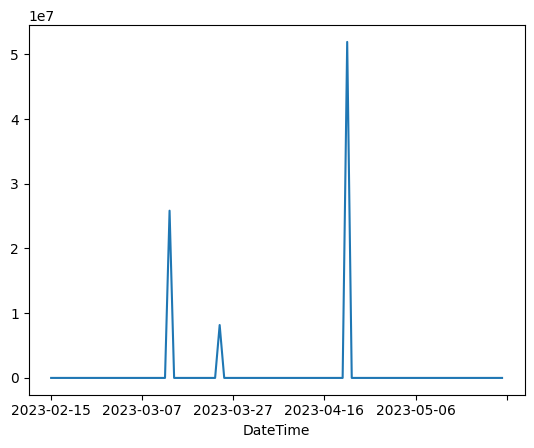

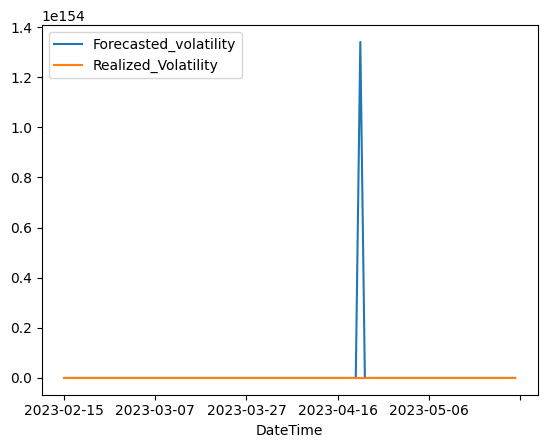

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'EGarch'
window_length = 30
p, q, lambda_param= best_params
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = True
AIC = True
# p = 1
# q = 1
# lambda_param = 0.84
forecast_volatility, realized_volatility, mse, aic_curve, aic = compute_volatility_predictions(df,train_df,test_df,model_type,window_length,p,q,field,real_volatility_type,lambda_param,plot,AIC)

In [ ]:
aic

858949.2158964223

##**optimized GJR-GARCH**

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'GJR-GARCH'
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = False

# Example parameter values to search over
p_values = np.arange(1, 5, 1).tolist()  # Example range for p values
q_values = np.arange(1, 5, 1).tolist() # Example range for q values
lambda_values = np.round(np.arange(0.80, 0.95, 0.01),2).tolist()  # Example range for lambda_param values
#window_lengths = np.arange(15, 31, 1).tolist()  # Example range for window_length values
window_length = 30

# Example usage
best_params, best_mse = grid_search(df, train_df, test_df, model_type, p_values, q_values, lambda_values, window_length, field, real_volatility_type,plot)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
print("Best Parameters:", best_params)
print("Best MSE:", best_mse)

Best Parameters: (1, 1, 0.89)
Best MSE: 0.0002258443542603896


Iteration:      1,   Func. Count:      7,   Neg. LLF: 13543.055487735008
Iteration:      2,   Func. Count:     17,   Neg. LLF: 67.3095317495843
Iteration:      3,   Func. Count:     27,   Neg. LLF: -44.55695314921017
Iteration:      4,   Func. Count:     34,   Neg. LLF: -7.259446356193553
Iteration:      5,   Func. Count:     41,   Neg. LLF: -49.63255254137109
Iteration:      6,   Func. Count:     47,   Neg. LLF: -49.74183151464223
Iteration:      7,   Func. Count:     53,   Neg. LLF: -49.90139810532945
Iteration:      8,   Func. Count:     59,   Neg. LLF: -49.28715715789791
Iteration:      9,   Func. Count:     66,   Neg. LLF: -49.86938213968838
Iteration:     10,   Func. Count:     73,   Neg. LLF: -50.106540024537104
Iteration:     11,   Func. Count:     79,   Neg. LLF: -50.22969658145227
Iteration:     12,   Func. Count:     85,   Neg. LLF: -50.258607050980544
Iteration:     13,   Func. Count:     91,   Neg. LLF: -50.26458285247775
Iteration:     14,   Func. Count:     97,   Neg. LL

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



Iteration:      8,   Func. Count:     61,   Neg. LLF: -39.92579676888154
Iteration:      9,   Func. Count:     67,   Neg. LLF: 584345639373.5231
Iteration:     10,   Func. Count:     77,   Neg. LLF: 14914364.468621353
Iteration:     11,   Func. Count:     85,   Neg. LLF: -39.966234739224454
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -39.96623474517259
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:      1,   Func. Count:      7,   Neg. LLF: 29.718117901290345
Iteration:      2,   Func. Count:     16,   Neg. LLF: 2659.477355689098
Iteration:      3,   Func. Count:     26,   Neg. LLF: -30.63250587573469
Iteration:      4,   Func. Count:     32,   Neg. LLF: -30.6338726975639
Iteration:      5,   Func. Count:     38,   Neg. LLF: -30.63400030355186
Iteration:      6,   Func. Count:     44,   Neg. LLF: -30.634111013477344
Iteration:      7,   Func. Count:     49,   Neg. L

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1061318.0928089642
Iteration:      2,   Func. Count:     18,   Neg. LLF: 6294831.892360562
Iteration:      3,   Func. Count:     26,   Neg. LLF: -49.290628905746644
Iteration:      4,   Func. Count:     34,   Neg. LLF: -53.975294304074346
Iteration:      5,   Func. Count:     40,   Neg. LLF: -54.29047611473225
Iteration:      6,   Func. Count:     46,   Neg. LLF: -54.567861265253576
Iteration:      7,   Func. Count:     52,   Neg. LLF: -53.982709666973115
Iteration:      8,   Func. Count:     59,   Neg. LLF: -54.052272219472556
Iteration:      9,   Func. Count:     66,   Neg. LLF: -54.542672305608434
Iteration:     10,   Func. Count:     73,   Neg. LLF: -54.59927022190504
Iteration:     11,   Func. Count:     80,   Neg. LLF: -54.60229351875571
Iteration:     12,   Func. Count:     87,   Neg. LLF: -54.604306915514435
Iteration:     13,   Func. Count:     93,   Neg. LLF: -54.60394419304693
Iteration:     14,   Func. Count:    100,   N

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:      1,   Func. Count:      7,   Neg. LLF: 1417348364.6524441
Iteration:      2,   Func. Count:     17,   Neg. LLF: 1414061.275695889
Iteration:      3,   Func. Count:     25,   Neg. LLF: -41.734667656313874
Iteration:      4,   Func. Count:     32,   Neg. LLF: -47.8036255566166
Iteration:      5,   Func. Count:     38,   Neg. LLF: -47.69153265739688
Iteration:      6,   Func. Count:     45,   Neg. LLF: -47.97894949688955
Iteration:      7,   Func. Count:     51,   Neg. LLF: -48.04921920024195
Iteration:      8,   Func. Count:     57,   Neg. LLF: -48.032515593221554
Iteration:      9,   Func. Count:     63,   Neg. LLF: -48.51393743812996
Iteration:     10,   Func. Count:     79,   Neg. LLF: -37.51563370737376
Iteration:     11,   Func. Count:     88,   Neg. LLF: 696.8909830298298
Iteration:     12,   Func. Count:     98,   Neg. LLF: 152.99819666550607
Iteration:     13,   Func. Count:    108,   Neg. LLF: -47.77906807786734
Iteration:     14,   Func. Count:    117,   Neg. LLF

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Iteration:     18,   Func. Count:    126,   Neg. LLF: -43.860807071270436
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.86080707127983
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Iteration:      1,   Func. Count:      7,   Neg. LLF: 1344194123.4992278
Iteration:      2,   Func. Count:     17,   Neg. LLF: 10183139.482538607
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.232429884199156
Iteration:      4,   Func. Count:     31,   Neg. LLF: 596.3546636271025
Iteration:      5,   Func. Count:     38,   Neg. LLF: 228.72252986918426
Iteration:      6,   Func. Count:     45,   Neg. LLF: -12.049941457086685
Iteration:      7,   Func. Count:     52,   Neg. LLF: -31.146275251894604
Iteration:      8,   Func. Count:     59,   Neg. LLF: -34.414577184040546
Iteration:      9,   Func. Count:     66,   Neg. LLF: -36.12122171881494
Iteration:     10,   Func. Count:     73,   Neg. LLF: -

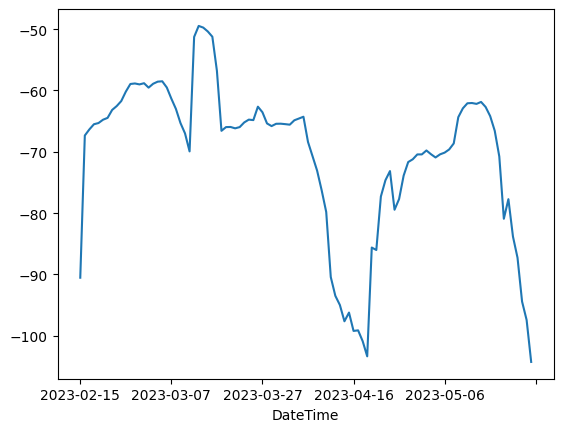

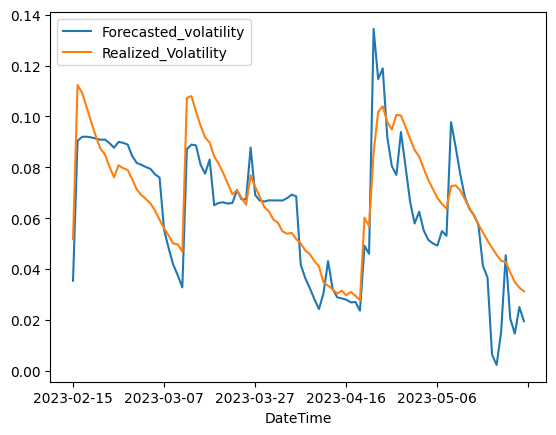

In [ ]:
# types are 'Garch' 'EGarch' 'GJR-GARCH'
model_type = 'GJR-GARCH'
window_length = 30
p, q, lambda_param= best_params
#types are 'normal' 'EWMA'
real_volatility_type = 'EWMA'
#fields are 'abs_Floor_returns'  'log_Floor_returns'
field =  'log_Floor_returns'
plot = True
AIC = True
# p = 3
# q = 3
# lambda_param = 0.85
forecast_volatility, realized_volatility, mse, aic_curve, aic = compute_volatility_predictions(df,train_df,test_df,model_type,window_length,p,q,field,real_volatility_type,lambda_param,plot,AIC)

In [ ]:
aic

-70.46908690504257

# **jump GARCH**

In [ ]:
# Define the conditional variance with a jump component
def conditional_variance(params, df, field):
    omega, alpha, beta, gamma = params
    df['cond_var'] = np.nan
    df['cond_var'].iat[0] = df[field].iat[0]**2
    for t in range(1, len(df)):
        df['cond_var'].iat[t] = omega + alpha * df[field].iat[t-1]**2 + beta * df['cond_var'].iat[t-1] + gamma * df['jump'].iat[t-1]
    return df['cond_var']

# Define the log-likelihood function
def log_likelihood(params, df, field):
    cond_var = conditional_variance(params, df, field)
    log_likelihood = -0.5 * (np.log(2*np.pi) + np.log(cond_var) + df[field]**2 / cond_var)
    return -np.sum(log_likelihood)

In [ ]:
def calculate_jump_garch(df,train_df,test_df,window_length=30,lambda_param = 0.94,real_volatility_type='normal', field = 'abs_Floor_returns', plot = False, AIC=False):

    # Define jump variable: 1 if absolute return is in the top 5%, 0 otherwise
    df['jump'] = (df[field] > df[field].quantile(0.95)).astype(int)

    # Initialize the parameters
    omega, alpha, beta, gamma = 0.01, 0.1, 0.8, 0.1
    params = np.array([omega, alpha, beta, gamma])

    # Estimate the parameters
    res = minimize(log_likelihood, params, args=(df,field), method='BFGS')

    # Print estimated parameters
    print('Estimated Parameters:', res.x)

    # Calculate and store the conditional standard deviation (volatility)
    df['predicted_volatility'] = np.sqrt(conditional_variance(res.x, df, field))
    test_df['Forecasted_volatility'] = df['predicted_volatility'].values[-len(test_df):]
    Forecasted_volatility = test_df['Forecasted_volatility'].values

    if real_volatility_type == 'normal':
      # Compute the realized volatilities
      test_df['Realized_Volatility'] = df[field].rolling(window=30).std()[-len(test_df):] #* (365 ** 0.5)

    elif real_volatility_type == 'EWMA':
      # Calculate EWMA weights
      weight0 = 1-lambda_param
      weights = []
      weights.append(weight0)
      for i in range(window_length-1):
          weights.append(weights[i]*lambda_param)
      weights = weights[::-1]
      #calculate suqare of log returns
      squares = df[field].values ** 2
      squares = squares[-len(test_df)-window_length:]

      EWMA = []
      for i in range(len(test_df)):
        values = squares[i:window_length+i]
        ewma_volatility = np.sqrt(np.sum(values * weights))
        EWMA.append(ewma_volatility)

      # Compute the realized volatilities
      test_df['Realized_Volatility'] = EWMA

    realized_volatility = test_df['Realized_Volatility'].values
    #print(test_df['RealizedVolatility'].values)


    # Compute the Mean Squared Error (MSE)
    try:
        mse = mean_squared_error(test_df['Realized_Volatility'], test_df['Forecasted_volatility'])
    except:
        mse = mean_squared_error(test_df['Realized_Volatility'][1:], test_df['Forecasted_volatility'][1:])

    if AIC:
        n = len(params)  # Number of parameters (4 in this case)
        k = len(df)  # Number of data points
        aic = k * np.log(mse) + 2 * len(params)  # Calculate AIC
        print('AIC:', aic)


    # Plot the forecasted and realized volatilities
    if plot:
        ax = test_df[['Forecasted_volatility', 'Realized_Volatility']].plot(linewidth=5)
        ax.set_xlabel("Date")
        ax.set_ylabel("Volatility")
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.legend(fontsize='large')
    if AIC:
      return Forecasted_volatility, realized_volatility, mse, aic

    return Forecasted_volatility, realized_volatility, mse


In [ ]:
window_length=30
lambda_param = 0.91
real_volatility_type='EWMA'
plot = True
AIC = True
field = 'abs_Floor_returns'
Forecasted_volatility, realized_volatility, mse, aic = calculate_jump_garch(df,train_df,test_df,window_length,lambda_param,real_volatility_type,field,plot,AIC)

Estimated Parameters: [ 6.57797358 -1.32751672  1.2184483  -1.99744336]


ValueError: ignored

In [ ]:
aic

-198.56025697110806

## Optimized Jump Garch

In [ ]:
def grid_search_lambda(df, train_df, test_df, lambda_range, real_volatility_type='normal',field = 'abs_Floor_returns'):
    best_lambda = None
    best_mse = float('inf')
    window_length = 30

    for lambda_param in lambda_range:
        print(f"Grid Searching Lambda Param: {lambda_param}")
        Forecasted_volatility, realized_volatility, mse = calculate_jump_garch(
            df, train_df, test_df,window_length, lambda_param, real_volatility_type,field
        )

        if mse < best_mse:
            best_mse = mse
            best_lambda = lambda_param

    return best_lambda

In [ ]:
lambda_range = np.round(np.arange(0.80, 0.95, 0.01),2).tolist()  # Define the range of lambda values to search
real_volatility_type= 'EWMA'
field = 'log_Floor_returns'
best_lambda = grid_search_lambda(df, train_df, test_df, lambda_range, real_volatility_type, field)
print(f"The best lambda parameter is: {best_lambda}")

Grid Searching Lambda Param: 0.8
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.81
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.82
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.83
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.84
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.85
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.86
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.87
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.88
Estimated Parameters: [ 0.00191769  0.22398099 -0.07467893 -0.00177623]
Grid Searching Lambda Param: 0.89
Estimated Par

Estimated Parameters: [ 2.93212595e-04  2.36226719e-01  6.20286308e-01 -8.03077143e-04]
AIC: -2619.0621614527704


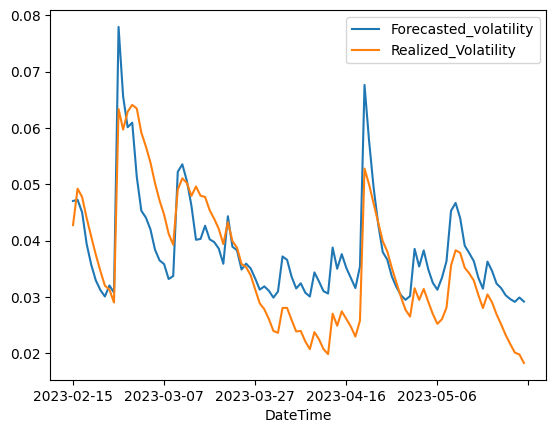

In [ ]:
window_length=30
lambda_param = best_lambda
real_volatility_type='EWMA'
plot = True
AIC = True
field = 'log_Floor_returns'
Forecasted_volatility, realized_volatility, mse, aic = calculate_jump_garch(df,train_df,test_df,window_length,lambda_param,real_volatility_type,field,plot, AIC)

In [ ]:
aic